In [3]:
import os, sys
sys.path.append(os.path.dirname(os.path.dirname(os.path.abspath("./notebooks"))))

In [4]:
from tensorflow.keras import layers;
from tensorflow.keras import losses;
from tensorflow.keras import optimizers;
from dataset import Dataset;
from hyperparameter import HyperParameter;
from hyperparameter_search import HyperParameterSearch;
    
dataset_vector_25 = Dataset("../../preprocessed/row_size25_vector_size2000.csv")
dataset_vector_100 = Dataset("../../preprocessed/row_size100_vector_size2000.csv")

dataset_lambda_pair_set = [
    # 4 layer Dense tanh
    (
        dataset_vector_25,
        lambda: (
            [
                layers.Dense(256, input_dim=dataset_vector_25.getInDimension(), activation="tanh"),
                layers.Dense(128, activation="tanh"),
                layers.Dense(64, activation="tanh"),
                layers.Dense(32, activation="tanh"),
                layers.Dense(dataset_vector_25.getOutDimension())
            ]
        ),
        '[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")]',
    ),
    (
        dataset_vector_100,
        lambda: (
            [
                layers.Dense(256, input_dim=dataset_vector_100.getInDimension(), activation="tanh"),
                layers.Dense(128, activation="tanh"),
                layers.Dense(64, activation="tanh"),
                layers.Dense(32, activation="tanh"),
                layers.Dense(dataset_vector_100.getOutDimension())
            ]
        ),
        '[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")]',
    ),
];
loss_set = [
    losses.mean_squared_error,
    # losses.mean_absolute_error,
    # losses.mean_absolute_percentage_error,
    # losses.mean_squared_logarithmic_error,
    # losses.cosine_similarity,
    # losses.huber,
    # losses.log_cosh
]
optimizer_set = [
    optimizers.SGD,
    optimizers.RMSprop,
    optimizers.Adam,
    optimizers.Adadelta,
    optimizers.Adagrad,
    optimizers.Adamax,
    optimizers.Nadam,
    optimizers.Ftrl
]
epoch_set = [
    30, 
    50, 
    75, 
    100
]
batch_size_set = [
    12, 
    18, 
    24, 
    32, 
    40
]
search = HyperParameterSearch();
parameters = search.createParameterSet(dataset_lambda_pair_set, loss_set, optimizer_set, epoch_set, batch_size_set)

print(str(parameters[0]))

search.run(parameters);

print(search.results)

Progress: [####################] 100.0%
{'Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa97e389b20>, epochs=30, batch_size=12': {'estimator': <state_estimator.StateEstimator object at 0x7fa97e389ac0>, 'metrics': [[-2.061385910693844, 0.6469816294323698, 0.07287768818507921, 25520.74146971072, 0.012534043042968634, 0.0001571022350029904], [-2.3377338492238167, 0.6241932531272978, 0.07401688180662162, 920.9688911849175, 0.01279784542008404, 0.000163784847396366], [-0.19294775867269842, 2.0892075466370654, 0.12653997964076752, 937.1019009184737, 0.09939372651504431, 0.009879112870547423], [-23837.913239033405, 0.5559541598183864, 0.04812300832569919, 6363388.727694178, 0.008630967606656098, 7.4493601

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa97e389b20>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.06e+00	6.47e-01	7.29e-02	2.55e+04	1.25e-02	1.57e-04
y		-2.34e+00	6.24e-01	7.40e-02	9.21e+02	1.28e-02	1.64e-04
z		-1.93e-01	2.09e+00	1.27e-01	9.37e+02	9.94e-02	9.88e-03
phi		-2.38e+04	5.56e-01	4.81e-02	6.36e+06	8.63e-03	7.45e-05
theta		-2.80e+04	5.56e-01	4.81e-02	8.52e+05	8.64e-03	7.46e-05
psi		-1.15e+04	5.56e-01	4.82e-02	2.21e+06	8.64e-03	7.47e-05


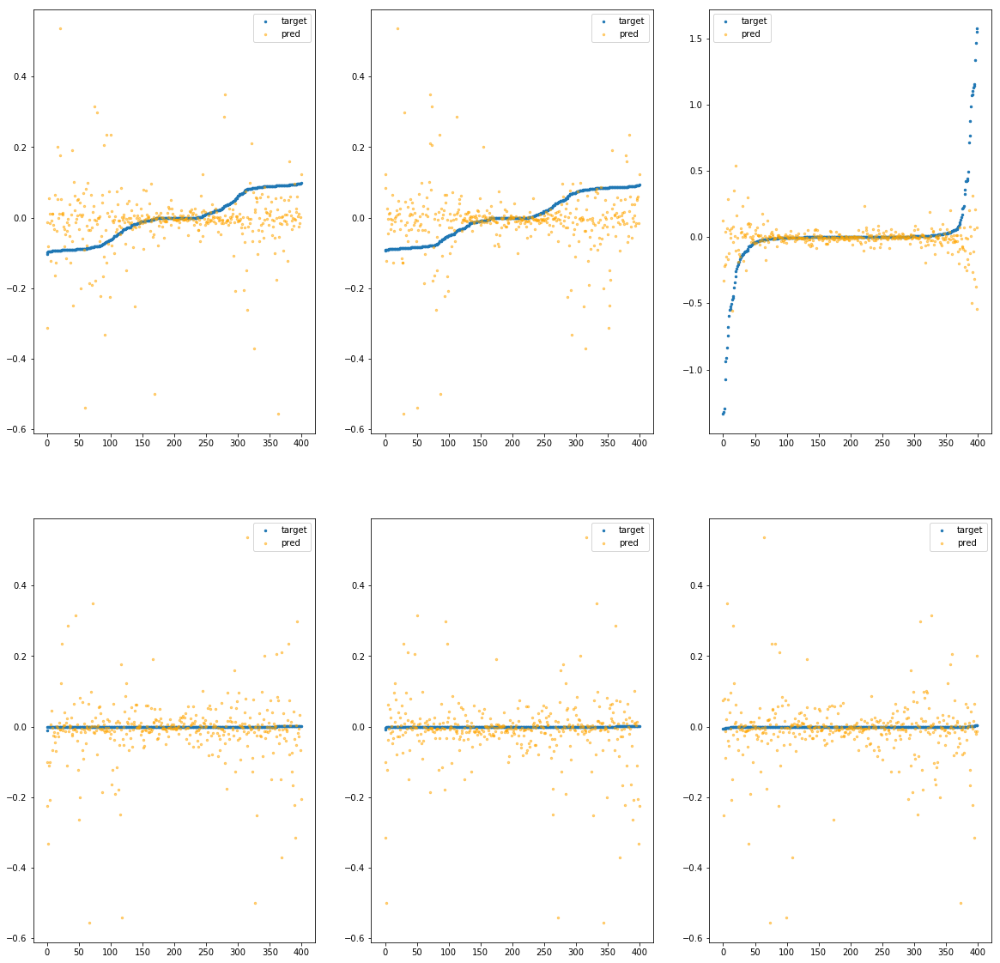

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa97e389b80>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.07e+00	5.64e-01	7.42e-02	1.90e+04	1.26e-02	1.58e-04
y		-1.93e+00	5.47e-01	6.95e-02	1.05e+03	1.12e-02	1.26e-04
z		1.55e-02	1.91e+00	1.19e-01	1.14e+03	8.20e-02	6.73e-03
phi		-2.68e+04	5.64e-01	5.16e-02	6.16e+06	9.70e-03	9.42e-05
theta		-3.14e+04	5.63e-01	5.16e-02	1.55e+06	9.71e-03	9.42e-05
psi		-1.29e+04	5.59e-01	5.16e-02	2.73e+06	9.69e-03	9.38e-05


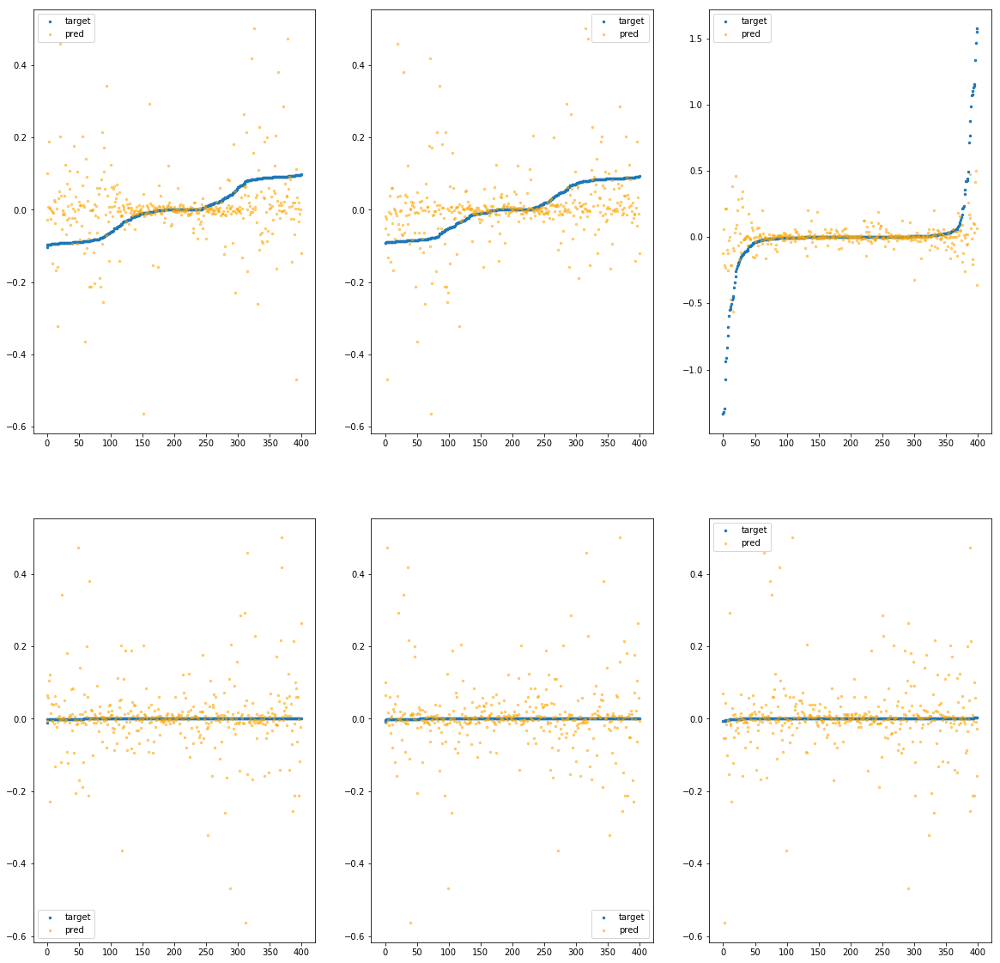

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa97e389be0>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.10e-01	4.09e-01	6.46e-02	1.94e+04	7.82e-03	6.12e-05
y		-8.58e-01	3.09e-01	6.15e-02	2.14e+03	7.13e-03	5.08e-05
z		-1.85e-02	1.66e+00	1.17e-01	1.39e+03	8.49e-02	7.20e-03
phi		-9.37e+03	3.26e-01	3.46e-02	3.70e+06	3.39e-03	1.15e-05
theta		-1.10e+04	3.25e-01	3.46e-02	1.52e+06	3.39e-03	1.15e-05
psi		-4.52e+03	3.26e-01	3.47e-02	3.26e+06	3.39e-03	1.15e-05


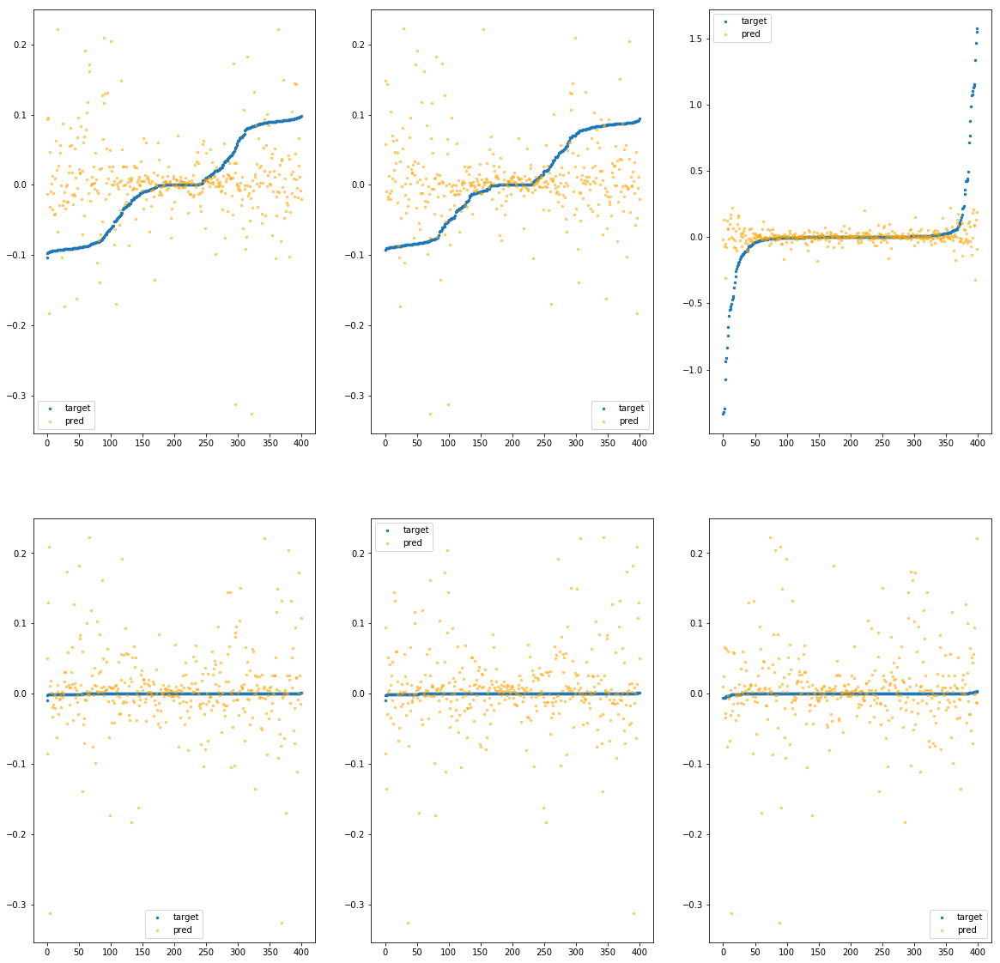

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa97e389c40>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.64e+00	4.93e-01	7.13e-02	3.15e+04	1.08e-02	1.17e-04
y		-1.77e+00	4.47e-01	7.08e-02	1.23e+03	1.06e-02	1.12e-04
z		-4.08e-02	1.63e+00	1.19e-01	9.43e+02	8.67e-02	7.52e-03
phi		-1.91e+04	4.40e-01	4.66e-02	4.60e+06	6.92e-03	4.79e-05
theta		-2.24e+04	4.42e-01	4.67e-02	1.17e+06	6.93e-03	4.81e-05
psi		-9.23e+03	4.40e-01	4.66e-02	2.55e+06	6.92e-03	4.79e-05


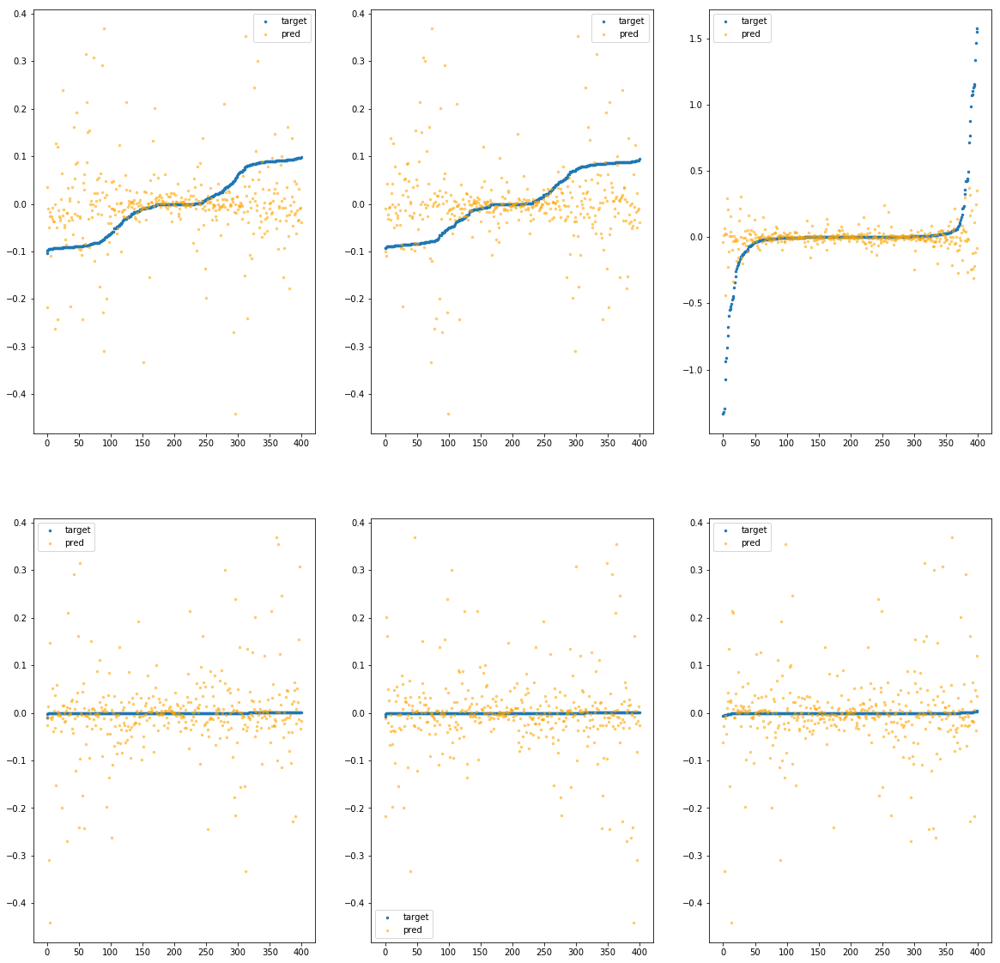

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa97e389ca0>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.05e+00	5.84e-01	7.82e-02	2.50e+04	1.25e-02	1.56e-04
y		-1.72e+00	5.80e-01	7.08e-02	1.45e+03	1.04e-02	1.09e-04
z		-1.05e-01	1.96e+00	1.23e-01	1.34e+03	9.21e-02	8.48e-03
phi		-2.07e+04	5.01e-01	4.98e-02	7.19e+06	7.49e-03	5.61e-05
theta		-2.43e+04	5.01e-01	4.98e-02	1.50e+06	7.49e-03	5.61e-05
psi		-1.00e+04	5.00e-01	4.99e-02	4.52e+06	7.50e-03	5.62e-05


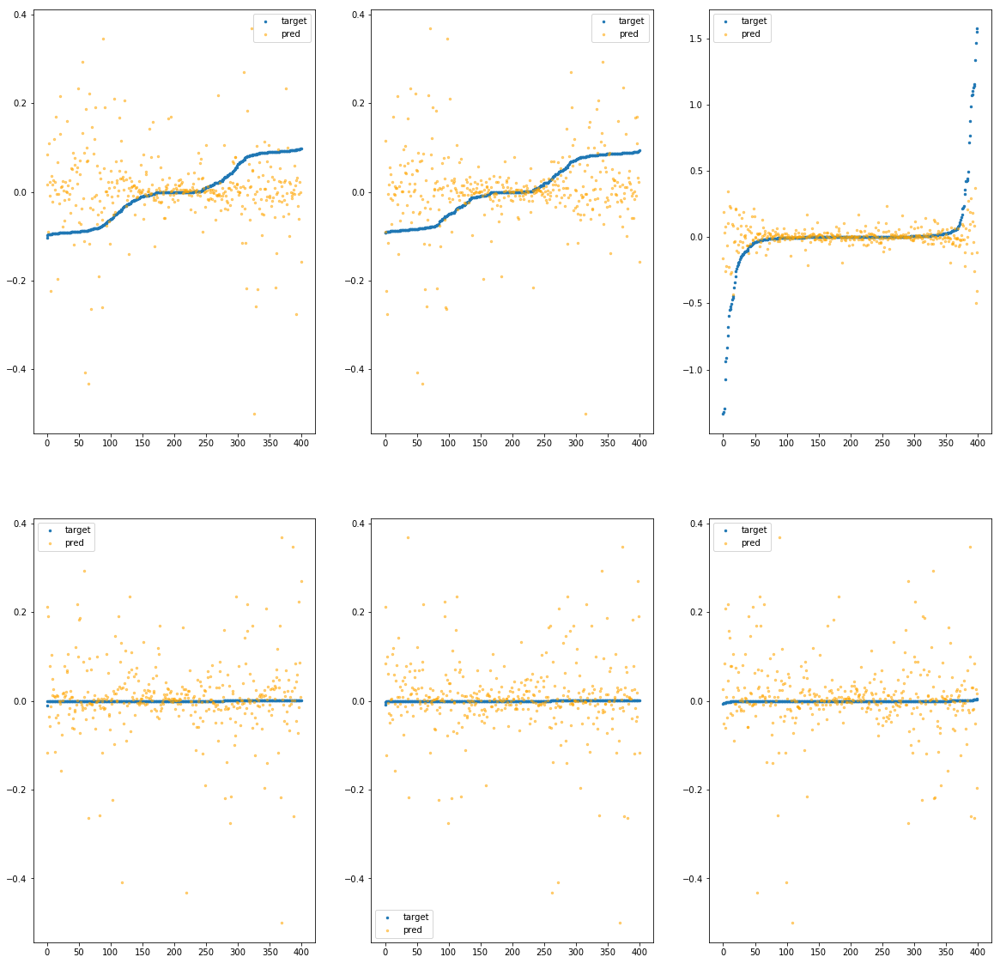

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa97e389d00>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.87e-01	4.43e-01	6.49e-02	2.33e+04	8.13e-03	6.62e-05
y		-9.22e-01	3.46e-01	6.18e-02	4.49e+02	7.37e-03	5.43e-05
z		5.60e-02	1.67e+00	1.09e-01	8.42e+02	7.87e-02	6.19e-03
phi		-1.04e+04	3.66e-01	3.44e-02	3.96e+06	3.78e-03	1.43e-05
theta		-1.22e+04	3.66e-01	3.44e-02	7.05e+05	3.78e-03	1.43e-05
psi		-5.05e+03	3.66e-01	3.45e-02	2.58e+06	3.79e-03	1.43e-05


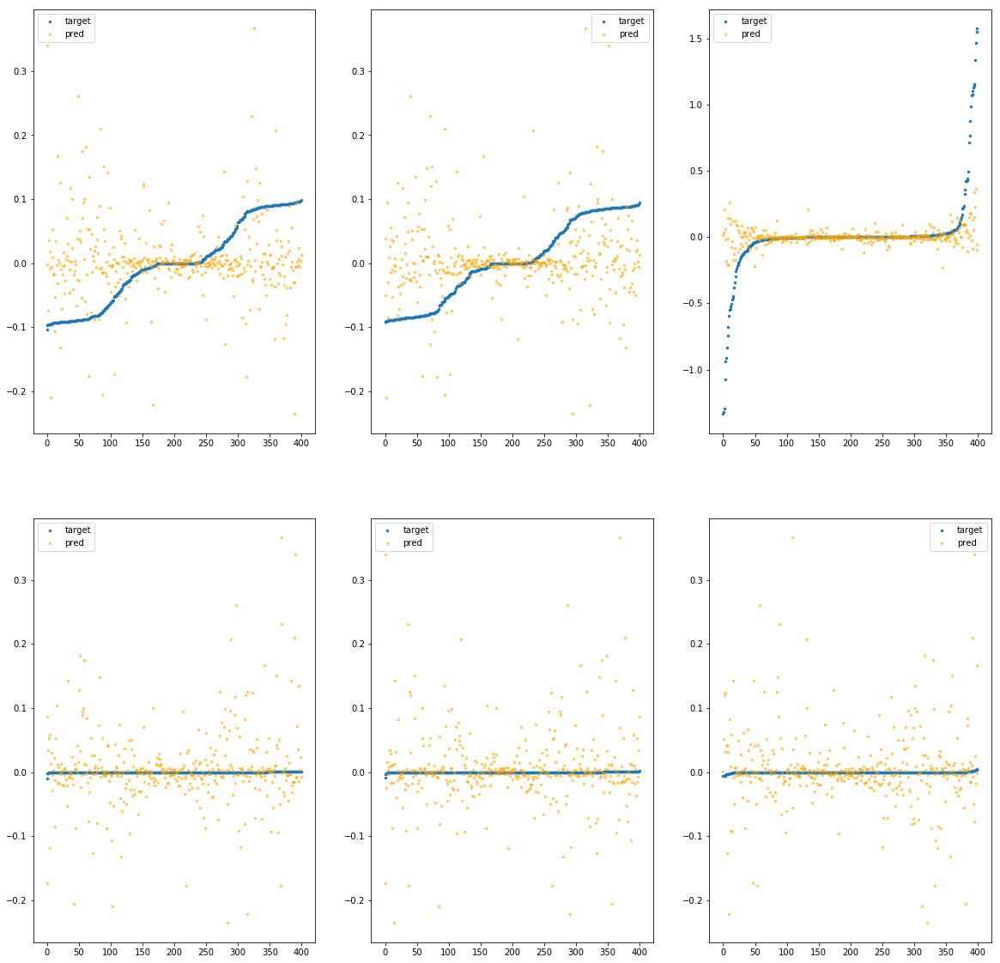

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa97e389d60>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.73e+00	5.65e-01	7.30e-02	1.71e+04	1.12e-02	1.25e-04
y		-2.02e+00	5.75e-01	7.01e-02	6.43e+02	1.16e-02	1.34e-04
z		4.28e-02	1.60e+00	1.15e-01	7.10e+02	7.97e-02	6.36e-03
phi		-1.90e+04	4.93e-01	4.20e-02	4.09e+06	6.86e-03	4.71e-05
theta		-2.22e+04	4.93e-01	4.20e-02	8.04e+05	6.86e-03	4.71e-05
psi		-9.15e+03	4.93e-01	4.20e-02	2.30e+06	6.86e-03	4.71e-05


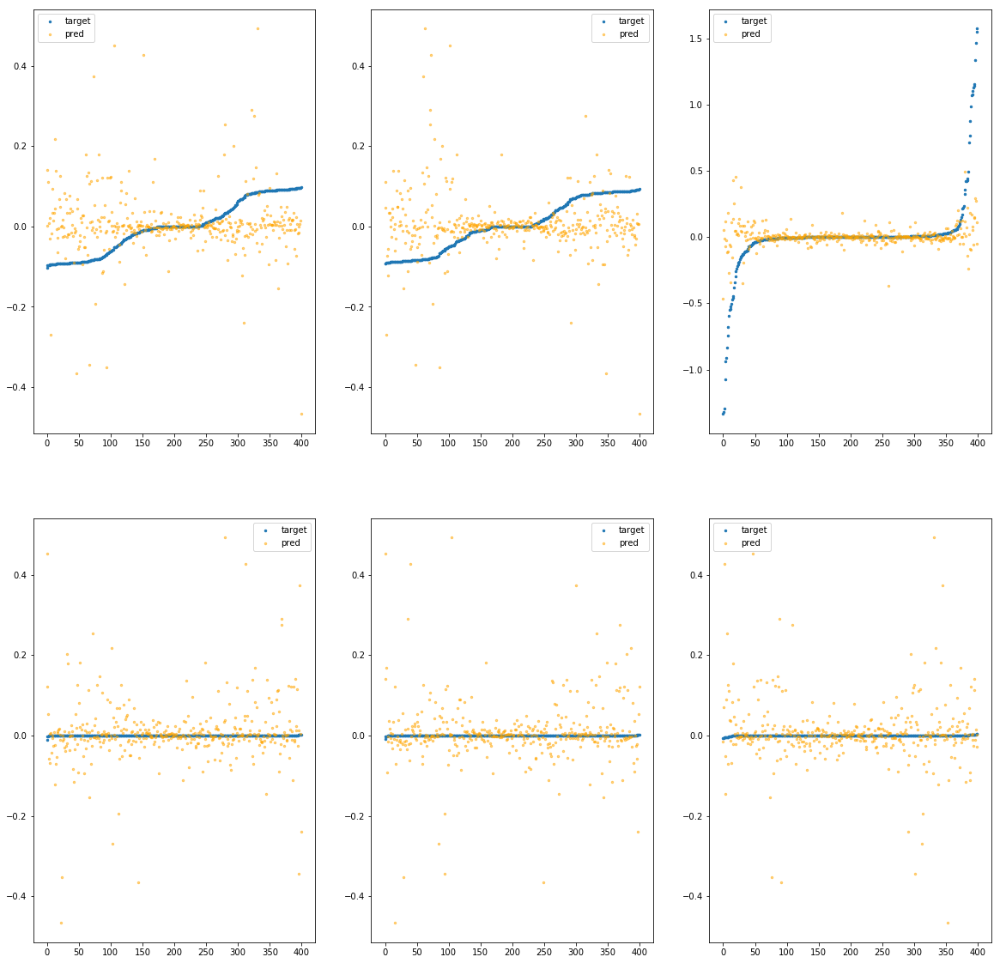

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa97e389dc0>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.30e+00	5.40e-01	6.88e-02	3.25e+04	9.42e-03	8.88e-05
y		-1.29e+00	5.36e-01	6.57e-02	5.88e+02	8.79e-03	7.72e-05
z		-3.52e-02	1.88e+00	1.14e-01	8.90e+02	8.63e-02	7.44e-03
phi		-1.50e+04	4.50e-01	3.95e-02	5.29e+06	5.44e-03	2.96e-05
theta		-1.76e+04	4.49e-01	3.94e-02	8.07e+05	5.44e-03	2.95e-05
psi		-7.27e+03	4.50e-01	3.95e-02	4.63e+06	5.46e-03	2.98e-05


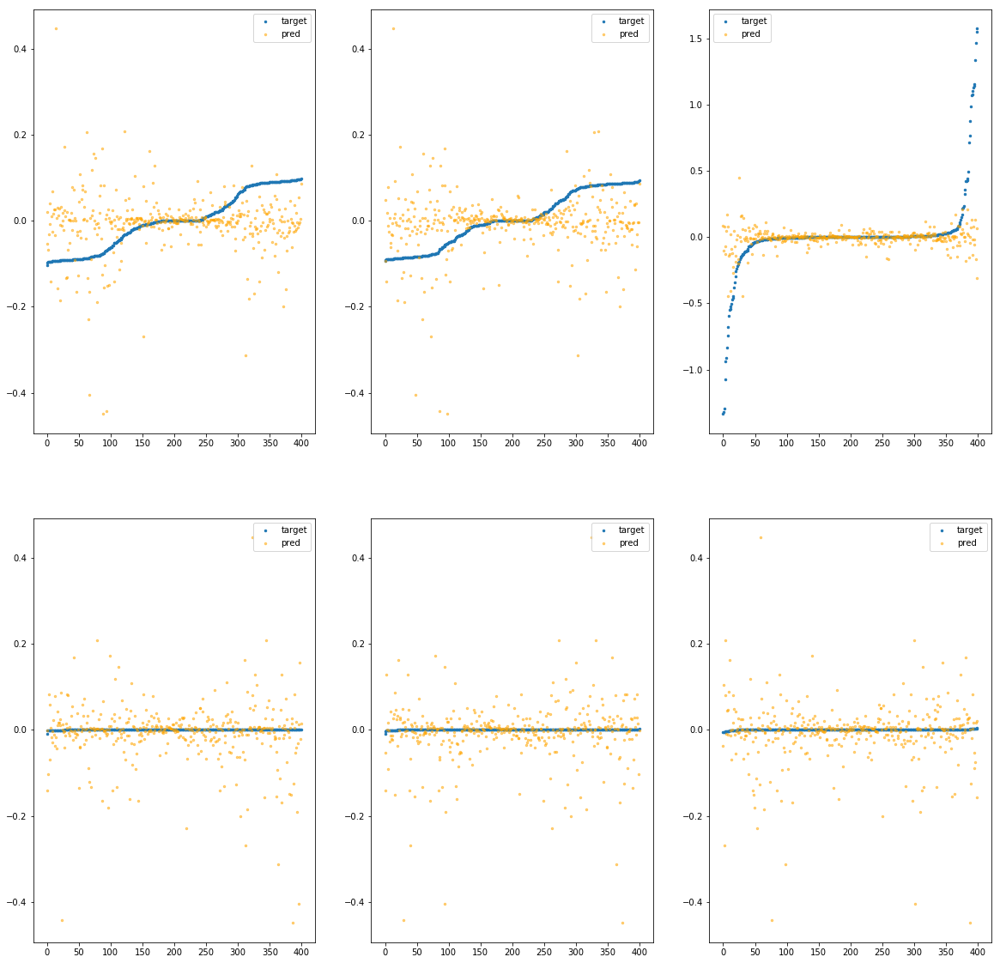

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa97e389e20>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.10e+00	4.17e-01	6.60e-02	2.58e+04	8.61e-03	7.42e-05
y		-1.54e+00	5.75e-01	6.89e-02	8.42e+02	9.73e-03	9.47e-05
z		-1.90e-02	1.67e+00	1.14e-01	9.52e+02	8.49e-02	7.21e-03
phi		-1.37e+04	4.94e-01	3.82e-02	5.08e+06	4.95e-03	2.45e-05
theta		-1.61e+04	4.93e-01	3.82e-02	7.51e+05	4.96e-03	2.46e-05
psi		-6.62e+03	4.94e-01	3.83e-02	2.04e+06	4.96e-03	2.46e-05


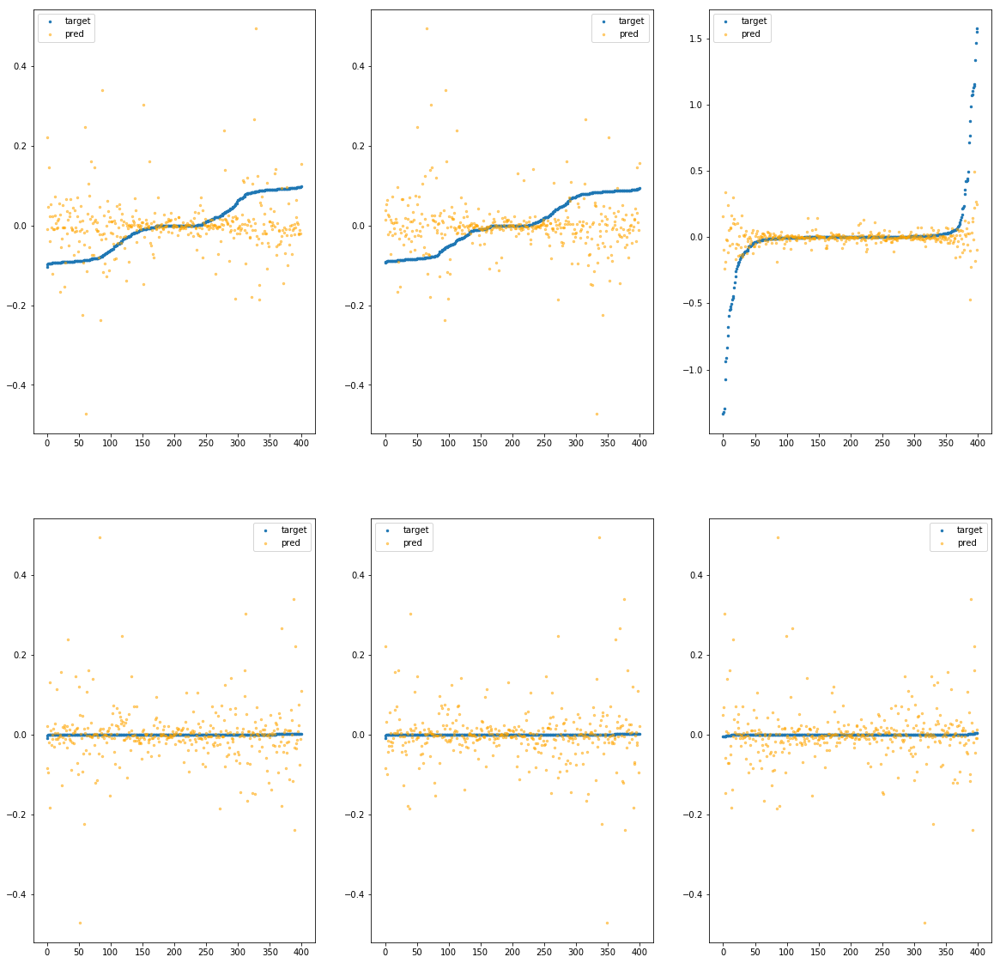

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa97e389e80>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.99e+00	5.26e-01	7.35e-02	1.34e+04	1.23e-02	1.50e-04
y		-2.17e+00	5.03e-01	7.44e-02	1.71e+03	1.22e-02	1.48e-04
z		-6.71e-02	1.63e+00	1.23e-01	1.13e+03	8.89e-02	7.90e-03
phi		-2.05e+04	4.48e-01	4.78e-02	4.66e+06	7.42e-03	5.50e-05
theta		-2.40e+04	4.48e-01	4.77e-02	1.56e+06	7.40e-03	5.48e-05
psi		-9.87e+03	4.47e-01	4.78e-02	3.13e+06	7.40e-03	5.48e-05


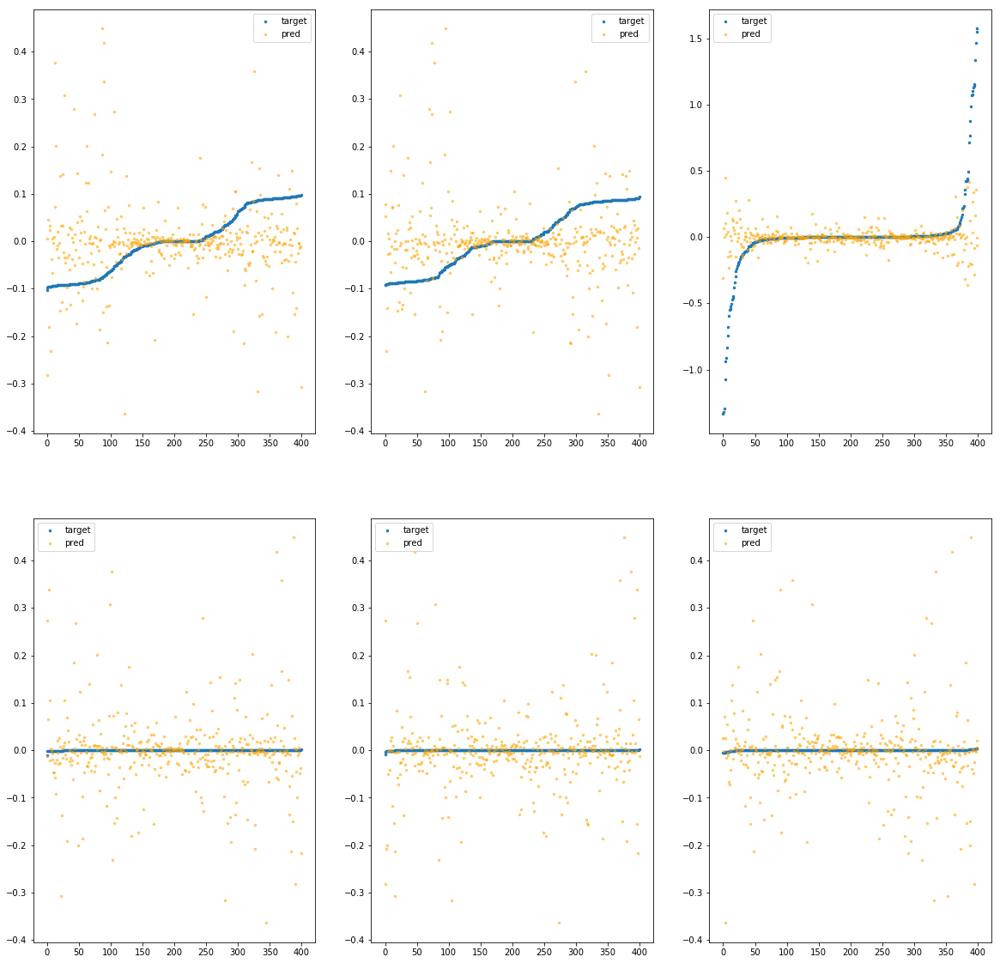

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa97e389ee0>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.99e-01	4.07e-01	6.07e-02	1.32e+04	6.96e-03	4.84e-05
y		-1.14e+00	4.02e-01	6.54e-02	9.49e+02	8.22e-03	6.75e-05
z		-1.41e-03	1.66e+00	1.11e-01	6.05e+02	8.34e-02	6.96e-03
phi		-1.05e+04	3.16e-01	3.41e-02	2.86e+06	3.81e-03	1.45e-05
theta		-1.23e+04	3.16e-01	3.41e-02	7.49e+05	3.81e-03	1.45e-05
psi		-5.09e+03	3.15e-01	3.41e-02	1.54e+06	3.82e-03	1.46e-05


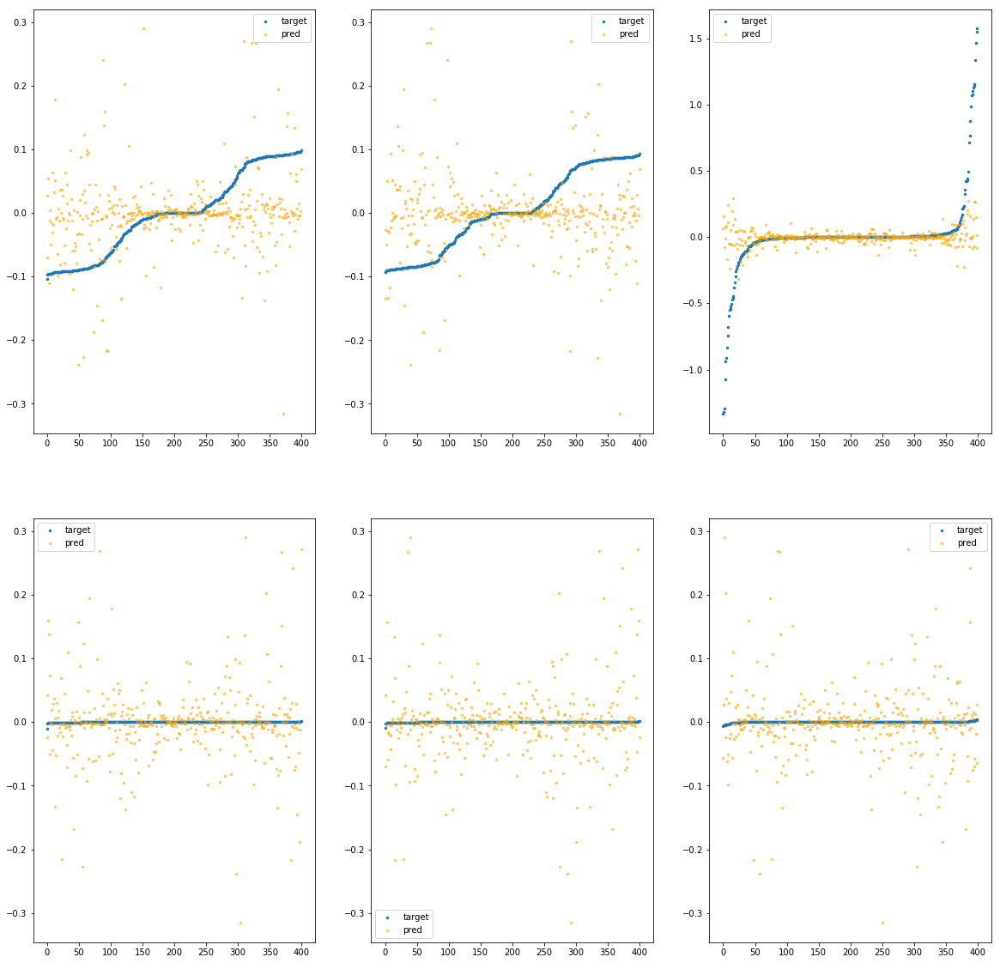

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa97e389f40>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.04e+00	4.69e-01	6.57e-02	2.72e+04	8.35e-03	6.97e-05
y		-1.11e+00	4.67e-01	6.16e-02	7.56e+02	8.09e-03	6.54e-05
z		-6.85e-02	1.66e+00	1.15e-01	7.74e+02	8.90e-02	7.93e-03
phi		-1.14e+04	3.82e-01	3.45e-02	6.86e+06	4.13e-03	1.70e-05
theta		-1.33e+04	3.82e-01	3.44e-02	6.73e+05	4.12e-03	1.70e-05
psi		-5.50e+03	3.82e-01	3.45e-02	2.45e+06	4.13e-03	1.70e-05


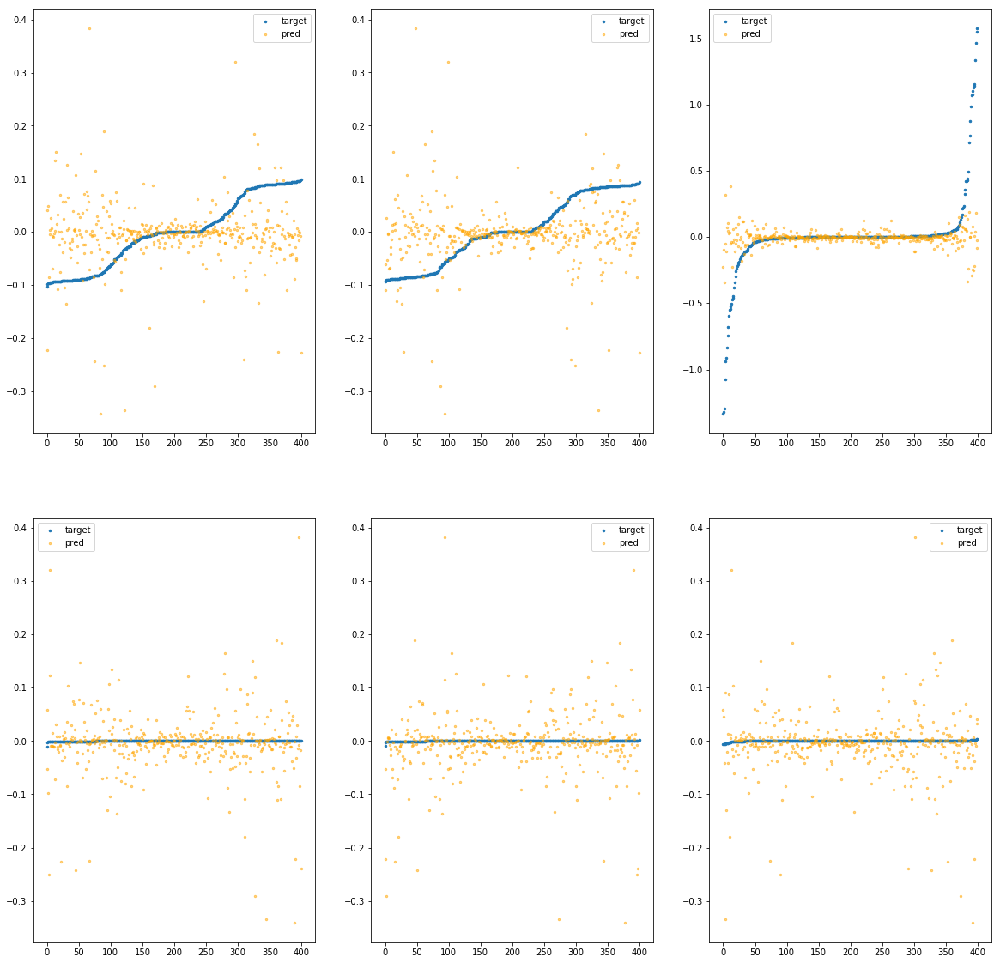

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa97e389fa0>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.47e+00	5.25e-01	6.99e-02	1.14e+04	1.01e-02	1.03e-04
y		-1.50e+00	5.03e-01	6.73e-02	7.18e+02	9.59e-03	9.19e-05
z		-5.28e-02	1.74e+00	1.16e-01	1.12e+03	8.77e-02	7.69e-03
phi		-1.60e+04	4.46e-01	4.17e-02	4.23e+06	5.81e-03	3.37e-05
theta		-1.88e+04	4.46e-01	4.17e-02	8.27e+05	5.81e-03	3.38e-05
psi		-7.73e+03	4.45e-01	4.17e-02	3.40e+06	5.80e-03	3.36e-05


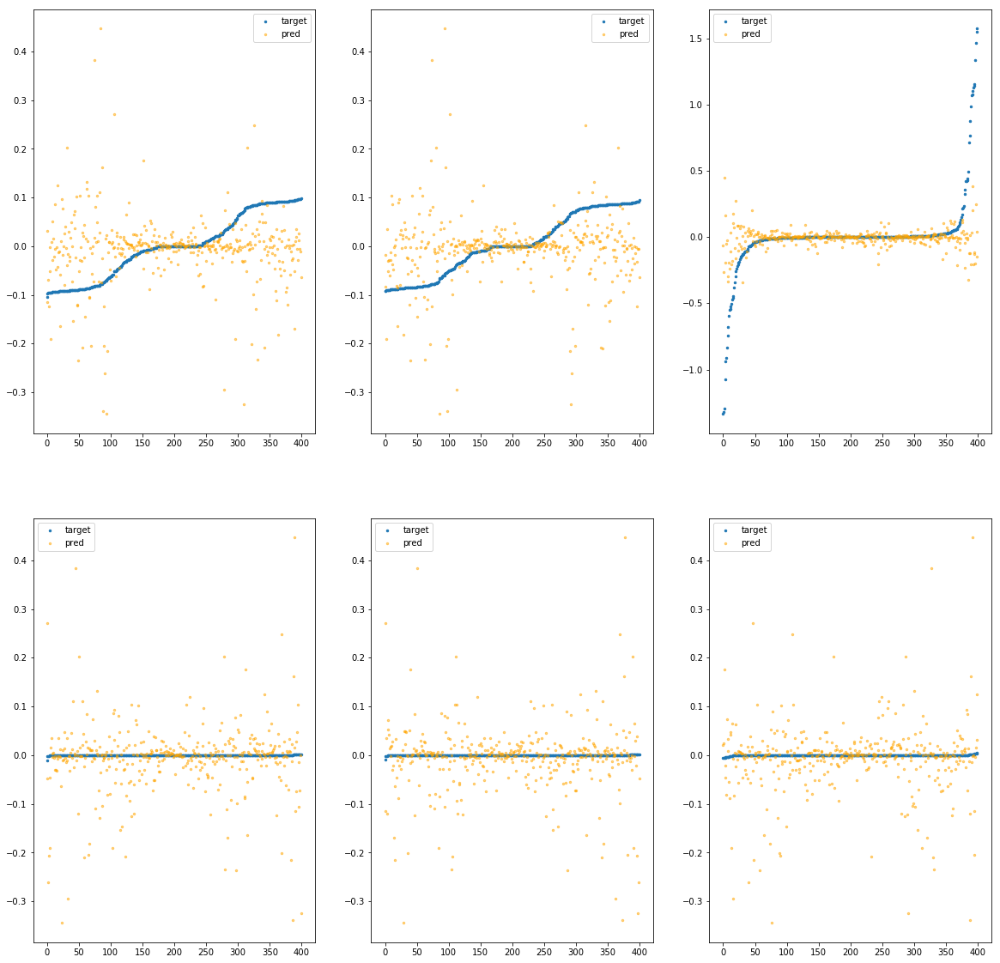

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa97e387040>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.98e+00	5.90e-01	7.43e-02	2.96e+04	1.22e-02	1.49e-04
y		-2.08e+00	5.94e-01	7.06e-02	5.44e+02	1.18e-02	1.40e-04
z		-1.38e-01	1.93e+00	1.22e-01	7.16e+02	9.48e-02	8.99e-03
phi		-2.09e+04	5.15e-01	4.60e-02	8.16e+06	7.56e-03	5.72e-05
theta		-2.45e+04	5.16e-01	4.60e-02	5.33e+05	7.58e-03	5.74e-05
psi		-1.01e+04	5.16e-01	4.61e-02	3.31e+06	7.59e-03	5.76e-05


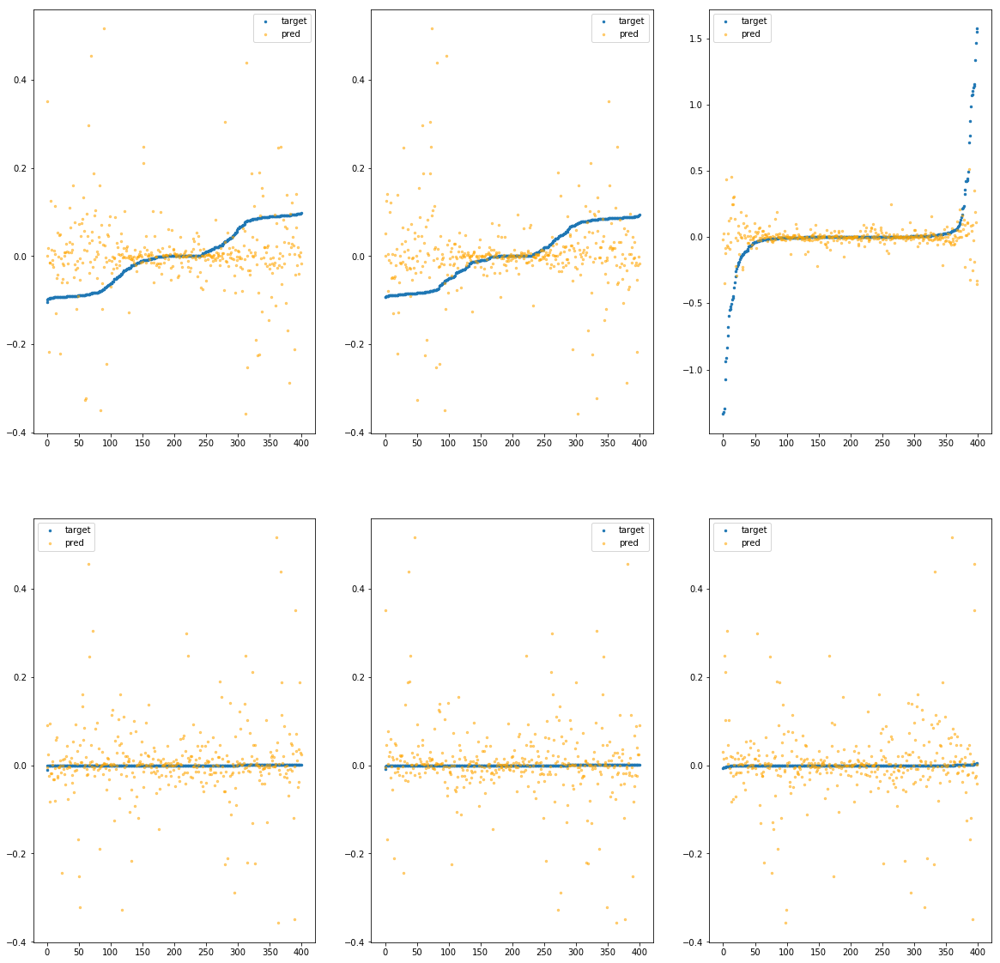

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa97e3870a0>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.47e+00	3.78e-01	7.14e-02	1.58e+04	1.01e-02	1.02e-04
y		-1.16e+00	3.89e-01	6.58e-02	8.24e+02	8.29e-03	6.88e-05
z		-7.47e-02	1.61e+00	1.15e-01	8.68e+02	8.95e-02	8.02e-03
phi		-1.39e+04	4.48e-01	3.93e-02	3.51e+06	5.04e-03	2.54e-05
theta		-1.63e+04	4.49e-01	3.93e-02	7.25e+05	5.04e-03	2.54e-05
psi		-6.71e+03	4.49e-01	3.93e-02	3.38e+06	5.03e-03	2.53e-05


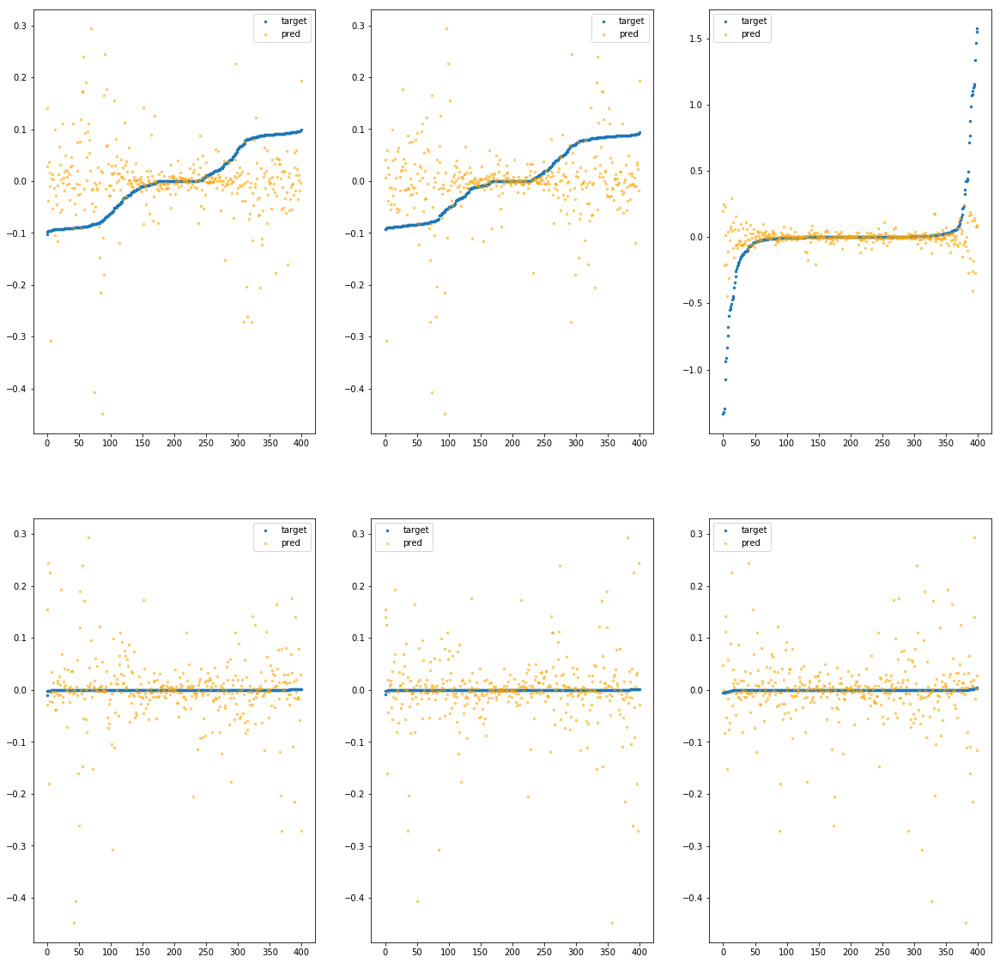

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa97e387100>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.17e-01	3.38e-01	6.22e-02	1.42e+04	7.03e-03	4.94e-05
y		-7.14e-01	3.36e-01	5.91e-02	7.81e+02	6.57e-03	4.32e-05
z		3.63e-02	1.53e+00	1.08e-01	6.44e+02	8.03e-02	6.45e-03
phi		-9.77e+03	3.49e-01	3.21e-02	2.68e+06	3.54e-03	1.25e-05
theta		-1.15e+04	3.49e-01	3.22e-02	8.98e+05	3.55e-03	1.26e-05
psi		-4.76e+03	3.50e-01	3.22e-02	1.99e+06	3.57e-03	1.27e-05


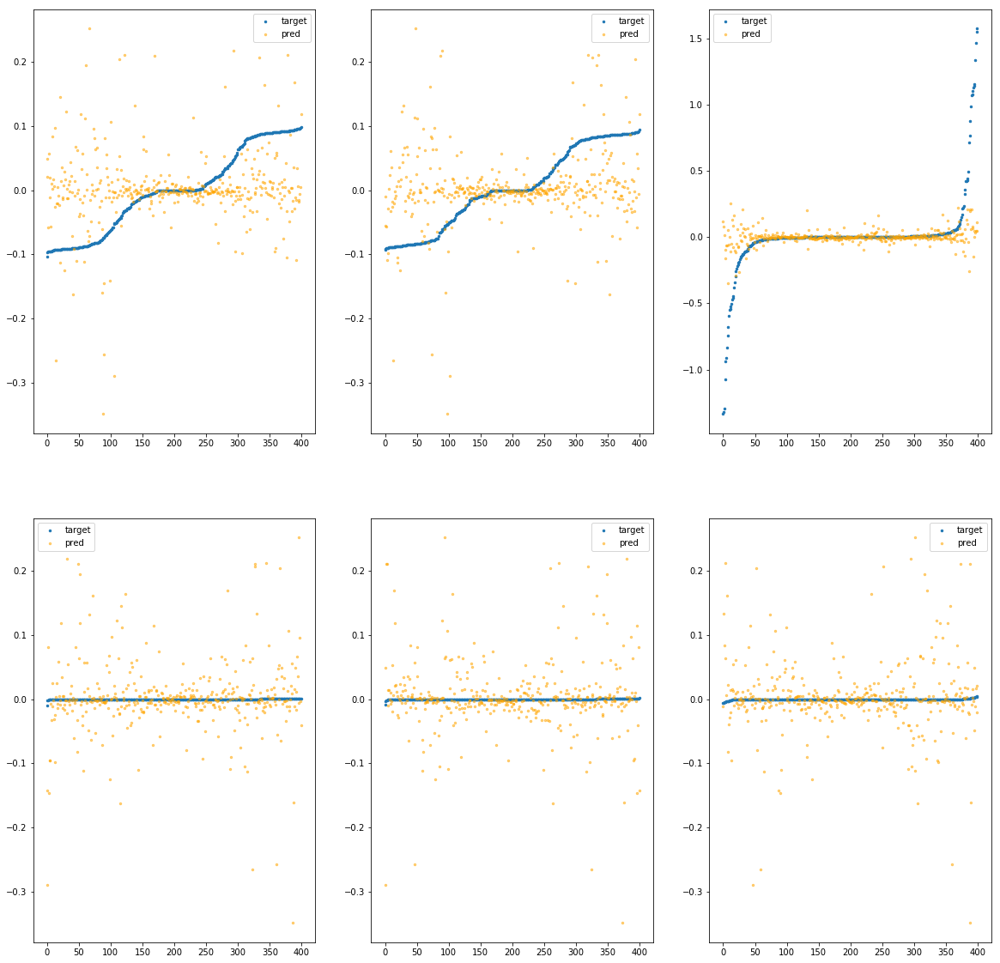

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa97e387160>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.48e+00	5.37e-01	6.96e-02	1.73e+04	1.02e-02	1.03e-04
y		-1.63e+00	4.84e-01	6.98e-02	1.03e+03	1.01e-02	1.02e-04
z		-1.17e-01	1.67e+00	1.13e-01	8.07e+02	9.30e-02	8.66e-03
phi		-1.63e+04	5.04e-01	3.85e-02	3.56e+06	5.91e-03	3.49e-05
theta		-1.91e+04	5.05e-01	3.85e-02	1.27e+06	5.90e-03	3.49e-05
psi		-7.90e+03	5.10e-01	3.85e-02	1.29e+06	5.92e-03	3.51e-05


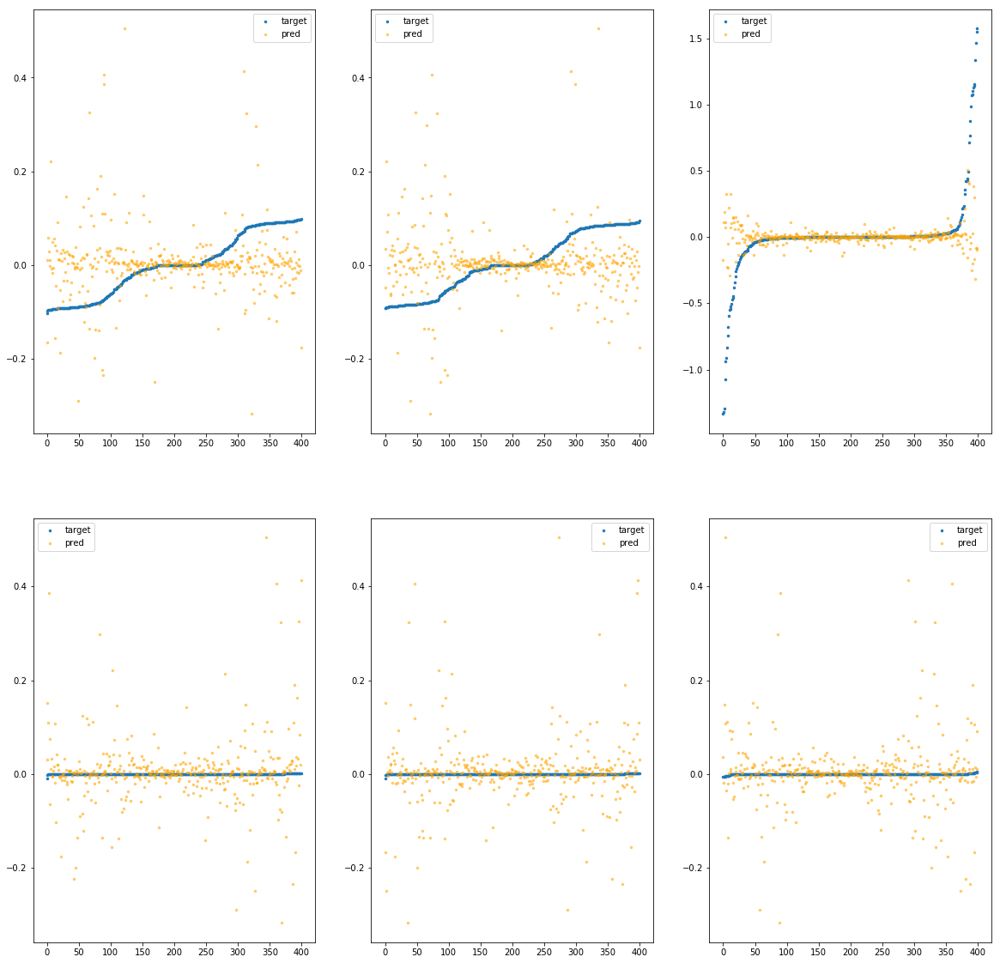

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa97e3871c0>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.45e+00	4.93e-01	6.83e-02	1.53e+04	1.00e-02	1.01e-04
y		-1.45e+00	4.89e-01	6.75e-02	8.03e+02	9.40e-03	8.83e-05
z		-1.22e-01	1.87e+00	1.18e-01	1.03e+03	9.35e-02	8.74e-03
phi		-1.50e+04	4.30e-01	3.83e-02	3.17e+06	5.44e-03	2.96e-05
theta		-1.76e+04	4.31e-01	3.83e-02	6.72e+05	5.45e-03	2.97e-05
psi		-7.31e+03	4.30e-01	3.84e-02	3.63e+06	5.48e-03	3.00e-05


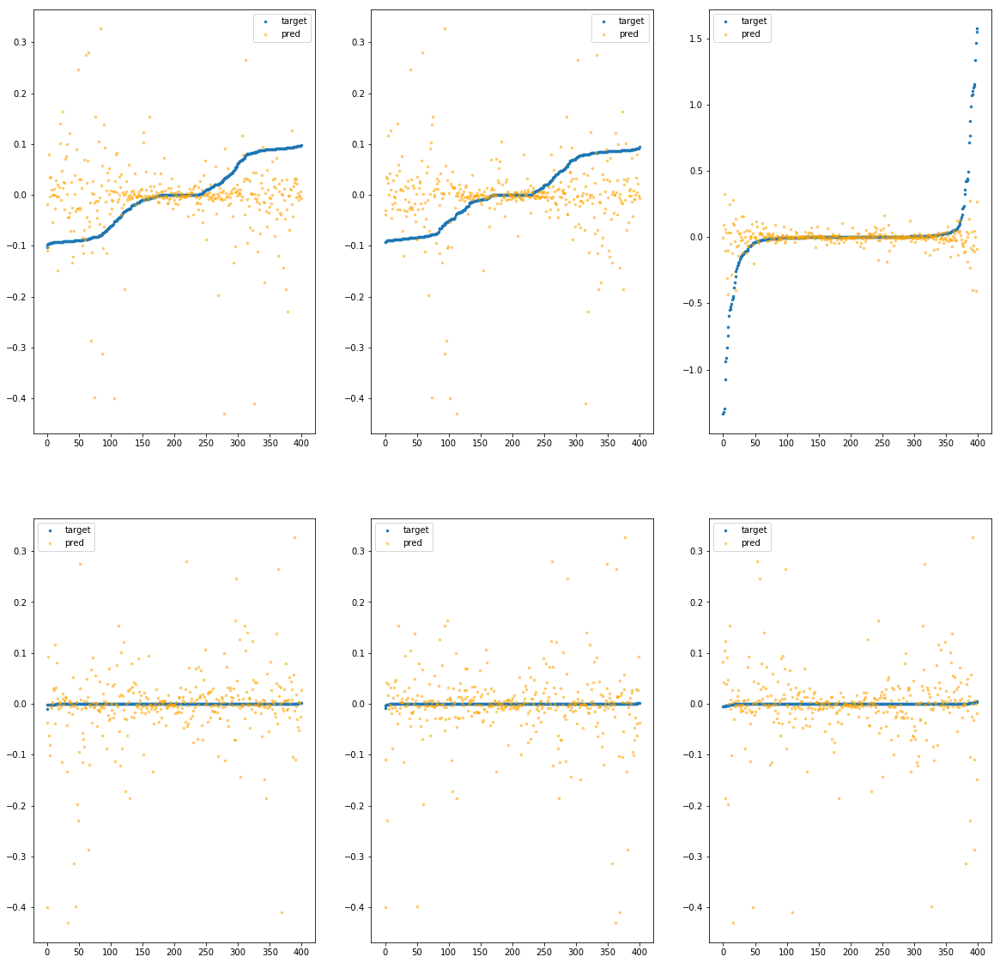

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa97e387220>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.85e+00	5.72e-01	7.34e-02	2.84e+04	1.17e-02	1.36e-04
y		-1.70e+00	5.29e-01	7.02e-02	1.24e+03	1.03e-02	1.07e-04
z		-7.47e-02	1.58e+00	1.20e-01	9.29e+02	8.95e-02	8.02e-03
phi		-1.91e+04	5.40e-01	4.58e-02	5.48e+06	6.92e-03	4.79e-05
theta		-2.24e+04	5.40e-01	4.58e-02	8.28e+05	6.93e-03	4.80e-05
psi		-9.24e+03	5.45e-01	4.58e-02	1.58e+06	6.93e-03	4.80e-05


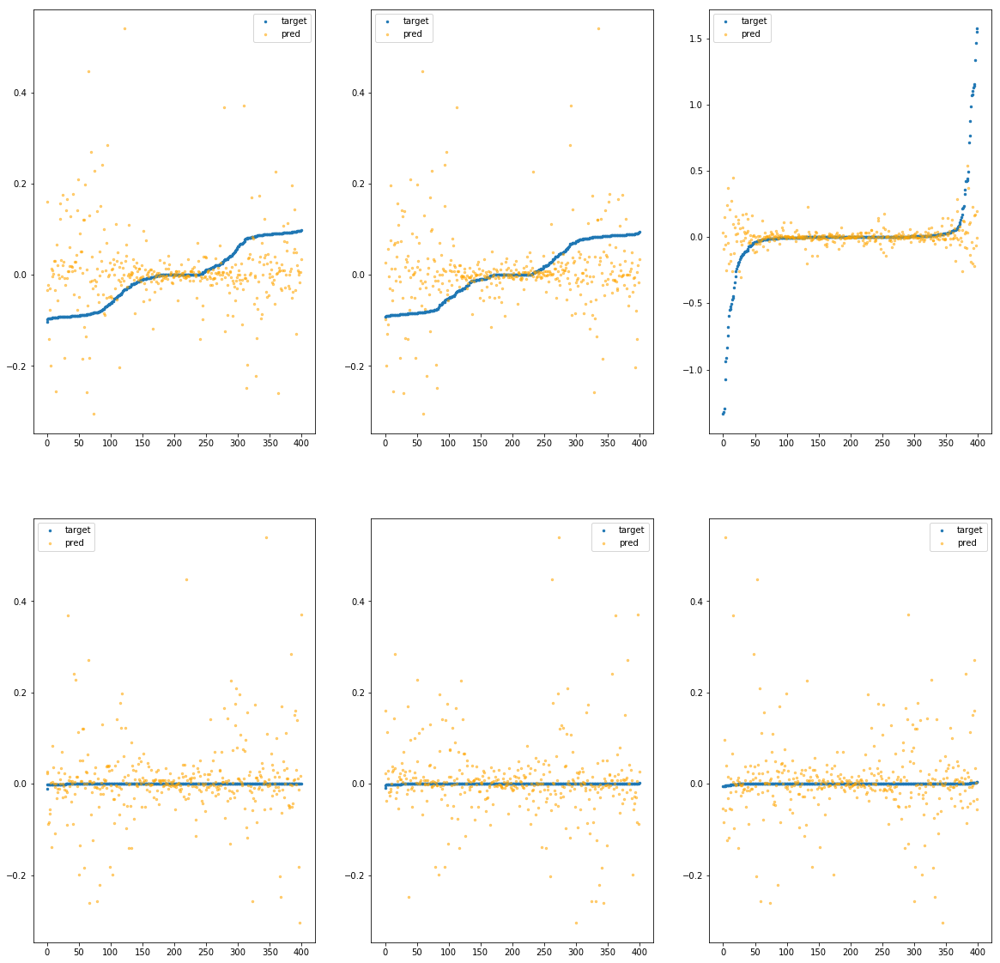

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa97e387280>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.21e+00	5.71e-01	6.47e-02	2.45e+04	9.05e-03	8.19e-05
y		-1.54e+00	5.66e-01	6.75e-02	8.66e+02	9.73e-03	9.46e-05
z		6.40e-02	1.77e+00	1.12e-01	9.18e+02	7.80e-02	6.08e-03
phi		-1.60e+04	4.83e-01	3.94e-02	4.63e+06	5.79e-03	3.35e-05
theta		-1.87e+04	4.83e-01	3.94e-02	9.80e+05	5.78e-03	3.34e-05
psi		-7.74e+03	4.83e-01	3.93e-02	3.80e+06	5.81e-03	3.37e-05


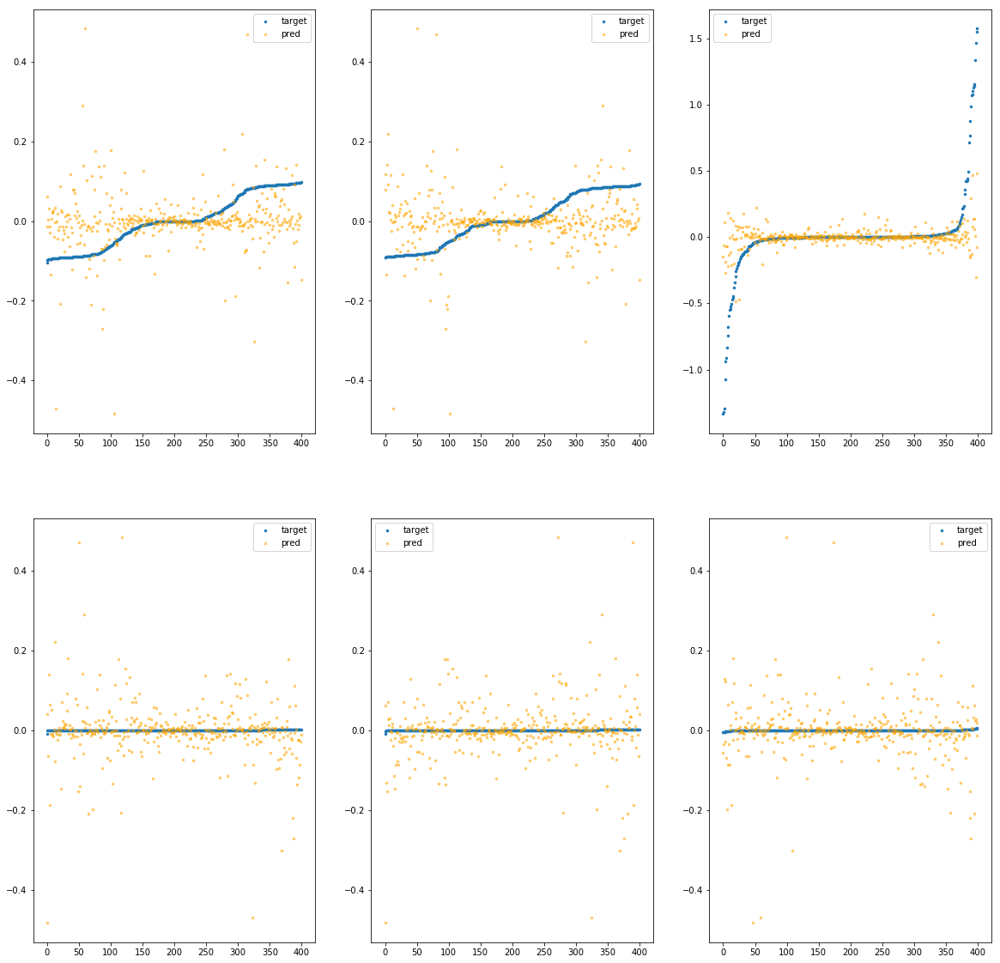

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa97e3872e0>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.81e-03	1.06e-01	5.18e-02	1.23e+03	4.11e-03	1.69e-05
y		-6.11e-03	1.02e-01	5.13e-02	4.91e+01	3.86e-03	1.49e-05
z		-1.17e-03	1.57e+00	1.02e-01	6.59e+01	8.34e-02	6.96e-03
phi		-1.80e+01	1.41e-02	1.78e-03	2.36e+05	6.86e-06	4.71e-11
theta		-2.06e+01	1.30e-02	1.76e-03	9.93e+04	6.69e-06	4.47e-11
psi		-8.82e+00	1.08e-02	1.82e-03	1.60e+05	7.36e-06	5.42e-11


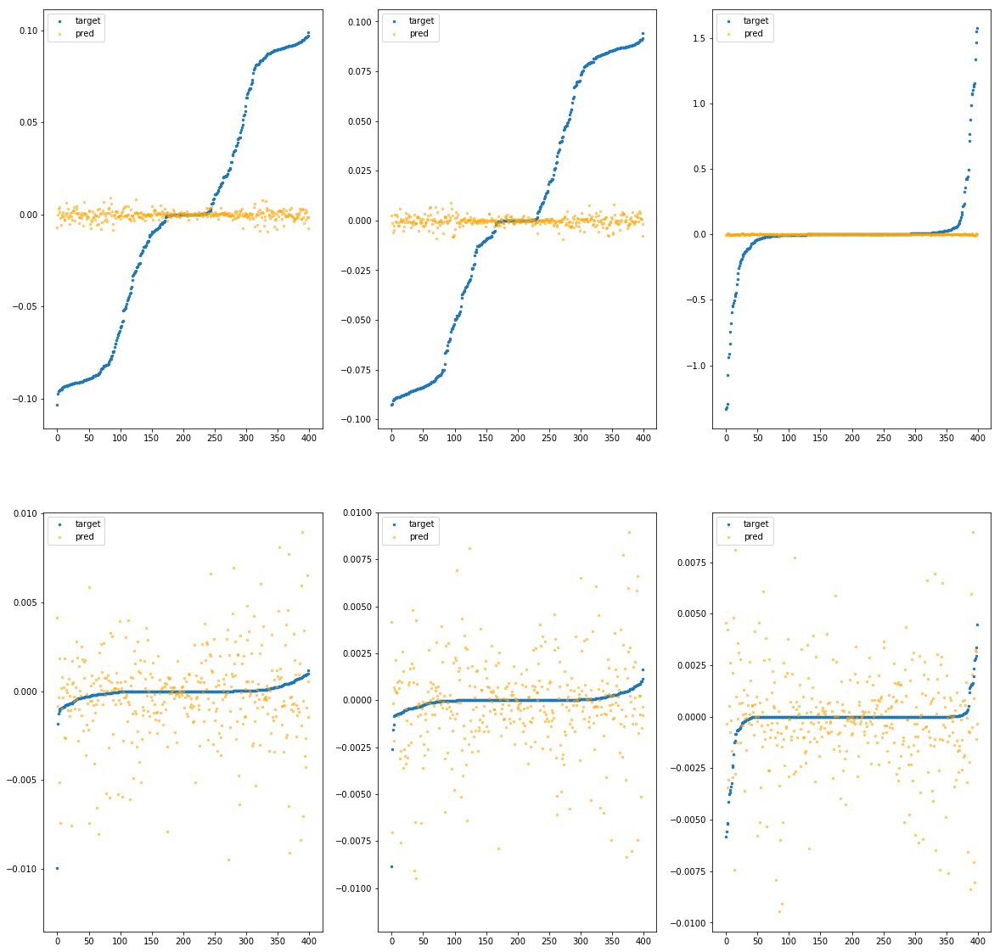

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa97e387340>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.51e-02	1.53e-01	5.27e-02	2.85e+04	4.24e-03	1.80e-05
y		-8.17e-03	1.28e-01	5.12e-02	1.68e+03	3.87e-03	1.49e-05
z		5.86e-04	1.57e+00	1.05e-01	7.08e+02	8.33e-02	6.93e-03
phi		-4.52e+02	6.19e-02	9.46e-03	4.25e+06	1.64e-04	2.69e-08
theta		-5.28e+02	6.23e-02	9.43e-03	1.52e+06	1.63e-04	2.67e-08
psi		-2.19e+02	6.21e-02	9.46e-03	6.36e+05	1.65e-04	2.73e-08


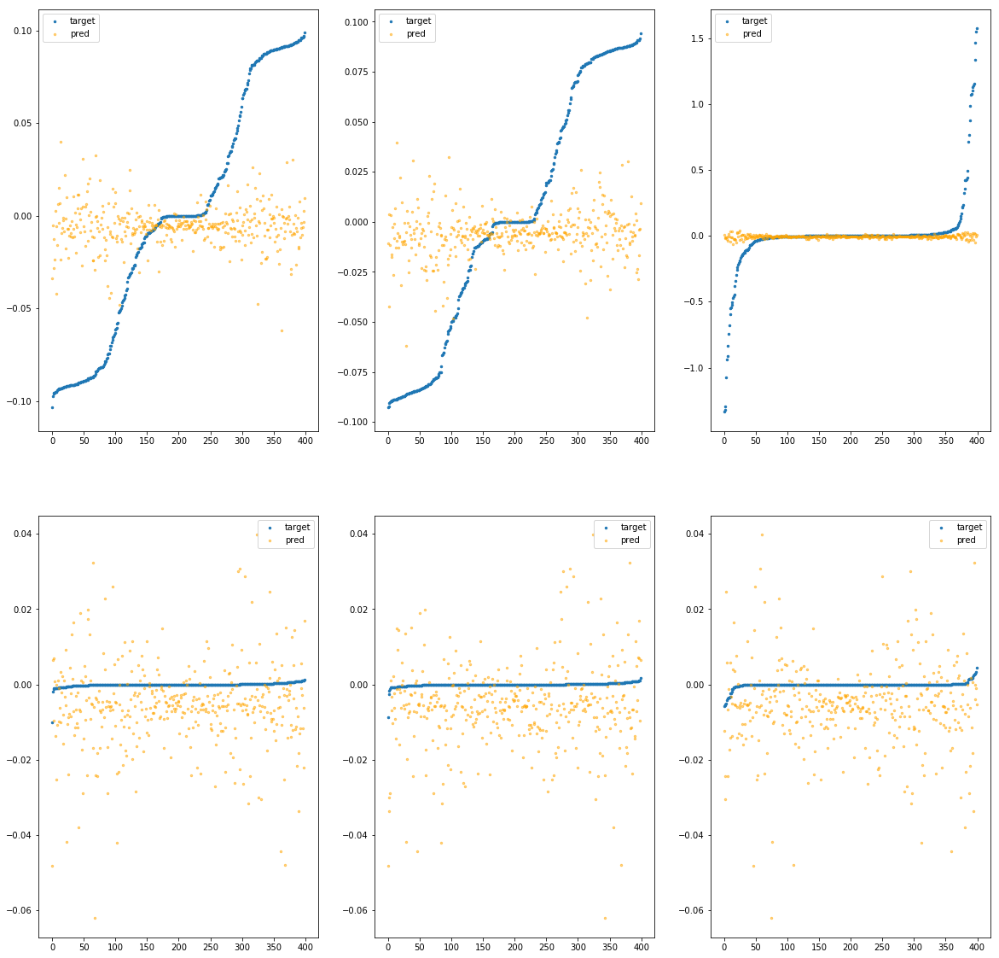

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa97e3873a0>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.00e-02	1.18e-01	5.24e-02	1.71e+04	4.14e-03	1.71e-05
y		-3.29e-02	1.39e-01	5.21e-02	7.98e+02	3.96e-03	1.57e-05
z		-5.40e-03	1.56e+00	1.03e-01	3.87e+02	8.38e-02	7.02e-03
phi		-1.79e+02	5.57e-02	5.45e-03	2.93e+06	6.50e-05	4.23e-09
theta		-2.10e+02	5.62e-02	5.45e-03	7.22e+05	6.51e-05	4.24e-09
psi		-8.55e+01	5.60e-02	5.46e-03	3.71e+05	6.49e-05	4.21e-09


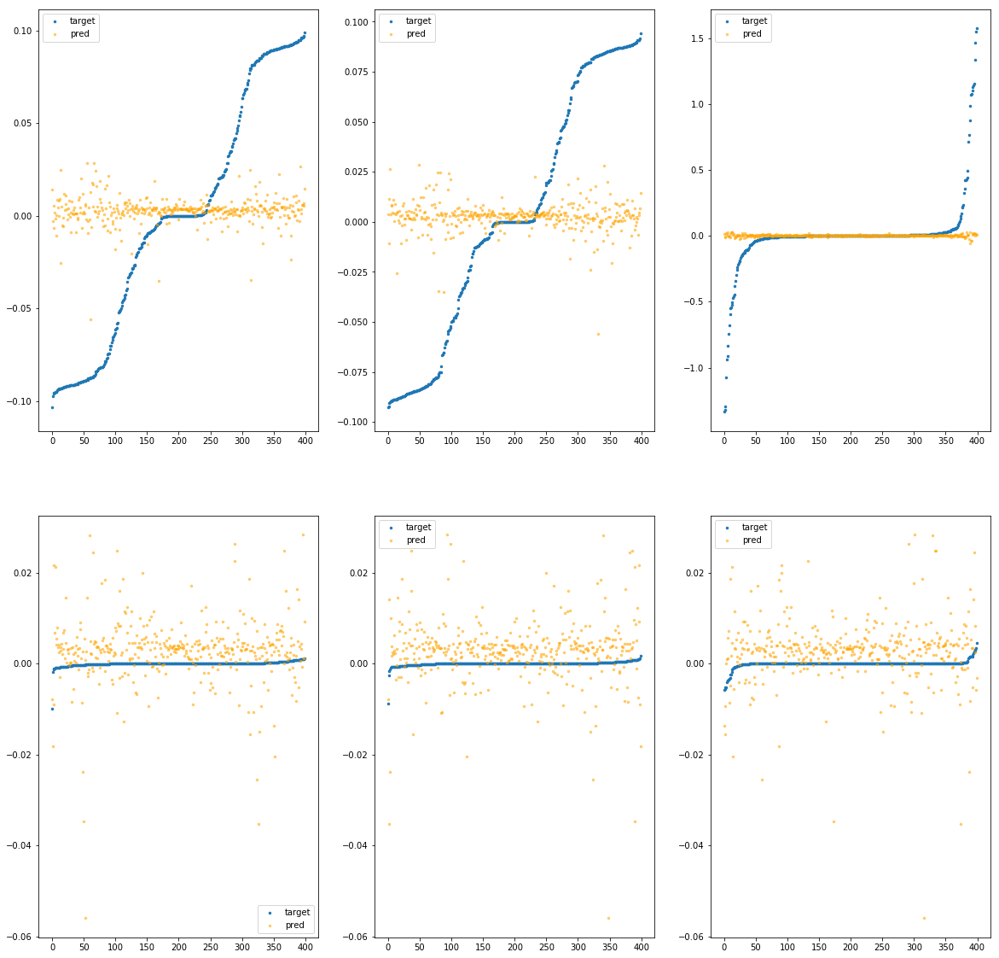

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa97e387400>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.89e-02	1.28e-01	5.31e-02	8.27e+03	4.29e-03	1.84e-05
y		-5.17e-02	1.29e-01	5.23e-02	3.30e+02	4.03e-03	1.63e-05
z		-8.26e-03	1.59e+00	1.04e-01	2.82e+02	8.40e-02	7.06e-03
phi		-3.03e+02	4.89e-02	7.25e-03	1.48e+06	1.10e-04	1.22e-08
theta		-3.56e+02	4.80e-02	7.28e-03	3.74e+05	1.10e-04	1.21e-08
psi		-1.49e+02	4.84e-02	7.29e-03	6.91e+05	1.12e-04	1.26e-08


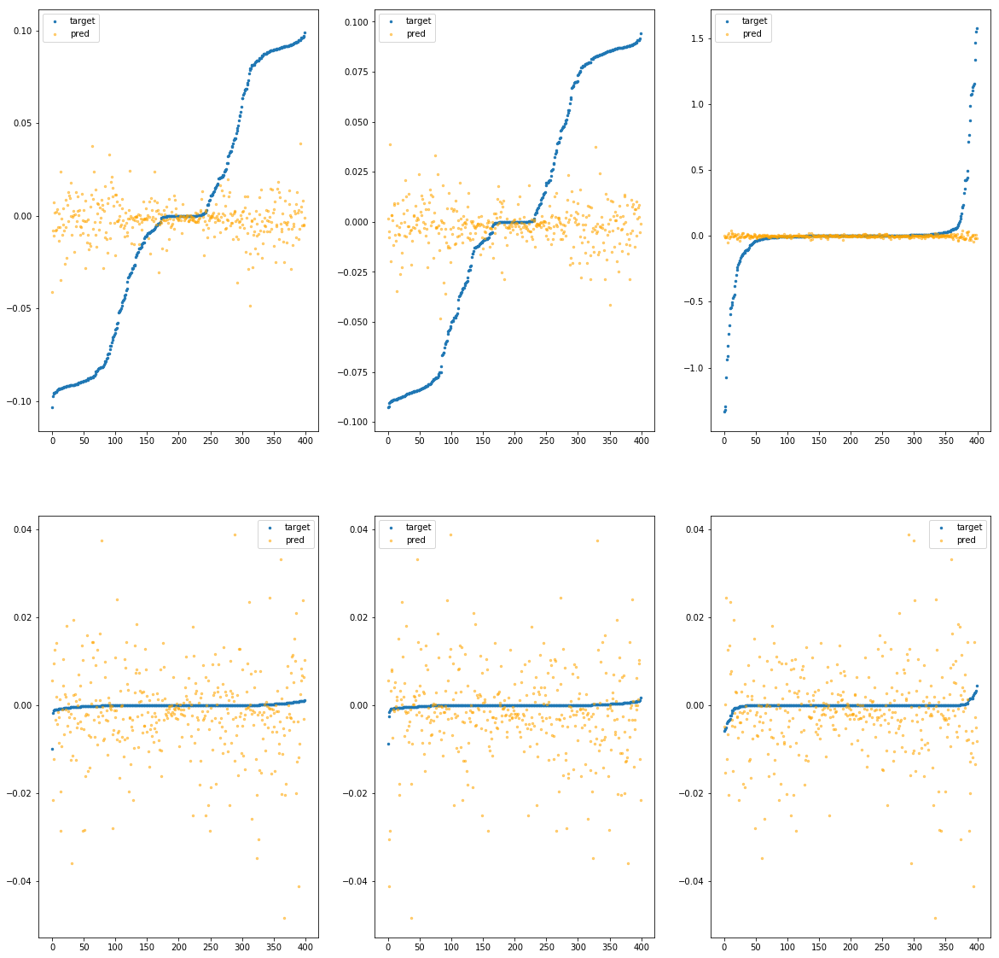

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa97e387460>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.37e-02	1.50e-01	5.36e-02	2.37e+04	4.35e-03	1.90e-05
y		-8.64e-02	1.48e-01	5.28e-02	1.24e+03	4.17e-03	1.74e-05
z		9.76e-03	1.59e+00	1.04e-01	5.75e+02	8.25e-02	6.81e-03
phi		-6.60e+02	1.04e-01	9.57e-03	3.90e+06	2.39e-04	5.73e-08
theta		-7.79e+02	1.03e-01	9.61e-03	1.06e+06	2.41e-04	5.81e-08
psi		-3.15e+02	1.04e-01	9.54e-03	5.25e+05	2.37e-04	5.62e-08


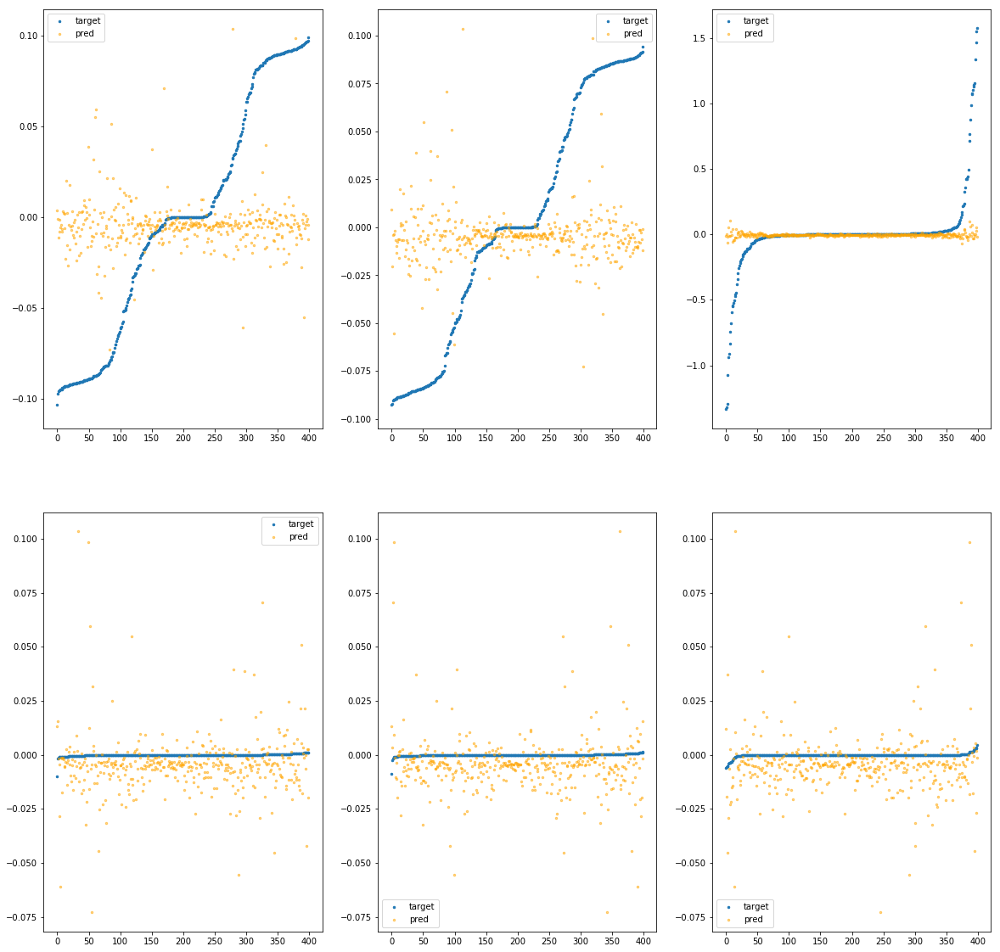

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa97e3874c0>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.89e-03	1.03e-01	5.16e-02	6.69e+02	4.09e-03	1.67e-05
y		-1.27e-03	9.25e-02	5.11e-02	4.32e+01	3.84e-03	1.47e-05
z		-8.04e-04	1.57e+00	1.02e-01	2.30e+01	8.34e-02	6.95e-03
phi		-1.63e+00	8.88e-03	6.51e-04	1.28e+05	9.52e-07	9.06e-13
theta		-1.83e+00	7.73e-03	6.35e-04	3.50e+04	8.74e-07	7.63e-13
psi		-6.72e-01	6.40e-03	7.38e-04	5.02e+04	1.25e-06	1.57e-12


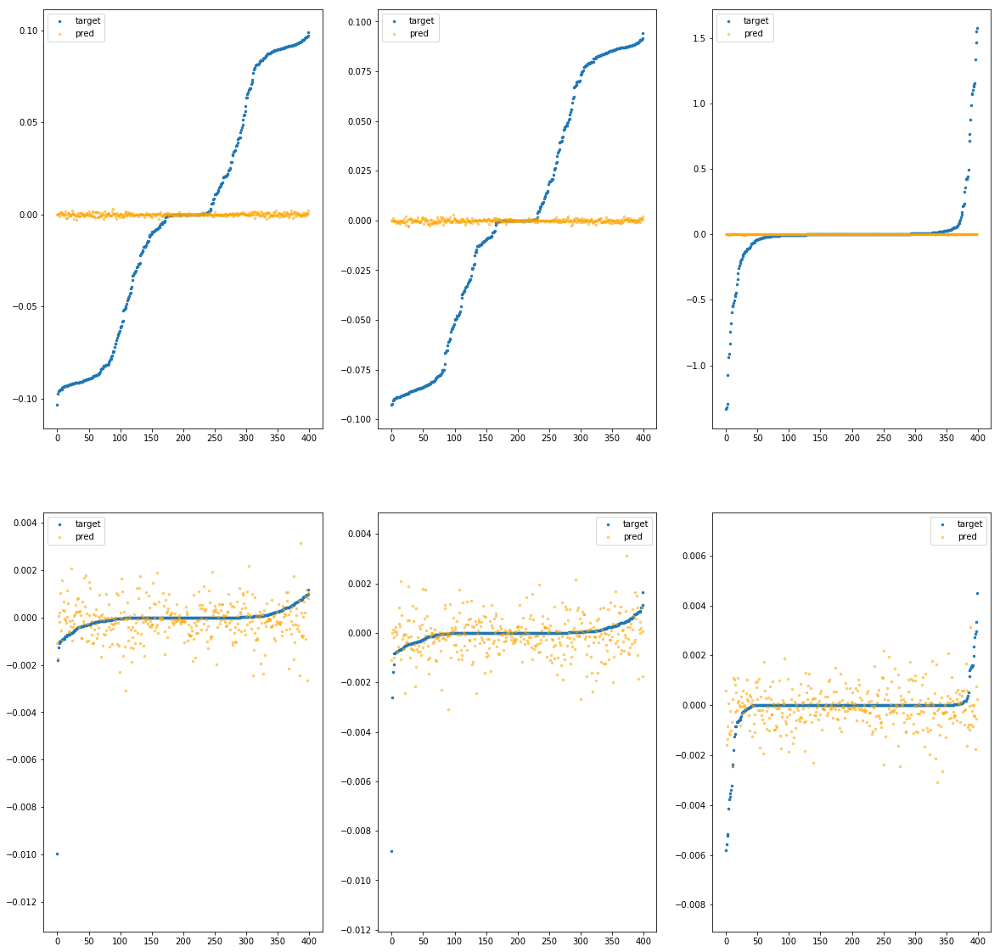

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa97e387520>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.21e-03	1.01e-01	5.20e-02	6.07e+03	4.11e-03	1.69e-05
y		1.19e-03	9.44e-02	5.13e-02	3.20e+02	3.83e-03	1.47e-05
z		1.37e-04	1.57e+00	1.02e-01	1.46e+02	8.33e-02	6.94e-03
phi		-1.10e+01	8.63e-03	1.69e-03	1.04e+06	4.34e-06	1.88e-11
theta		-1.24e+01	7.48e-03	1.66e-03	2.55e+05	4.13e-06	1.70e-11
psi		-5.60e+00	9.94e-03	1.75e-03	1.87e+05	4.95e-06	2.45e-11


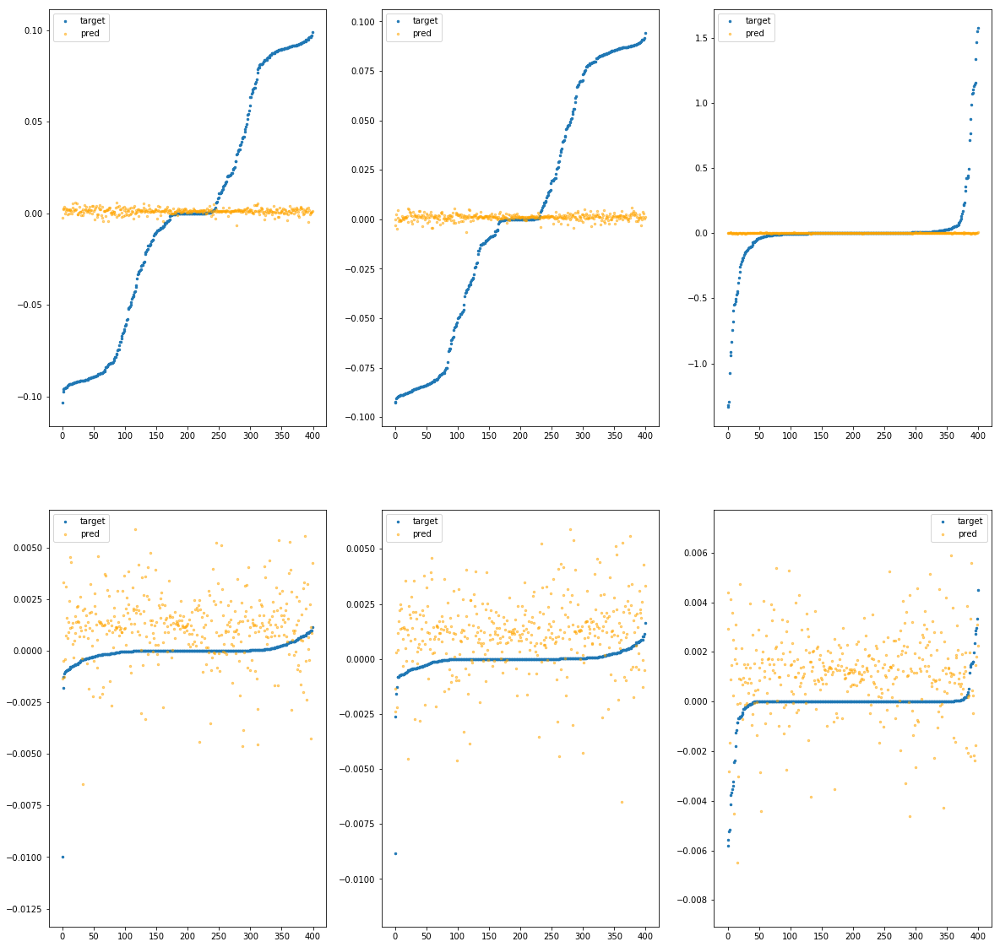

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa97e387580>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.01e-03	1.04e-01	5.20e-02	2.15e+03	4.11e-03	1.69e-05
y		-2.82e-03	9.93e-02	5.12e-02	8.70e+01	3.85e-03	1.48e-05
z		1.19e-03	1.57e+00	1.02e-01	9.08e+01	8.32e-02	6.93e-03
phi		-3.10e+01	2.10e-02	2.15e-03	2.90e+05	1.16e-05	1.34e-10
theta		-3.64e+01	2.01e-02	2.15e-03	8.48e+04	1.16e-05	1.34e-10
psi		-1.45e+01	2.05e-02	2.17e-03	1.36e+05	1.16e-05	1.35e-10


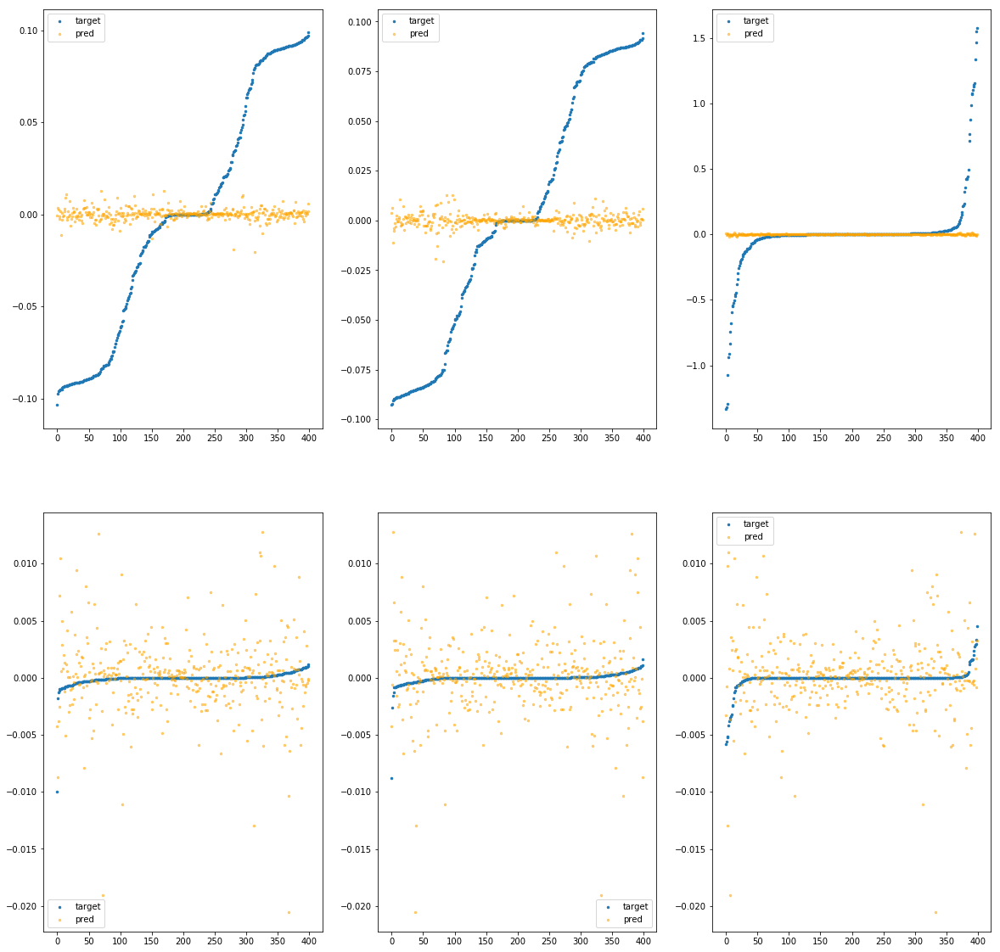

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa97e3875e0>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		3.09e-03	1.06e-01	5.17e-02	2.03e+03	4.08e-03	1.67e-05
y		7.84e-04	9.92e-02	5.11e-02	6.21e+01	3.83e-03	1.47e-05
z		-1.50e-03	1.57e+00	1.02e-01	7.80e+01	8.34e-02	6.96e-03
phi		-1.98e+01	1.80e-02	1.79e-03	4.93e+05	7.53e-06	5.67e-11
theta		-2.26e+01	1.73e-02	1.75e-03	8.73e+04	7.29e-06	5.31e-11
psi		-9.78e+00	1.76e-02	1.82e-03	1.17e+05	8.09e-06	6.54e-11


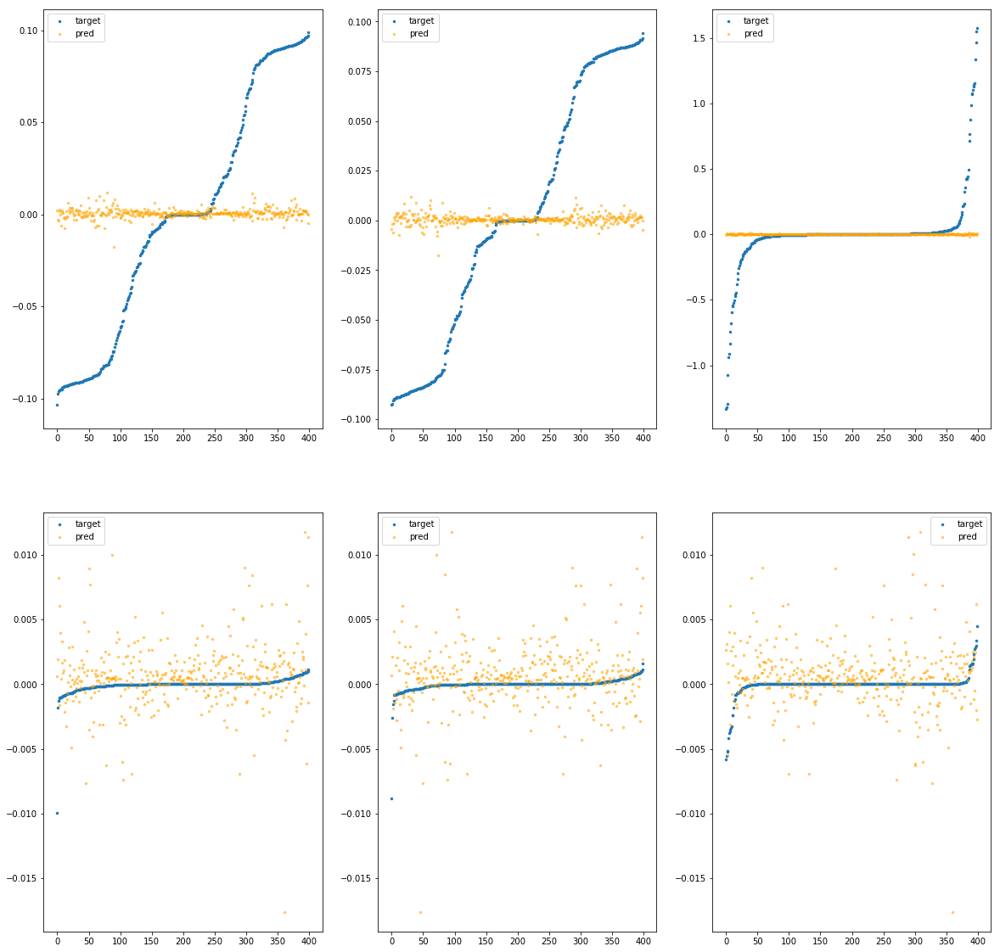

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa97e387640>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.58e-02	1.14e-01	5.14e-02	3.44e+03	4.03e-03	1.62e-05
y		1.98e-02	1.02e-01	5.07e-02	1.12e+02	3.76e-03	1.41e-05
z		3.89e-03	1.57e+00	1.03e-01	1.47e+02	8.30e-02	6.89e-03
phi		-1.11e+02	4.24e-02	4.19e-03	7.95e+05	4.05e-05	1.64e-09
theta		-1.29e+02	4.24e-02	4.15e-03	2.22e+05	4.00e-05	1.60e-09
psi		-5.58e+01	4.24e-02	4.27e-03	3.71e+05	4.26e-05	1.81e-09


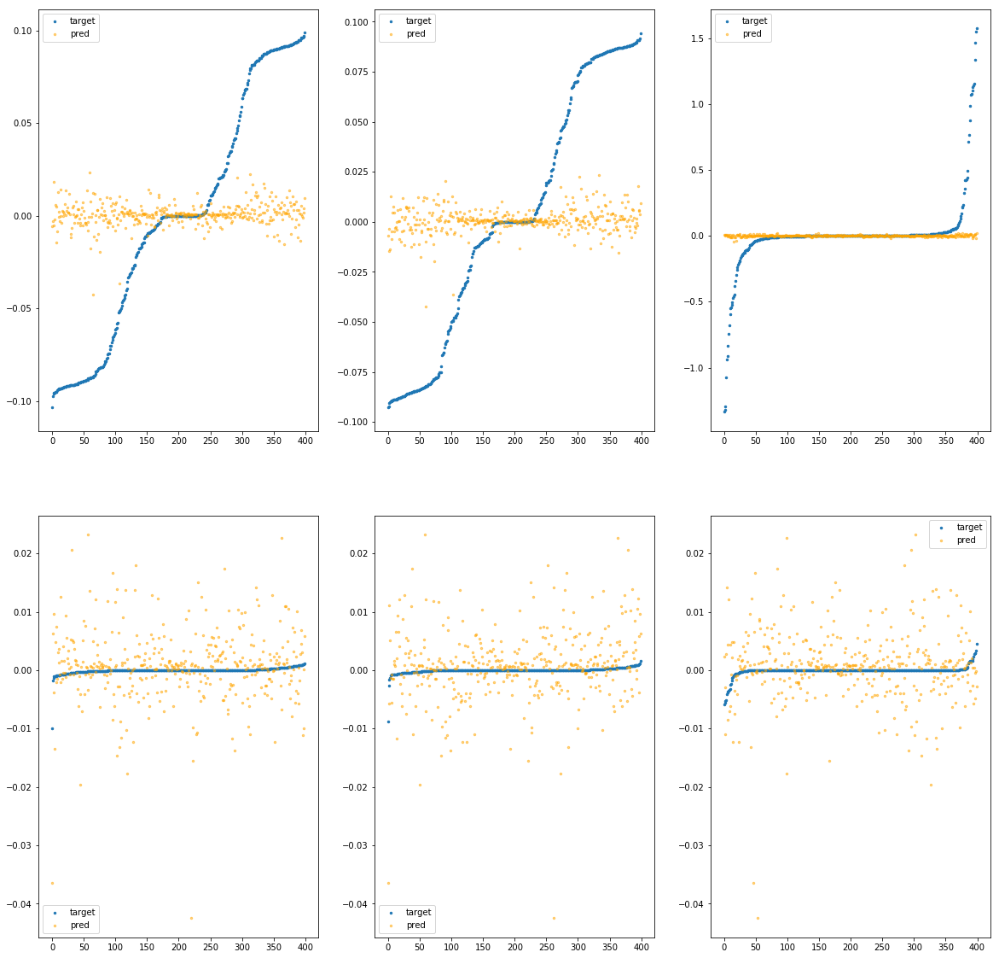

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa97e3876a0>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.57e-03	1.01e-01	5.17e-02	6.88e+03	4.09e-03	1.67e-05
y		-6.21e-03	9.32e-02	5.13e-02	3.62e+02	3.86e-03	1.49e-05
z		-8.88e-04	1.57e+00	1.02e-01	1.60e+02	8.34e-02	6.95e-03
phi		-8.66e+00	1.01e-02	1.59e-03	1.12e+06	3.50e-06	1.22e-11
theta		-1.01e+01	8.96e-03	1.58e-03	2.94e+05	3.42e-06	1.17e-11
psi		-3.79e+00	8.56e-03	1.61e-03	1.71e+05	3.59e-06	1.29e-11


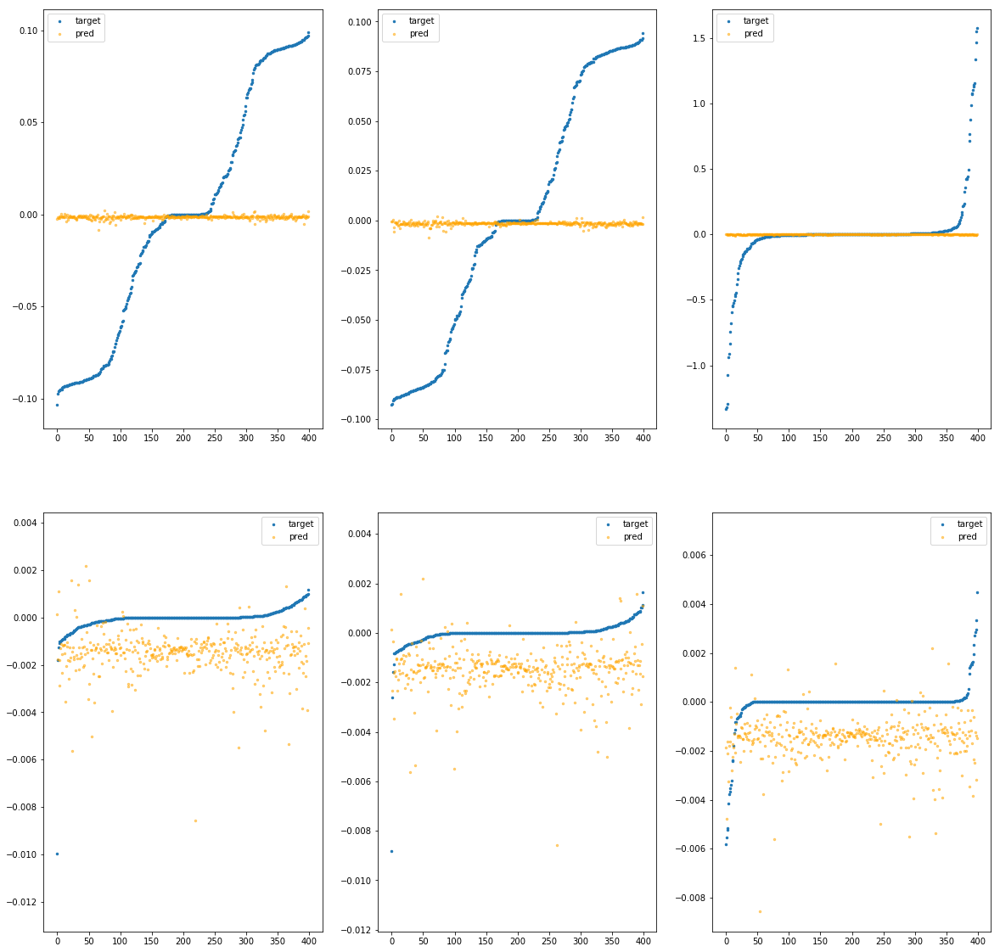

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa97e387700>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.78e-03	1.05e-01	5.16e-02	6.76e+02	4.09e-03	1.67e-05
y		-1.43e-03	9.37e-02	5.11e-02	2.31e+01	3.84e-03	1.47e-05
z		-1.62e-04	1.57e+00	1.02e-01	1.57e+01	8.33e-02	6.94e-03
phi		-1.02e+00	6.54e-03	5.26e-04	1.09e+05	7.31e-07	5.34e-13
theta		-1.32e+00	5.39e-03	5.16e-04	2.53e+04	7.18e-07	5.15e-13
psi		-4.88e-01	5.96e-03	6.00e-04	2.75e+04	1.12e-06	1.25e-12


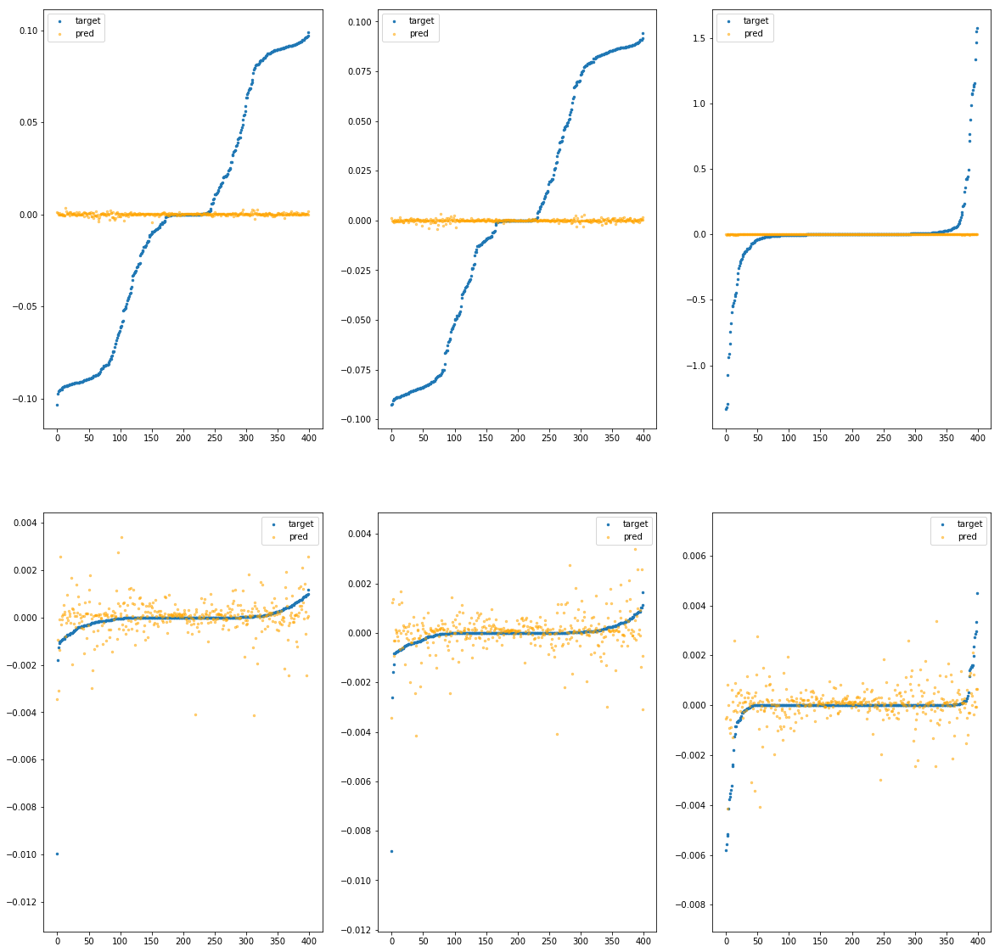

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa97e387760>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.86e-03	1.06e-01	5.18e-02	3.46e+03	4.10e-03	1.68e-05
y		-5.01e-03	9.39e-02	5.12e-02	1.63e+02	3.85e-03	1.48e-05
z		-3.71e-04	1.57e+00	1.02e-01	8.82e+01	8.33e-02	6.95e-03
phi		-7.61e+00	1.27e-02	1.23e-03	6.66e+05	3.12e-06	9.73e-12
theta		-8.90e+00	1.19e-02	1.24e-03	1.48e+05	3.06e-06	9.35e-12
psi		-3.78e+00	1.23e-02	1.30e-03	9.72e+04	3.58e-06	1.28e-11


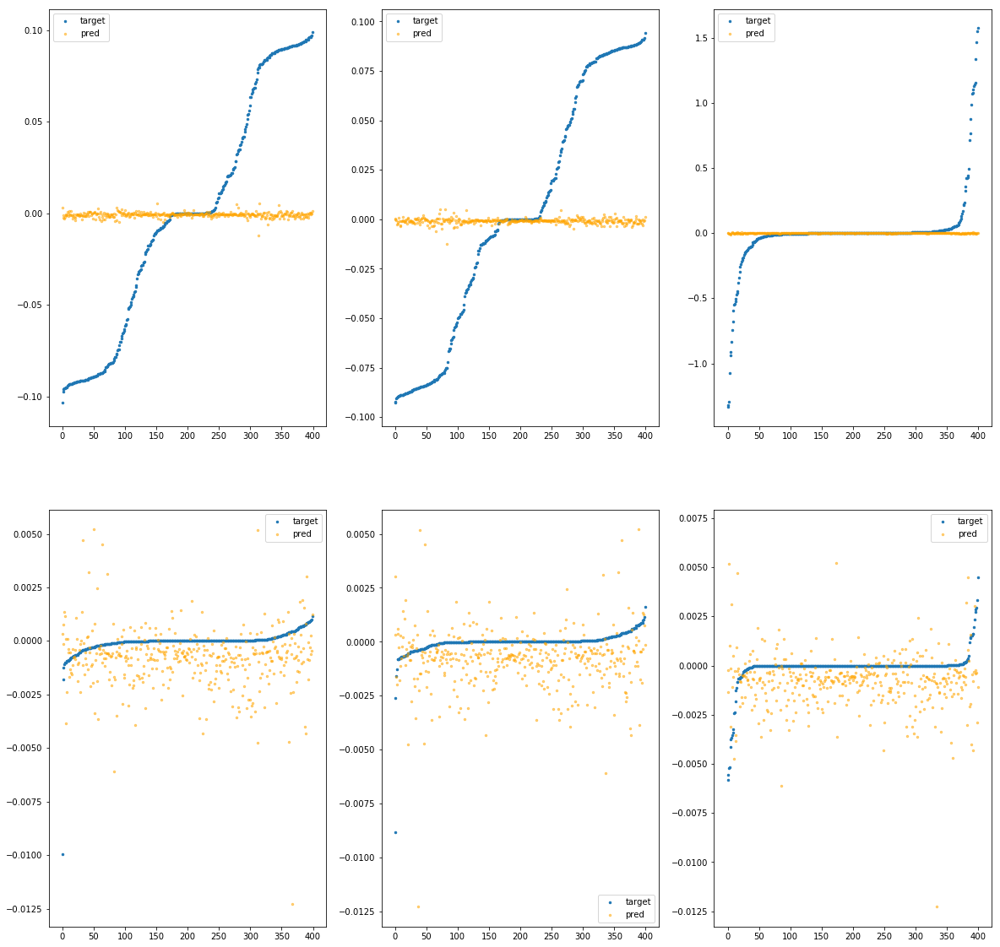

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa97e3877c0>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.45e-04	1.02e-01	5.17e-02	1.68e+03	4.09e-03	1.68e-05
y		-1.54e-04	9.72e-02	5.11e-02	9.89e+01	3.83e-03	1.47e-05
z		-9.81e-04	1.57e+00	1.02e-01	3.30e+01	8.34e-02	6.96e-03
phi		-4.80e+00	9.60e-03	9.68e-04	3.29e+05	2.10e-06	4.42e-12
theta		-4.99e+00	8.45e-03	9.20e-04	7.96e+04	1.85e-06	3.43e-12
psi		-2.60e+00	9.35e-03	1.03e-03	6.02e+04	2.70e-06	7.30e-12


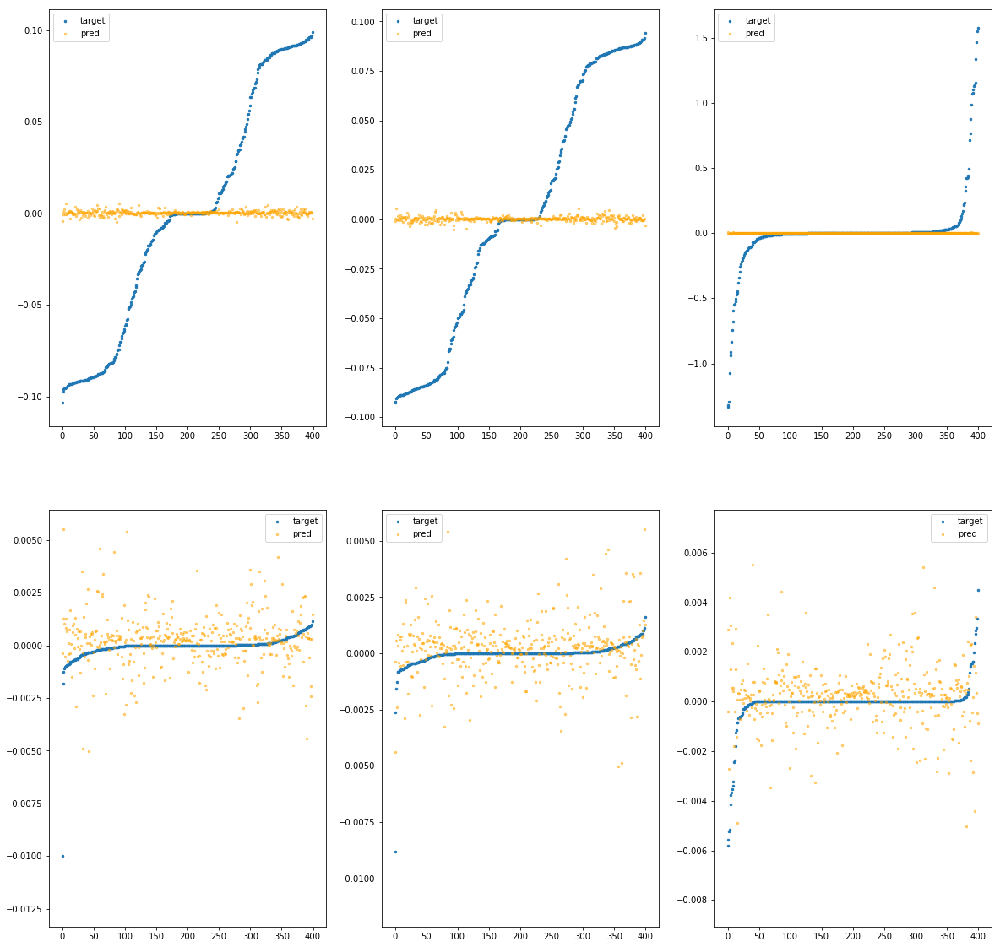

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa97e387820>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.14e-03	1.08e-01	5.20e-02	5.91e+03	4.09e-03	1.67e-05
y		-1.59e-02	1.13e-01	5.19e-02	3.37e+02	3.90e-03	1.52e-05
z		-4.73e-03	1.59e+00	1.03e-01	2.20e+02	8.37e-02	7.01e-03
phi		-1.02e+02	2.87e-02	4.12e-03	1.01e+06	3.72e-05	1.39e-09
theta		-1.20e+02	2.69e-02	4.11e-03	4.07e+05	3.73e-05	1.39e-09
psi		-4.94e+01	3.02e-02	4.13e-03	3.86e+05	3.78e-05	1.43e-09


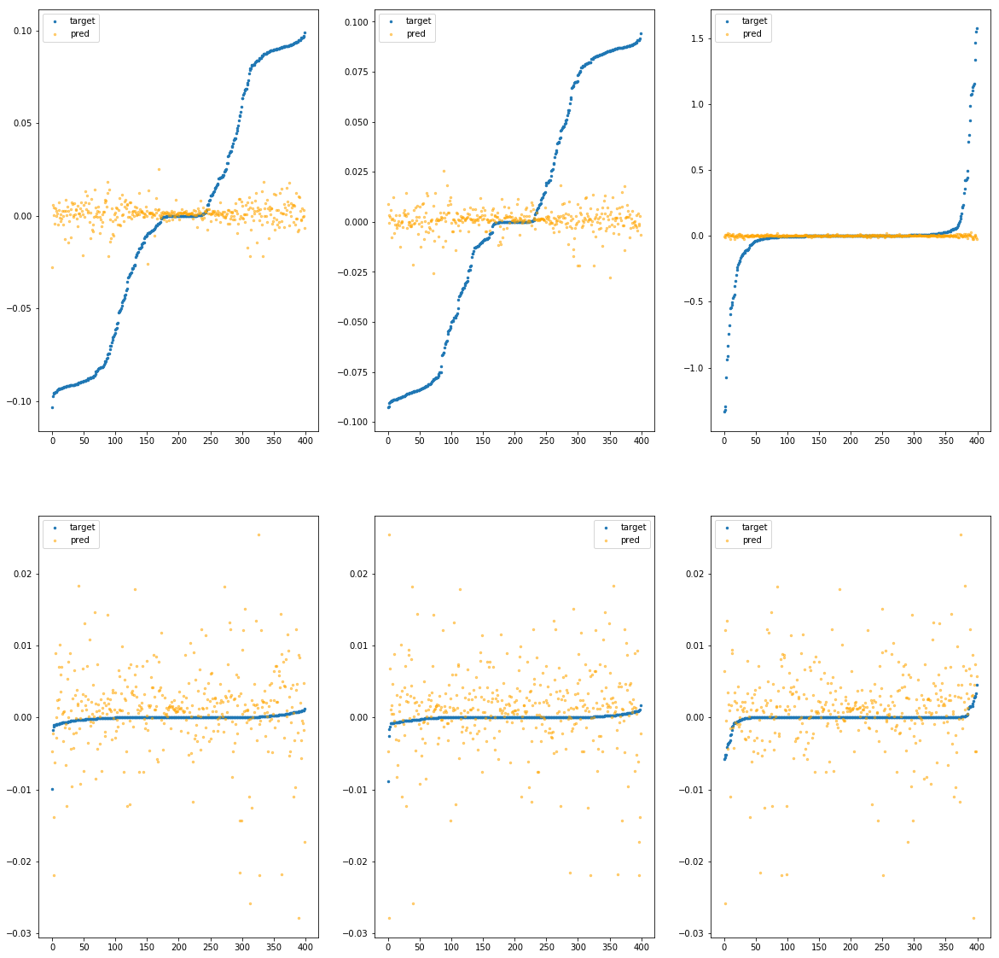

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa97e387880>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		3.61e-03	1.04e-01	5.16e-02	2.61e+03	4.08e-03	1.66e-05
y		-3.47e-03	9.39e-02	5.12e-02	1.42e+02	3.85e-03	1.48e-05
z		-4.66e-05	1.57e+00	1.02e-01	6.31e+01	8.33e-02	6.94e-03
phi		-2.26e+00	6.97e-03	8.00e-04	4.09e+05	1.18e-06	1.39e-12
theta		-2.86e+00	5.82e-03	7.99e-04	1.10e+05	1.19e-06	1.42e-12
psi		-1.20e+00	6.03e-03	9.00e-04	6.76e+04	1.65e-06	2.73e-12


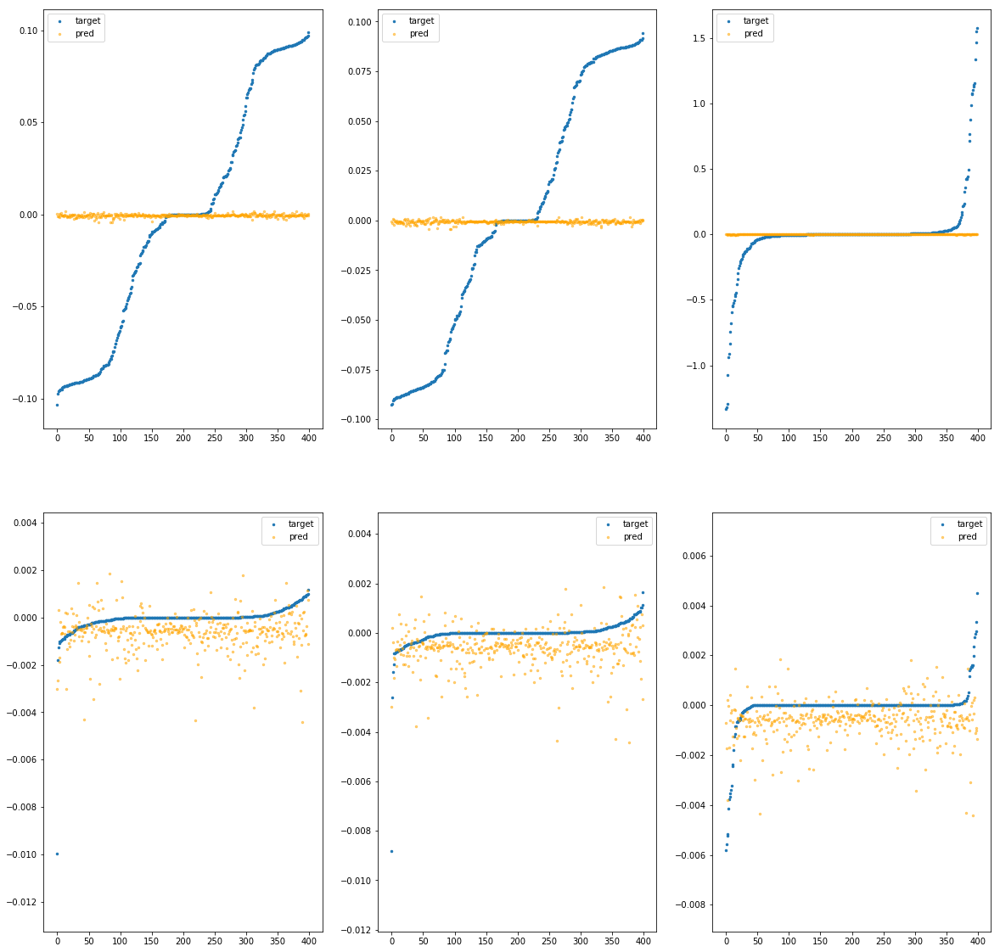

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa97e3878e0>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		9.64e-04	1.02e-01	5.17e-02	2.28e+03	4.09e-03	1.67e-05
y		-3.45e-03	9.49e-02	5.12e-02	1.03e+02	3.85e-03	1.48e-05
z		-9.47e-04	1.57e+00	1.02e-01	5.60e+01	8.34e-02	6.95e-03
phi		-1.46e+00	1.03e-02	6.32e-04	3.74e+05	8.92e-07	7.95e-13
theta		-1.66e+00	9.12e-03	6.11e-04	9.59e+04	8.22e-07	6.75e-13
psi		-7.74e-01	6.42e-03	7.36e-04	6.18e+04	1.33e-06	1.77e-12


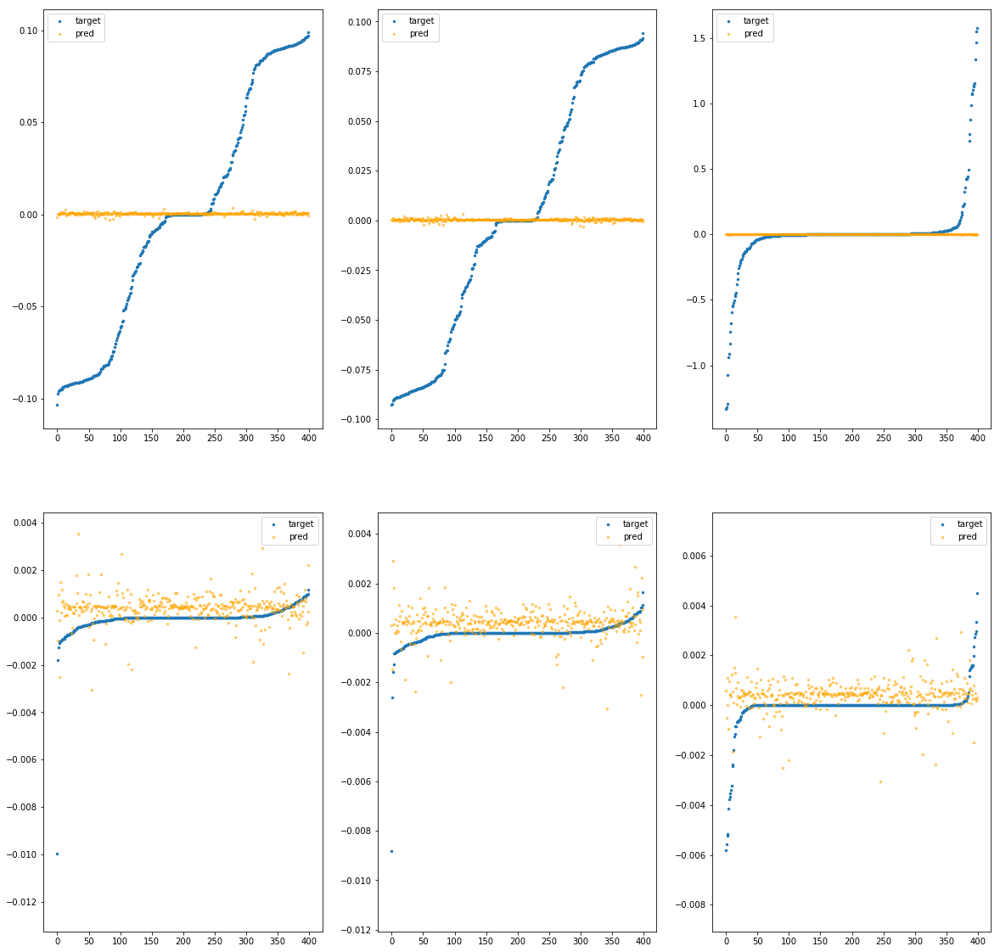

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa97e387940>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.29e-03	1.01e-01	5.17e-02	2.81e+03	4.09e-03	1.67e-05
y		-1.80e-03	9.64e-02	5.11e-02	1.42e+02	3.84e-03	1.48e-05
z		-9.10e-04	1.58e+00	1.02e-01	6.64e+01	8.34e-02	6.95e-03
phi		-3.93e+00	1.25e-02	8.82e-04	4.92e+05	1.78e-06	3.18e-12
theta		-4.48e+00	1.14e-02	8.62e-04	9.85e+04	1.69e-06	2.87e-12
psi		-1.76e+00	7.34e-03	9.35e-04	5.45e+04	2.07e-06	4.28e-12


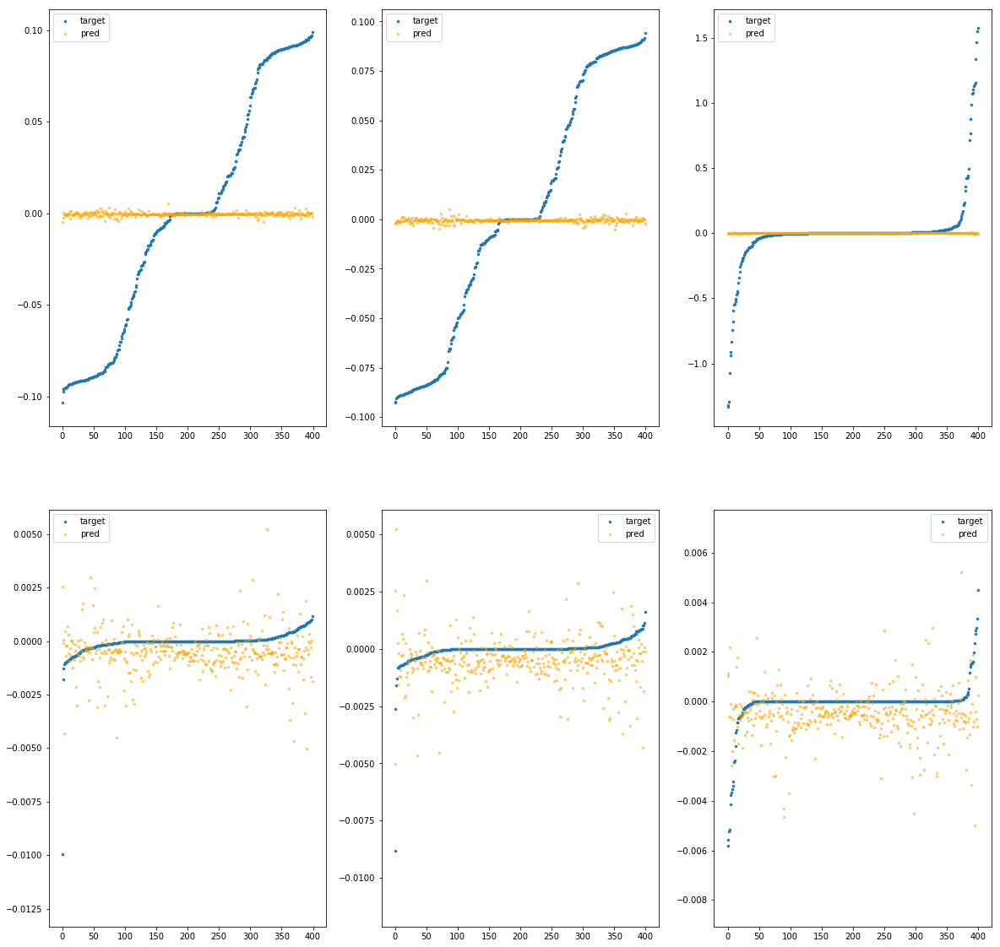

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa97e3879a0>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.22e-04	1.03e-01	5.17e-02	6.42e+02	4.10e-03	1.68e-05
y		-5.58e-03	9.41e-02	5.12e-02	3.01e+01	3.86e-03	1.49e-05
z		-9.42e-04	1.57e+00	1.02e-01	1.96e+01	8.34e-02	6.95e-03
phi		-1.85e+00	6.62e-03	6.55e-04	1.80e+05	1.03e-06	1.07e-12
theta		-2.29e+00	5.47e-03	6.17e-04	2.58e+04	1.02e-06	1.03e-12
psi		-8.69e-01	6.48e-03	7.06e-04	5.54e+04	1.40e-06	1.96e-12


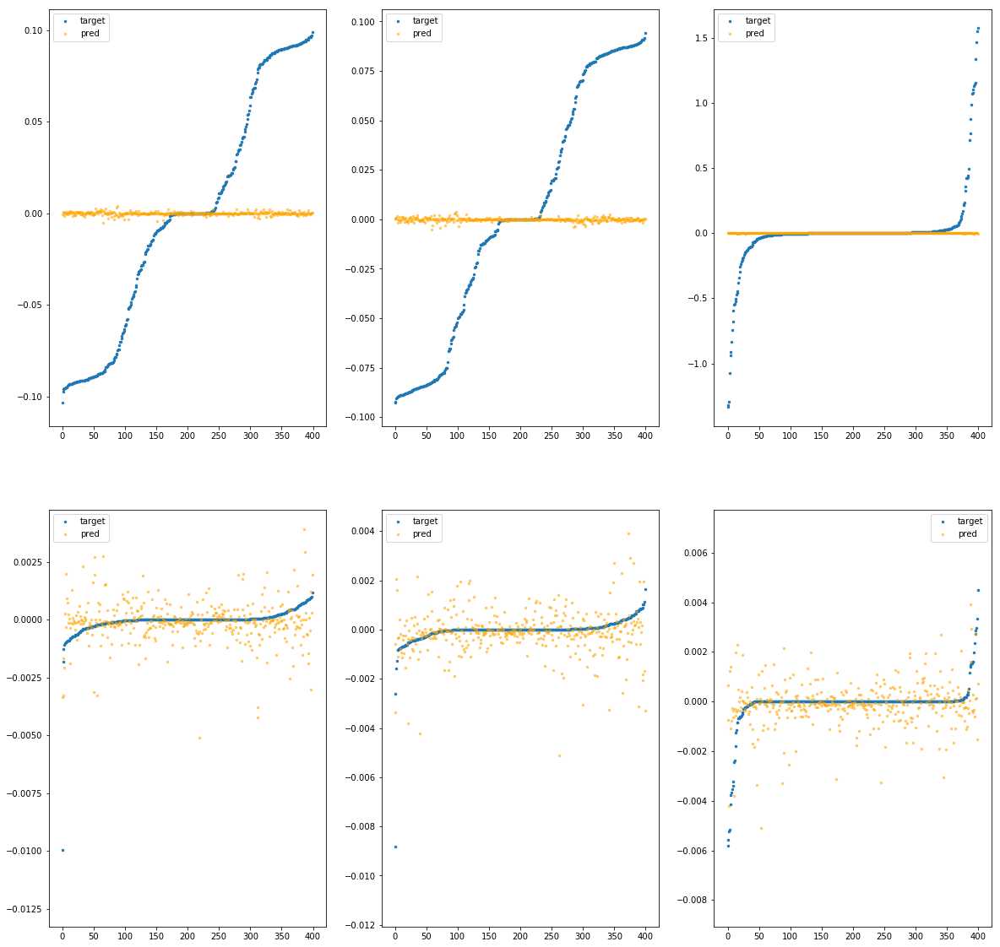

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa97e387a00>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.01e-04	1.04e-01	5.17e-02	4.66e+03	4.10e-03	1.68e-05
y		-3.82e-03	9.25e-02	5.12e-02	2.52e+02	3.85e-03	1.48e-05
z		-1.11e-03	1.57e+00	1.02e-01	1.14e+02	8.34e-02	6.96e-03
phi		-4.80e+00	1.03e-02	1.10e-03	7.93e+05	2.10e-06	4.41e-12
theta		-5.70e+00	9.15e-03	1.11e-03	2.08e+05	2.07e-06	4.29e-12
psi		-1.83e+00	6.77e-03	1.13e-03	1.26e+05	2.13e-06	4.52e-12


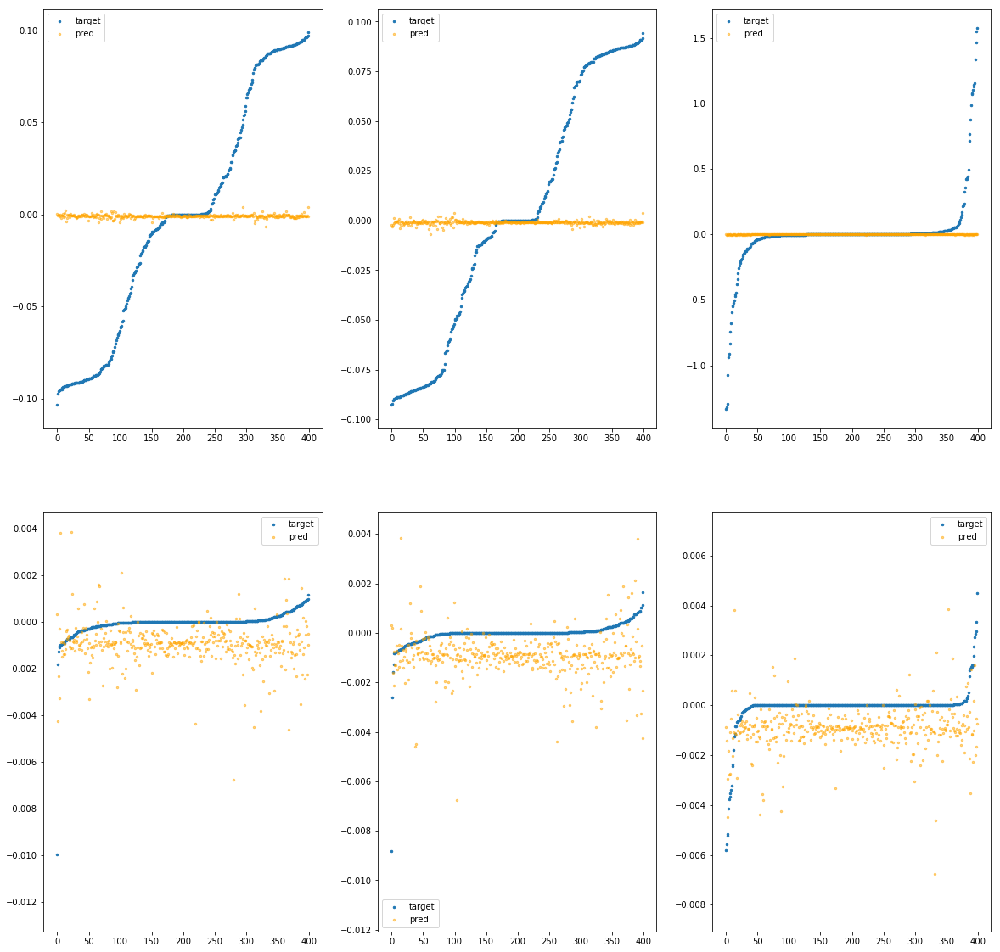

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa97e387a60>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.51e-02	1.45e-01	5.25e-02	3.85e+04	4.20e-03	1.76e-05
y		-1.05e-01	1.77e-01	5.38e-02	1.75e+03	4.24e-03	1.79e-05
z		5.42e-03	1.57e+00	1.06e-01	8.42e+02	8.29e-02	6.87e-03
phi		-7.53e+02	9.04e-02	1.20e-02	5.76e+06	2.73e-04	7.46e-08
theta		-8.77e+02	9.04e-02	1.20e-02	2.11e+06	2.71e-04	7.36e-08
psi		-3.61e+02	9.04e-02	1.19e-02	1.69e+06	2.72e-04	7.38e-08


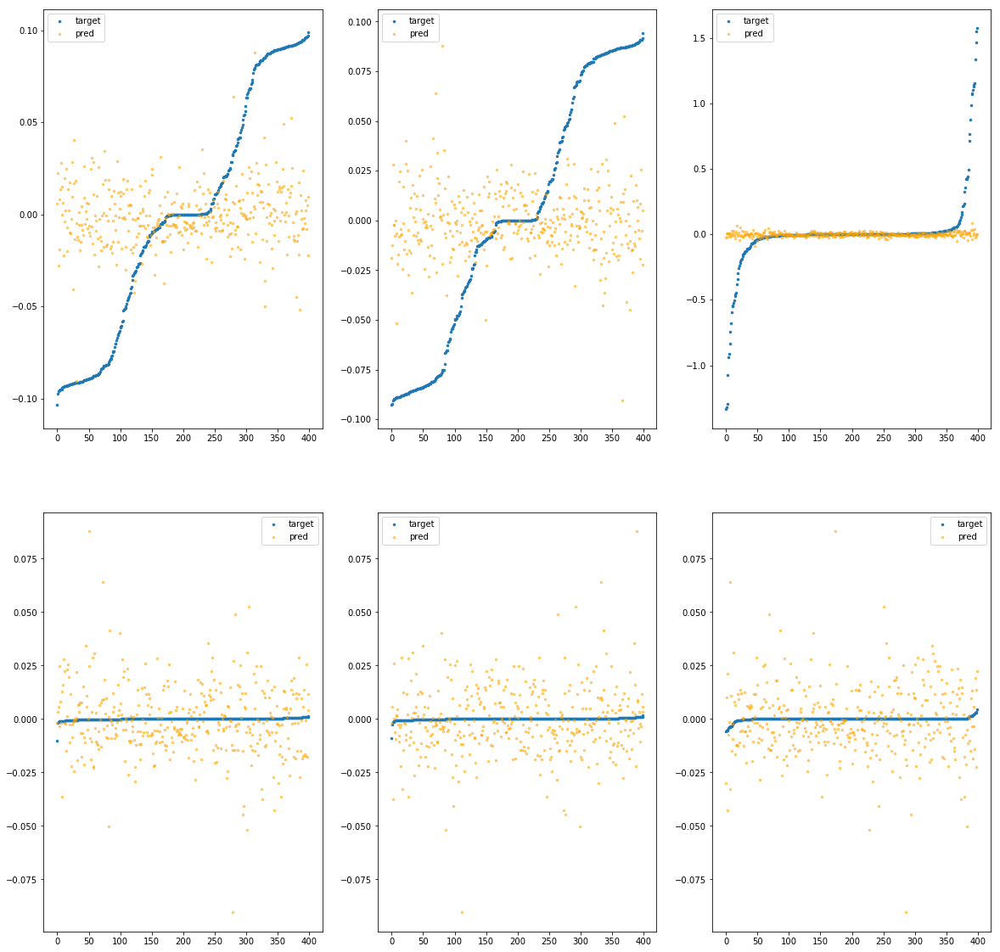

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa97e387ac0>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.16e-01	2.05e-01	5.53e-02	3.70e+04	4.98e-03	2.48e-05
y		-3.99e-01	2.01e-01	5.81e-02	2.04e+03	5.37e-03	2.88e-05
z		2.82e-02	1.58e+00	1.11e-01	1.21e+03	8.10e-02	6.56e-03
phi		-3.90e+03	2.03e-01	2.61e-02	8.93e+06	1.41e-03	1.99e-06
theta		-4.57e+03	2.03e-01	2.62e-02	2.41e+06	1.41e-03	1.99e-06
psi		-1.89e+03	2.03e-01	2.62e-02	1.89e+06	1.42e-03	2.01e-06


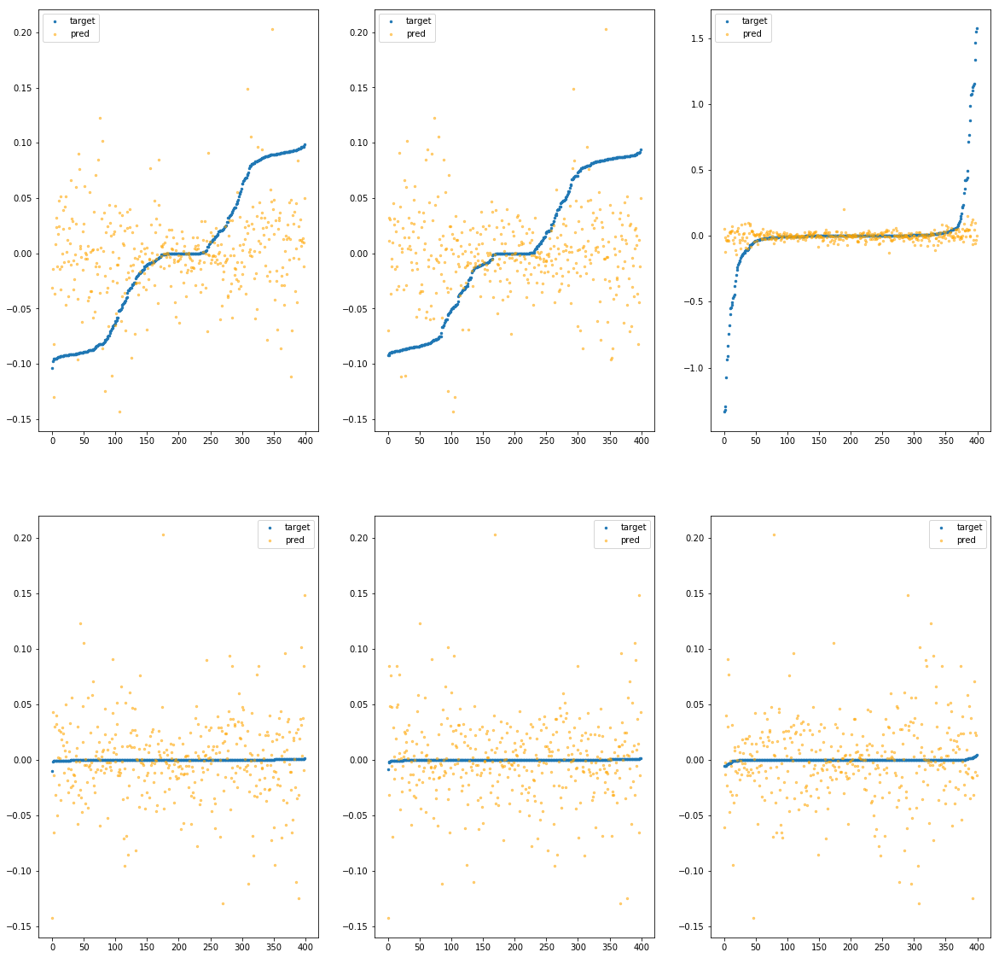

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa97e387b20>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.68e-01	2.24e-01	5.65e-02	2.89e+04	5.19e-03	2.69e-05
y		-1.73e-01	2.02e-01	5.31e-02	1.01e+03	4.50e-03	2.02e-05
z		-1.16e-02	1.61e+00	1.12e-01	7.80e+02	8.43e-02	7.10e-03
phi		-3.12e+03	1.48e-01	2.35e-02	4.94e+06	1.13e-03	1.28e-06
theta		-3.66e+03	1.48e-01	2.35e-02	1.76e+06	1.13e-03	1.28e-06
psi		-1.50e+03	1.47e-01	2.34e-02	2.65e+06	1.12e-03	1.26e-06


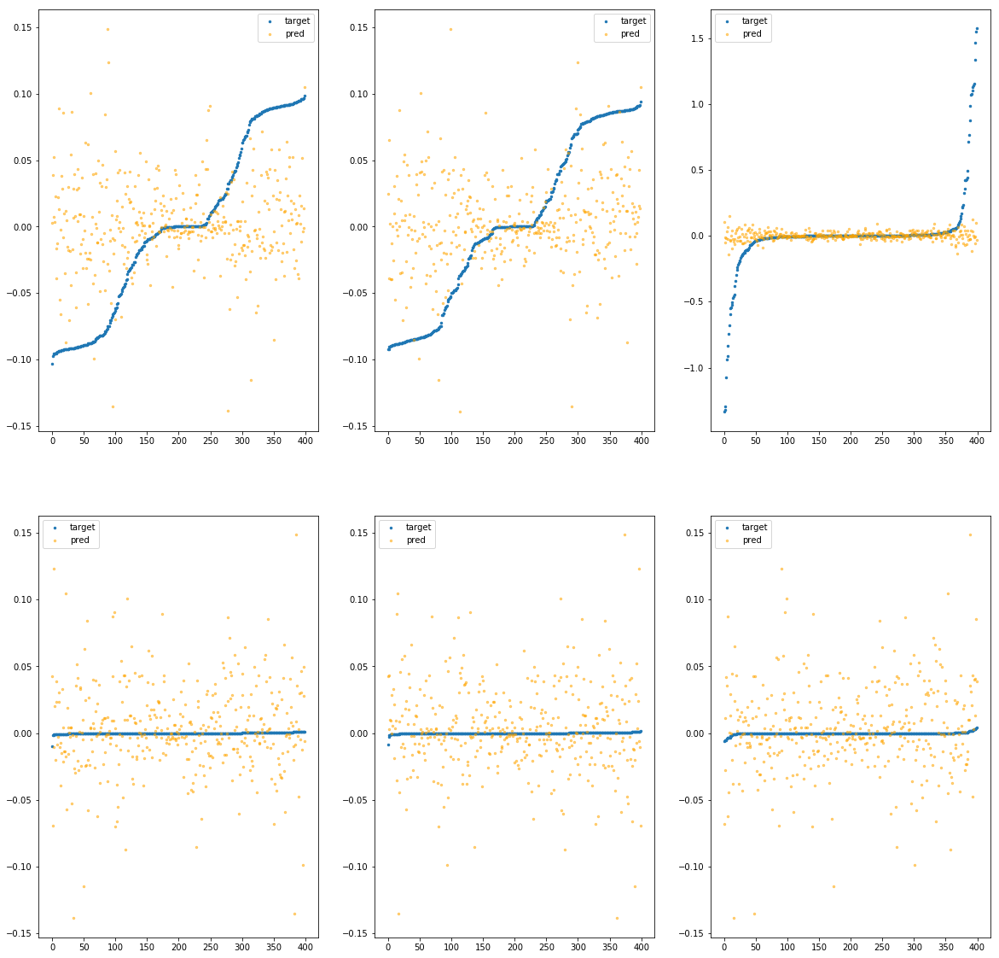

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa97e387b80>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.56e-01	2.23e-01	5.92e-02	2.46e+04	5.55e-03	3.08e-05
y		-2.24e-01	2.07e-01	5.35e-02	7.13e+02	4.69e-03	2.20e-05
z		-1.45e-03	1.67e+00	1.11e-01	7.17e+02	8.34e-02	6.96e-03
phi		-3.24e+03	1.45e-01	2.23e-02	4.01e+06	1.17e-03	1.38e-06
theta		-3.80e+03	1.45e-01	2.23e-02	7.61e+05	1.18e-03	1.38e-06
psi		-1.57e+03	1.48e-01	2.24e-02	2.91e+06	1.18e-03	1.39e-06


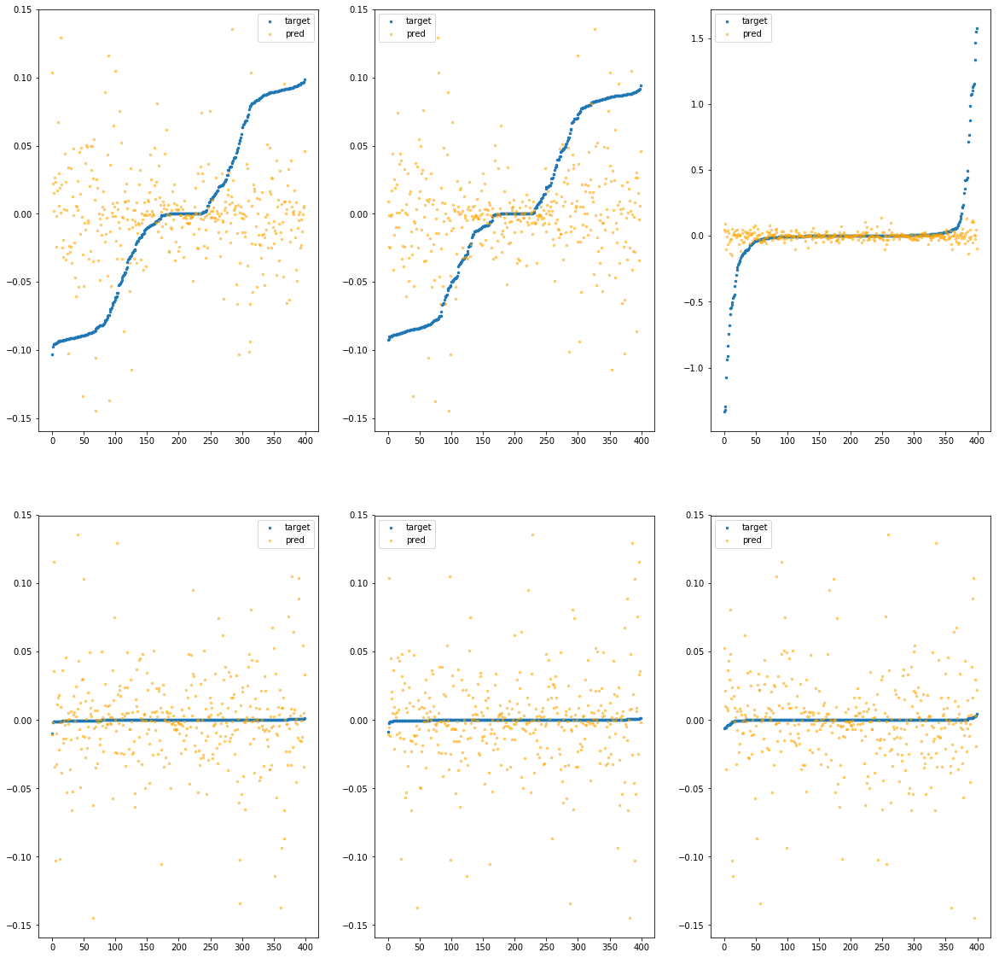

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa97e387be0>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.22e-01	2.38e-01	5.51e-02	1.37e+04	5.00e-03	2.50e-05
y		-3.39e-01	2.23e-01	5.66e-02	7.60e+02	5.13e-03	2.64e-05
z		-7.46e-02	1.67e+00	1.13e-01	8.91e+02	8.95e-02	8.02e-03
phi		-3.82e+03	1.60e-01	2.46e-02	2.39e+06	1.38e-03	1.91e-06
theta		-4.47e+03	1.60e-01	2.46e-02	9.89e+05	1.38e-03	1.91e-06
psi		-1.84e+03	1.59e-01	2.47e-02	1.86e+06	1.38e-03	1.91e-06


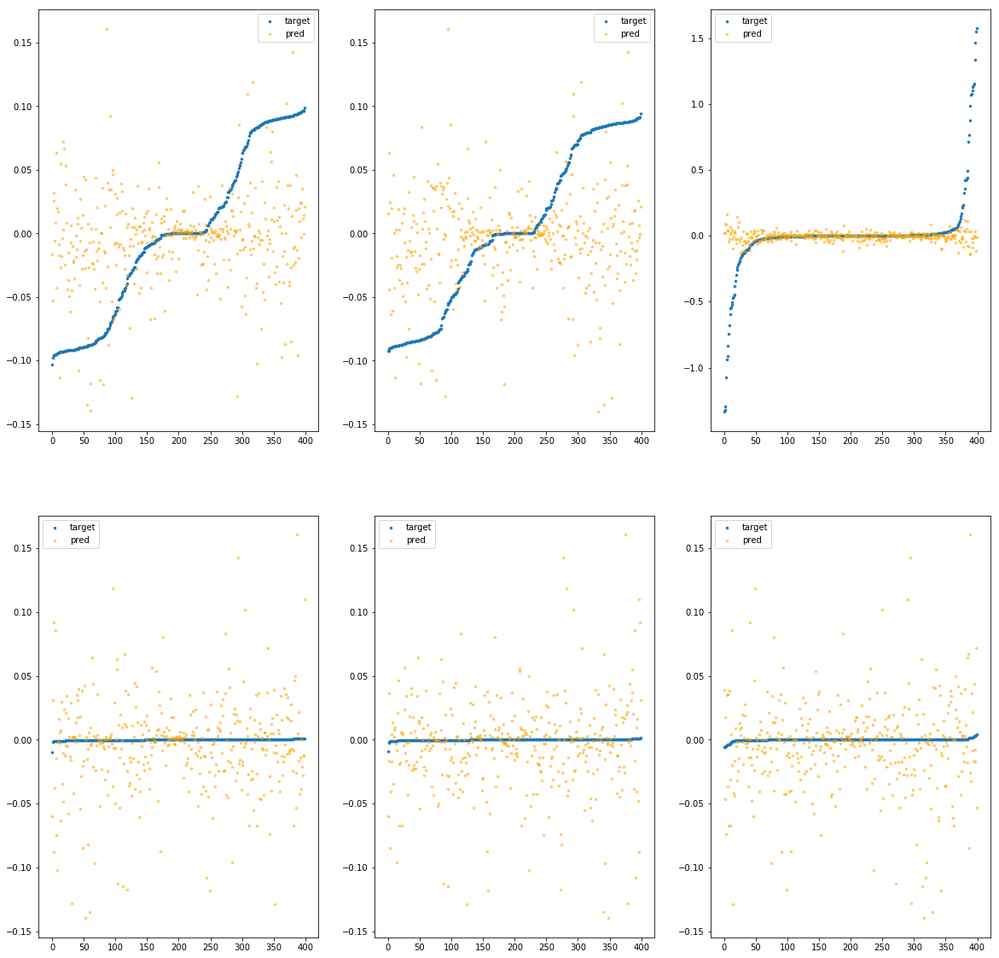

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa97e387c40>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.89e-03	1.28e-01	5.21e-02	1.50e+04	4.12e-03	1.70e-05
y		-3.33e-02	1.15e-01	5.21e-02	8.63e+02	3.96e-03	1.57e-05
z		2.66e-03	1.60e+00	1.02e-01	3.68e+02	8.31e-02	6.90e-03
phi		-2.06e+02	5.55e-02	5.29e-03	2.57e+06	7.50e-05	5.62e-09
theta		-2.45e+02	5.63e-02	5.30e-03	6.83e+05	7.58e-05	5.75e-09
psi		-9.93e+01	5.84e-02	5.28e-03	3.58e+05	7.52e-05	5.66e-09


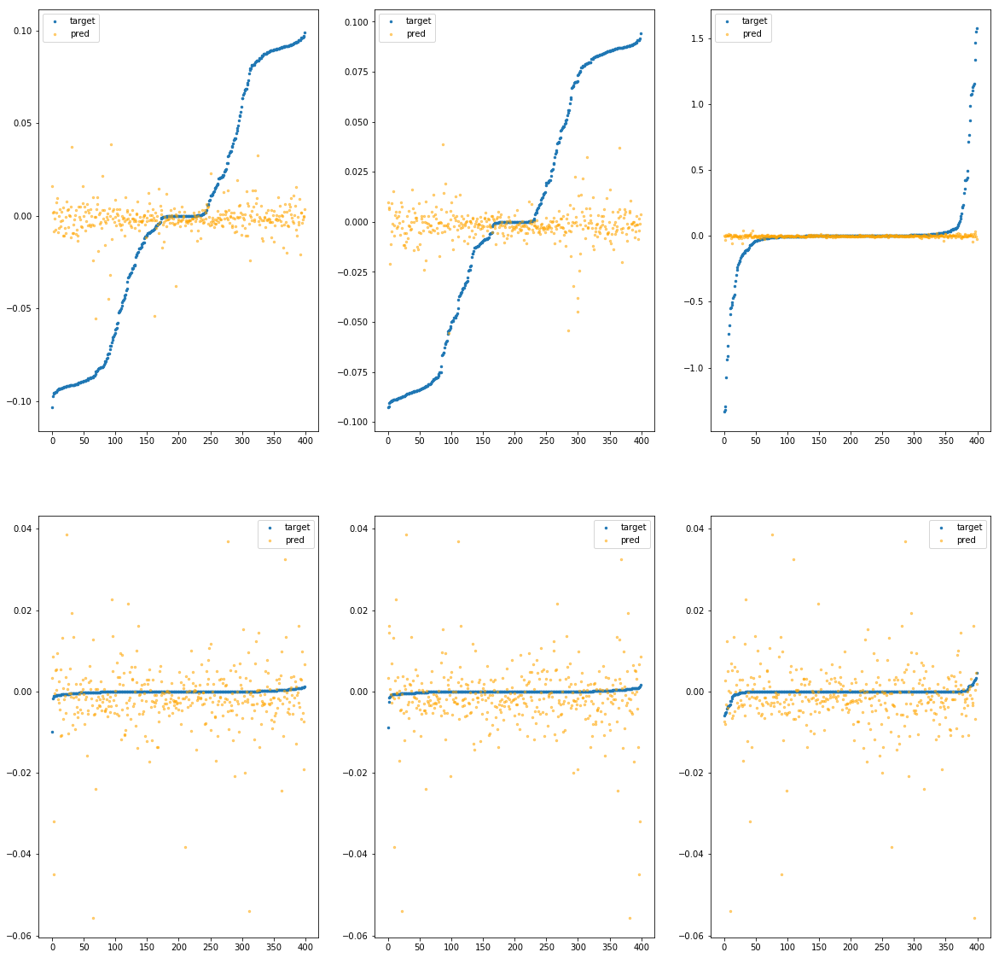

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa97e387ca0>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.23e-02	1.59e-01	5.31e-02	6.28e+03	4.39e-03	1.93e-05
y		-7.27e-02	1.55e-01	5.28e-02	4.67e+02	4.11e-03	1.69e-05
z		6.19e-03	1.58e+00	1.05e-01	4.38e+02	8.28e-02	6.86e-03
phi		-7.65e+02	1.31e-01	1.00e-02	9.86e+05	2.77e-04	7.70e-08
theta		-8.93e+02	1.31e-01	9.97e-03	8.98e+05	2.76e-04	7.62e-08
psi		-3.69e+02	1.32e-01	1.00e-02	9.55e+05	2.77e-04	7.68e-08


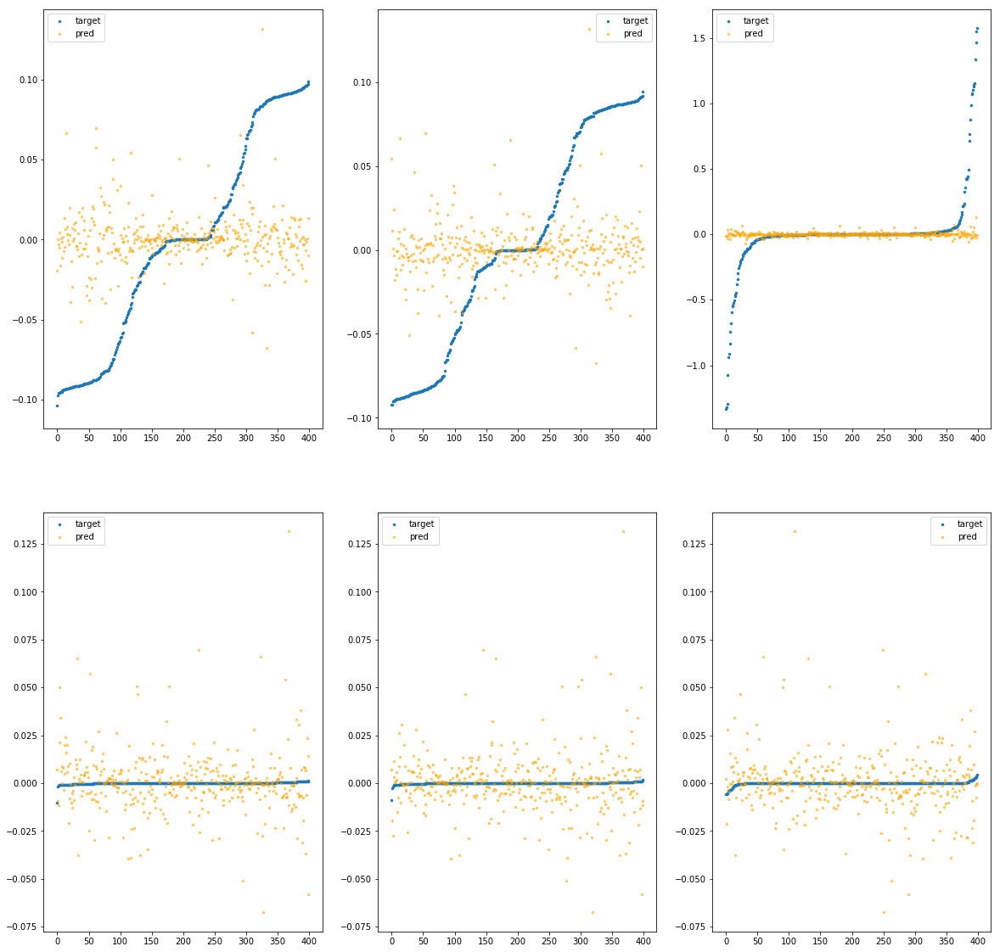

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa97e387d00>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.94e-01	1.87e-01	5.57e-02	2.45e+04	4.89e-03	2.39e-05
y		-1.70e-01	1.91e-01	5.35e-02	1.81e+03	4.48e-03	2.01e-05
z		-3.39e-03	1.58e+00	1.08e-01	7.37e+02	8.36e-02	6.99e-03
phi		-1.42e+03	1.04e-01	1.56e-02	4.06e+06	5.14e-04	2.64e-07
theta		-1.67e+03	1.05e-01	1.56e-02	1.09e+06	5.15e-04	2.65e-07
psi		-6.86e+02	1.05e-01	1.56e-02	1.33e+06	5.15e-04	2.66e-07


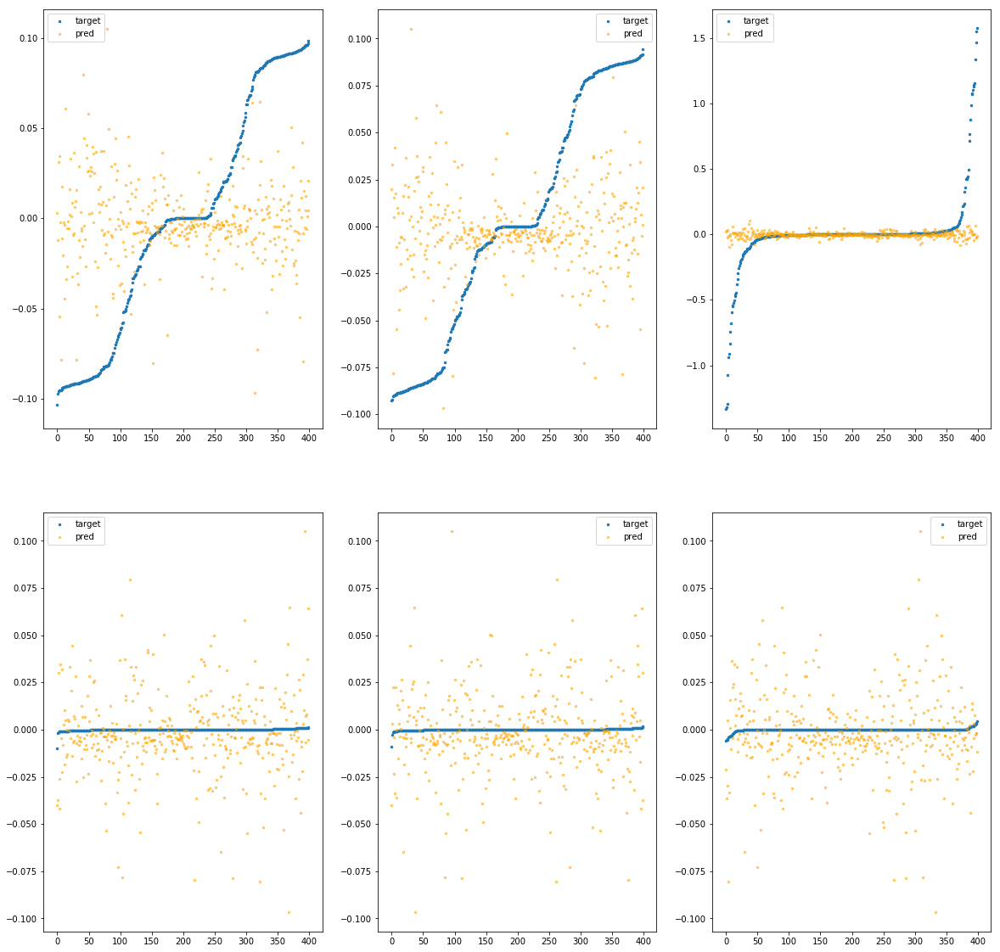

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa97e387d60>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.17e-01	2.91e-01	5.46e-02	2.50e+04	4.98e-03	2.48e-05
y		-3.62e-01	2.68e-01	5.64e-02	1.66e+03	5.22e-03	2.73e-05
z		-3.86e-02	1.66e+00	1.10e-01	8.74e+02	8.65e-02	7.49e-03
phi		-3.17e+03	2.12e-01	2.17e-02	3.87e+06	1.15e-03	1.32e-06
theta		-3.73e+03	2.13e-01	2.17e-02	1.40e+06	1.15e-03	1.33e-06
psi		-1.53e+03	2.12e-01	2.17e-02	2.45e+06	1.15e-03	1.32e-06


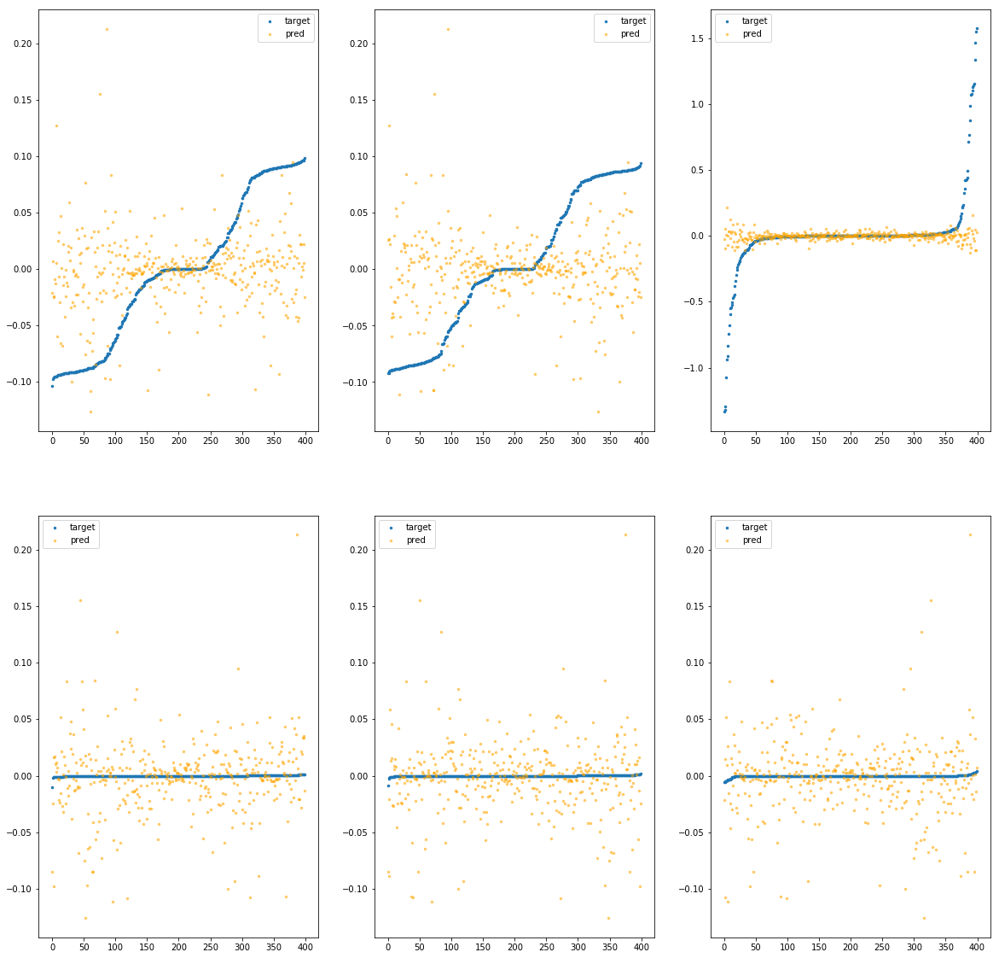

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa97e387dc0>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.62e-01	2.59e-01	5.81e-02	1.19e+04	5.58e-03	3.11e-05
y		-3.18e-01	2.28e-01	5.43e-02	5.02e+02	5.05e-03	2.55e-05
z		-2.67e-02	1.51e+00	1.12e-01	7.38e+02	8.55e-02	7.32e-03
phi		-3.85e+03	2.03e-01	2.30e-02	2.78e+06	1.39e-03	1.94e-06
theta		-4.52e+03	2.04e-01	2.30e-02	1.16e+06	1.40e-03	1.95e-06
psi		-1.86e+03	2.04e-01	2.31e-02	1.20e+06	1.40e-03	1.95e-06


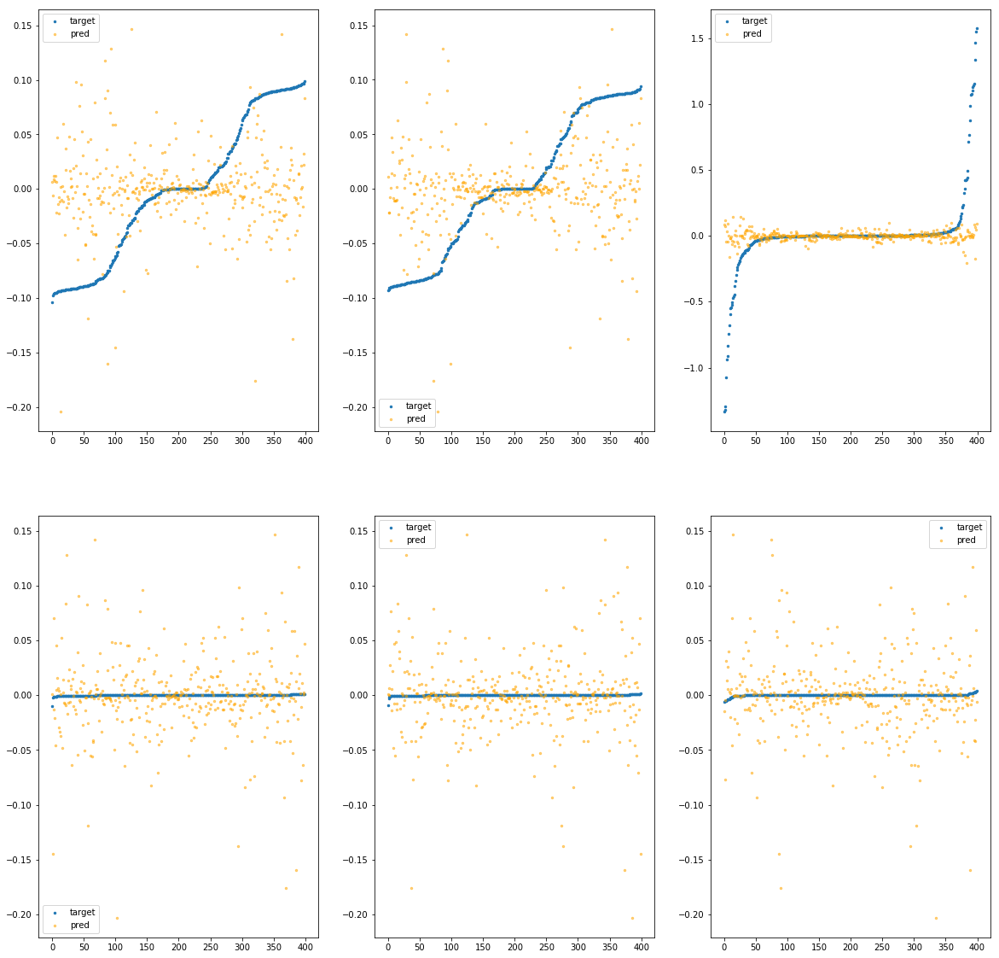

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa97e387e20>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.01e-03	1.13e-01	5.22e-02	2.62e+03	4.13e-03	1.71e-05
y		-7.08e-03	1.23e-01	5.15e-02	3.79e+02	3.86e-03	1.49e-05
z		-3.12e-03	1.57e+00	1.03e-01	2.52e+02	8.36e-02	6.99e-03
phi		-6.95e+01	4.69e-02	2.50e-03	5.29e+05	2.55e-05	6.52e-10
theta		-8.15e+01	4.66e-02	2.47e-03	2.98e+05	2.55e-05	6.49e-10
psi		-3.33e+01	4.64e-02	2.50e-03	2.29e+05	2.57e-05	6.62e-10


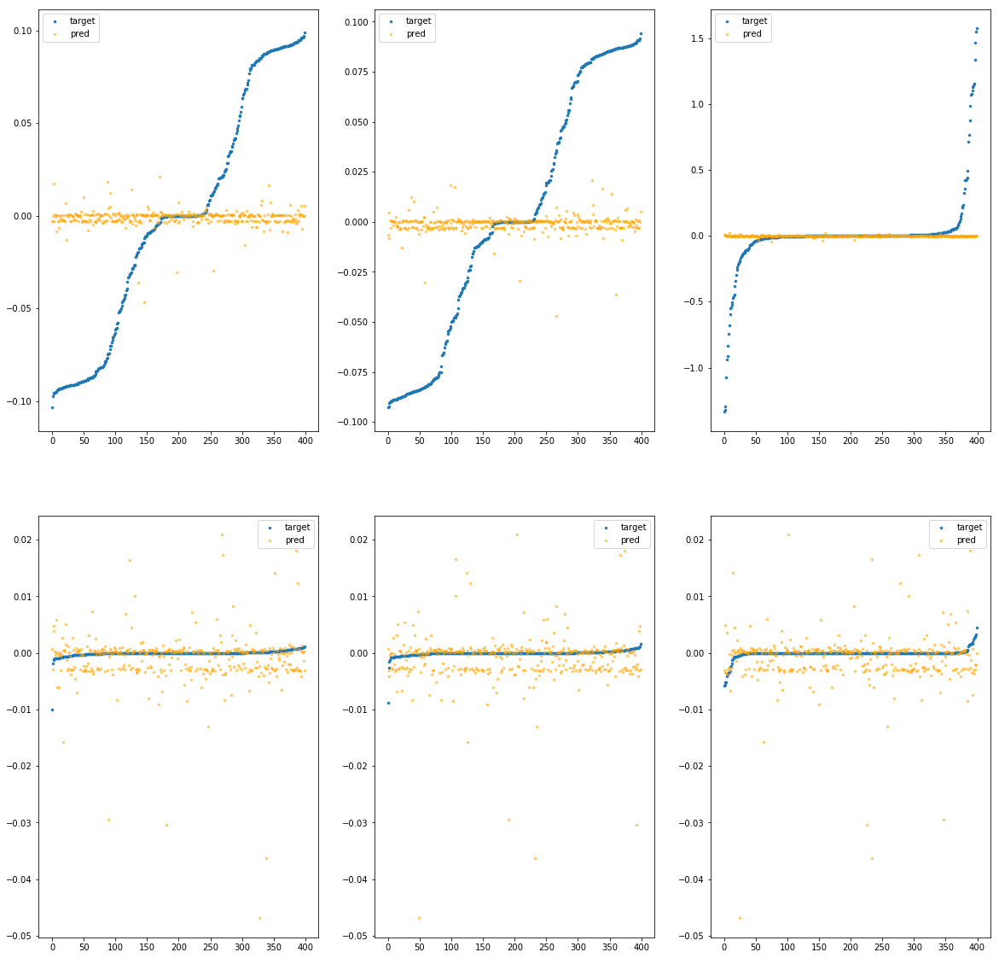

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa97e387e80>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.73e-03	1.30e-01	5.21e-02	6.05e+03	4.12e-03	1.70e-05
y		-1.27e-02	1.17e-01	5.16e-02	4.85e+02	3.88e-03	1.51e-05
z		-4.19e-03	1.56e+00	1.03e-01	2.44e+02	8.37e-02	7.00e-03
phi		-1.49e+02	4.63e-02	4.96e-03	1.45e+06	5.44e-05	2.96e-09
theta		-1.75e+02	4.55e-02	4.93e-03	3.66e+05	5.43e-05	2.95e-09
psi		-7.22e+01	4.34e-02	4.92e-03	6.45e+05	5.49e-05	3.02e-09


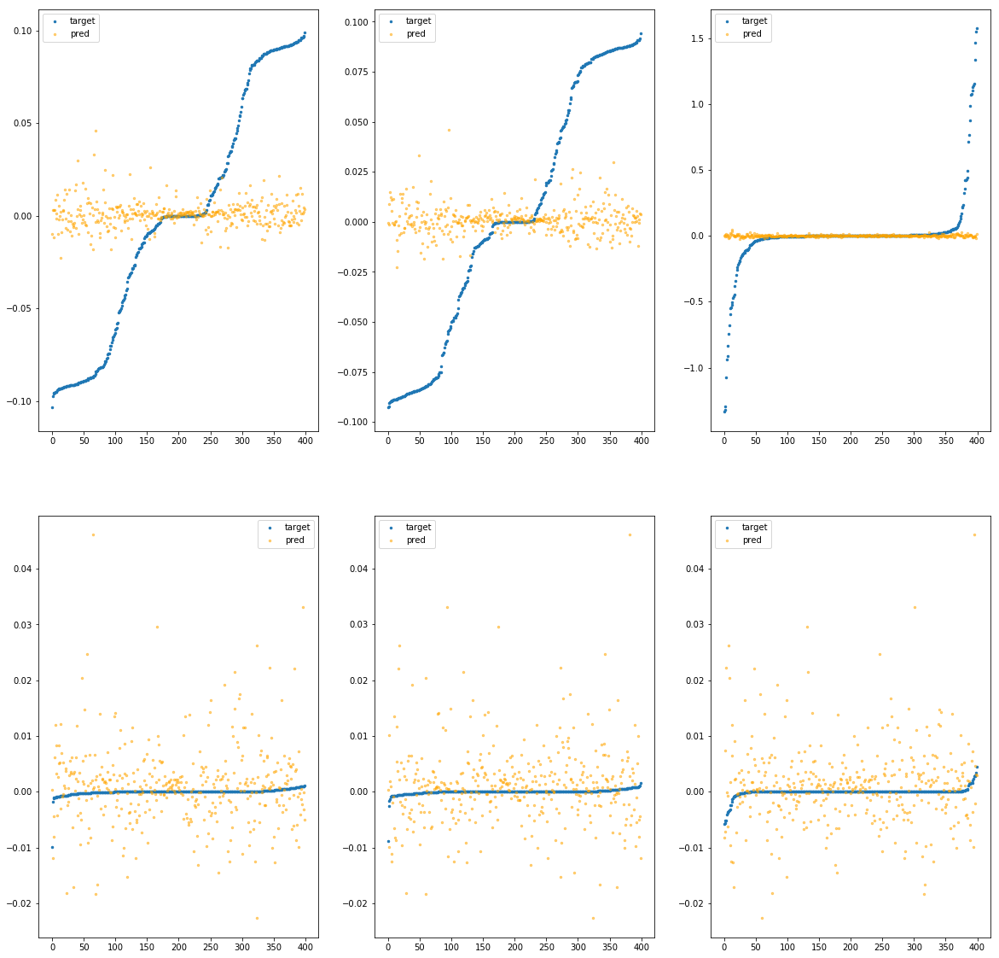

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa97e387ee0>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.47e-02	1.30e-01	5.26e-02	1.69e+04	4.15e-03	1.73e-05
y		-3.67e-02	1.25e-01	5.15e-02	5.33e+02	3.97e-03	1.58e-05
z		-5.38e-05	1.59e+00	1.04e-01	3.49e+02	8.33e-02	6.94e-03
phi		-6.49e+02	8.74e-02	1.05e-02	3.88e+06	2.35e-04	5.55e-08
theta		-7.65e+02	8.75e-02	1.05e-02	5.39e+05	2.37e-04	5.60e-08
psi		-3.12e+02	8.86e-02	1.05e-02	8.69e+05	2.35e-04	5.51e-08


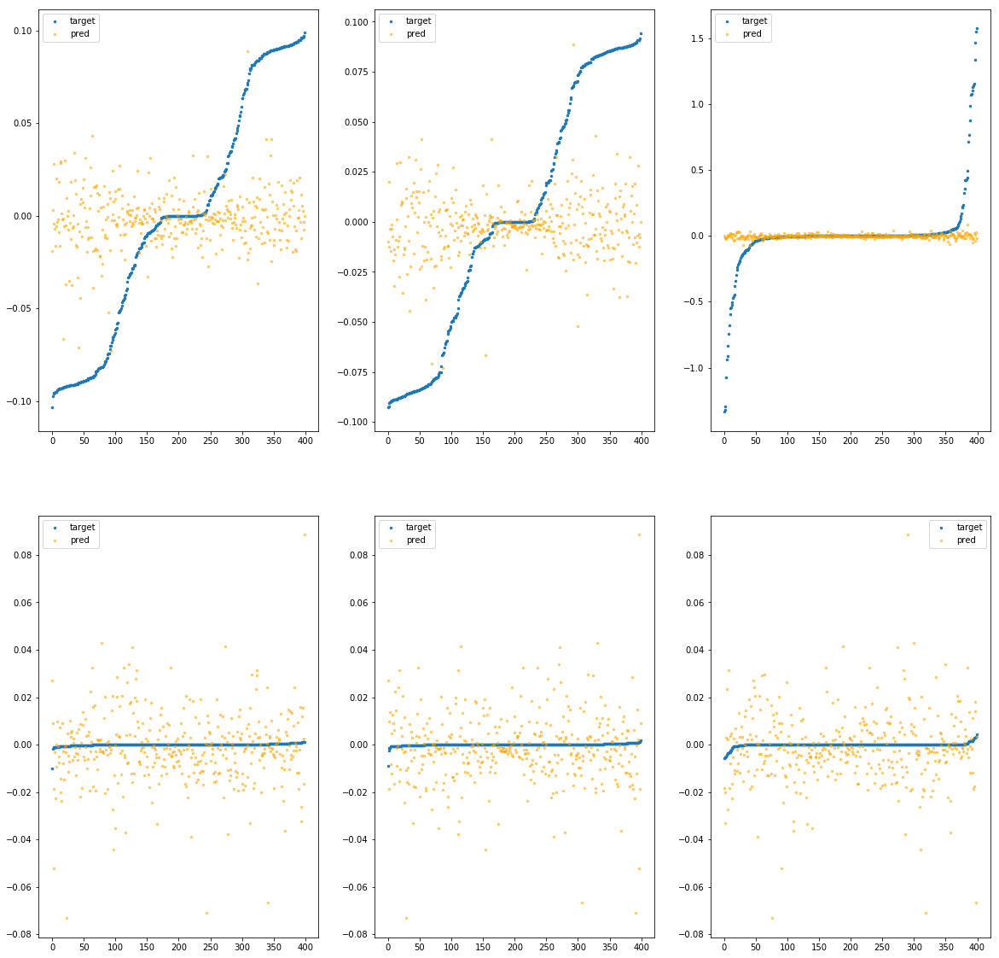

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa97e387f40>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.22e-01	2.30e-01	5.41e-02	1.01e+04	4.59e-03	2.11e-05
y		-5.17e-02	1.82e-01	5.16e-02	3.46e+02	4.03e-03	1.63e-05
z		5.16e-03	1.52e+00	1.06e-01	5.61e+02	8.29e-02	6.87e-03
phi		-1.32e+03	1.40e-01	1.39e-02	1.62e+06	4.79e-04	2.29e-07
theta		-1.54e+03	1.40e-01	1.39e-02	3.69e+05	4.77e-04	2.28e-07
psi		-6.40e+02	1.40e-01	1.39e-02	1.14e+06	4.81e-04	2.31e-07


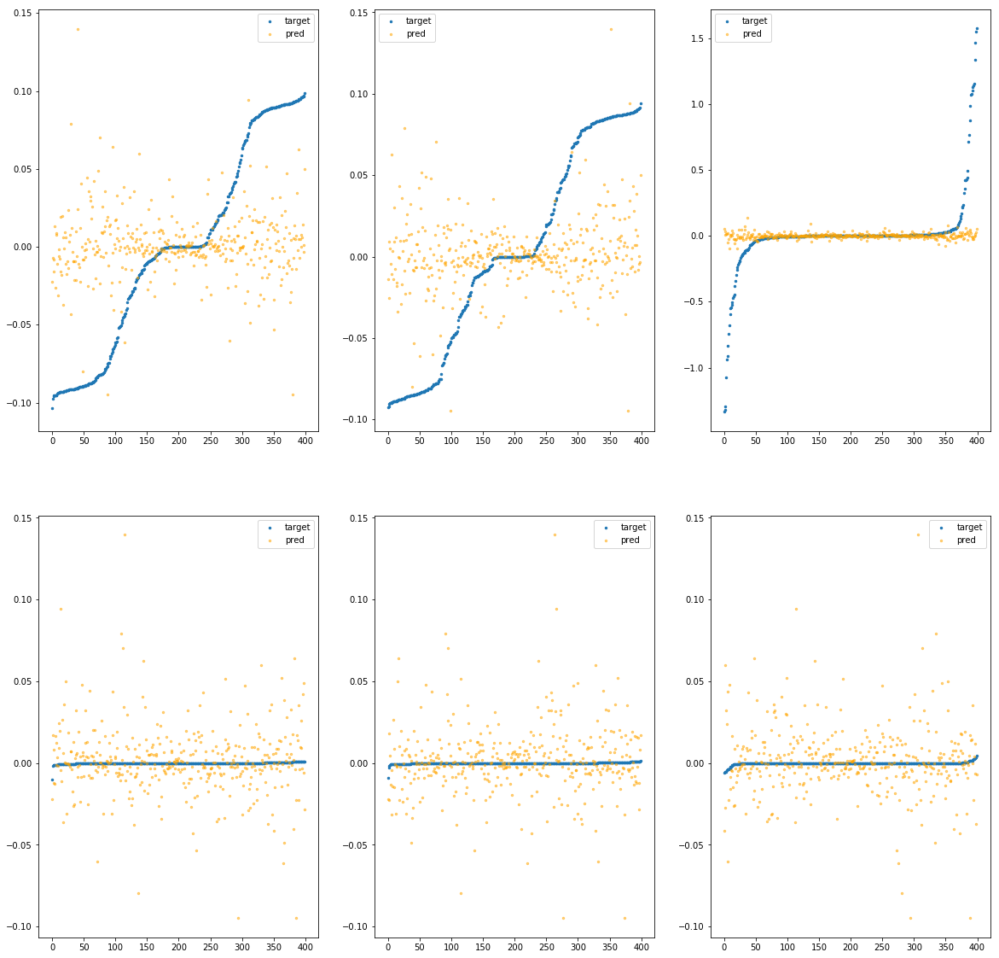

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa97e387fa0>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.45e-01	2.15e-01	5.55e-02	3.79e+04	4.69e-03	2.20e-05
y		-1.47e-01	2.04e-01	5.42e-02	2.41e+03	4.40e-03	1.94e-05
z		-1.10e-02	1.57e+00	1.09e-01	1.08e+03	8.42e-02	7.09e-03
phi		-9.93e+02	1.24e-01	1.34e-02	7.66e+06	3.60e-04	1.30e-07
theta		-1.16e+03	1.23e-01	1.34e-02	1.49e+06	3.59e-04	1.29e-07
psi		-4.80e+02	1.24e-01	1.34e-02	1.42e+06	3.61e-04	1.30e-07


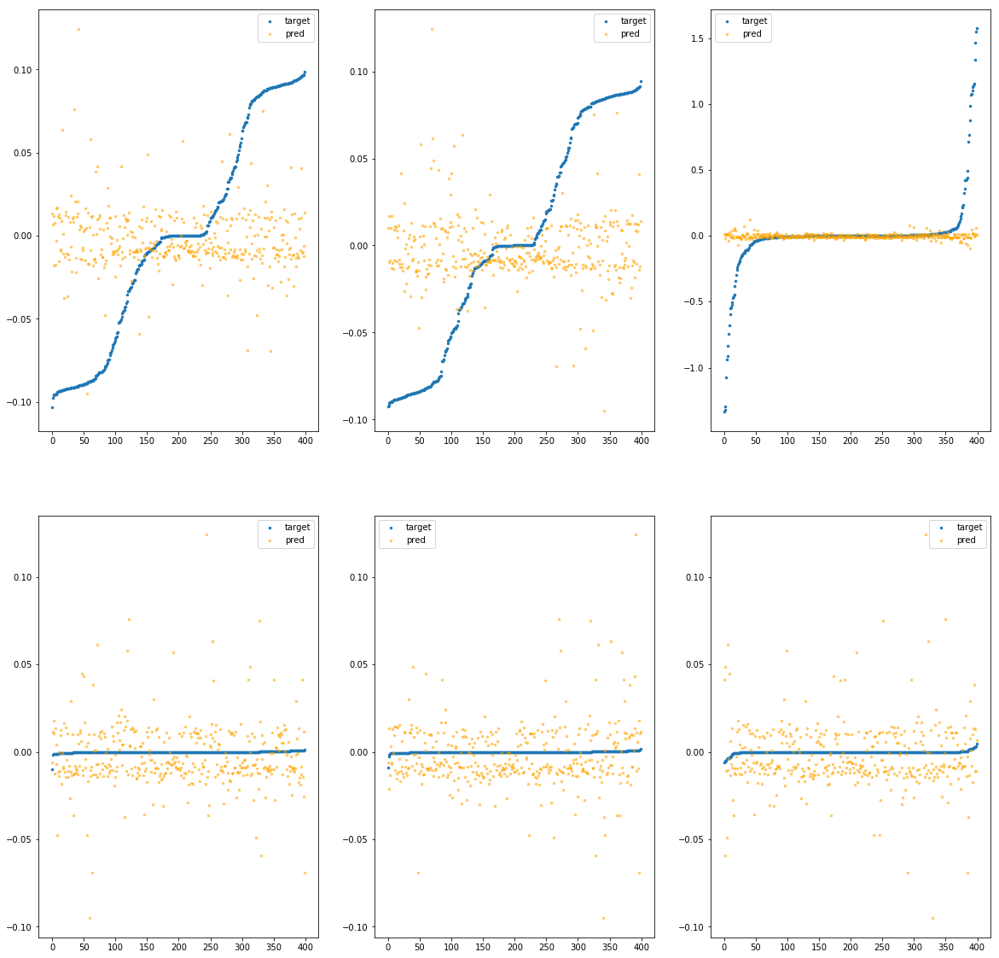

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa97e3a4040>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		5.36e-03	1.19e-01	5.15e-02	3.27e+03	4.07e-03	1.66e-05
y		-1.53e-04	1.14e-01	5.10e-02	8.88e+01	3.83e-03	1.47e-05
z		7.69e-04	1.57e+00	1.02e-01	5.03e+01	8.33e-02	6.93e-03
phi		-6.61e+01	5.42e-02	1.18e-03	7.84e+05	2.43e-05	5.91e-10
theta		-7.70e+01	5.43e-02	1.18e-03	9.65e+04	2.41e-05	5.80e-10
psi		-3.19e+01	5.36e-02	1.24e-03	5.58e+04	2.47e-05	6.09e-10


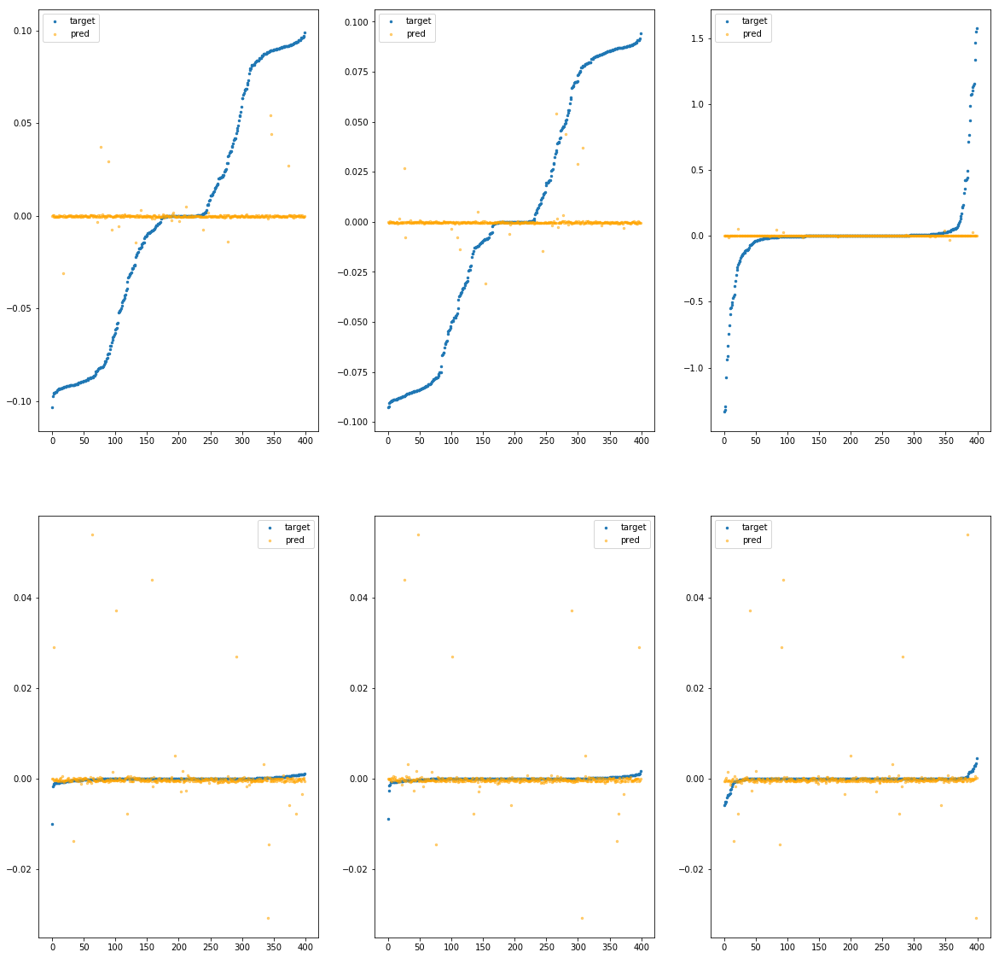

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa97e3a40a0>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.42e-02	1.48e-01	5.23e-02	1.44e+04	4.15e-03	1.72e-05
y		-5.97e-03	1.23e-01	5.15e-02	6.71e+02	3.86e-03	1.49e-05
z		1.09e-03	1.57e+00	1.02e-01	2.52e+02	8.32e-02	6.93e-03
phi		-1.56e+02	1.14e-01	3.04e-03	2.85e+06	5.69e-05	3.24e-09
theta		-1.83e+02	1.14e-01	3.05e-03	5.94e+05	5.70e-05	3.24e-09
psi		-7.31e+01	1.10e-01	3.08e-03	2.67e+05	5.56e-05	3.09e-09


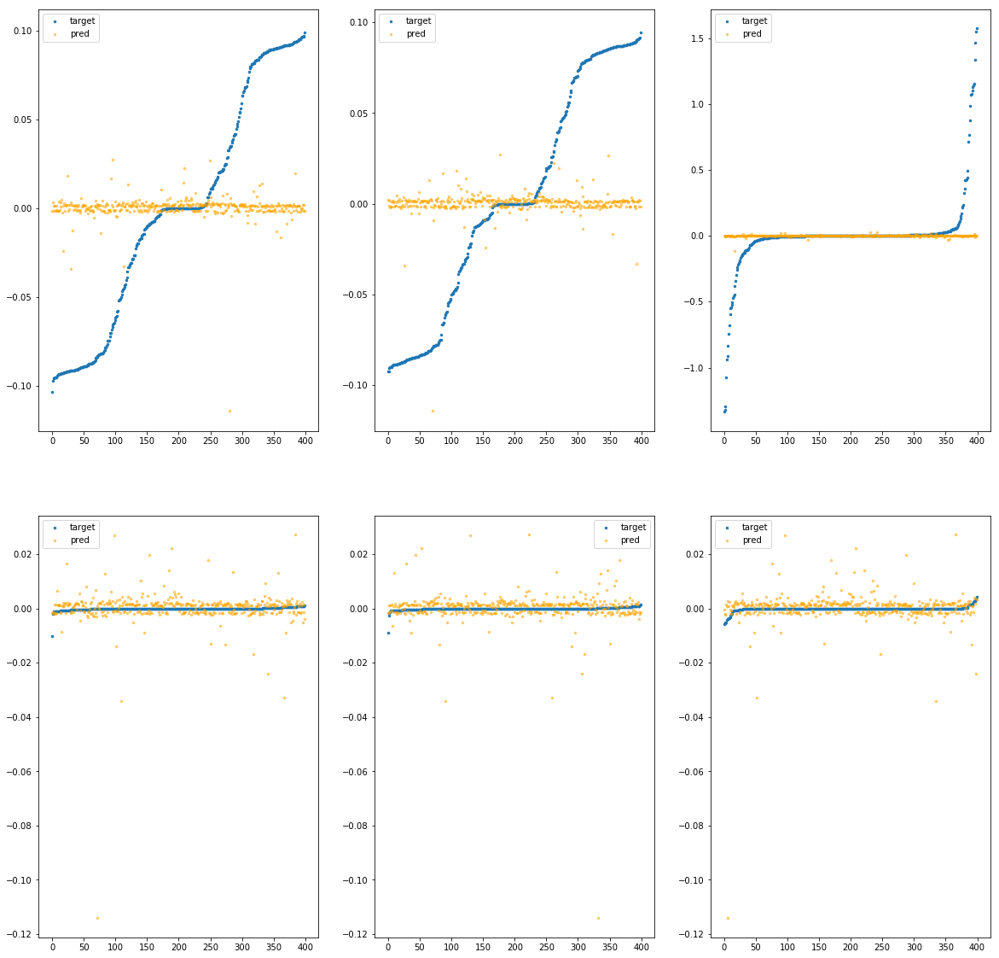

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa97e3a4100>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.56e-02	1.44e-01	5.22e-02	7.69e+03	4.16e-03	1.73e-05
y		-3.22e-03	1.42e-01	5.11e-02	4.01e+02	3.85e-03	1.48e-05
z		2.67e-04	1.57e+00	1.04e-01	2.54e+02	8.33e-02	6.94e-03
phi		-2.31e+02	5.70e-02	5.95e-03	2.28e+06	8.39e-05	7.03e-09
theta		-2.69e+02	5.80e-02	5.91e-03	3.90e+05	8.34e-05	6.96e-09
psi		-1.11e+02	5.79e-02	5.96e-03	3.99e+05	8.40e-05	7.06e-09


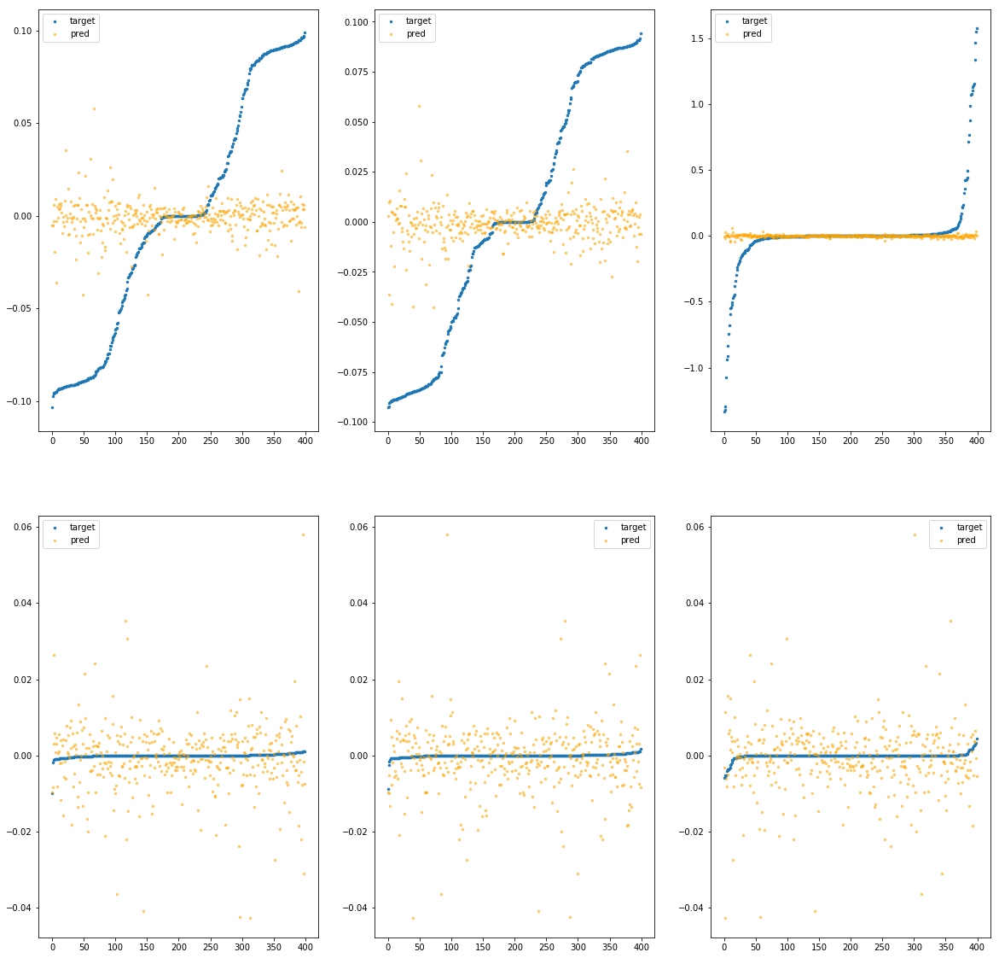

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa97e3a4160>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.68e-02	1.35e-01	5.29e-02	7.04e+03	4.29e-03	1.84e-05
y		-5.44e-02	1.28e-01	5.22e-02	2.14e+02	4.04e-03	1.63e-05
z		-5.20e-03	1.60e+00	1.05e-01	2.20e+02	8.38e-02	7.01e-03
phi		-3.65e+02	5.27e-02	7.53e-03	1.28e+06	1.33e-04	1.76e-08
theta		-4.24e+02	5.17e-02	7.48e-03	1.27e+05	1.31e-04	1.72e-08
psi		-1.77e+02	5.24e-02	7.57e-03	6.75e+05	1.34e-04	1.79e-08


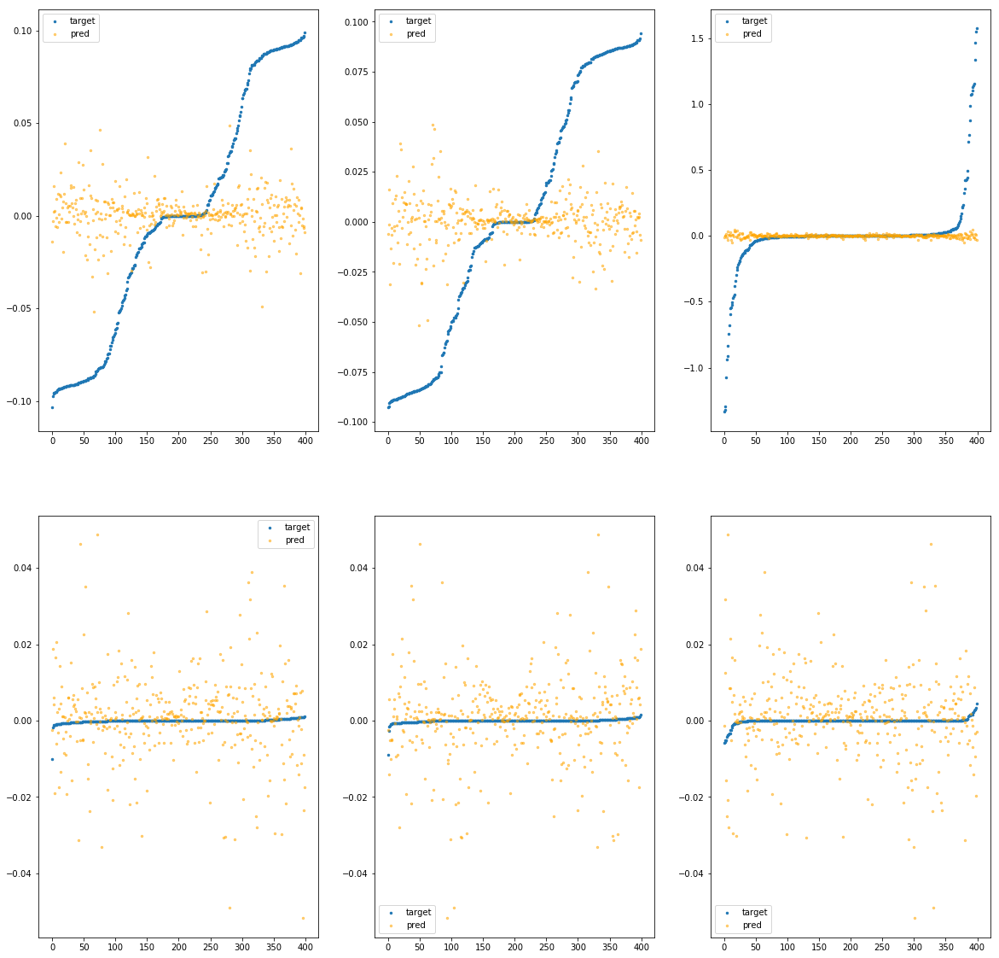

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa97e3a41c0>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.54e-01	1.88e-01	5.41e-02	9.27e+03	4.73e-03	2.23e-05
y		-1.93e-01	2.04e-01	5.33e-02	4.39e+02	4.57e-03	2.09e-05
z		-2.09e-02	1.59e+00	1.09e-01	5.17e+02	8.51e-02	7.23e-03
phi		-2.35e+03	1.35e-01	1.86e-02	3.11e+06	8.49e-04	7.21e-07
theta		-2.75e+03	1.36e-01	1.86e-02	4.22e+05	8.49e-04	7.21e-07
psi		-1.12e+03	1.35e-01	1.85e-02	1.22e+06	8.43e-04	7.10e-07


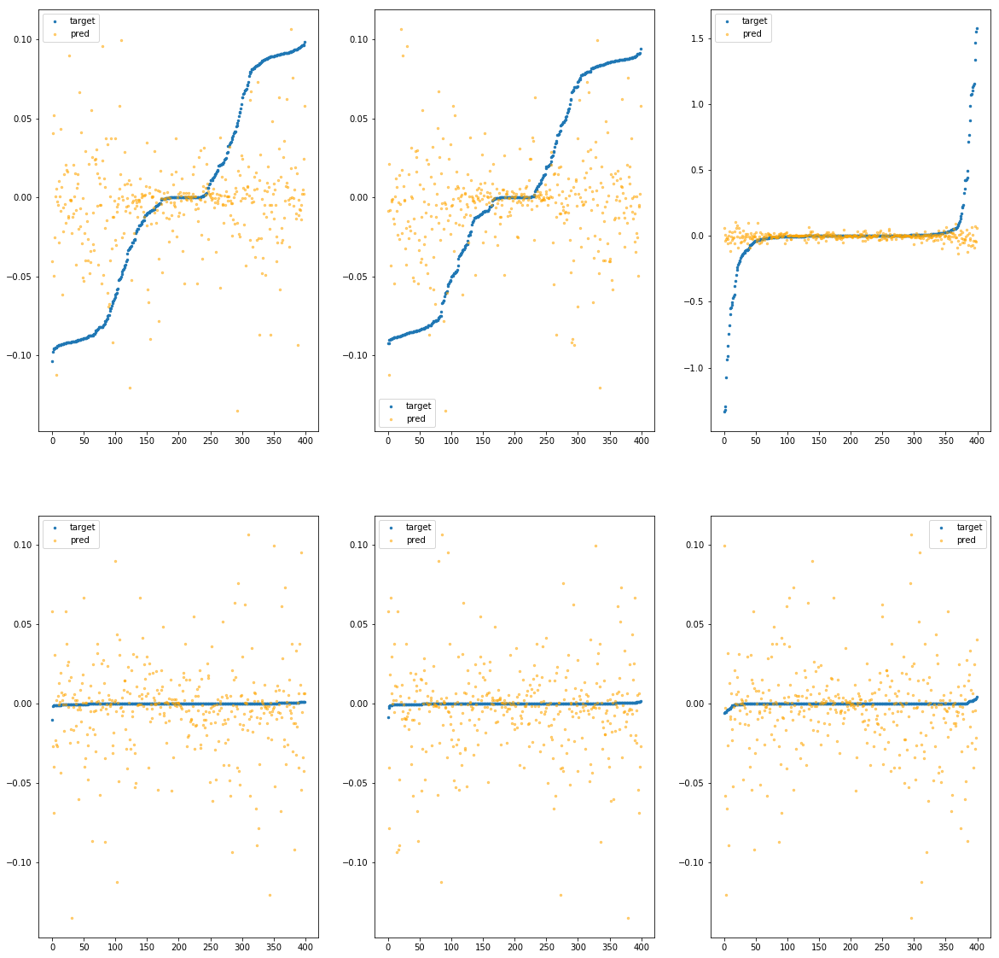

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa97e3a4220>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.22e+01	1.06e+00	1.66e-01	1.37e+05	5.42e-02	2.94e-03
y		-1.38e+01	1.09e+00	1.67e-01	9.98e+03	5.69e-02	3.24e-03
z		-6.45e-01	1.98e+00	2.16e-01	9.59e+03	1.37e-01	1.88e-02
phi		-1.44e+05	1.14e+00	1.59e-01	4.23e+07	5.22e-02	2.72e-03
theta		-1.69e+05	1.14e+00	1.59e-01	9.69e+06	5.22e-02	2.73e-03
psi		-6.96e+04	1.15e+00	1.59e-01	1.25e+07	5.22e-02	2.72e-03


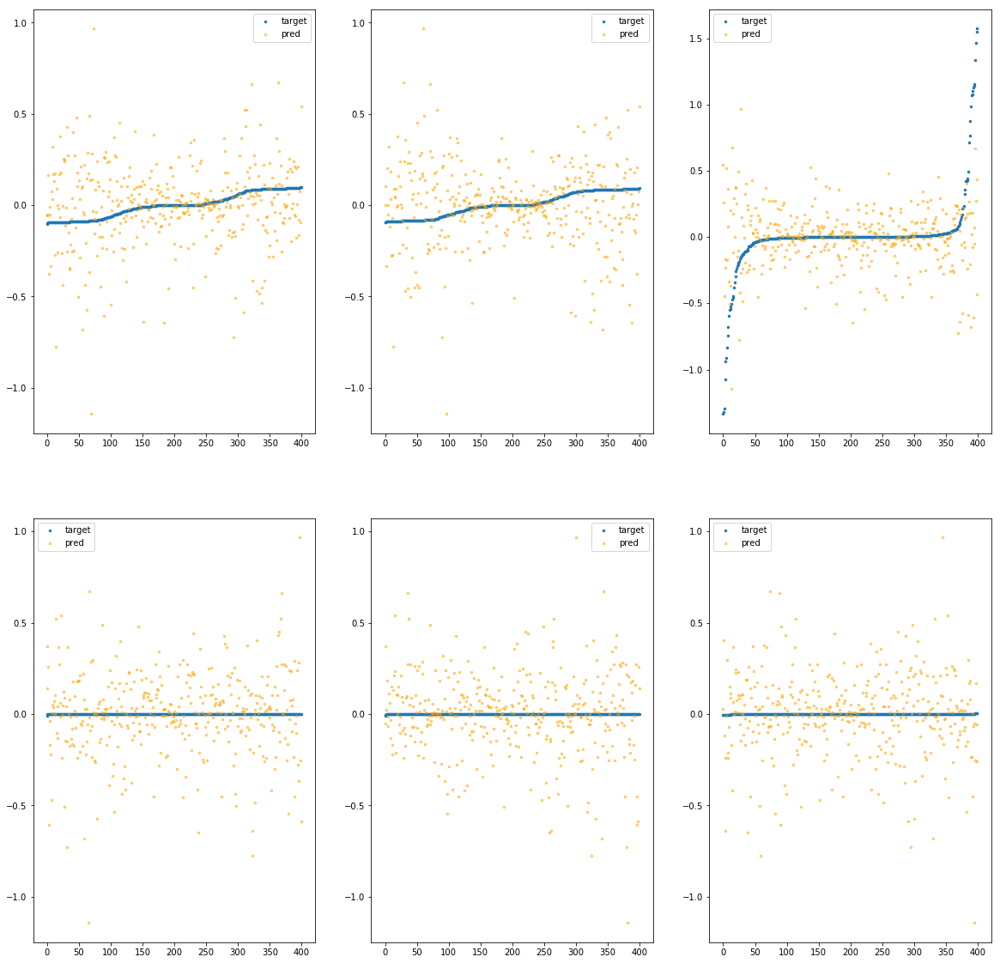

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa97e3a4280>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.25e+01	1.17e+00	1.62e-01	1.60e+05	5.54e-02	3.07e-03
y		-1.28e+01	1.14e+00	1.60e-01	5.98e+03	5.30e-02	2.81e-03
z		-7.98e-01	2.13e+00	2.21e-01	6.11e+03	1.50e-01	2.24e-02
phi		-1.42e+05	1.09e+00	1.57e-01	3.08e+07	5.13e-02	2.63e-03
theta		-1.66e+05	1.09e+00	1.57e-01	7.33e+06	5.13e-02	2.63e-03
psi		-6.84e+04	1.08e+00	1.57e-01	1.97e+07	5.13e-02	2.63e-03


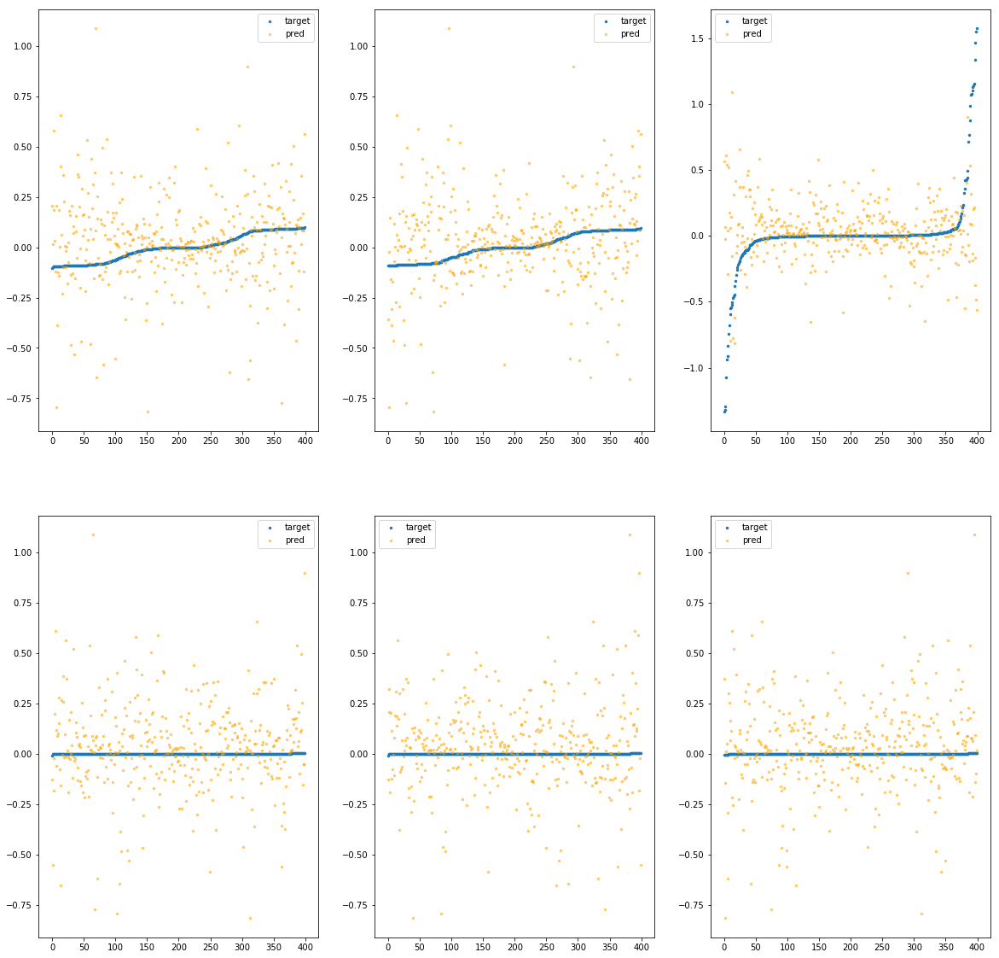

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa97e3a42e0>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.33e+01	1.57e+00	2.19e-01	2.09e+05	9.97e-02	9.93e-03
y		-2.49e+01	1.57e+00	2.19e-01	1.56e+04	9.91e-02	9.83e-03
z		-1.58e+00	3.21e+00	2.77e-01	9.03e+03	2.15e-01	4.61e-02
phi		-2.73e+05	1.66e+00	2.17e-01	3.39e+07	9.90e-02	9.80e-03
theta		-3.20e+05	1.66e+00	2.17e-01	1.11e+07	9.90e-02	9.80e-03
psi		-1.32e+05	1.66e+00	2.17e-01	1.35e+07	9.90e-02	9.80e-03


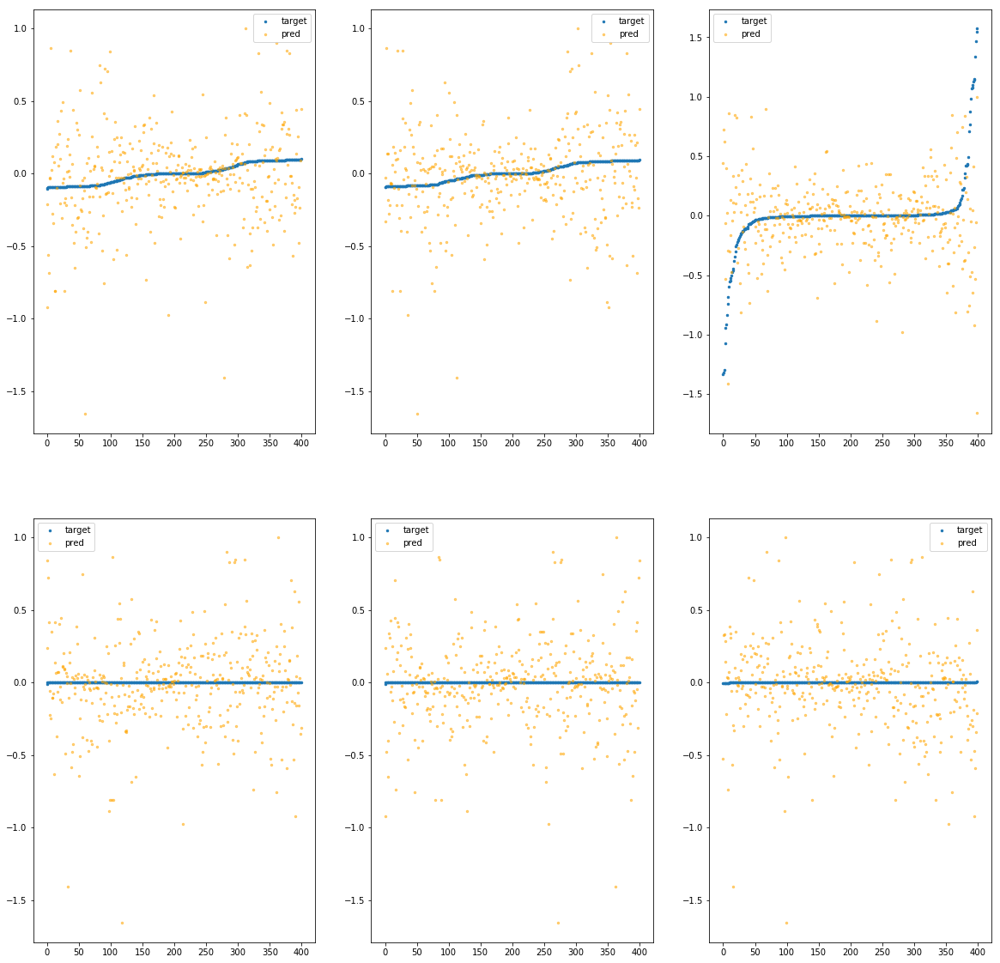

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa97e3a4340>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.21e+01	1.21e+00	2.11e-01	1.35e+05	9.45e-02	8.93e-03
y		-2.31e+01	1.16e+00	2.06e-01	2.46e+04	9.23e-02	8.51e-03
z		-1.07e+00	2.30e+00	2.39e-01	1.20e+04	1.72e-01	2.97e-02
phi		-2.47e+05	1.24e+00	2.02e-01	2.17e+07	8.93e-02	7.97e-03
theta		-2.89e+05	1.24e+00	2.02e-01	1.51e+07	8.93e-02	7.98e-03
psi		-1.19e+05	1.24e+00	2.02e-01	1.70e+07	8.93e-02	7.97e-03


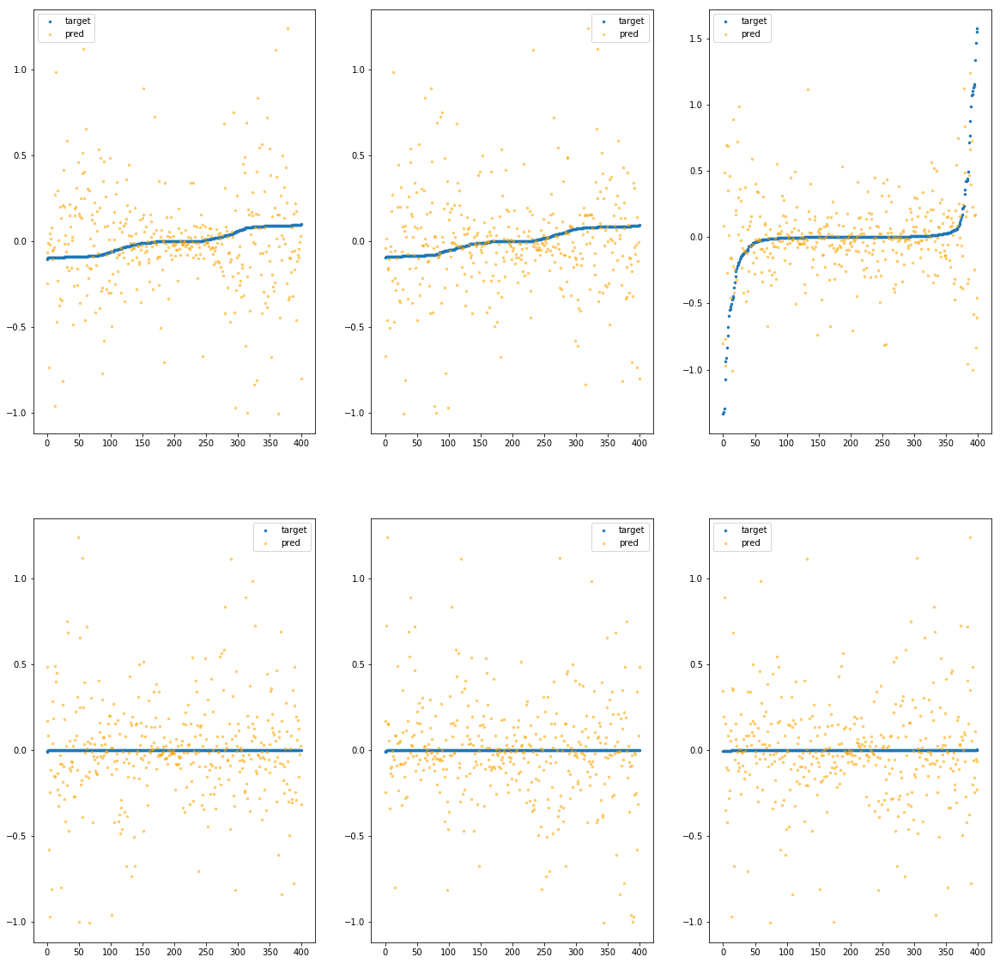

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa97e3a43a0>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.83e+01	1.16e+00	1.97e-01	1.70e+05	7.91e-02	6.26e-03
y		-1.88e+01	1.08e+00	1.93e-01	1.30e+04	7.60e-02	5.78e-03
z		-7.23e-01	2.47e+00	2.31e-01	6.13e+03	1.44e-01	2.06e-02
phi		-1.96e+05	1.06e+00	1.86e-01	2.24e+07	7.11e-02	5.06e-03
theta		-2.30e+05	1.06e+00	1.86e-01	1.41e+07	7.11e-02	5.06e-03
psi		-9.49e+04	1.06e+00	1.86e-01	1.54e+07	7.11e-02	5.06e-03


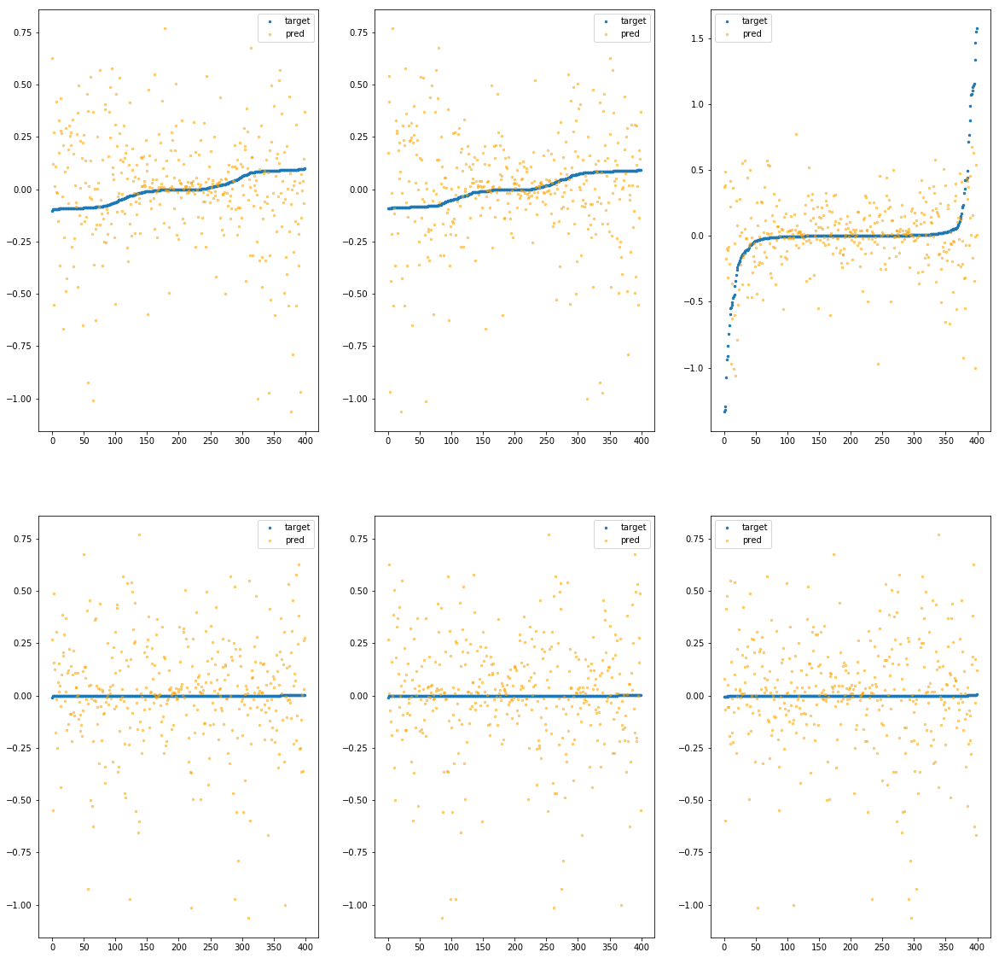

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa97e3a4400>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.51e+00	8.47e-01	1.24e-01	9.71e+04	3.49e-02	1.21e-03
y		-7.95e+00	8.43e-01	1.22e-01	3.82e+03	3.43e-02	1.18e-03
z		-3.50e-01	1.79e+00	1.73e-01	3.52e+03	1.12e-01	1.26e-02
phi		-8.21e+04	7.78e-01	1.09e-01	2.75e+07	2.97e-02	8.83e-04
theta		-9.62e+04	7.77e-01	1.09e-01	4.54e+06	2.97e-02	8.83e-04
psi		-3.97e+04	7.77e-01	1.09e-01	9.04e+06	2.98e-02	8.87e-04


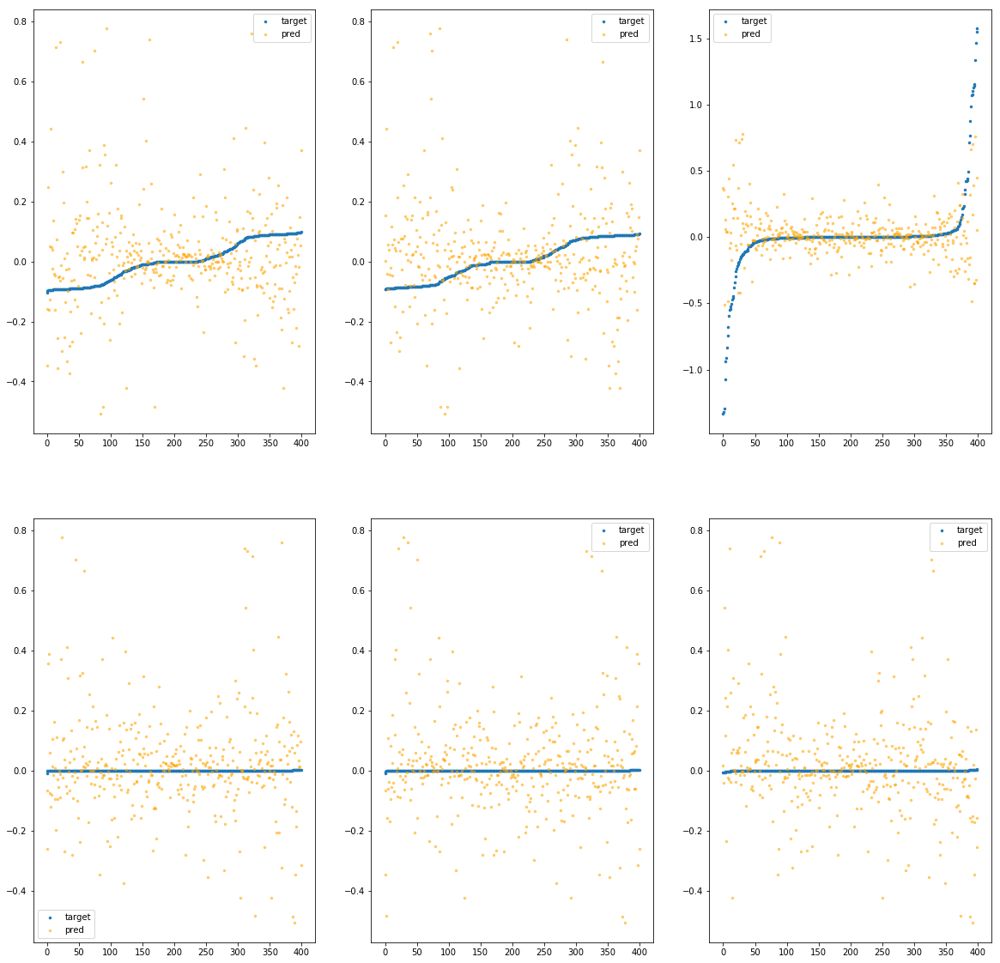

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa97e3a4460>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.41e+00	9.92e-01	1.33e-01	1.87e+05	3.85e-02	1.49e-03
y		-8.12e+00	9.89e-01	1.23e-01	7.99e+03	3.50e-02	1.22e-03
z		-2.32e-01	1.75e+00	1.74e-01	5.73e+03	1.03e-01	1.05e-02
phi		-9.26e+04	9.50e-01	1.21e-01	3.62e+07	3.35e-02	1.12e-03
theta		-1.09e+05	9.49e-01	1.21e-01	7.10e+06	3.35e-02	1.12e-03
psi		-4.47e+04	9.40e-01	1.21e-01	1.03e+07	3.35e-02	1.12e-03


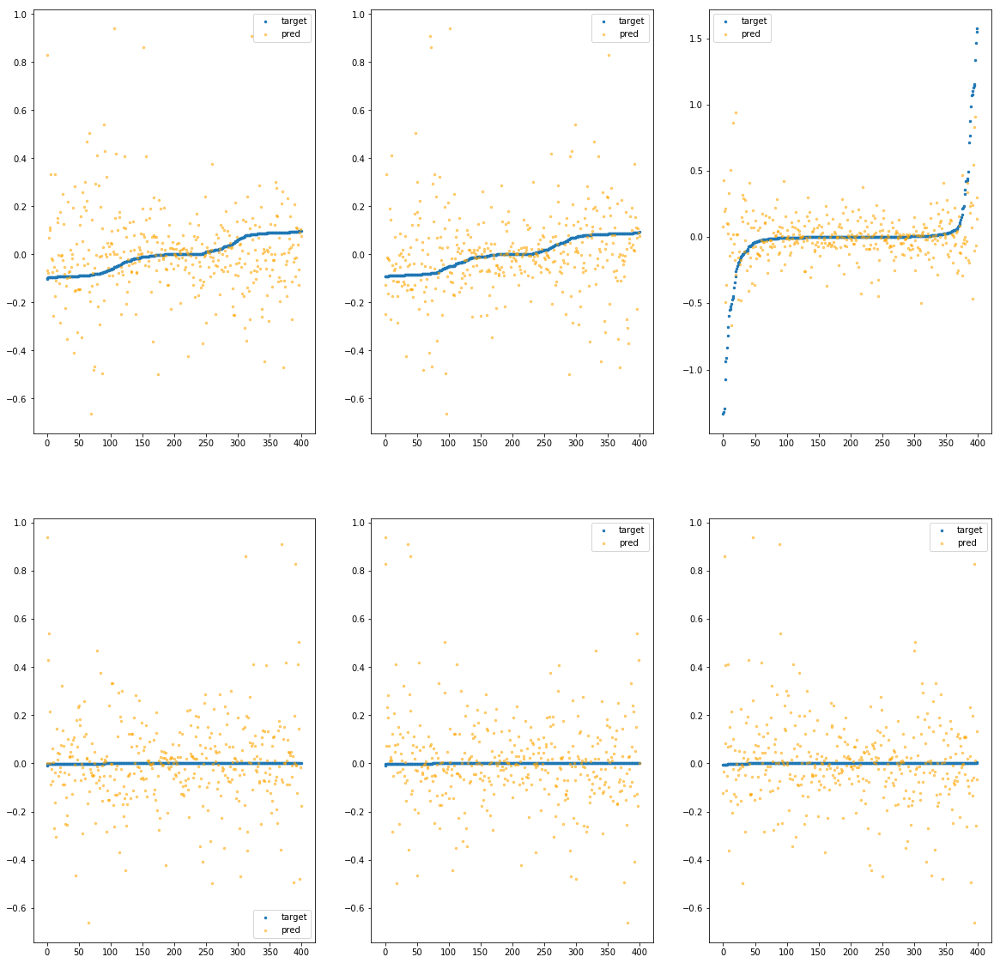

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa97e3a44c0>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.70e+00	1.06e+00	1.25e-01	5.50e+04	3.56e-02	1.27e-03
y		-8.04e+00	1.05e+00	1.23e-01	7.37e+03	3.46e-02	1.20e-03
z		-2.59e-01	2.34e+00	1.63e-01	4.44e+03	1.05e-01	1.10e-02
phi		-8.08e+04	9.69e-01	1.08e-01	1.57e+07	2.93e-02	8.57e-04
theta		-9.47e+04	9.69e-01	1.08e-01	5.25e+06	2.93e-02	8.56e-04
psi		-3.90e+04	9.69e-01	1.08e-01	9.51e+06	2.92e-02	8.54e-04


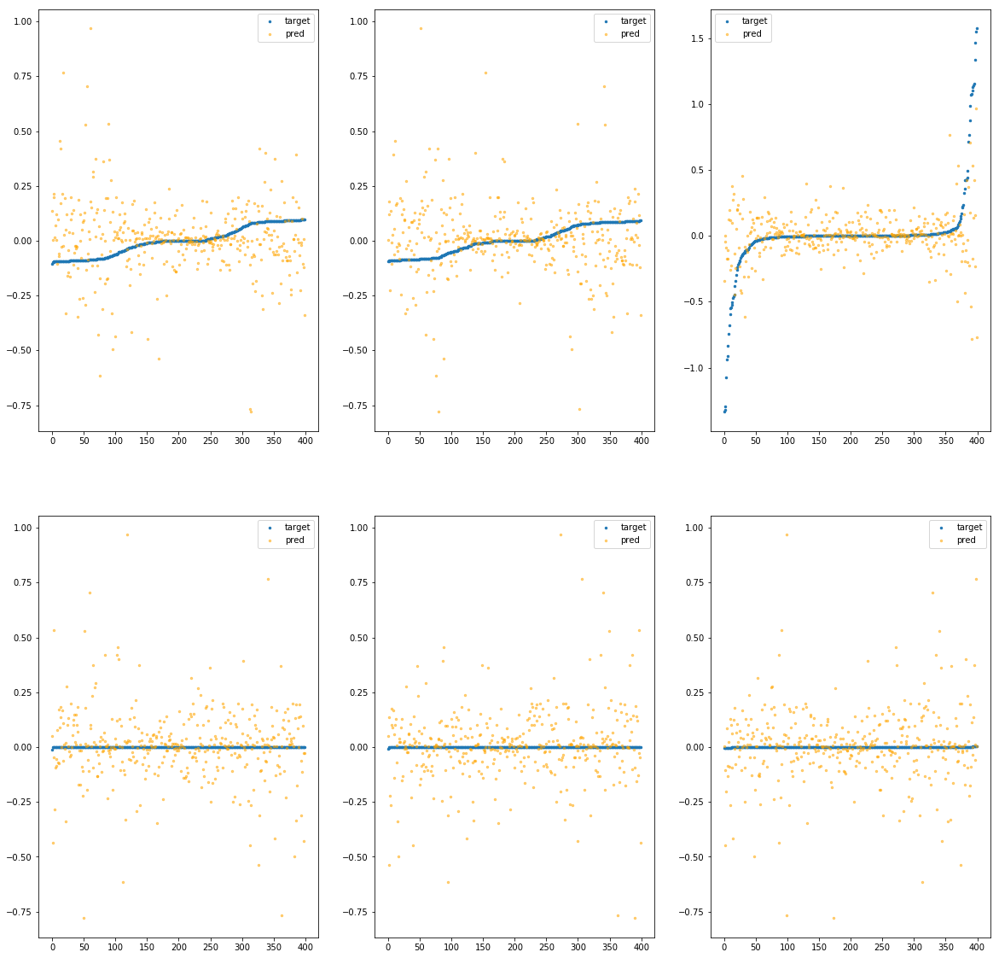

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa97e3a4520>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.44e+01	1.11e+00	1.64e-01	1.19e+05	6.30e-02	3.97e-03
y		-1.40e+01	1.12e+00	1.58e-01	3.46e+03	5.76e-02	3.32e-03
z		-6.80e-01	2.04e+00	1.99e-01	5.05e+03	1.40e-01	1.96e-02
phi		-1.60e+05	1.18e+00	1.54e-01	2.47e+07	5.80e-02	3.37e-03
theta		-1.88e+05	1.18e+00	1.54e-01	1.15e+07	5.80e-02	3.37e-03
psi		-7.73e+04	1.18e+00	1.54e-01	1.19e+07	5.80e-02	3.36e-03


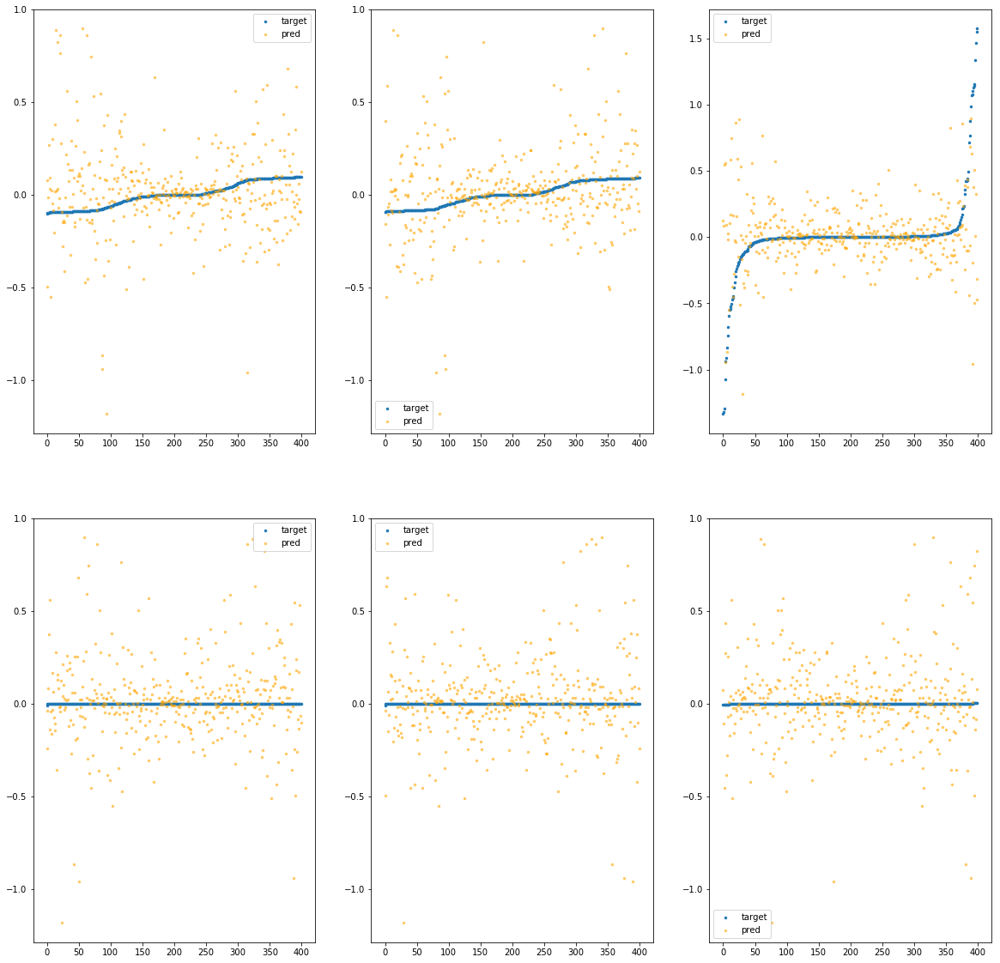

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa97e3a4580>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e+01	8.19e-01	1.50e-01	9.25e+04	4.70e-02	2.21e-03
y		-1.05e+01	8.23e-01	1.46e-01	4.26e+03	4.41e-02	1.95e-03
z		-5.13e-01	1.81e+00	1.92e-01	4.44e+03	1.26e-01	1.59e-02
phi		-1.14e+05	8.89e-01	1.38e-01	2.46e+07	4.15e-02	1.72e-03
theta		-1.34e+05	8.89e-01	1.38e-01	8.77e+06	4.15e-02	1.72e-03
psi		-5.53e+04	8.91e-01	1.38e-01	1.07e+07	4.15e-02	1.72e-03


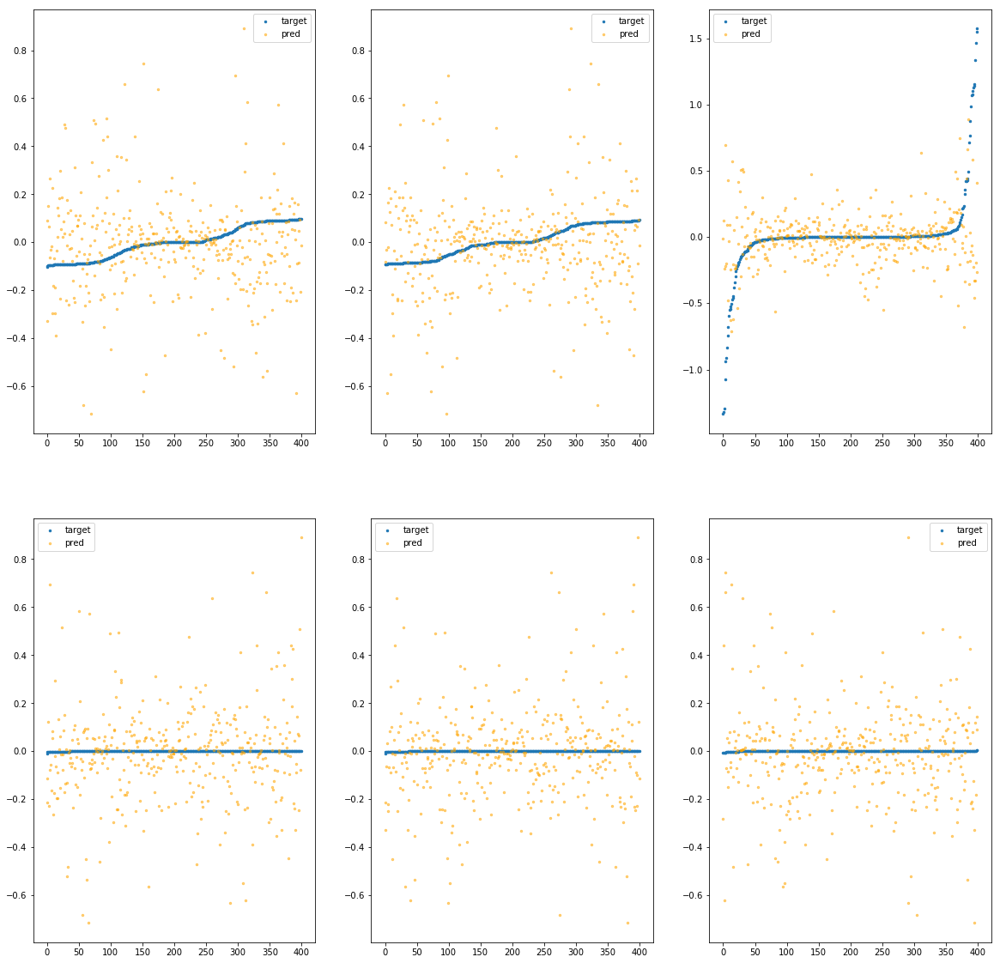

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa97e3a45e0>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.41e+00	7.76e-01	1.06e-01	5.46e+04	2.63e-02	6.90e-04
y		-5.34e+00	7.72e-01	9.90e-02	3.92e+03	2.43e-02	5.91e-04
z		-3.15e-01	1.89e+00	1.50e-01	2.25e+03	1.10e-01	1.20e-02
phi		-5.41e+04	6.90e-01	8.39e-02	1.53e+07	1.96e-02	3.83e-04
theta		-6.34e+04	6.90e-01	8.39e-02	3.01e+06	1.96e-02	3.84e-04
psi		-2.61e+04	6.90e-01	8.38e-02	5.29e+06	1.96e-02	3.82e-04


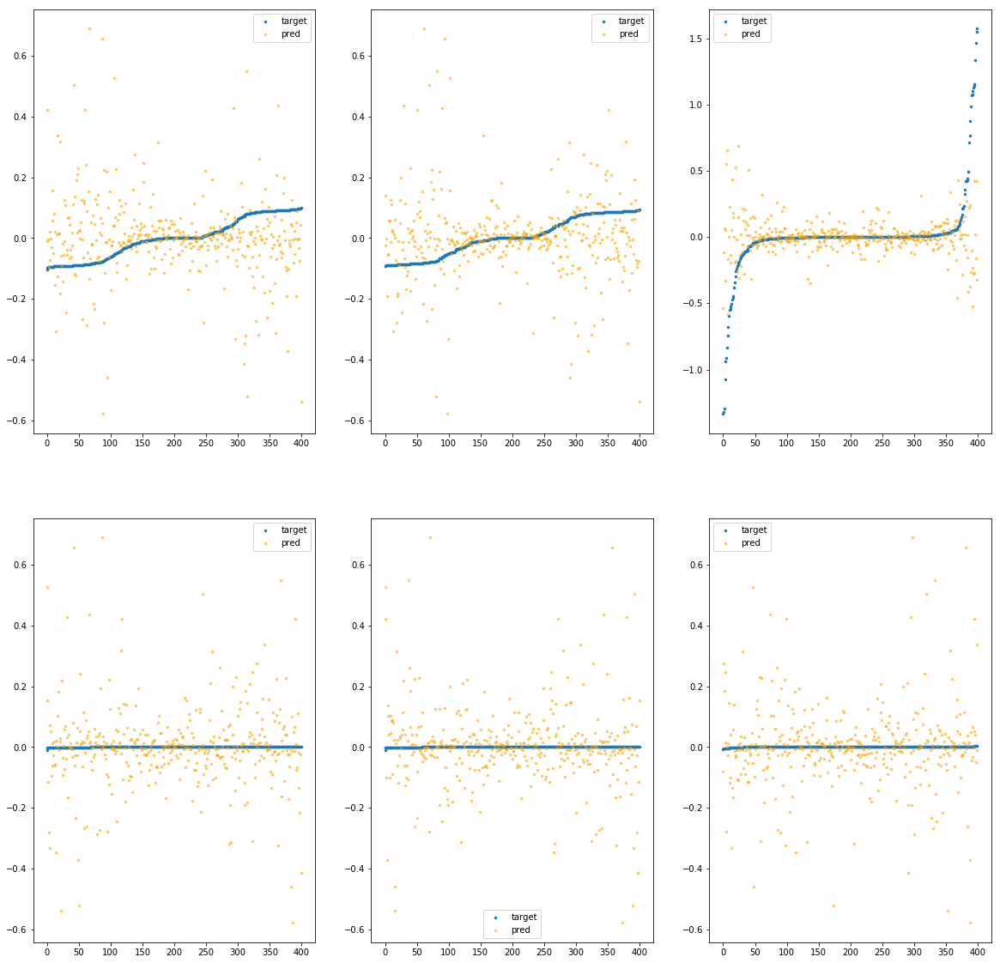

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa97e3a4640>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.01e+00	5.70e-01	8.91e-02	4.04e+04	1.64e-02	2.70e-04
y		-2.89e+00	4.40e-01	8.37e-02	3.43e+03	1.49e-02	2.22e-04
z		-1.59e-01	1.64e+00	1.46e-01	2.31e+03	9.65e-02	9.32e-03
phi		-3.12e+04	4.82e-01	6.88e-02	1.29e+07	1.13e-02	1.27e-04
theta		-3.65e+04	4.81e-01	6.88e-02	3.55e+06	1.13e-02	1.27e-04
psi		-1.50e+04	4.81e-01	6.88e-02	6.40e+06	1.13e-02	1.27e-04


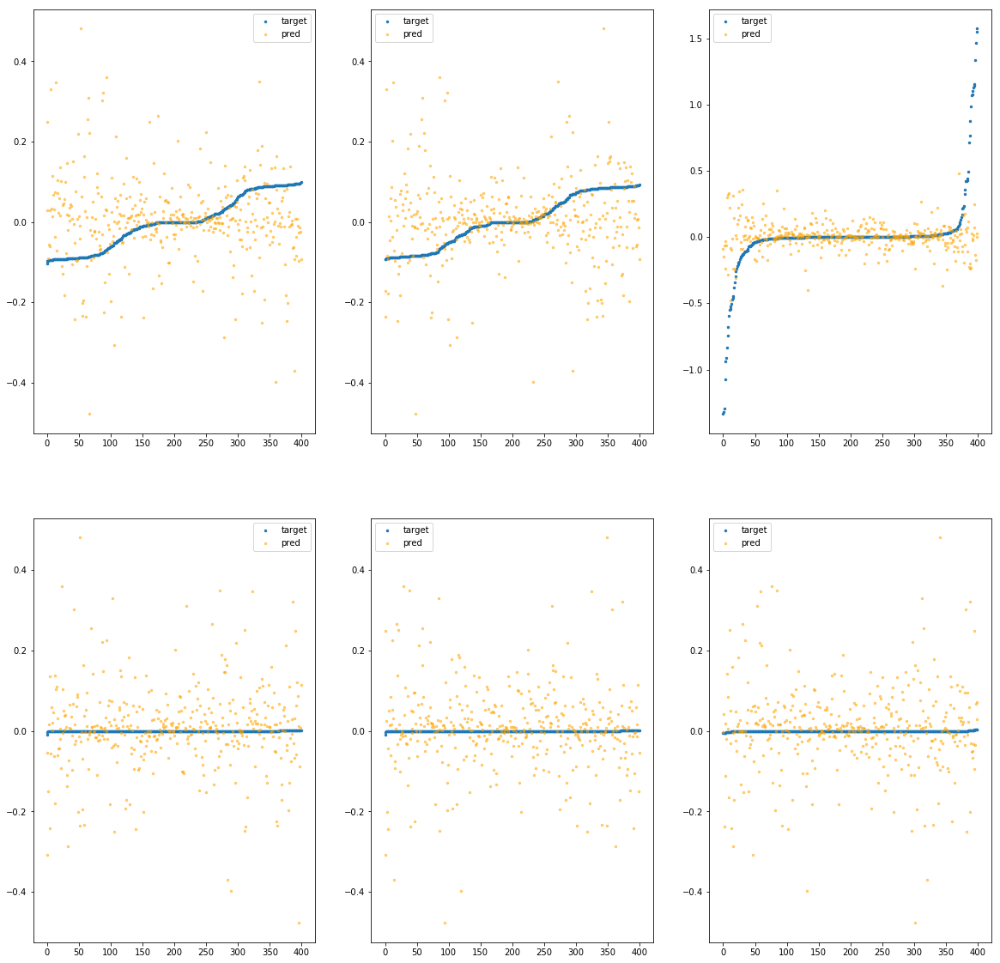

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa97e3a46a0>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.68e+00	7.07e-01	1.03e-01	4.55e+04	2.32e-02	5.40e-04
y		-5.05e+00	7.03e-01	1.02e-01	3.17e+03	2.32e-02	5.38e-04
z		-2.11e-01	1.66e+00	1.50e-01	2.35e+03	1.01e-01	1.02e-02
phi		-5.40e+04	6.25e-01	8.97e-02	1.33e+07	1.95e-02	3.82e-04
theta		-6.33e+04	6.25e-01	8.97e-02	3.19e+06	1.95e-02	3.82e-04
psi		-2.61e+04	6.25e-01	8.97e-02	1.08e+07	1.96e-02	3.83e-04


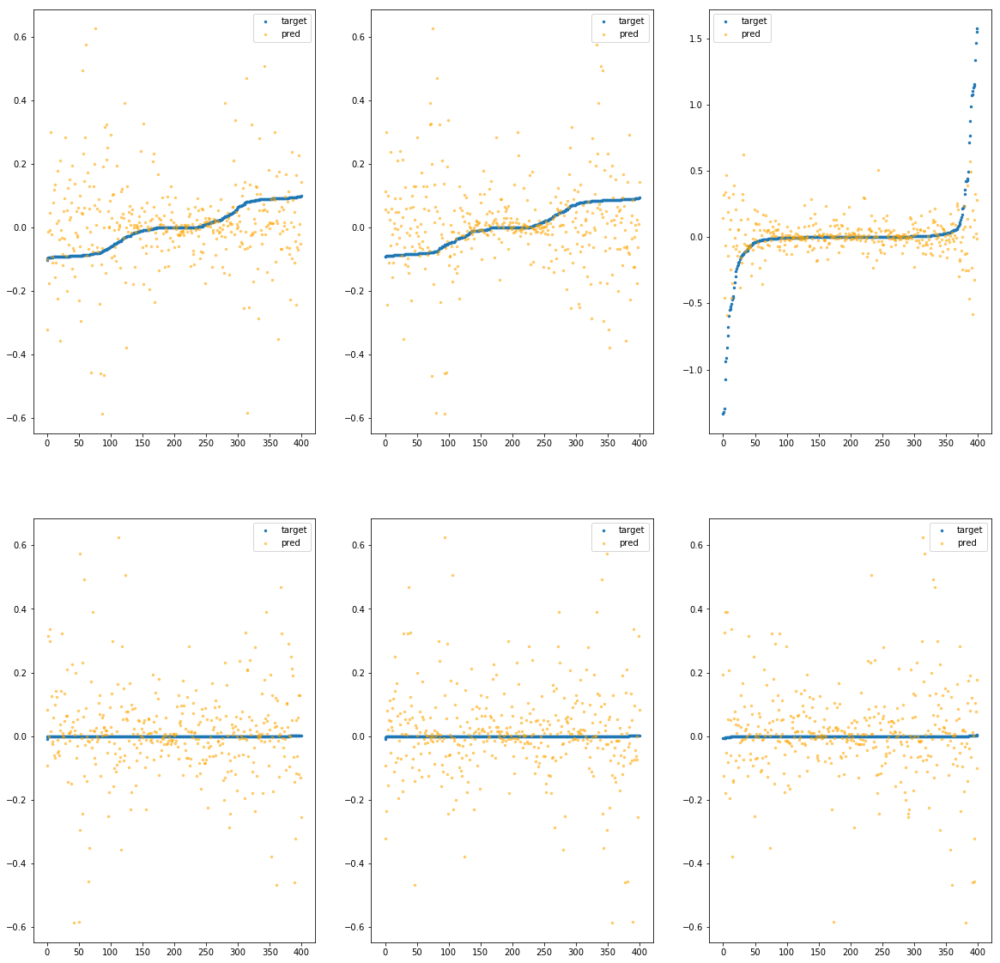

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa97e3a4730>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.77e+00	6.88e-01	1.12e-01	6.10e+04	2.77e-02	7.69e-04
y		-6.62e+00	7.77e-01	1.17e-01	7.99e+03	2.92e-02	8.53e-04
z		-1.82e-01	1.70e+00	1.61e-01	4.42e+03	9.84e-02	9.69e-03
phi		-6.60e+04	7.02e-01	9.96e-02	9.57e+06	2.39e-02	5.71e-04
theta		-7.73e+04	7.00e-01	9.96e-02	8.43e+06	2.39e-02	5.70e-04
psi		-3.18e+04	7.01e-01	9.95e-02	8.90e+06	2.38e-02	5.68e-04


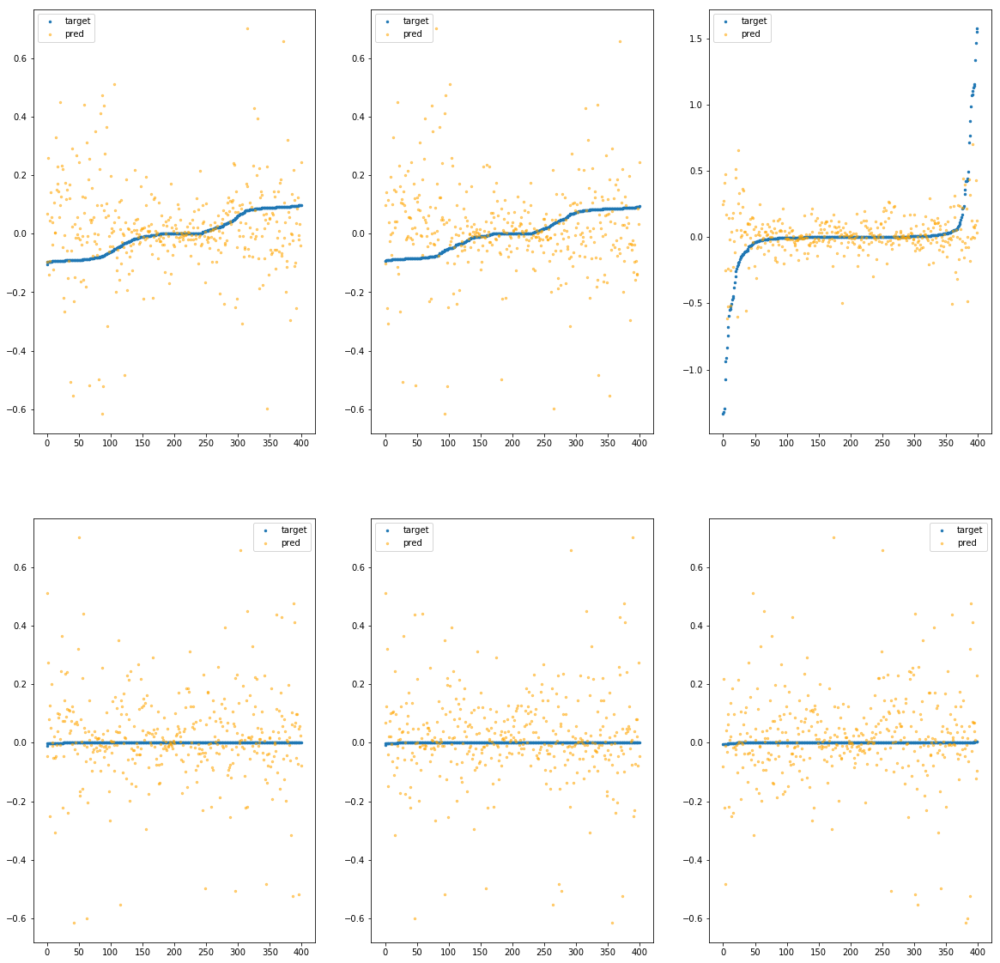

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa97e3a4790>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.19e+00	6.58e-01	1.06e-01	7.80e+04	2.53e-02	6.42e-04
y		-5.69e+00	7.58e-01	9.97e-02	3.28e+03	2.56e-02	6.57e-04
z		-3.01e-01	1.81e+00	1.59e-01	2.83e+03	1.08e-01	1.17e-02
phi		-6.13e+04	6.87e-01	9.31e-02	1.85e+07	2.22e-02	4.93e-04
theta		-7.19e+04	6.89e-01	9.31e-02	4.63e+06	2.22e-02	4.93e-04
psi		-2.96e+04	6.88e-01	9.30e-02	8.40e+06	2.22e-02	4.92e-04


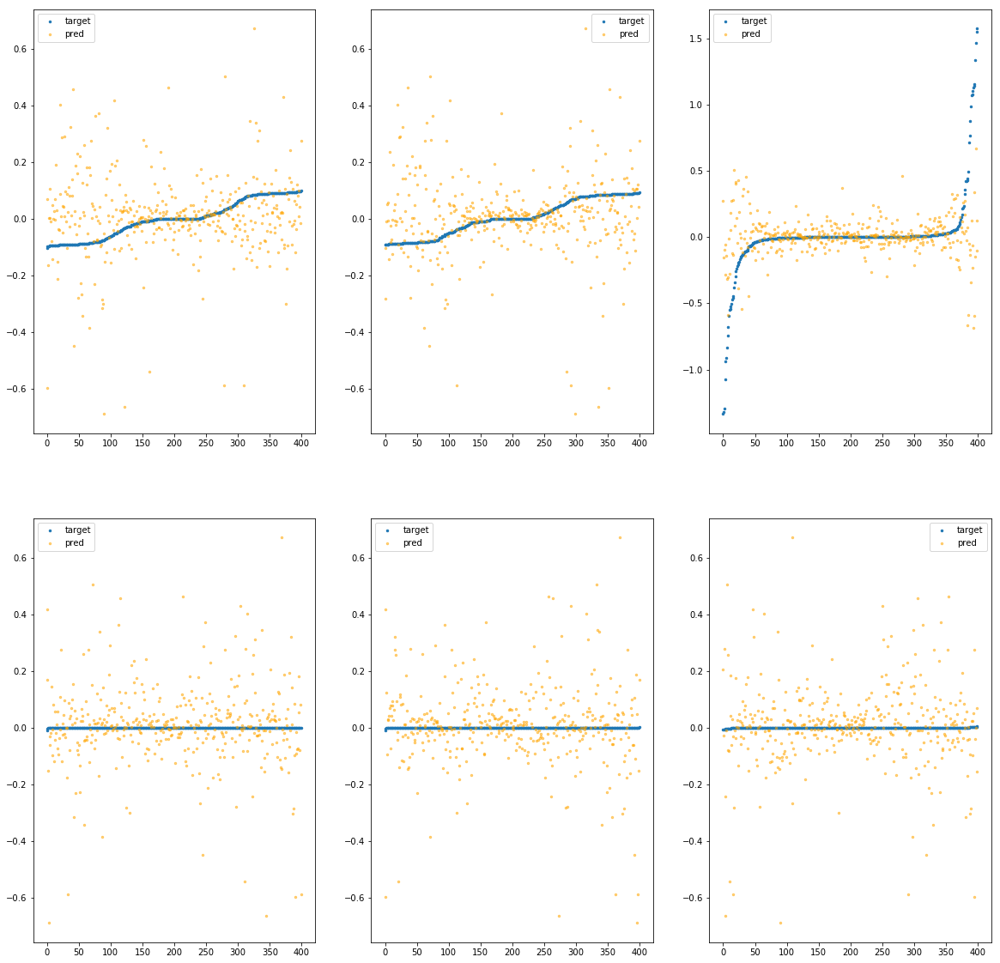

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa97e3a47f0>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.04e+00	7.38e-01	1.03e-01	6.17e+04	2.47e-02	6.12e-04
y		-5.98e+00	8.54e-01	1.05e-01	3.07e+03	2.67e-02	7.15e-04
z		-4.53e-01	2.00e+00	1.55e-01	3.13e+03	1.21e-01	1.47e-02
phi		-6.06e+04	7.70e-01	8.83e-02	1.24e+07	2.19e-02	4.82e-04
theta		-7.11e+04	7.70e-01	8.83e-02	2.68e+06	2.20e-02	4.82e-04
psi		-2.93e+04	7.65e-01	8.83e-02	8.21e+06	2.19e-02	4.81e-04


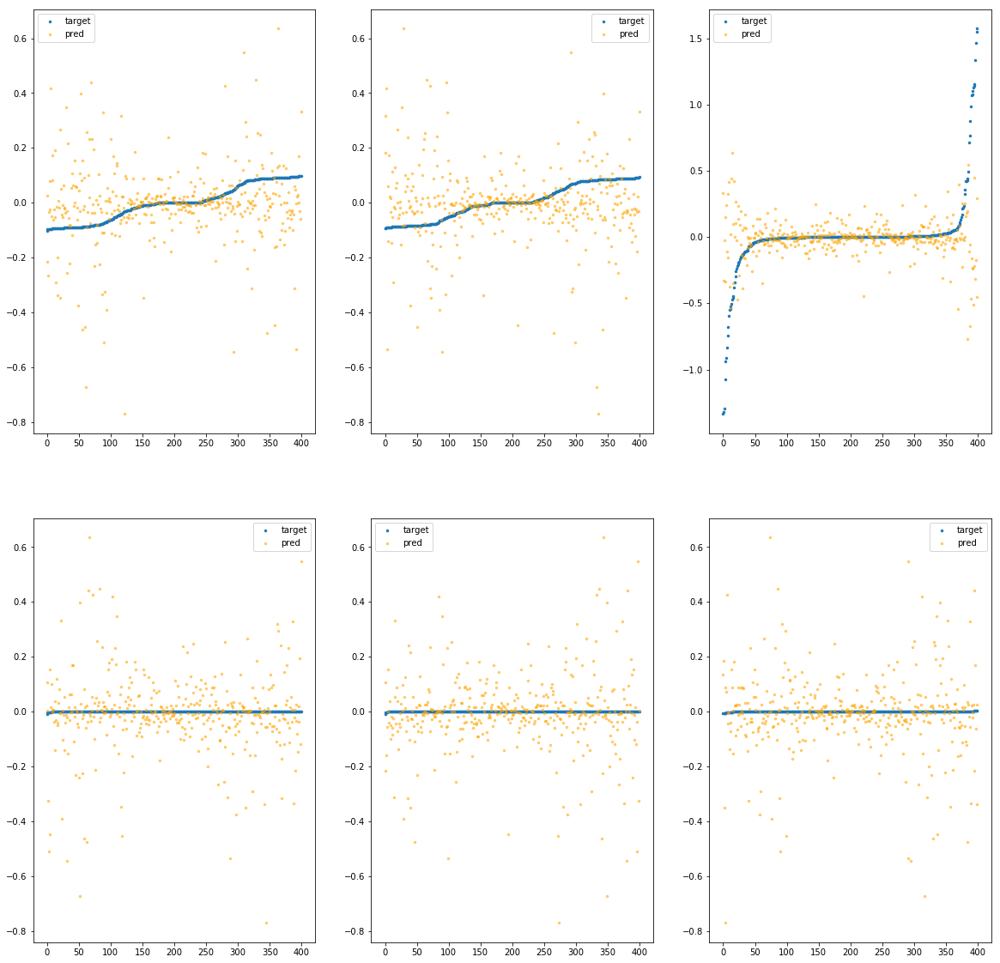

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa97e3a4850>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.70e+00	9.28e-01	1.02e-01	4.83e+04	2.74e-02	7.51e-04
y		-5.57e+00	7.94e-01	9.63e-02	1.35e+03	2.52e-02	6.35e-04
z		-2.08e-01	1.80e+00	1.41e-01	2.20e+03	1.01e-01	1.01e-02
phi		-5.97e+04	8.54e-01	8.10e-02	9.11e+06	2.16e-02	4.67e-04
theta		-6.99e+04	8.52e-01	8.10e-02	2.79e+06	2.16e-02	4.67e-04
psi		-2.88e+04	8.53e-01	8.10e-02	3.51e+06	2.16e-02	4.66e-04


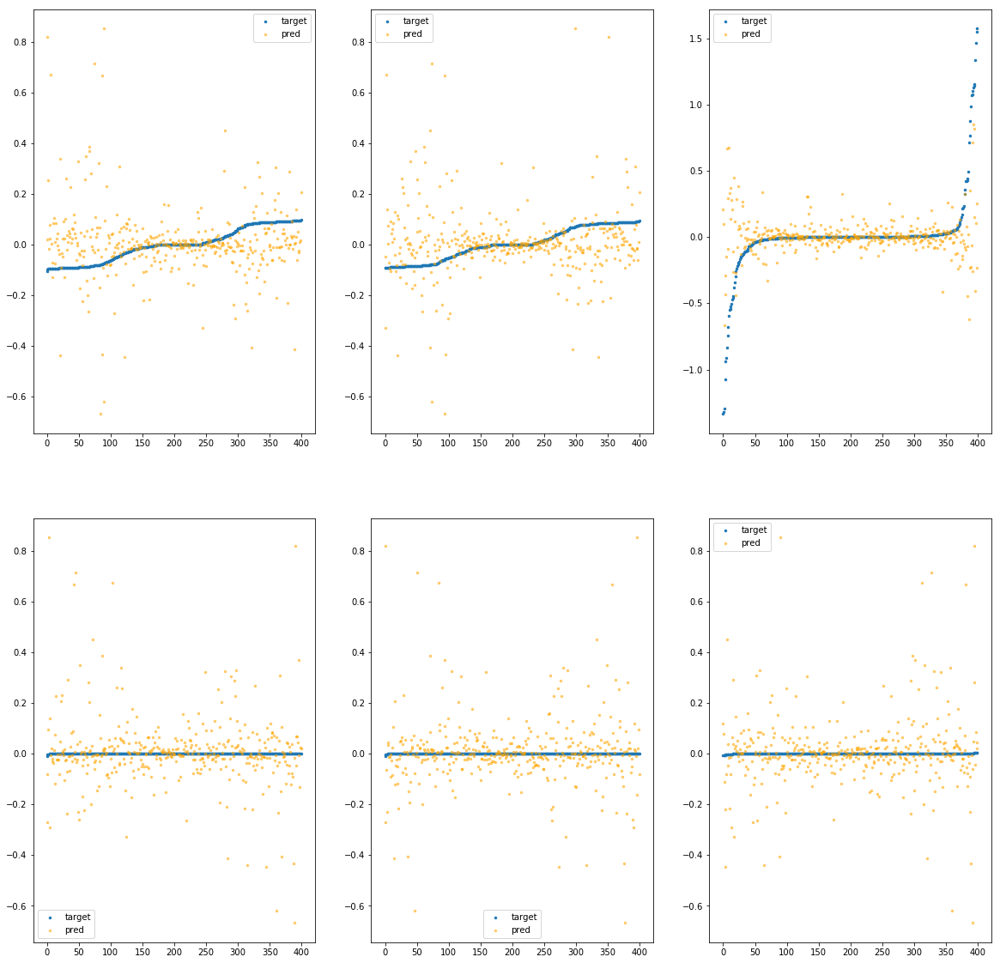

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa97e3a48b0>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.62e+00	5.94e-01	9.16e-02	4.05e+04	1.89e-02	3.58e-04
y		-3.96e+00	5.91e-01	9.33e-02	2.24e+03	1.90e-02	3.62e-04
z		-1.61e-01	1.82e+00	1.35e-01	2.44e+03	9.68e-02	9.36e-03
phi		-3.86e+04	6.56e-01	6.97e-02	1.23e+07	1.40e-02	1.95e-04
theta		-4.52e+04	6.57e-01	6.97e-02	2.62e+06	1.40e-02	1.95e-04
psi		-1.86e+04	6.57e-01	6.97e-02	6.33e+06	1.39e-02	1.94e-04


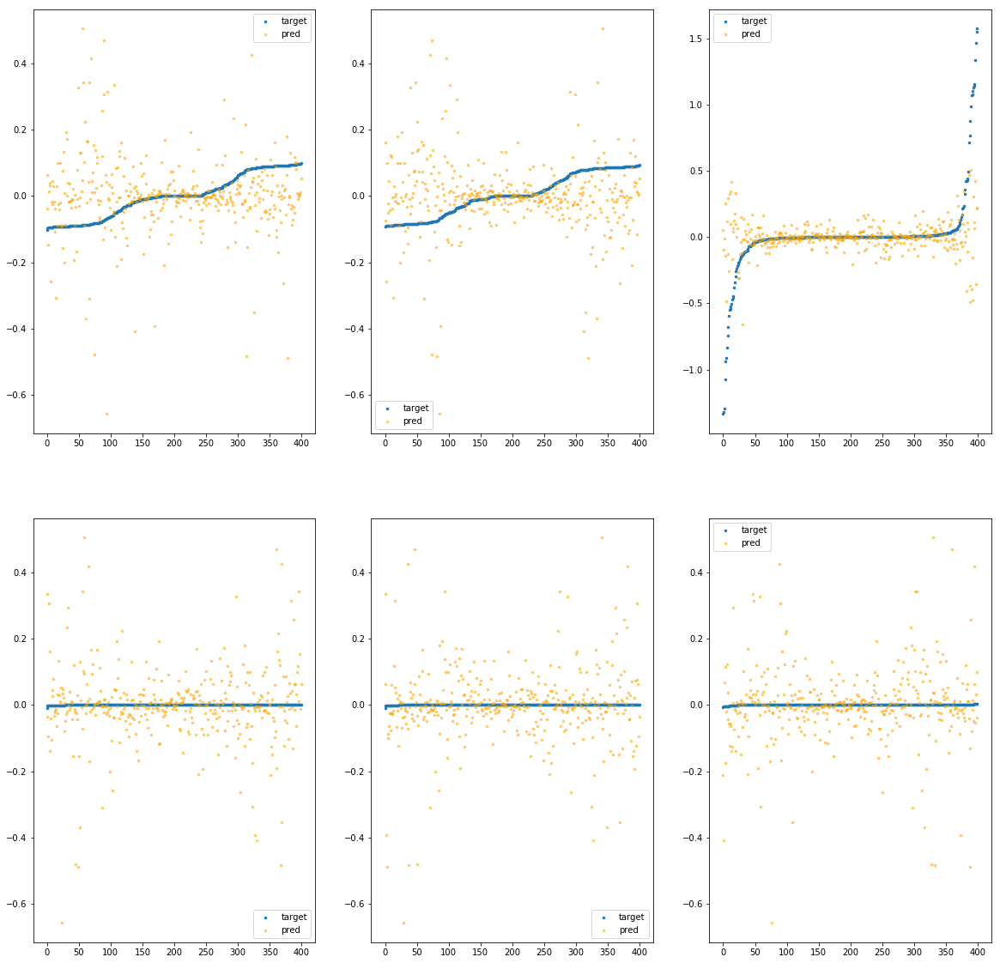

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa97e3a4910>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.28e+00	8.38e-01	1.08e-01	7.61e+04	2.98e-02	8.87e-04
y		-6.67e+00	9.02e-01	1.04e-01	3.54e+03	2.94e-02	8.65e-04
z		-4.31e-01	2.05e+00	1.58e-01	2.79e+03	1.19e-01	1.42e-02
phi		-7.08e+04	8.73e-01	9.26e-02	1.12e+07	2.56e-02	6.57e-04
theta		-8.30e+04	8.73e-01	9.26e-02	3.15e+06	2.56e-02	6.57e-04
psi		-3.42e+04	8.74e-01	9.26e-02	7.79e+06	2.57e-02	6.58e-04


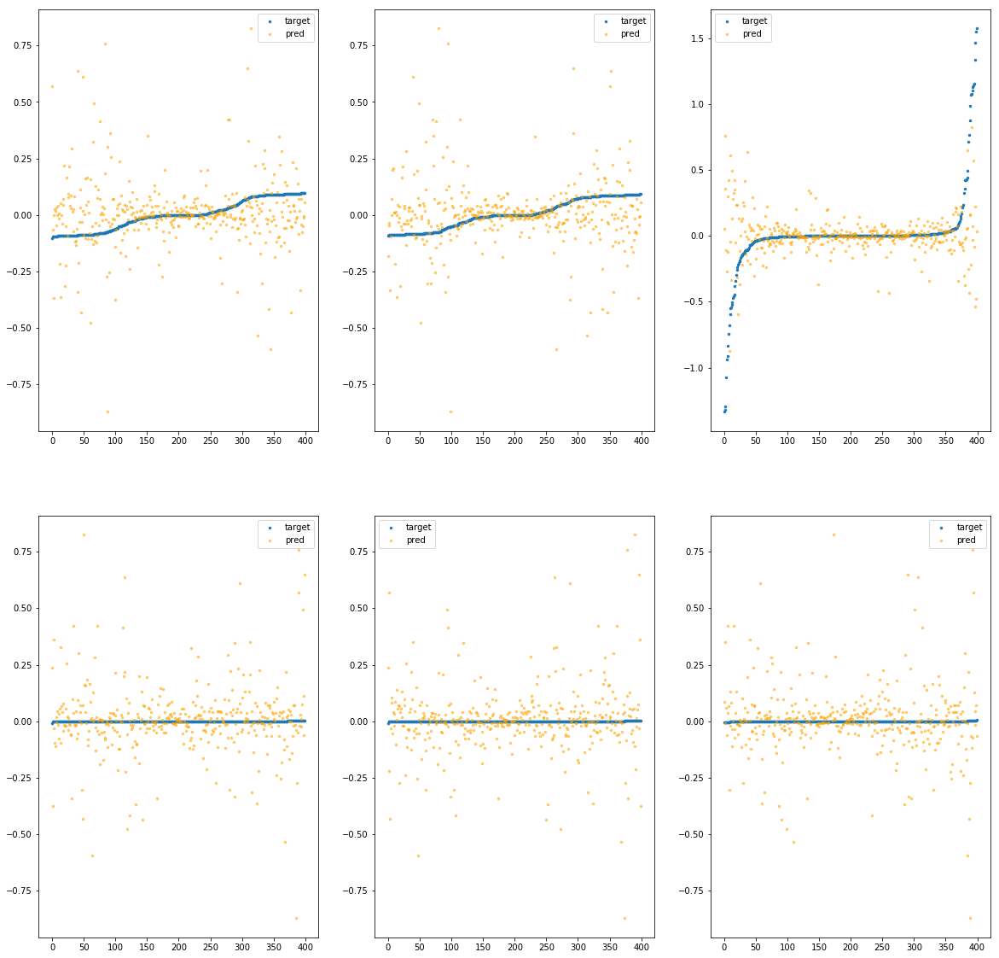

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa97e3a4970>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.43e+00	7.94e-01	1.26e-01	7.40e+04	3.45e-02	1.19e-03
y		-7.35e+00	7.53e-01	1.21e-01	7.06e+03	3.20e-02	1.03e-03
z		-4.19e-01	2.20e+00	1.71e-01	3.77e+03	1.18e-01	1.40e-02
phi		-8.32e+04	7.09e-01	1.13e-01	1.16e+07	3.01e-02	9.06e-04
theta		-9.75e+04	7.10e-01	1.13e-01	7.25e+06	3.01e-02	9.07e-04
psi		-4.02e+04	7.10e-01	1.13e-01	1.06e+07	3.01e-02	9.07e-04


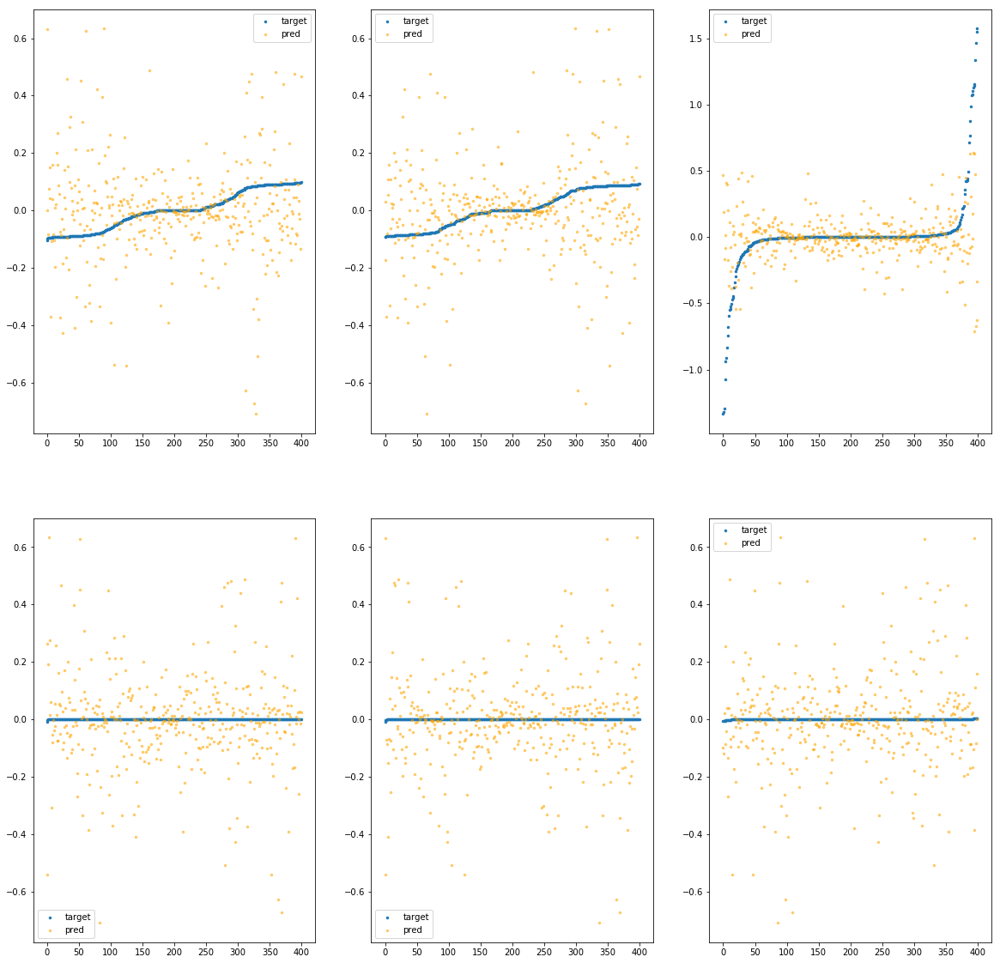

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa97e3a49d0>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.66e+00	7.62e-01	8.94e-02	3.27e+04	1.91e-02	3.65e-04
y		-3.91e+00	9.39e-01	8.46e-02	2.39e+03	1.88e-02	3.55e-04
z		-2.98e-01	1.96e+00	1.30e-01	2.16e+03	1.08e-01	1.17e-02
phi		-4.18e+04	8.53e-01	6.58e-02	7.69e+06	1.51e-02	2.29e-04
theta		-4.90e+04	8.52e-01	6.58e-02	2.30e+06	1.51e-02	2.29e-04
psi		-2.03e+04	8.52e-01	6.60e-02	3.78e+06	1.52e-02	2.31e-04


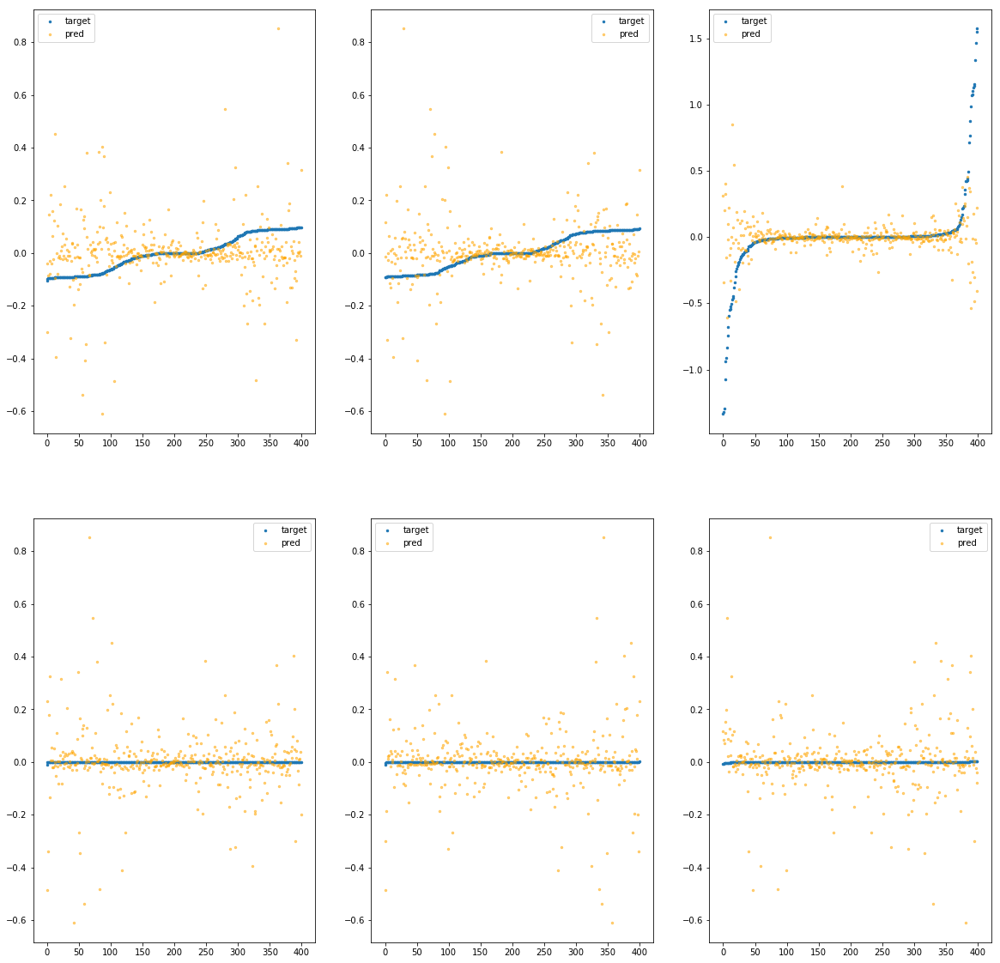

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa97e3a4a30>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.90e+00	7.32e-01	8.34e-02	3.27e+04	1.60e-02	2.55e-04
y		-3.01e+00	7.37e-01	8.01e-02	3.80e+03	1.54e-02	2.36e-04
z		-1.72e-02	1.63e+00	1.26e-01	1.97e+03	8.47e-02	7.18e-03
phi		-3.11e+04	8.15e-01	5.90e-02	8.65e+06	1.12e-02	1.26e-04
theta		-3.64e+04	8.15e-01	5.90e-02	3.07e+06	1.12e-02	1.26e-04
psi		-1.50e+04	8.16e-01	5.90e-02	2.48e+06	1.12e-02	1.26e-04


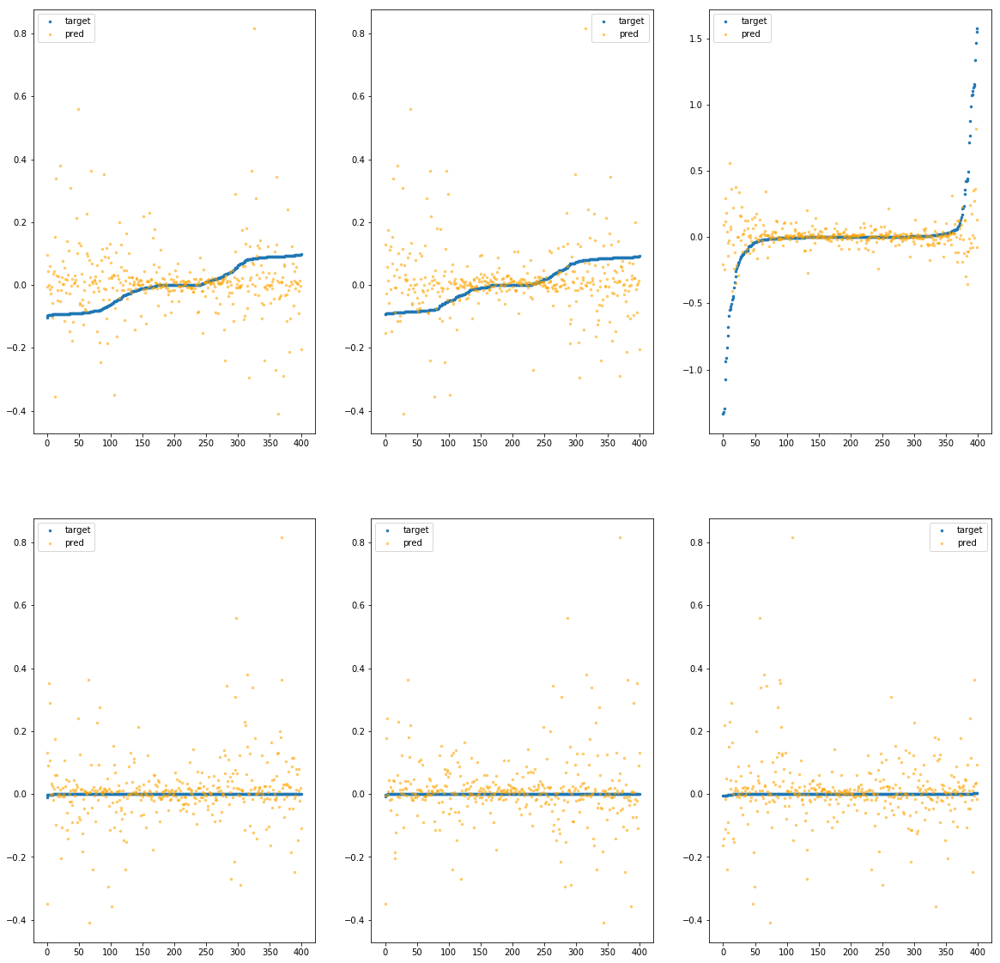

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa97e3a4a90>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.99e+00	5.48e-01	7.62e-02	3.54e+04	1.22e-02	1.50e-04
y		-2.35e+00	6.47e-01	7.84e-02	2.30e+03	1.28e-02	1.65e-04
z		7.54e-02	1.73e+00	1.21e-01	1.62e+03	7.70e-02	5.94e-03
phi		-2.57e+04	5.64e-01	5.59e-02	8.65e+06	9.31e-03	8.66e-05
theta		-3.01e+04	5.64e-01	5.59e-02	2.41e+06	9.30e-03	8.64e-05
psi		-1.24e+04	5.58e-01	5.59e-02	3.20e+06	9.29e-03	8.62e-05


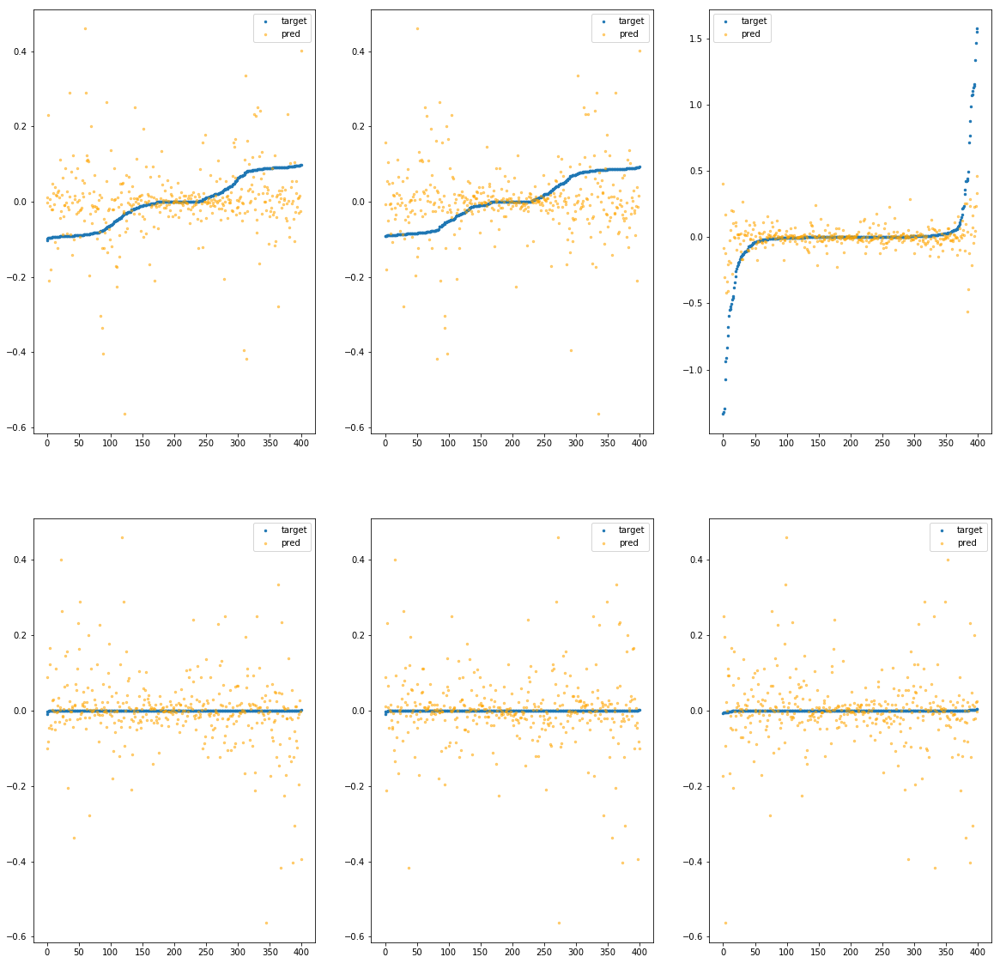

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa97e3a4af0>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.52e+00	7.66e-01	7.87e-02	4.69e+04	1.44e-02	2.07e-04
y		-3.36e+00	6.59e-01	8.68e-02	8.61e+02	1.67e-02	2.79e-04
z		4.28e-02	1.74e+00	1.23e-01	1.19e+03	7.98e-02	6.36e-03
phi		-3.03e+04	6.77e-01	5.89e-02	1.23e+07	1.10e-02	1.20e-04
theta		-3.55e+04	6.77e-01	5.88e-02	7.29e+05	1.10e-02	1.20e-04
psi		-1.46e+04	6.77e-01	5.88e-02	5.57e+06	1.10e-02	1.20e-04


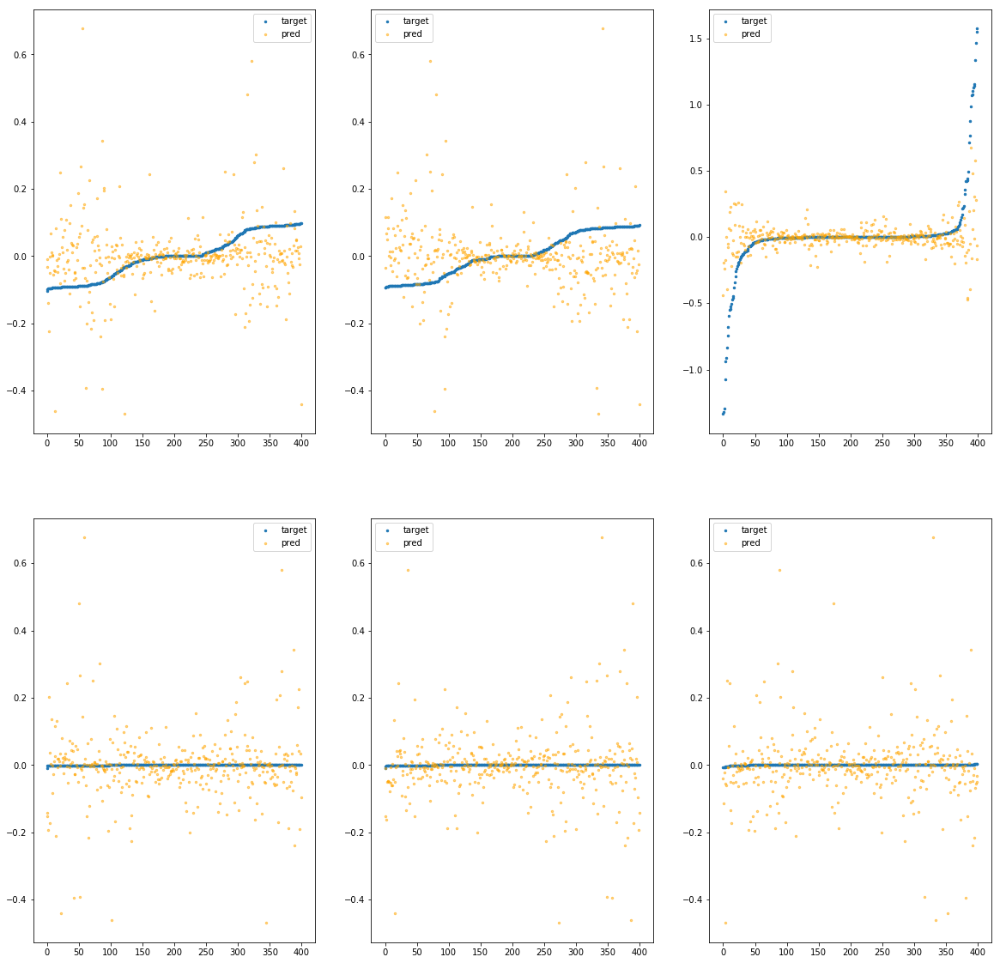

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa97e3a4b50>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.64e+00	1.02e+00	9.78e-02	4.36e+04	2.31e-02	5.32e-04
y		-4.62e+00	1.00e+00	9.55e-02	2.29e+03	2.16e-02	4.65e-04
z		-3.96e-01	1.91e+00	1.48e-01	1.95e+03	1.16e-01	1.35e-02
phi		-5.07e+04	9.46e-01	7.68e-02	7.69e+06	1.83e-02	3.36e-04
theta		-5.93e+04	9.46e-01	7.67e-02	2.27e+06	1.83e-02	3.36e-04
psi		-2.45e+04	9.45e-01	7.68e-02	6.74e+06	1.83e-02	3.37e-04


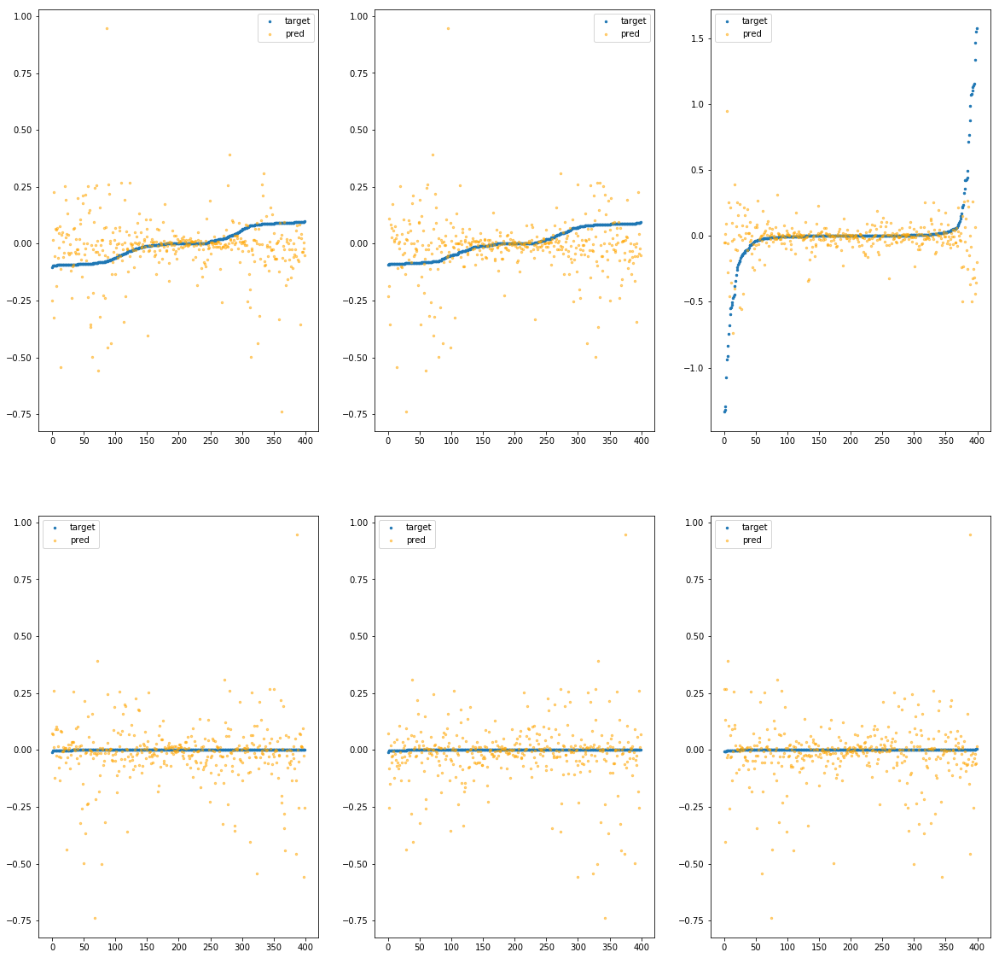

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa97e3a4bb0>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.26e+00	5.85e-01	7.72e-02	2.46e+04	1.34e-02	1.78e-04
y		-2.45e+00	5.91e-01	7.71e-02	8.45e+02	1.32e-02	1.75e-04
z		-1.80e-01	1.83e+00	1.29e-01	1.28e+03	9.83e-02	9.66e-03
phi		-2.39e+04	5.05e-01	5.15e-02	7.89e+06	8.67e-03	7.52e-05
theta		-2.80e+04	5.04e-01	5.14e-02	7.68e+05	8.66e-03	7.49e-05
psi		-1.16e+04	5.04e-01	5.15e-02	3.63e+06	8.68e-03	7.53e-05


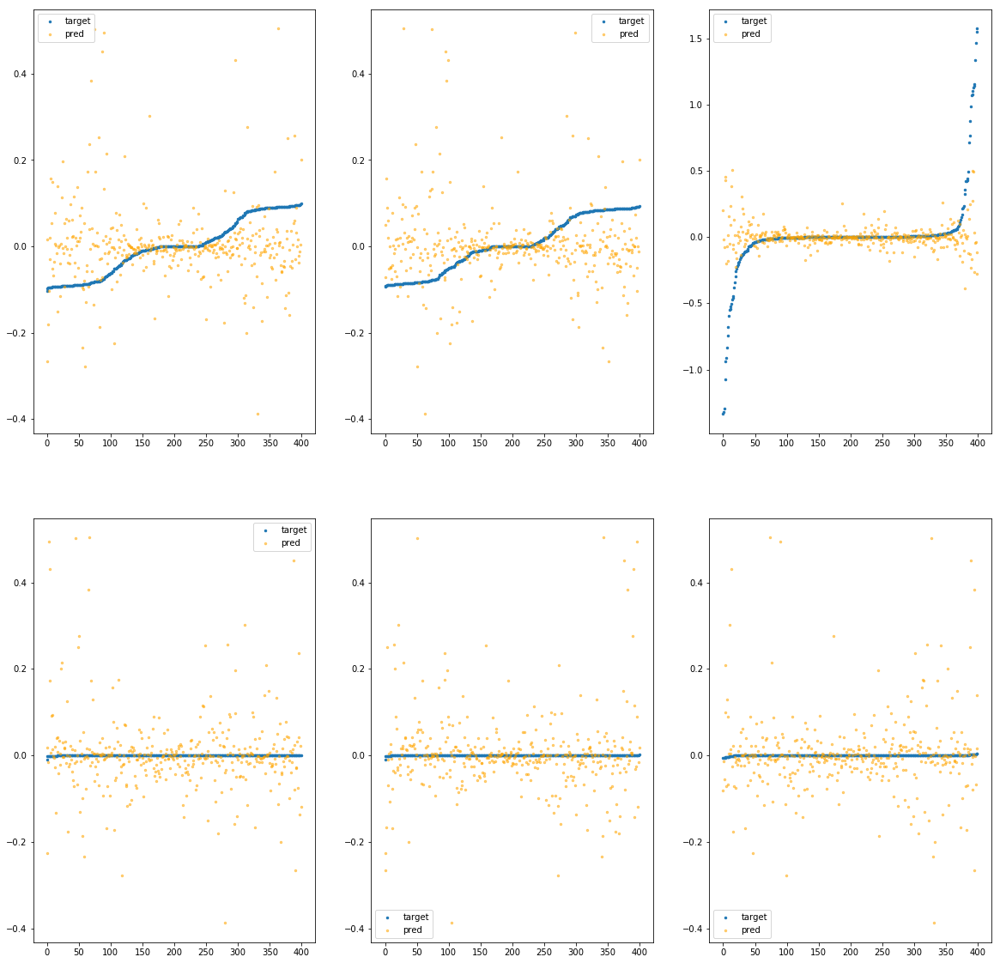

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa97e3a4c10>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.51e+00	7.16e-01	8.09e-02	1.79e+04	1.44e-02	2.07e-04
y		-2.84e+00	5.61e-01	8.12e-02	1.49e+03	1.47e-02	2.17e-04
z		-9.28e-03	1.56e+00	1.19e-01	9.56e+02	8.41e-02	7.07e-03
phi		-2.80e+04	6.37e-01	5.42e-02	3.73e+06	1.01e-02	1.03e-04
theta		-3.28e+04	6.36e-01	5.41e-02	1.68e+06	1.01e-02	1.03e-04
psi		-1.35e+04	6.36e-01	5.40e-02	4.48e+06	1.01e-02	1.03e-04


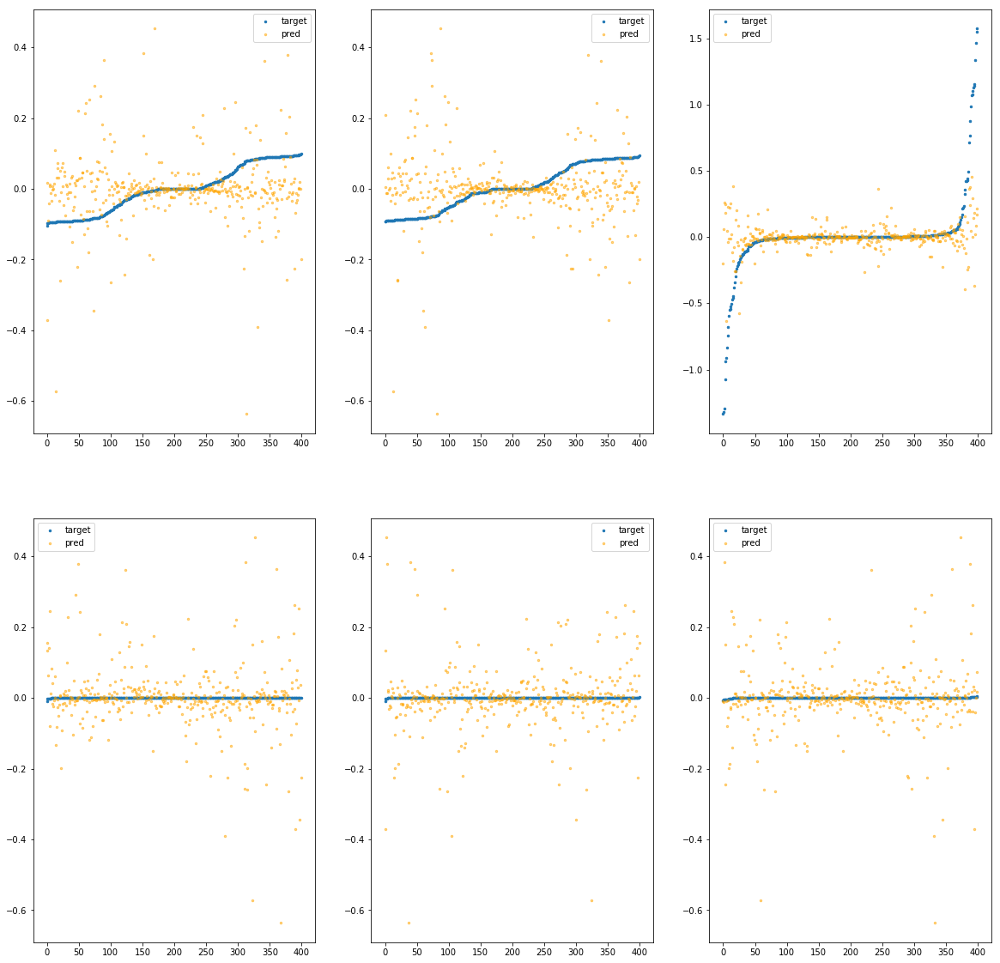

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa97e3a4c70>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.97e+00	7.75e-01	8.38e-02	3.14e+04	1.63e-02	2.64e-04
y		-2.96e+00	7.71e-01	7.84e-02	1.20e+03	1.52e-02	2.30e-04
z		-1.06e-01	1.67e+00	1.26e-01	1.35e+03	9.22e-02	8.50e-03
phi		-3.18e+04	8.50e-01	5.63e-02	8.14e+06	1.15e-02	1.32e-04
theta		-3.72e+04	8.49e-01	5.63e-02	1.10e+06	1.15e-02	1.32e-04
psi		-1.53e+04	8.49e-01	5.62e-02	2.47e+06	1.15e-02	1.32e-04


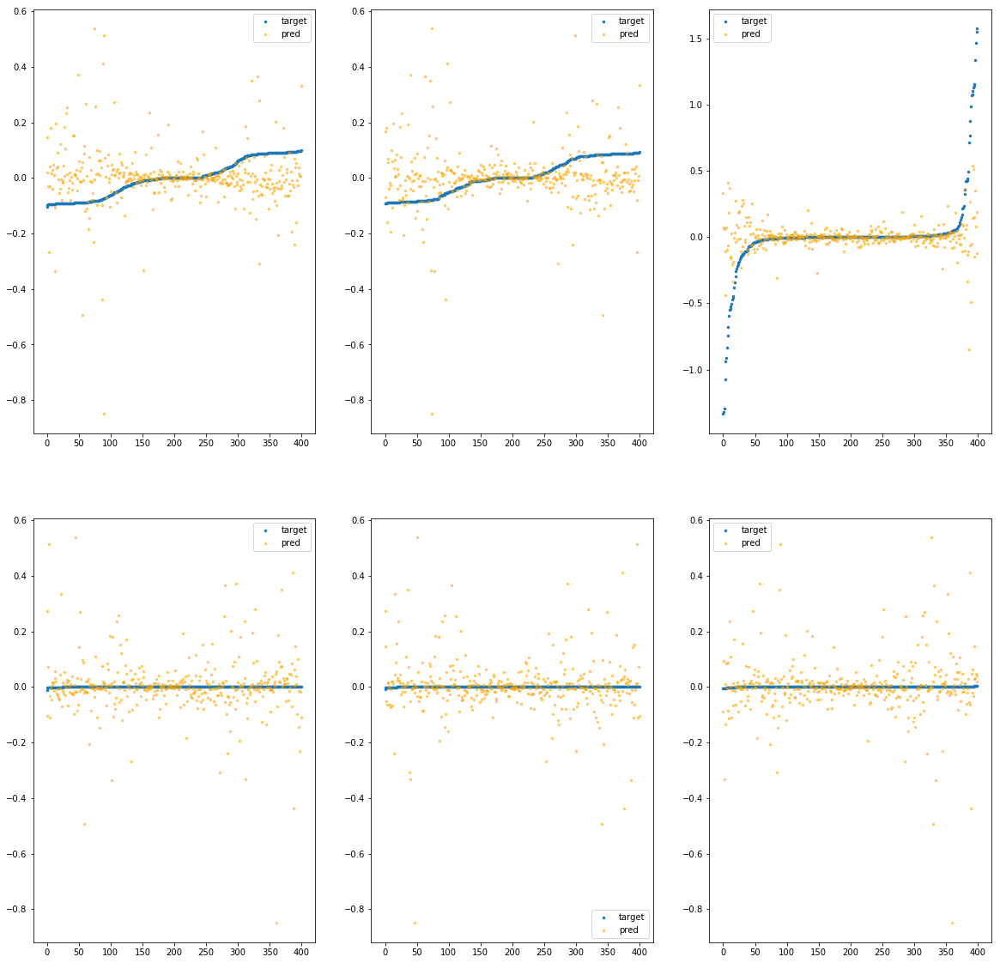

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa97e3a4cd0>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.02e+00	5.11e-01	7.57e-02	2.10e+04	1.24e-02	1.53e-04
y		-2.04e+00	5.09e-01	7.22e-02	9.30e+02	1.17e-02	1.36e-04
z		-1.23e-01	1.60e+00	1.27e-01	1.24e+03	9.36e-02	8.76e-03
phi		-2.49e+04	4.69e-01	5.39e-02	6.09e+06	9.00e-03	8.10e-05
theta		-2.92e+04	4.68e-01	5.40e-02	1.22e+06	9.01e-03	8.11e-05
psi		-1.19e+04	4.59e-01	5.39e-02	2.57e+06	8.96e-03	8.03e-05


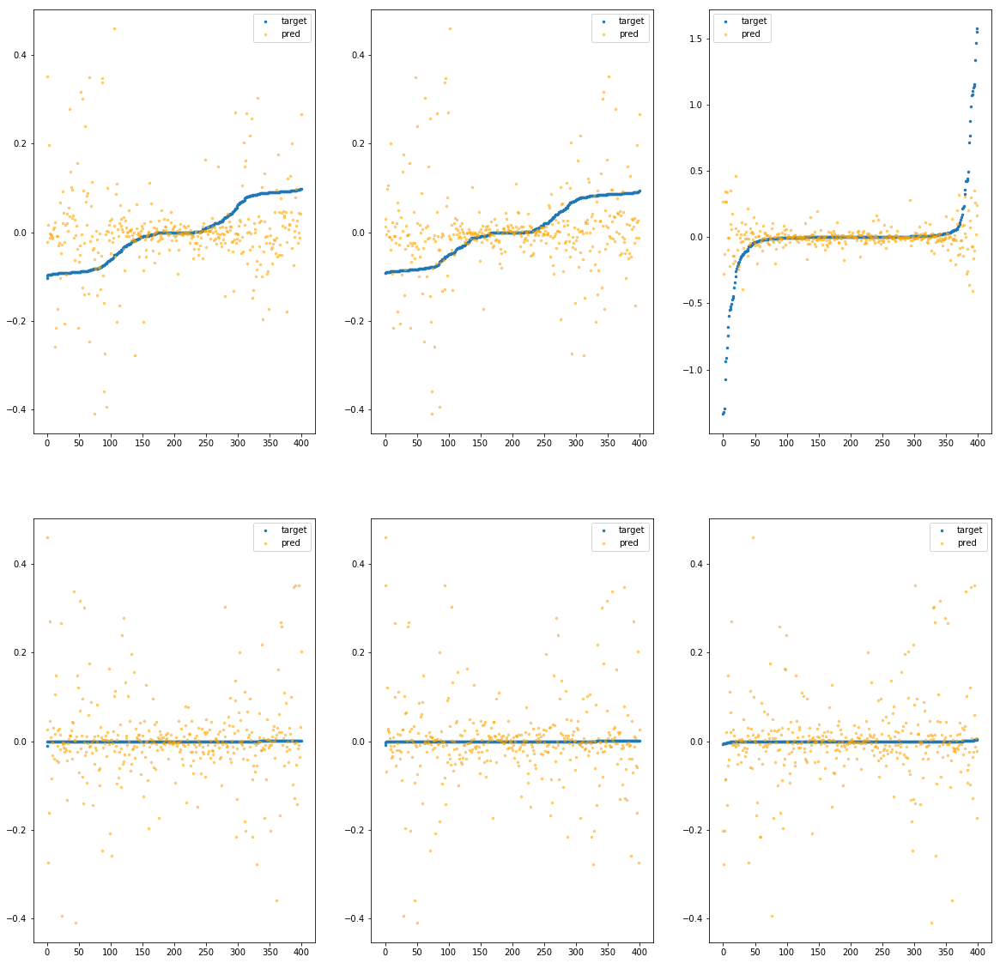

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa97e3a4d30>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.17e+00	7.49e-01	8.71e-02	4.20e+04	1.71e-02	2.91e-04
y		-3.57e+00	7.45e-01	8.49e-02	2.37e+03	1.75e-02	3.07e-04
z		-1.47e-01	1.55e+00	1.34e-01	1.65e+03	9.56e-02	9.13e-03
phi		-3.40e+04	6.80e-01	6.10e-02	1.15e+07	1.23e-02	1.52e-04
theta		-3.99e+04	6.80e-01	6.11e-02	1.71e+06	1.23e-02	1.52e-04
psi		-1.64e+04	6.79e-01	6.10e-02	4.03e+06	1.23e-02	1.51e-04


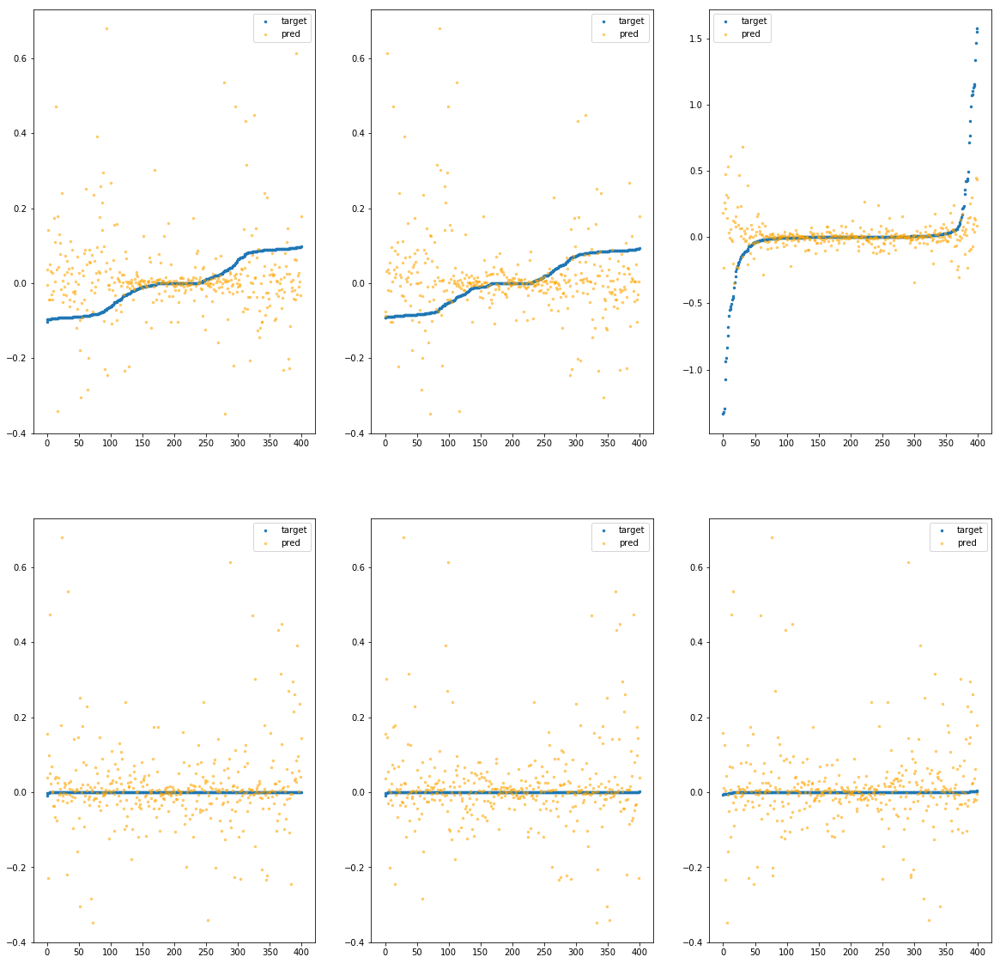

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa97e3a4d90>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.35e+00	4.45e-01	6.84e-02	1.95e+04	9.64e-03	9.28e-05
y		-1.37e+00	4.57e-01	6.66e-02	8.10e+02	9.07e-03	8.23e-05
z		-9.29e-02	1.87e+00	1.16e-01	8.36e+02	9.11e-02	8.29e-03
phi		-1.50e+04	3.76e-01	4.00e-02	5.42e+06	5.42e-03	2.94e-05
theta		-1.76e+04	3.76e-01	4.00e-02	7.12e+05	5.43e-03	2.95e-05
psi		-7.24e+03	3.76e-01	4.00e-02	1.90e+06	5.43e-03	2.95e-05


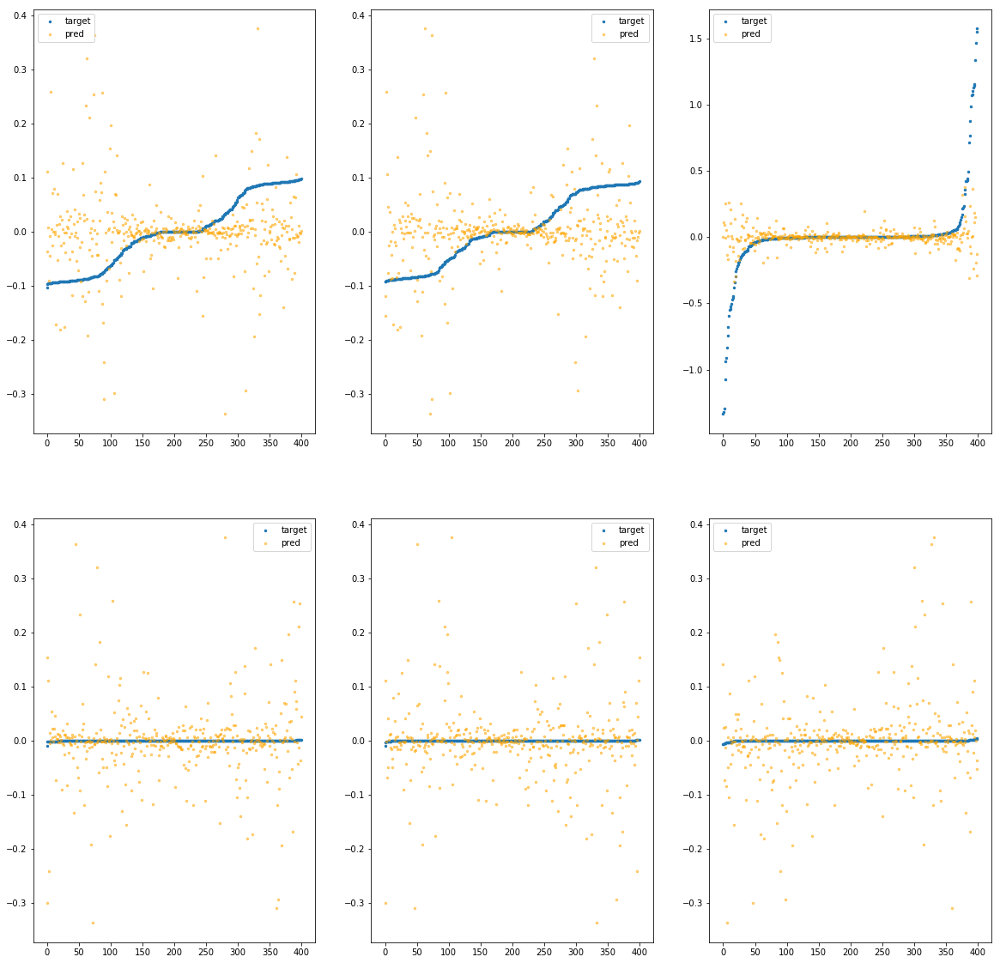

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa97e3a4df0>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.54e+00	5.09e-01	7.10e-02	3.02e+04	1.04e-02	1.08e-04
y		-1.68e+00	5.05e-01	6.90e-02	7.39e+02	1.03e-02	1.05e-04
z		-1.29e-01	1.60e+00	1.25e-01	1.82e+03	9.41e-02	8.85e-03
phi		-1.57e+04	4.22e-01	4.34e-02	8.28e+06	5.70e-03	3.25e-05
theta		-1.85e+04	4.22e-01	4.34e-02	7.50e+05	5.70e-03	3.25e-05
psi		-7.60e+03	4.22e-01	4.33e-02	3.83e+06	5.70e-03	3.25e-05


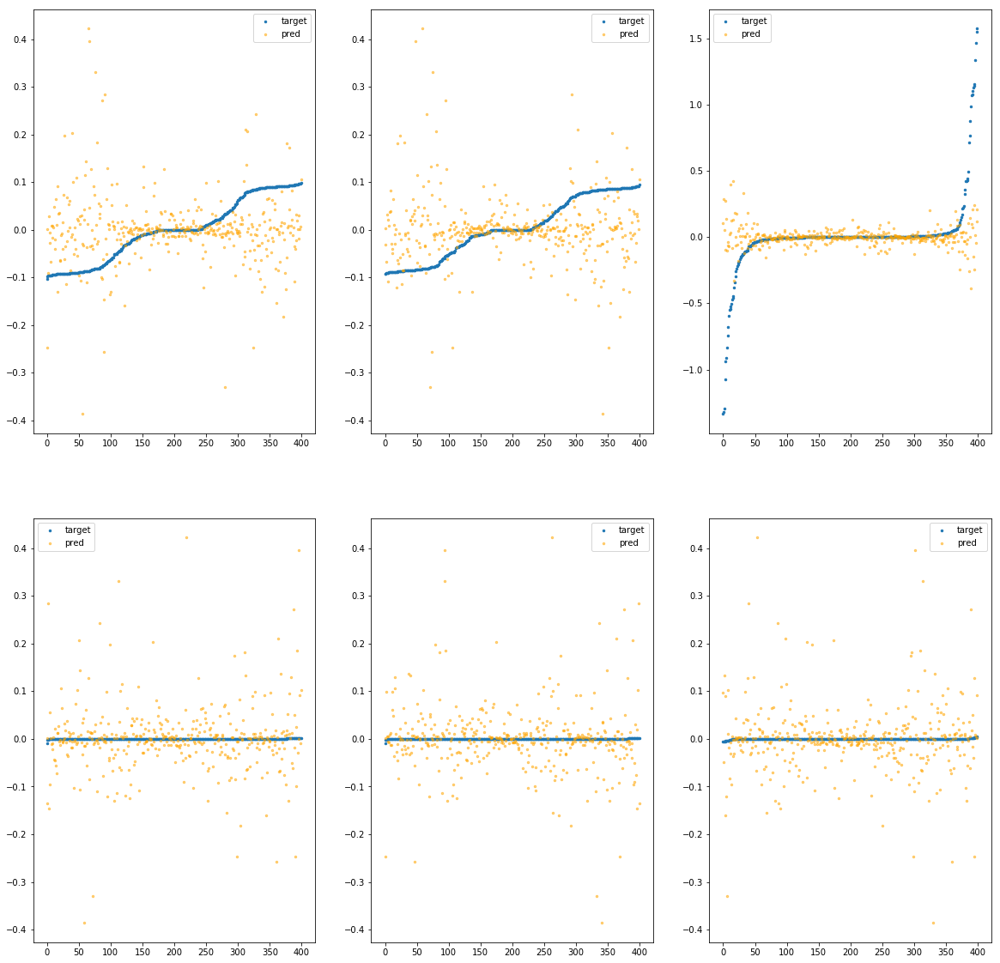

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa97e3a4e50>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.10e+00	5.73e-01	7.76e-02	3.50e+04	1.27e-02	1.61e-04
y		-2.27e+00	6.89e-01	7.53e-02	9.12e+02	1.25e-02	1.57e-04
z		-2.03e-01	1.73e+00	1.31e-01	1.22e+03	1.00e-01	1.00e-02
phi		-2.35e+04	6.06e-01	5.32e-02	8.53e+06	8.51e-03	7.25e-05
theta		-2.76e+04	6.06e-01	5.32e-02	9.37e+05	8.52e-03	7.25e-05
psi		-1.13e+04	6.00e-01	5.32e-02	3.57e+06	8.50e-03	7.22e-05


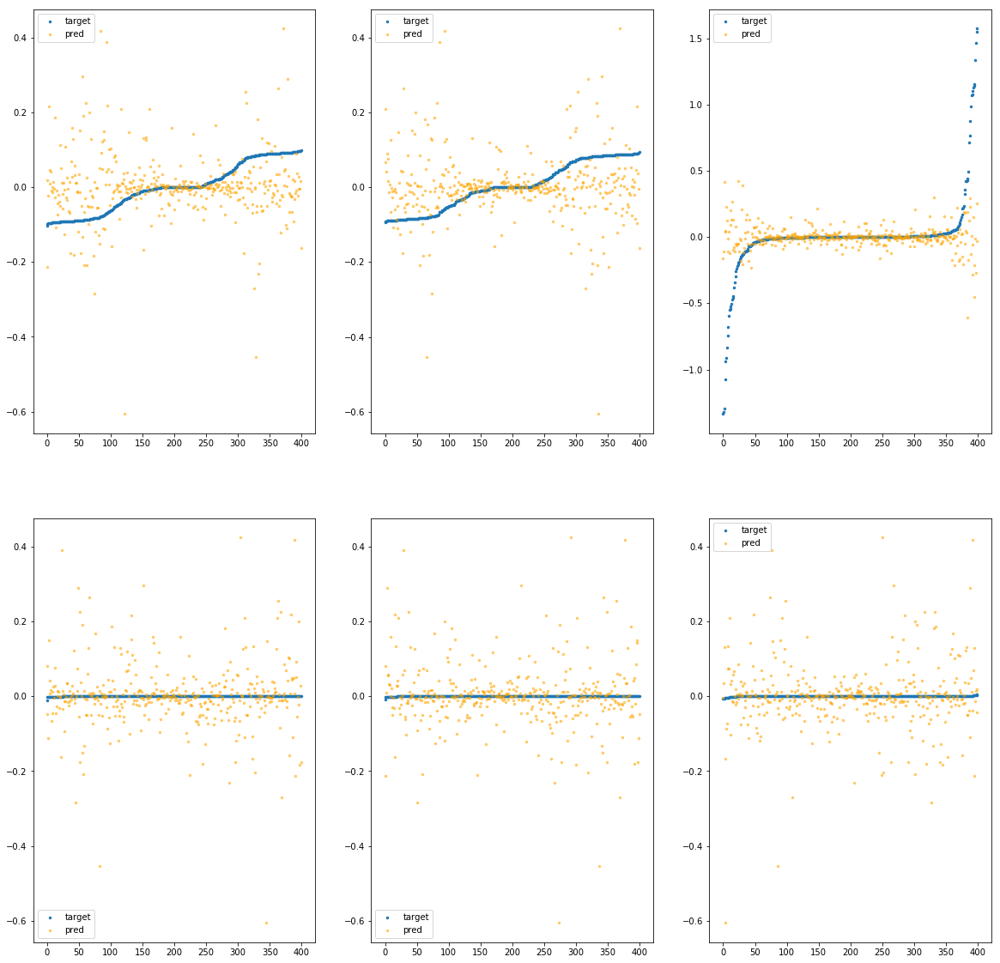

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa97e3a4eb0>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.71e+00	5.25e-01	7.37e-02	4.98e+04	1.11e-02	1.24e-04
y		-1.91e+00	5.09e-01	7.18e-02	5.38e+02	1.12e-02	1.24e-04
z		-2.22e-01	1.81e+00	1.31e-01	9.03e+02	1.02e-01	1.04e-02
phi		-2.18e+04	4.32e-01	5.22e-02	9.12e+06	7.91e-03	6.25e-05
theta		-2.56e+04	4.31e-01	5.22e-02	8.29e+05	7.90e-03	6.24e-05
psi		-1.05e+04	4.32e-01	5.21e-02	4.73e+06	7.90e-03	6.25e-05


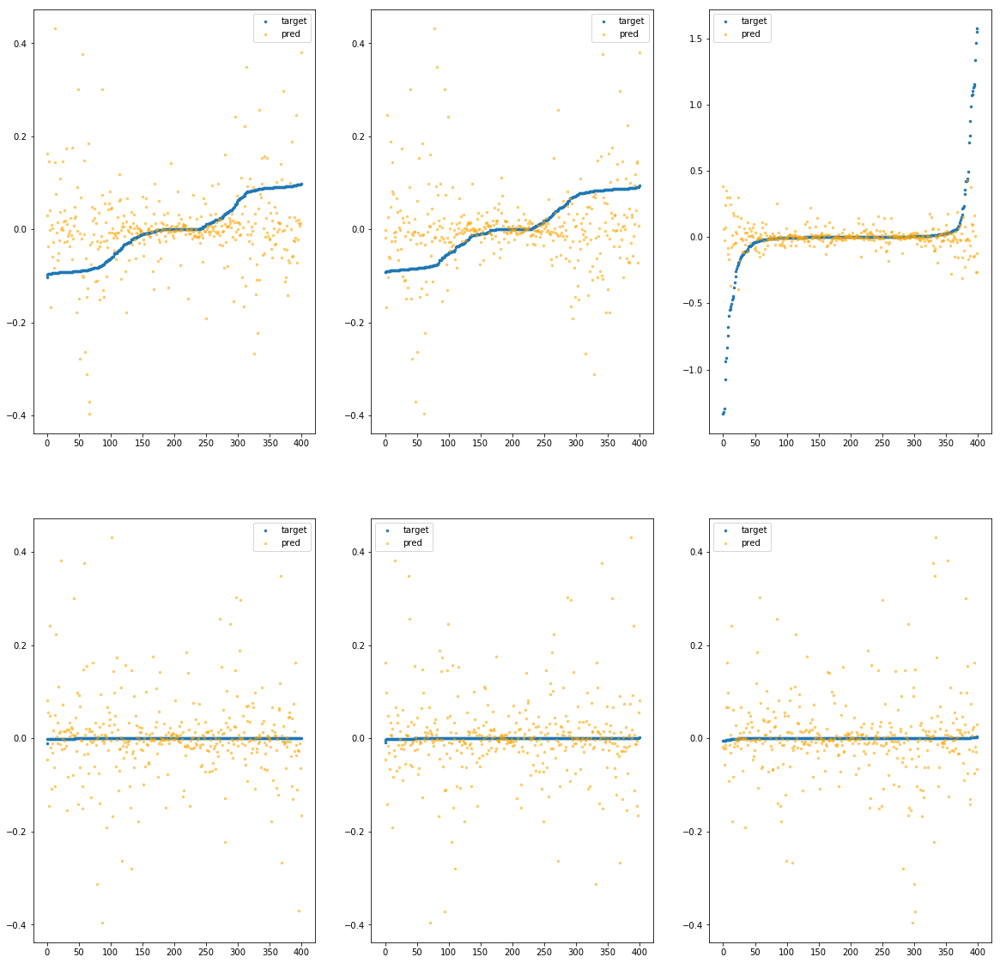

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa97e3a4f10>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.75e+00	5.50e-01	7.25e-02	1.46e+04	1.13e-02	1.27e-04
y		-1.81e+00	5.46e-01	7.14e-02	1.50e+03	1.08e-02	1.16e-04
z		-5.95e-02	2.04e+00	1.20e-01	1.11e+03	8.83e-02	7.79e-03
phi		-1.90e+04	4.72e-01	4.73e-02	4.19e+06	6.88e-03	4.73e-05
theta		-2.23e+04	4.72e-01	4.73e-02	9.31e+05	6.89e-03	4.75e-05
psi		-9.18e+03	4.71e-01	4.74e-02	3.62e+06	6.89e-03	4.75e-05


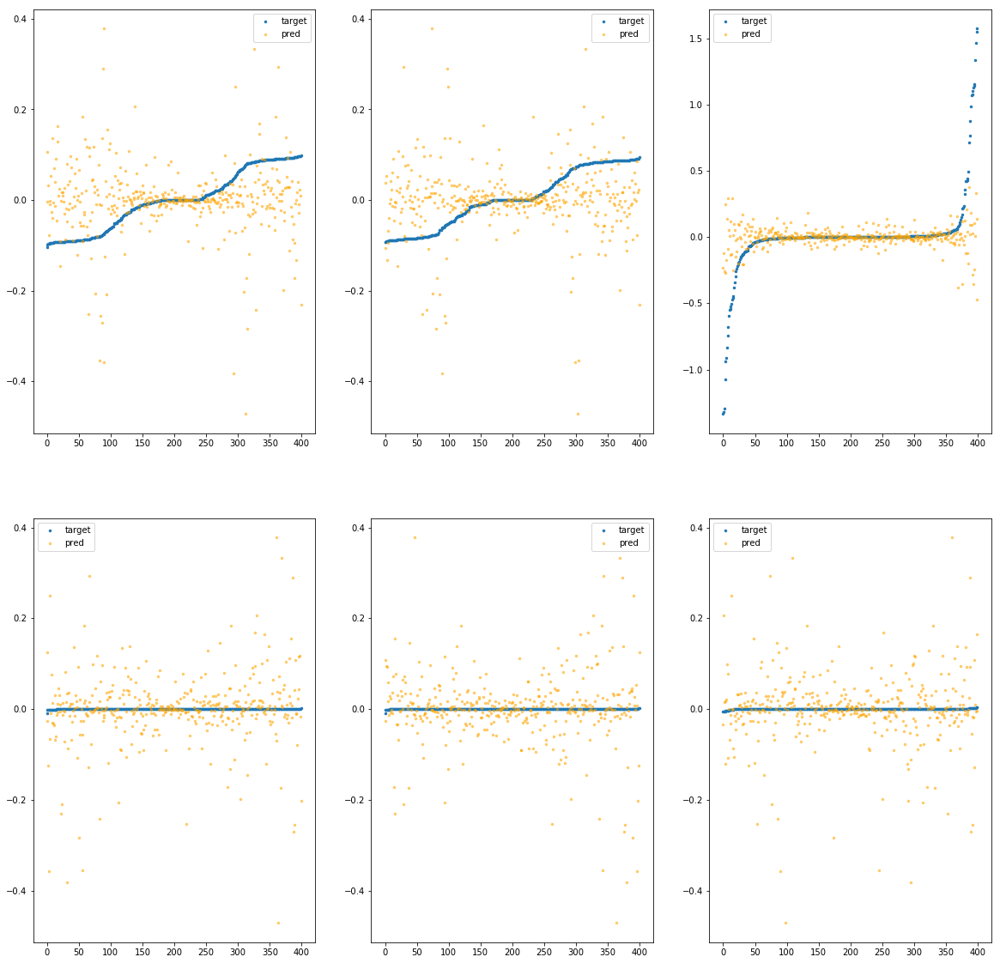

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa97e3a4f70>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.13e+00	3.63e-01	6.56e-02	1.40e+04	8.73e-03	7.62e-05
y		-1.64e+00	4.08e-01	7.22e-02	8.35e+02	1.01e-02	1.03e-04
z		1.59e-03	1.54e+00	1.16e-01	9.29e+02	8.32e-02	6.92e-03
phi		-1.43e+04	3.38e-01	3.93e-02	4.31e+06	5.17e-03	2.67e-05
theta		-1.67e+04	3.37e-01	3.93e-02	1.02e+06	5.17e-03	2.67e-05
psi		-6.91e+03	3.37e-01	3.94e-02	3.81e+06	5.18e-03	2.69e-05


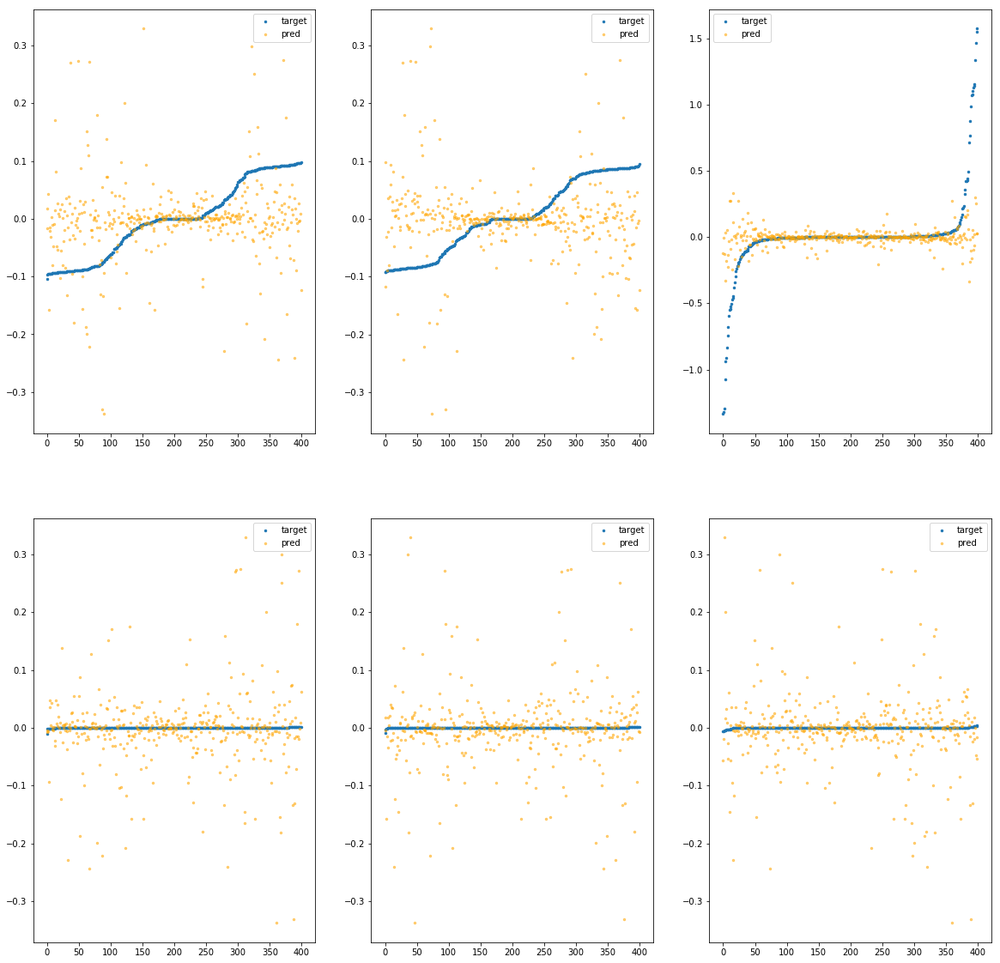

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa97e3a4fd0>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.31e+00	5.96e-01	7.85e-02	1.57e+04	1.35e-02	1.83e-04
y		-2.71e+00	5.81e-01	7.75e-02	1.21e+03	1.42e-02	2.02e-04
z		-1.06e-01	1.94e+00	1.23e-01	8.22e+02	9.21e-02	8.48e-03
phi		-2.75e+04	5.48e-01	5.34e-02	4.65e+06	9.96e-03	9.93e-05
theta		-3.22e+04	5.47e-01	5.34e-02	1.22e+06	9.96e-03	9.92e-05
psi		-1.33e+04	5.42e-01	5.34e-02	4.59e+06	9.95e-03	9.90e-05


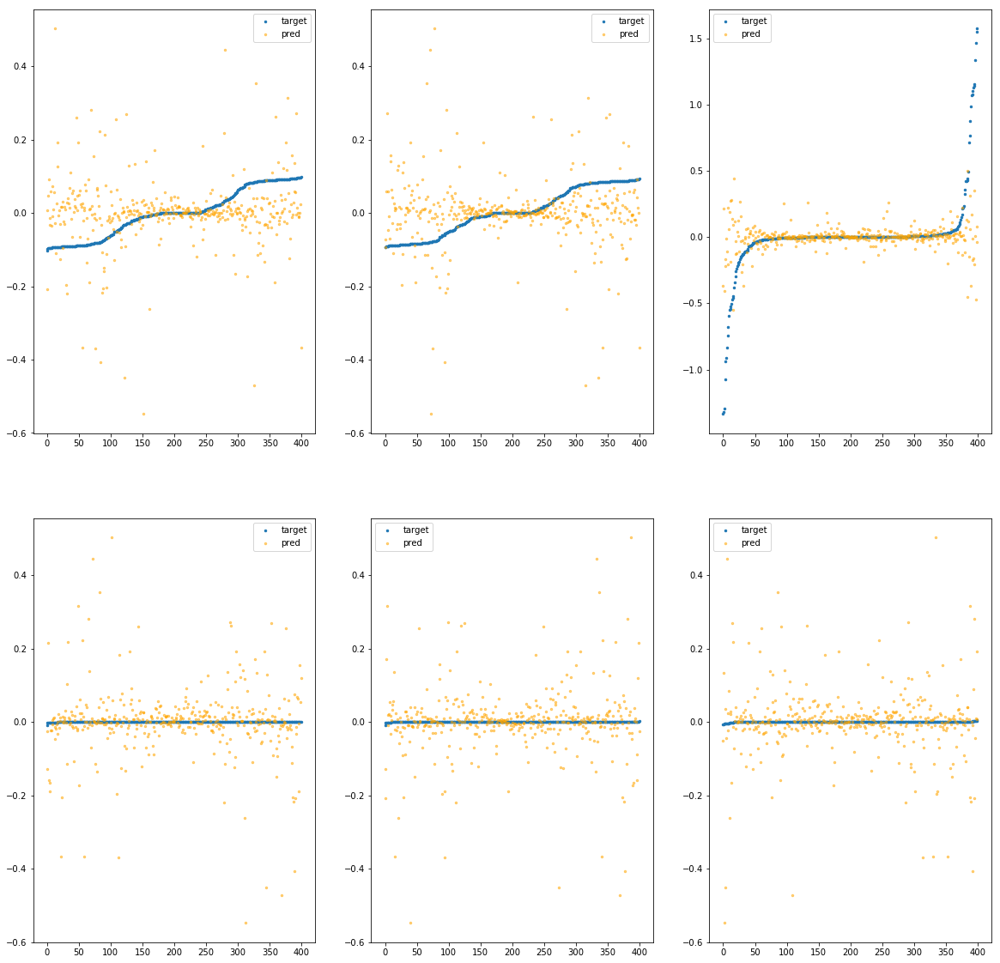

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa97e3af070>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.74e+00	6.81e-01	7.22e-02	1.55e+04	1.12e-02	1.26e-04
y		-2.09e+00	6.77e-01	7.38e-02	8.90e+02	1.18e-02	1.40e-04
z		-1.03e-01	2.06e+00	1.20e-01	9.60e+02	9.19e-02	8.44e-03
phi		-2.18e+04	5.98e-01	4.83e-02	4.12e+06	7.90e-03	6.24e-05
theta		-2.56e+04	5.98e-01	4.83e-02	1.17e+06	7.91e-03	6.25e-05
psi		-1.05e+04	5.98e-01	4.83e-02	2.20e+06	7.89e-03	6.23e-05


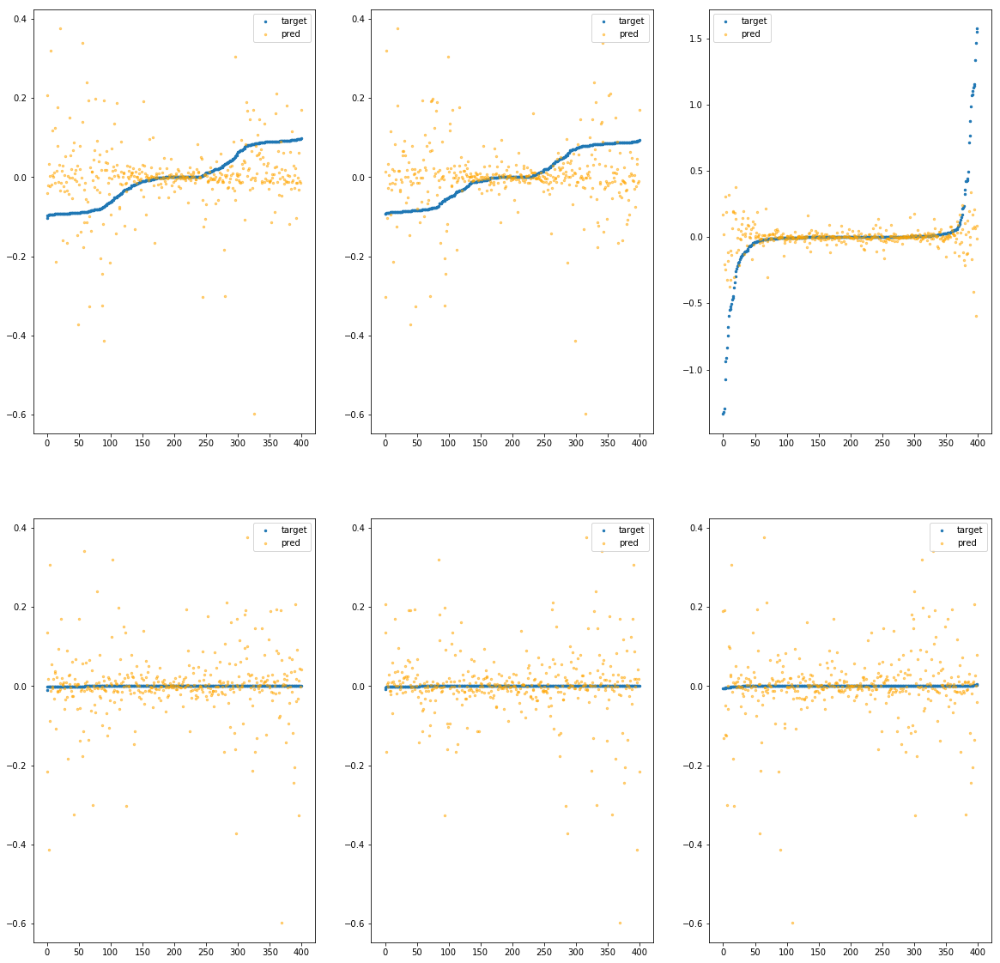

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa97e3af0d0>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.10e+00	6.11e-01	7.60e-02	2.88e+04	1.27e-02	1.61e-04
y		-2.38e+00	6.41e-01	7.67e-02	2.28e+03	1.30e-02	1.68e-04
z		6.60e-02	1.52e+00	1.17e-01	1.34e+03	7.78e-02	6.06e-03
phi		-2.42e+04	6.95e-01	4.91e-02	5.95e+06	8.76e-03	7.67e-05
theta		-2.83e+04	6.96e-01	4.91e-02	1.51e+06	8.75e-03	7.66e-05
psi		-1.17e+04	6.98e-01	4.91e-02	3.04e+06	8.75e-03	7.65e-05


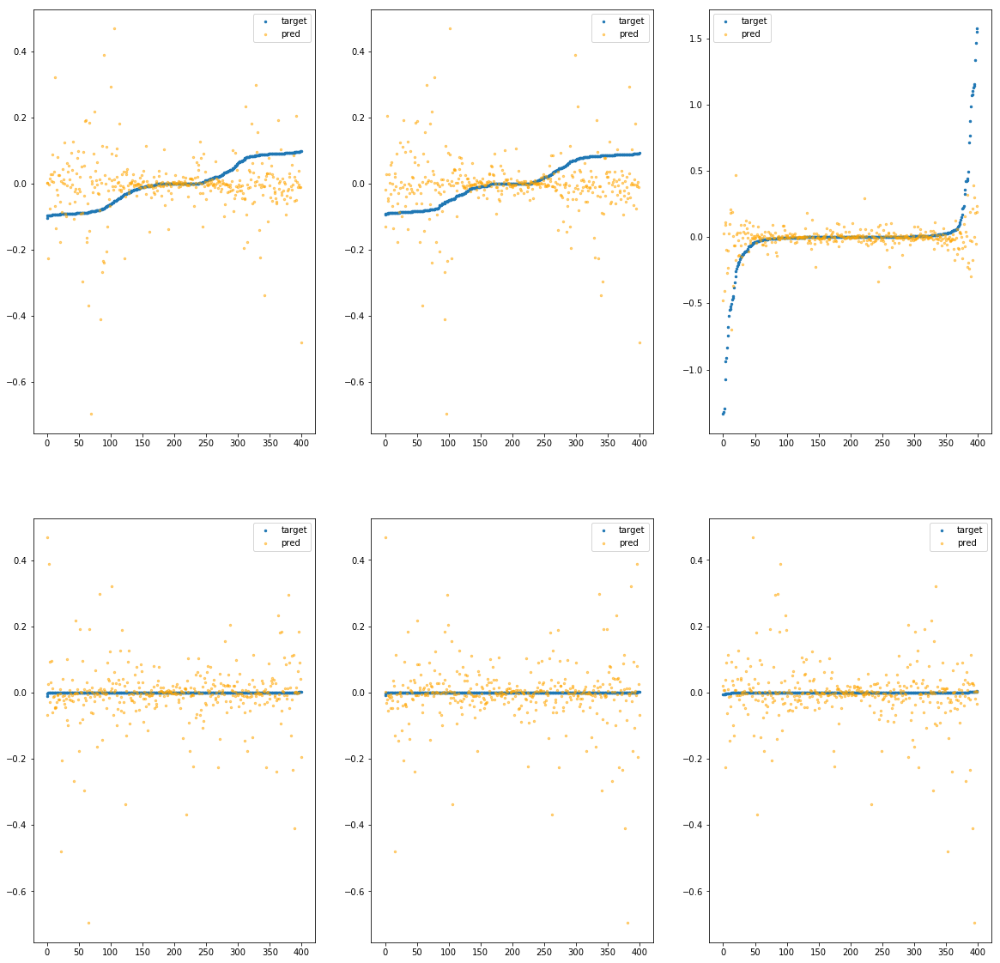

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa97e3af130>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.20e+00	9.21e-01	8.45e-02	2.68e+04	1.72e-02	2.96e-04
y		-3.51e+00	9.17e-01	8.23e-02	1.02e+03	1.73e-02	2.99e-04
z		-3.40e-01	2.30e+00	1.34e-01	1.54e+03	1.12e-01	1.25e-02
phi		-3.78e+04	8.38e-01	6.14e-02	7.55e+06	1.37e-02	1.87e-04
theta		-4.43e+04	8.38e-01	6.15e-02	1.37e+06	1.37e-02	1.87e-04
psi		-1.82e+04	8.37e-01	6.14e-02	2.82e+06	1.37e-02	1.86e-04


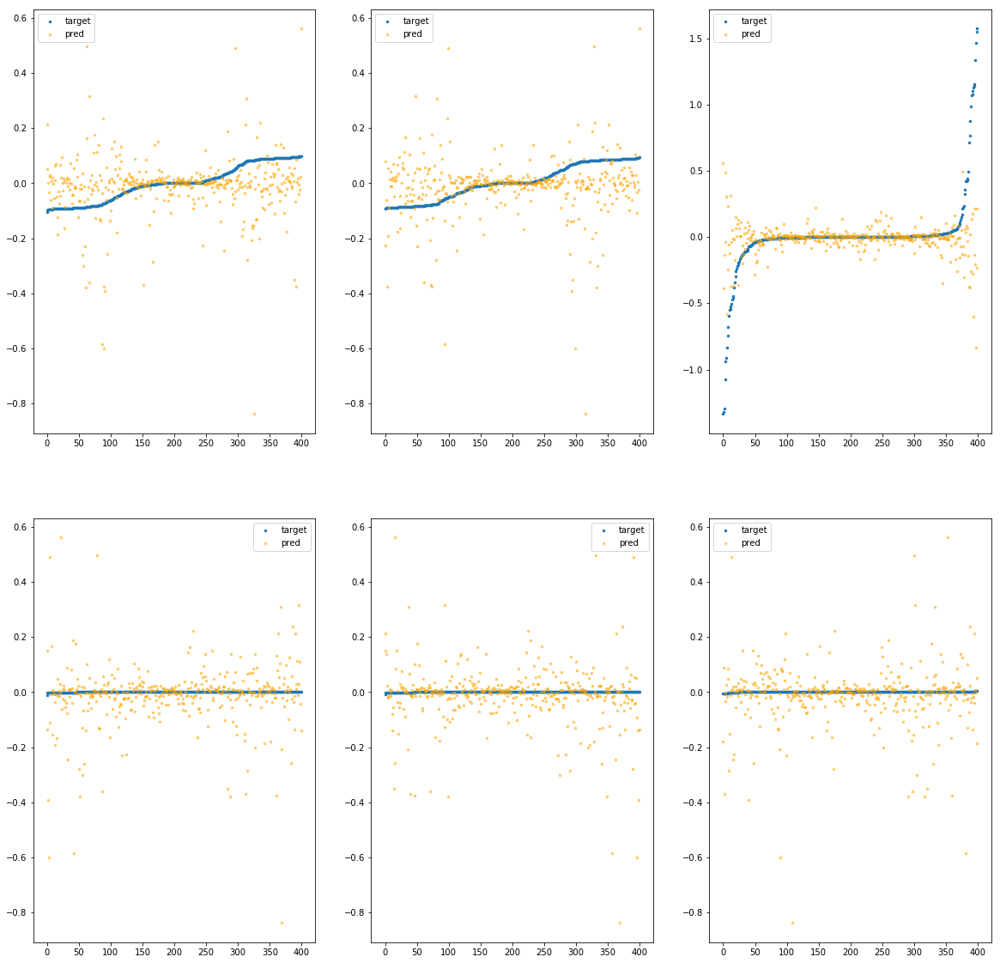

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa97e3af190>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.13e-01	1.82e-01	5.40e-02	5.89e+03	4.56e-03	2.07e-05
y		-1.58e-01	2.05e-01	5.31e-02	3.54e+02	4.44e-03	1.97e-05
z		-1.26e-02	1.61e+00	1.07e-01	3.24e+02	8.44e-02	7.12e-03
phi		-1.21e+03	1.30e-01	1.24e-02	1.41e+06	4.38e-04	1.92e-07
theta		-1.42e+03	1.31e-01	1.24e-02	3.13e+05	4.39e-04	1.93e-07
psi		-5.84e+02	1.30e-01	1.24e-02	8.22e+05	4.39e-04	1.93e-07


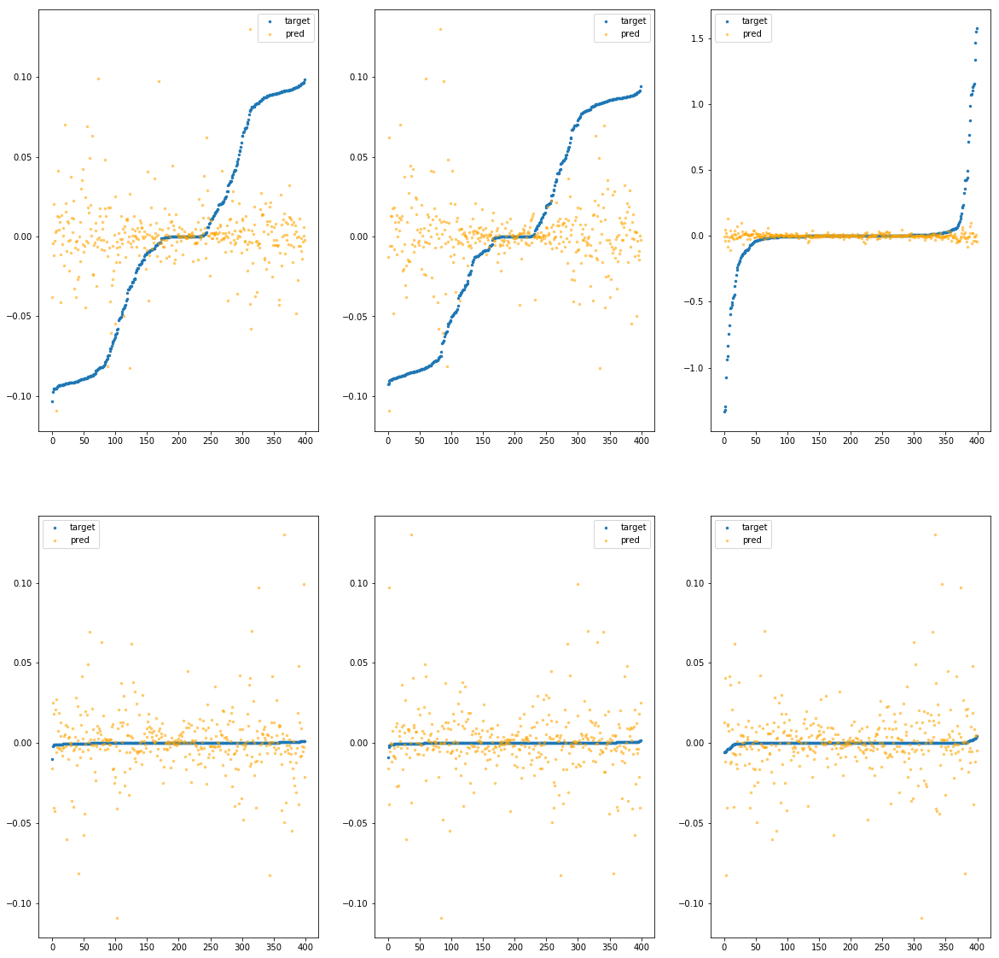

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa97e3af1f0>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.87e-01	3.66e-01	6.02e-02	1.80e+04	6.91e-03	4.77e-05
y		-6.43e-01	3.61e-01	5.96e-02	9.24e+02	6.30e-03	3.97e-05
z		4.33e-02	1.59e+00	1.07e-01	7.48e+02	7.97e-02	6.35e-03
phi		-6.73e+03	2.87e-01	2.70e-02	3.37e+06	2.44e-03	5.94e-06
theta		-7.91e+03	2.87e-01	2.71e-02	1.24e+06	2.44e-03	5.97e-06
psi		-3.23e+03	2.86e-01	2.70e-02	1.52e+06	2.43e-03	5.88e-06


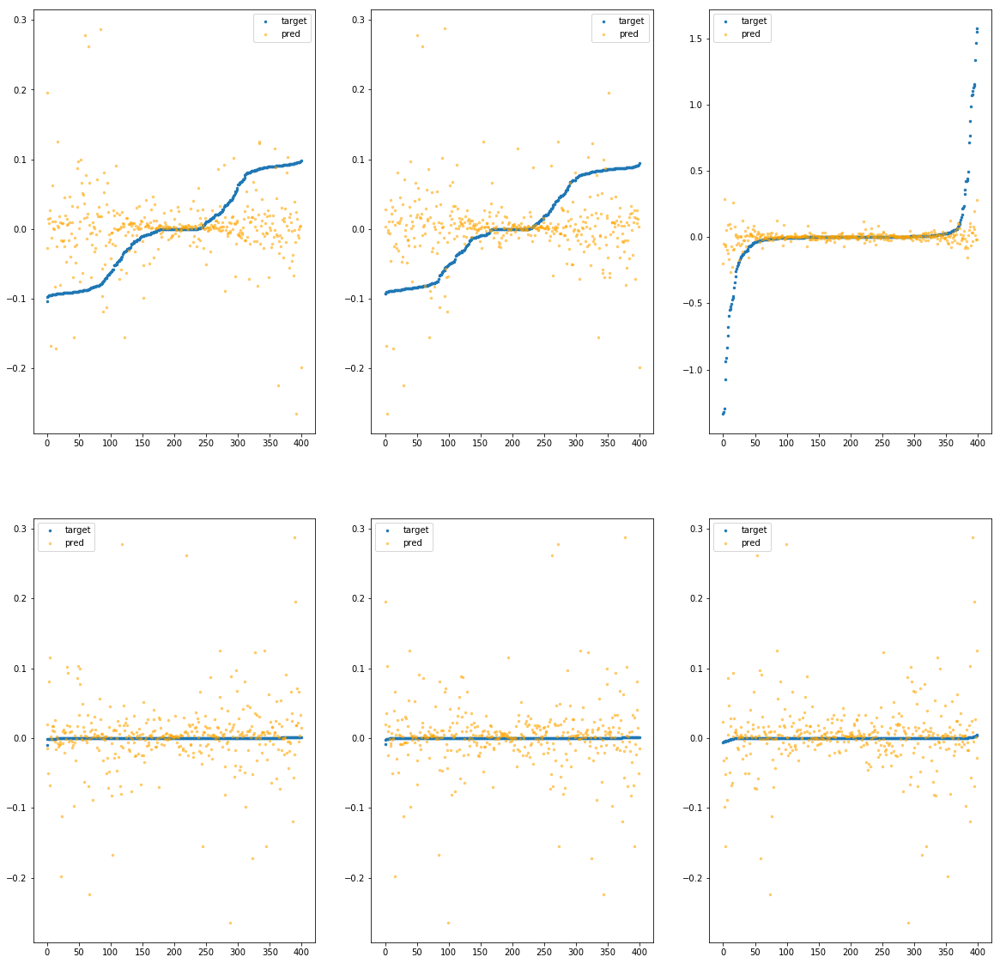

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa97e3af250>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.23e-01	4.22e-01	6.41e-02	1.30e+04	7.87e-03	6.20e-05
y		-1.01e+00	4.09e-01	6.44e-02	5.85e+02	7.71e-03	5.95e-05
z		-1.02e-01	1.71e+00	1.17e-01	7.62e+02	9.18e-02	8.43e-03
phi		-8.73e+03	3.29e-01	3.10e-02	2.37e+06	3.16e-03	9.99e-06
theta		-1.02e+04	3.28e-01	3.10e-02	9.19e+05	3.16e-03	9.97e-06
psi		-4.23e+03	3.31e-01	3.11e-02	2.29e+06	3.17e-03	1.01e-05


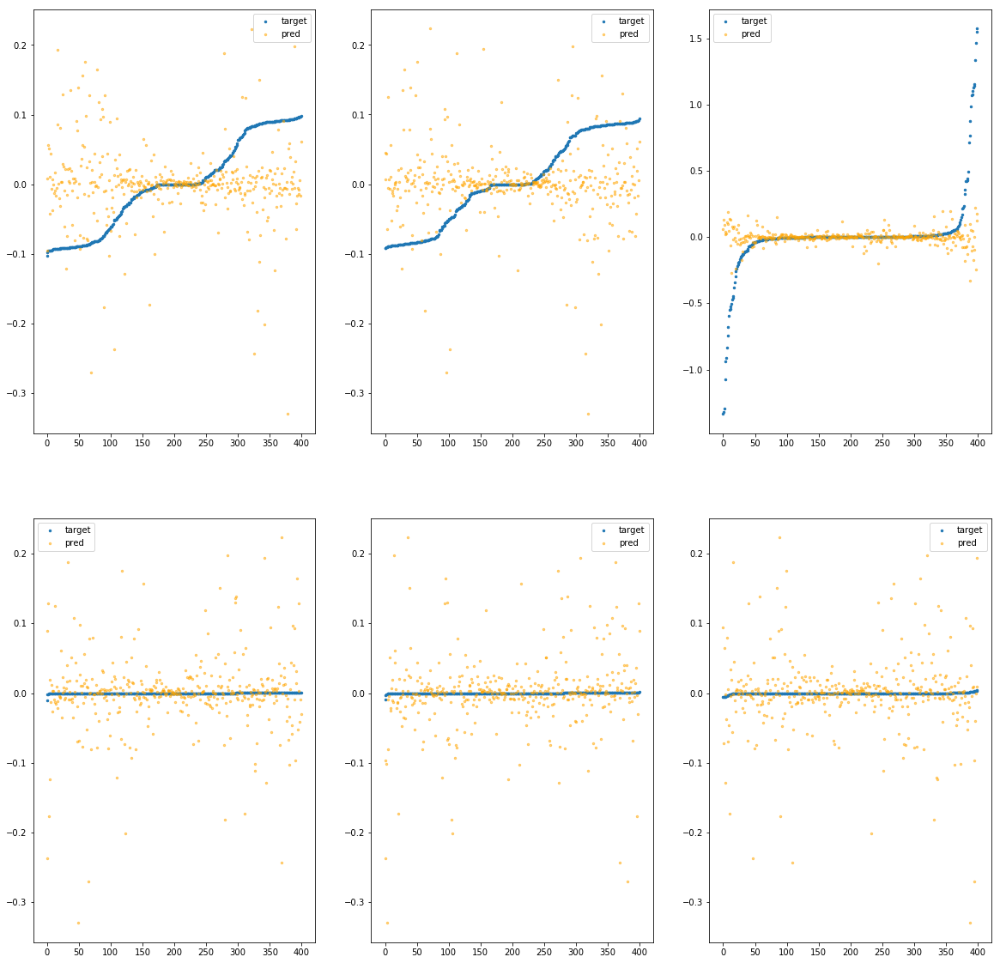

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa97e3af2b0>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.62e+00	5.62e-01	7.16e-02	2.13e+04	1.07e-02	1.15e-04
y		-1.73e+00	5.39e-01	6.88e-02	9.26e+02	1.05e-02	1.09e-04
z		-5.06e-02	1.61e+00	1.16e-01	8.52e+02	8.75e-02	7.66e-03
phi		-1.97e+04	4.84e-01	4.68e-02	5.36e+06	7.15e-03	5.11e-05
theta		-2.31e+04	4.84e-01	4.68e-02	9.25e+05	7.15e-03	5.11e-05
psi		-9.56e+03	4.83e-01	4.69e-02	2.88e+06	7.17e-03	5.14e-05


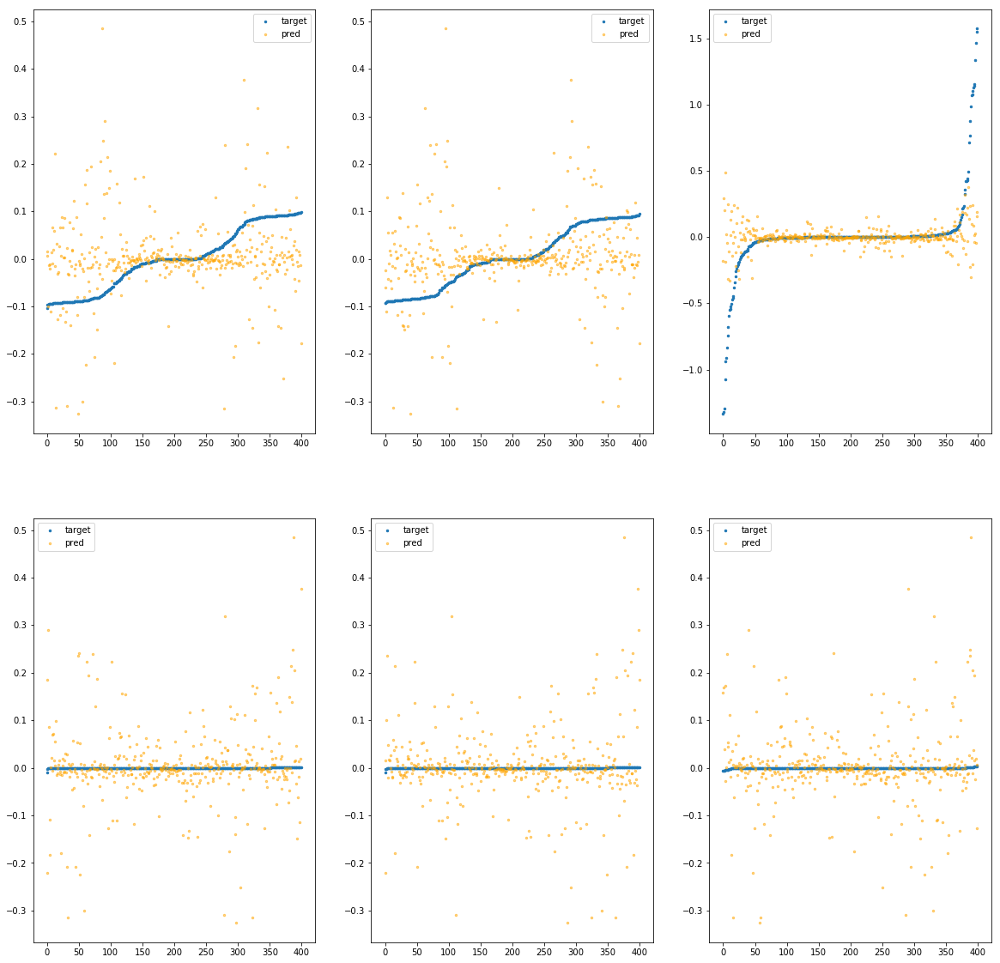

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa97e3af310>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.43e+00	7.37e-01	7.98e-02	2.67e+04	1.40e-02	1.97e-04
y		-3.31e+00	7.92e-01	8.38e-02	1.87e+03	1.65e-02	2.74e-04
z		-2.71e-01	2.07e+00	1.31e-01	1.07e+03	1.06e-01	1.12e-02
phi		-2.97e+04	7.21e-01	5.58e-02	8.35e+06	1.08e-02	1.16e-04
theta		-3.49e+04	7.23e-01	5.58e-02	1.69e+06	1.08e-02	1.16e-04
psi		-1.43e+04	7.22e-01	5.57e-02	4.40e+06	1.07e-02	1.15e-04


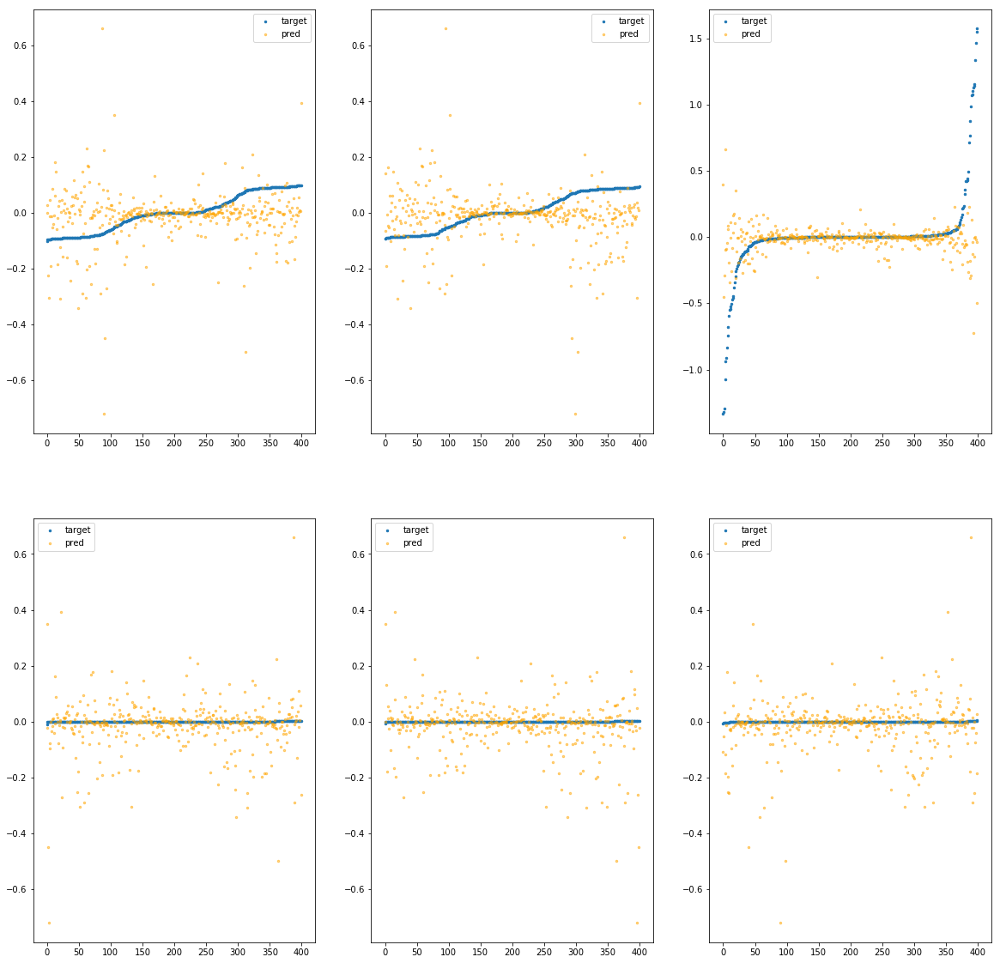

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa97e3af370>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.47e-02	1.67e-01	5.23e-02	1.31e+04	4.28e-03	1.83e-05
y		-8.44e-02	1.50e-01	5.26e-02	1.02e+03	4.16e-03	1.73e-05
z		-8.02e-03	1.59e+00	1.04e-01	4.38e+02	8.40e-02	7.05e-03
phi		-5.80e+02	1.05e-01	8.56e-03	2.09e+06	2.10e-04	4.43e-08
theta		-6.82e+02	1.05e-01	8.55e-03	6.55e+05	2.11e-04	4.45e-08
psi		-2.79e+02	1.02e-01	8.58e-03	1.09e+06	2.10e-04	4.42e-08


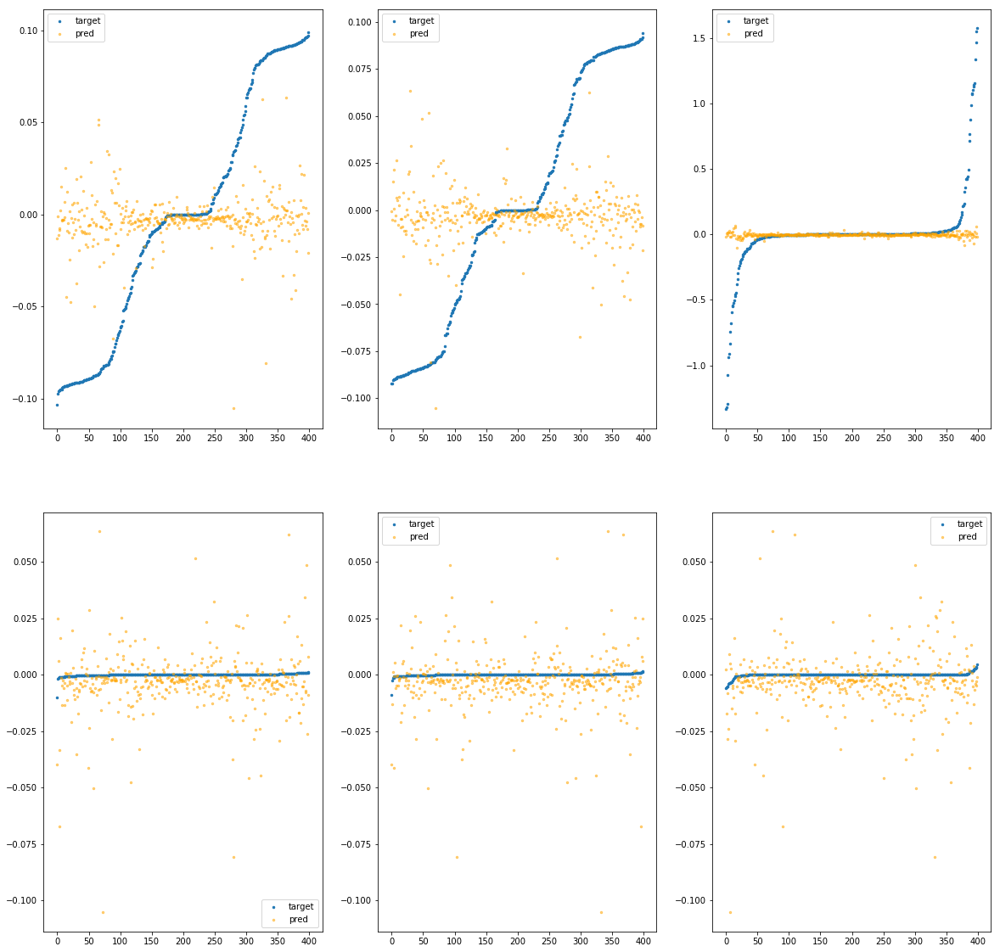

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa97e3af3d0>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.10e-02	2.13e-01	5.27e-02	3.24e+03	4.38e-03	1.92e-05
y		-1.55e-01	1.98e-01	5.36e-02	1.59e+02	4.43e-03	1.96e-05
z		-1.00e-02	1.57e+00	1.04e-01	1.97e+02	8.42e-02	7.08e-03
phi		-1.12e+03	1.35e-01	9.47e-03	4.39e+05	4.07e-04	1.66e-07
theta		-1.31e+03	1.35e-01	9.47e-03	1.41e+05	4.06e-04	1.65e-07
psi		-5.47e+02	1.35e-01	9.56e-03	7.72e+05	4.11e-04	1.69e-07


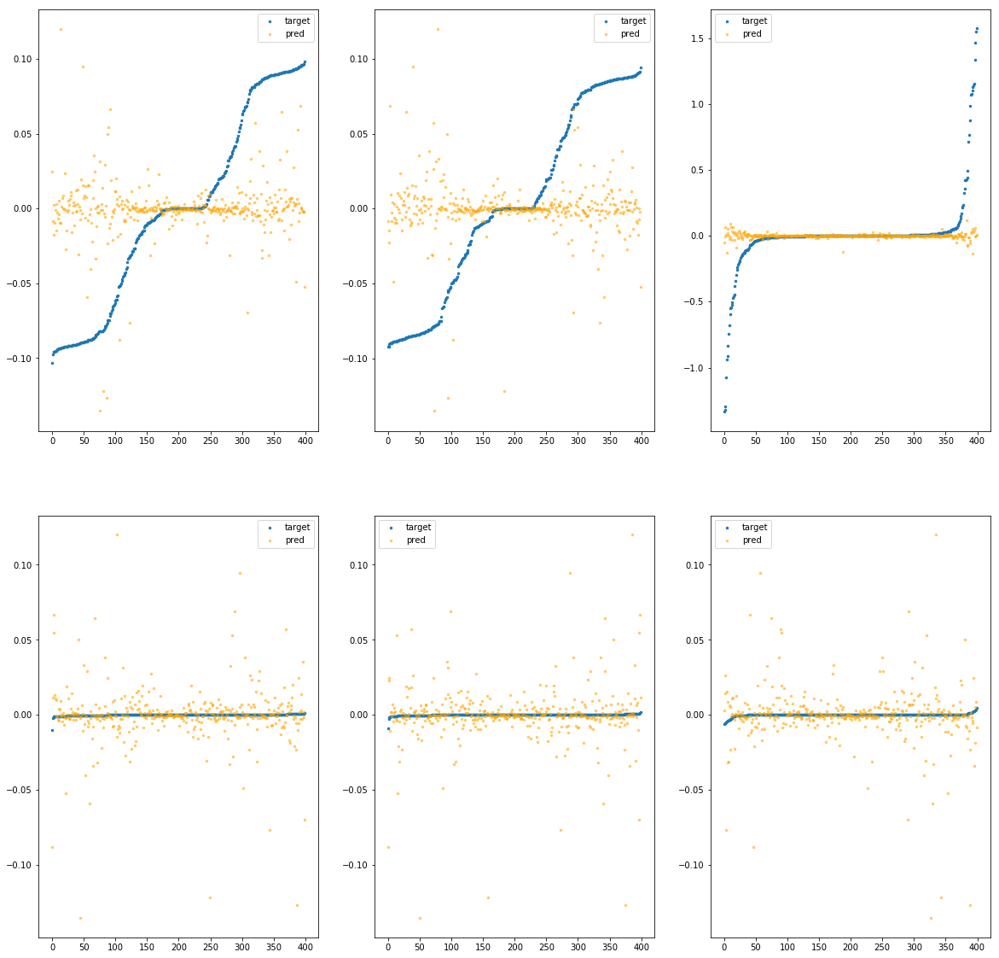

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa97e3af430>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.32e-01	2.09e-01	5.31e-02	1.05e+04	4.63e-03	2.15e-05
y		-2.64e-01	2.05e-01	5.48e-02	4.54e+02	4.84e-03	2.35e-05
z		4.07e-02	1.53e+00	1.04e-01	3.42e+02	7.99e-02	6.39e-03
phi		-2.23e+03	1.45e-01	1.61e-02	2.02e+06	8.09e-04	6.54e-07
theta		-2.62e+03	1.43e-01	1.62e-02	2.95e+05	8.09e-04	6.55e-07
psi		-1.07e+03	1.45e-01	1.61e-02	1.03e+06	8.03e-04	6.44e-07


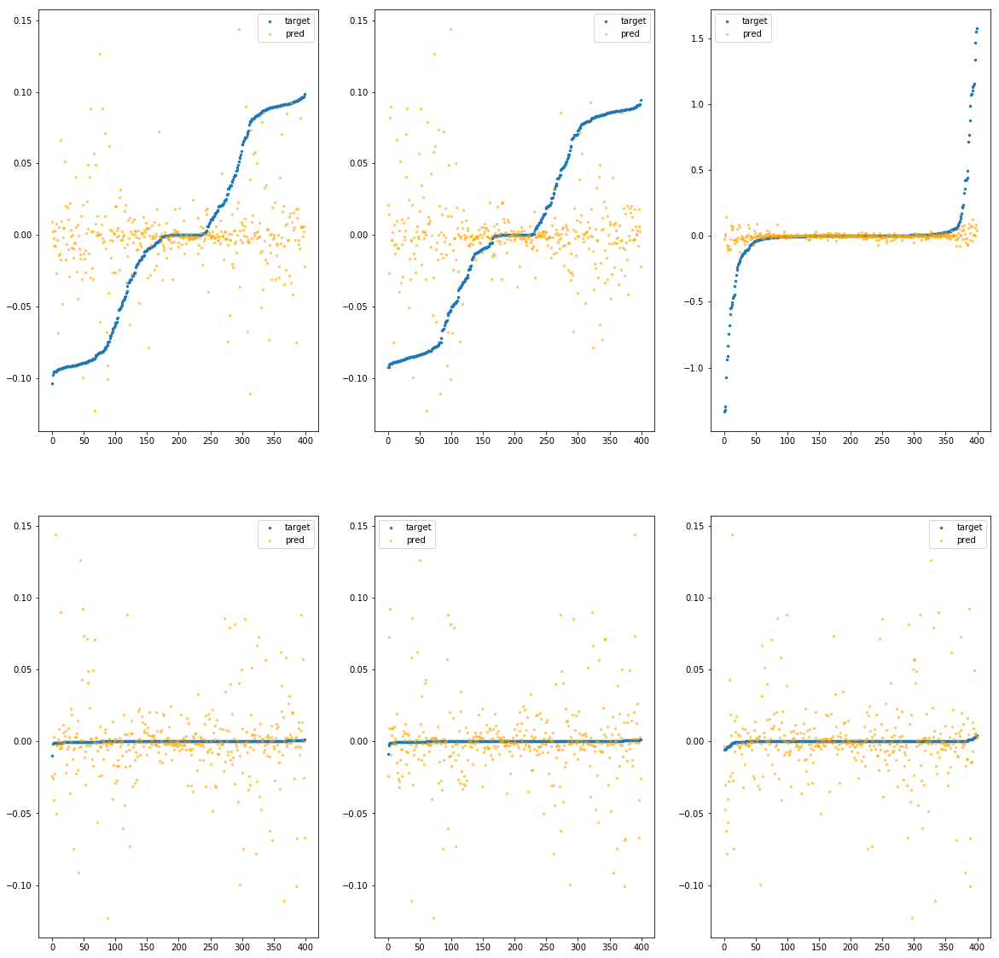

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa97e3af490>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.27e+00	4.47e-01	6.66e-02	1.06e+04	9.28e-03	8.61e-05
y		-1.42e+00	4.31e-01	6.73e-02	8.15e+02	9.30e-03	8.64e-05
z		-5.77e-02	1.72e+00	1.16e-01	5.81e+02	8.81e-02	7.77e-03
phi		-1.30e+04	3.53e-01	3.75e-02	3.14e+06	4.72e-03	2.23e-05
theta		-1.53e+04	3.52e-01	3.75e-02	8.29e+05	4.72e-03	2.22e-05
psi		-6.27e+03	3.53e-01	3.74e-02	2.79e+06	4.70e-03	2.21e-05


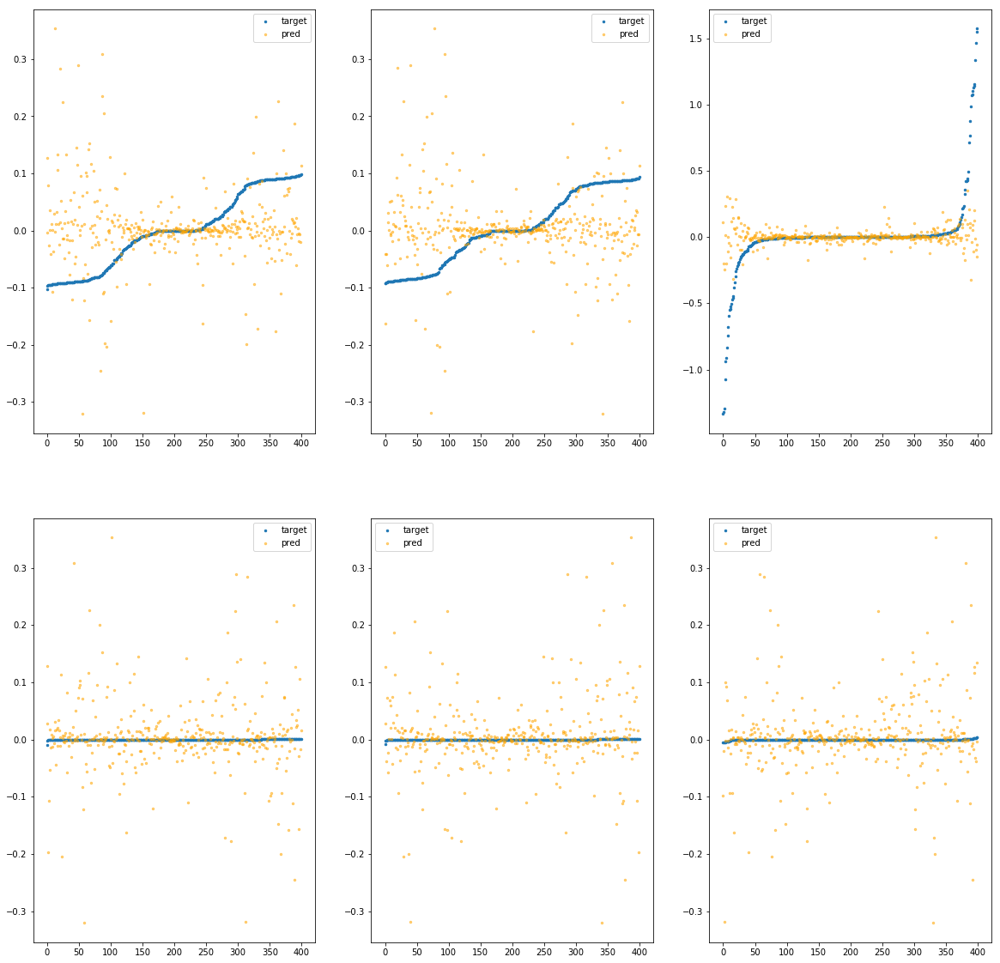

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa97e3af4f0>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.06e-01	3.90e-01	6.04e-02	1.14e+04	6.98e-03	4.88e-05
y		-7.26e-01	3.86e-01	5.94e-02	6.59e+02	6.62e-03	4.38e-05
z		5.61e-02	1.50e+00	1.08e-01	4.54e+02	7.86e-02	6.18e-03
phi		-7.98e+03	3.01e-01	2.87e-02	2.86e+06	2.89e-03	8.35e-06
theta		-9.39e+03	3.01e-01	2.87e-02	5.57e+05	2.90e-03	8.41e-06
psi		-3.86e+03	3.01e-01	2.88e-02	1.81e+06	2.90e-03	8.40e-06


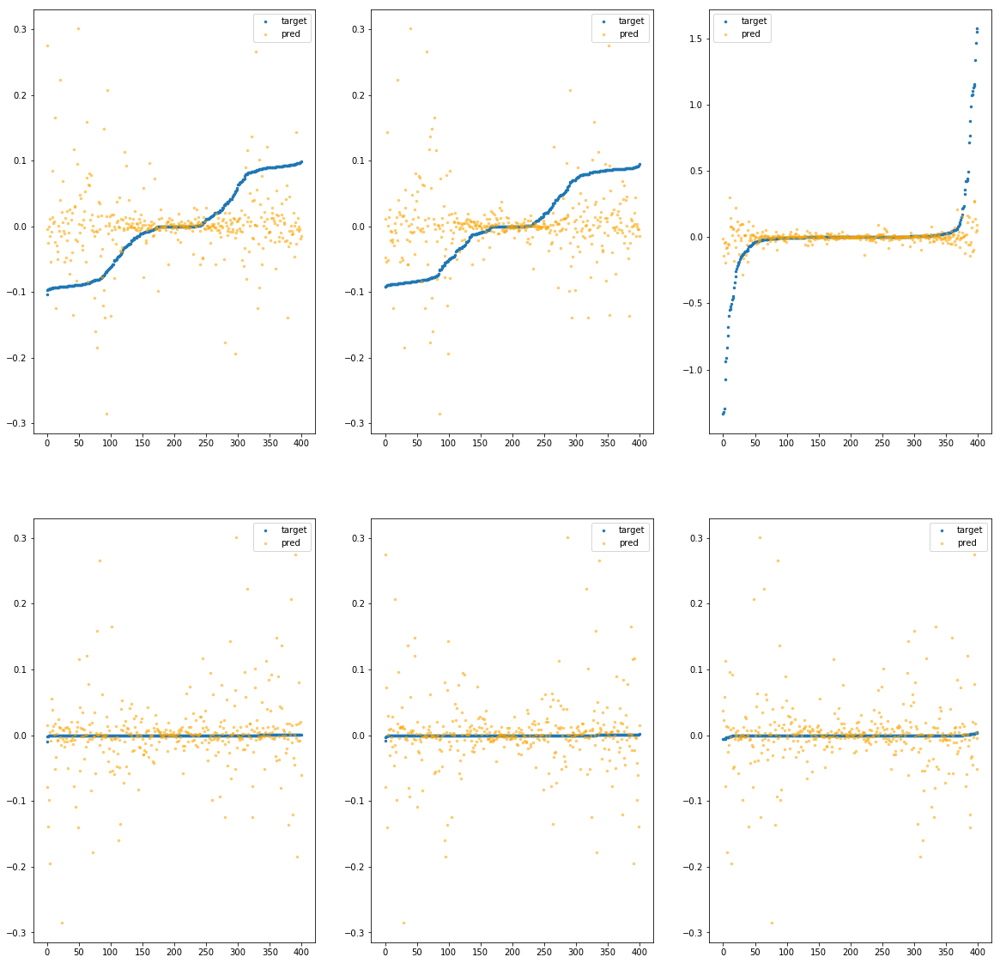

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa97e3af550>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.81e-02	1.33e-01	5.19e-02	3.01e+03	4.17e-03	1.74e-05
y		-4.87e-02	1.21e-01	5.23e-02	2.19e+02	4.02e-03	1.62e-05
z		-8.51e-03	1.59e+00	1.03e-01	1.28e+02	8.40e-02	7.06e-03
phi		-1.42e+02	5.35e-02	3.87e-03	4.99e+05	5.18e-05	2.68e-09
theta		-1.68e+02	5.38e-02	3.88e-03	1.30e+05	5.21e-05	2.71e-09
psi		-6.74e+01	5.27e-02	3.88e-03	2.00e+05	5.13e-05	2.63e-09


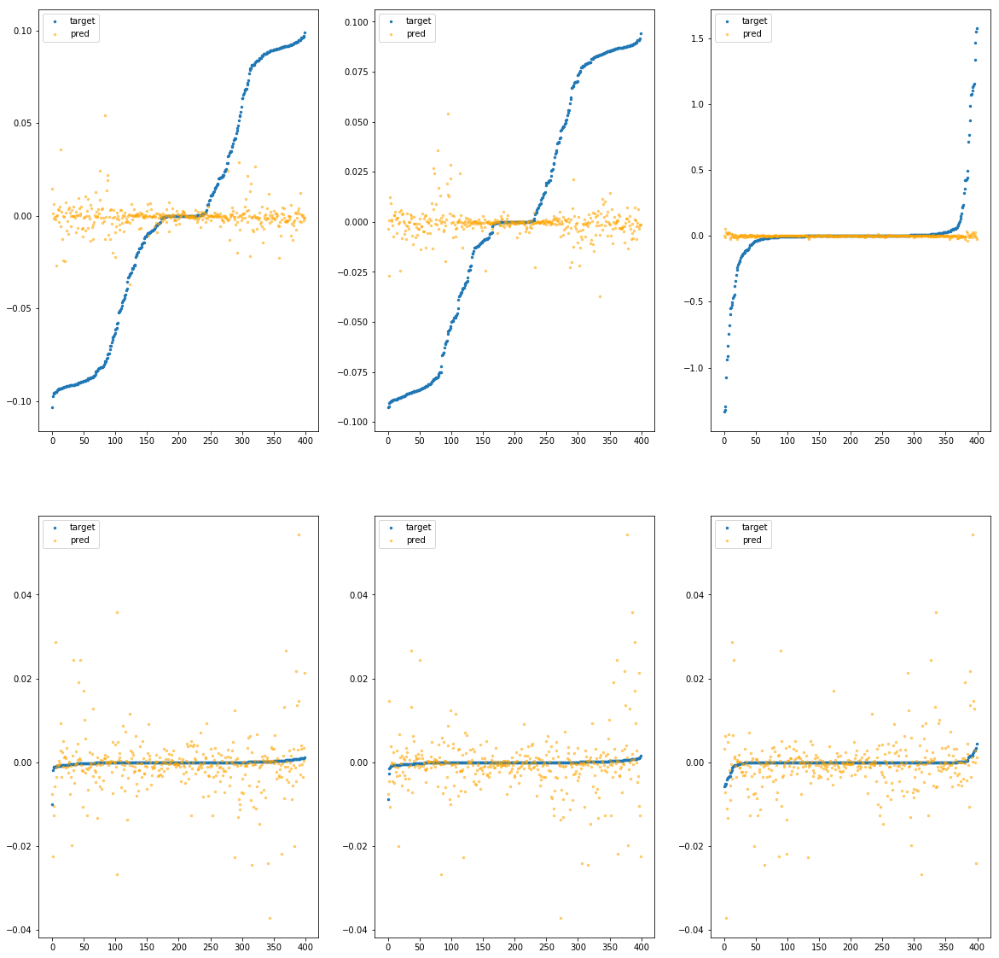

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa97e3af5b0>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.35e-02	1.43e-01	5.23e-02	4.65e+03	4.19e-03	1.76e-05
y		-1.47e-02	1.38e-01	5.13e-02	4.31e+02	3.89e-03	1.51e-05
z		1.08e-02	1.58e+00	1.03e-01	2.22e+02	8.24e-02	6.79e-03
phi		-4.68e+02	1.72e-01	6.04e-03	1.11e+06	1.70e-04	2.89e-08
theta		-5.48e+02	1.72e-01	6.04e-03	3.90e+05	1.70e-04	2.87e-08
psi		-2.27e+02	1.73e-01	6.00e-03	4.59e+05	1.71e-04	2.94e-08


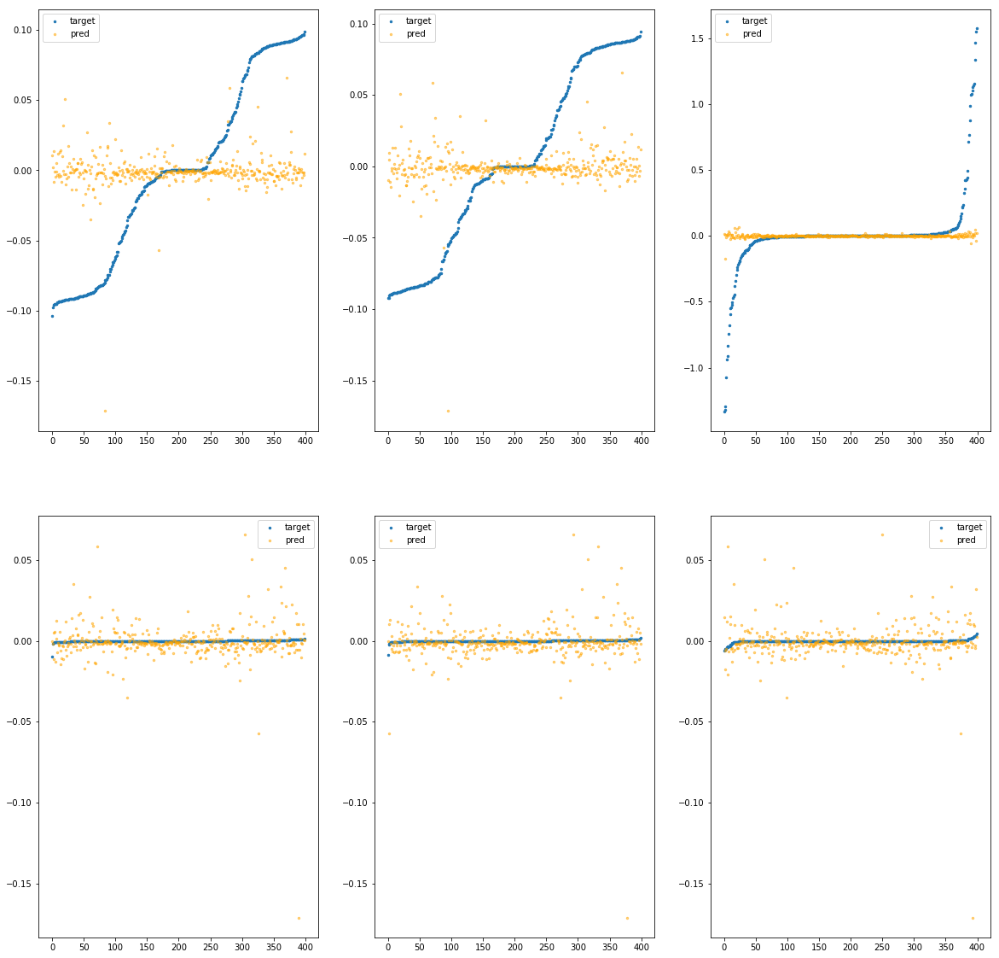

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa97e3af610>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.03e-01	1.74e-01	5.40e-02	7.16e+03	4.52e-03	2.04e-05
y		-6.36e-02	1.70e-01	5.23e-02	3.93e+02	4.08e-03	1.66e-05
z		-1.11e-02	1.60e+00	1.04e-01	2.51e+02	8.42e-02	7.10e-03
phi		-5.24e+02	8.47e-02	7.84e-03	1.28e+06	1.90e-04	3.61e-08
theta		-6.12e+02	8.47e-02	7.89e-03	4.28e+05	1.89e-04	3.59e-08
psi		-2.52e+02	8.48e-02	7.84e-03	5.44e+05	1.90e-04	3.61e-08


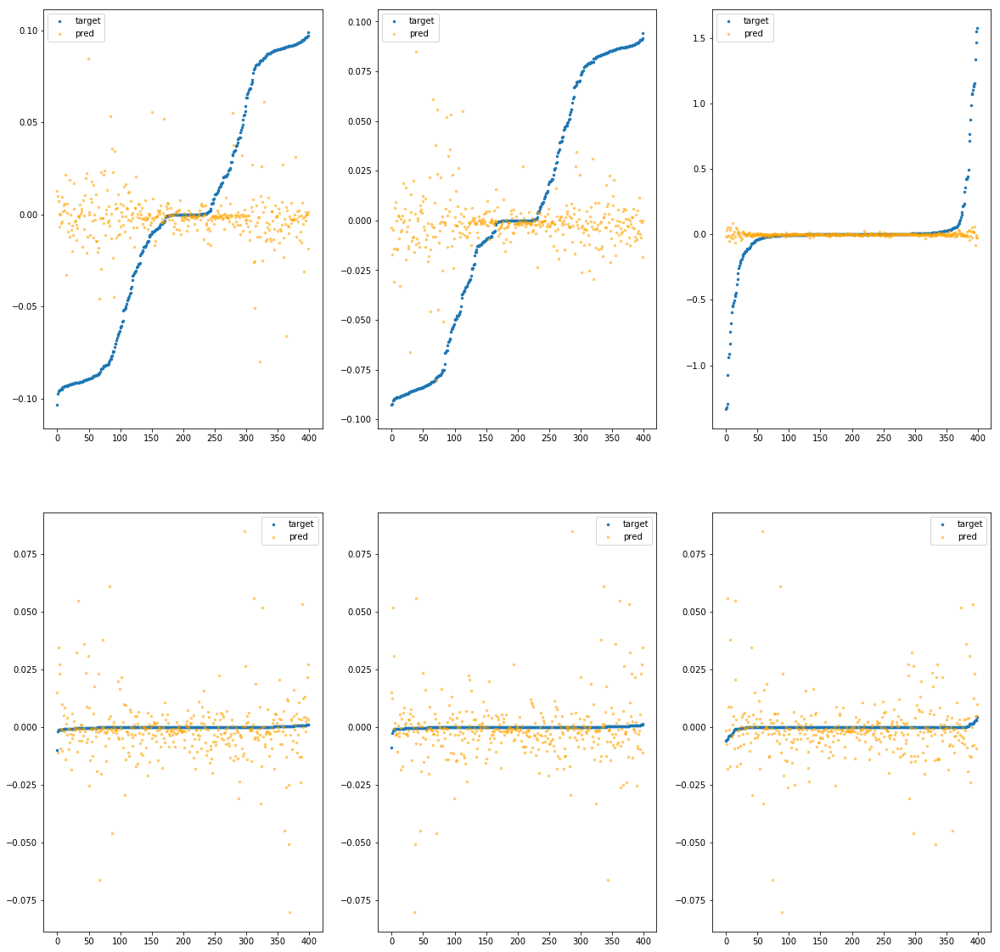

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa97e3af670>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.63e-01	2.15e-01	5.39e-02	8.94e+03	4.76e-03	2.27e-05
y		-3.48e-01	3.12e-01	5.59e-02	3.40e+02	5.17e-03	2.67e-05
z		-1.96e-02	1.54e+00	1.06e-01	3.83e+02	8.50e-02	7.22e-03
phi		-3.05e+03	2.94e-01	1.76e-02	2.22e+06	1.10e-03	1.22e-06
theta		-3.58e+03	2.94e-01	1.76e-02	3.55e+05	1.10e-03	1.22e-06
psi		-1.48e+03	2.95e-01	1.77e-02	1.20e+06	1.11e-03	1.24e-06


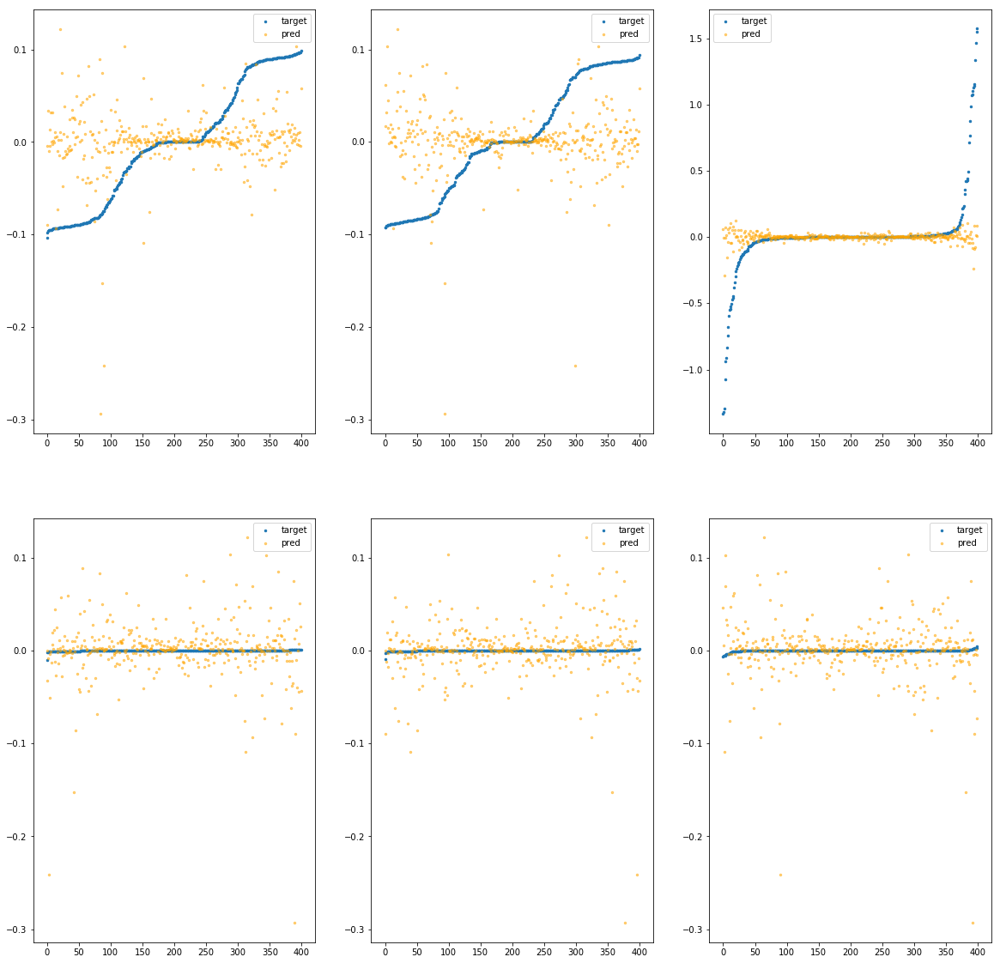

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa97e3af6d0>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.07e+00	4.26e-01	6.64e-02	1.47e+04	8.48e-03	7.19e-05
y		-1.13e+00	5.82e-01	6.48e-02	9.64e+02	8.16e-03	6.66e-05
z		-4.29e-02	1.73e+00	1.14e-01	8.63e+02	8.69e-02	7.55e-03
phi		-1.06e+04	5.06e-01	3.32e-02	2.40e+06	3.85e-03	1.48e-05
theta		-1.24e+04	5.05e-01	3.32e-02	8.29e+05	3.84e-03	1.47e-05
psi		-5.13e+03	5.05e-01	3.32e-02	2.50e+06	3.85e-03	1.48e-05


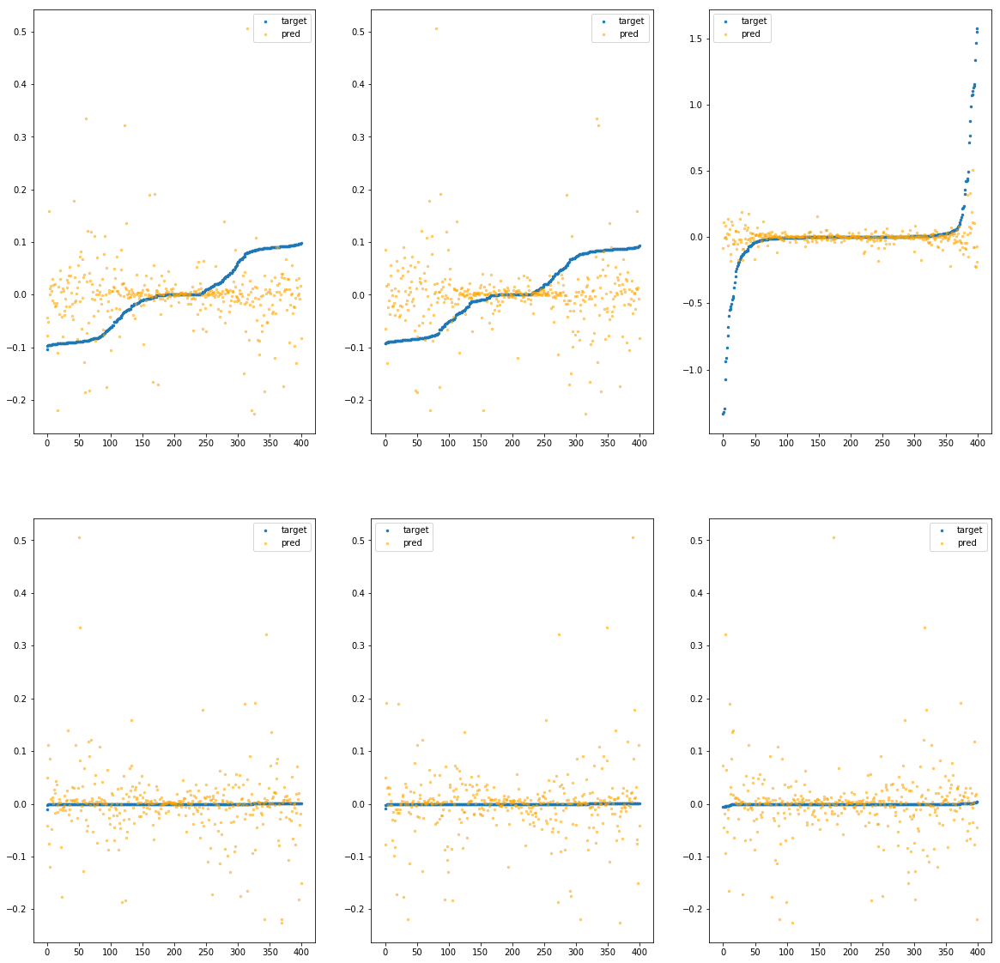

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa97e3af730>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		4.61e-04	1.25e-01	5.15e-02	9.13e+03	4.09e-03	1.67e-05
y		-4.28e-02	1.20e-01	5.22e-02	3.41e+02	4.00e-03	1.60e-05
z		-8.31e-03	1.59e+00	1.03e-01	2.17e+02	8.40e-02	7.06e-03
phi		-1.20e+02	3.18e-02	4.09e-03	1.51e+06	4.37e-05	1.91e-09
theta		-1.38e+02	3.08e-02	4.07e-03	2.51e+05	4.30e-05	1.85e-09
psi		-5.56e+01	3.16e-02	4.07e-03	3.40e+05	4.24e-05	1.80e-09


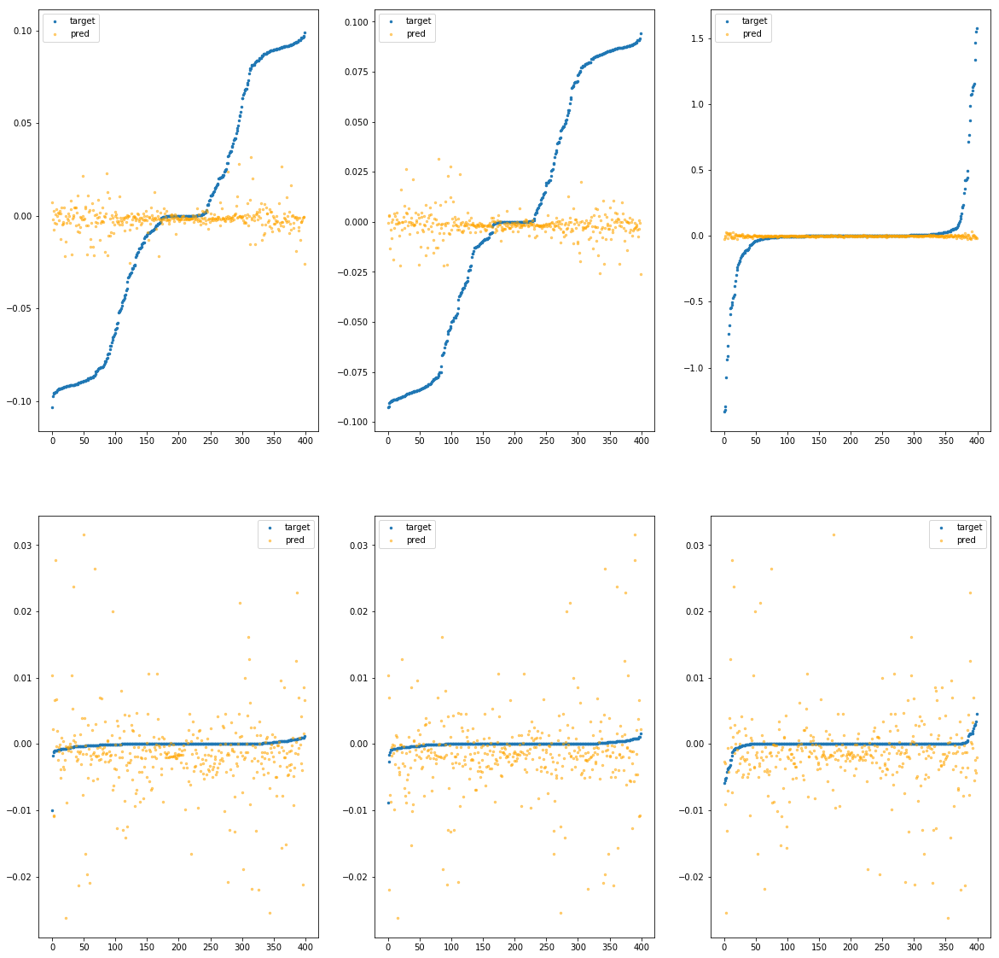

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa97e3af790>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		2.37e-02	1.28e-01	5.12e-02	2.24e+03	4.00e-03	1.60e-05
y		-1.79e-02	1.23e-01	5.14e-02	1.22e+02	3.90e-03	1.52e-05
z		-8.69e-03	1.58e+00	1.03e-01	8.43e+01	8.40e-02	7.06e-03
phi		-1.00e+02	3.29e-02	3.26e-03	4.03e+05	3.66e-05	1.34e-09
theta		-1.14e+02	3.30e-02	3.23e-03	1.29e+05	3.56e-05	1.27e-09
psi		-4.64e+01	3.30e-02	3.22e-03	1.34e+05	3.56e-05	1.26e-09


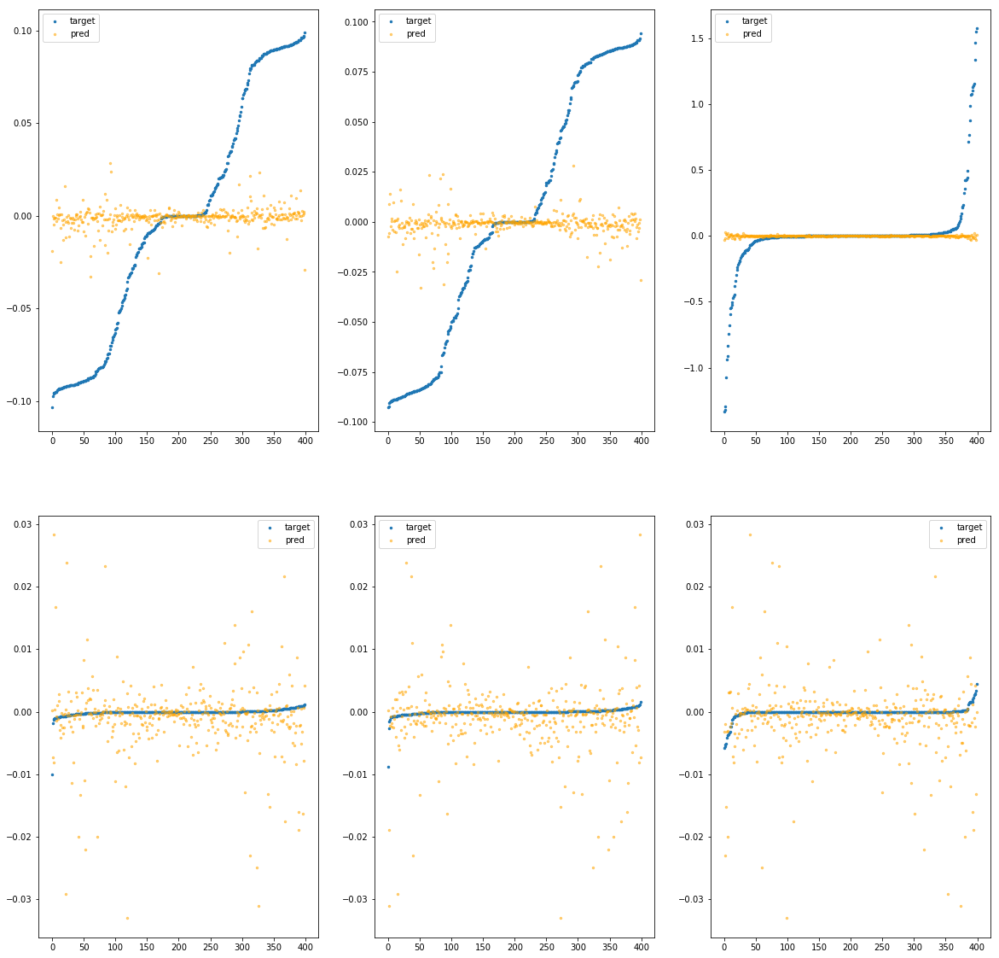

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa97e3af7f0>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.00e-02	1.62e-01	5.24e-02	3.16e+03	4.26e-03	1.81e-05
y		-4.91e-02	1.52e-01	5.21e-02	2.10e+02	4.02e-03	1.62e-05
z		-3.06e-03	1.58e+00	1.03e-01	1.43e+02	8.36e-02	6.98e-03
phi		-2.22e+02	6.99e-02	4.42e-03	9.37e+05	8.07e-05	6.51e-09
theta		-2.58e+02	6.89e-02	4.44e-03	2.65e+05	8.00e-05	6.40e-09
psi		-1.07e+02	7.16e-02	4.43e-03	2.10e+05	8.09e-05	6.54e-09


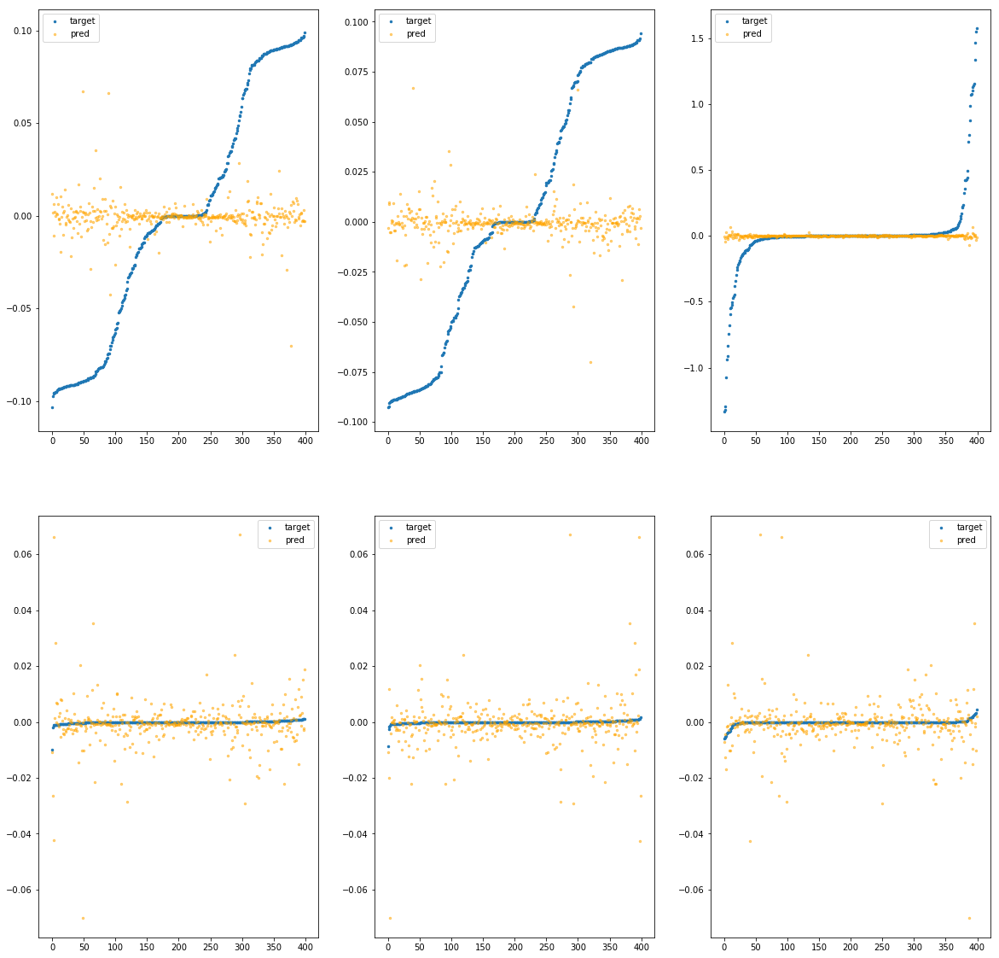

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa97e3af850>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.30e-02	1.49e-01	5.23e-02	3.76e+03	4.27e-03	1.82e-05
y		-4.94e-02	1.38e-01	5.19e-02	2.51e+02	4.02e-03	1.62e-05
z		7.15e-03	1.55e+00	1.03e-01	1.69e+02	8.27e-02	6.84e-03
phi		-5.73e+02	1.34e-01	6.91e-03	7.12e+05	2.08e-04	4.32e-08
theta		-6.73e+02	1.33e-01	6.93e-03	1.99e+05	2.08e-04	4.33e-08
psi		-2.83e+02	1.35e-01	6.99e-03	3.28e+05	2.13e-04	4.54e-08


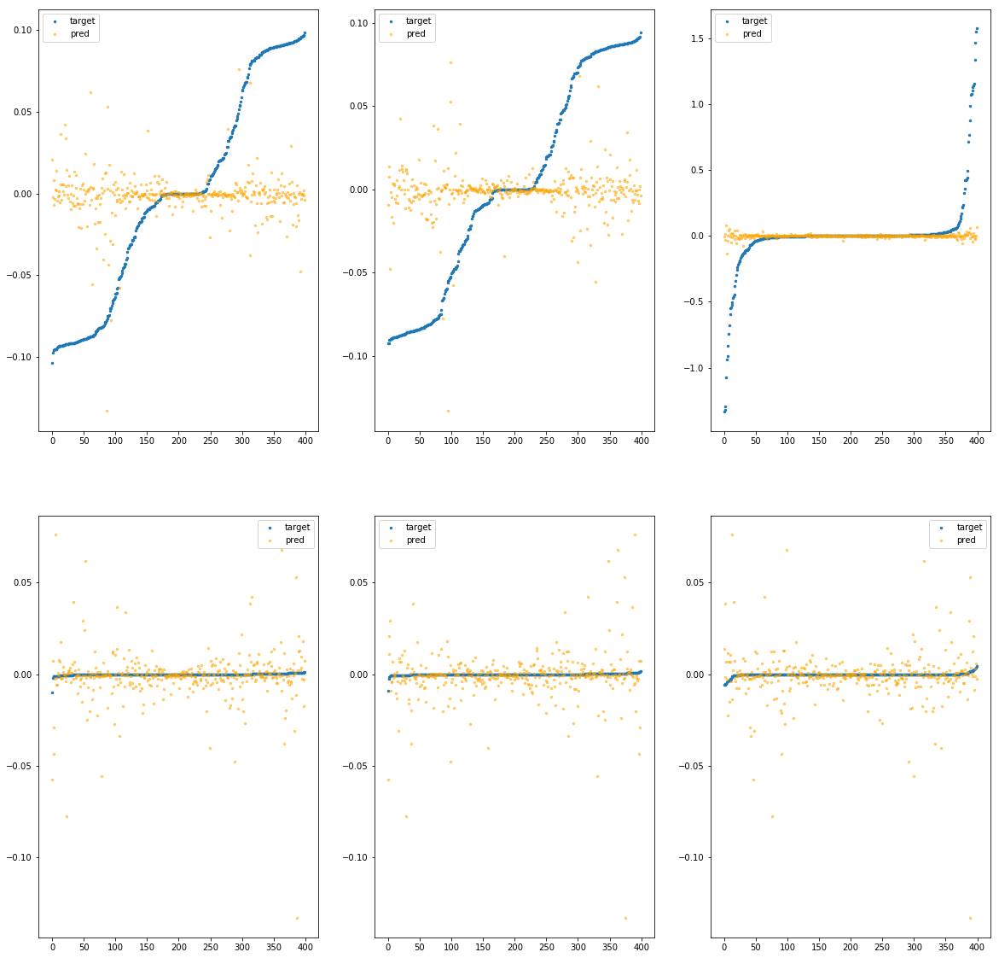

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa97e3af8b0>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.18e-01	2.45e-01	5.33e-02	2.40e+04	4.58e-03	2.10e-05
y		-1.22e-01	2.03e-01	5.20e-02	7.98e+02	4.30e-03	1.85e-05
z		1.88e-03	1.60e+00	1.04e-01	5.44e+02	8.32e-02	6.92e-03
phi		-1.61e+03	1.57e-01	1.35e-02	4.27e+06	5.82e-04	3.39e-07
theta		-1.88e+03	1.57e-01	1.34e-02	7.96e+05	5.80e-04	3.37e-07
psi		-7.72e+02	1.57e-01	1.34e-02	1.09e+06	5.80e-04	3.36e-07


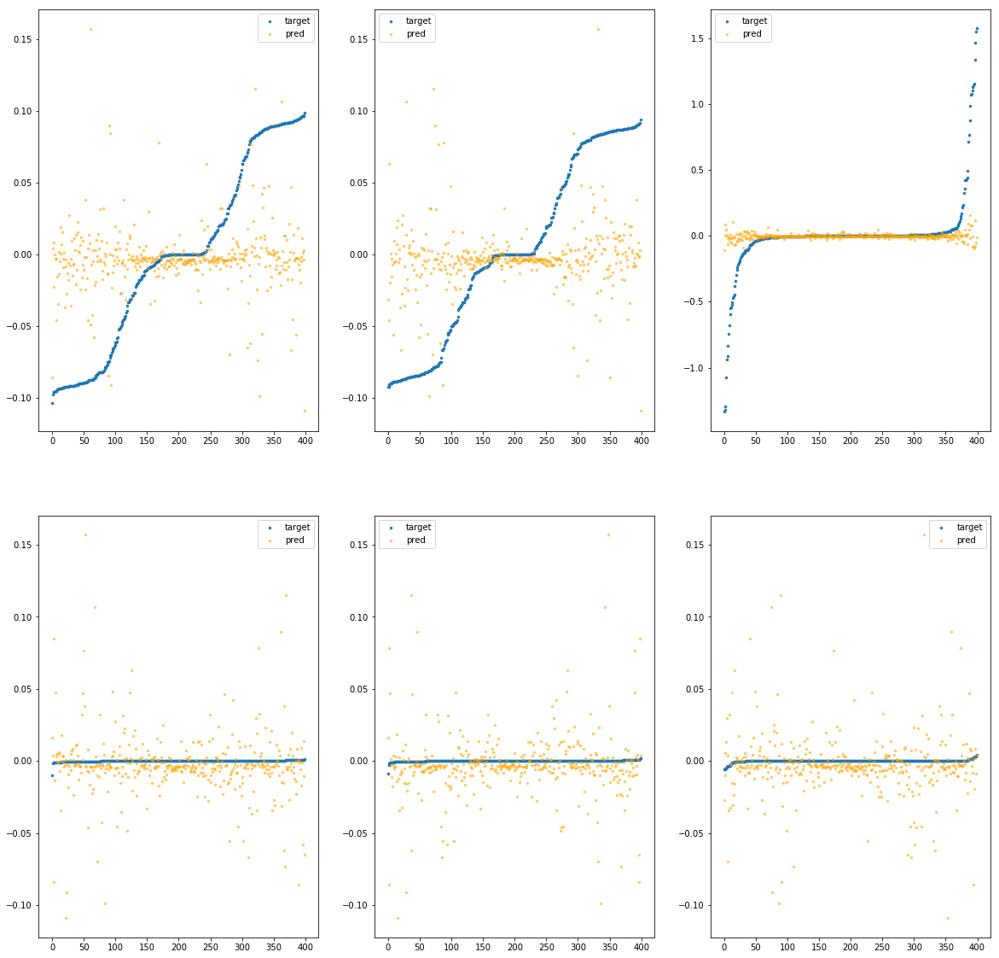

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa97e3af910>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.23e-02	1.48e-01	5.24e-02	8.53e+03	4.23e-03	1.79e-05
y		-4.79e-02	1.68e-01	5.19e-02	8.58e+01	4.02e-03	1.61e-05
z		-1.56e-03	1.56e+00	1.03e-01	1.32e+02	8.34e-02	6.96e-03
phi		-4.79e+02	8.49e-02	6.89e-03	1.06e+06	1.74e-04	3.03e-08
theta		-5.59e+02	8.47e-02	6.84e-03	1.41e+05	1.73e-04	2.99e-08
psi		-2.26e+02	7.96e-02	6.87e-03	9.87e+05	1.70e-04	2.89e-08


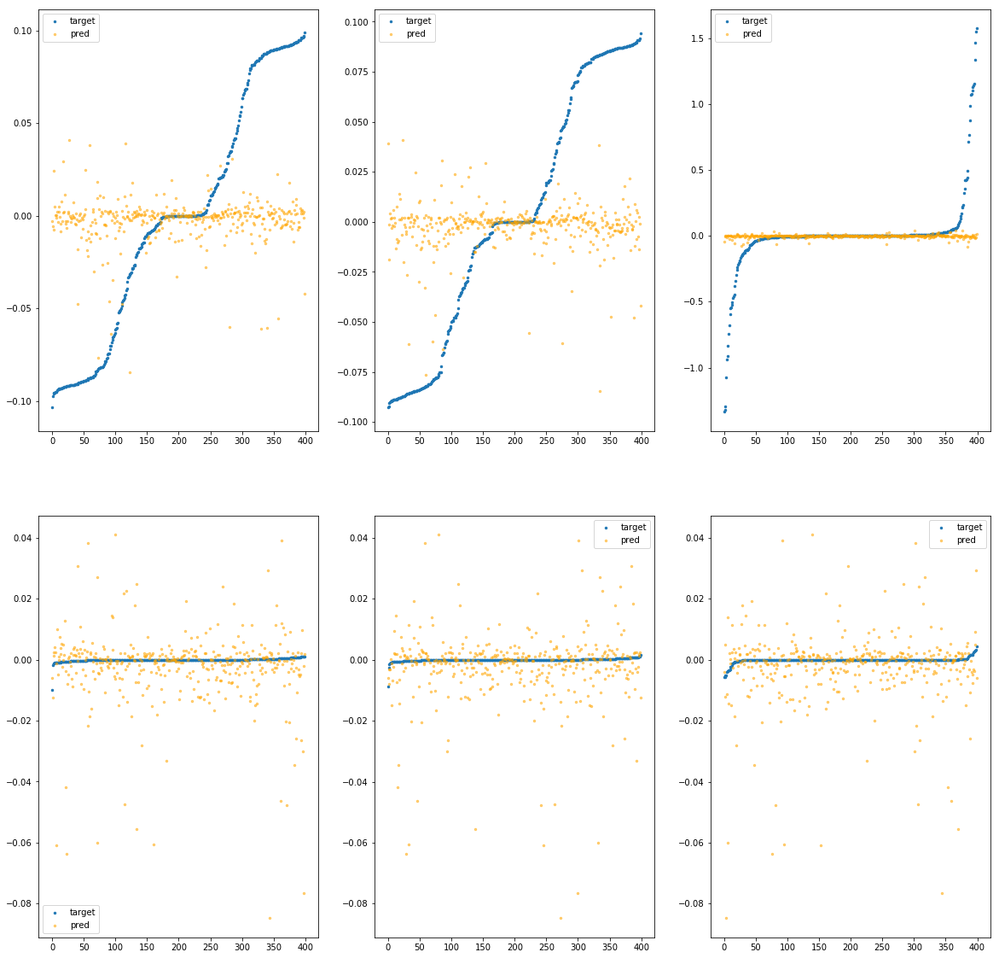

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa97e3af970>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.22e-01	2.41e-01	5.62e-02	1.54e+04	5.00e-03	2.50e-05
y		-1.44e-01	1.94e-01	5.30e-02	5.85e+02	4.39e-03	1.92e-05
z		-4.00e-03	1.67e+00	1.07e-01	4.98e+02	8.37e-02	7.00e-03
phi		-1.67e+03	1.47e-01	1.58e-02	4.04e+06	6.05e-04	3.66e-07
theta		-1.96e+03	1.47e-01	1.58e-02	5.97e+05	6.05e-04	3.66e-07
psi		-8.10e+02	1.47e-01	1.58e-02	1.17e+06	6.08e-04	3.70e-07


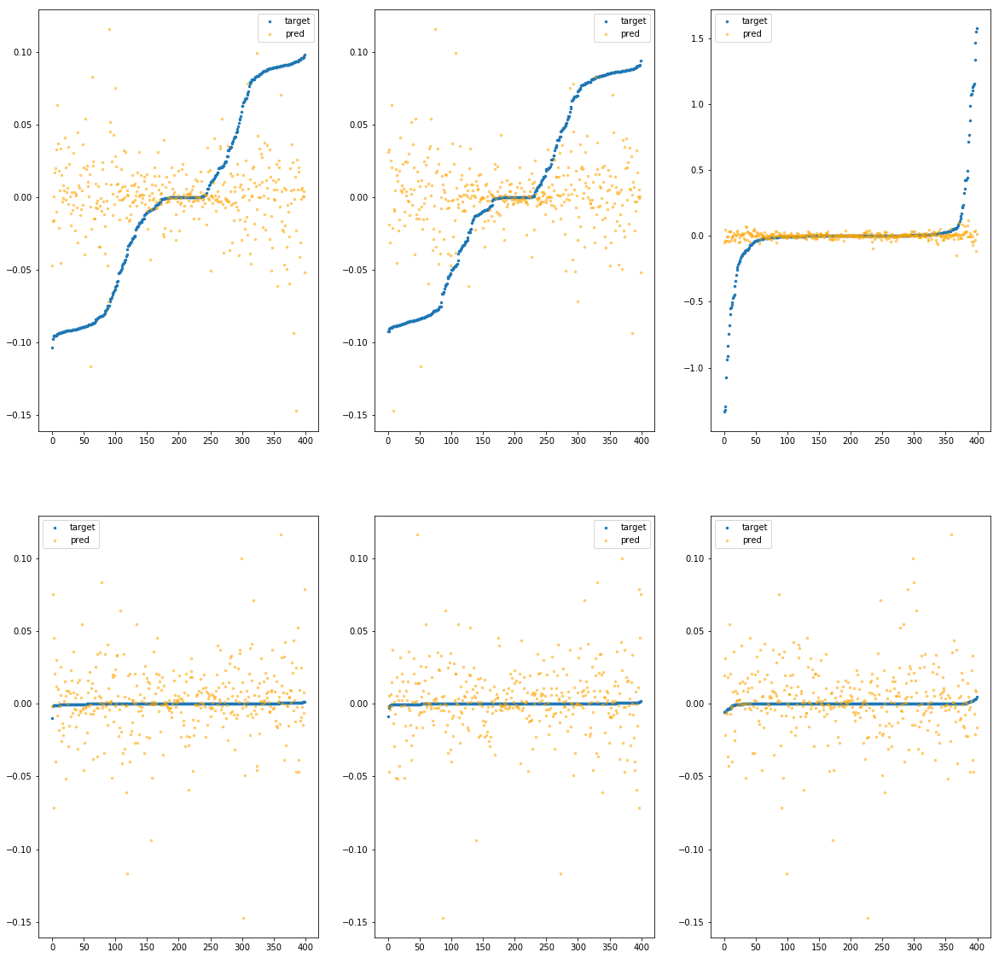

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa97e3af9d0>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.54e-01	1.90e-01	5.42e-02	2.65e+04	4.72e-03	2.23e-05
y		-3.17e-01	2.14e-01	5.69e-02	8.44e+02	5.05e-03	2.55e-05
z		6.83e-03	1.55e+00	1.10e-01	7.98e+02	8.27e-02	6.85e-03
phi		-2.74e+03	1.30e-01	2.18e-02	3.53e+06	9.91e-04	9.83e-07
theta		-3.21e+03	1.31e-01	2.18e-02	1.30e+06	9.93e-04	9.87e-07
psi		-1.33e+03	1.30e-01	2.19e-02	1.98e+06	9.97e-04	9.95e-07


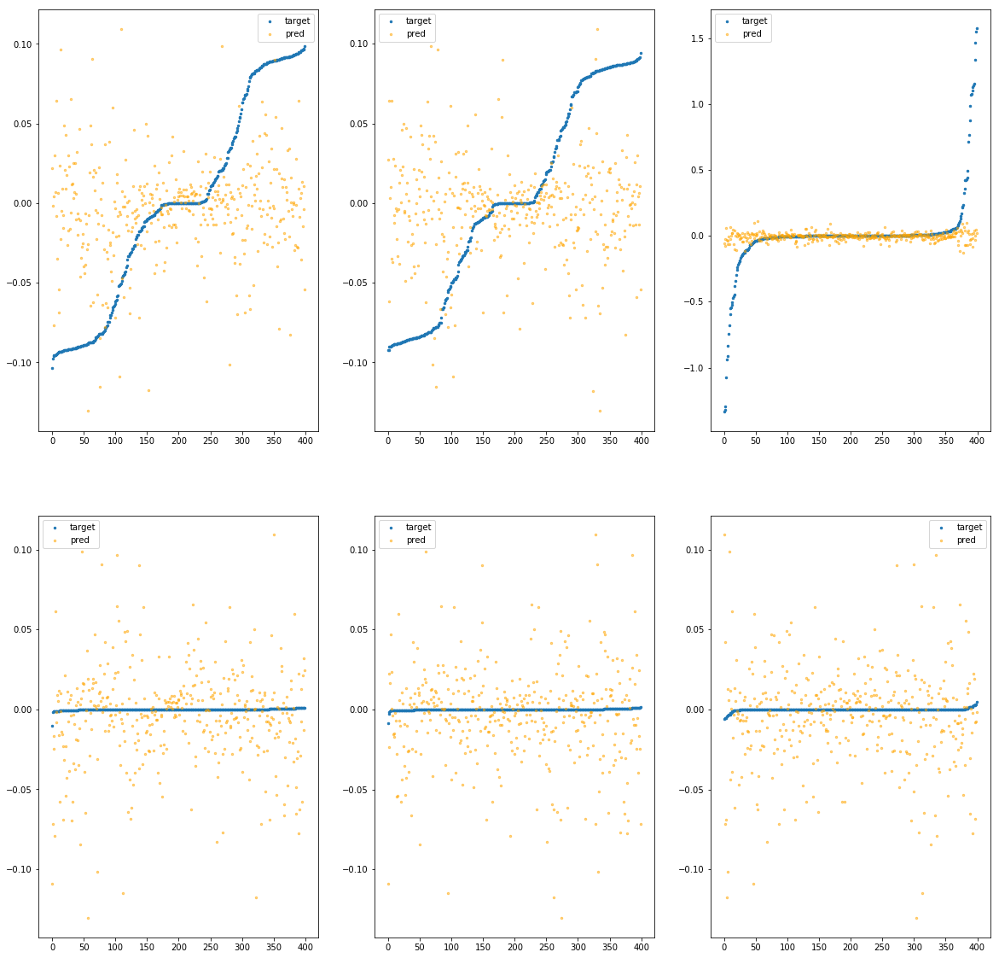

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa97e3afa30>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.80e-01	2.44e-01	5.92e-02	1.08e+04	6.06e-03	3.67e-05
y		-4.69e-01	2.80e-01	5.66e-02	6.82e+02	5.63e-03	3.17e-05
z		-2.69e-02	1.67e+00	1.14e-01	7.49e+02	8.56e-02	7.32e-03
phi		-4.47e+03	1.99e-01	2.61e-02	2.70e+06	1.62e-03	2.62e-06
theta		-5.23e+03	1.99e-01	2.60e-02	5.61e+05	1.62e-03	2.61e-06
psi		-2.17e+03	1.99e-01	2.61e-02	1.86e+06	1.63e-03	2.65e-06


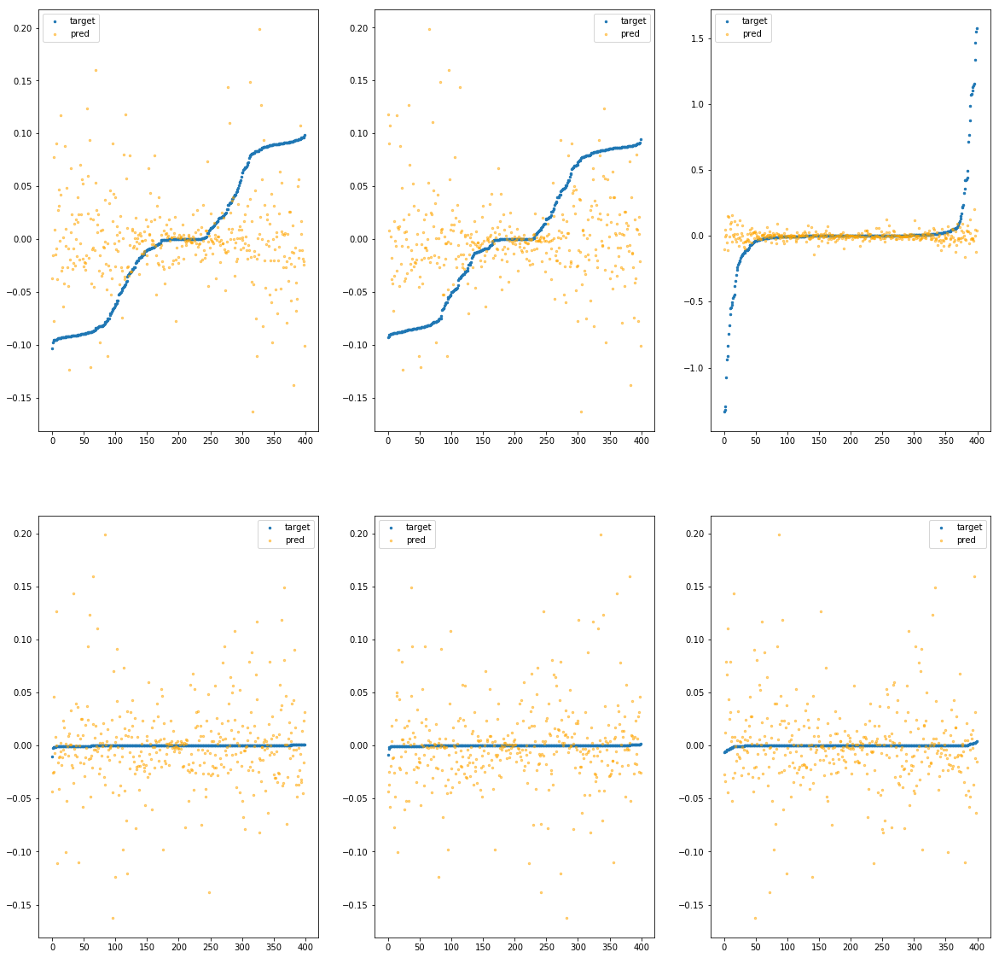

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa97e3afa90>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.88e-01	2.71e-01	5.95e-02	1.76e+04	5.68e-03	3.23e-05
y		-2.80e-01	1.86e-01	5.51e-02	4.09e+02	4.91e-03	2.41e-05
z		-2.56e-02	1.65e+00	1.11e-01	4.28e+02	8.54e-02	7.30e-03
phi		-3.04e+03	1.89e-01	2.16e-02	4.06e+06	1.10e-03	1.21e-06
theta		-3.56e+03	1.88e-01	2.16e-02	5.32e+05	1.10e-03	1.21e-06
psi		-1.47e+03	1.89e-01	2.16e-02	1.64e+06	1.10e-03	1.21e-06


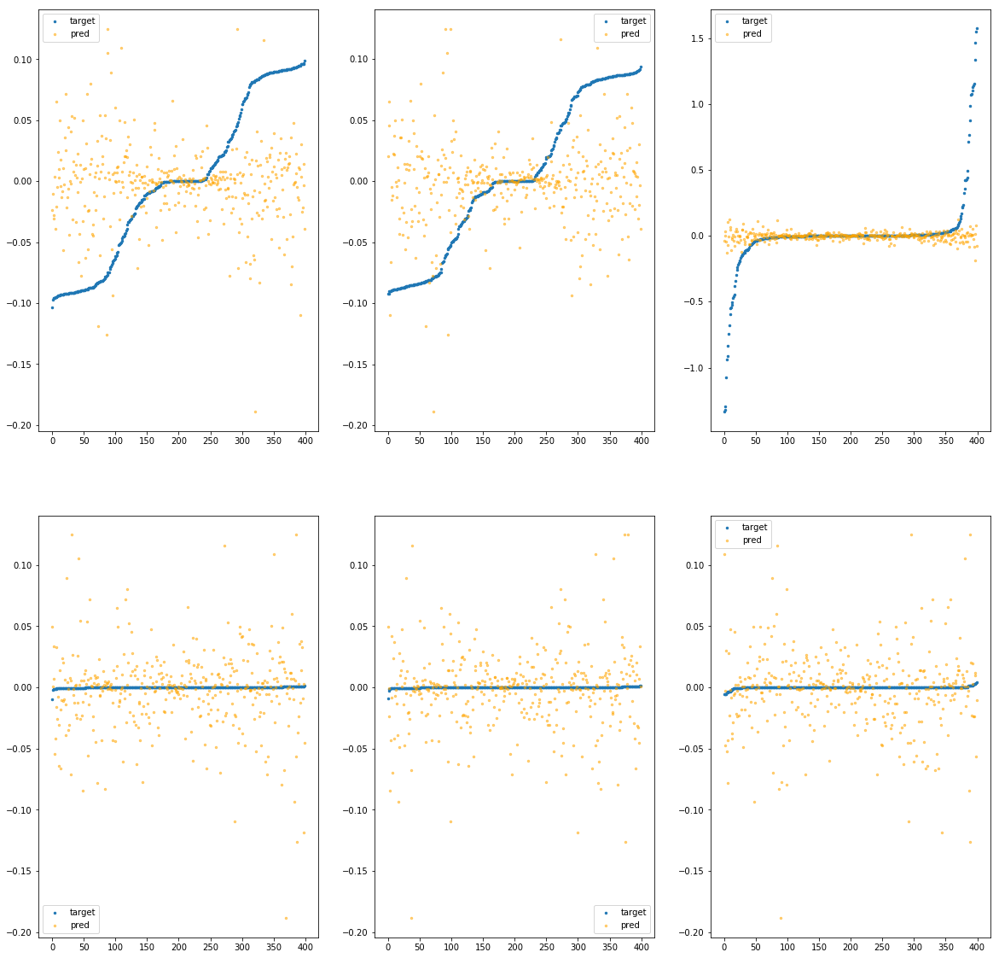

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa97e3afaf0>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.18e-02	1.67e-01	5.33e-02	1.61e+04	4.35e-03	1.89e-05
y		-4.09e-02	1.62e-01	5.26e-02	6.00e+02	3.99e-03	1.59e-05
z		5.04e-03	1.58e+00	1.04e-01	4.34e+02	8.29e-02	6.87e-03
phi		-2.68e+02	7.56e-02	6.19e-03	2.50e+06	9.73e-05	9.47e-09
theta		-3.10e+02	7.56e-02	6.16e-03	5.71e+05	9.61e-05	9.24e-09
psi		-1.28e+02	7.56e-02	6.14e-03	6.70e+05	9.70e-05	9.41e-09


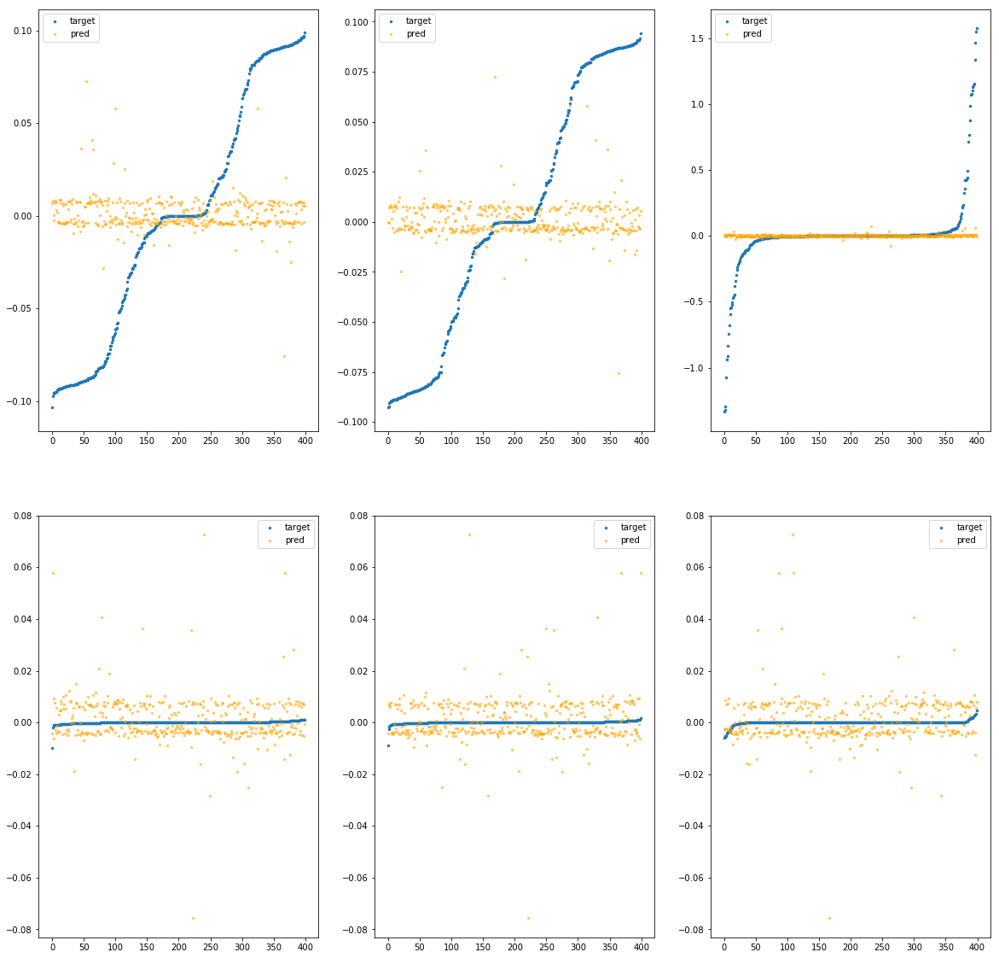

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa97e3afb50>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.02e-02	1.86e-01	5.31e-02	1.19e+04	4.30e-03	1.85e-05
y		-3.57e-02	1.81e-01	5.15e-02	5.47e+02	3.97e-03	1.58e-05
z		-4.24e-03	1.57e+00	1.04e-01	3.26e+02	8.37e-02	7.00e-03
phi		-5.07e+02	1.21e-01	6.61e-03	1.90e+06	1.84e-04	3.39e-08
theta		-5.93e+02	1.21e-01	6.61e-03	4.42e+05	1.83e-04	3.36e-08
psi		-2.47e+02	1.21e-01	6.70e-03	5.98e+05	1.86e-04	3.47e-08


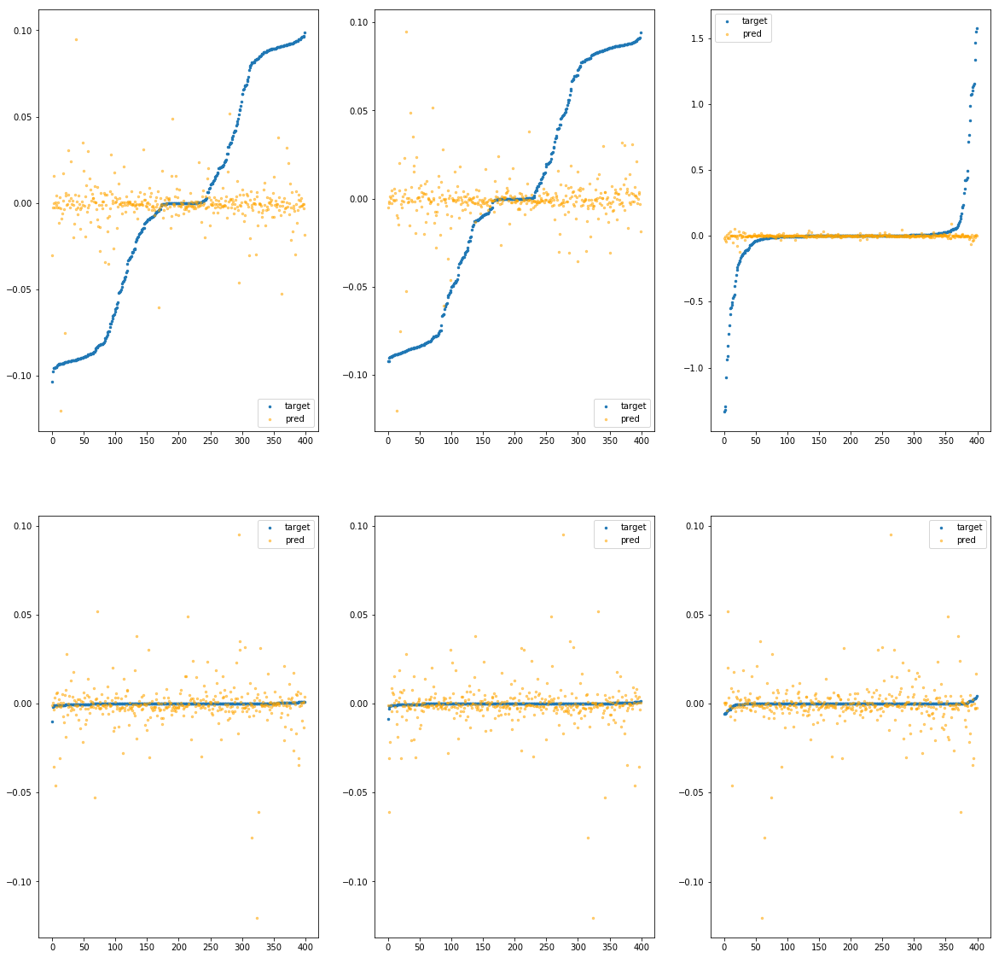

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa97e3afbb0>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.31e-01	2.04e-01	5.63e-02	1.96e+04	5.04e-03	2.54e-05
y		-2.77e-01	2.01e-01	5.56e-02	6.06e+02	4.89e-03	2.40e-05
z		-1.87e-02	1.56e+00	1.10e-01	5.86e+02	8.49e-02	7.20e-03
phi		-2.32e+03	1.16e-01	1.93e-02	2.26e+06	8.41e-04	7.06e-07
theta		-2.72e+03	1.17e-01	1.93e-02	6.54e+05	8.40e-04	7.06e-07
psi		-1.13e+03	1.17e-01	1.94e-02	1.63e+06	8.47e-04	7.17e-07


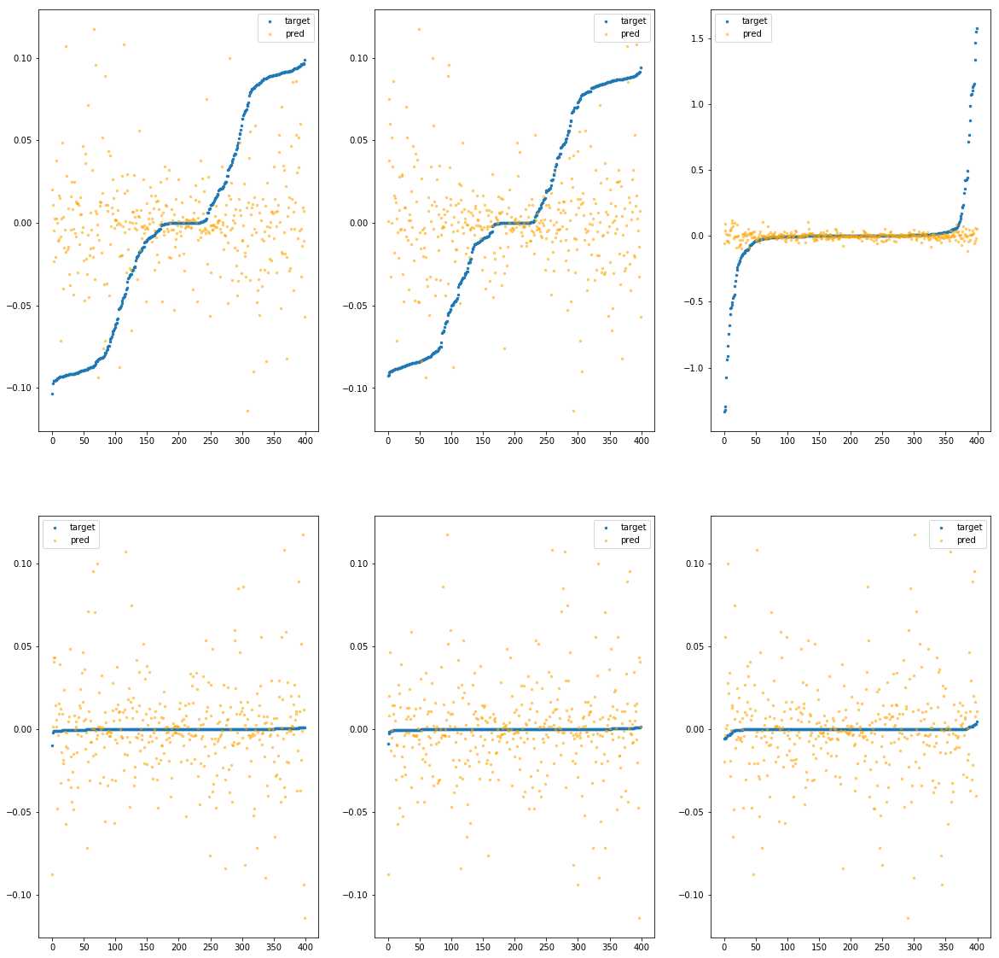

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa97e3afc10>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.89e-01	1.89e-01	5.53e-02	3.44e+04	4.87e-03	2.37e-05
y		-2.95e-01	2.06e-01	5.65e-02	2.17e+03	4.97e-03	2.47e-05
z		-3.28e-02	1.55e+00	1.12e-01	1.04e+03	8.60e-02	7.40e-03
phi		-2.37e+03	1.69e-01	1.95e-02	5.16e+06	8.59e-04	7.38e-07
theta		-2.77e+03	1.69e-01	1.95e-02	2.06e+06	8.56e-04	7.32e-07
psi		-1.13e+03	1.70e-01	1.95e-02	1.38e+06	8.52e-04	7.26e-07


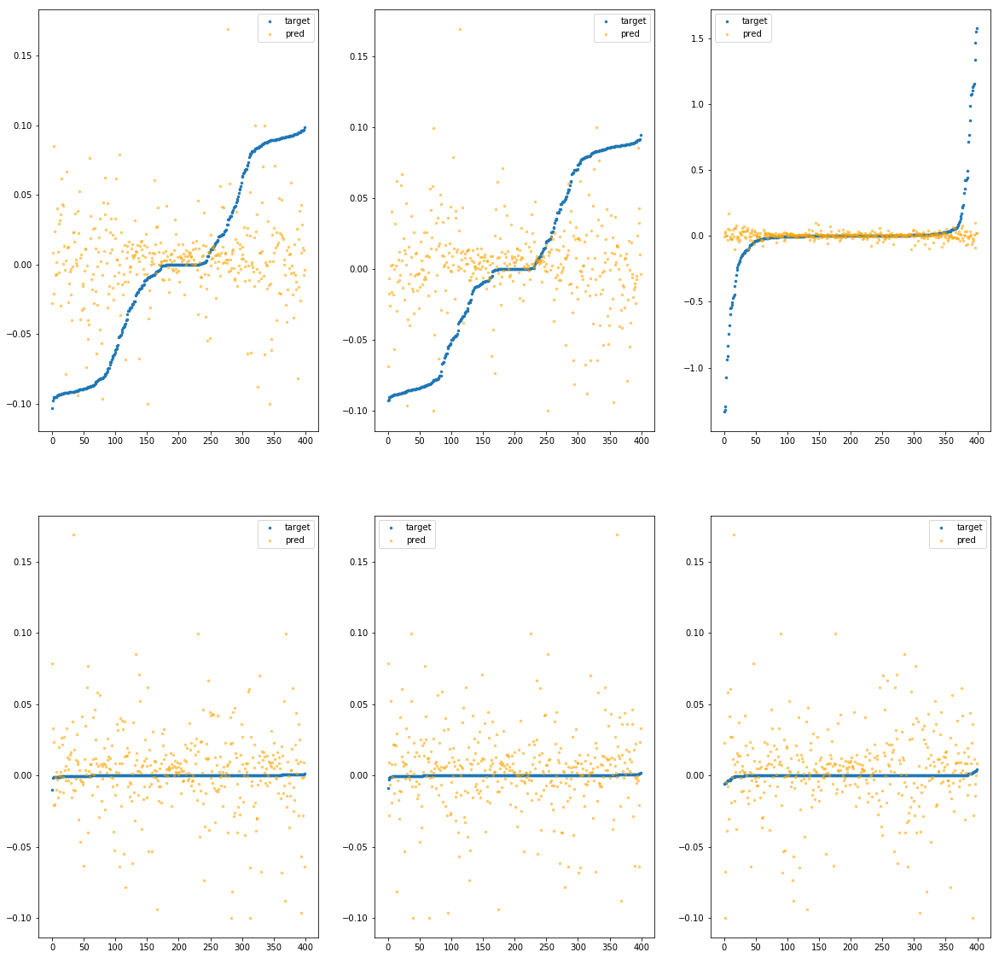

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa97e3afc70>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.94e-01	2.23e-01	5.85e-02	1.89e+04	5.71e-03	3.26e-05
y		-4.20e-01	2.80e-01	5.59e-02	8.28e+02	5.45e-03	2.97e-05
z		-2.65e-02	1.66e+00	1.13e-01	8.02e+02	8.55e-02	7.31e-03
phi		-5.06e+03	2.29e-01	2.69e-02	2.81e+06	1.83e-03	3.36e-06
theta		-5.93e+03	2.27e-01	2.69e-02	1.32e+06	1.83e-03	3.36e-06
psi		-2.45e+03	2.29e-01	2.69e-02	1.31e+06	1.84e-03	3.37e-06


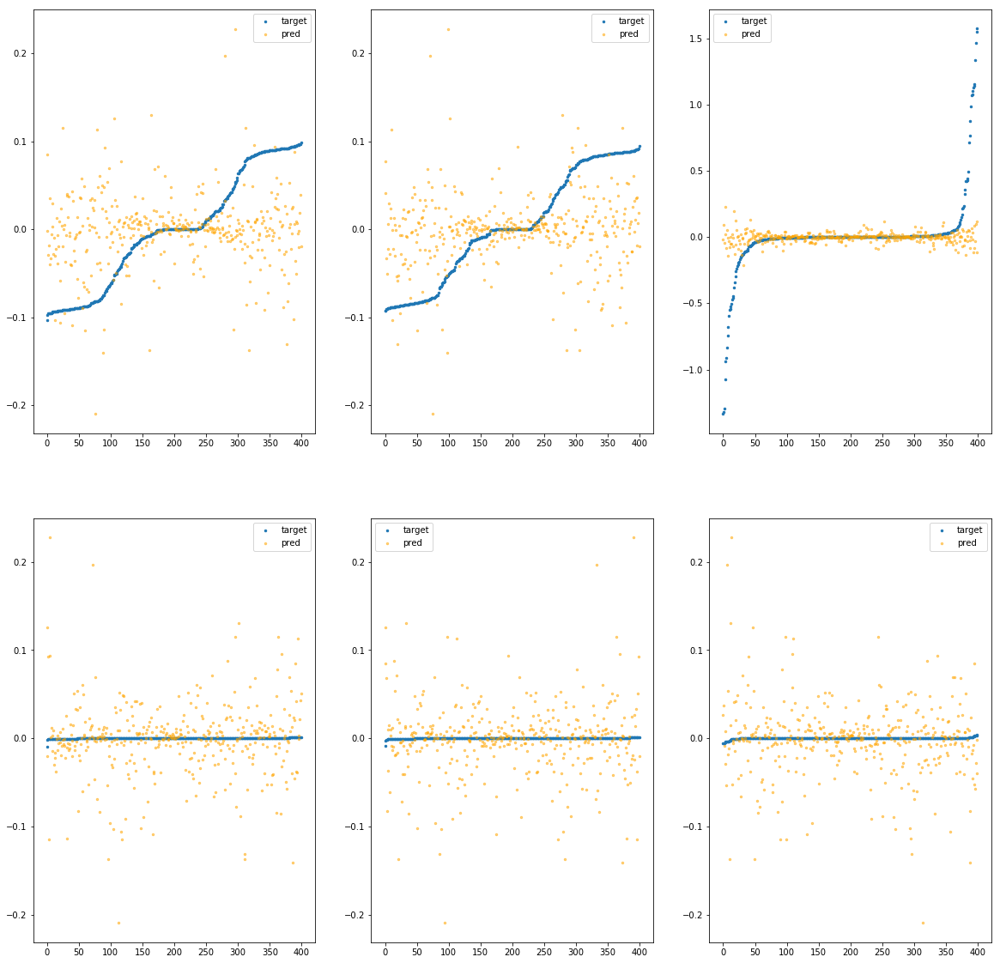

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa97e3afcd0>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.28e-02	2.16e-01	5.32e-02	2.32e+04	4.27e-03	1.82e-05
y		-1.13e-02	1.02e-01	5.19e-02	1.24e+03	3.88e-03	1.50e-05
z		4.80e-03	1.58e+00	1.03e-01	5.69e+02	8.29e-02	6.88e-03
phi		-2.02e+02	1.37e-01	4.88e-03	3.90e+06	7.34e-05	5.38e-09
theta		-2.36e+02	1.37e-01	4.92e-03	1.05e+06	7.31e-05	5.35e-09
psi		-9.77e+01	1.37e-01	4.94e-03	6.70e+05	7.40e-05	5.48e-09


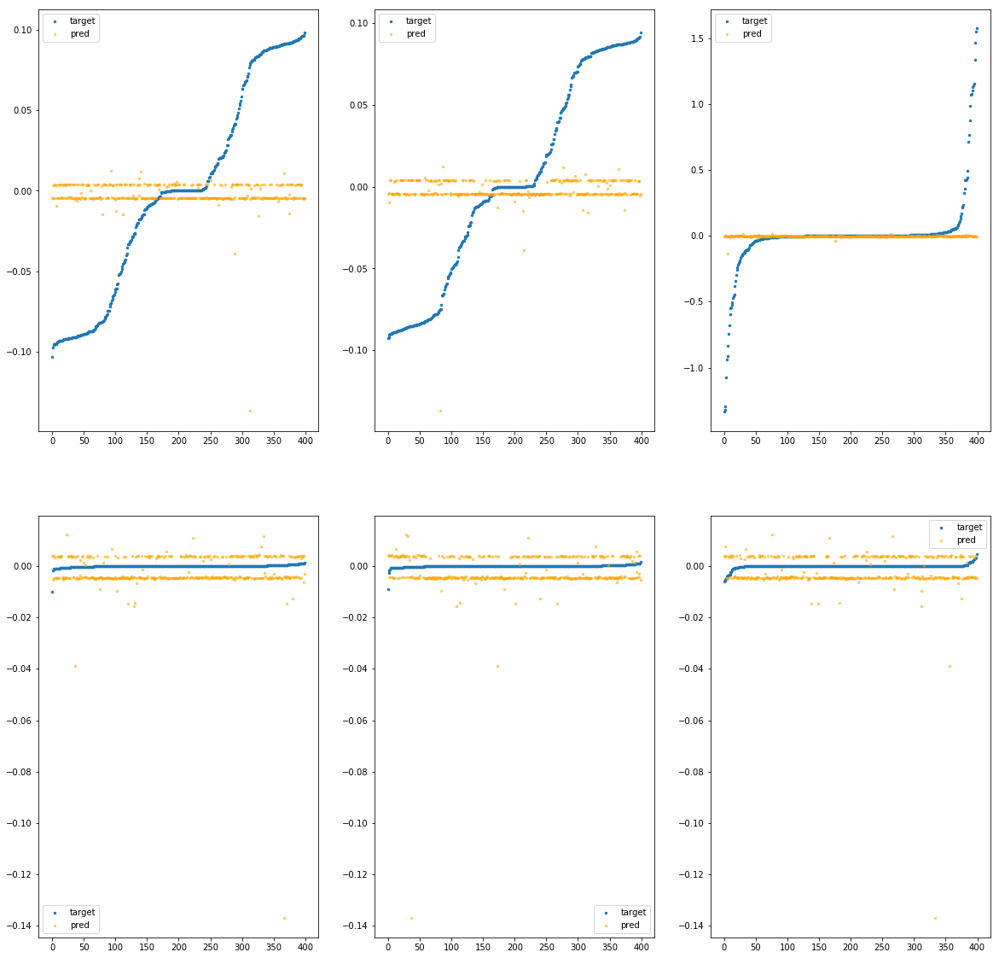

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa97e3afd30>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.65e-02	1.21e-01	5.21e-02	9.67e+03	4.16e-03	1.73e-05
y		-3.40e-02	1.25e-01	5.19e-02	3.81e+02	3.96e-03	1.57e-05
z		3.99e-03	1.56e+00	1.03e-01	1.64e+02	8.30e-02	6.89e-03
phi		-1.10e+02	4.65e-02	3.99e-03	1.55e+06	4.04e-05	1.63e-09
theta		-1.31e+02	4.72e-02	4.02e-03	3.20e+05	4.09e-05	1.67e-09
psi		-5.33e+01	4.69e-02	4.04e-03	3.41e+05	4.07e-05	1.66e-09


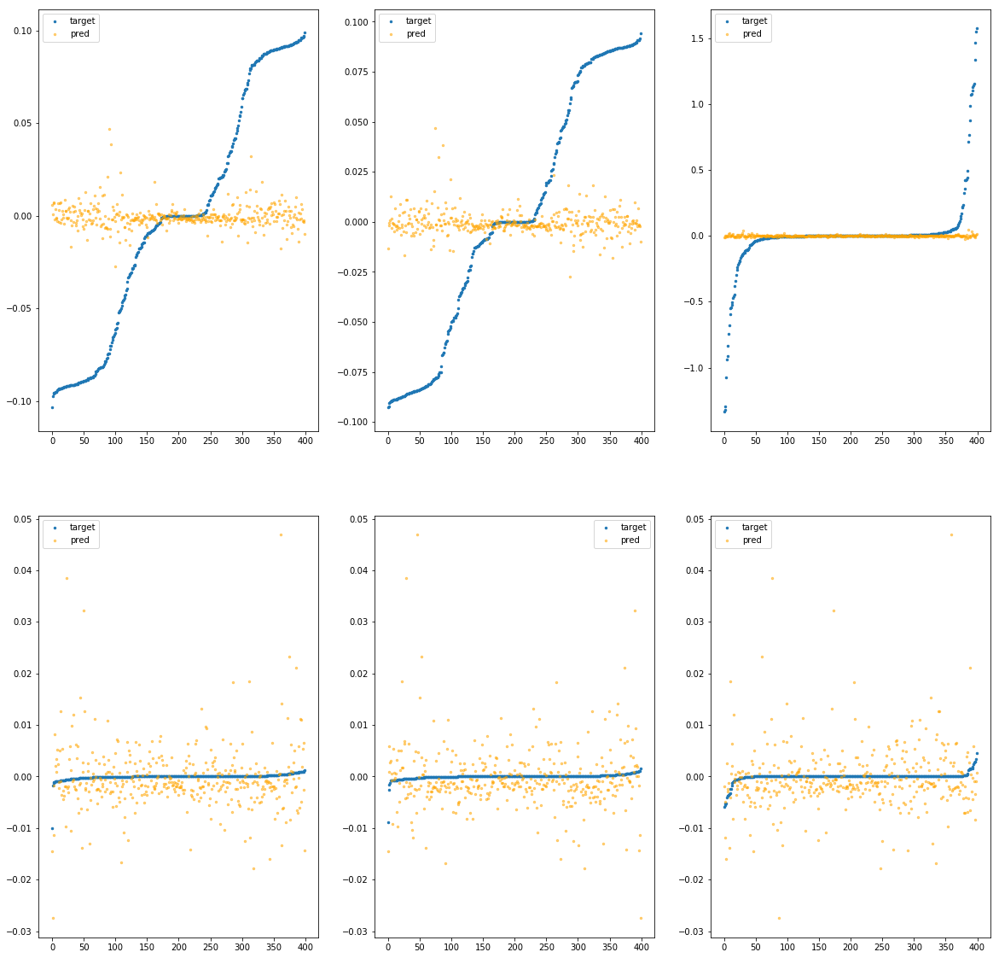

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa97e3afd90>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.28e-02	1.52e-01	5.41e-02	3.02e+04	4.47e-03	2.00e-05
y		-1.38e-01	1.84e-01	5.40e-02	1.83e+03	4.36e-03	1.90e-05
z		-2.09e-02	1.65e+00	1.07e-01	6.99e+02	8.51e-02	7.24e-03
phi		-8.24e+02	1.00e-01	1.14e-02	5.60e+06	2.99e-04	8.92e-08
theta		-9.67e+02	1.00e-01	1.15e-02	1.40e+06	2.99e-04	8.95e-08
psi		-3.96e+02	9.51e-02	1.15e-02	1.37e+06	2.98e-04	8.85e-08


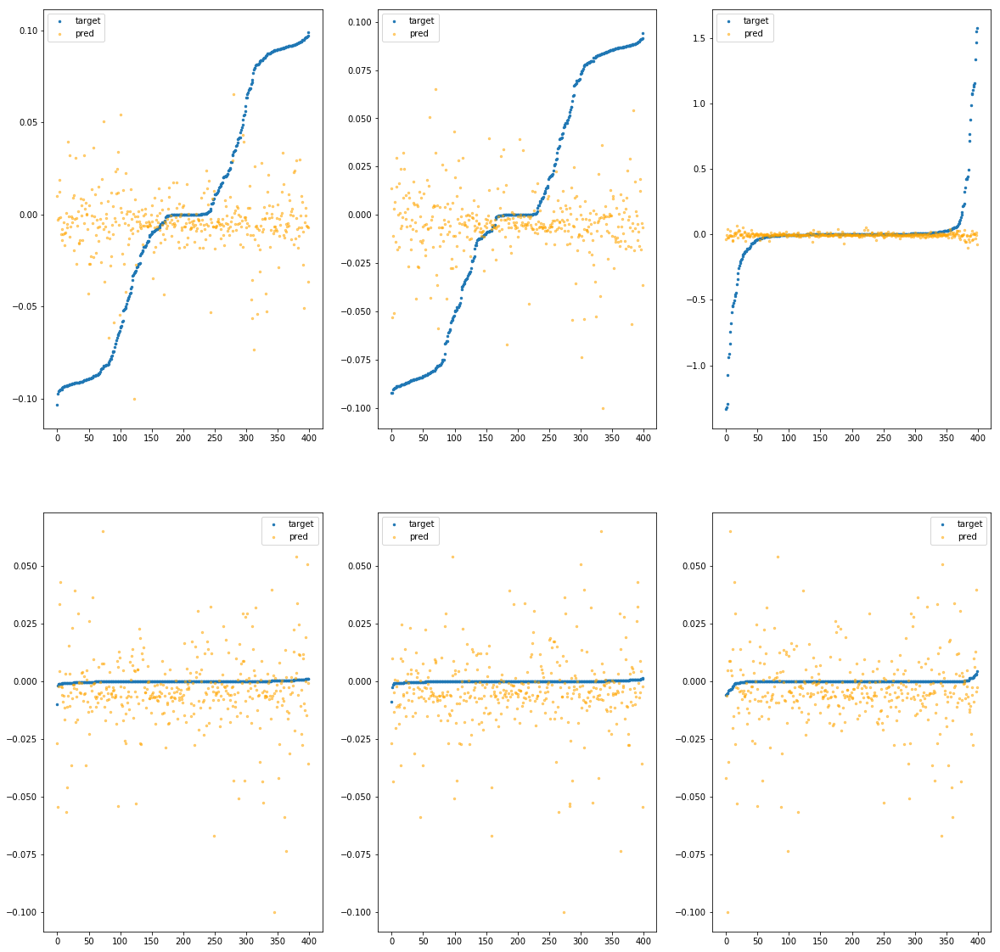

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa97e3afdf0>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.27e-01	1.87e-01	5.36e-02	9.31e+03	4.61e-03	2.13e-05
y		-1.19e-01	2.04e-01	5.24e-02	7.72e+02	4.29e-03	1.84e-05
z		1.65e-02	1.59e+00	1.07e-01	5.21e+02	8.19e-02	6.71e-03
phi		-1.77e+03	1.53e-01	1.63e-02	1.66e+06	6.43e-04	4.13e-07
theta		-2.09e+03	1.53e-01	1.64e-02	5.60e+05	6.45e-04	4.16e-07
psi		-8.59e+02	1.49e-01	1.63e-02	1.56e+06	6.45e-04	4.16e-07


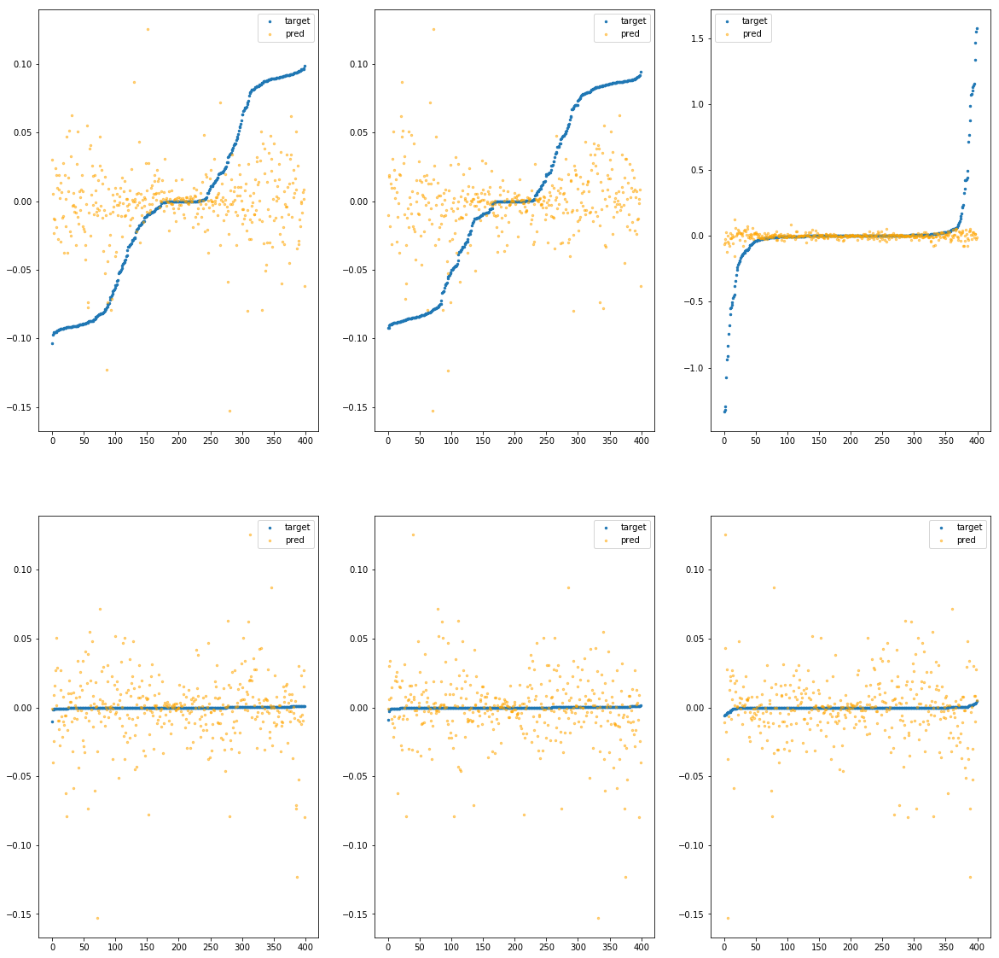

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa97e3afe50>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.62e-01	1.74e-01	5.48e-02	2.42e+04	4.76e-03	2.27e-05
y		-2.11e-01	1.88e-01	5.34e-02	6.85e+02	4.64e-03	2.16e-05
z		-1.48e-02	1.50e+00	1.10e-01	5.27e+02	8.45e-02	7.15e-03
phi		-2.24e+03	1.16e-01	1.91e-02	4.10e+06	8.10e-04	6.56e-07
theta		-2.62e+03	1.16e-01	1.91e-02	6.64e+05	8.10e-04	6.56e-07
psi		-1.07e+03	1.16e-01	1.91e-02	1.29e+06	8.04e-04	6.46e-07


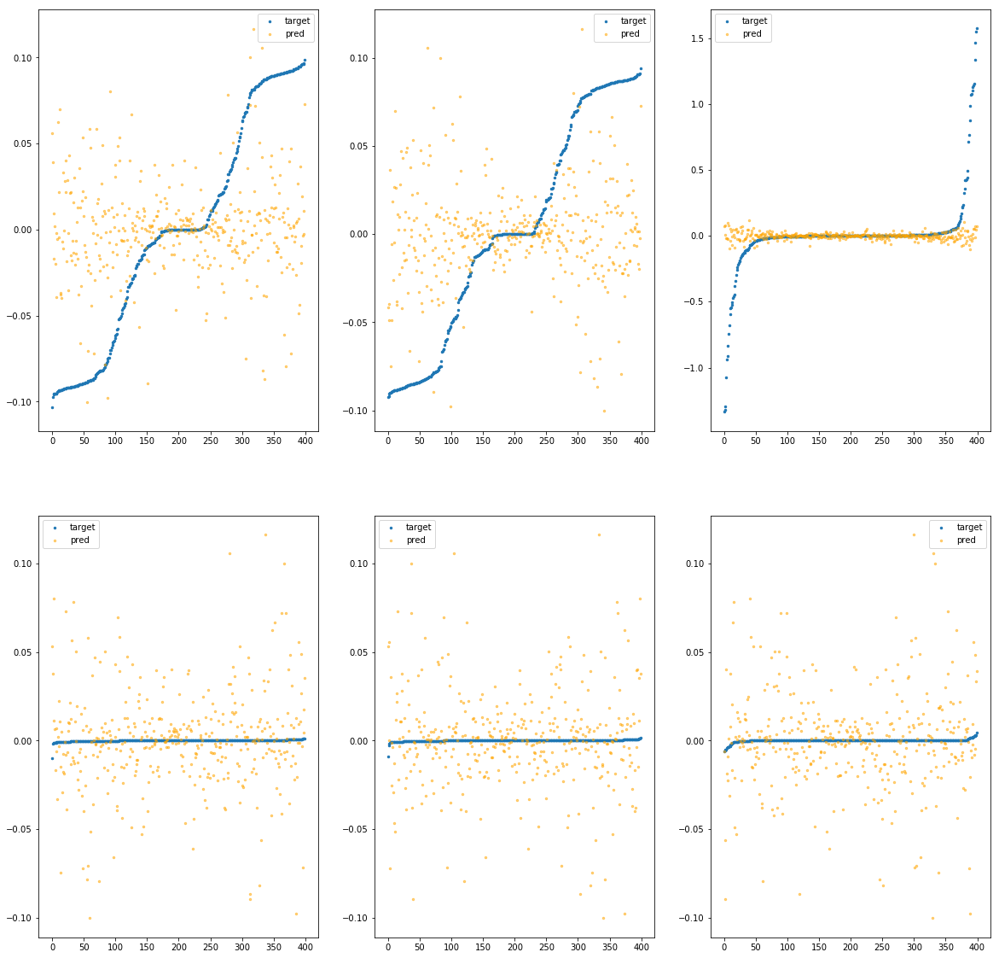

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa97e3afeb0>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.03e-02	1.52e-01	5.23e-02	6.03e+03	4.18e-03	1.74e-05
y		-2.53e-02	1.68e-01	5.15e-02	1.29e+02	3.93e-03	1.55e-05
z		5.91e-03	1.55e+00	1.03e-01	1.72e+02	8.28e-02	6.86e-03
phi		-5.36e+02	1.68e-01	3.14e-03	1.16e+06	1.95e-04	3.79e-08
theta		-6.25e+02	1.68e-01	3.11e-03	1.03e+05	1.93e-04	3.74e-08
psi		-2.60e+02	1.68e-01	3.20e-03	2.07e+05	1.96e-04	3.83e-08


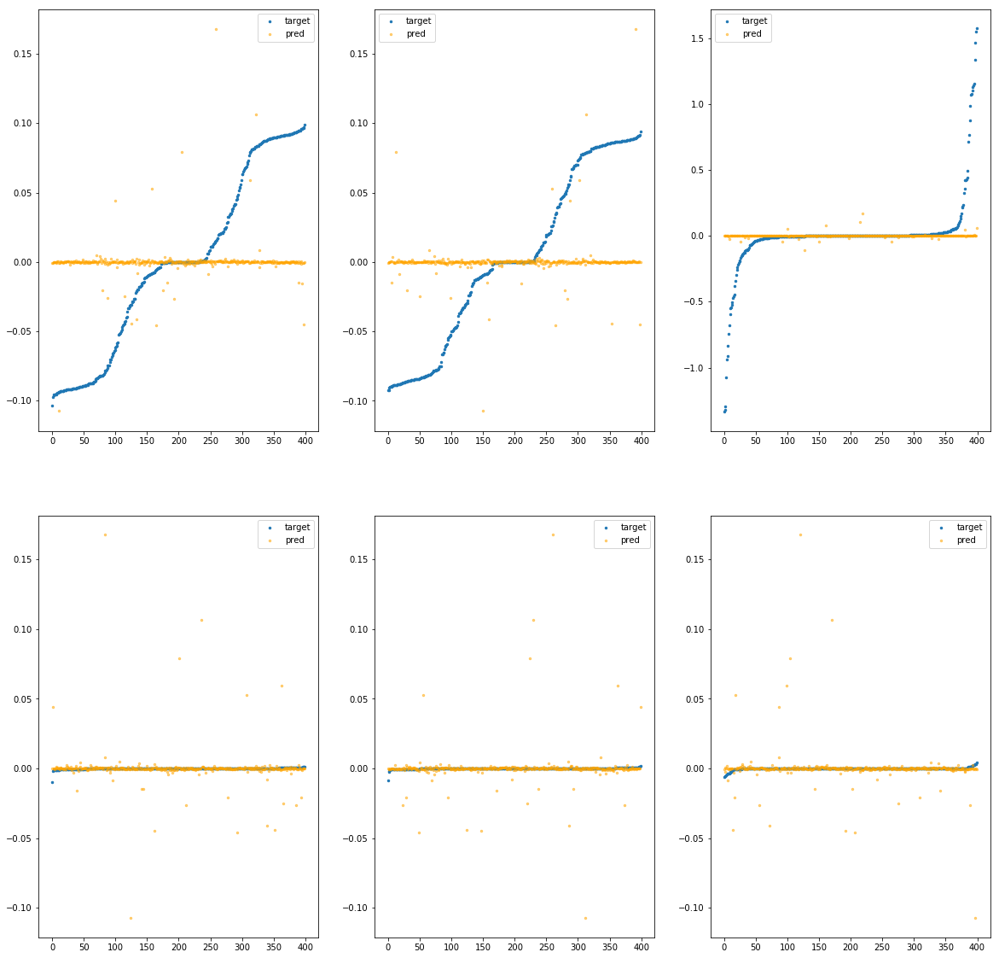

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa97e3aff10>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		3.15e-03	1.08e-01	5.17e-02	1.75e+03	4.08e-03	1.67e-05
y		-8.56e-03	1.04e-01	5.14e-02	9.57e+01	3.87e-03	1.50e-05
z		-6.57e-05	1.57e+00	1.02e-01	7.37e+01	8.33e-02	6.94e-03
phi		-3.53e+01	3.15e-02	2.19e-03	3.65e+05	1.31e-05	1.72e-10
theta		-4.15e+01	3.25e-02	2.19e-03	1.10e+05	1.31e-05	1.72e-10
psi		-1.62e+01	2.98e-02	2.22e-03	1.06e+05	1.29e-05	1.66e-10


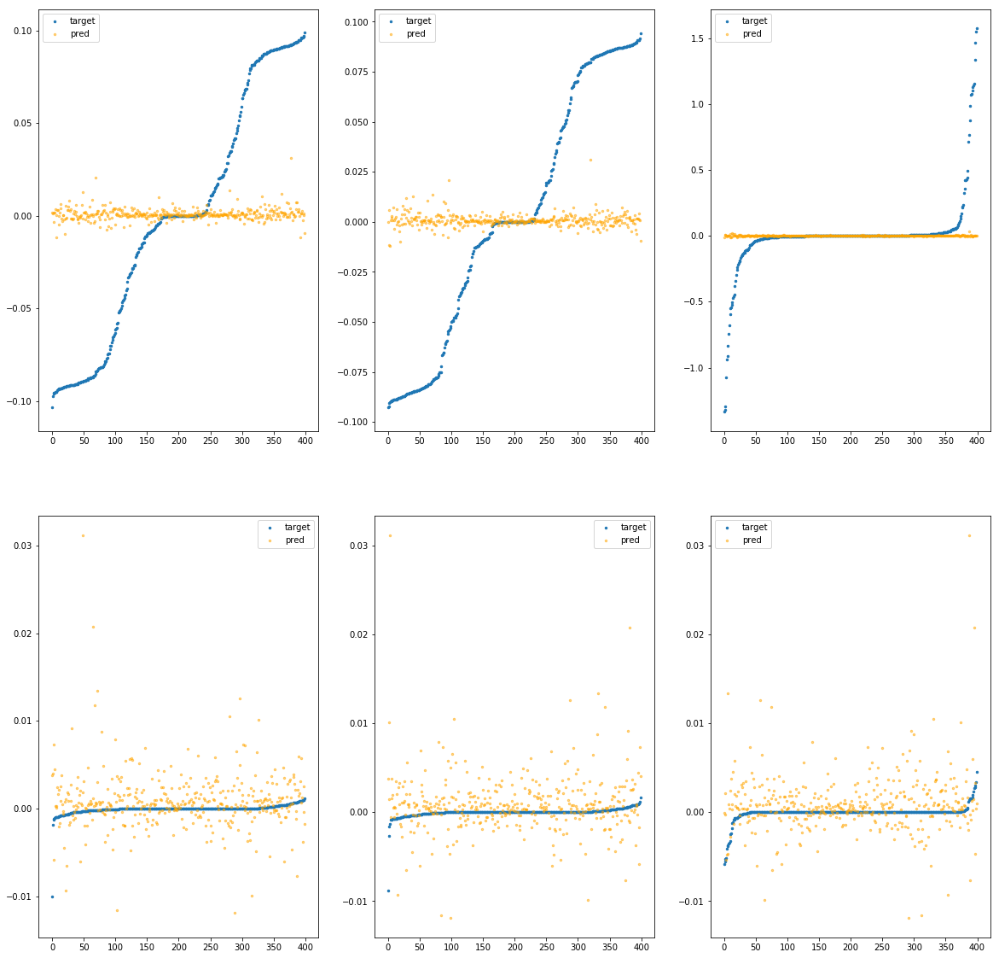

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa97e3aff70>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.98e-03	1.22e-01	5.25e-02	1.07e+04	4.13e-03	1.70e-05
y		1.41e-02	1.19e-01	5.07e-02	9.91e+02	3.78e-03	1.43e-05
z		4.58e-03	1.55e+00	1.04e-01	4.14e+02	8.29e-02	6.88e-03
phi		-2.94e+02	4.38e-02	7.20e-03	2.05e+06	1.07e-04	1.14e-08
theta		-3.44e+02	4.17e-02	7.23e-03	5.79e+05	1.07e-04	1.13e-08
psi		-1.43e+02	4.27e-02	7.20e-03	8.32e+05	1.08e-04	1.16e-08


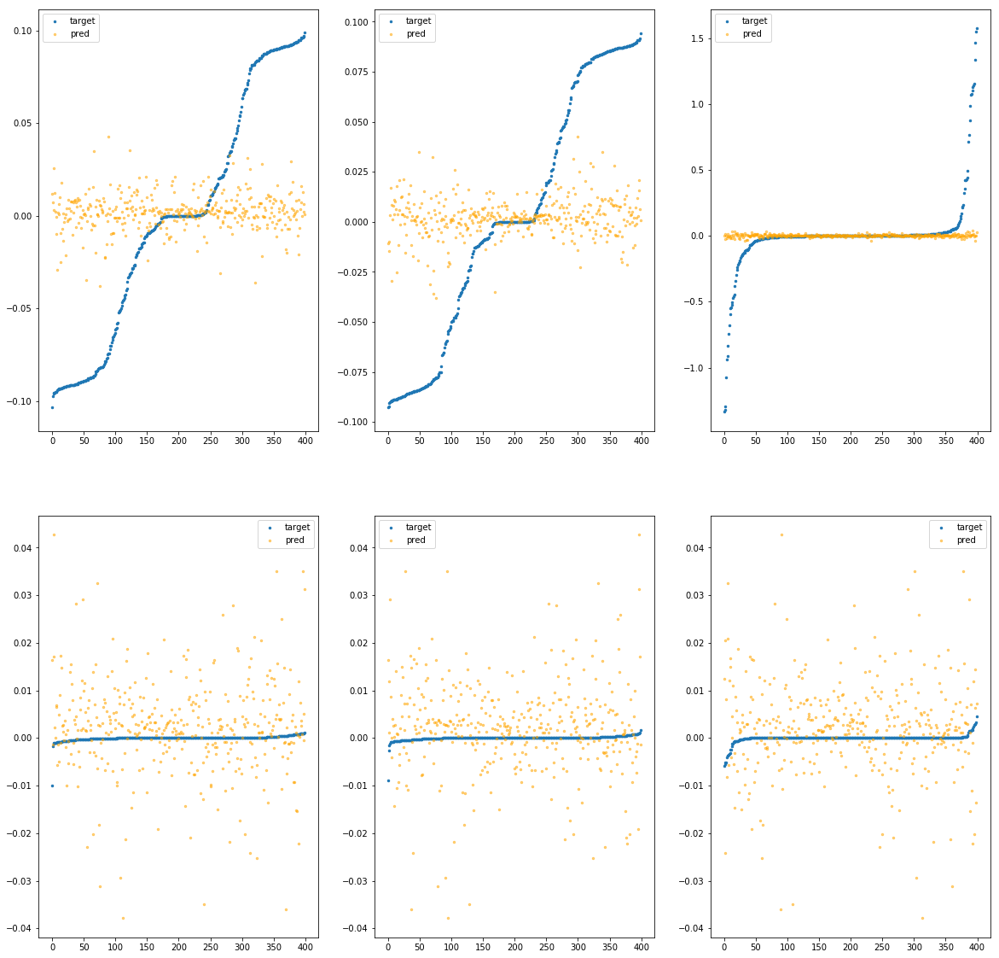

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa97e3affd0>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.48e-02	2.25e-01	5.31e-02	1.56e+04	4.32e-03	1.86e-05
y		-3.58e-02	1.31e-01	5.21e-02	7.77e+02	3.97e-03	1.58e-05
z		1.21e-03	1.58e+00	1.04e-01	3.54e+02	8.32e-02	6.93e-03
phi		-3.94e+02	1.30e-01	6.26e-03	2.29e+06	1.43e-04	2.04e-08
theta		-4.59e+02	1.30e-01	6.23e-03	5.88e+05	1.42e-04	2.02e-08
psi		-1.91e+02	1.30e-01	6.32e-03	3.85e+05	1.44e-04	2.07e-08


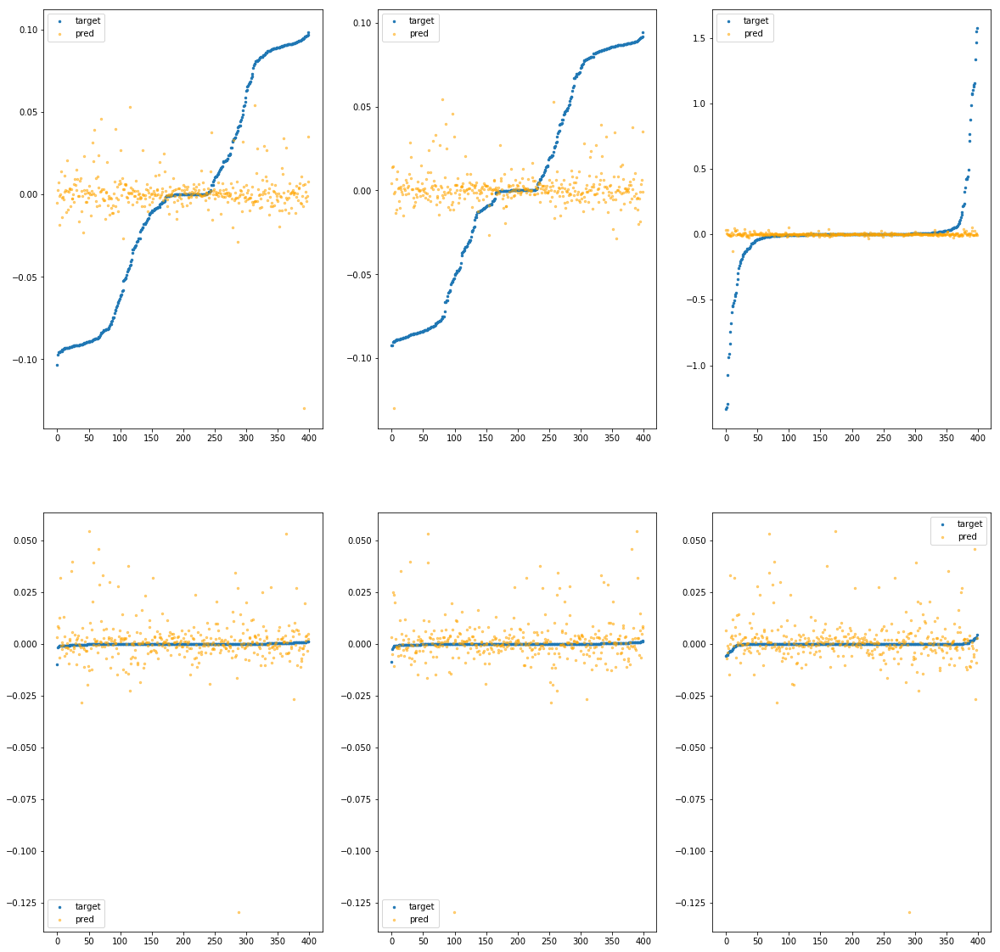

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa99bfc3070>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.19e-01	1.97e-01	5.44e-02	1.01e+04	4.58e-03	2.10e-05
y		-1.92e-01	2.01e-01	5.46e-02	3.80e+02	4.57e-03	2.09e-05
z		-2.94e-02	1.60e+00	1.08e-01	4.51e+02	8.58e-02	7.36e-03
phi		-1.35e+03	1.22e-01	1.42e-02	2.11e+06	4.88e-04	2.38e-07
theta		-1.58e+03	1.23e-01	1.43e-02	3.80e+05	4.89e-04	2.39e-07
psi		-6.55e+02	1.22e-01	1.43e-02	1.48e+06	4.92e-04	2.42e-07


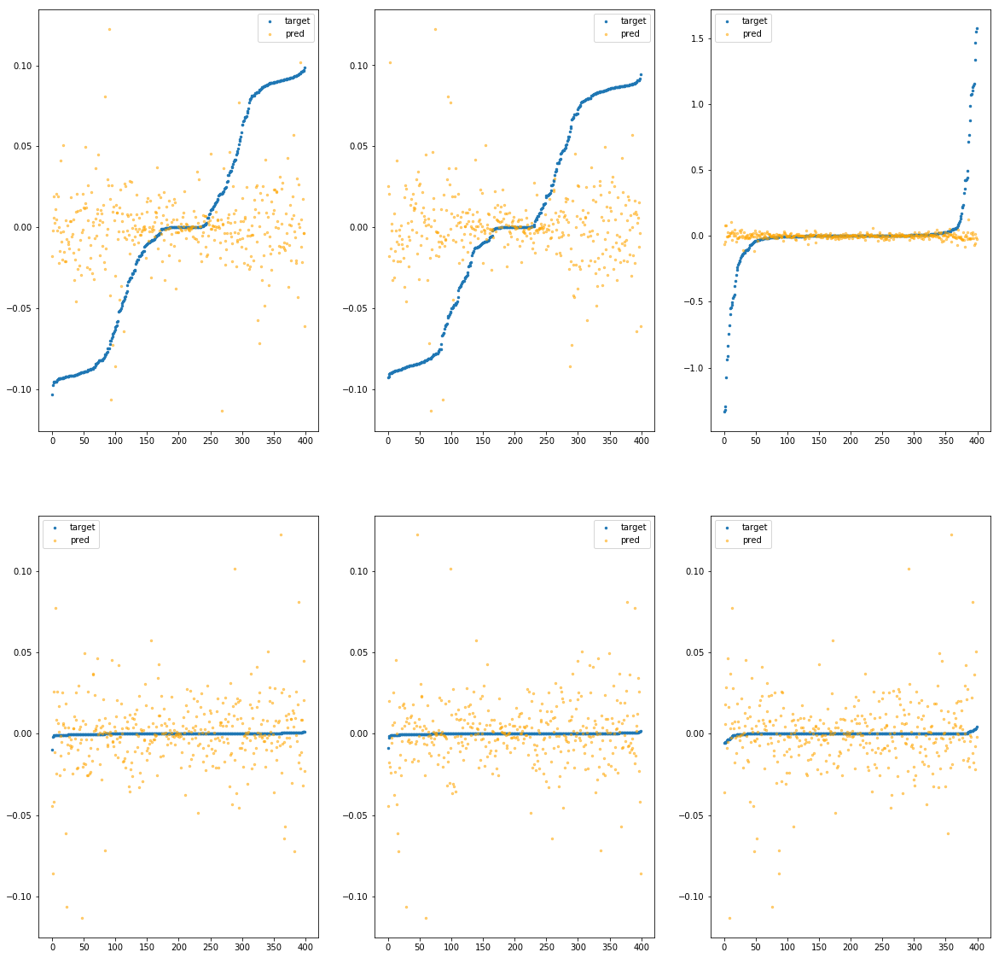

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfc30d0>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.04e-04	1.03e-01	5.17e-02	2.48e+02	4.09e-03	1.68e-05
y		-2.93e-03	9.43e-02	5.11e-02	1.35e+01	3.85e-03	1.48e-05
z		-7.51e-04	1.57e+00	1.02e-01	6.57e+00	8.34e-02	6.95e-03
phi		-4.12e-04	9.92e-03	2.29e-04	4.14e+04	3.62e-07	1.31e-13
theta		-3.03e-03	8.77e-03	2.20e-04	1.06e+04	3.10e-07	9.60e-14
psi		-5.56e-04	5.78e-03	2.78e-04	5.94e+03	7.50e-07	5.63e-13


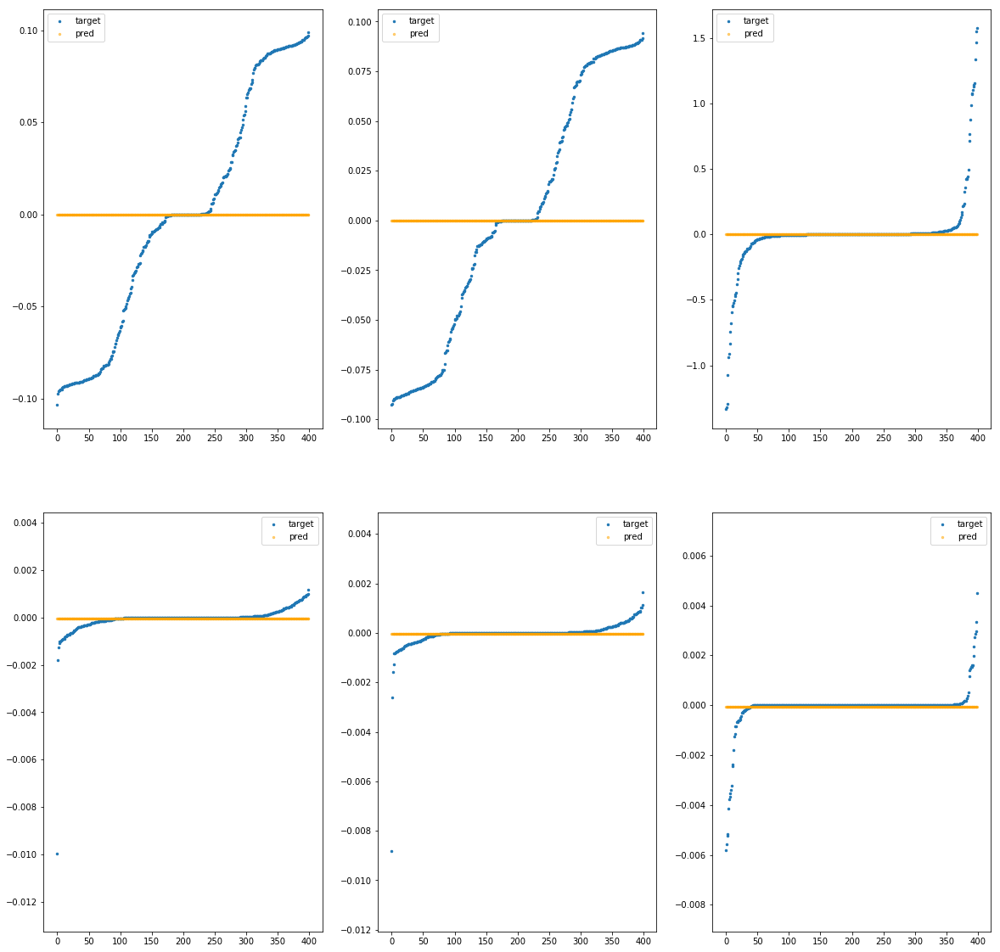

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfc3130>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.06e-04	1.03e-01	5.17e-02	2.13e+02	4.09e-03	1.68e-05
y		-2.92e-03	9.43e-02	5.11e-02	1.17e+01	3.85e-03	1.48e-05
z		-7.49e-04	1.57e+00	1.02e-01	5.75e+00	8.34e-02	6.95e-03
phi		-8.03e-05	9.93e-03	2.26e-04	3.56e+04	3.62e-07	1.31e-13
theta		-1.83e-03	8.78e-03	2.15e-04	9.08e+03	3.09e-07	9.58e-14
psi		-9.89e-04	5.79e-03	2.72e-04	5.10e+03	7.51e-07	5.64e-13


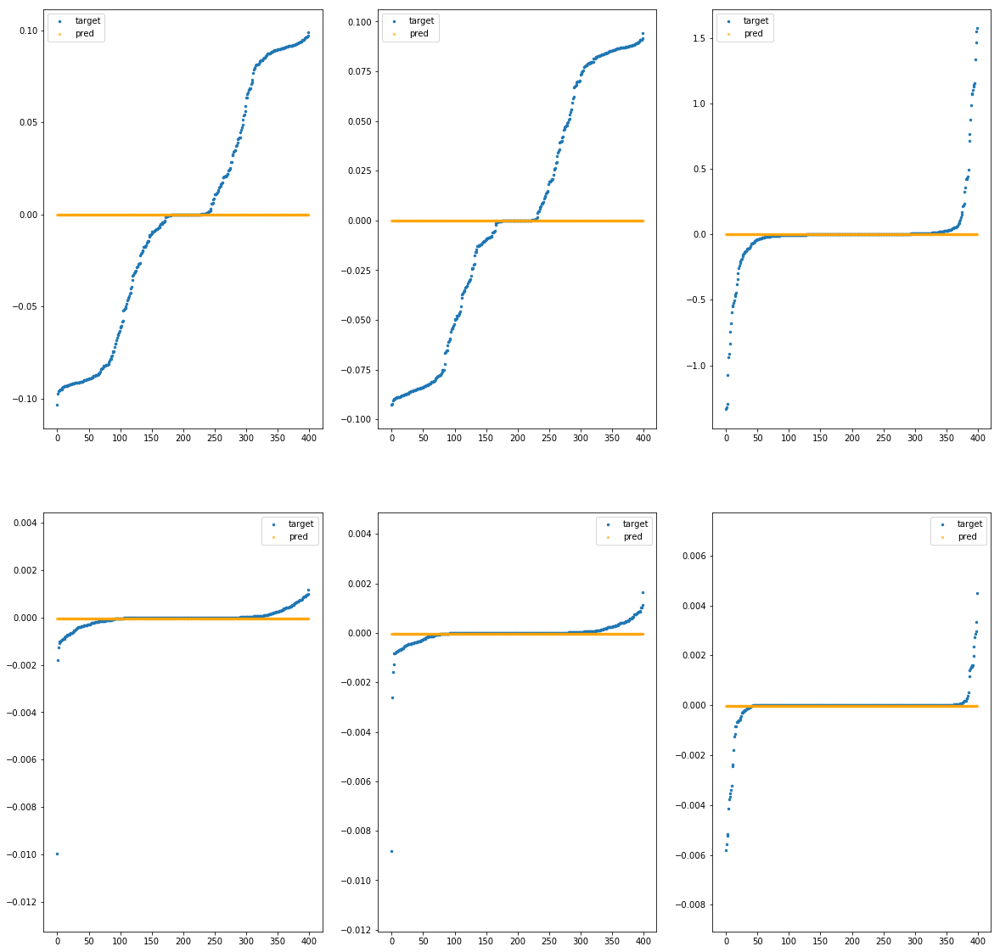

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfc3190>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e-04	1.03e-01	5.17e-02	2.23e+02	4.09e-03	1.68e-05
y		-2.92e-03	9.43e-02	5.11e-02	1.23e+01	3.85e-03	1.48e-05
z		-7.50e-04	1.57e+00	1.02e-01	6.00e+00	8.34e-02	6.95e-03
phi		-1.54e-04	9.93e-03	2.27e-04	3.74e+04	3.62e-07	1.31e-13
theta		-2.16e-03	8.78e-03	2.17e-04	9.53e+03	3.10e-07	9.58e-14
psi		-8.45e-04	5.79e-03	2.74e-04	5.35e+03	7.51e-07	5.63e-13


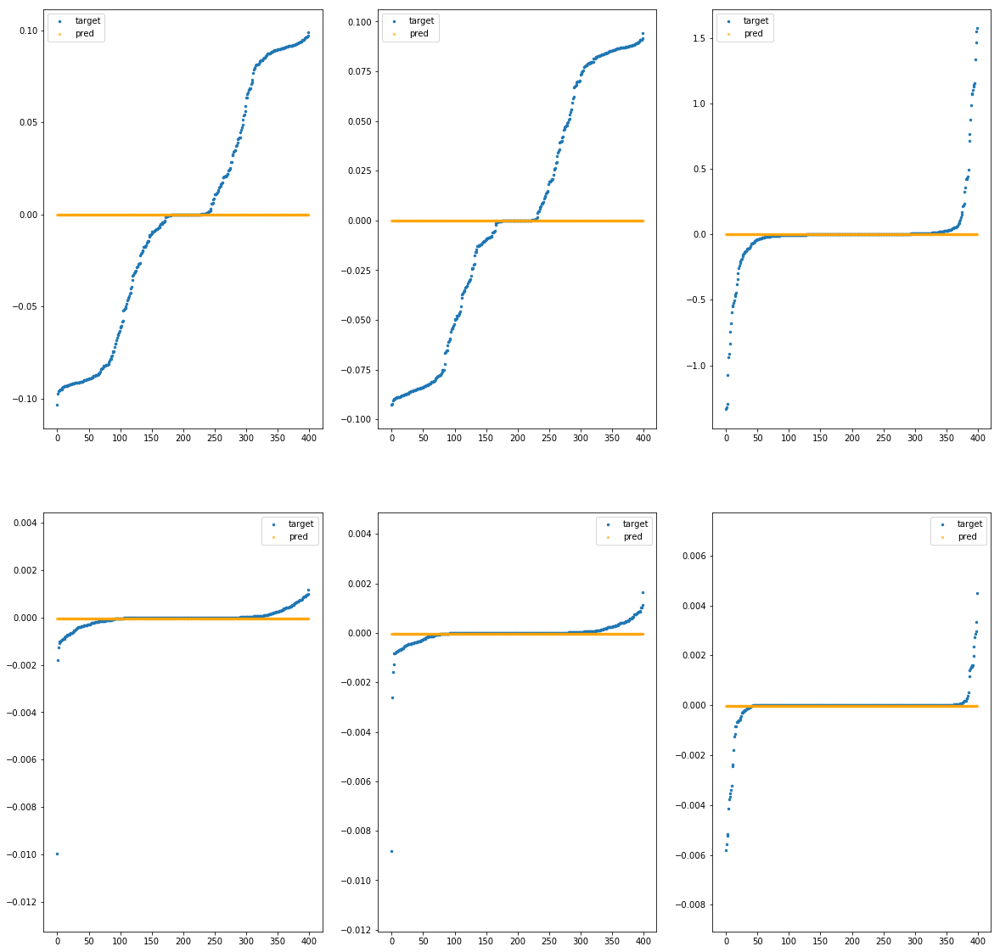

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfc31f0>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e-04	1.03e-01	5.17e-02	2.27e+02	4.09e-03	1.68e-05
y		-2.93e-03	9.43e-02	5.11e-02	1.24e+01	3.85e-03	1.48e-05
z		-7.50e-04	1.57e+00	1.02e-01	6.07e+00	8.34e-02	6.95e-03
phi		-1.79e-04	9.93e-03	2.27e-04	3.79e+04	3.62e-07	1.31e-13
theta		-2.26e-03	8.78e-03	2.17e-04	9.66e+03	3.10e-07	9.58e-14
psi		-8.05e-04	5.78e-03	2.74e-04	5.43e+03	7.51e-07	5.63e-13


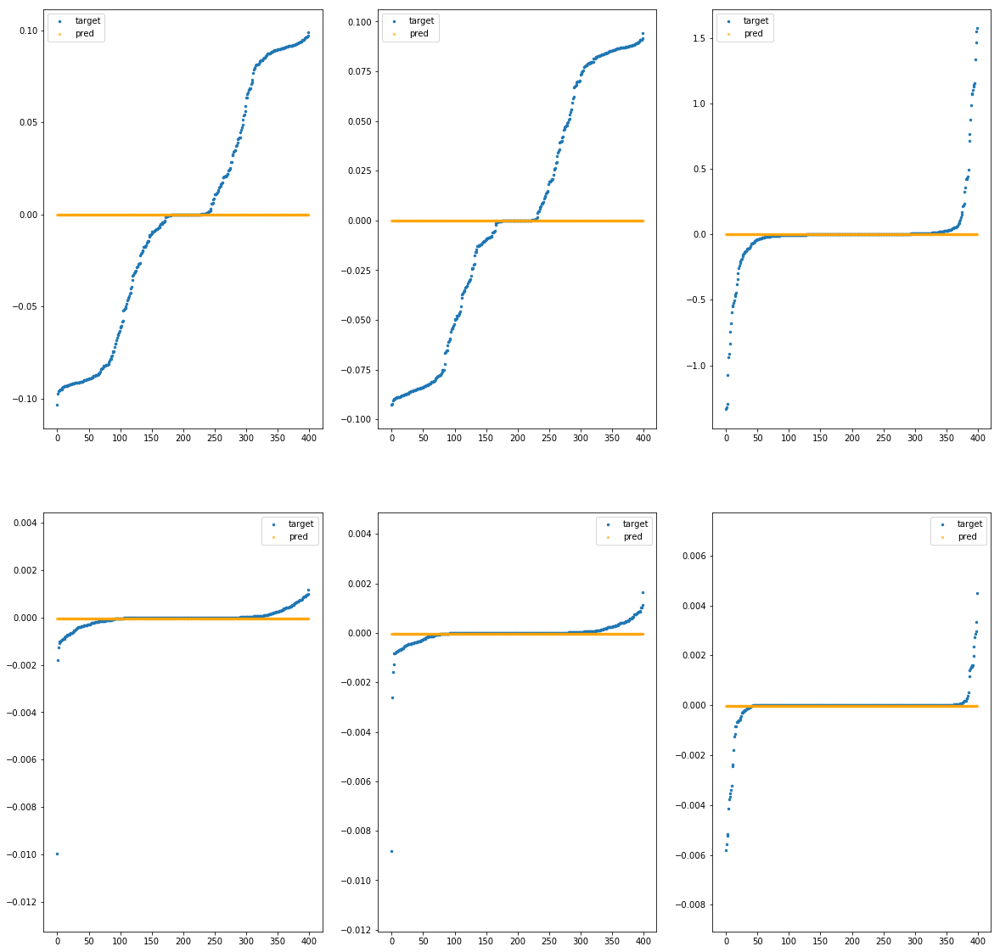

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfc3250>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.09e-04	1.03e-01	5.17e-02	1.73e+02	4.09e-03	1.68e-05
y		-2.91e-03	9.43e-02	5.11e-02	9.68e+00	3.85e-03	1.48e-05
z		-7.48e-04	1.57e+00	1.02e-01	4.81e+00	8.34e-02	6.95e-03
phi		-1.70e-05	9.94e-03	2.22e-04	2.89e+04	3.62e-07	1.31e-13
theta		-8.17e-04	8.79e-03	2.11e-04	7.36e+03	3.09e-07	9.56e-14
psi		-1.64e-03	5.80e-03	2.66e-04	4.14e+03	7.51e-07	5.64e-13


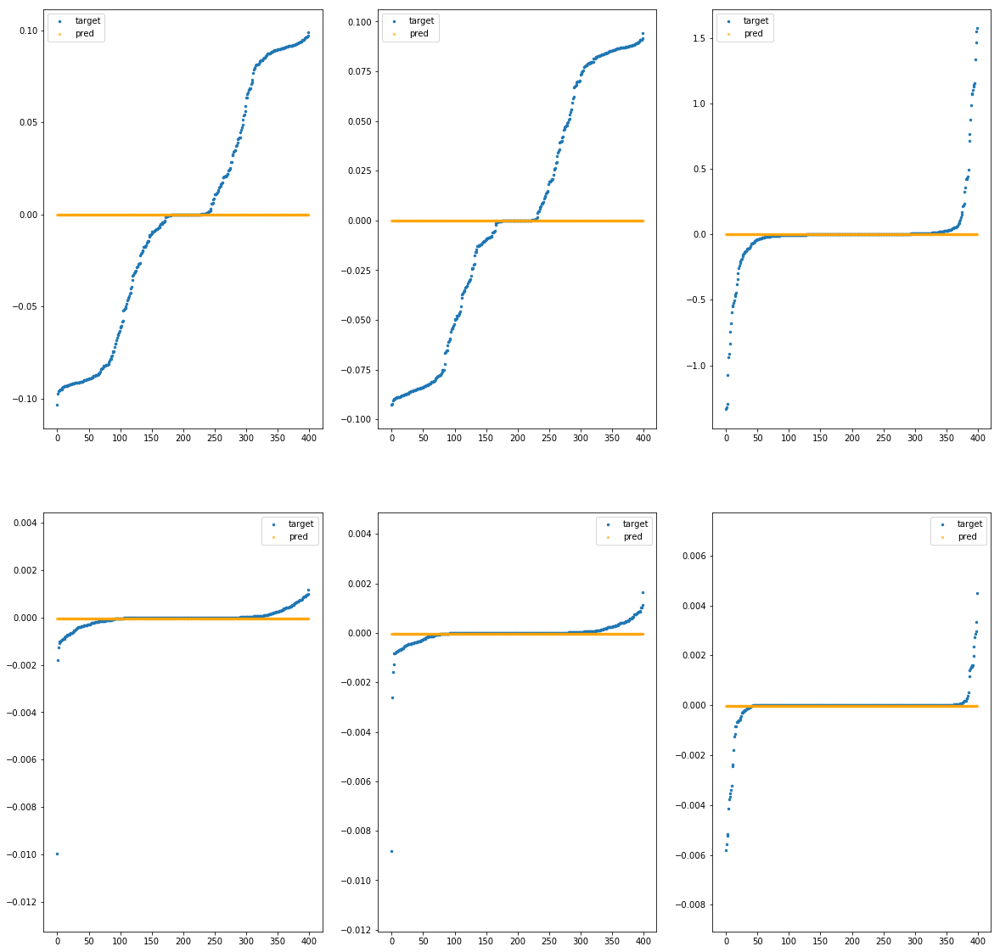

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfc32b0>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.08e-04	1.03e-01	5.17e-02	1.79e+02	4.09e-03	1.68e-05
y		-2.91e-03	9.43e-02	5.11e-02	9.98e+00	3.85e-03	1.48e-05
z		-7.48e-04	1.57e+00	1.02e-01	4.95e+00	8.34e-02	6.95e-03
phi		-4.72e-06	9.94e-03	2.22e-04	2.99e+04	3.62e-07	1.31e-13
theta		-9.42e-04	8.79e-03	2.11e-04	7.62e+03	3.09e-07	9.56e-14
psi		-1.54e-03	5.79e-03	2.67e-04	4.28e+03	7.51e-07	5.64e-13


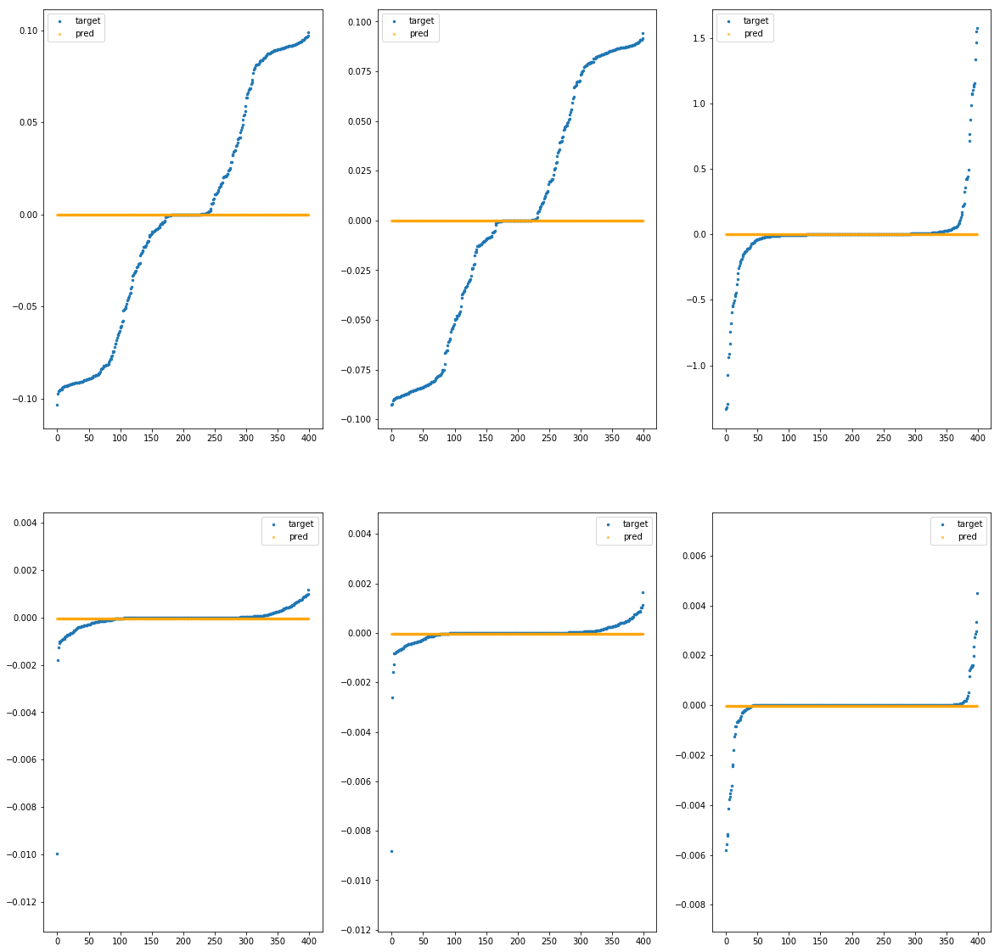

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfc3310>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e-04	1.03e-01	5.17e-02	2.24e+02	4.09e-03	1.68e-05
y		-2.92e-03	9.43e-02	5.11e-02	1.23e+01	3.85e-03	1.48e-05
z		-7.50e-04	1.57e+00	1.02e-01	6.01e+00	8.34e-02	6.95e-03
phi		-1.59e-04	9.93e-03	2.27e-04	3.75e+04	3.62e-07	1.31e-13
theta		-2.18e-03	8.78e-03	2.17e-04	9.55e+03	3.10e-07	9.58e-14
psi		-8.36e-04	5.79e-03	2.74e-04	5.37e+03	7.51e-07	5.63e-13


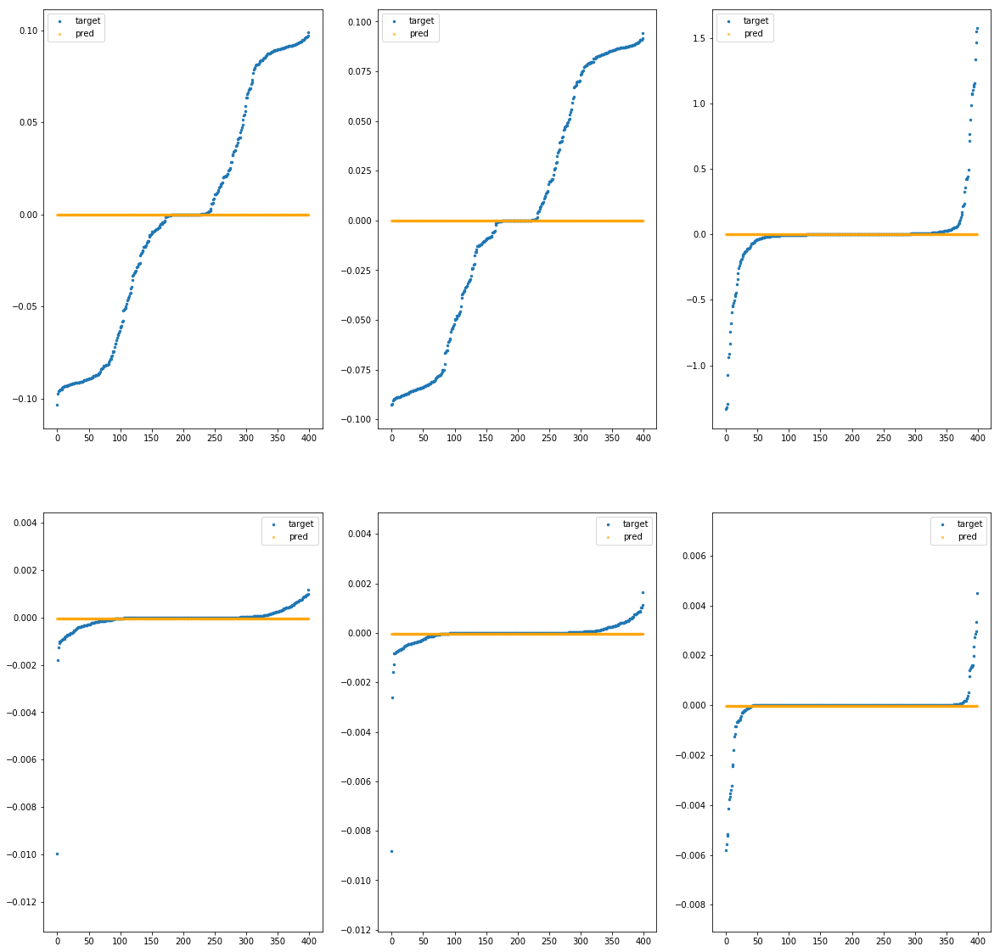

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfc3370>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e-04	1.03e-01	5.17e-02	2.33e+02	4.09e-03	1.68e-05
y		-2.93e-03	9.43e-02	5.11e-02	1.27e+01	3.85e-03	1.48e-05
z		-7.50e-04	1.57e+00	1.02e-01	6.21e+00	8.34e-02	6.95e-03
phi		-2.36e-04	9.93e-03	2.28e-04	3.89e+04	3.62e-07	1.31e-13
theta		-2.47e-03	8.78e-03	2.18e-04	9.91e+03	3.10e-07	9.59e-14
psi		-7.30e-04	5.78e-03	2.75e-04	5.57e+03	7.51e-07	5.63e-13


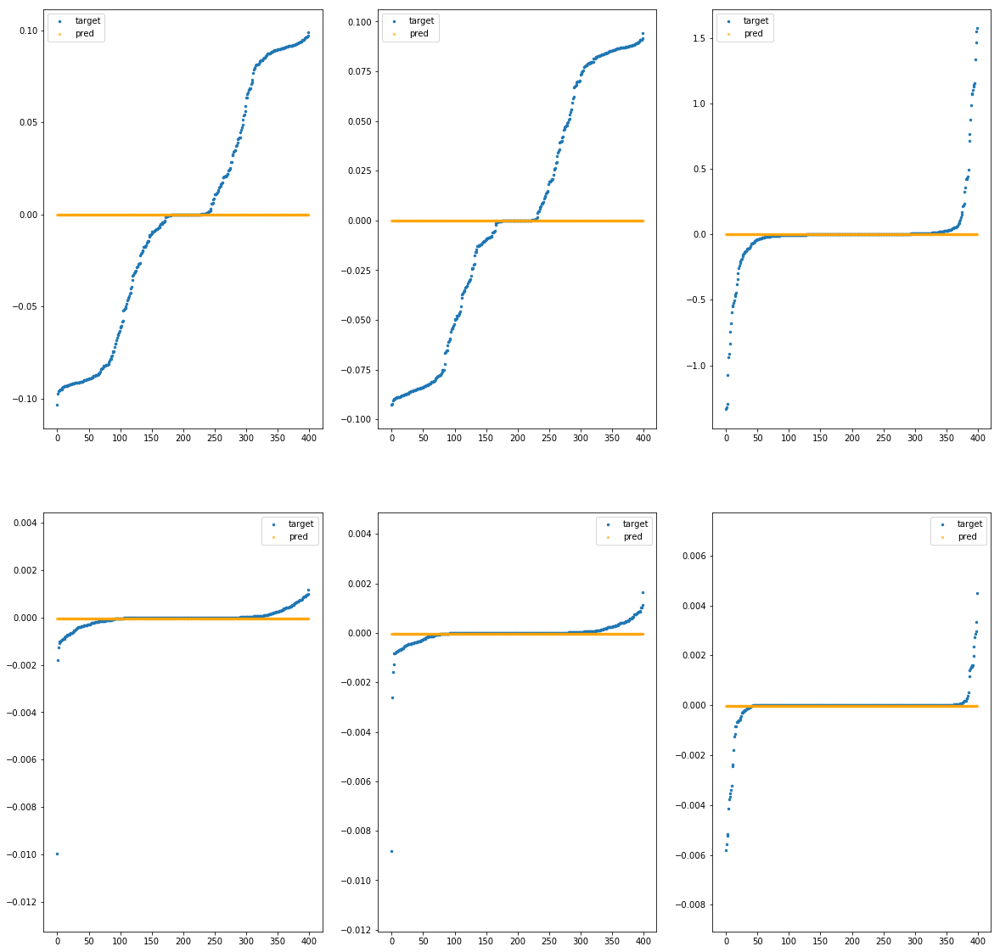

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfc33d0>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e-04	1.03e-01	5.17e-02	2.27e+02	4.09e-03	1.68e-05
y		-2.93e-03	9.43e-02	5.11e-02	1.24e+01	3.85e-03	1.48e-05
z		-7.50e-04	1.57e+00	1.02e-01	6.08e+00	8.34e-02	6.95e-03
phi		-1.84e-04	9.93e-03	2.27e-04	3.80e+04	3.62e-07	1.31e-13
theta		-2.28e-03	8.78e-03	2.17e-04	9.68e+03	3.10e-07	9.58e-14
psi		-7.99e-04	5.78e-03	2.74e-04	5.44e+03	7.51e-07	5.63e-13


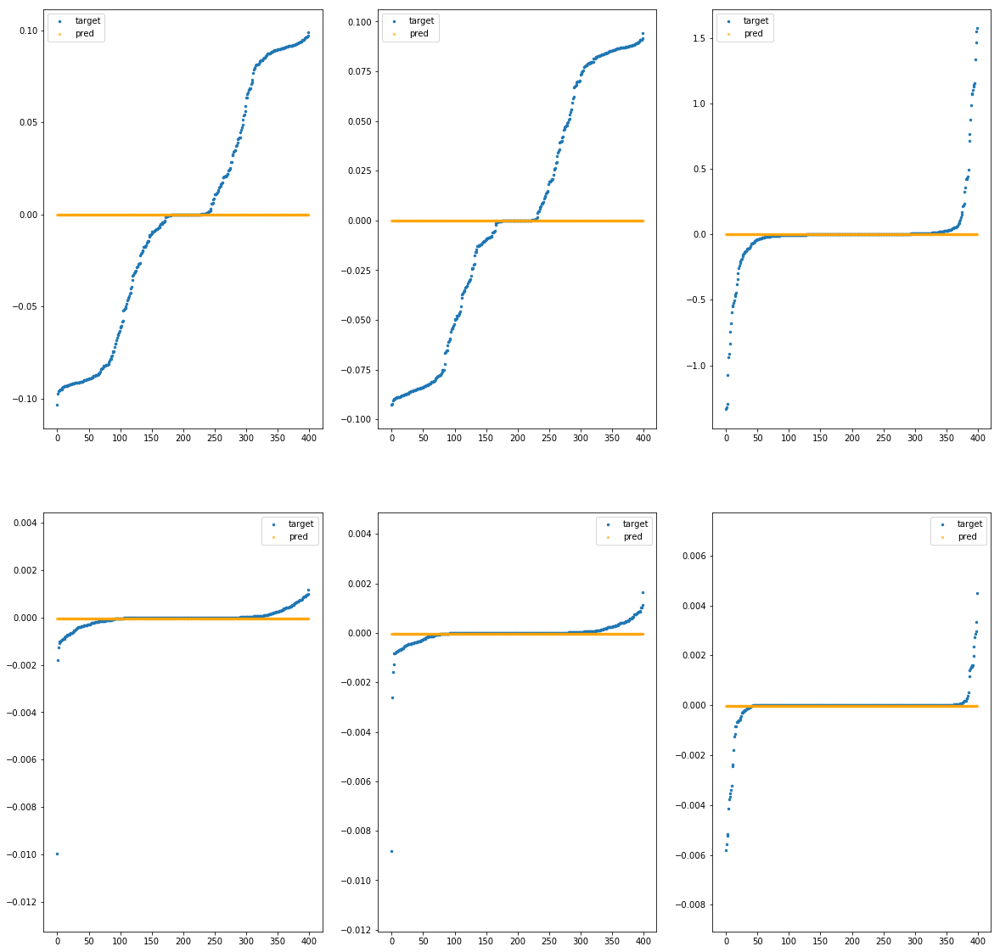

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfc3430>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e-04	1.03e-01	5.17e-02	2.25e+02	4.09e-03	1.68e-05
y		-2.93e-03	9.43e-02	5.11e-02	1.23e+01	3.85e-03	1.48e-05
z		-7.50e-04	1.57e+00	1.02e-01	6.03e+00	8.34e-02	6.95e-03
phi		-1.65e-04	9.93e-03	2.27e-04	3.76e+04	3.62e-07	1.31e-13
theta		-2.20e-03	8.78e-03	2.17e-04	9.58e+03	3.10e-07	9.58e-14
psi		-8.28e-04	5.79e-03	2.74e-04	5.39e+03	7.51e-07	5.63e-13


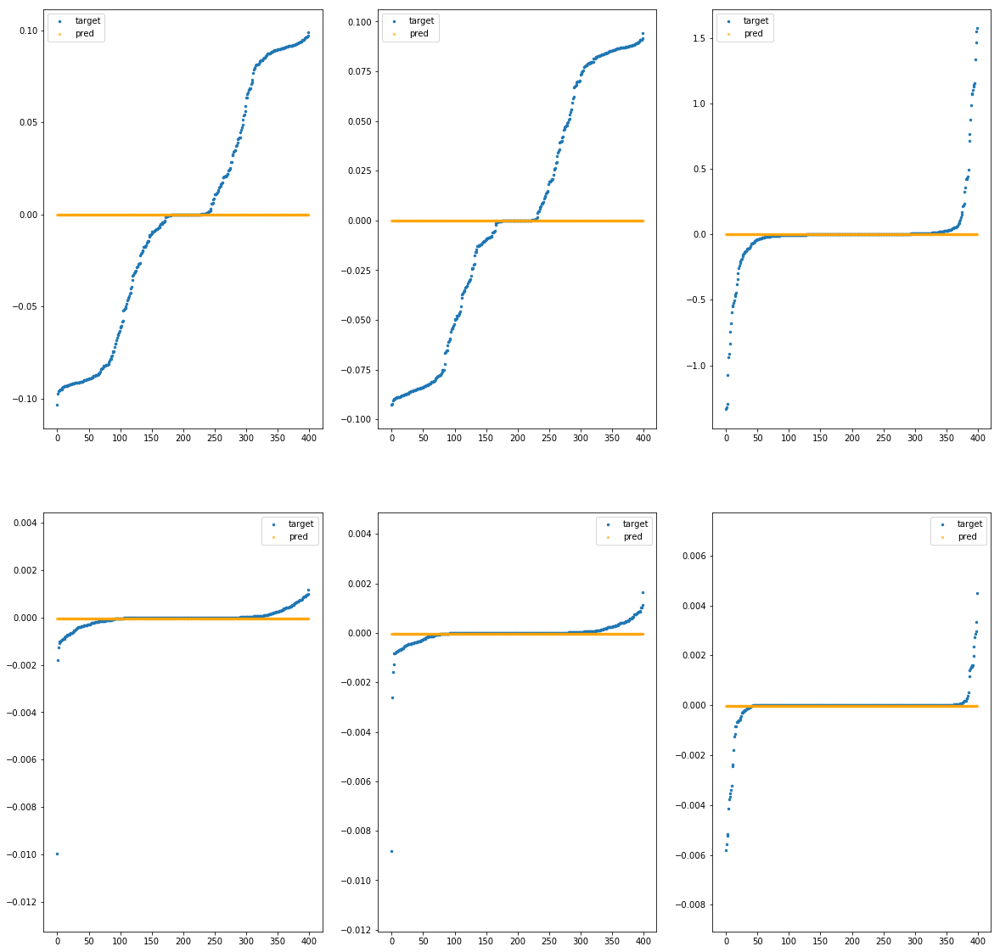

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfc3490>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.07e-04	1.03e-01	5.17e-02	1.91e+02	4.09e-03	1.68e-05
y		-2.91e-03	9.43e-02	5.11e-02	1.06e+01	3.85e-03	1.48e-05
z		-7.48e-04	1.57e+00	1.02e-01	5.24e+00	8.34e-02	6.95e-03
phi		-3.55e-06	9.94e-03	2.24e-04	3.20e+04	3.62e-07	1.31e-13
theta		-1.23e-03	8.79e-03	2.13e-04	8.15e+03	3.09e-07	9.56e-14
psi		-1.32e-03	5.79e-03	2.69e-04	4.58e+03	7.51e-07	5.64e-13


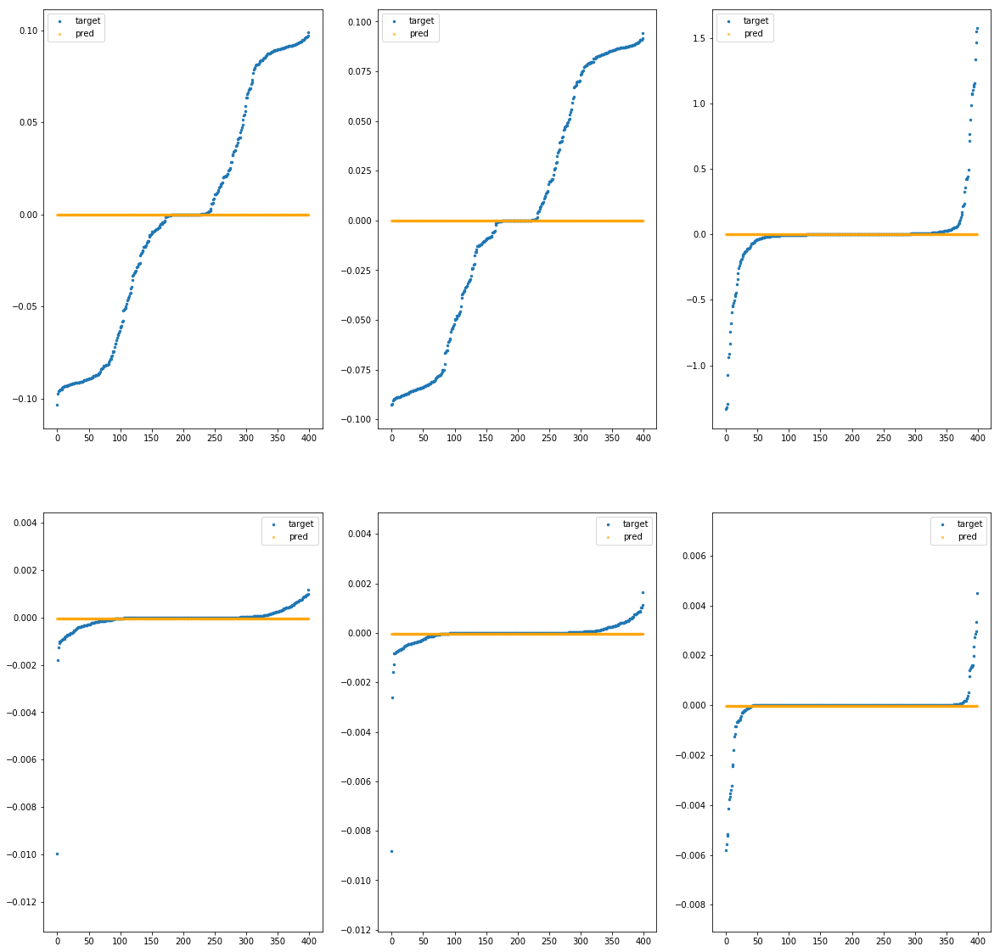

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfc34f0>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e-04	1.03e-01	5.17e-02	2.23e+02	4.09e-03	1.68e-05
y		-2.92e-03	9.43e-02	5.11e-02	1.22e+01	3.85e-03	1.48e-05
z		-7.50e-04	1.57e+00	1.02e-01	5.99e+00	8.34e-02	6.95e-03
phi		-1.49e-04	9.93e-03	2.27e-04	3.73e+04	3.62e-07	1.31e-13
theta		-2.14e-03	8.78e-03	2.17e-04	9.50e+03	3.10e-07	9.58e-14
psi		-8.53e-04	5.79e-03	2.74e-04	5.34e+03	7.51e-07	5.63e-13


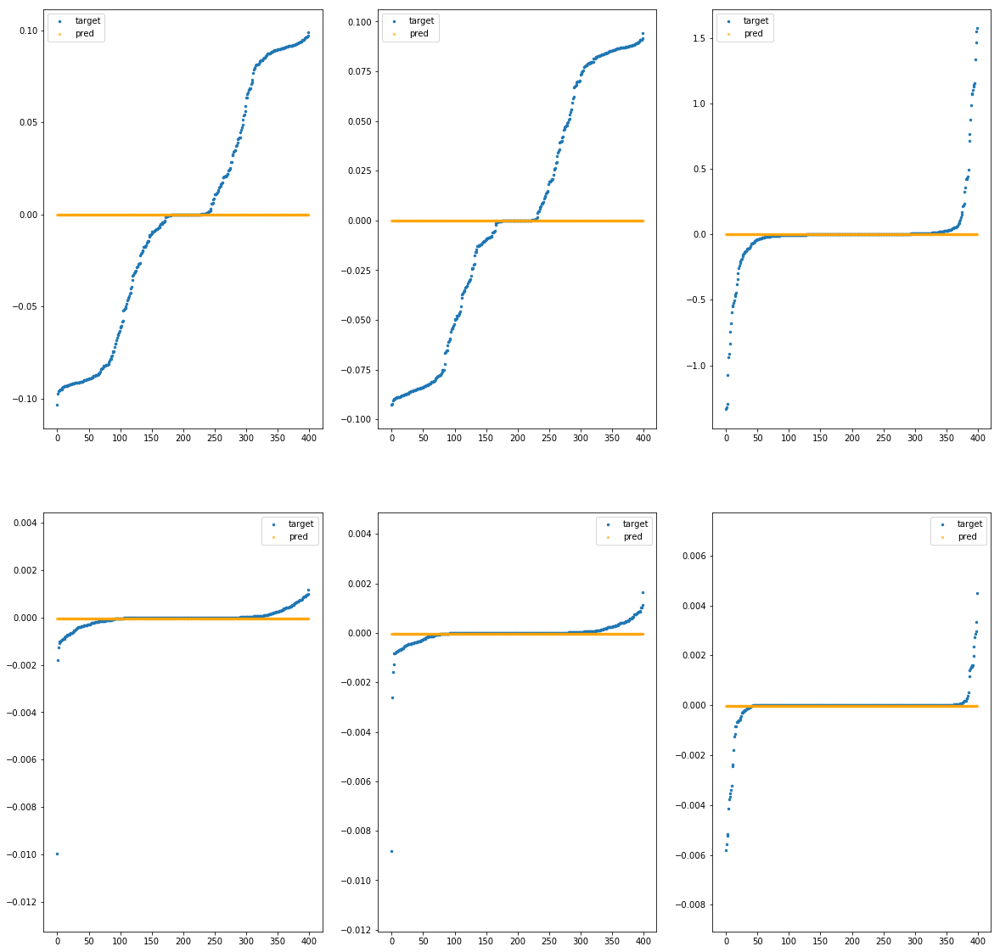

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfc3550>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e-04	1.03e-01	5.17e-02	2.28e+02	4.09e-03	1.68e-05
y		-2.93e-03	9.43e-02	5.11e-02	1.25e+01	3.85e-03	1.48e-05
z		-7.50e-04	1.57e+00	1.02e-01	6.11e+00	8.34e-02	6.95e-03
phi		-1.95e-04	9.93e-03	2.27e-04	3.82e+04	3.62e-07	1.31e-13
theta		-2.32e-03	8.78e-03	2.17e-04	9.73e+03	3.10e-07	9.58e-14
psi		-7.82e-04	5.78e-03	2.75e-04	5.47e+03	7.51e-07	5.63e-13


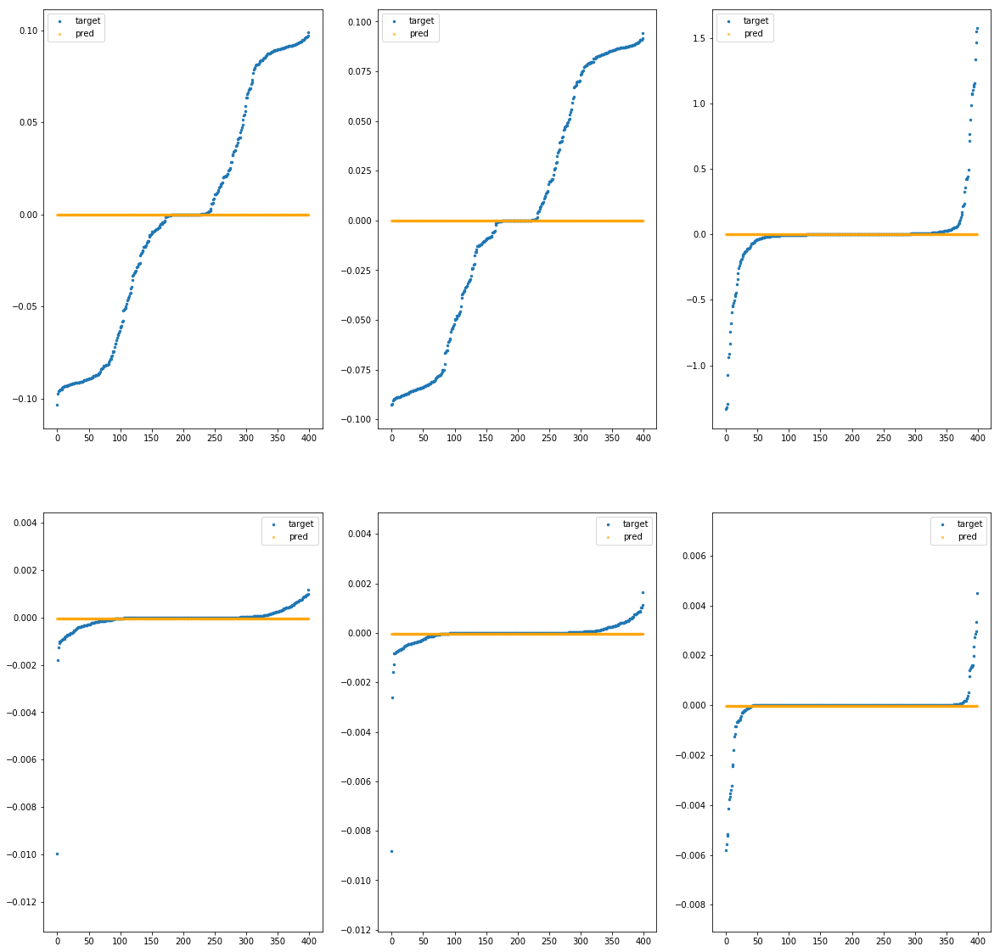

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfc35b0>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.06e-04	1.03e-01	5.17e-02	2.16e+02	4.09e-03	1.68e-05
y		-2.92e-03	9.43e-02	5.11e-02	1.19e+01	3.85e-03	1.48e-05
z		-7.49e-04	1.57e+00	1.02e-01	5.82e+00	8.34e-02	6.95e-03
phi		-9.76e-05	9.93e-03	2.26e-04	3.61e+04	3.62e-07	1.31e-13
theta		-1.91e-03	8.78e-03	2.16e-04	9.20e+03	3.09e-07	9.58e-14
psi		-9.50e-04	5.79e-03	2.73e-04	5.17e+03	7.51e-07	5.64e-13


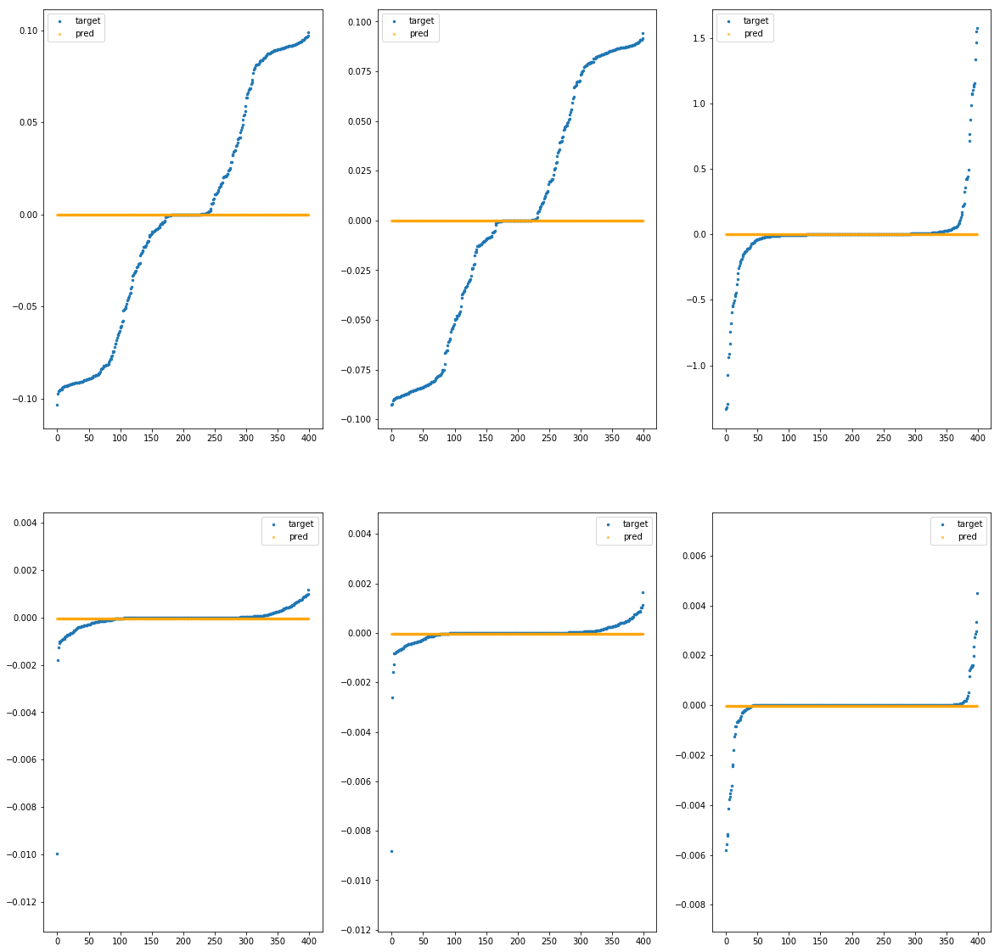

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfc3610>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e-04	1.03e-01	5.17e-02	2.31e+02	4.09e-03	1.68e-05
y		-2.93e-03	9.43e-02	5.11e-02	1.26e+01	3.85e-03	1.48e-05
z		-7.50e-04	1.57e+00	1.02e-01	6.17e+00	8.34e-02	6.95e-03
phi		-2.16e-04	9.93e-03	2.28e-04	3.86e+04	3.62e-07	1.31e-13
theta		-2.40e-03	8.78e-03	2.17e-04	9.83e+03	3.10e-07	9.59e-14
psi		-7.54e-04	5.78e-03	2.75e-04	5.52e+03	7.51e-07	5.63e-13


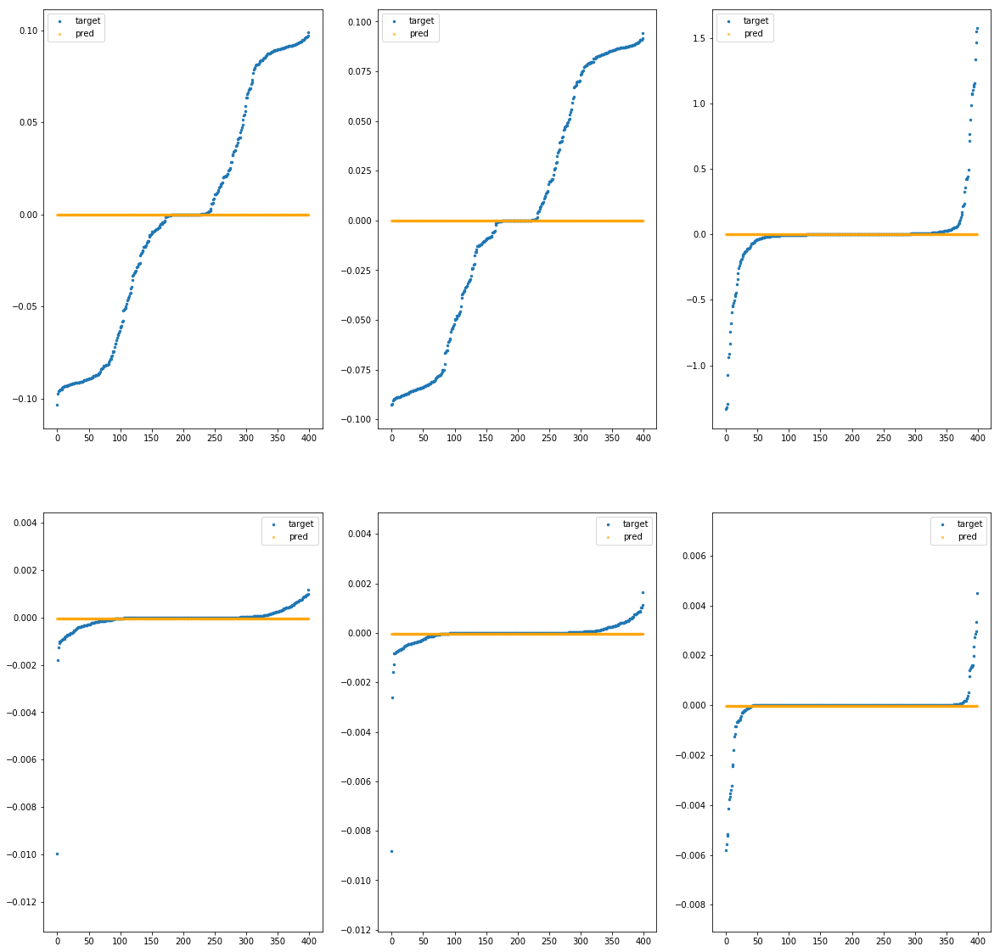

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfc3670>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e-04	1.03e-01	5.17e-02	2.33e+02	4.09e-03	1.68e-05
y		-2.93e-03	9.43e-02	5.11e-02	1.28e+01	3.85e-03	1.48e-05
z		-7.50e-04	1.57e+00	1.02e-01	6.23e+00	8.34e-02	6.95e-03
phi		-2.43e-04	9.93e-03	2.28e-04	3.90e+04	3.62e-07	1.31e-13
theta		-2.49e-03	8.78e-03	2.18e-04	9.94e+03	3.10e-07	9.59e-14
psi		-7.21e-04	5.78e-03	2.75e-04	5.59e+03	7.51e-07	5.63e-13


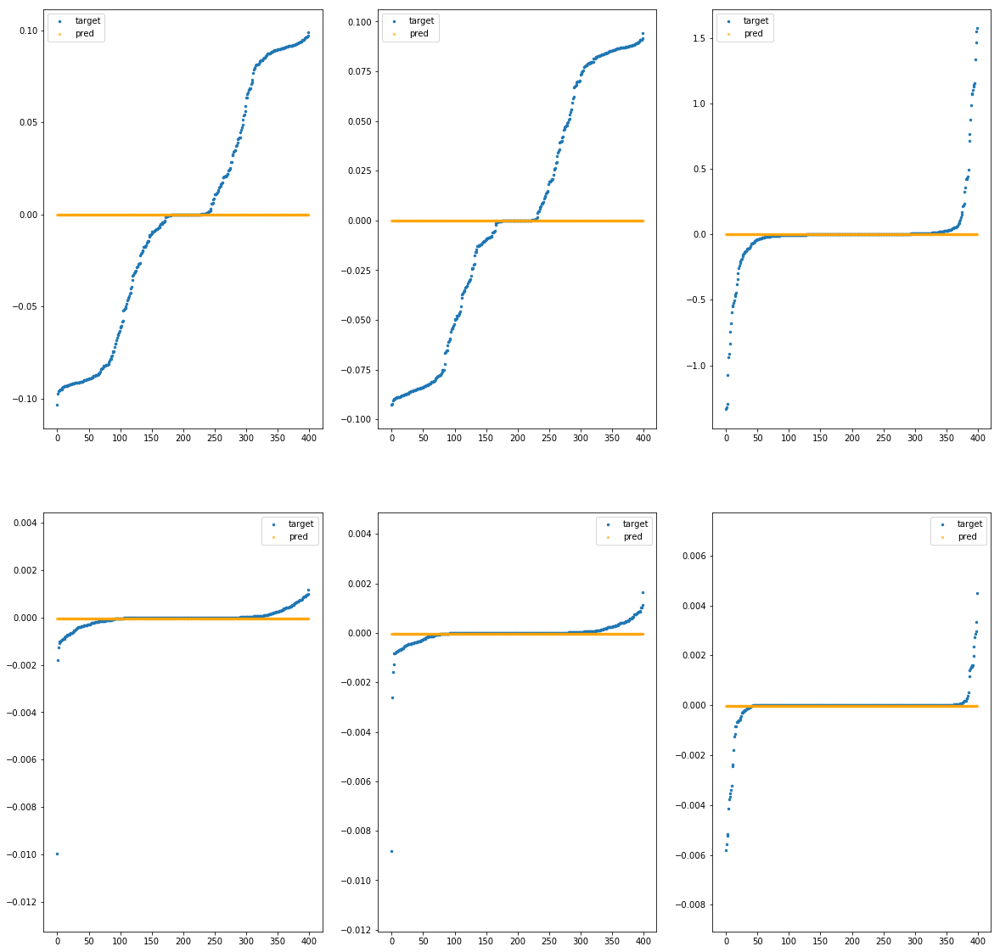

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfc36d0>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e-04	1.03e-01	5.17e-02	2.34e+02	4.09e-03	1.68e-05
y		-2.93e-03	9.43e-02	5.11e-02	1.28e+01	3.85e-03	1.48e-05
z		-7.50e-04	1.57e+00	1.02e-01	6.25e+00	8.34e-02	6.95e-03
phi		-2.53e-04	9.93e-03	2.28e-04	3.92e+04	3.62e-07	1.31e-13
theta		-2.53e-03	8.78e-03	2.18e-04	9.99e+03	3.10e-07	9.59e-14
psi		-7.09e-04	5.78e-03	2.76e-04	5.61e+03	7.51e-07	5.63e-13


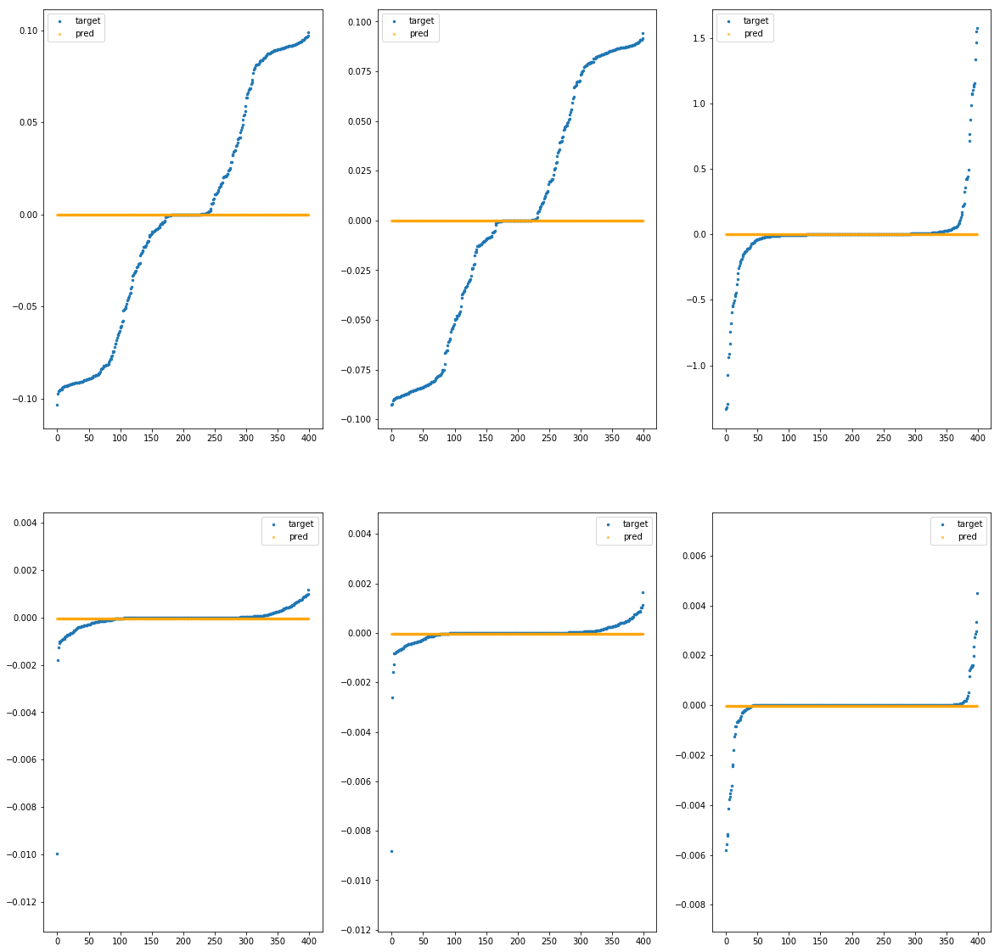

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfc3730>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.06e-04	1.03e-01	5.17e-02	2.16e+02	4.09e-03	1.68e-05
y		-2.92e-03	9.43e-02	5.11e-02	1.19e+01	3.85e-03	1.48e-05
z		-7.49e-04	1.57e+00	1.02e-01	5.83e+00	8.34e-02	6.95e-03
phi		-1.01e-04	9.93e-03	2.26e-04	3.62e+04	3.62e-07	1.31e-13
theta		-1.93e-03	8.78e-03	2.16e-04	9.22e+03	3.09e-07	9.58e-14
psi		-9.43e-04	5.79e-03	2.73e-04	5.18e+03	7.51e-07	5.64e-13


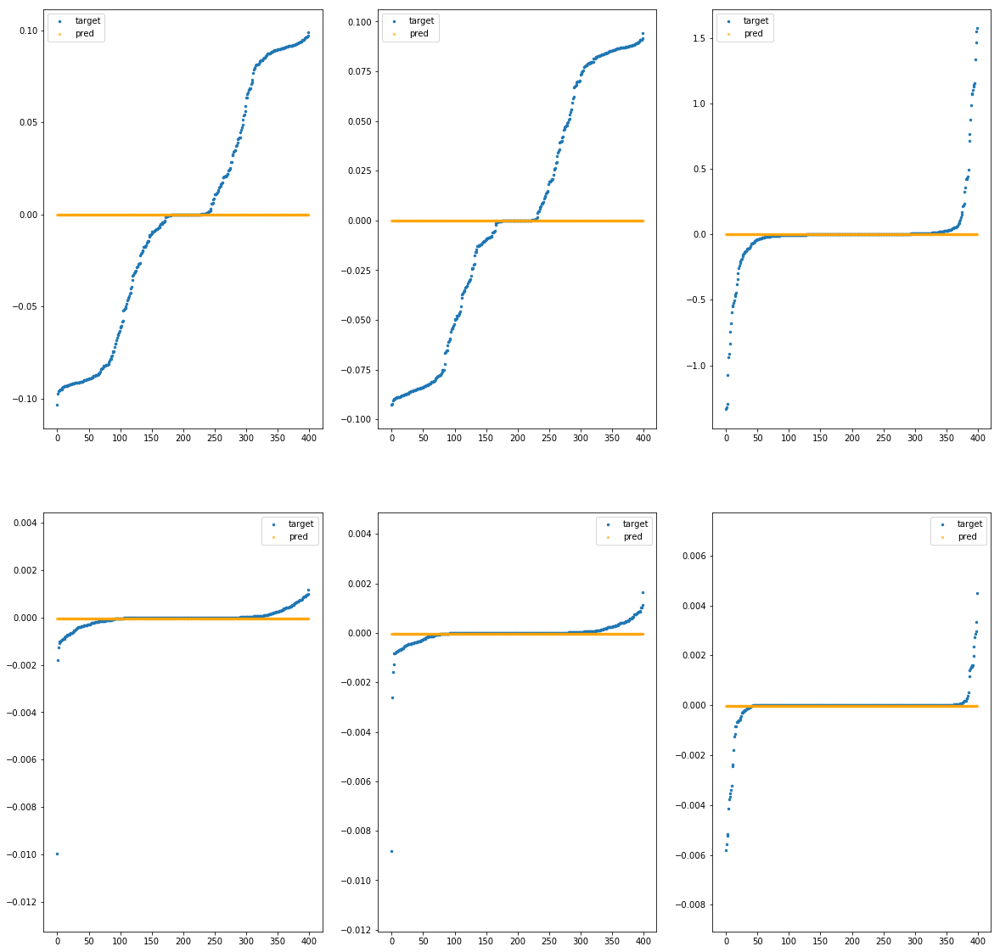

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfc3790>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e-04	1.03e-01	5.17e-02	2.29e+02	4.09e-03	1.68e-05
y		-2.93e-03	9.43e-02	5.11e-02	1.25e+01	3.85e-03	1.48e-05
z		-7.50e-04	1.57e+00	1.02e-01	6.12e+00	8.34e-02	6.95e-03
phi		-1.98e-04	9.93e-03	2.27e-04	3.82e+04	3.62e-07	1.31e-13
theta		-2.33e-03	8.78e-03	2.17e-04	9.75e+03	3.10e-07	9.58e-14
psi		-7.79e-04	5.78e-03	2.75e-04	5.48e+03	7.51e-07	5.63e-13


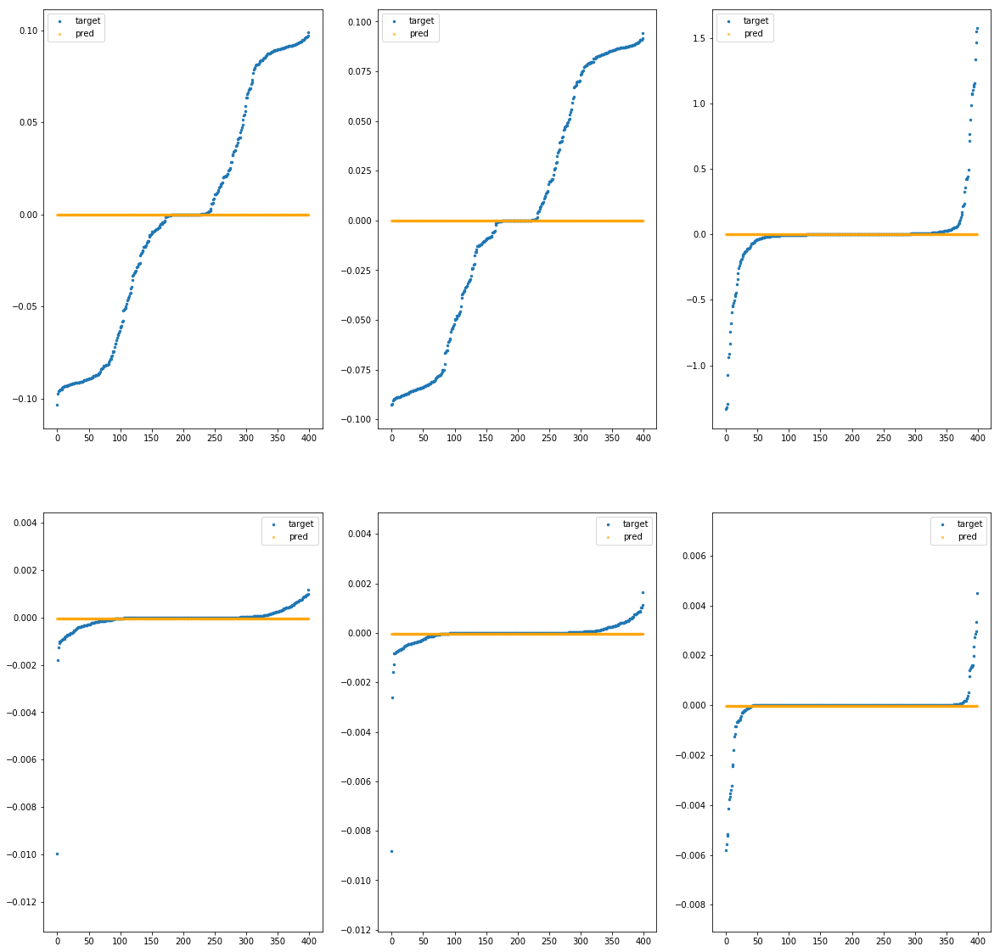

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfc37f0>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e-04	1.03e-01	5.17e-02	2.28e+02	4.09e-03	1.68e-05
y		-2.93e-03	9.43e-02	5.11e-02	1.25e+01	3.85e-03	1.48e-05
z		-7.50e-04	1.57e+00	1.02e-01	6.10e+00	8.34e-02	6.95e-03
phi		-1.92e-04	9.93e-03	2.27e-04	3.81e+04	3.62e-07	1.31e-13
theta		-2.31e-03	8.78e-03	2.17e-04	9.72e+03	3.10e-07	9.58e-14
psi		-7.87e-04	5.78e-03	2.75e-04	5.46e+03	7.51e-07	5.63e-13


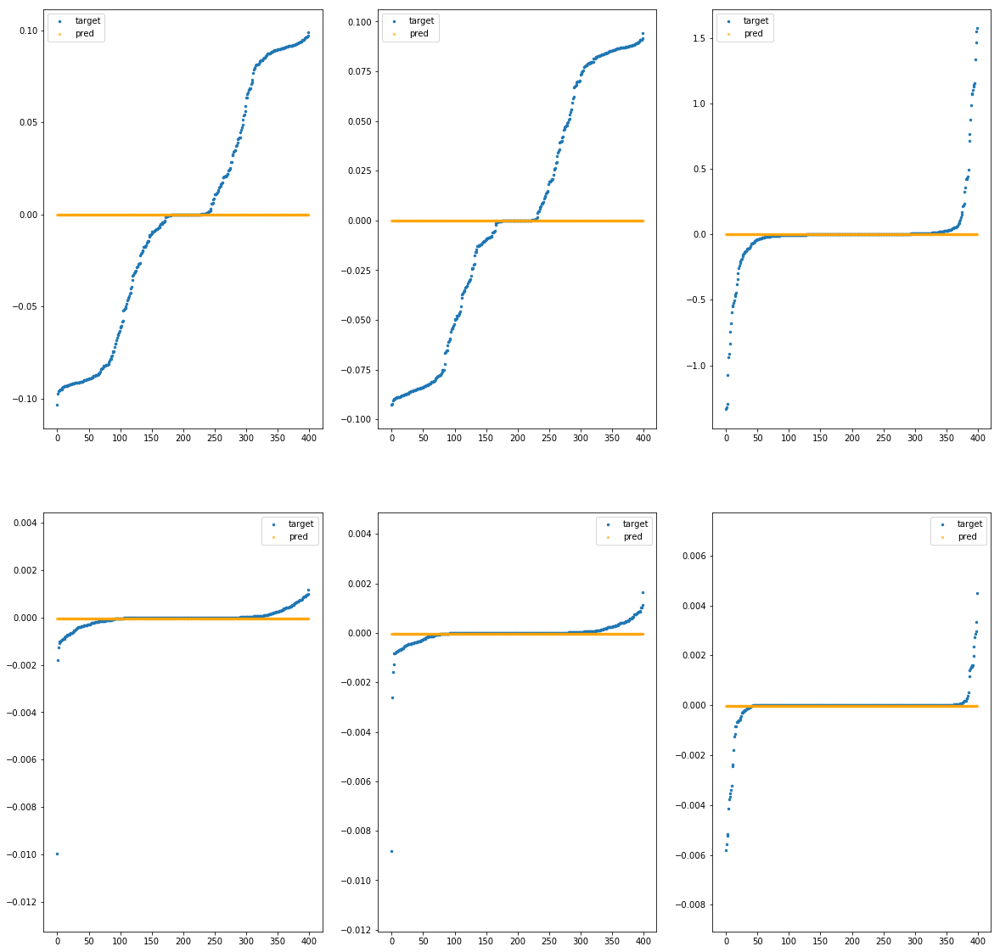

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa99bfc3850>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.86e-02	6.57e-01	2.13e-01	3.47e+03	6.98e-02	4.87e-03
y		-1.09e-01	6.51e-01	1.93e-01	8.02e+02	6.08e-02	3.69e-03
z		2.38e-02	6.19e+00	2.95e-01	7.48e+02	8.54e-01	7.29e-01
phi		-3.04e+03	3.17e-01	5.15e-02	1.72e+06	5.66e-03	3.20e-05
theta		-4.47e+03	3.17e-01	5.17e-02	9.65e+05	5.67e-03	3.22e-05
psi		-2.34e+02	3.65e-01	5.18e-02	1.19e+06	5.75e-03	3.31e-05


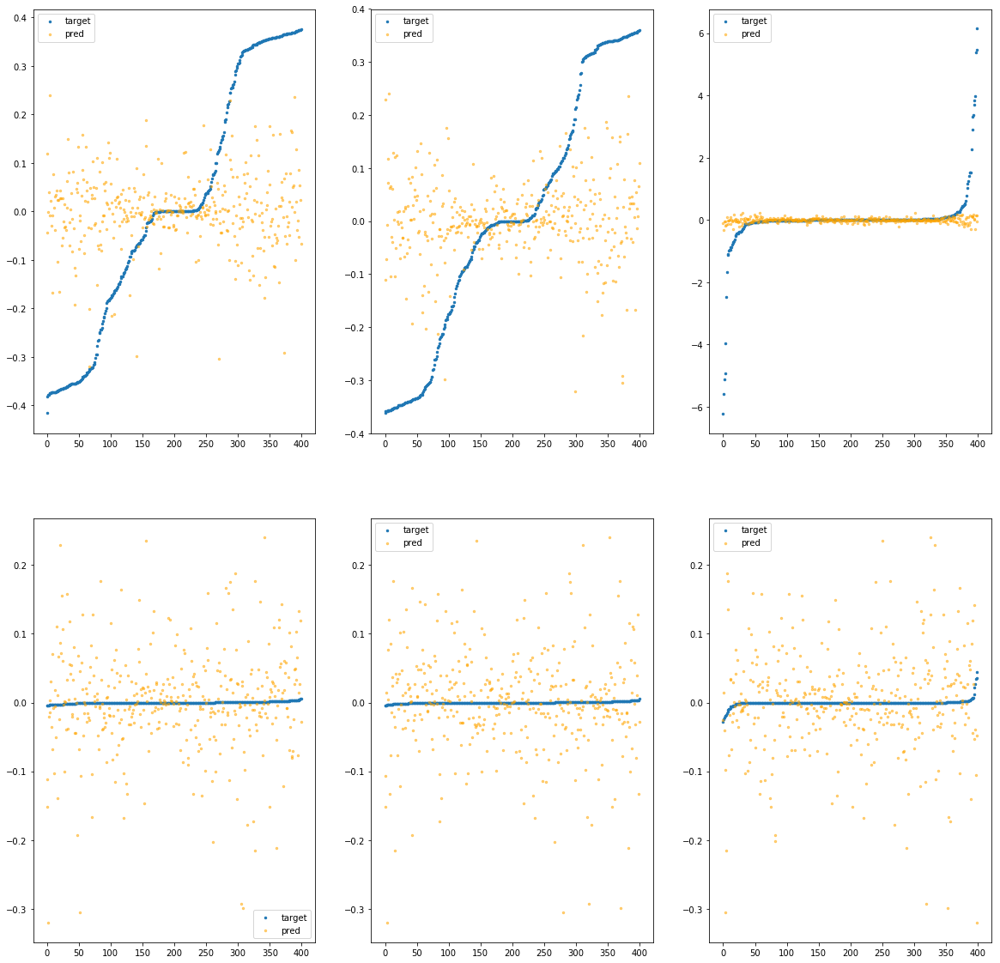

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa99bfc38b0>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.11e-01	7.48e-01	2.13e-01	4.35e+03	7.12e-02	5.08e-03
y		-1.97e-01	7.05e-01	2.01e-01	1.00e+03	6.56e-02	4.31e-03
z		-1.39e-02	6.20e+00	3.12e-01	1.12e+03	8.87e-01	7.87e-01
phi		-5.47e+03	5.28e-01	6.61e-02	1.92e+06	1.02e-02	1.04e-04
theta		-8.00e+03	5.28e-01	6.61e-02	6.21e+05	1.02e-02	1.03e-04
psi		-4.17e+02	5.28e-01	6.62e-02	1.56e+06	1.03e-02	1.05e-04


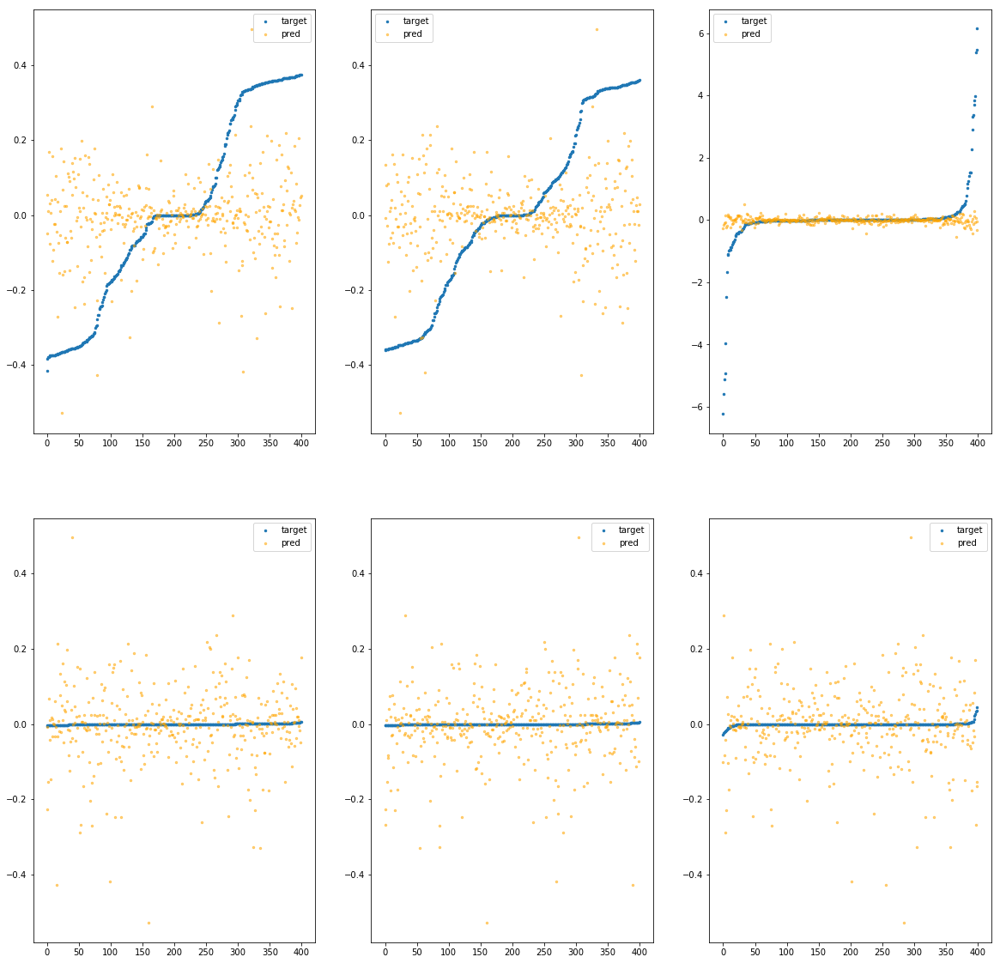

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa99bfc3910>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.69e-02	7.24e-01	2.13e-01	4.13e+03	6.90e-02	4.77e-03
y		-1.37e-01	7.05e-01	2.00e-01	1.38e+03	6.23e-02	3.89e-03
z		-2.20e-03	6.13e+00	3.01e-01	5.86e+02	8.77e-01	7.69e-01
phi		-3.21e+03	3.63e-01	5.36e-02	1.62e+06	5.97e-03	3.57e-05
theta		-4.71e+03	3.63e-01	5.36e-02	8.70e+05	5.98e-03	3.58e-05
psi		-2.45e+02	3.62e-01	5.39e-02	1.38e+06	6.04e-03	3.64e-05


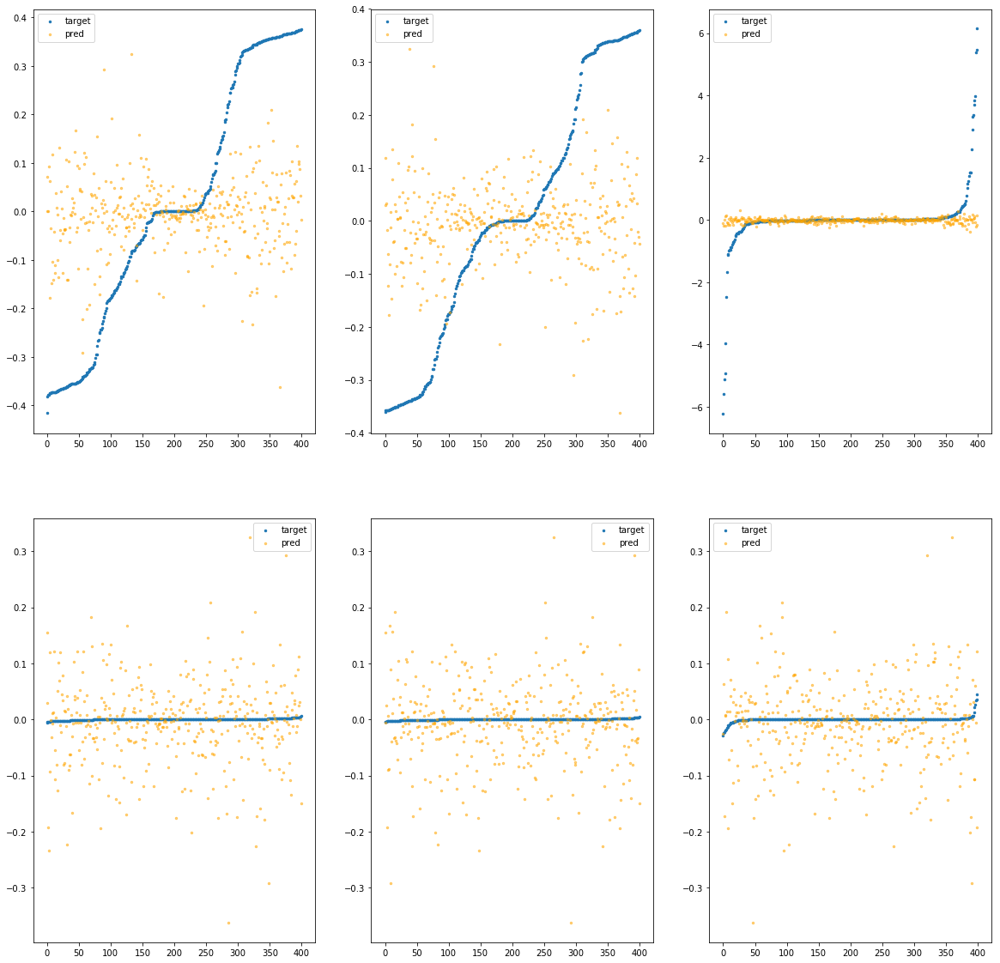

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa99bfc3970>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.57e-02	6.29e-01	2.09e-01	4.70e+03	6.77e-02	4.58e-03
y		-1.10e-01	6.65e-01	1.94e-01	1.21e+03	6.09e-02	3.70e-03
z		2.00e-03	6.12e+00	2.99e-01	9.59e+02	8.73e-01	7.62e-01
phi		-3.15e+03	3.41e-01	5.09e-02	2.07e+06	5.86e-03	3.44e-05
theta		-4.62e+03	3.42e-01	5.09e-02	7.21e+05	5.87e-03	3.44e-05
psi		-2.37e+02	3.41e-01	5.08e-02	7.00e+05	5.83e-03	3.40e-05


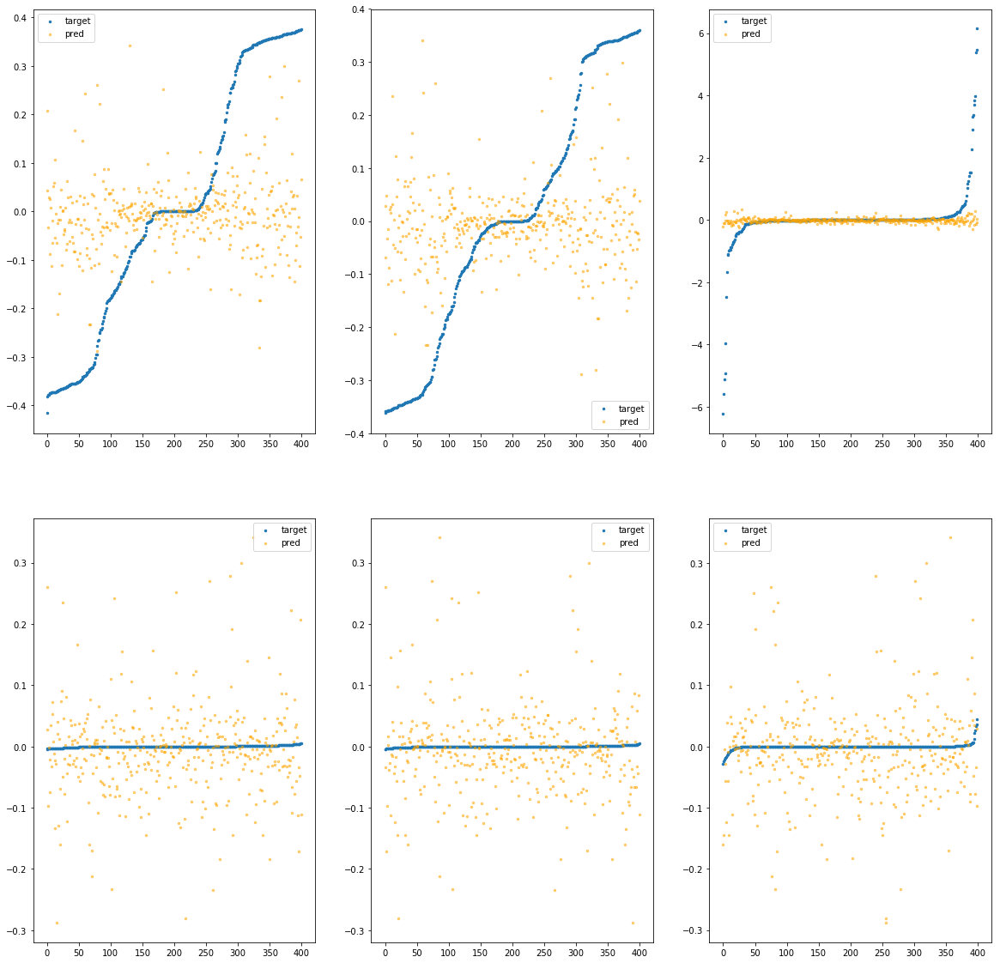

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa99bfc39d0>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.80e-01	7.19e-01	2.20e-01	6.00e+03	7.56e-02	5.72e-03
y		-1.47e-01	7.32e-01	1.99e-01	1.49e+03	6.29e-02	3.95e-03
z		-1.22e-03	6.31e+00	3.04e-01	7.89e+02	8.76e-01	7.67e-01
phi		-4.26e+03	3.88e-01	6.24e-02	2.49e+06	7.94e-03	6.30e-05
theta		-6.27e+03	3.86e-01	6.25e-02	1.90e+06	7.97e-03	6.35e-05
psi		-3.21e+02	3.74e-01	6.24e-02	9.50e+05	7.89e-03	6.23e-05


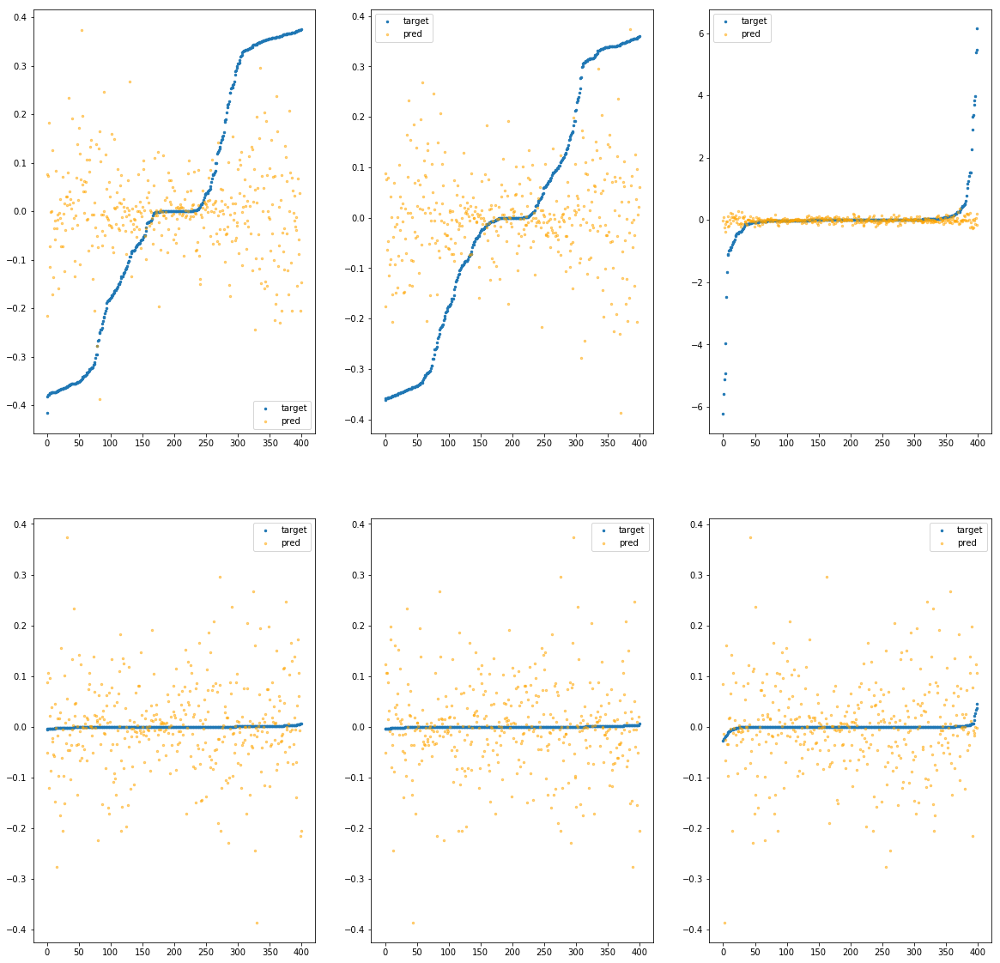

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa99bfc3a30>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.54e-02	6.33e-01	2.13e-01	4.52e+03	6.89e-02	4.75e-03
y		-1.41e-01	6.15e-01	1.98e-01	5.13e+02	6.25e-02	3.91e-03
z		-1.31e-02	6.18e+00	2.96e-01	5.40e+02	8.86e-01	7.86e-01
phi		-2.64e+03	2.67e-01	4.76e-02	1.93e+06	4.91e-03	2.41e-05
theta		-3.86e+03	2.68e-01	4.75e-02	4.88e+05	4.90e-03	2.40e-05
psi		-1.97e+02	2.67e-01	4.73e-02	7.59e+05	4.85e-03	2.36e-05


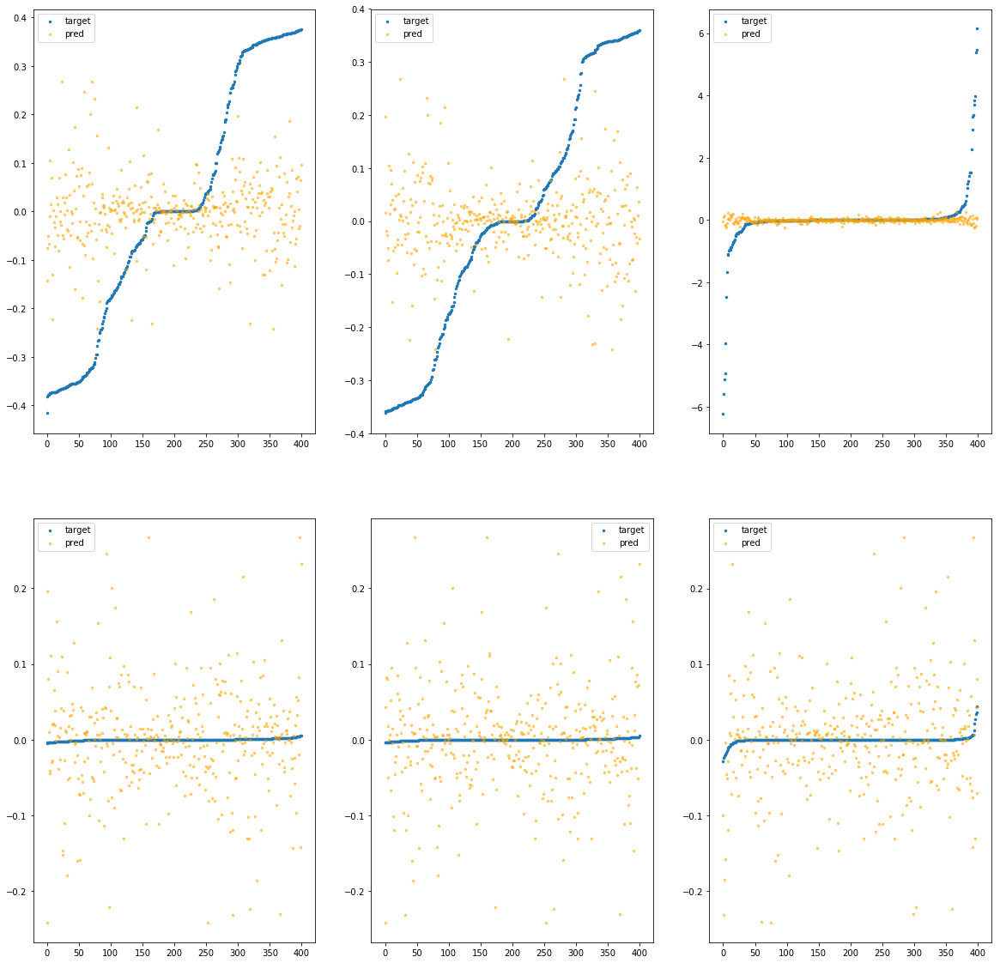

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa99bfc3a90>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.94e-02	6.69e-01	2.11e-01	4.77e+03	6.79e-02	4.61e-03
y		-1.09e-01	6.66e-01	1.96e-01	7.54e+02	6.08e-02	3.69e-03
z		1.53e-02	6.19e+00	2.96e-01	4.36e+02	8.61e-01	7.42e-01
phi		-3.16e+03	3.47e-01	5.18e-02	2.06e+06	5.88e-03	3.46e-05
theta		-4.63e+03	3.46e-01	5.19e-02	4.73e+05	5.88e-03	3.45e-05
psi		-2.38e+02	3.11e-01	5.20e-02	1.17e+06	5.85e-03	3.42e-05


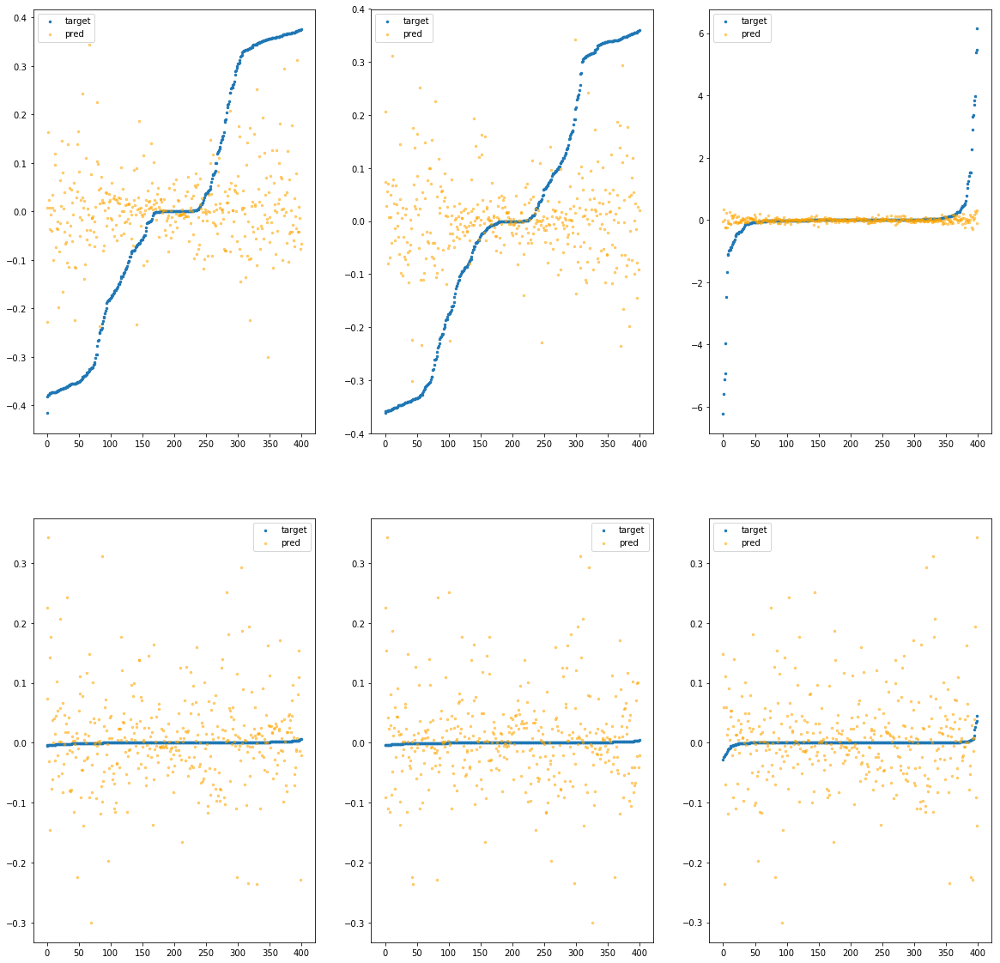

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa99bfc3af0>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.94e-01	8.03e-01	2.21e-01	5.31e+03	7.66e-02	5.86e-03
y		-1.96e-01	7.84e-01	1.99e-01	6.01e+02	6.56e-02	4.30e-03
z		-2.24e-02	6.66e+00	3.08e-01	9.54e+02	8.94e-01	8.00e-01
phi		-5.02e+03	4.32e-01	6.22e-02	2.34e+06	9.35e-03	8.75e-05
theta		-7.36e+03	4.32e-01	6.21e-02	7.15e+05	9.34e-03	8.73e-05
psi		-3.82e+02	4.31e-01	6.23e-02	1.11e+06	9.39e-03	8.81e-05


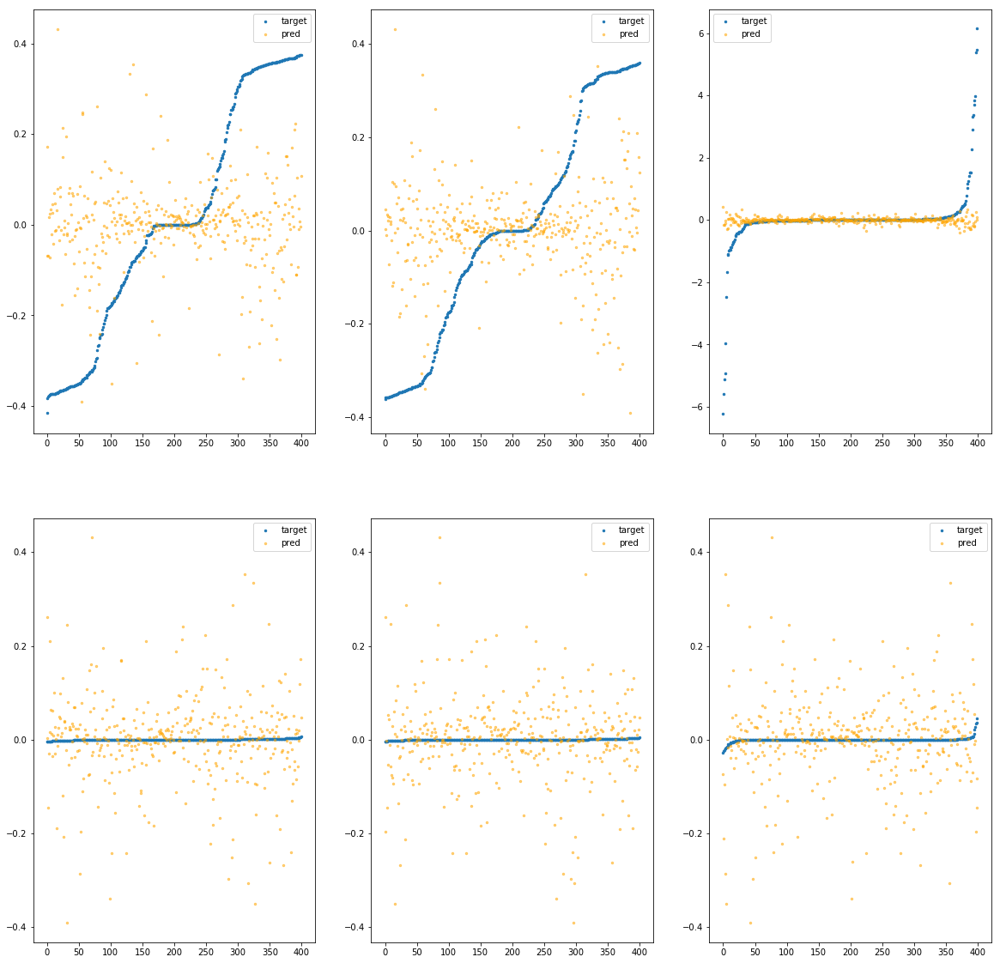

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa99bfc3b50>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.36e-02	7.50e-01	2.09e-01	5.55e+03	6.95e-02	4.83e-03
y		-1.83e-01	7.96e-01	1.97e-01	1.32e+03	6.49e-02	4.21e-03
z		-6.66e-02	6.24e+00	3.16e-01	9.62e+02	9.33e-01	8.71e-01
phi		-5.24e+03	5.15e-01	6.84e-02	2.05e+06	9.76e-03	9.53e-05
theta		-7.69e+03	5.20e-01	6.85e-02	1.56e+06	9.77e-03	9.55e-05
psi		-3.95e+02	5.18e-01	6.83e-02	1.14e+06	9.71e-03	9.43e-05


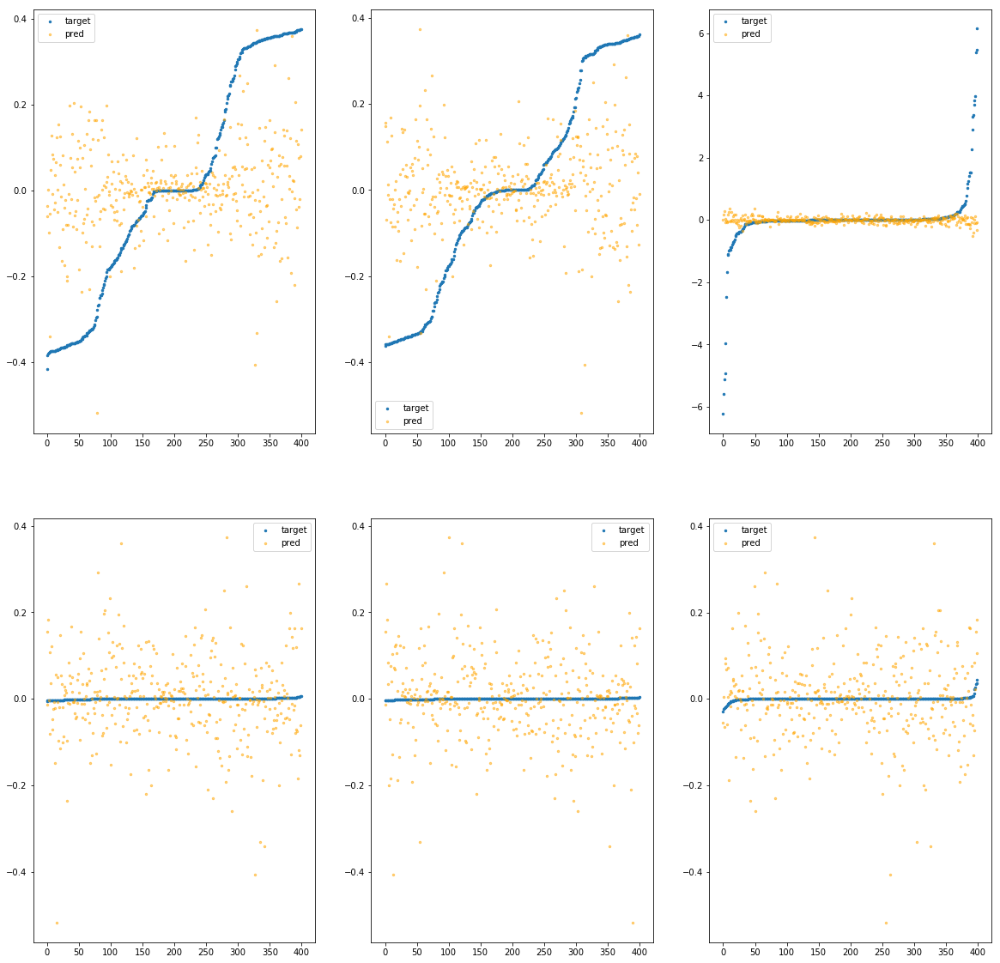

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa99bfc3bb0>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.13e-01	8.30e-01	2.13e-01	4.99e+03	7.14e-02	5.09e-03
y		-1.35e-01	8.12e-01	1.96e-01	1.30e+03	6.22e-02	3.87e-03
z		-4.55e-02	6.44e+00	3.06e-01	6.45e+02	9.15e-01	8.37e-01
phi		-4.59e+03	4.71e-01	6.18e-02	1.88e+06	8.55e-03	7.31e-05
theta		-6.74e+03	4.71e-01	6.17e-02	8.13e+05	8.55e-03	7.32e-05
psi		-3.50e+02	4.71e-01	6.18e-02	8.06e+05	8.62e-03	7.43e-05


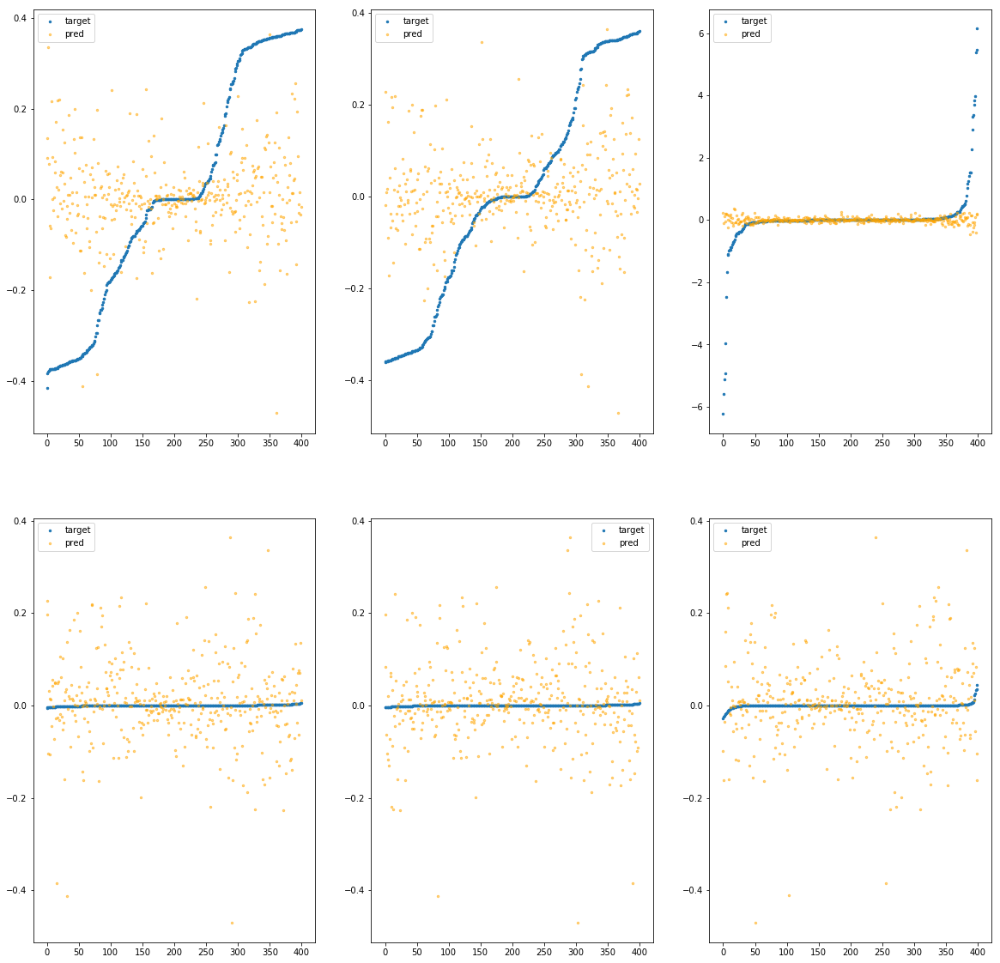

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa99bfc3c10>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.23e-01	6.56e-01	2.16e-01	2.60e+03	7.20e-02	5.19e-03
y		-3.20e-02	6.19e-01	1.87e-01	4.90e+02	5.66e-02	3.20e-03
z		-2.47e-02	6.37e+00	2.98e-01	4.84e+02	8.96e-01	8.04e-01
phi		-3.06e+03	3.38e-01	4.89e-02	1.27e+06	5.69e-03	3.24e-05
theta		-4.48e+03	3.37e-01	4.90e-02	3.63e+05	5.70e-03	3.24e-05
psi		-2.31e+02	3.40e-01	4.89e-02	8.39e+05	5.68e-03	3.23e-05


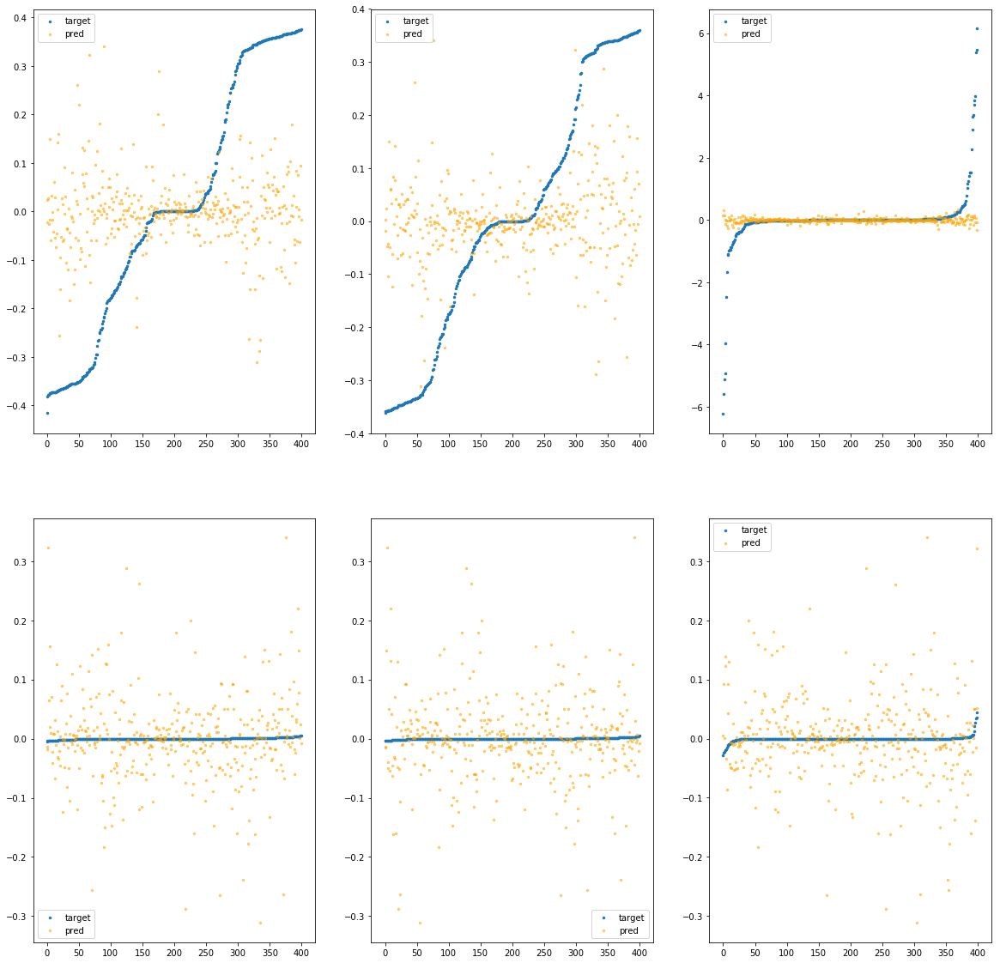

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa99bfc3c70>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.16e-01	7.20e-01	2.17e-01	4.74e+03	7.16e-02	5.12e-03
y		-1.14e-01	7.02e-01	1.97e-01	8.64e+02	6.11e-02	3.73e-03
z		-2.36e-02	6.18e+00	3.04e-01	5.94e+02	8.96e-01	8.02e-01
phi		-2.55e+03	3.85e-01	4.65e-02	1.86e+06	4.75e-03	2.25e-05
theta		-3.74e+03	3.85e-01	4.65e-02	7.28e+05	4.75e-03	2.26e-05
psi		-1.93e+02	3.84e-01	4.66e-02	1.04e+06	4.75e-03	2.26e-05


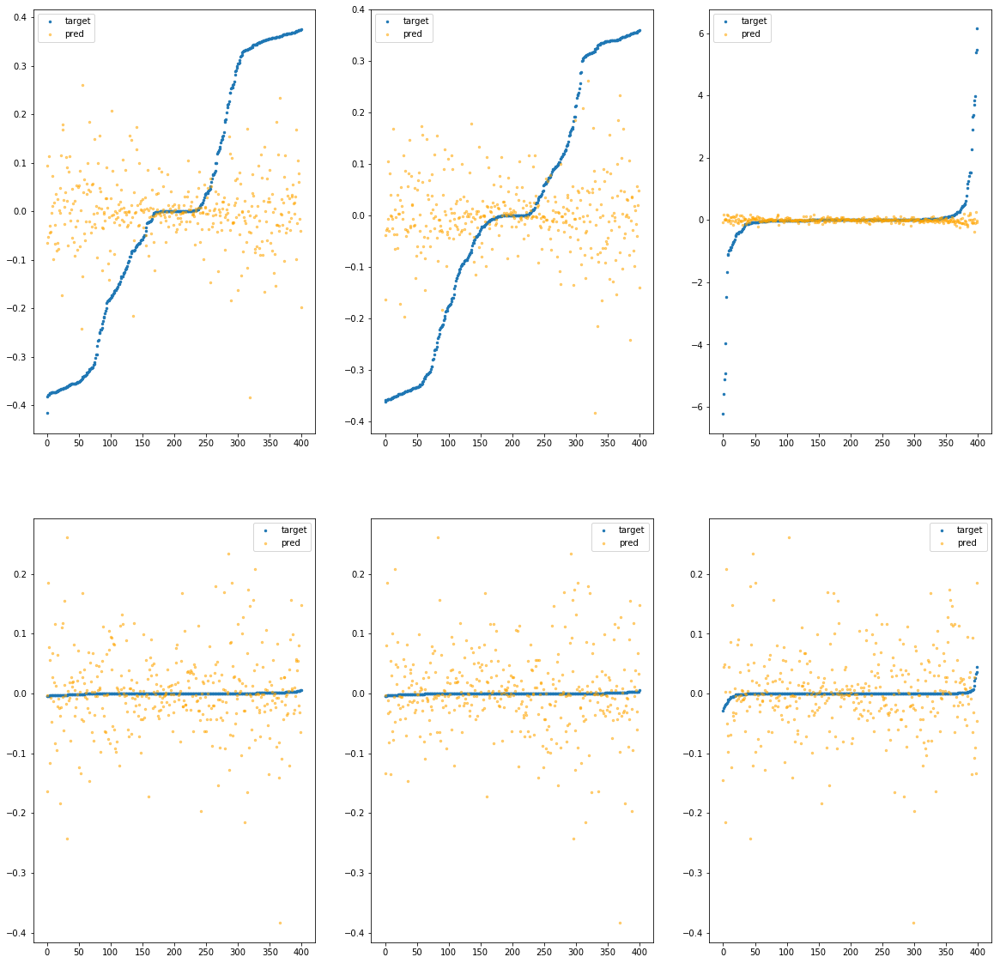

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa99bfc3cd0>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.07e-02	6.41e-01	2.11e-01	5.00e+03	6.86e-02	4.71e-03
y		-1.24e-01	6.34e-01	1.96e-01	5.04e+02	6.16e-02	3.79e-03
z		6.97e-03	6.25e+00	2.96e-01	2.98e+02	8.69e-01	7.55e-01
phi		-2.48e+03	3.93e-01	4.40e-02	2.04e+06	4.62e-03	2.14e-05
theta		-3.64e+03	3.93e-01	4.41e-02	2.90e+05	4.63e-03	2.14e-05
psi		-1.87e+02	3.94e-01	4.41e-02	1.19e+06	4.61e-03	2.12e-05


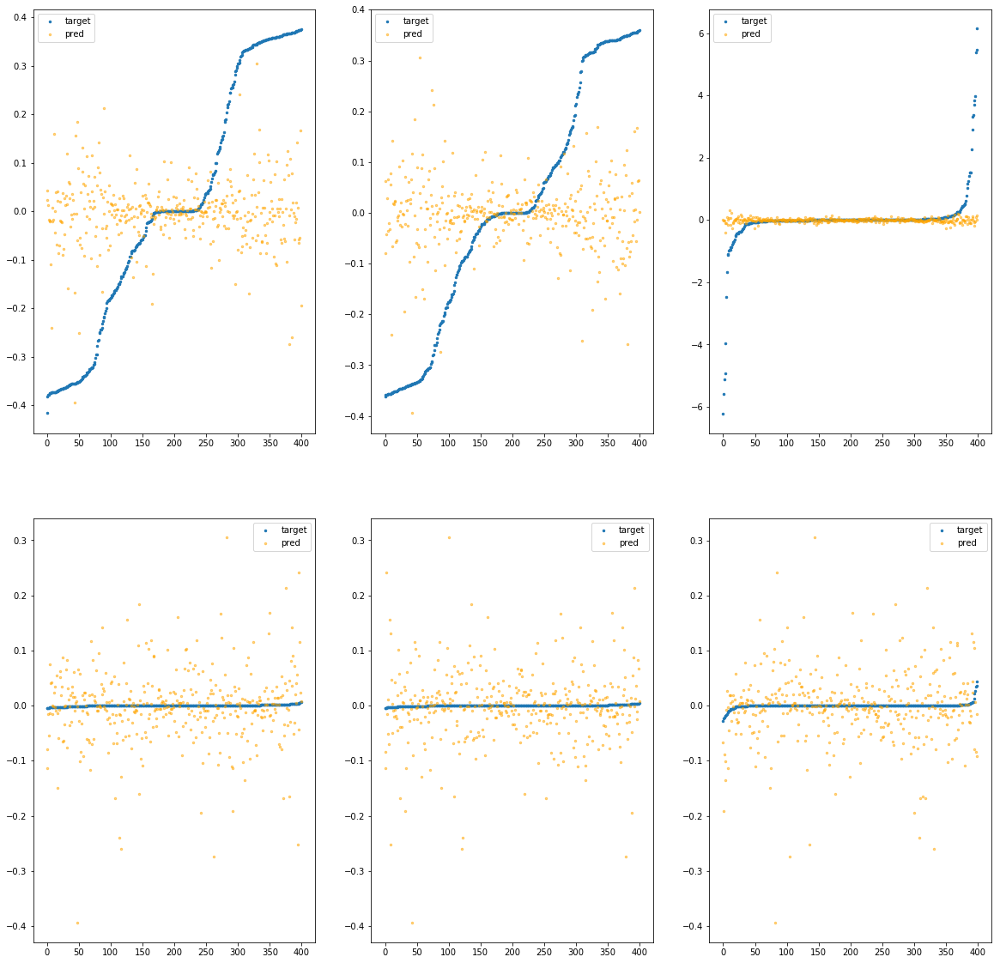

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa99bfc3d30>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.51e-01	7.17e-01	2.17e-01	5.70e+03	7.38e-02	5.45e-03
y		-1.26e-01	7.30e-01	1.93e-01	5.88e+02	6.17e-02	3.81e-03
z		2.94e-02	5.97e+00	2.98e-01	7.70e+02	8.49e-01	7.21e-01
phi		-5.02e+03	5.19e-01	6.22e-02	2.21e+06	9.34e-03	8.73e-05
theta		-7.35e+03	5.19e-01	6.22e-02	7.88e+05	9.34e-03	8.72e-05
psi		-3.84e+02	5.19e-01	6.27e-02	1.76e+06	9.45e-03	8.93e-05


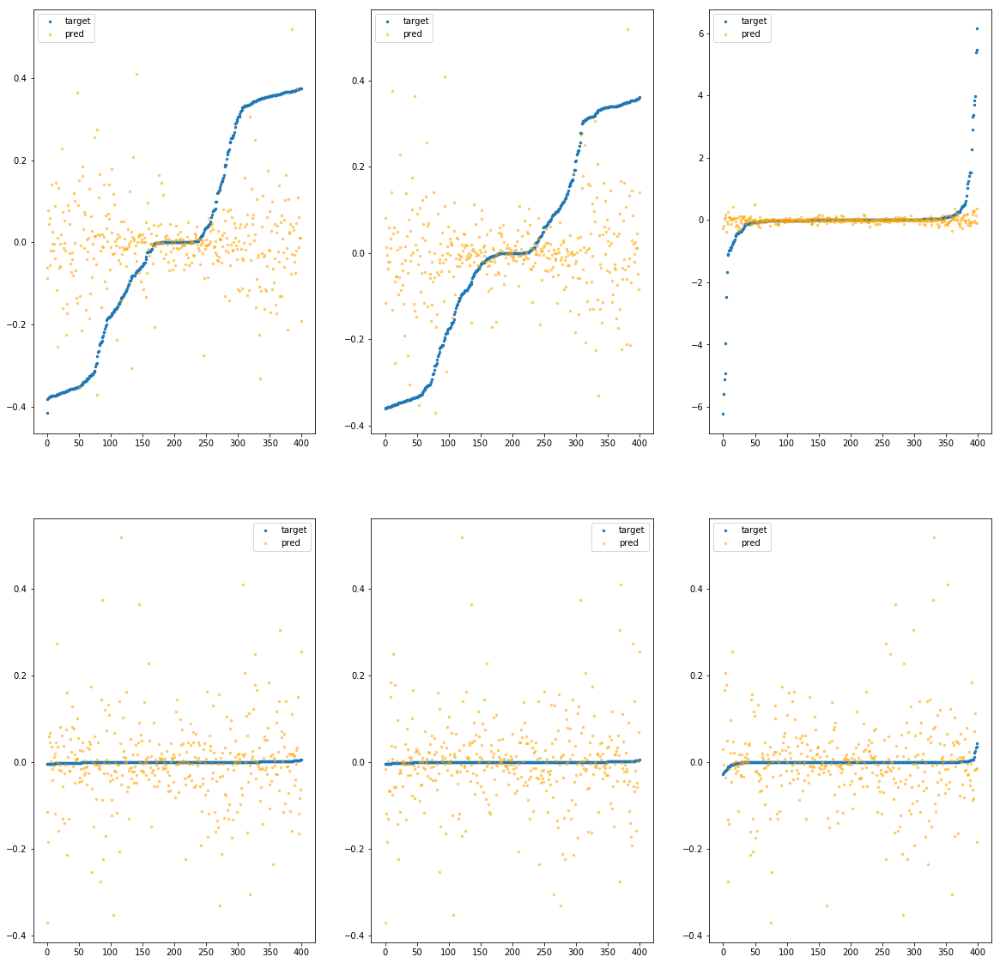

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa99bfc3d90>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.10e-02	6.01e-01	2.12e-01	4.65e+03	6.87e-02	4.72e-03
y		-9.99e-02	5.65e-01	1.97e-01	6.57e+02	6.03e-02	3.64e-03
z		-7.86e-03	6.21e+00	2.97e-01	6.48e+02	8.82e-01	7.77e-01
phi		-2.28e+03	2.58e-01	4.53e-02	1.90e+06	4.25e-03	1.80e-05
theta		-3.34e+03	2.54e-01	4.52e-02	4.17e+05	4.24e-03	1.80e-05
psi		-1.74e+02	2.57e-01	4.56e-02	6.97e+05	4.29e-03	1.84e-05


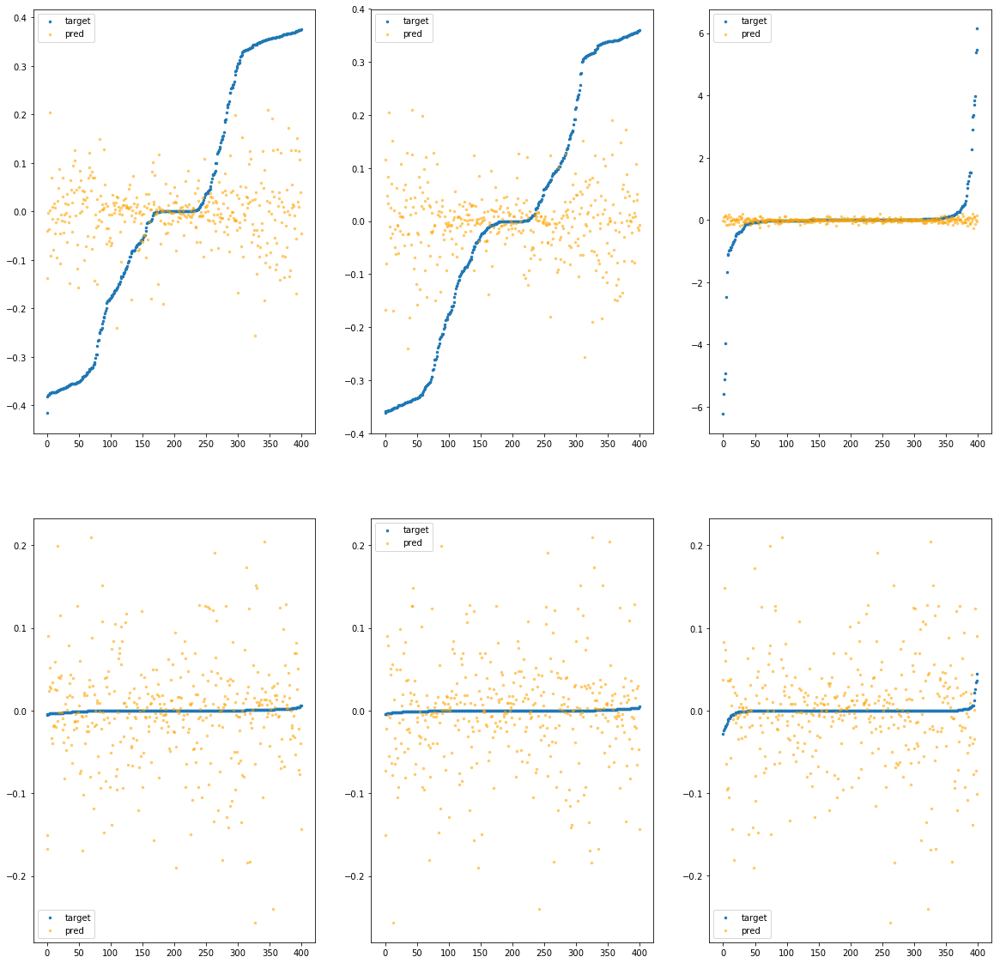

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa99bfc3df0>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e-01	6.90e-01	2.13e-01	3.45e+03	7.08e-02	5.02e-03
y		-8.26e-02	6.11e-01	1.92e-01	3.70e+02	5.94e-02	3.52e-03
z		9.48e-03	6.36e+00	2.96e-01	5.24e+02	8.67e-01	7.51e-01
phi		-3.39e+03	3.53e-01	5.09e-02	9.93e+05	6.31e-03	3.98e-05
theta		-4.99e+03	3.58e-01	5.09e-02	2.97e+05	6.33e-03	4.01e-05
psi		-2.61e+02	3.57e-01	5.14e-02	9.43e+05	6.43e-03	4.13e-05


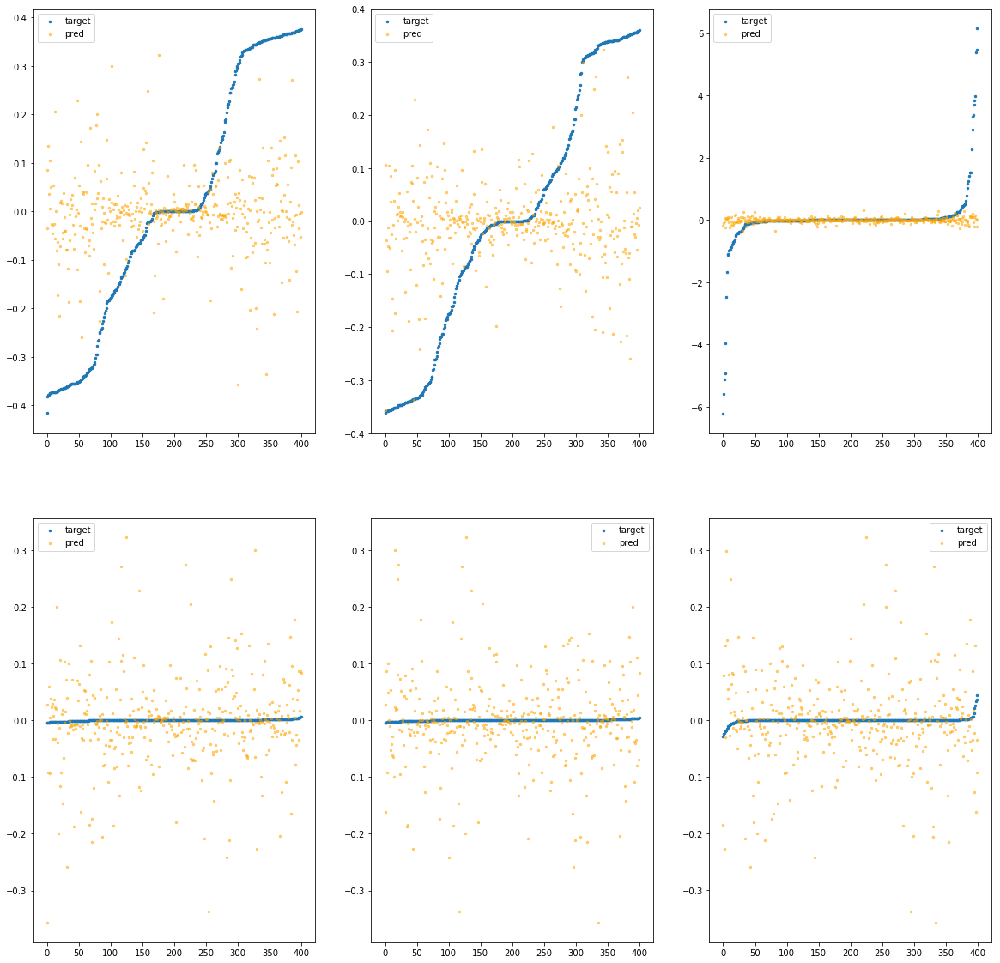

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa99bfc3e50>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.42e-01	6.77e-01	2.18e-01	4.45e+03	7.32e-02	5.36e-03
y		-1.03e-01	6.58e-01	1.96e-01	5.82e+02	6.05e-02	3.66e-03
z		-1.45e-02	6.28e+00	2.99e-01	6.50e+02	8.88e-01	7.88e-01
phi		-3.33e+03	4.54e-01	5.19e-02	1.69e+06	6.20e-03	3.85e-05
theta		-4.90e+03	4.56e-01	5.20e-02	8.46e+05	6.22e-03	3.87e-05
psi		-2.55e+02	4.54e-01	5.23e-02	1.41e+06	6.27e-03	3.93e-05


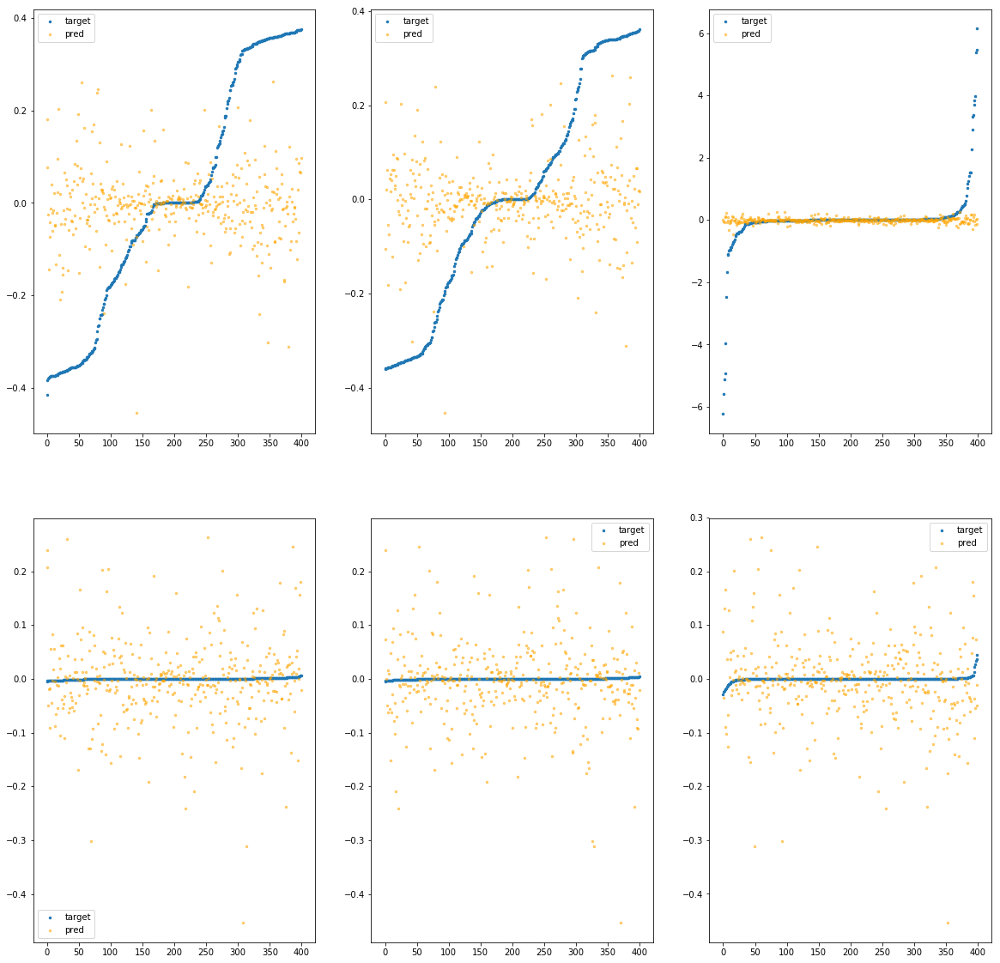

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa99bfc3eb0>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.17e-02	6.18e-01	2.10e-01	3.76e+03	6.81e-02	4.63e-03
y		-1.77e-01	6.03e-01	2.01e-01	9.83e+02	6.45e-02	4.17e-03
z		-1.66e-02	6.47e+00	3.04e-01	4.45e+02	8.89e-01	7.91e-01
phi		-3.16e+03	2.65e-01	5.28e-02	1.54e+06	5.89e-03	3.47e-05
theta		-4.63e+03	2.65e-01	5.28e-02	7.03e+05	5.88e-03	3.46e-05
psi		-2.41e+02	2.50e-01	5.31e-02	1.46e+06	5.95e-03	3.54e-05


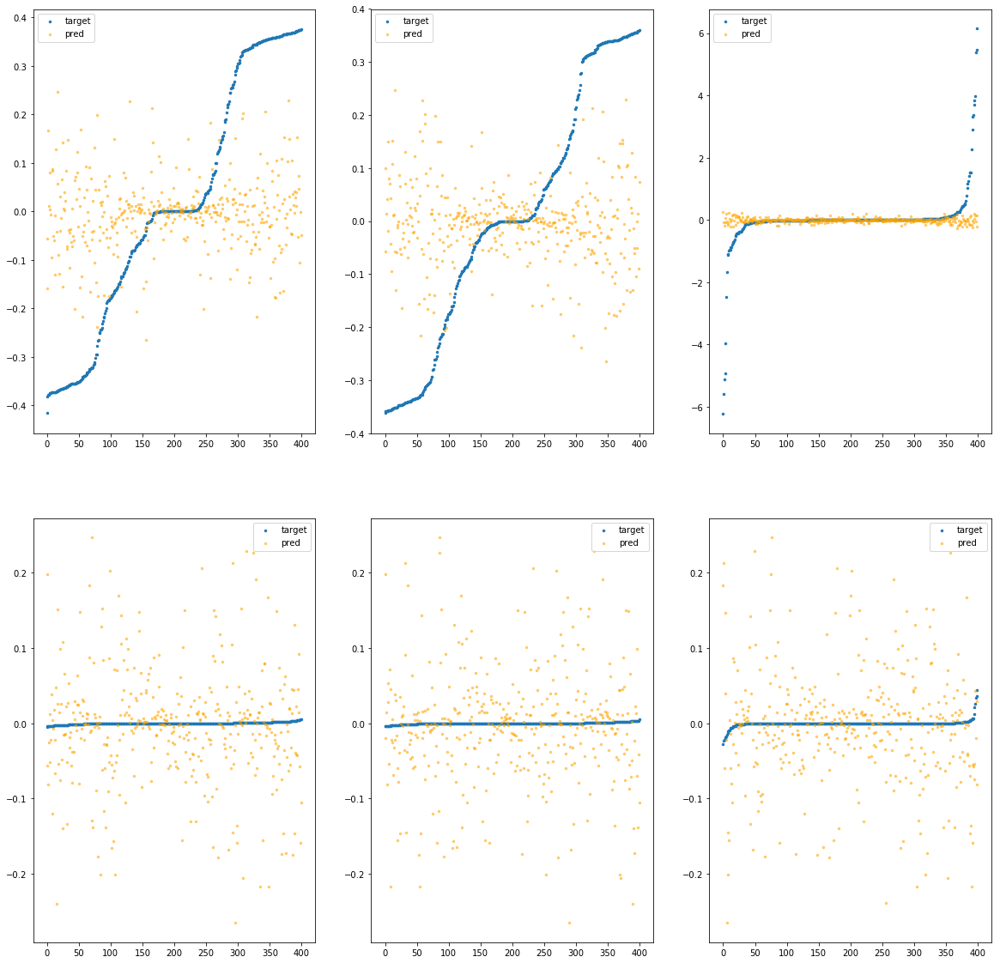

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa99bfc3f10>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.49e-02	7.24e-01	2.12e-01	4.13e+03	6.89e-02	4.75e-03
y		-1.03e-01	5.75e-01	1.96e-01	5.98e+02	6.05e-02	3.66e-03
z		-2.60e-02	6.21e+00	3.00e-01	5.79e+02	8.98e-01	8.06e-01
phi		-3.06e+03	3.56e-01	5.05e-02	1.32e+06	5.70e-03	3.25e-05
theta		-4.50e+03	3.55e-01	5.06e-02	6.08e+05	5.71e-03	3.26e-05
psi		-2.36e+02	3.55e-01	5.11e-02	1.13e+06	5.81e-03	3.37e-05


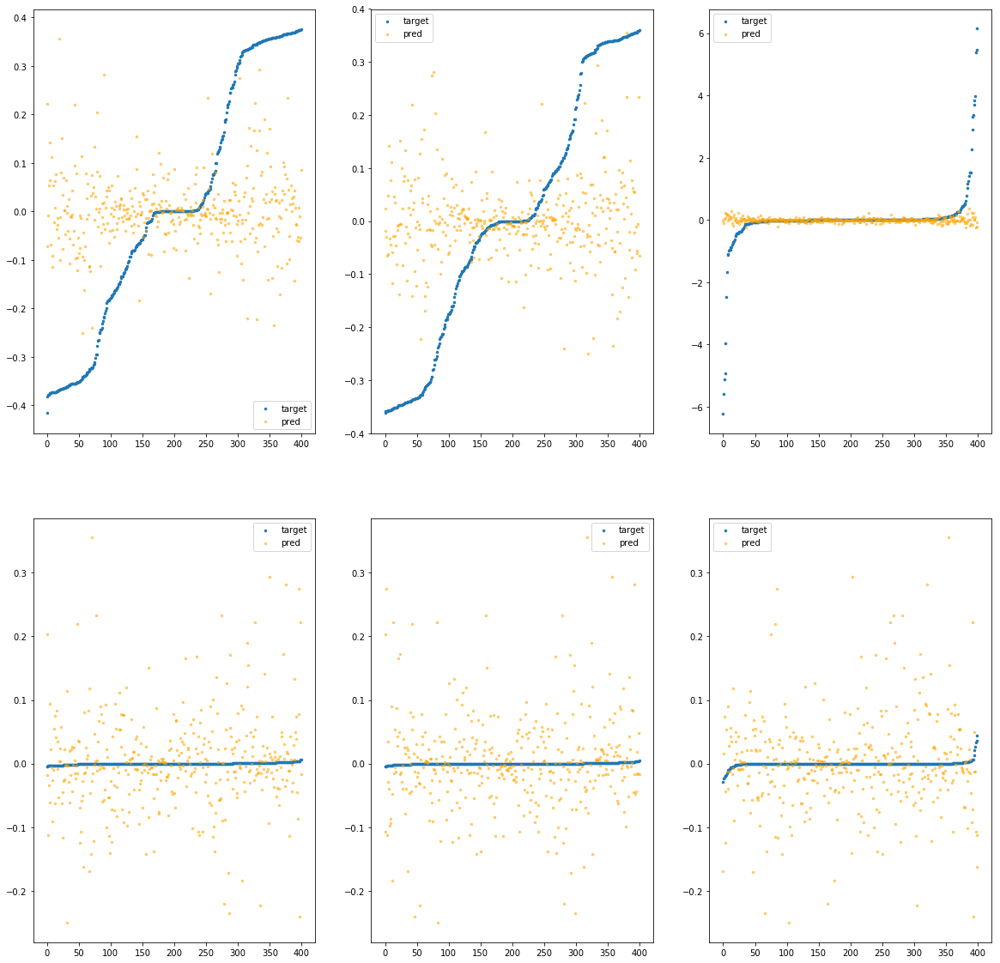

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fa99bfc3f70>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.74e-01	6.59e-01	2.21e-01	5.57e+03	7.53e-02	5.67e-03
y		-1.76e-01	6.70e-01	1.99e-01	4.64e+02	6.45e-02	4.16e-03
z		9.35e-03	6.15e+00	3.03e-01	7.76e+02	8.67e-01	7.51e-01
phi		-4.41e+03	3.20e-01	6.21e-02	2.29e+06	8.20e-03	6.73e-05
theta		-6.45e+03	3.20e-01	6.22e-02	5.24e+05	8.20e-03	6.72e-05
psi		-3.31e+02	3.20e-01	6.18e-02	1.12e+06	8.14e-03	6.63e-05


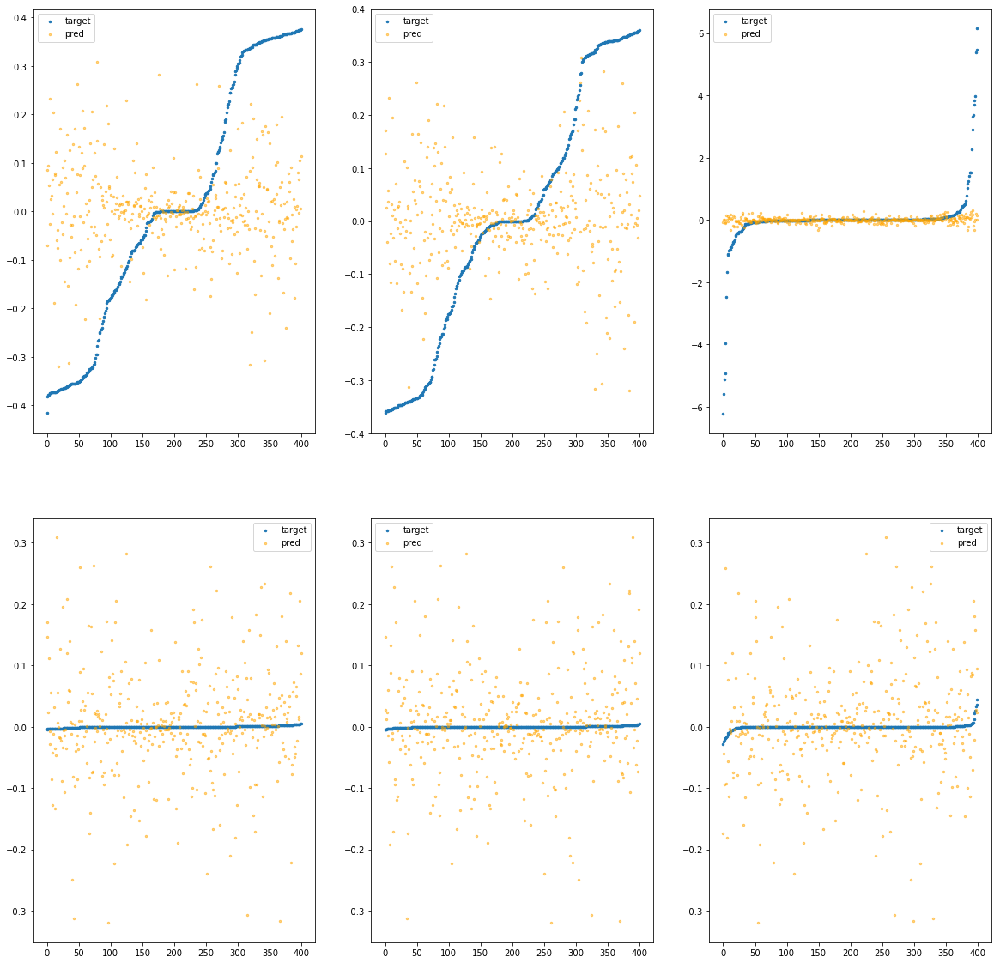

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa99bfc3fd0>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.53e-03	4.14e-01	2.06e-01	1.75e+03	6.43e-02	4.13e-03
y		-2.10e-03	3.66e-01	1.88e-01	2.17e+02	5.49e-02	3.02e-03
z		-7.65e-04	6.23e+00	2.78e-01	1.05e+02	8.76e-01	7.67e-01
phi		-1.09e+01	2.51e-02	3.68e-03	6.51e+05	2.22e-05	4.95e-10
theta		-1.61e+01	2.56e-02	3.62e-03	3.00e+05	2.18e-05	4.74e-10
psi		-8.75e-01	4.62e-02	4.39e-03	6.02e+04	4.60e-05	2.12e-09


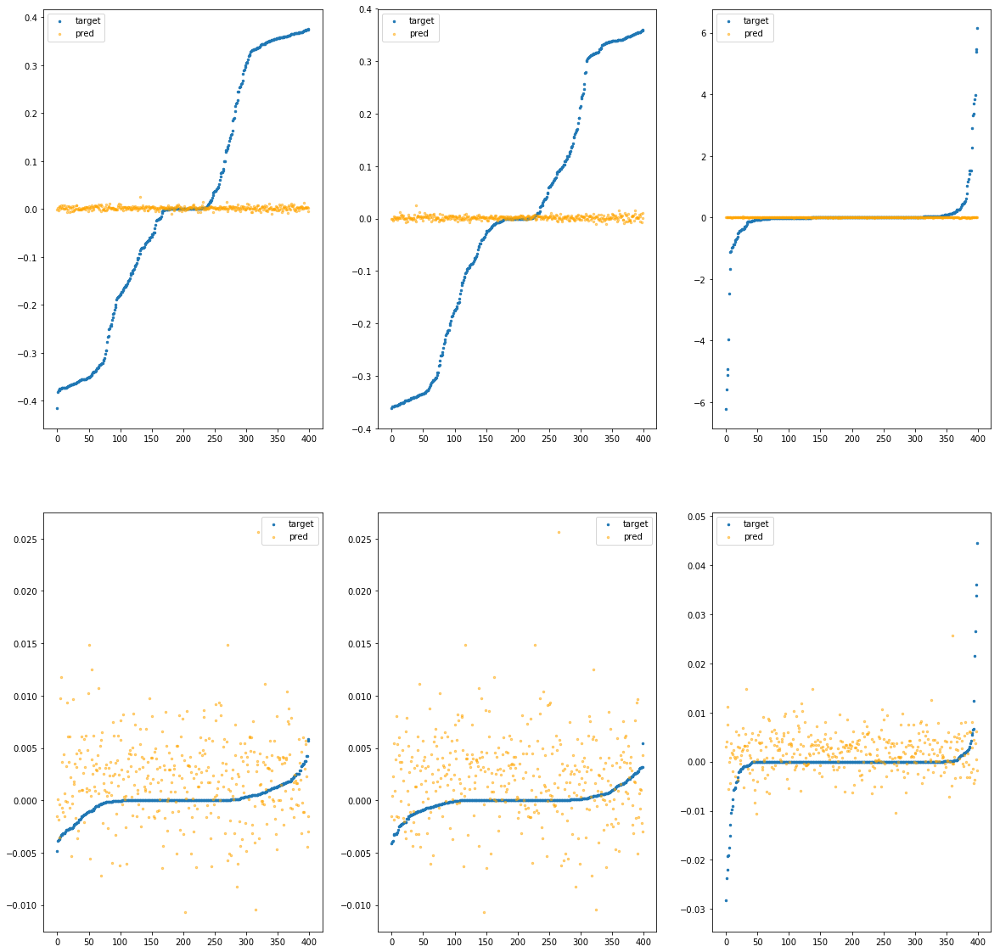

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa99bfce070>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.33e-03	4.16e-01	2.06e-01	1.19e+03	6.43e-02	4.13e-03
y		-4.21e-03	3.62e-01	1.88e-01	1.15e+02	5.51e-02	3.03e-03
z		-1.36e-03	6.22e+00	2.78e-01	7.85e+01	8.76e-01	7.67e-01
phi		-1.03e+01	1.55e-02	3.53e-03	4.19e+05	2.11e-05	4.45e-10
theta		-1.53e+01	1.30e-02	3.51e-03	1.31e+05	2.07e-05	4.27e-10
psi		-7.17e-01	4.75e-02	4.15e-03	5.12e+04	4.21e-05	1.78e-09


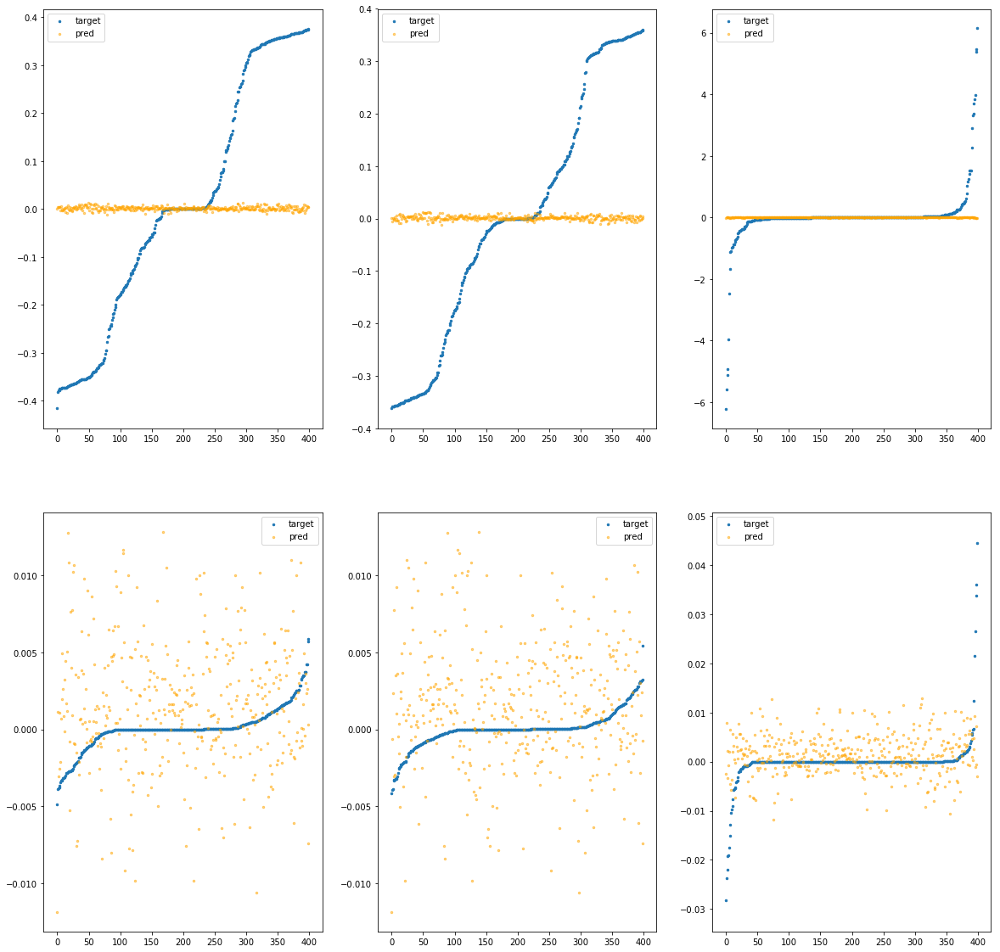

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa99bfce0d0>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.04e-03	4.11e-01	2.06e-01	1.12e+03	6.42e-02	4.13e-03
y		7.37e-04	3.65e-01	1.88e-01	1.81e+02	5.48e-02	3.00e-03
z		-1.68e-03	6.23e+00	2.78e-01	8.66e+01	8.76e-01	7.68e-01
phi		-8.80e+00	1.32e-02	3.41e-03	4.41e+05	1.82e-05	3.33e-10
theta		-1.33e+01	1.37e-02	3.39e-03	2.01e+05	1.82e-05	3.29e-10
psi		-8.90e-01	5.10e-02	4.20e-03	1.09e+05	4.64e-05	2.15e-09


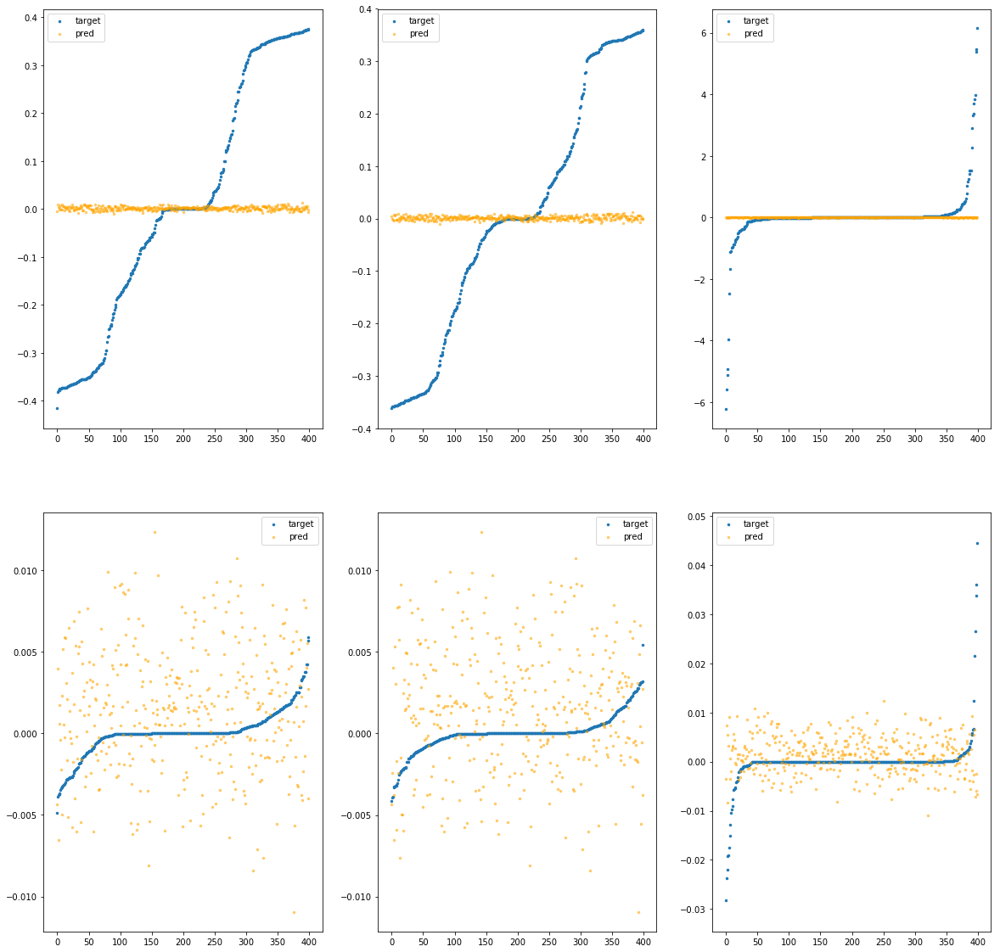

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa99bfce130>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.30e-03	4.18e-01	2.07e-01	3.18e+03	6.44e-02	4.15e-03
y		-2.64e-03	3.79e-01	1.89e-01	5.47e+02	5.50e-02	3.02e-03
z		1.11e-04	6.24e+00	2.79e-01	2.10e+02	8.75e-01	7.65e-01
phi		-4.14e+01	3.28e-02	6.76e-03	1.25e+06	7.89e-05	6.22e-09
theta		-6.15e+01	3.28e-02	6.87e-03	3.46e+05	7.94e-05	6.31e-09
psi		-3.06e+00	4.77e-02	7.47e-03	1.62e+05	9.95e-05	9.91e-09


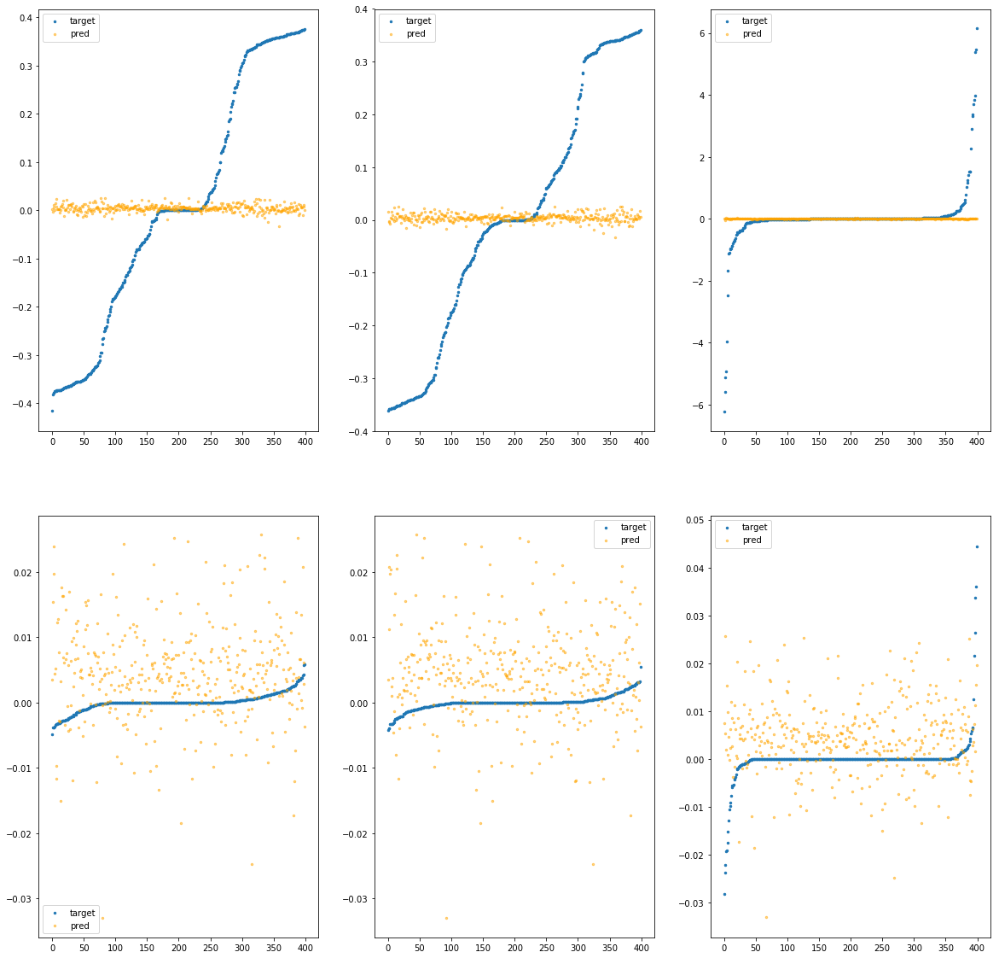

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa99bfce190>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.20e-03	4.43e-01	2.06e-01	3.49e+02	6.43e-02	4.14e-03
y		-1.73e-04	3.76e-01	1.88e-01	2.03e+02	5.48e-02	3.01e-03
z		-3.12e-04	6.21e+00	2.78e-01	6.69e+01	8.75e-01	7.66e-01
phi		-2.79e+01	3.07e-02	5.24e-03	1.39e+05	5.38e-05	2.89e-09
theta		-4.14e+01	2.83e-02	5.23e-03	1.38e+05	5.38e-05	2.89e-09
psi		-2.17e+00	4.53e-02	5.73e-03	9.51e+04	7.78e-05	6.05e-09


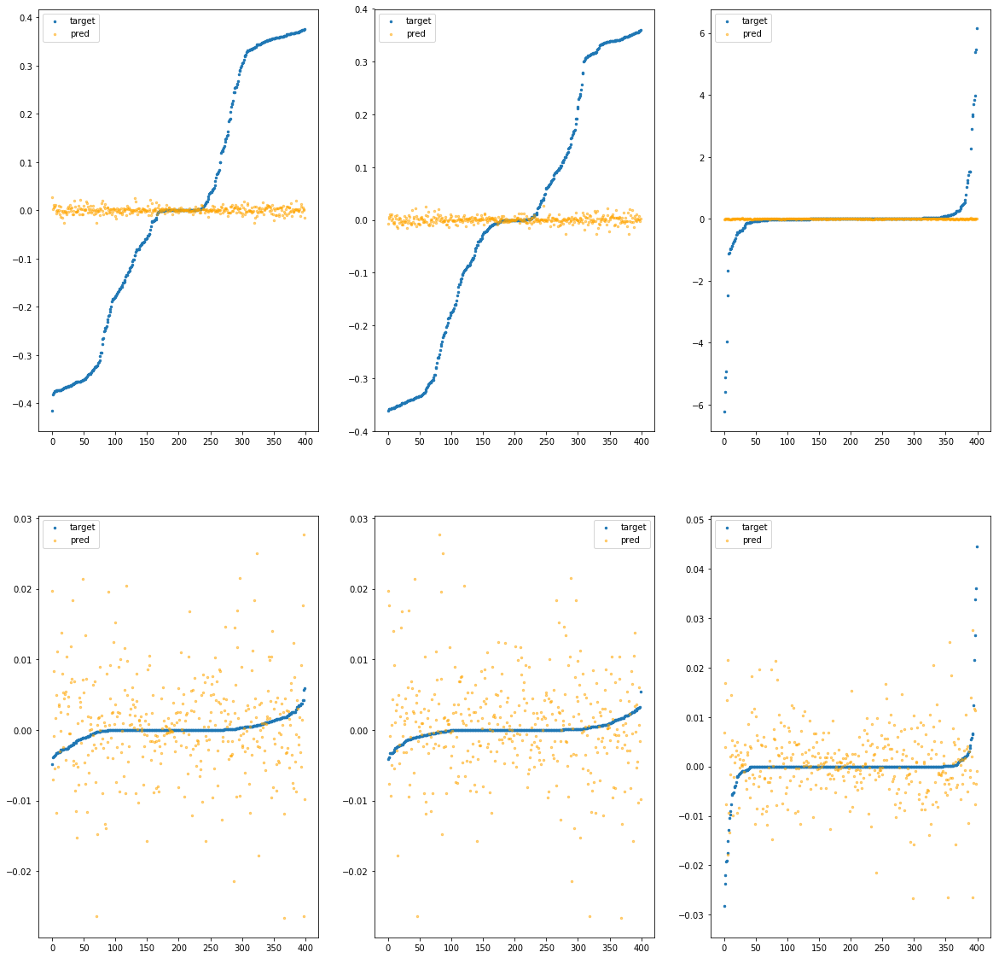

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa99bfce1f0>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		9.75e-04	4.11e-01	2.06e-01	1.64e+03	6.41e-02	4.10e-03
y		-3.26e-03	3.77e-01	1.88e-01	2.33e+02	5.50e-02	3.03e-03
z		-1.71e-03	6.23e+00	2.78e-01	1.46e+02	8.76e-01	7.68e-01
phi		-2.70e+01	2.59e-02	5.31e-03	5.91e+05	5.22e-05	2.72e-09
theta		-3.91e+01	2.59e-02	5.24e-03	2.61e+05	5.09e-05	2.59e-09
psi		-2.08e+00	4.96e-02	5.89e-03	1.05e+05	7.55e-05	5.70e-09


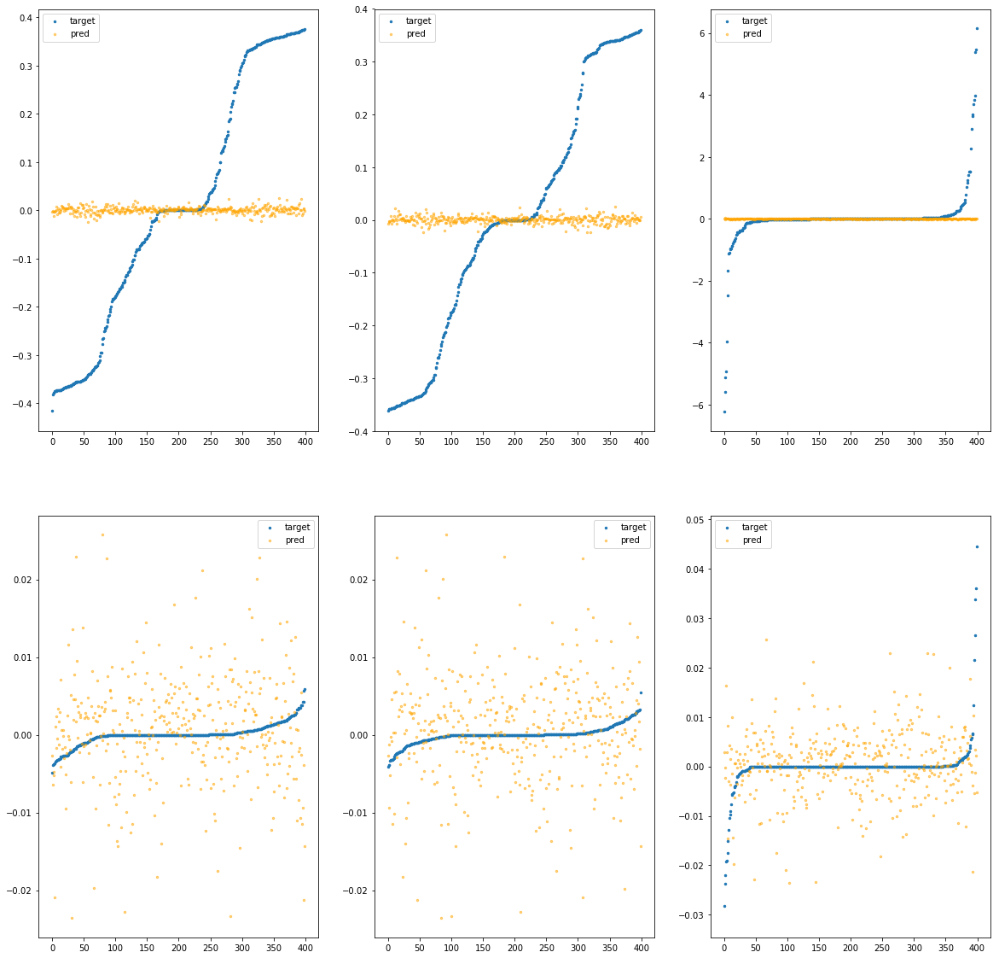

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa99bfce250>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.96e-03	4.17e-01	2.05e-01	2.77e+02	6.42e-02	4.13e-03
y		-1.11e-03	3.61e-01	1.88e-01	3.28e+01	5.49e-02	3.01e-03
z		-2.72e-04	6.21e+00	2.77e-01	2.93e+01	8.75e-01	7.66e-01
phi		-1.88e+00	1.16e-02	1.64e-03	1.03e+05	5.36e-06	2.88e-11
theta		-2.19e+00	1.17e-02	1.46e-03	4.57e+04	4.05e-06	1.64e-11
psi		-1.60e-01	4.58e-02	2.28e-03	2.26e+04	2.85e-05	8.10e-10


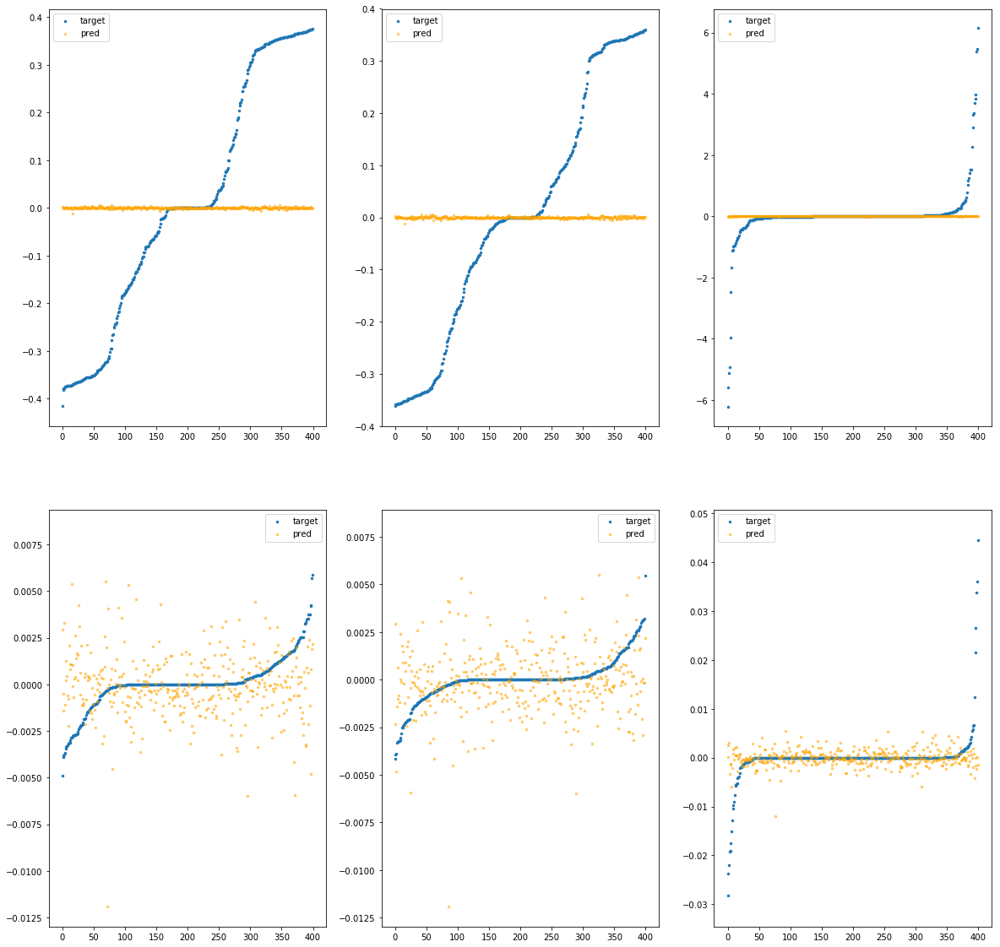

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa99bfce2b0>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.22e-03	4.12e-01	2.06e-01	1.15e+03	6.42e-02	4.12e-03
y		-5.42e-04	3.65e-01	1.88e-01	1.43e+02	5.49e-02	3.01e-03
z		-1.23e-03	6.24e+00	2.78e-01	8.33e+01	8.76e-01	7.67e-01
phi		-1.45e+01	1.82e-02	4.10e-03	3.78e+05	2.88e-05	8.29e-10
theta		-2.07e+01	1.82e-02	4.01e-03	1.82e+05	2.76e-05	7.61e-10
psi		-1.31e+00	4.72e-02	4.92e-03	5.42e+04	5.67e-05	3.22e-09


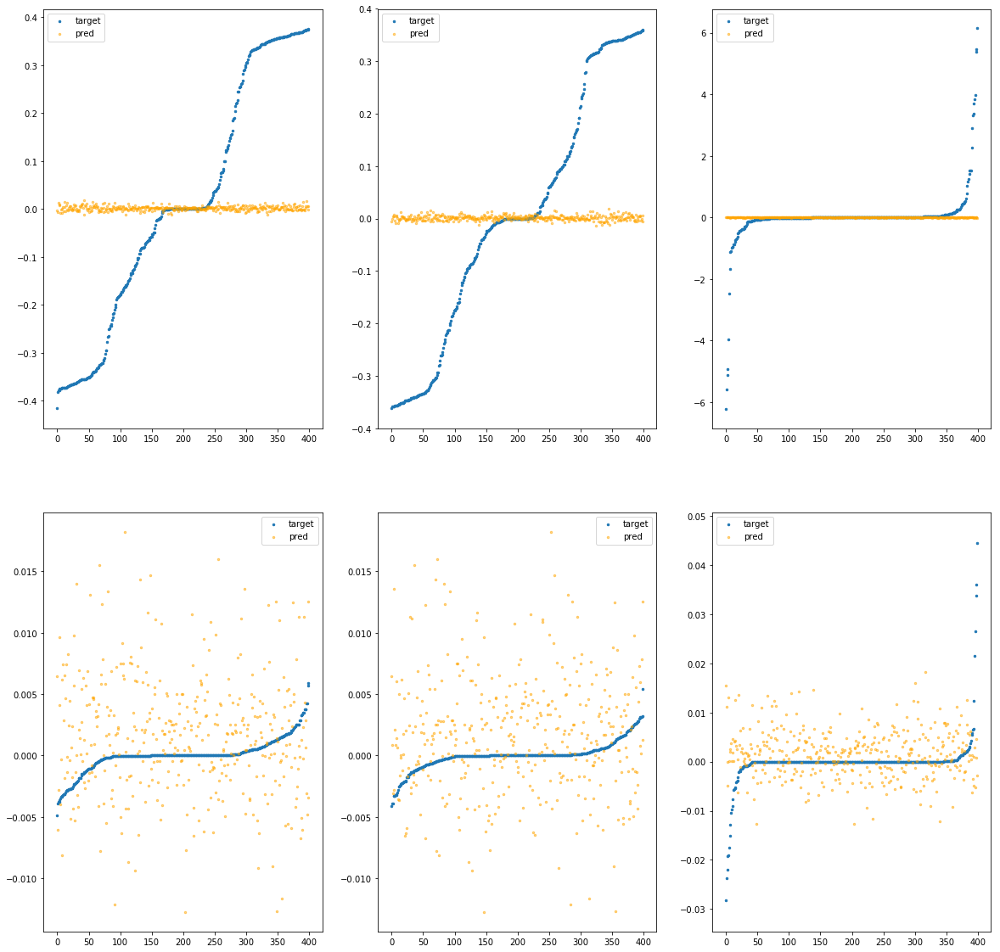

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa99bfce310>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.67e-03	4.13e-01	2.06e-01	1.34e+03	6.43e-02	4.13e-03
y		-2.56e-03	3.68e-01	1.88e-01	1.48e+02	5.50e-02	3.02e-03
z		-1.66e-04	6.22e+00	2.78e-01	8.96e+01	8.75e-01	7.66e-01
phi		-9.51e+00	1.73e-02	3.39e-03	5.29e+05	1.96e-05	3.82e-10
theta		-1.33e+01	1.68e-02	3.20e-03	1.37e+05	1.82e-05	3.32e-10
psi		-5.69e-01	3.81e-02	3.96e-03	5.47e+04	3.85e-05	1.48e-09


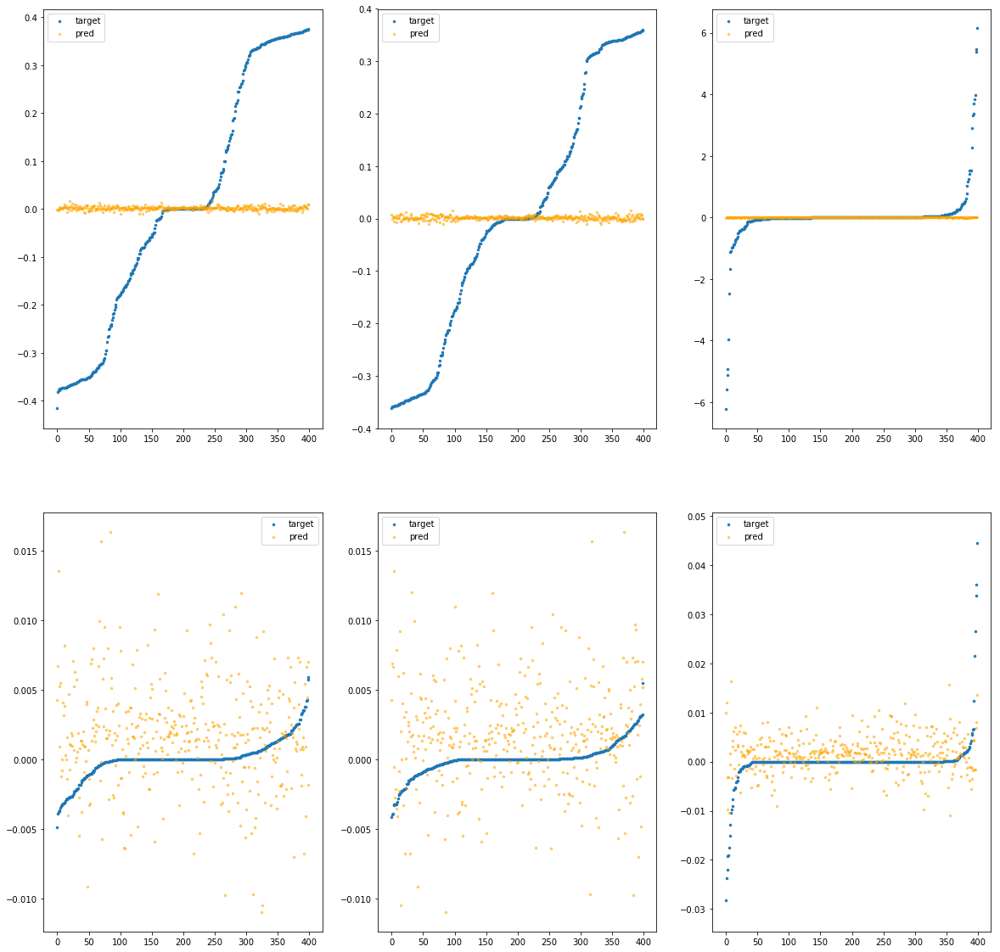

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa99bfce370>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.42e-03	4.18e-01	2.06e-01	7.68e+02	6.44e-02	4.15e-03
y		1.35e-03	3.70e-01	1.88e-01	1.40e+02	5.47e-02	3.00e-03
z		-1.34e-03	6.21e+00	2.78e-01	7.95e+01	8.76e-01	7.67e-01
phi		-1.39e+01	2.53e-02	3.82e-03	2.95e+05	2.77e-05	7.65e-10
theta		-2.08e+01	2.46e-02	3.80e-03	1.10e+05	2.77e-05	7.67e-10
psi		-7.61e-01	3.49e-02	4.30e-03	9.77e+04	4.32e-05	1.87e-09


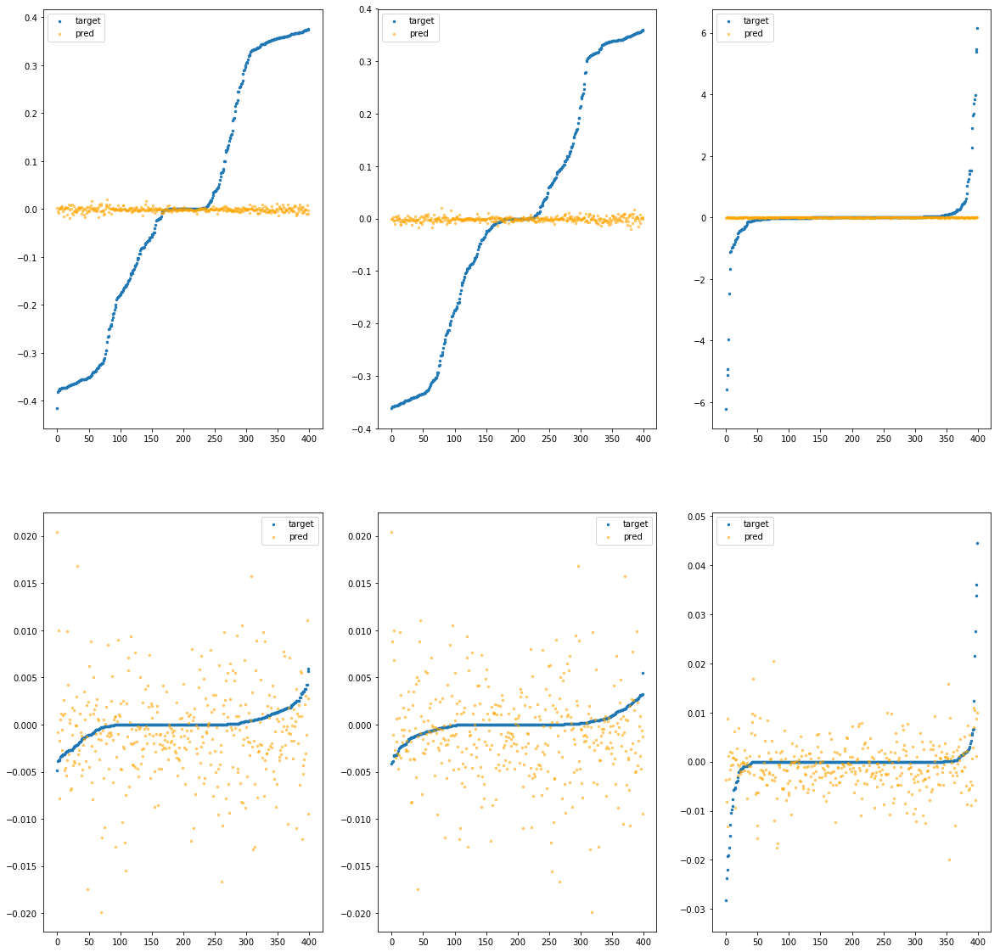

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa99bfce3d0>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.16e-03	4.09e-01	2.06e-01	5.28e+02	6.43e-02	4.13e-03
y		-2.95e-03	3.62e-01	1.88e-01	7.55e+01	5.50e-02	3.02e-03
z		-1.02e-03	6.22e+00	2.78e-01	4.46e+01	8.76e-01	7.67e-01
phi		-5.92e+00	1.86e-02	2.55e-03	2.31e+05	1.29e-05	1.66e-10
theta		-9.21e+00	1.80e-02	2.62e-03	6.12e+04	1.30e-05	1.68e-10
psi		-2.56e-01	4.50e-02	3.11e-03	3.14e+04	3.08e-05	9.49e-10


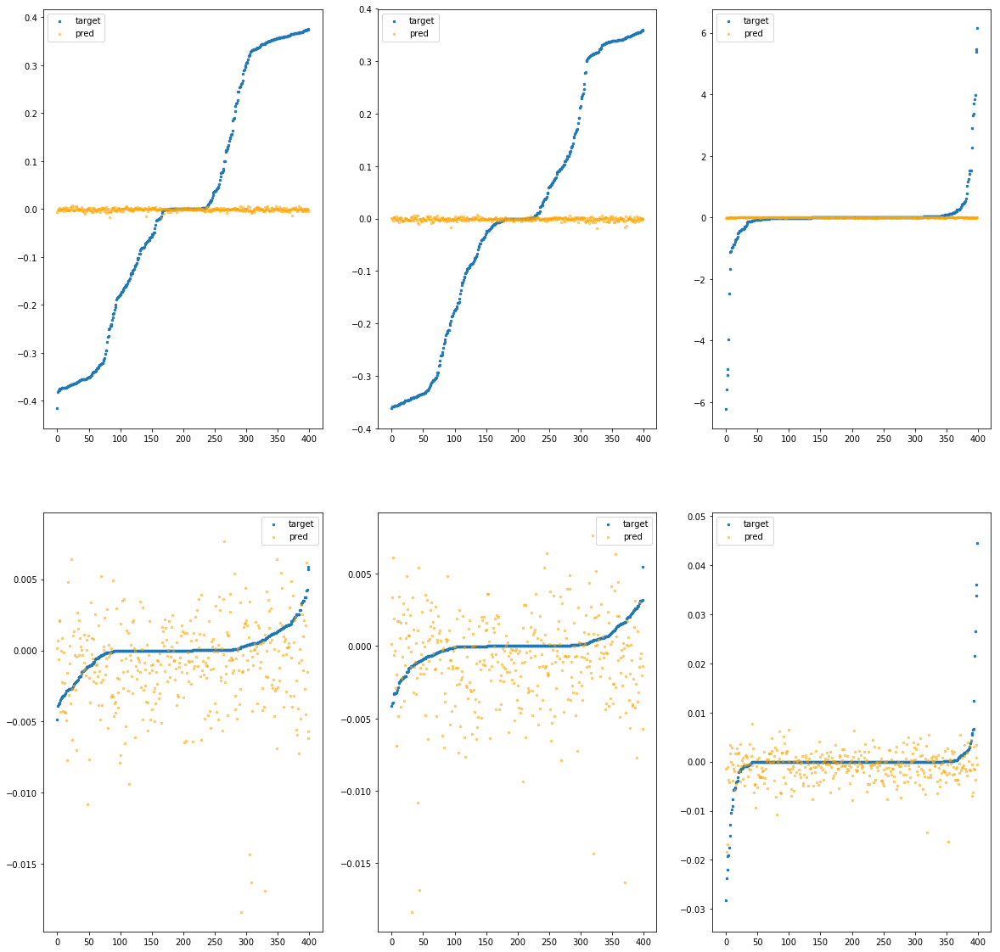

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa99bfce430>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.89e-03	4.21e-01	2.06e-01	7.17e+02	6.42e-02	4.13e-03
y		-8.20e-04	3.63e-01	1.88e-01	9.38e+01	5.49e-02	3.01e-03
z		-8.45e-04	6.22e+00	2.77e-01	5.71e+01	8.76e-01	7.67e-01
phi		-3.14e+00	1.10e-02	2.14e-03	2.75e+05	7.70e-06	5.93e-11
theta		-4.84e+00	1.10e-02	2.10e-03	1.07e+05	7.42e-06	5.51e-11
psi		-2.39e-01	5.00e-02	2.78e-03	3.90e+04	3.04e-05	9.23e-10


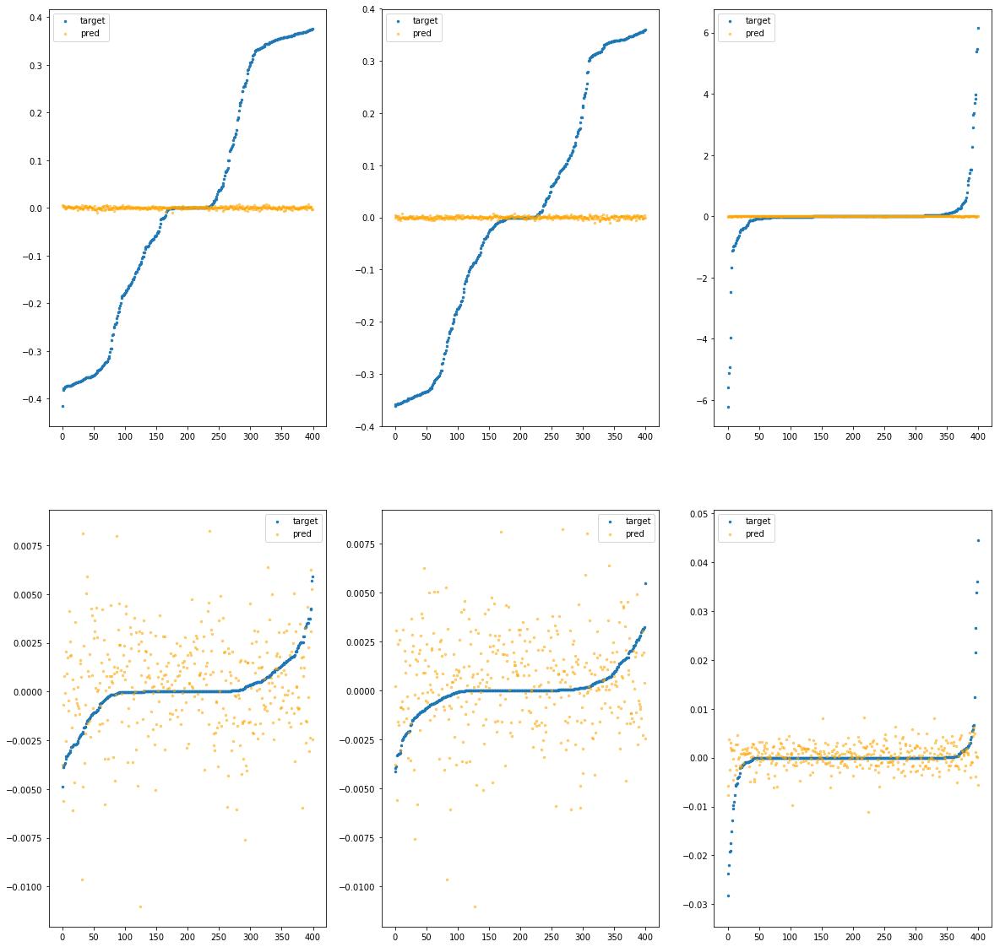

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa99bfce490>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.64e-03	4.07e-01	2.06e-01	3.40e+02	6.43e-02	4.13e-03
y		-3.38e-04	3.62e-01	1.88e-01	3.23e+01	5.48e-02	3.01e-03
z		-1.22e-03	6.22e+00	2.77e-01	1.90e+01	8.76e-01	7.67e-01
phi		-2.05e+00	1.41e-02	1.67e-03	1.17e+05	5.68e-06	3.22e-11
theta		-2.78e+00	1.02e-02	1.56e-03	3.55e+04	4.81e-06	2.31e-11
psi		-2.86e-01	4.48e-02	2.35e-03	2.85e+04	3.15e-05	9.95e-10


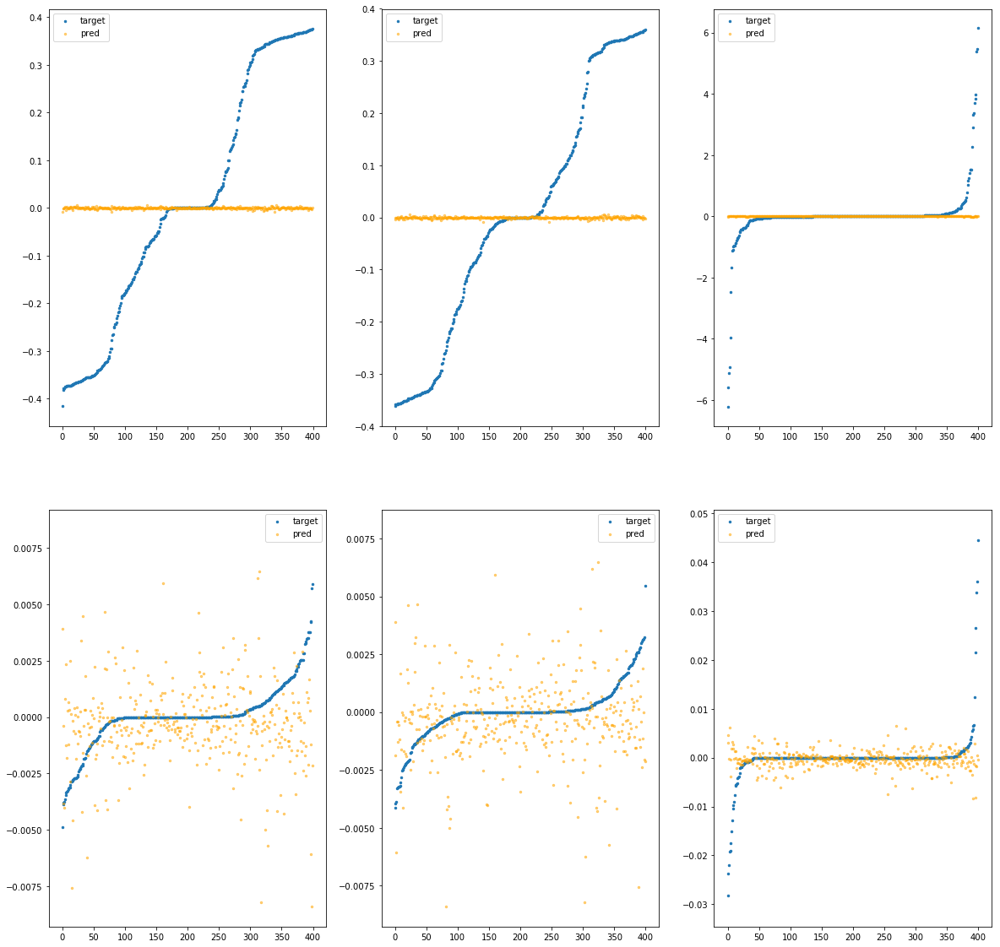

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa99bfce4f0>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.25e-03	4.19e-01	2.06e-01	1.70e+02	6.43e-02	4.13e-03
y		-2.06e-03	3.63e-01	1.88e-01	5.97e+01	5.49e-02	3.02e-03
z		-1.33e-03	6.23e+00	2.77e-01	3.19e+01	8.76e-01	7.67e-01
phi		-3.28e+00	1.87e-02	1.91e-03	7.16e+04	7.97e-06	6.35e-11
theta		-5.14e+00	1.87e-02	1.86e-03	5.50e+04	7.80e-06	6.08e-11
psi		-1.99e-01	4.86e-02	2.53e-03	3.30e+04	2.94e-05	8.65e-10


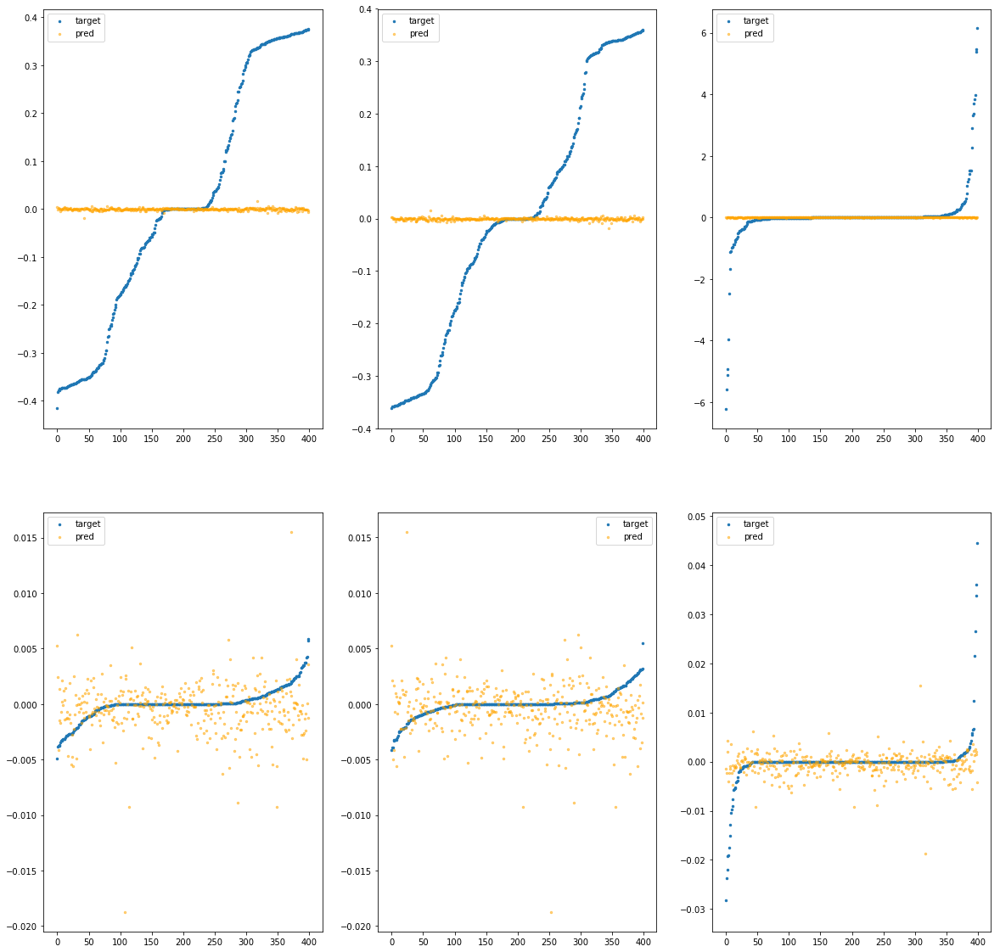

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa99bfce550>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.39e-03	4.24e-01	2.06e-01	8.04e+02	6.43e-02	4.14e-03
y		-1.62e-03	3.62e-01	1.88e-01	1.11e+02	5.49e-02	3.02e-03
z		-1.54e-03	6.23e+00	2.77e-01	6.34e+01	8.76e-01	7.68e-01
phi		-3.84e+00	1.57e-02	2.25e-03	2.99e+05	9.00e-06	8.10e-11
theta		-5.71e+00	1.50e-02	2.15e-03	1.29e+05	8.53e-06	7.27e-11
psi		-3.24e-01	4.70e-02	2.90e-03	2.63e+04	3.25e-05	1.05e-09


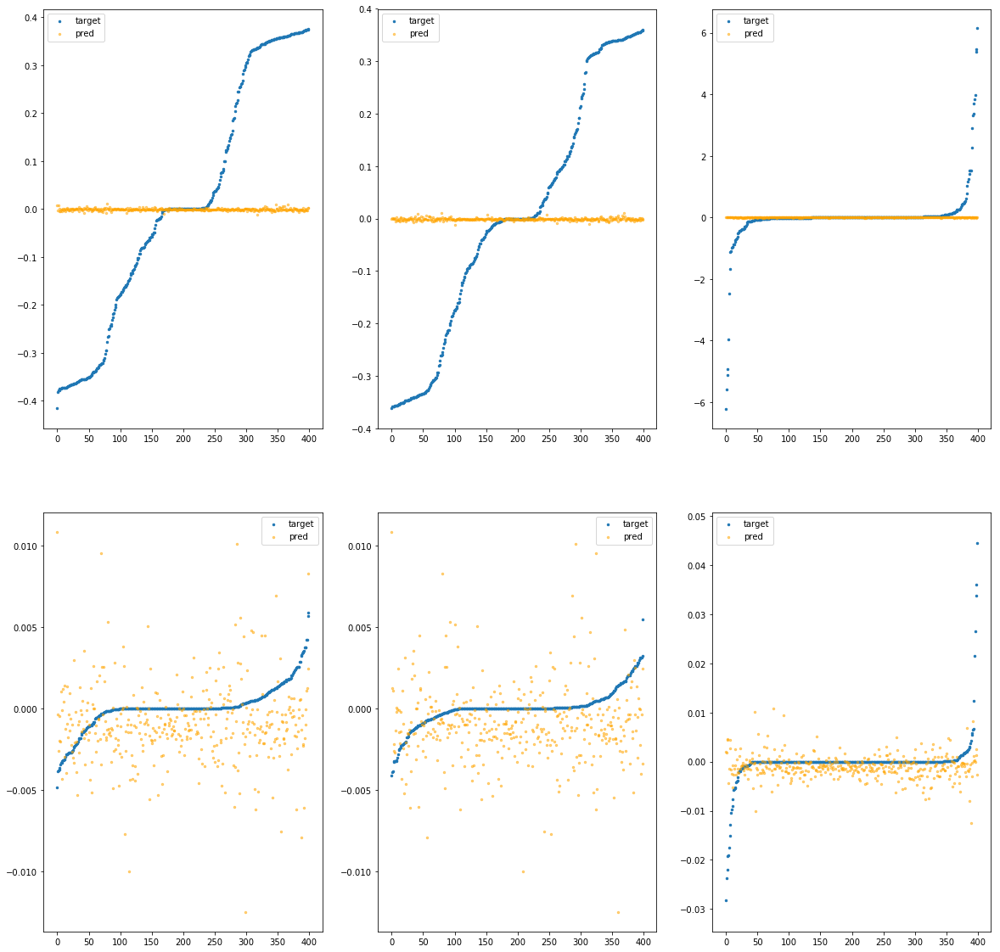

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa99bfce5b0>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.41e-03	4.14e-01	2.06e-01	2.87e+02	6.43e-02	4.14e-03
y		-9.41e-04	3.63e-01	1.88e-01	3.81e+01	5.49e-02	3.01e-03
z		-1.37e-03	6.23e+00	2.77e-01	4.49e+01	8.76e-01	7.67e-01
phi		-2.06e+00	9.16e-03	1.78e-03	1.36e+05	5.70e-06	3.25e-11
theta		-3.32e+00	1.03e-02	1.72e-03	9.49e+03	5.48e-06	3.00e-11
psi		-9.88e-02	4.19e-02	2.47e-03	2.94e+04	2.70e-05	7.27e-10


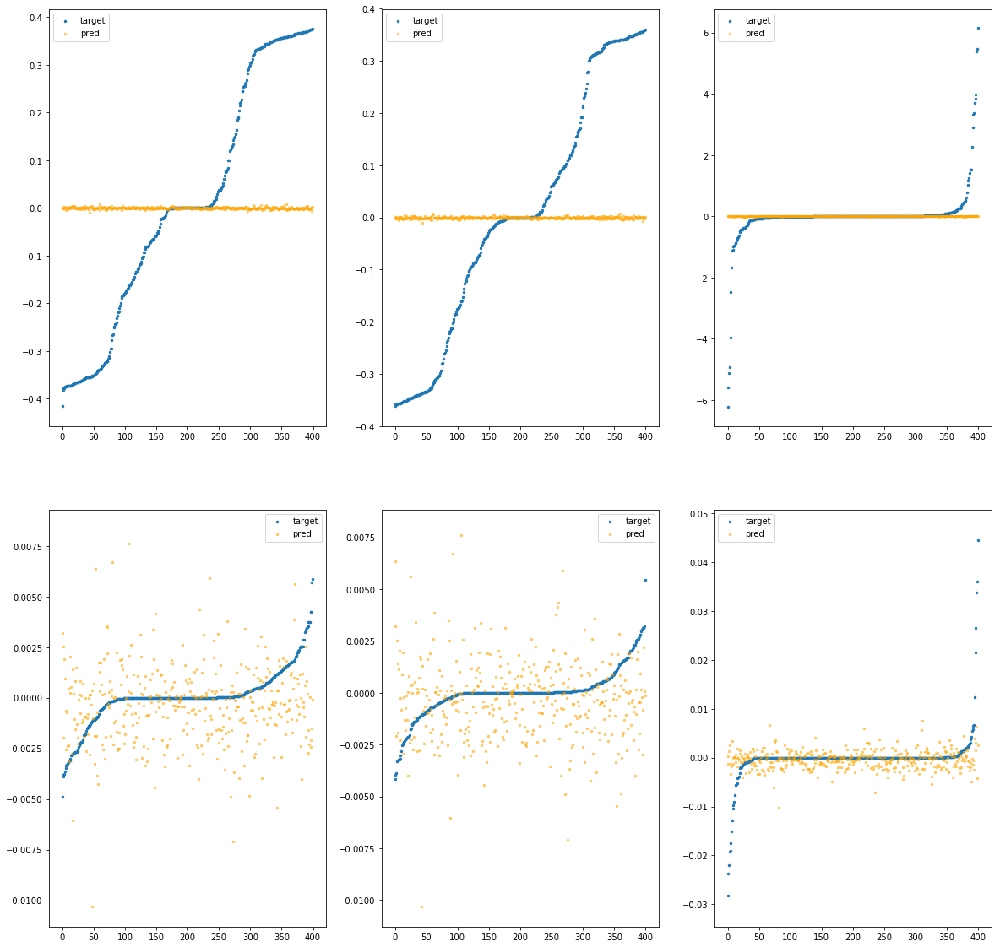

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa99bfce610>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.00e-03	4.13e-01	2.06e-01	4.87e+02	6.44e-02	4.14e-03
y		-1.64e-04	3.63e-01	1.88e-01	1.25e+02	5.48e-02	3.01e-03
z		-9.69e-04	6.23e+00	2.77e-01	5.60e+01	8.76e-01	7.67e-01
phi		-2.04e+00	9.29e-03	1.84e-03	1.93e+05	5.66e-06	3.20e-11
theta		-3.38e+00	1.05e-02	1.81e-03	9.68e+04	5.56e-06	3.09e-11
psi		-1.58e-01	4.96e-02	2.49e-03	4.28e+04	2.84e-05	8.07e-10


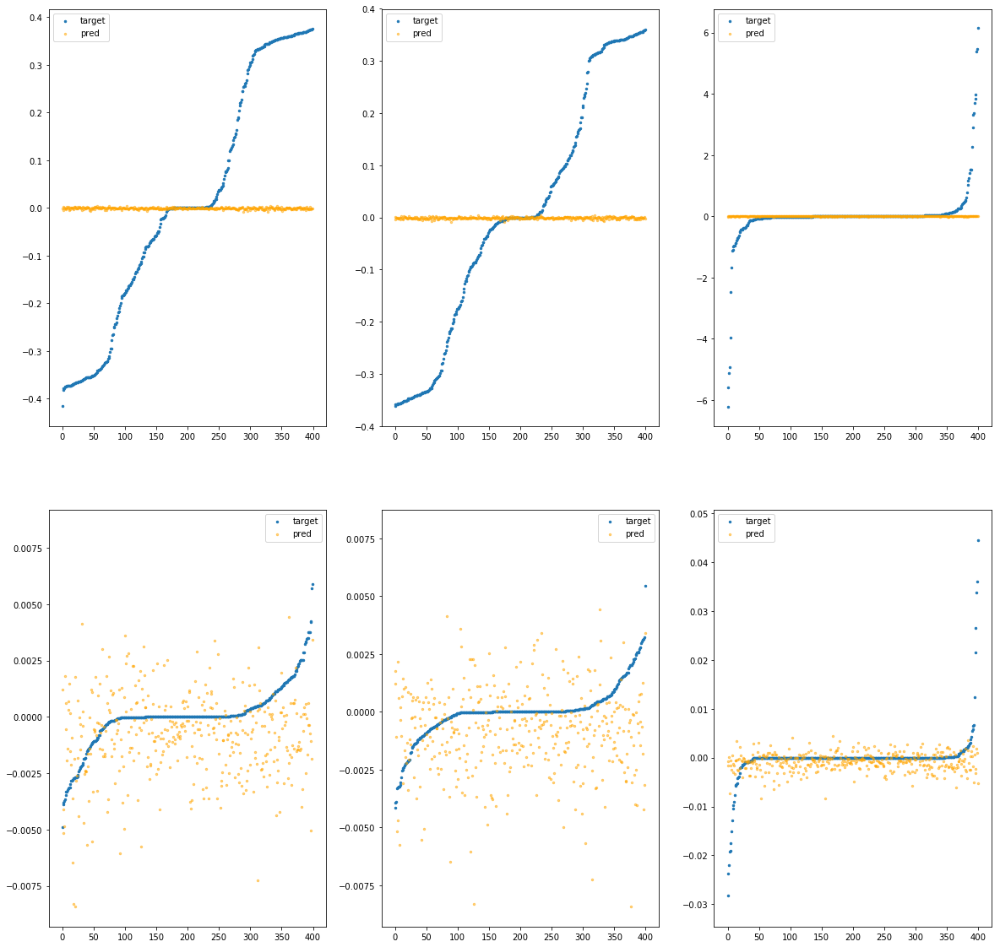

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa99bfce670>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.36e-03	4.13e-01	2.06e-01	6.91e+02	6.43e-02	4.13e-03
y		-6.03e-04	3.64e-01	1.88e-01	8.46e+01	5.49e-02	3.01e-03
z		-1.22e-03	6.22e+00	2.77e-01	2.99e+01	8.76e-01	7.67e-01
phi		-2.05e+00	1.14e-02	1.78e-03	2.84e+05	5.68e-06	3.22e-11
theta		-3.33e+00	9.99e-03	1.76e-03	8.60e+04	5.50e-06	3.02e-11
psi		-1.55e-01	4.54e-02	2.57e-03	2.90e+04	2.83e-05	8.02e-10


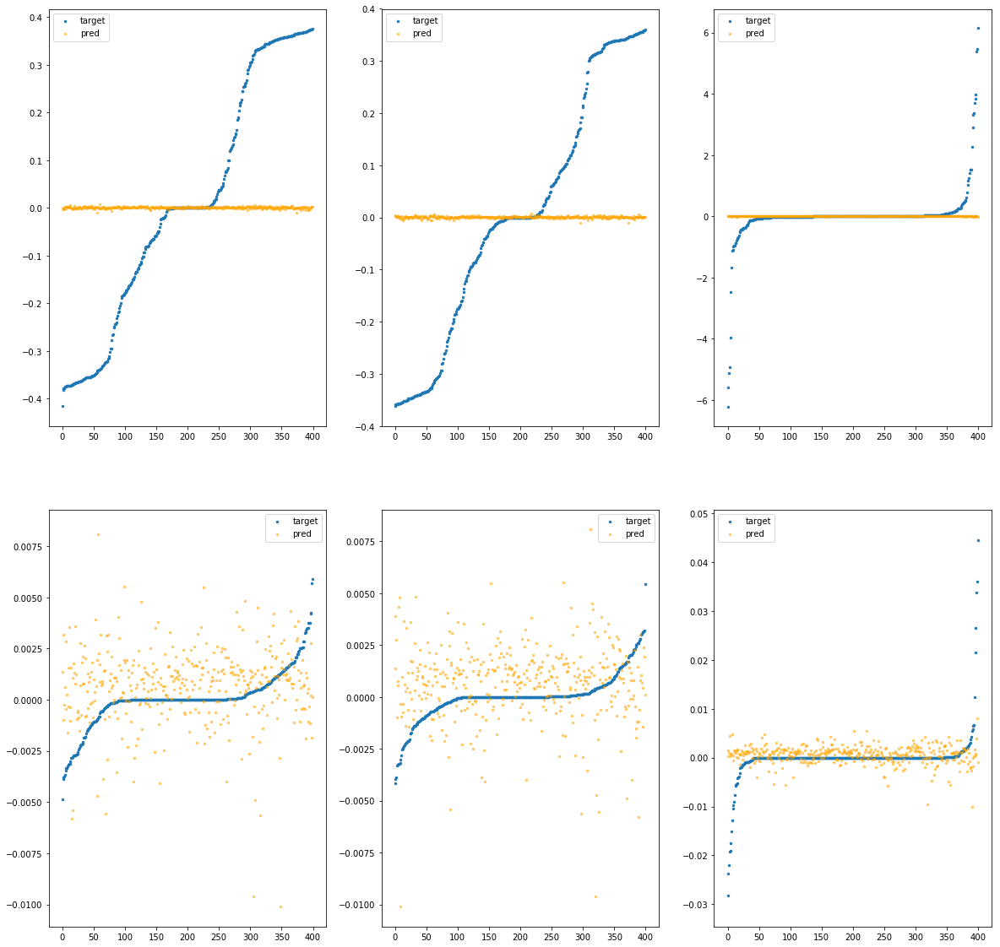

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa99bfce6d0>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.52e-03	4.18e-01	2.06e-01	1.51e+02	6.43e-02	4.14e-03
y		-3.98e-04	3.61e-01	1.88e-01	2.60e+01	5.48e-02	3.01e-03
z		-1.03e-03	6.23e+00	2.77e-01	2.66e+01	8.76e-01	7.67e-01
phi		-2.18e+00	1.11e-02	1.74e-03	6.45e+04	5.92e-06	3.50e-11
theta		-3.26e+00	1.04e-02	1.68e-03	2.29e+04	5.41e-06	2.93e-11
psi		-8.26e-02	4.11e-02	2.39e-03	3.01e+04	2.66e-05	7.05e-10


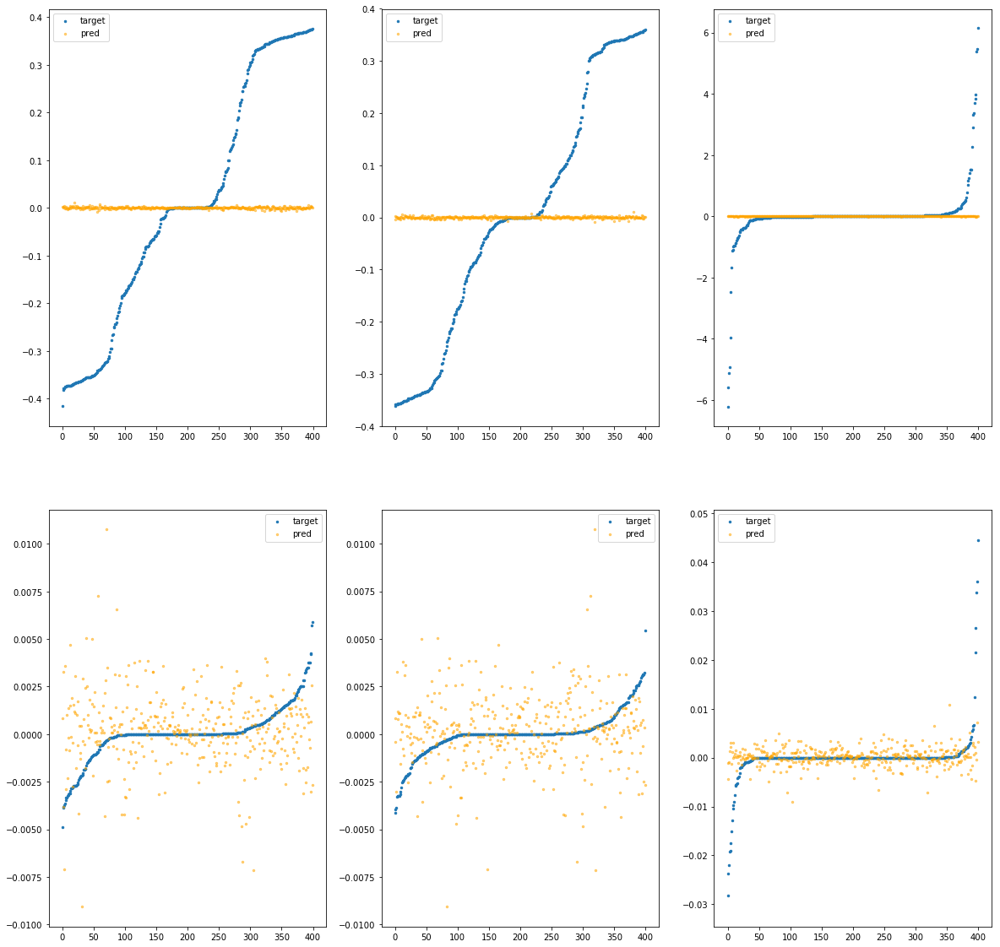

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa99bfce730>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.56e-03	4.08e-01	2.06e-01	6.46e+02	6.43e-02	4.13e-03
y		-2.81e-03	3.63e-01	1.88e-01	1.01e+02	5.50e-02	3.02e-03
z		-1.43e-03	6.22e+00	2.77e-01	4.93e+01	8.76e-01	7.68e-01
phi		-2.67e+00	1.27e-02	2.02e-03	2.56e+05	6.82e-06	4.66e-11
theta		-3.92e+00	8.47e-03	1.91e-03	9.68e+04	6.25e-06	3.91e-11
psi		-1.27e-01	4.28e-02	2.59e-03	3.22e+04	2.77e-05	7.65e-10


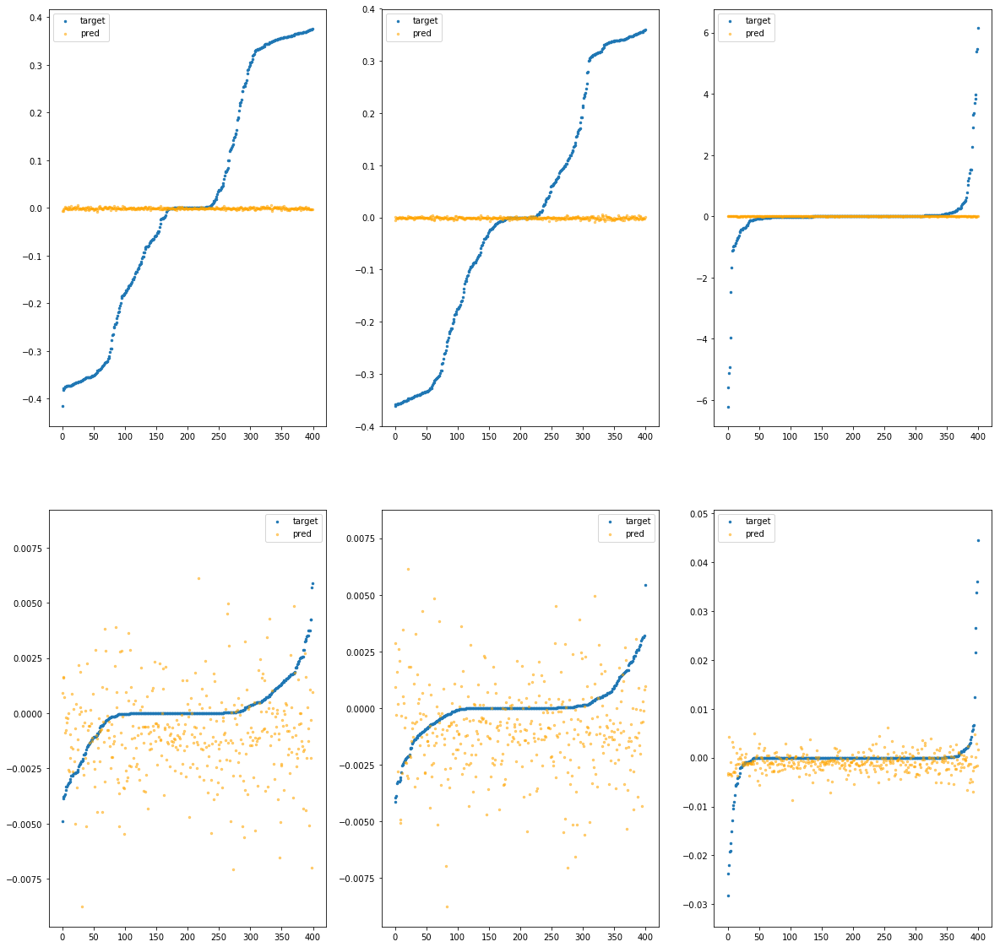

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa99bfce790>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.43e-02	4.62e-01	2.11e-01	4.54e+03	6.70e-02	4.48e-03
y		-2.33e-02	4.19e-01	1.92e-01	4.10e+02	5.61e-02	3.15e-03
z		2.73e-04	6.26e+00	2.84e-01	3.13e+02	8.75e-01	7.65e-01
phi		-4.01e+02	1.22e-01	2.00e-02	2.00e+06	7.49e-04	5.61e-07
theta		-5.88e+02	1.22e-01	2.00e-02	4.06e+05	7.48e-04	5.60e-07
psi		-3.07e+01	1.11e-01	2.04e-02	4.23e+05	7.78e-04	6.05e-07


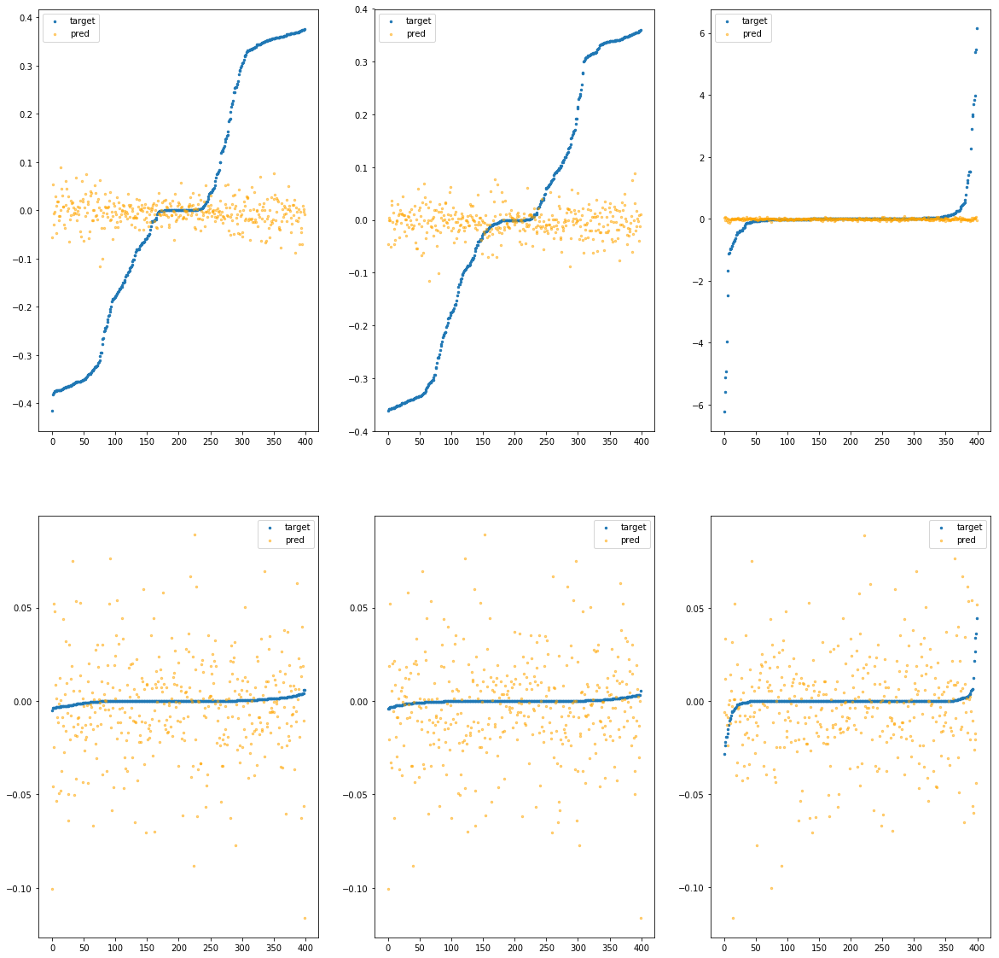

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa99bfce7f0>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.89e-03	5.13e-01	2.08e-01	5.08e+03	6.46e-02	4.18e-03
y		-5.53e-03	4.55e-01	1.89e-01	1.06e+03	5.51e-02	3.04e-03
z		9.27e-04	6.21e+00	2.87e-01	8.83e+02	8.74e-01	7.64e-01
phi		-6.33e+02	1.82e-01	2.24e-02	2.48e+06	1.18e-03	1.39e-06
theta		-9.32e+02	1.79e-01	2.25e-02	3.76e+05	1.19e-03	1.41e-06
psi		-4.75e+01	1.79e-01	2.27e-02	7.83e+05	1.19e-03	1.42e-06


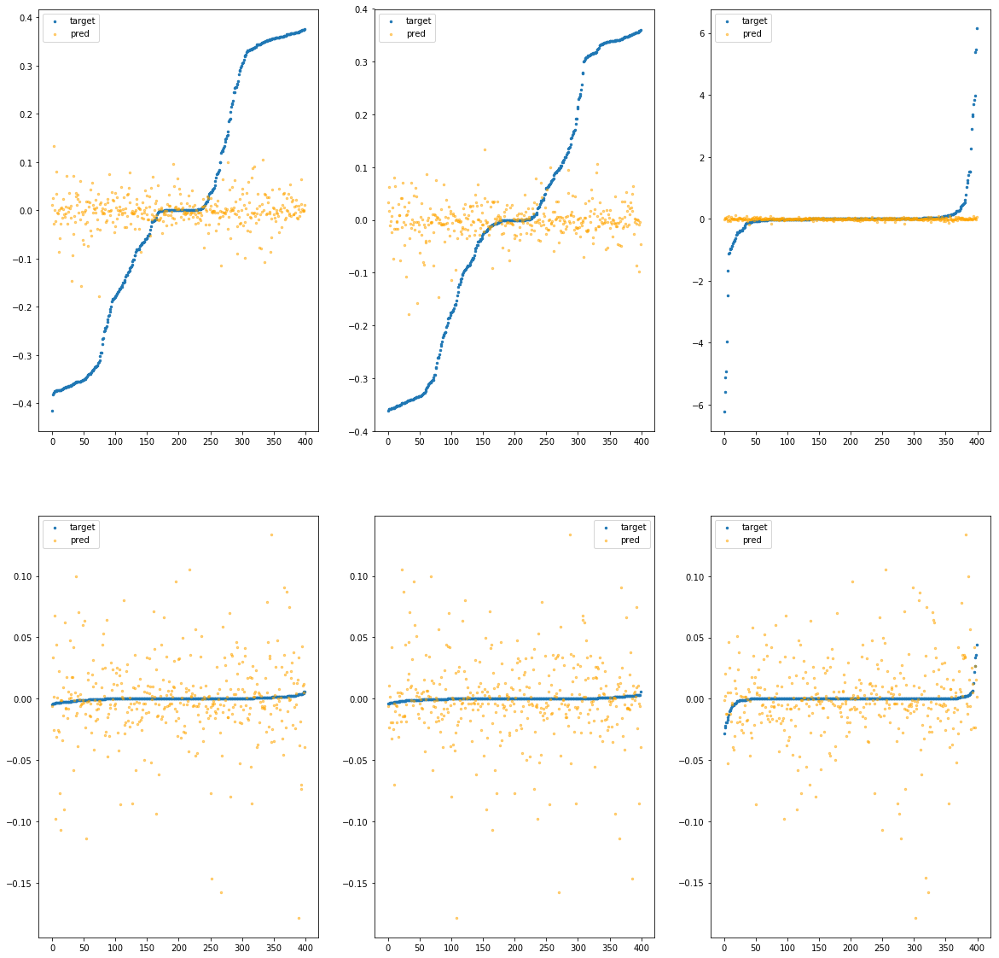

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa99bfce850>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.22e-02	5.33e-01	2.09e-01	5.88e+03	6.62e-02	4.38e-03
y		-1.75e-02	4.72e-01	1.92e-01	7.73e+02	5.58e-02	3.11e-03
z		-2.63e-03	6.24e+00	2.91e-01	5.78e+02	8.77e-01	7.69e-01
phi		-1.28e+03	1.77e-01	3.70e-02	2.45e+06	2.38e-03	5.68e-06
theta		-1.88e+03	1.77e-01	3.70e-02	5.29e+05	2.38e-03	5.68e-06
psi		-9.85e+01	1.83e-01	3.69e-02	1.01e+06	2.44e-03	5.96e-06


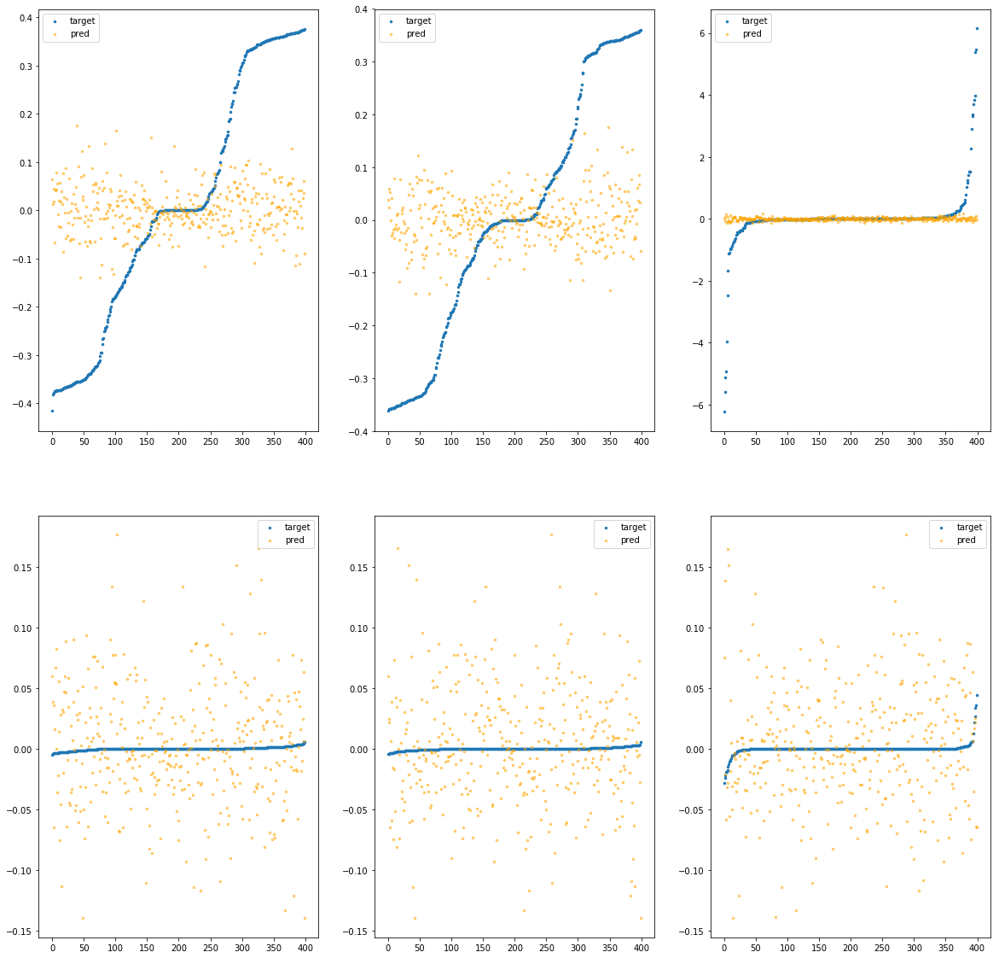

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa99bfce8b0>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.61e-02	5.34e-01	2.15e-01	9.12e+03	6.96e-02	4.85e-03
y		-7.08e-02	5.31e-01	1.95e-01	1.56e+03	5.87e-02	3.45e-03
z		1.68e-03	6.12e+00	2.97e-01	6.62e+02	8.73e-01	7.63e-01
phi		-1.68e+03	1.87e-01	4.12e-02	3.62e+06	3.14e-03	9.84e-06
theta		-2.47e+03	1.86e-01	4.13e-02	9.21e+05	3.13e-03	9.82e-06
psi		-1.27e+02	1.75e-01	4.10e-02	1.07e+06	3.13e-03	9.80e-06


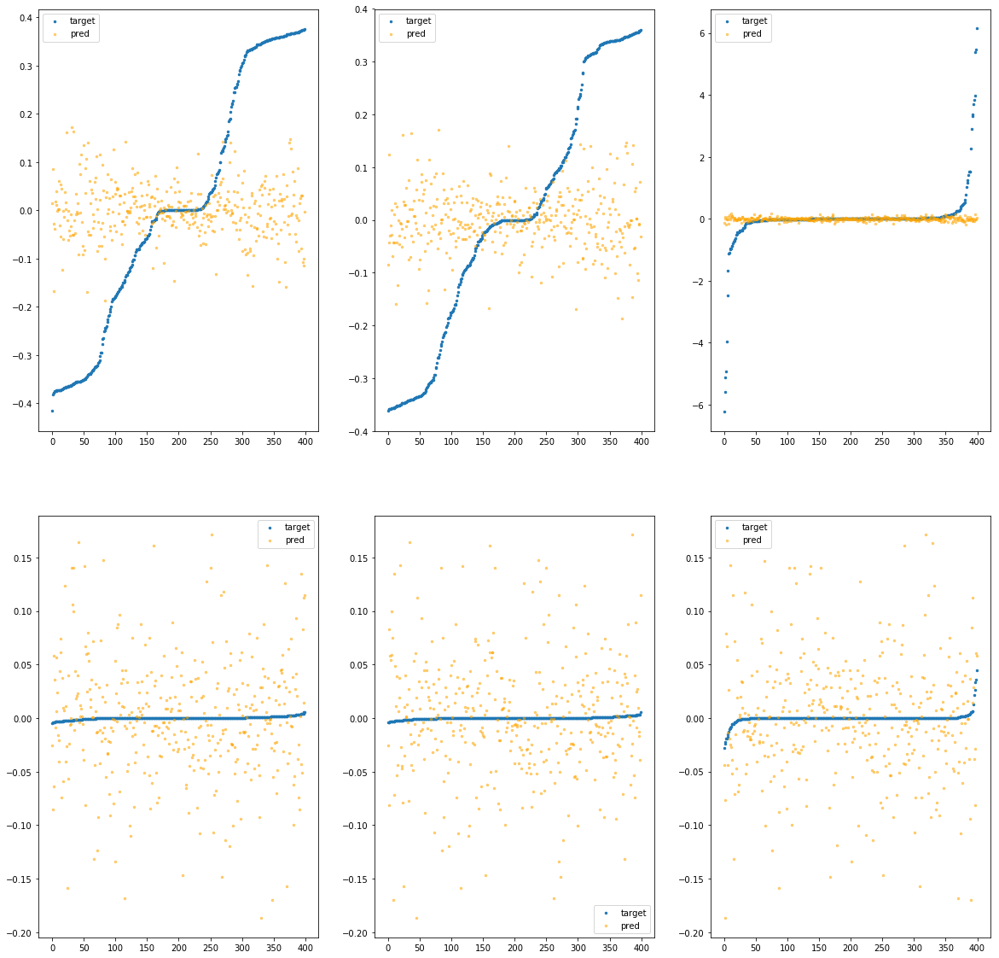

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa99bfce910>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.33e-02	5.93e-01	2.11e-01	5.31e+03	6.69e-02	4.47e-03
y		-5.18e-02	5.00e-01	1.96e-01	1.01e+03	5.77e-02	3.32e-03
z		-1.99e-03	6.28e+00	3.00e-01	1.04e+03	8.77e-01	7.68e-01
phi		-1.79e+03	2.46e-01	4.38e-02	1.88e+06	3.33e-03	1.11e-05
theta		-2.62e+03	2.46e-01	4.38e-02	1.04e+06	3.33e-03	1.11e-05
psi		-1.35e+02	2.46e-01	4.38e-02	8.04e+05	3.34e-03	1.12e-05


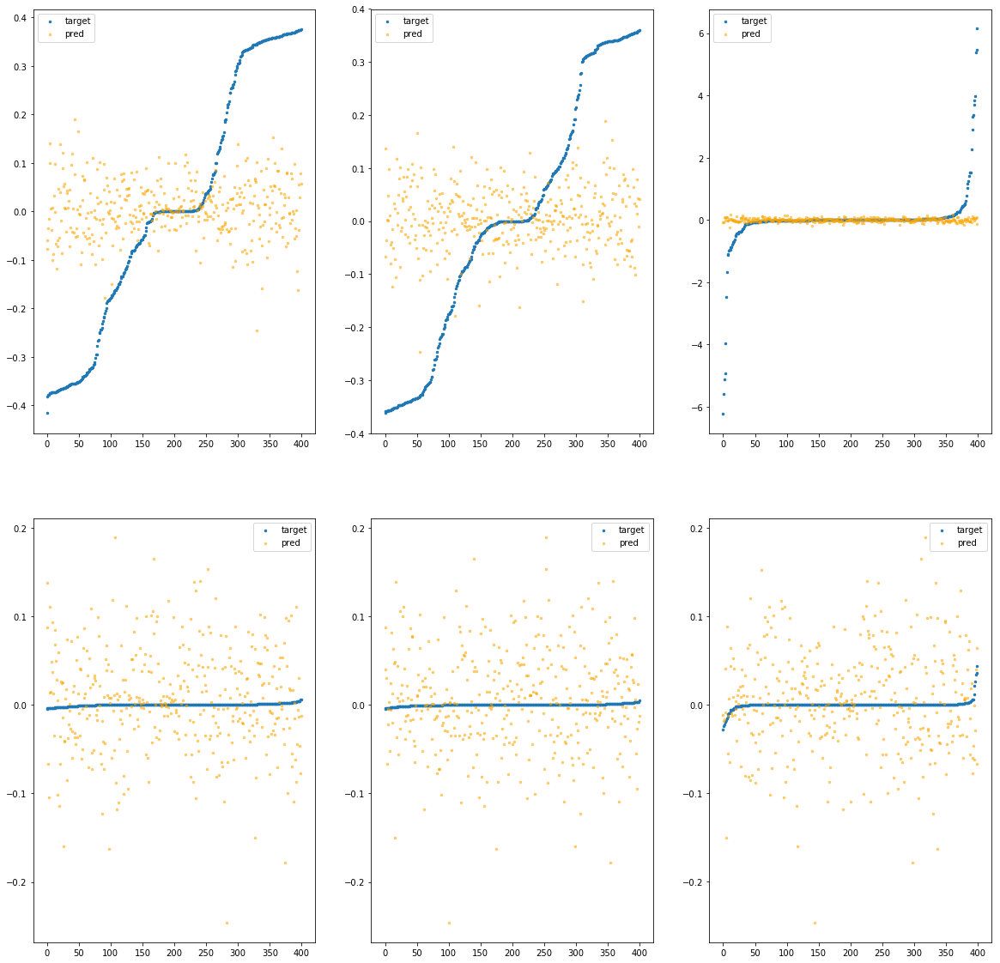

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa99bfce970>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.34e-03	4.30e-01	2.07e-01	2.54e+03	6.47e-02	4.19e-03
y		4.63e-03	3.83e-01	1.88e-01	1.69e+02	5.46e-02	2.98e-03
z		-2.44e-03	6.22e+00	2.80e-01	2.60e+02	8.77e-01	7.69e-01
phi		-7.69e+01	7.42e-02	8.31e-03	1.04e+06	1.45e-04	2.10e-08
theta		-1.12e+02	7.46e-02	8.28e-03	3.09e+05	1.44e-04	2.07e-08
psi		-5.39e+00	7.05e-02	8.75e-03	3.42e+05	1.57e-04	2.46e-08


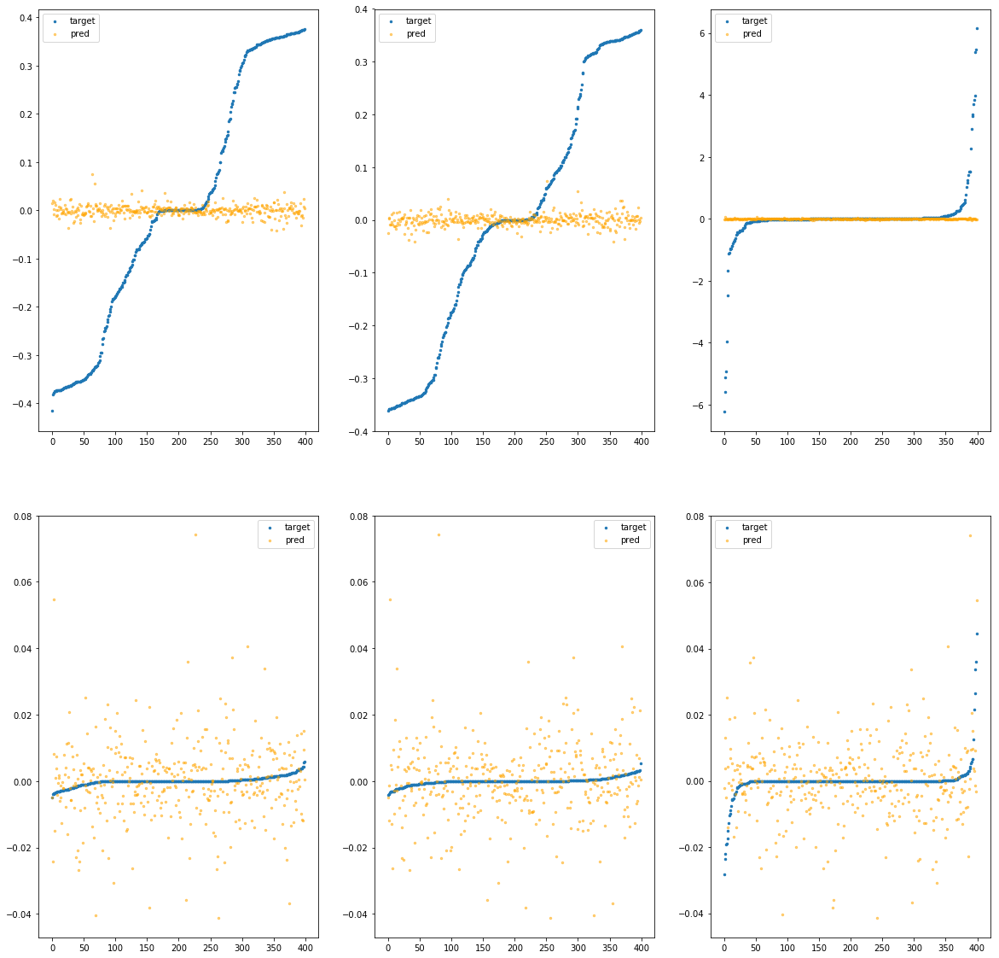

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa99bfce9d0>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.30e-02	4.54e-01	2.09e-01	3.10e+03	6.56e-02	4.30e-03
y		-1.37e-03	4.19e-01	1.88e-01	3.02e+02	5.49e-02	3.01e-03
z		-7.64e-03	6.22e+00	2.83e-01	3.55e+02	8.82e-01	7.77e-01
phi		-2.85e+02	1.26e-01	1.56e-02	1.31e+06	5.32e-04	2.83e-07
theta		-4.22e+02	1.32e-01	1.56e-02	4.24e+05	5.37e-04	2.88e-07
psi		-2.07e+01	1.24e-01	1.58e-02	2.41e+05	5.31e-04	2.82e-07


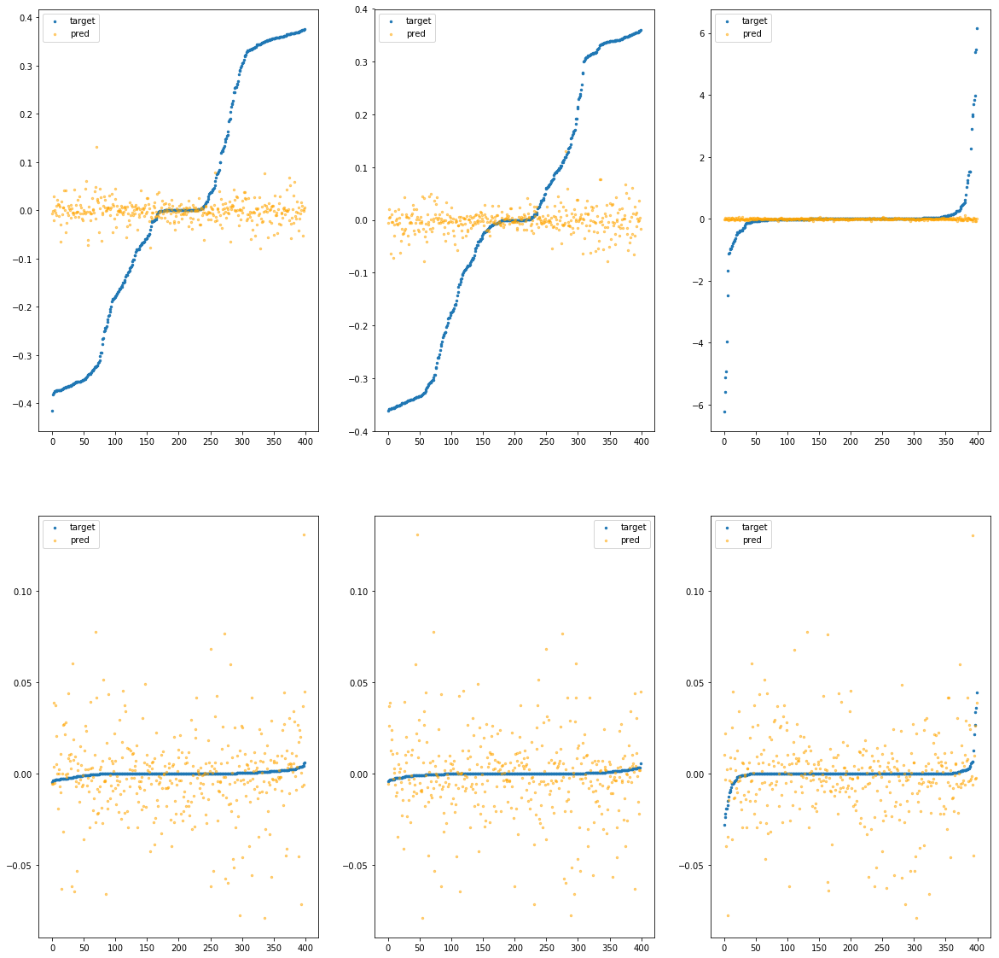

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa99bfcea30>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.14e-02	4.80e-01	2.10e-01	5.55e+03	6.48e-02	4.21e-03
y		-3.47e-02	4.59e-01	1.93e-01	2.20e+02	5.67e-02	3.22e-03
z		6.94e-03	6.20e+00	2.89e-01	3.52e+02	8.69e-01	7.55e-01
phi		-8.97e+02	1.46e-01	3.03e-02	2.56e+06	1.67e-03	2.79e-06
theta		-1.32e+03	1.44e-01	3.03e-02	2.25e+05	1.67e-03	2.80e-06
psi		-6.86e+01	1.59e-01	3.03e-02	9.60e+05	1.71e-03	2.92e-06


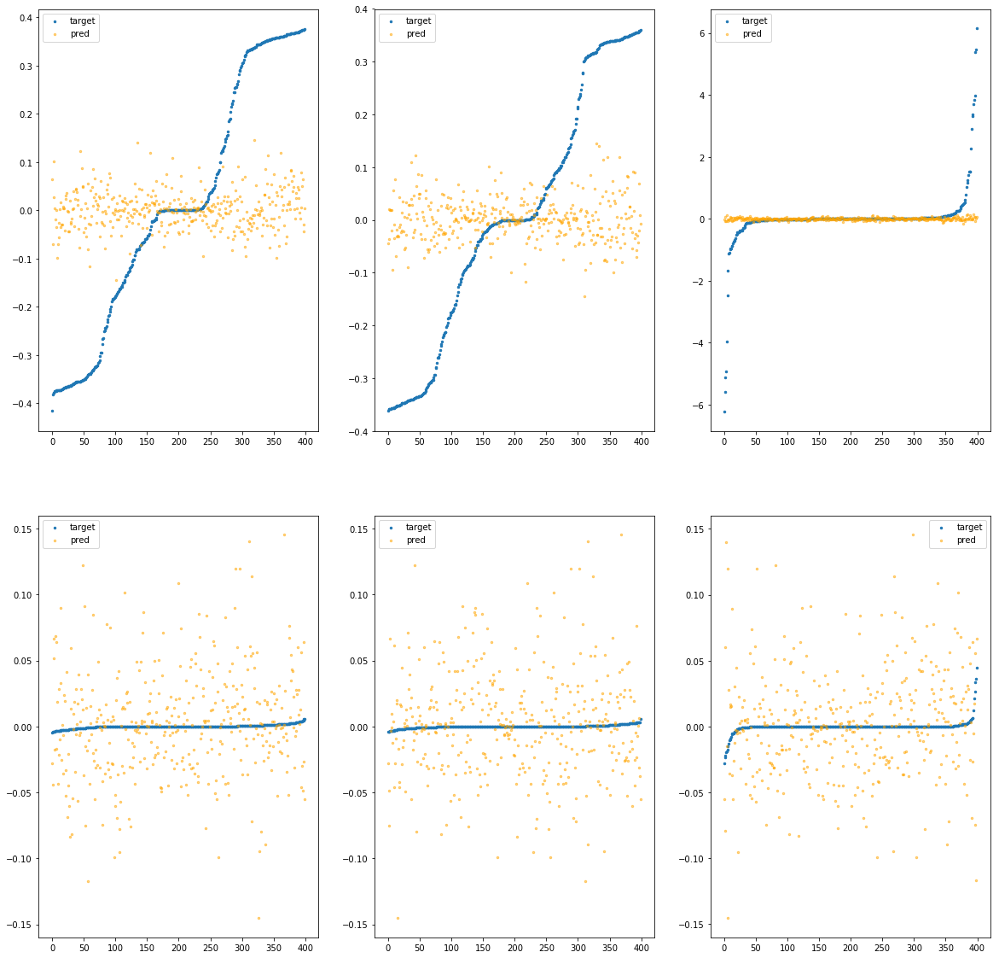

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa99bfcea90>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.73e-02	5.08e-01	2.10e-01	5.37e+03	6.59e-02	4.34e-03
y		-1.50e-02	4.90e-01	1.93e-01	8.26e+02	5.56e-02	3.10e-03
z		3.63e-03	6.23e+00	2.88e-01	5.51e+02	8.72e-01	7.60e-01
phi		-8.36e+02	1.52e-01	2.96e-02	1.74e+06	1.56e-03	2.43e-06
theta		-1.23e+03	1.52e-01	2.96e-02	8.57e+05	1.56e-03	2.44e-06
psi		-6.46e+01	1.52e-01	2.99e-02	6.82e+05	1.61e-03	2.59e-06


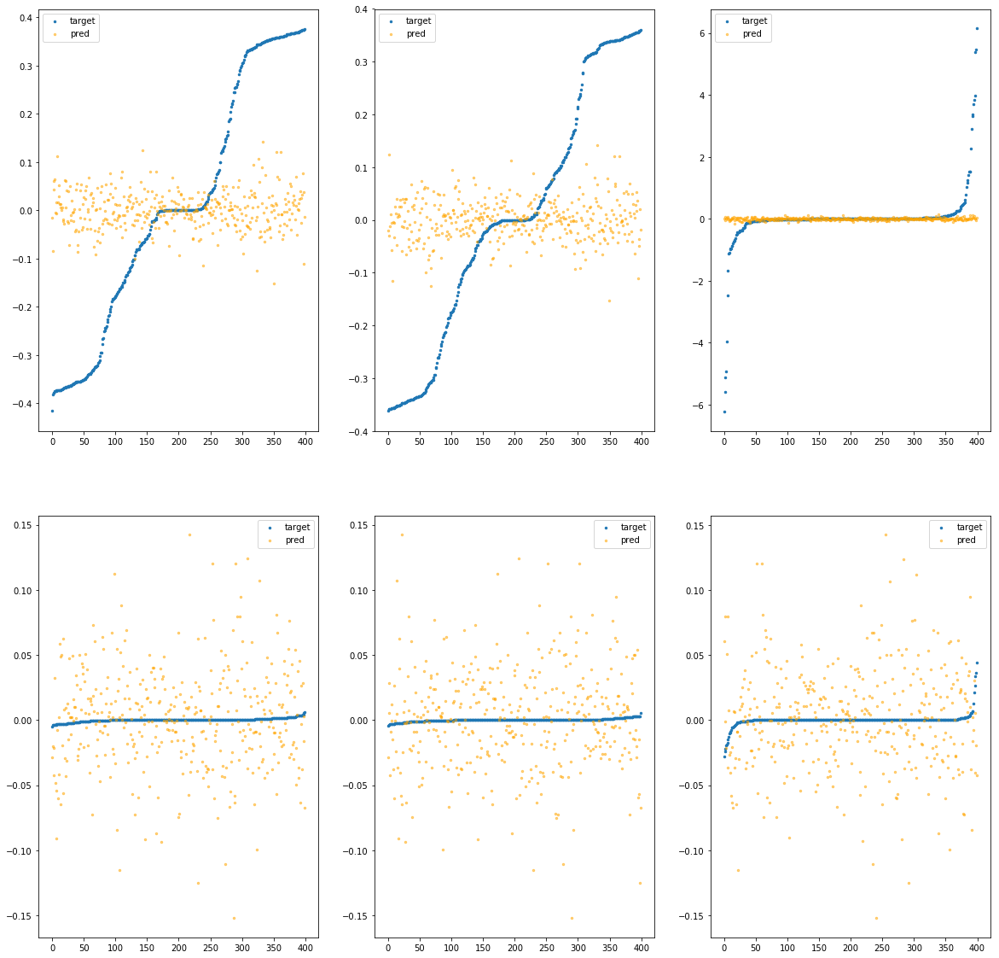

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa99bfceaf0>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.92e-02	5.80e-01	2.05e-01	2.11e+03	6.29e-02	3.95e-03
y		-3.24e-02	5.61e-01	1.92e-01	9.75e+02	5.66e-02	3.20e-03
z		1.00e-02	6.12e+00	2.89e-01	4.04e+02	8.66e-01	7.50e-01
phi		-9.91e+02	2.06e-01	3.03e-02	8.99e+05	1.85e-03	3.41e-06
theta		-1.45e+03	2.06e-01	3.02e-02	8.82e+05	1.84e-03	3.39e-06
psi		-7.51e+01	2.06e-01	3.05e-02	4.44e+05	1.87e-03	3.48e-06


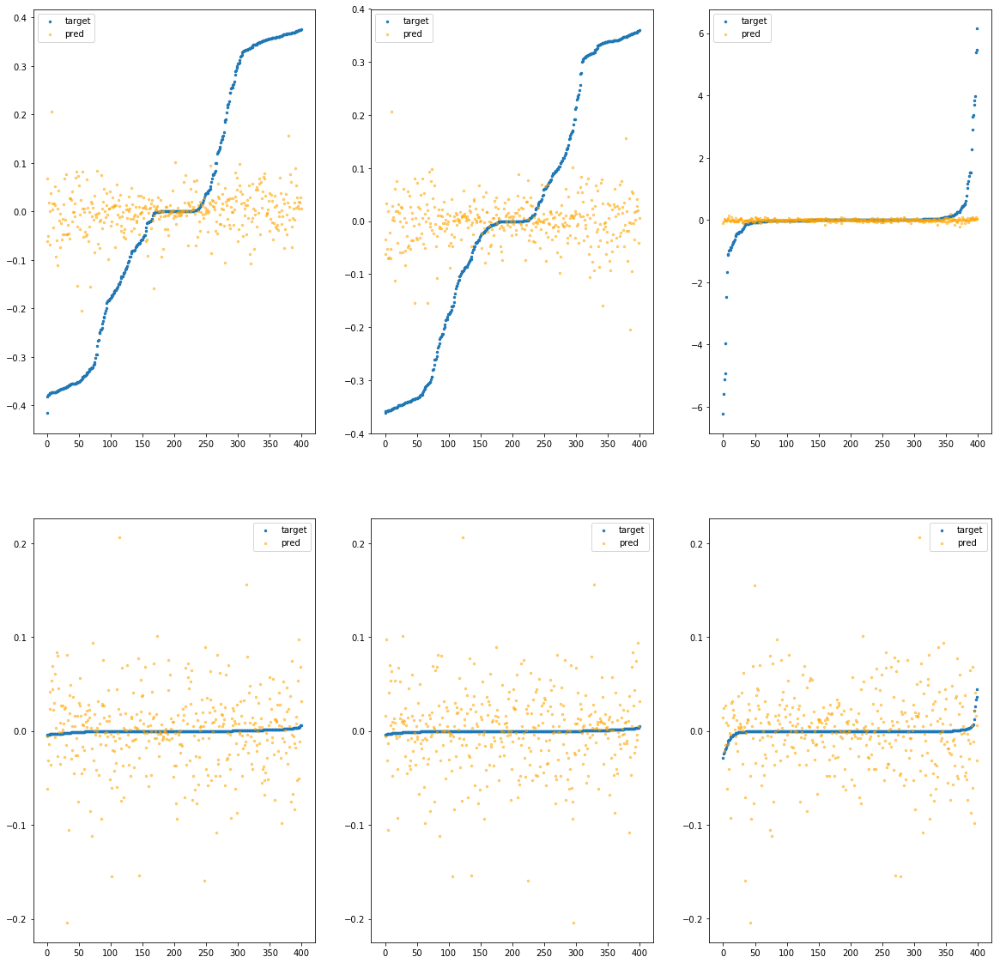

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa99bfceb50>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.67e-03	4.13e-01	2.07e-01	2.65e+03	6.43e-02	4.13e-03
y		5.35e-04	3.95e-01	1.88e-01	2.58e+02	5.48e-02	3.00e-03
z		-8.20e-04	6.23e+00	2.79e-01	1.57e+02	8.76e-01	7.67e-01
phi		-7.63e+01	1.29e-01	4.61e-03	2.19e+06	1.44e-04	2.07e-08
theta		-1.14e+02	1.28e-01	4.64e-03	2.67e+05	1.46e-04	2.14e-08
psi		-5.88e+00	1.30e-01	5.43e-03	8.26e+04	1.69e-04	2.85e-08


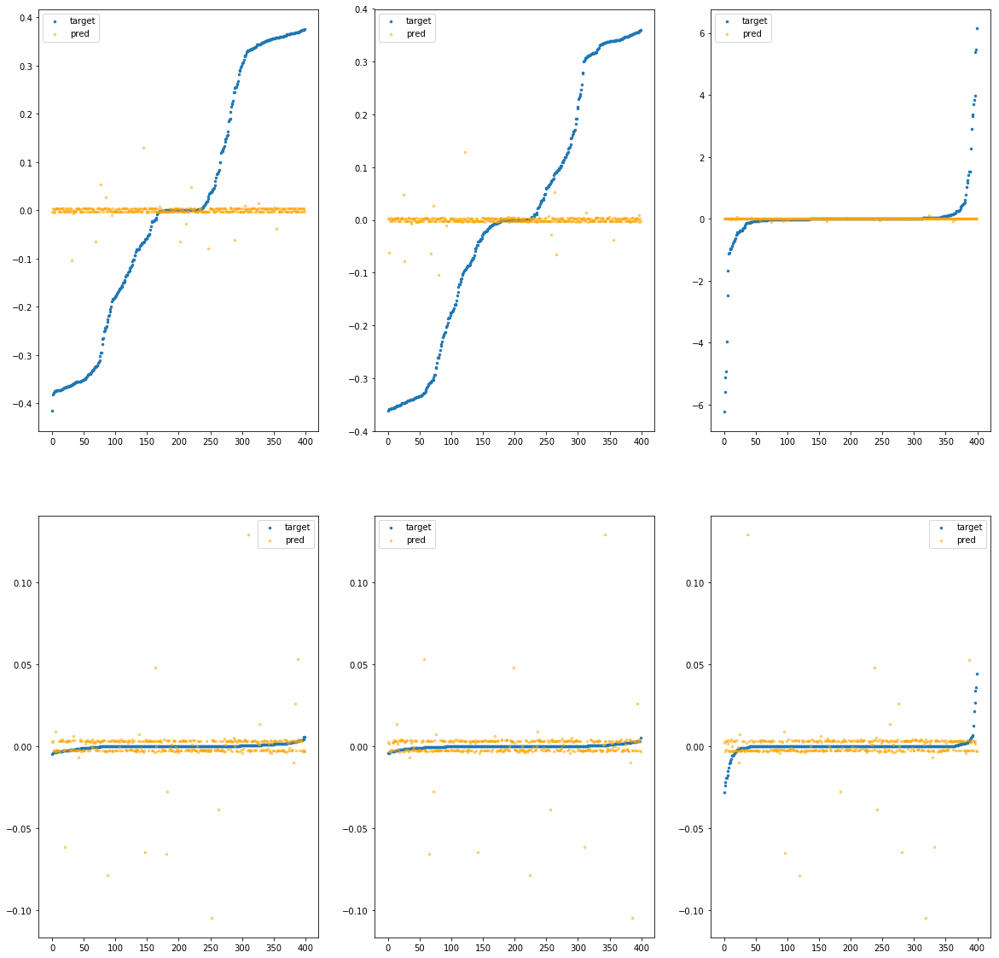

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa99bfcebb0>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		3.92e-03	4.09e-01	2.05e-01	1.30e+03	6.39e-02	4.08e-03
y		-6.67e-03	3.93e-01	1.89e-01	2.56e+02	5.52e-02	3.05e-03
z		1.69e-03	6.22e+00	2.79e-01	1.28e+02	8.73e-01	7.63e-01
phi		-7.19e+01	5.76e-02	7.75e-03	4.21e+05	1.36e-04	1.84e-08
theta		-1.03e+02	5.72e-02	7.56e-03	2.30e+05	1.32e-04	1.75e-08
psi		-5.29e+00	6.47e-02	7.99e-03	9.83e+04	1.54e-04	2.38e-08


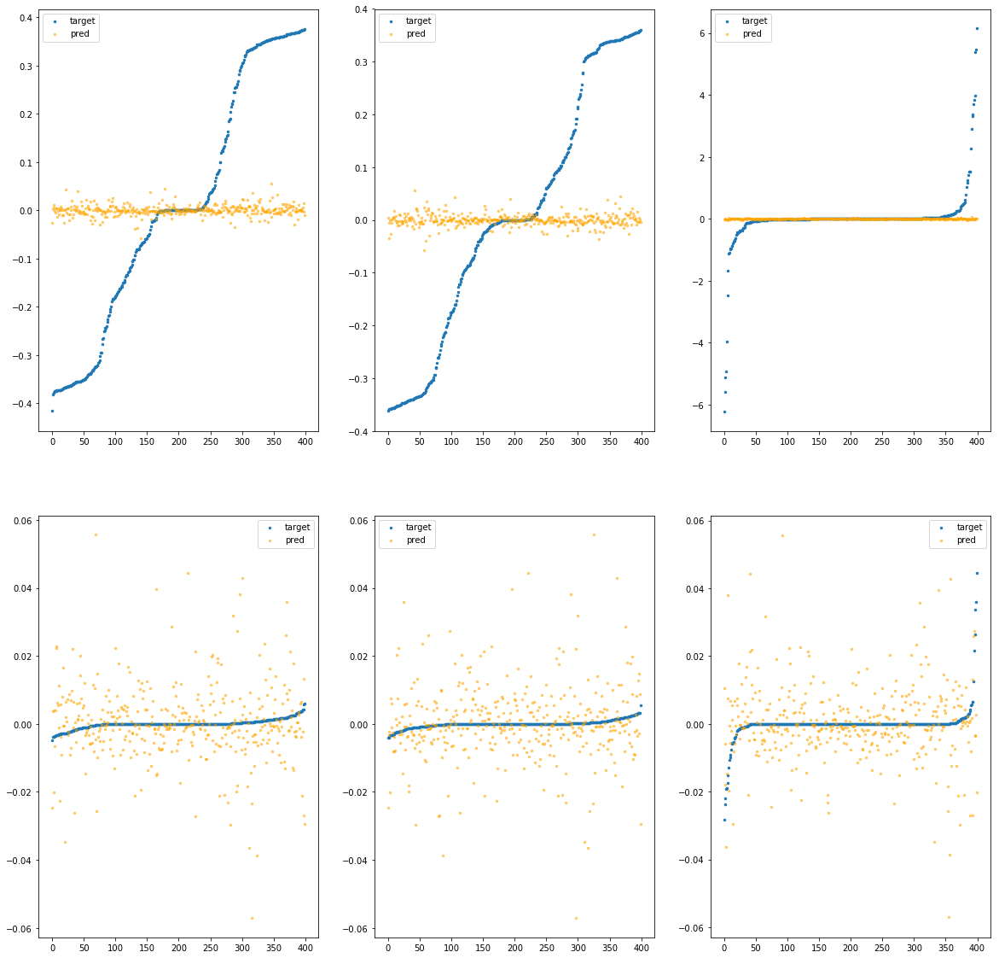

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa99bfcec10>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.66e-02	4.48e-01	2.08e-01	2.23e+03	6.52e-02	4.25e-03
y		-1.59e-03	3.94e-01	1.89e-01	4.90e+02	5.49e-02	3.01e-03
z		-5.70e-04	6.23e+00	2.81e-01	2.80e+02	8.75e-01	7.66e-01
phi		-2.05e+02	7.34e-02	1.45e-02	1.01e+06	3.84e-04	1.47e-07
theta		-3.02e+02	7.60e-02	1.45e-02	6.26e+05	3.85e-04	1.48e-07
psi		-1.62e+01	7.34e-02	1.49e-02	2.70e+05	4.23e-04	1.79e-07


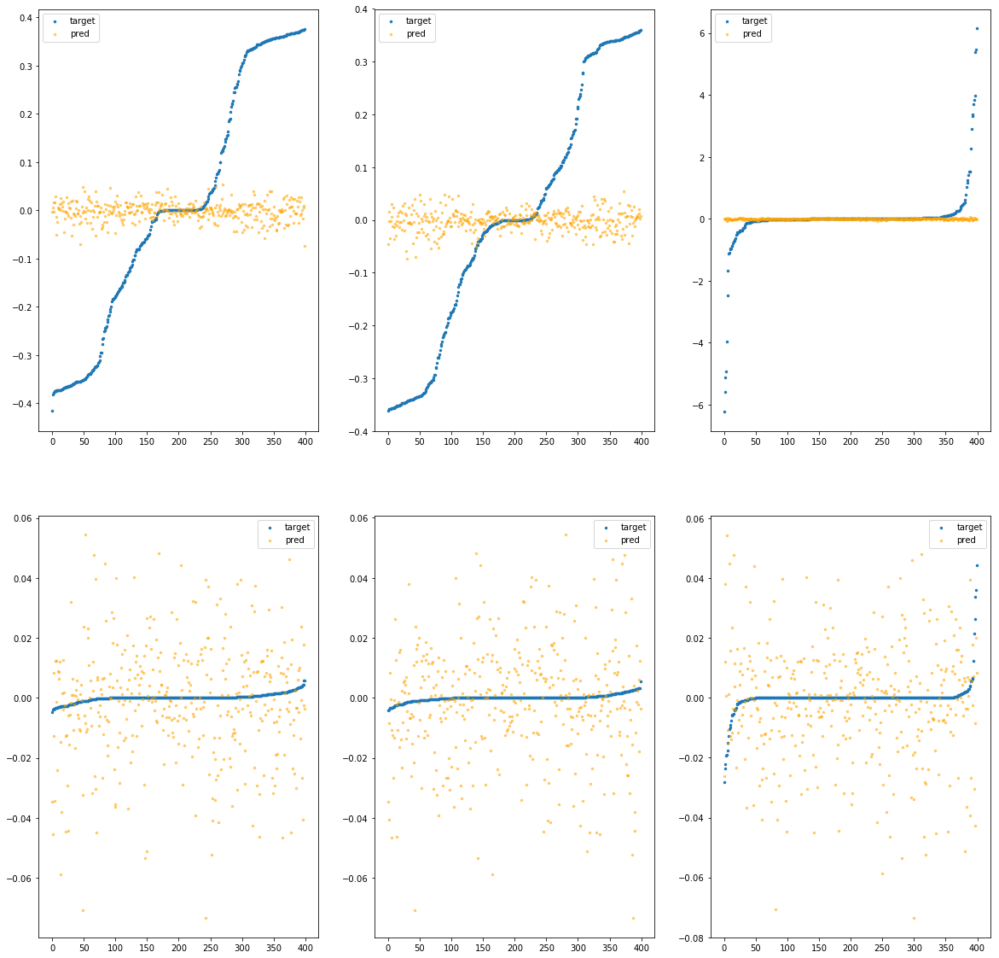

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa99bfcec70>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.88e-02	4.65e-01	2.09e-01	3.75e+03	6.53e-02	4.27e-03
y		-1.87e-02	4.47e-01	1.91e-01	6.95e+02	5.58e-02	3.12e-03
z		-7.31e-03	6.26e+00	2.86e-01	2.81e+02	8.81e-01	7.77e-01
phi		-4.19e+02	1.12e-01	2.11e-02	1.86e+06	7.82e-04	6.12e-07
theta		-6.13e+02	1.11e-01	2.11e-02	2.84e+05	7.79e-04	6.07e-07
psi		-3.15e+01	1.10e-01	2.13e-02	3.68e+05	7.98e-04	6.37e-07


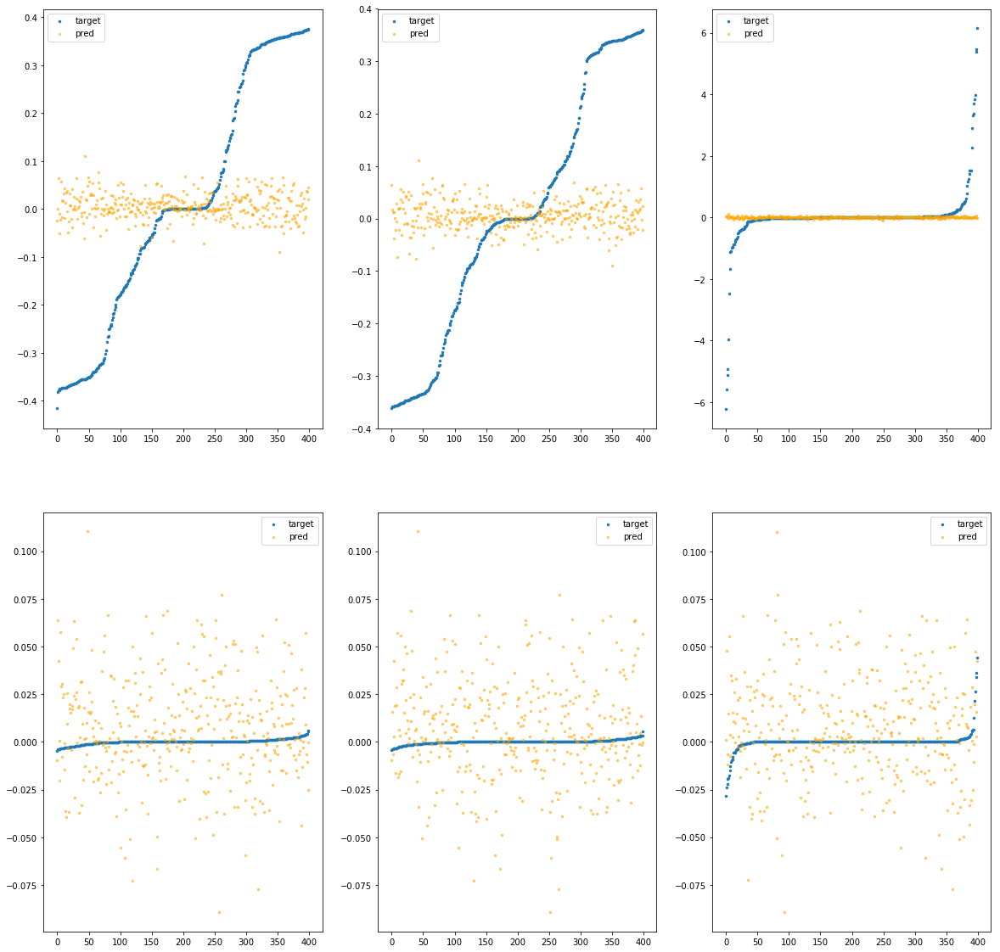

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa99bfcecd0>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.39e-02	5.13e-01	2.09e-01	7.38e+03	6.56e-02	4.31e-03
y		-5.31e-02	5.35e-01	1.96e-01	1.18e+03	5.77e-02	3.33e-03
z		-2.81e-03	6.19e+00	2.93e-01	6.64e+02	8.77e-01	7.70e-01
phi		-1.07e+03	1.81e-01	3.38e-02	3.44e+06	1.99e-03	3.96e-06
theta		-1.57e+03	1.83e-01	3.38e-02	1.48e+06	1.99e-03	3.98e-06
psi		-8.09e+01	1.83e-01	3.38e-02	7.36e+05	2.01e-03	4.04e-06


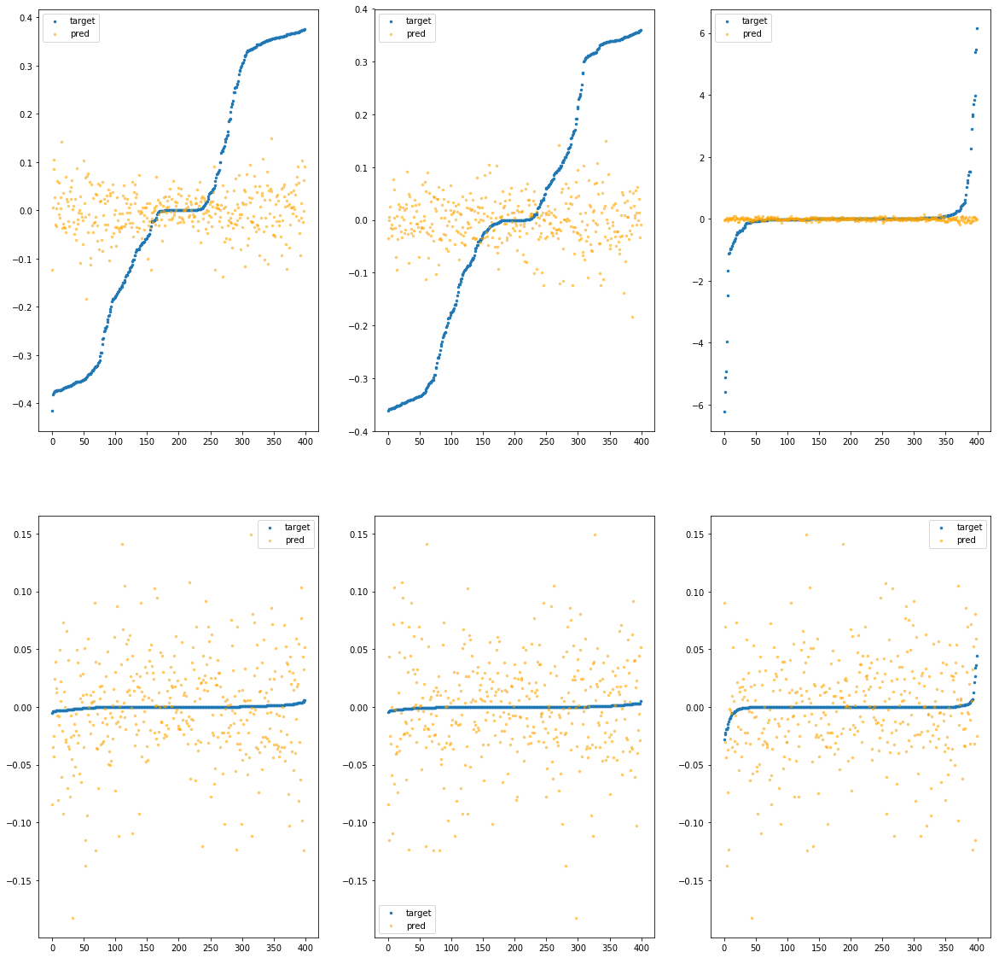

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa99bfced30>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		2.13e-03	4.31e-01	2.06e-01	4.00e+03	6.40e-02	4.09e-03
y		-3.68e-03	3.65e-01	1.89e-01	5.44e+02	5.50e-02	3.03e-03
z		-1.41e-03	6.22e+00	2.79e-01	2.70e+02	8.76e-01	7.68e-01
phi		-7.20e+01	1.64e-01	6.79e-03	1.42e+06	1.36e-04	1.85e-08
theta		-1.05e+02	1.64e-01	6.72e-03	5.54e+05	1.34e-04	1.80e-08
psi		-5.61e+00	1.64e-01	7.52e-03	1.55e+05	1.62e-04	2.63e-08


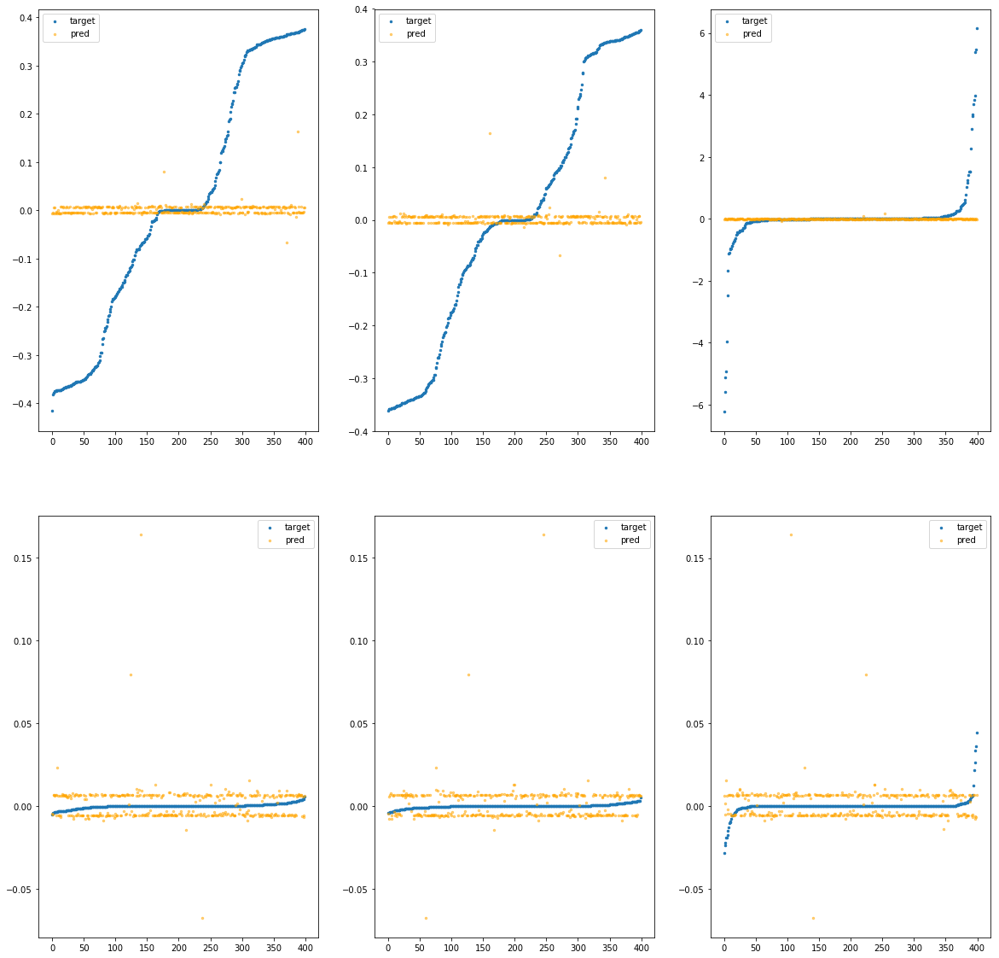

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa99bfced90>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e-03	4.07e-01	2.06e-01	9.15e+02	6.42e-02	4.12e-03
y		-1.44e-03	3.72e-01	1.88e-01	1.17e+02	5.49e-02	3.01e-03
z		-7.87e-04	6.22e+00	2.78e-01	8.86e+01	8.76e-01	7.67e-01
phi		-1.85e+01	2.18e-02	4.47e-03	3.25e+05	3.62e-05	1.31e-09
theta		-2.68e+01	2.39e-02	4.44e-03	1.16e+05	3.53e-05	1.25e-09
psi		-1.25e+00	3.91e-02	5.10e-03	9.56e+04	5.51e-05	3.03e-09


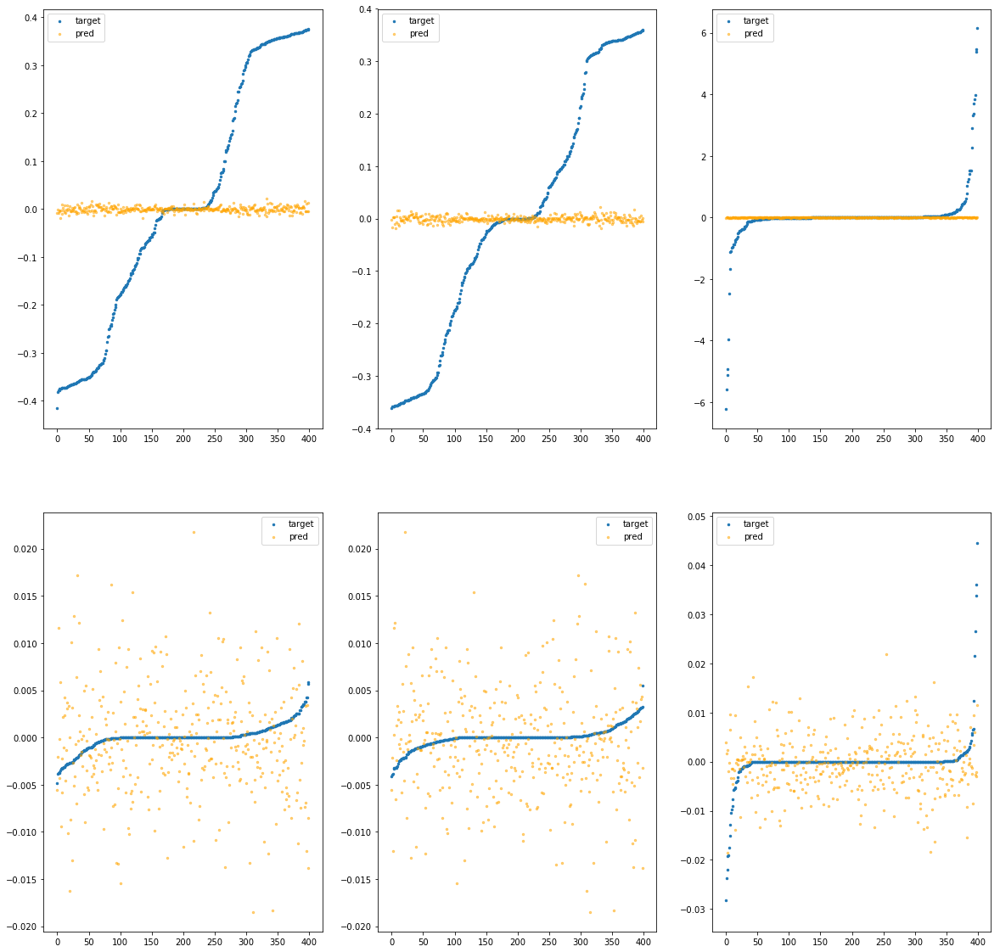

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa99bfcedf0>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.25e-03	4.08e-01	2.07e-01	1.94e+03	6.47e-02	4.19e-03
y		-2.36e-03	3.81e-01	1.89e-01	2.64e+02	5.50e-02	3.02e-03
z		-4.17e-03	6.23e+00	2.80e-01	2.08e+02	8.79e-01	7.72e-01
phi		-6.37e+01	4.98e-02	8.11e-03	7.01e+05	1.21e-04	1.45e-08
theta		-9.26e+01	4.87e-02	8.00e-03	2.60e+05	1.19e-04	1.41e-08
psi		-4.52e+00	5.54e-02	8.53e-03	3.03e+05	1.36e-04	1.84e-08


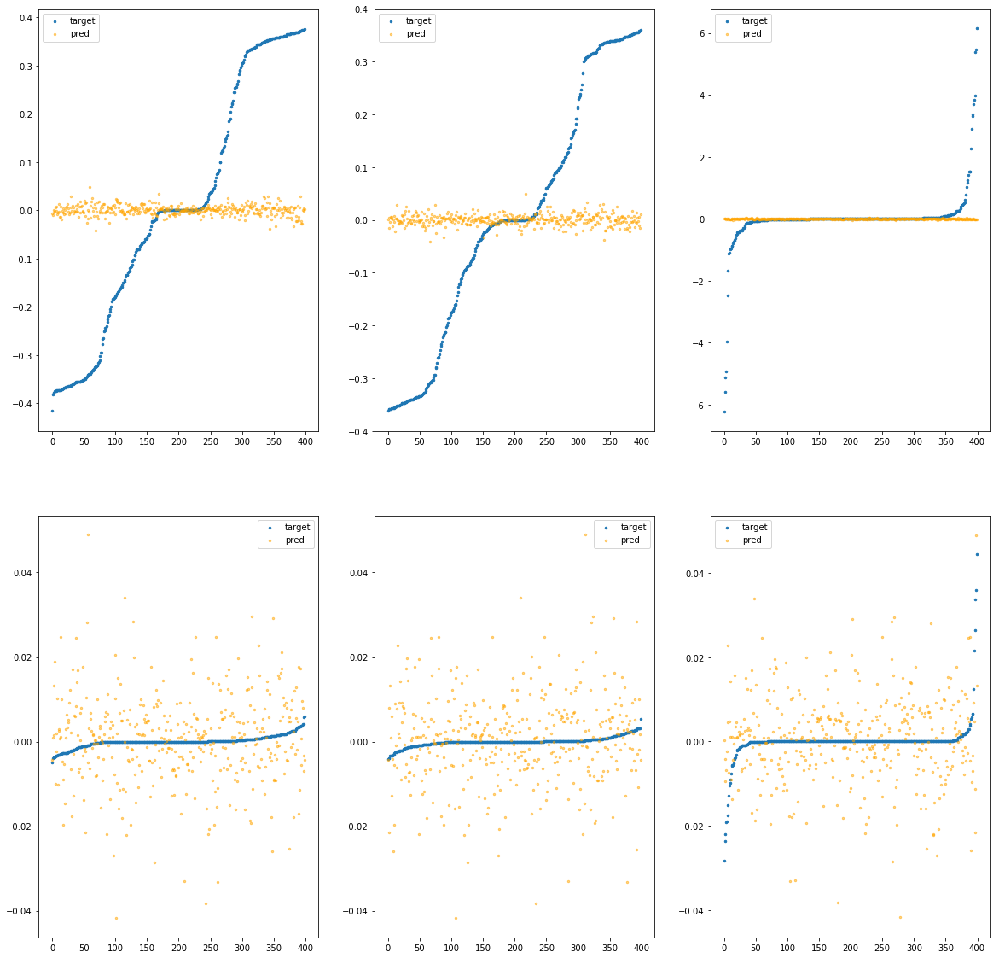

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa99bfcee50>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.67e-03	4.16e-01	2.07e-01	1.12e+03	6.43e-02	4.14e-03
y		1.17e-02	3.93e-01	1.87e-01	3.43e+02	5.42e-02	2.94e-03
z		9.76e-04	6.19e+00	2.81e-01	2.73e+02	8.74e-01	7.64e-01
phi		-1.32e+02	5.72e-02	1.16e-02	4.84e+05	2.47e-04	6.11e-08
theta		-1.95e+02	5.72e-02	1.17e-02	1.99e+05	2.49e-04	6.22e-08
psi		-1.03e+01	6.10e-02	1.22e-02	4.30e+05	2.76e-04	7.64e-08


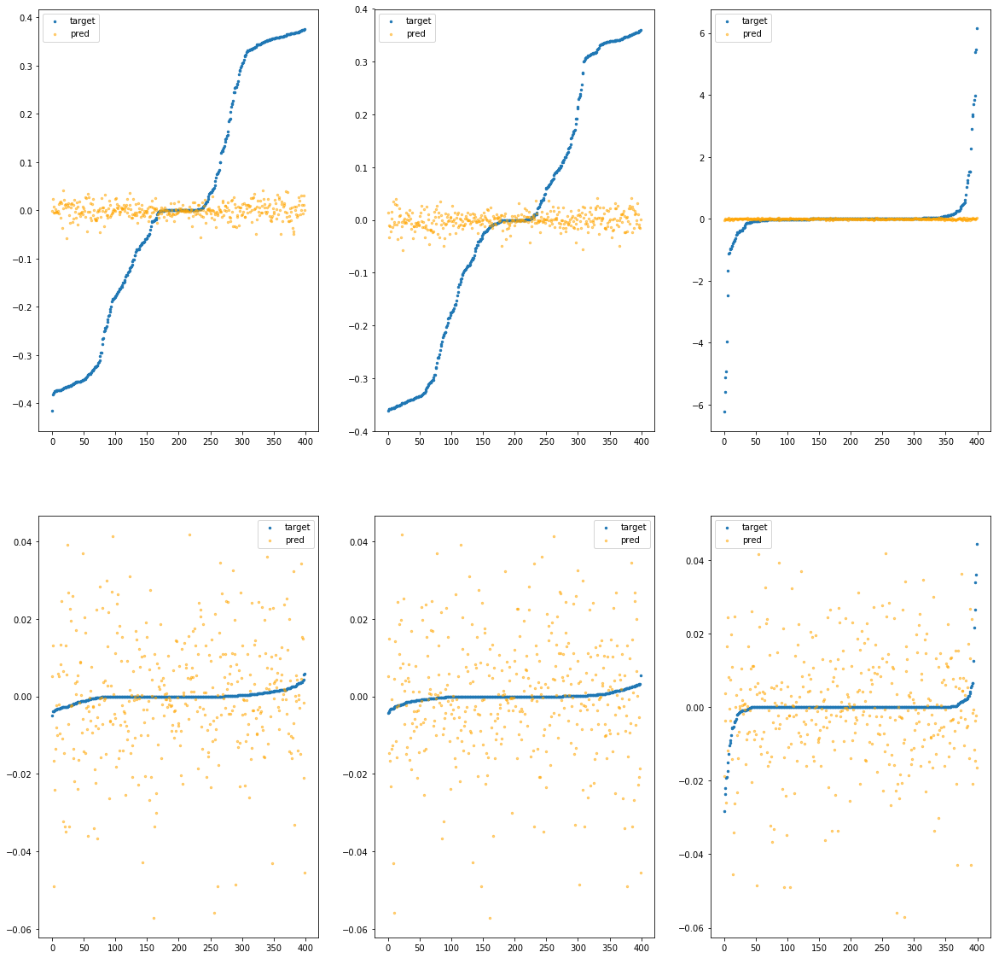

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fa99bfceeb0>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		3.01e-03	4.50e-01	2.07e-01	1.75e+03	6.39e-02	4.09e-03
y		-1.32e-03	4.31e-01	1.90e-01	3.46e+02	5.49e-02	3.01e-03
z		7.59e-03	6.16e+00	2.85e-01	3.20e+02	8.68e-01	7.54e-01
phi		-5.29e+02	1.40e-01	2.29e-02	8.41e+05	9.87e-04	9.75e-07
theta		-7.79e+02	1.41e-01	2.29e-02	4.36e+05	9.90e-04	9.80e-07
psi		-4.06e+01	1.64e-01	2.30e-02	4.54e+05	1.02e-03	1.04e-06


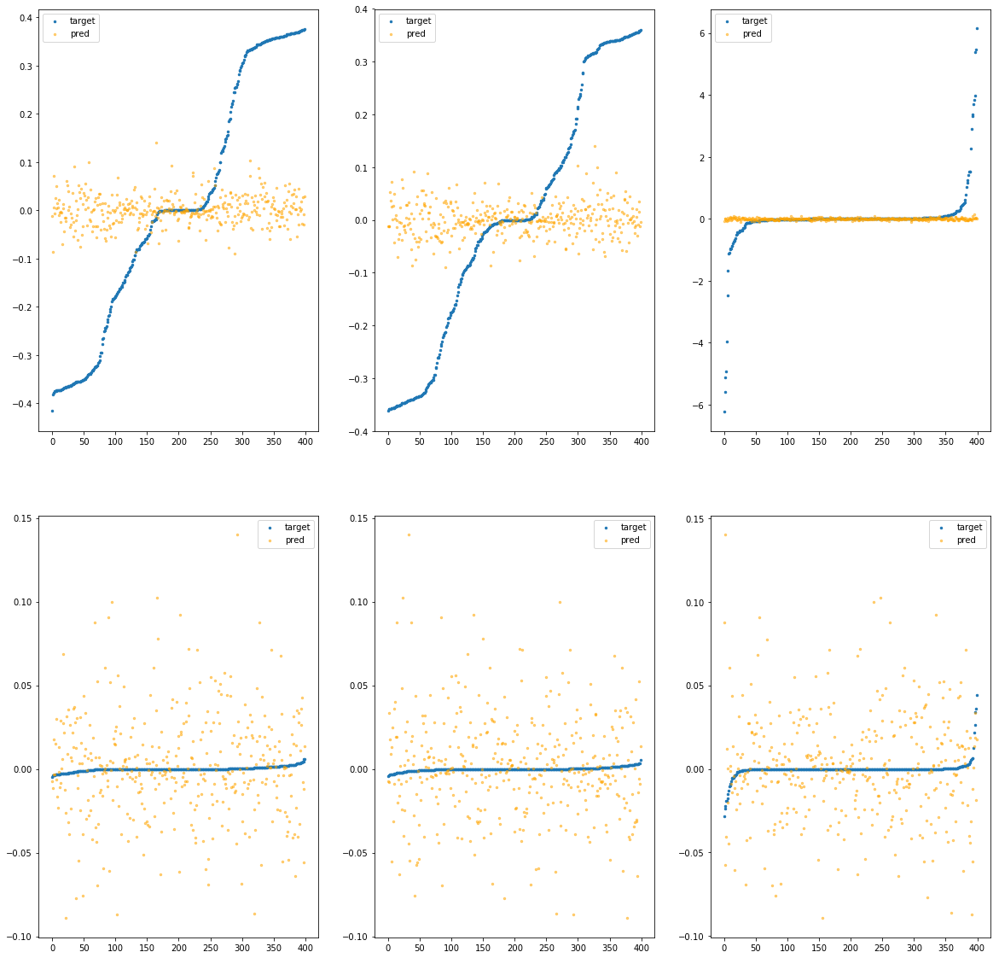

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa99bfcef10>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.12e+00	1.66e+00	3.33e-01	2.67e+04	2.00e-01	4.00e-02
y		-2.78e+00	1.78e+00	3.30e-01	3.85e+03	2.07e-01	4.29e-02
z		-2.08e-01	6.40e+00	4.83e-01	5.52e+03	1.06e+00	1.12e+00
phi		-7.67e+04	1.44e+00	2.77e-01	9.76e+06	1.43e-01	2.04e-02
theta		-1.12e+05	1.44e+00	2.77e-01	6.07e+06	1.43e-01	2.03e-02
psi		-5.81e+03	1.44e+00	2.77e-01	5.94e+06	1.43e-01	2.04e-02


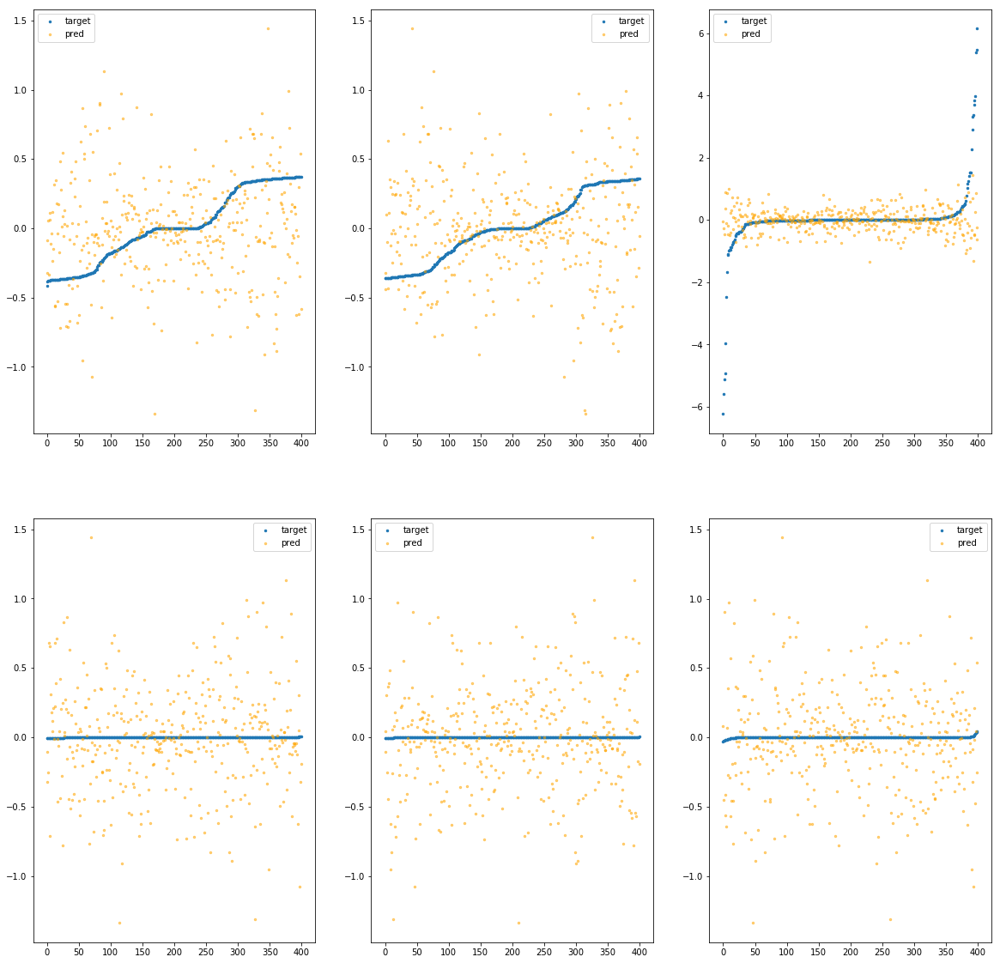

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa99bfcef70>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.33e+00	1.66e+00	3.46e-01	4.29e+04	2.14e-01	4.56e-02
y		-2.72e+00	1.90e+00	3.34e-01	6.92e+03	2.04e-01	4.16e-02
z		-2.11e-01	6.98e+00	4.64e-01	5.02e+03	1.06e+00	1.12e+00
phi		-7.91e+04	1.58e+00	2.80e-01	1.67e+07	1.47e-01	2.17e-02
theta		-1.16e+05	1.58e+00	2.80e-01	3.18e+06	1.47e-01	2.17e-02
psi		-5.99e+03	1.58e+00	2.80e-01	7.29e+06	1.47e-01	2.16e-02


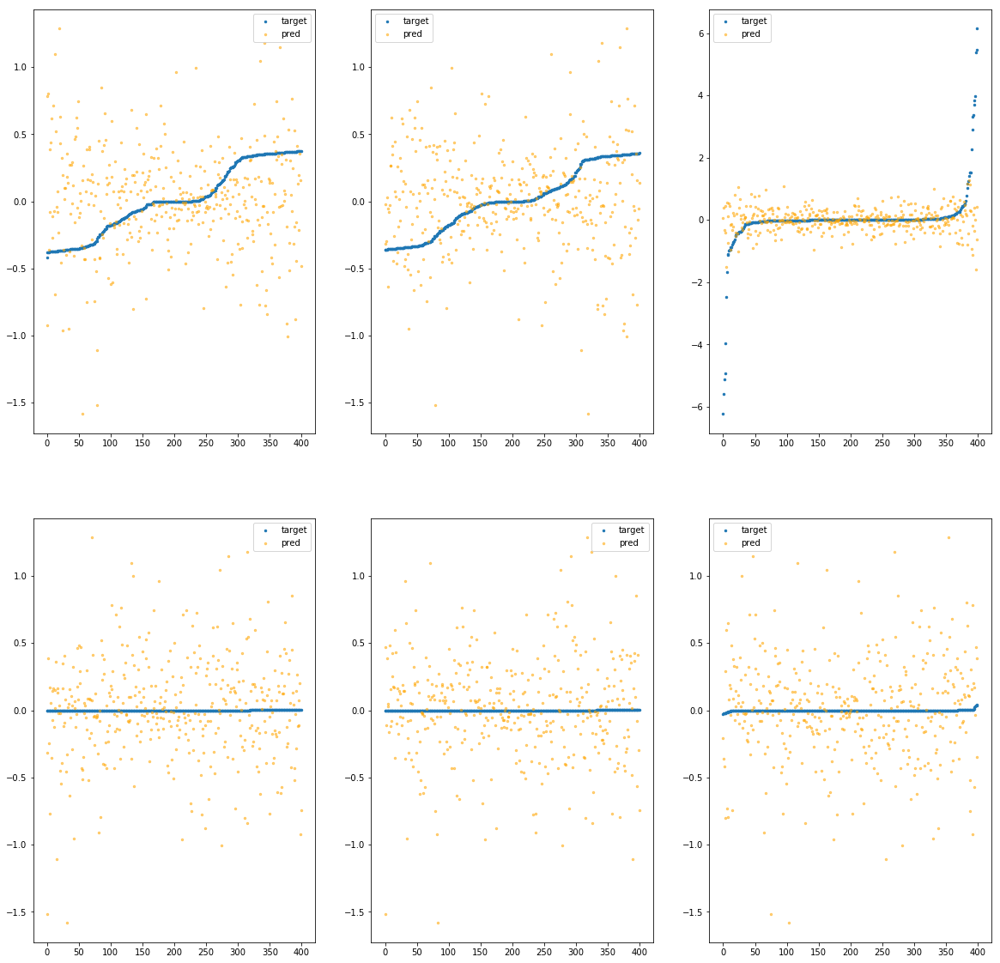

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa99bfcefd0>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.95e+00	1.77e+00	3.27e-01	4.88e+04	1.89e-01	3.59e-02
y		-2.40e+00	1.75e+00	3.22e-01	8.27e+03	1.86e-01	3.48e-02
z		-1.67e-01	6.03e+00	4.84e-01	5.46e+03	1.02e+00	1.04e+00
phi		-7.62e+04	1.41e+00	2.89e-01	1.91e+07	1.42e-01	2.01e-02
theta		-1.12e+05	1.41e+00	2.89e-01	1.03e+07	1.42e-01	2.01e-02
psi		-5.78e+03	1.41e+00	2.89e-01	5.43e+06	1.42e-01	2.01e-02


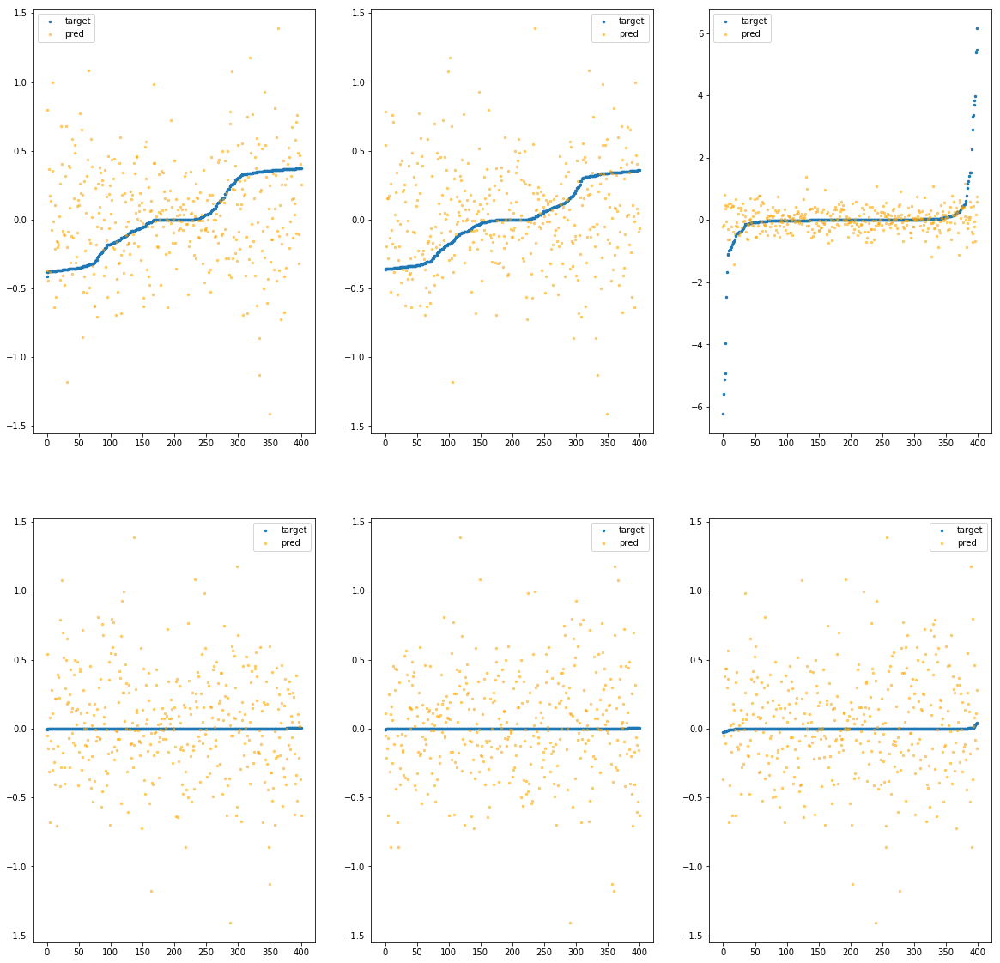

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa99bfd7070>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.59e+00	1.56e+00	3.65e-01	5.50e+04	2.30e-01	5.29e-02
y		-2.96e+00	1.57e+00	3.51e-01	9.04e+03	2.17e-01	4.71e-02
z		-2.21e-01	6.57e+00	5.12e-01	4.55e+03	1.07e+00	1.14e+00
phi		-8.34e+04	1.39e+00	2.94e-01	2.53e+07	1.55e-01	2.41e-02
theta		-1.22e+05	1.39e+00	2.94e-01	7.79e+06	1.55e-01	2.41e-02
psi		-6.34e+03	1.39e+00	2.95e-01	8.86e+06	1.56e-01	2.42e-02


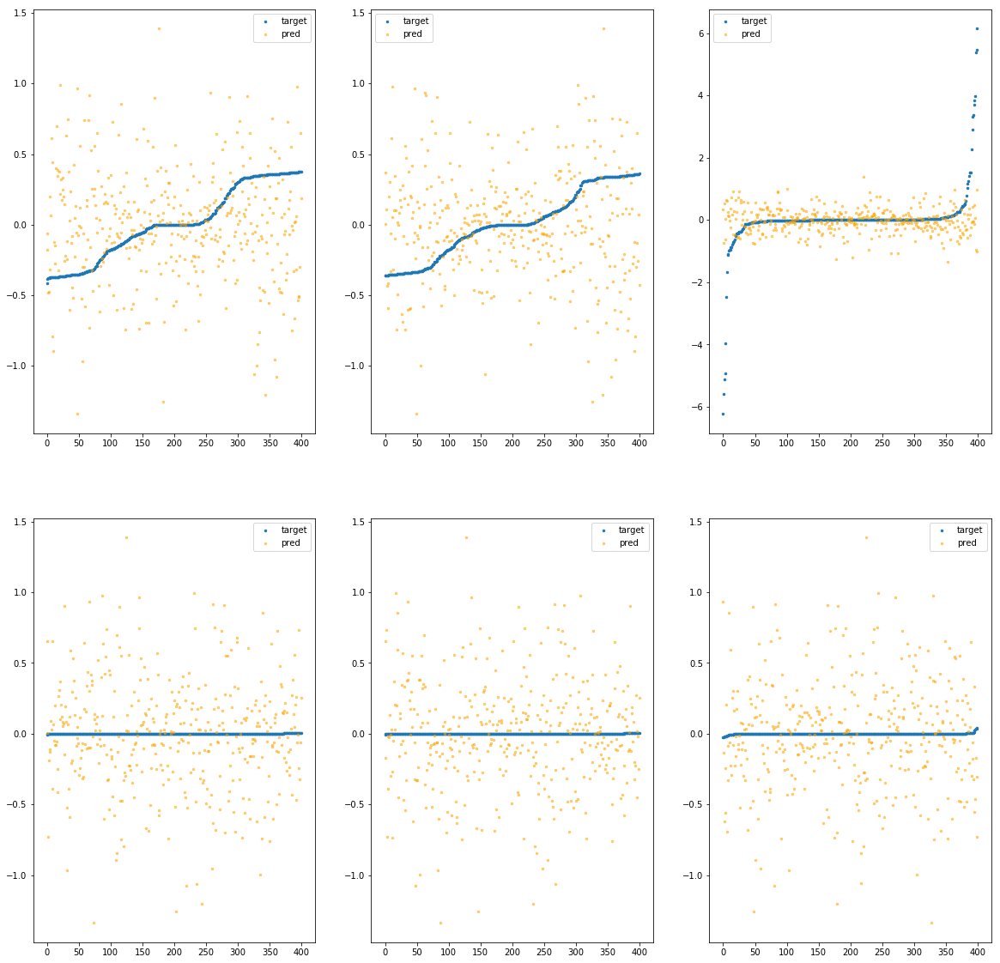

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa99bfd70d0>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.22e+00	1.59e+00	3.42e-01	6.59e+04	2.06e-01	4.26e-02
y		-2.49e+00	1.56e+00	3.37e-01	7.84e+03	1.92e-01	3.67e-02
z		-1.58e-01	6.12e+00	4.86e-01	4.73e+03	1.01e+00	1.03e+00
phi		-7.23e+04	1.24e+00	2.80e-01	3.04e+07	1.34e-01	1.81e-02
theta		-1.06e+05	1.24e+00	2.80e-01	6.29e+06	1.34e-01	1.81e-02
psi		-5.50e+03	1.27e+00	2.80e-01	4.39e+06	1.35e-01	1.82e-02


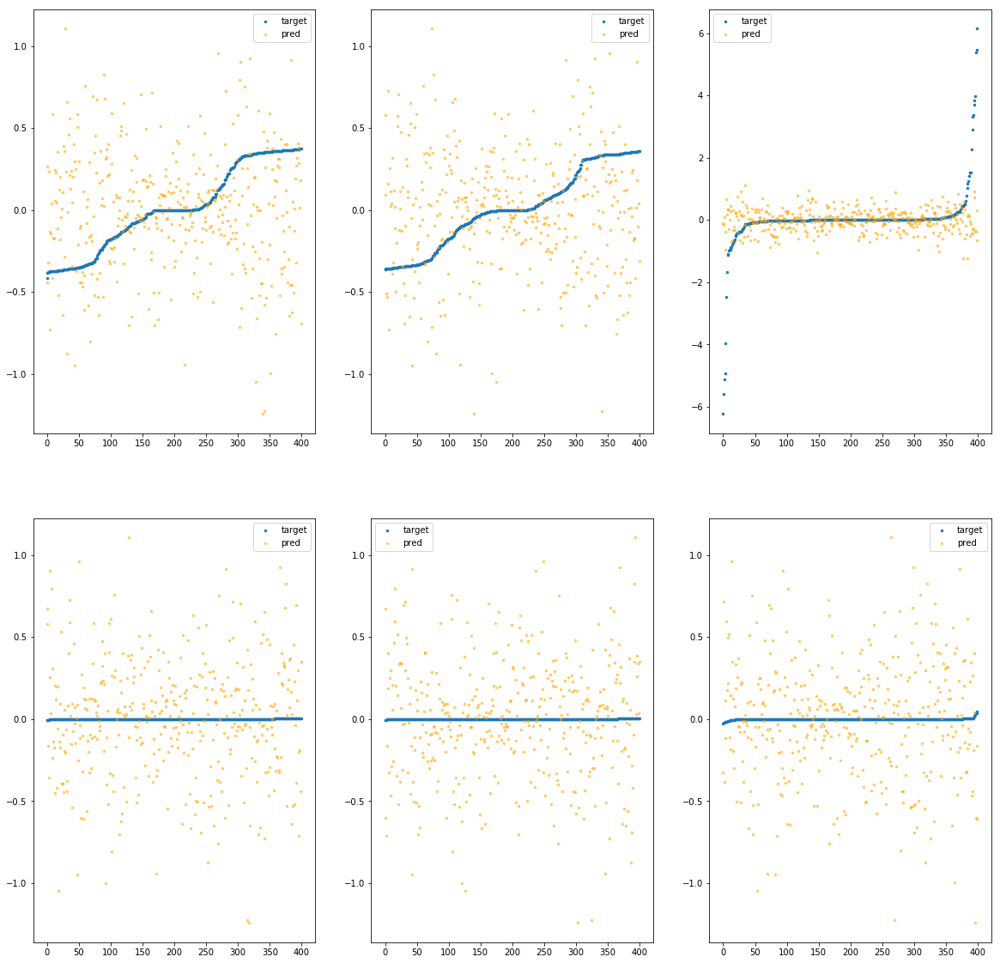

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa99bfd7130>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.76e-01	1.13e+00	2.66e-01	2.28e+04	1.27e-01	1.60e-02
y		-1.16e+00	1.26e+00	2.52e-01	7.87e+03	1.18e-01	1.40e-02
z		-7.60e-02	6.79e+00	3.95e-01	2.23e+03	9.41e-01	8.86e-01
phi		-3.21e+04	1.05e+00	1.79e-01	1.08e+07	5.98e-02	3.57e-03
theta		-4.70e+04	1.04e+00	1.79e-01	3.96e+06	5.97e-02	3.57e-03
psi		-2.45e+03	1.05e+00	1.79e-01	4.33e+06	6.00e-02	3.61e-03


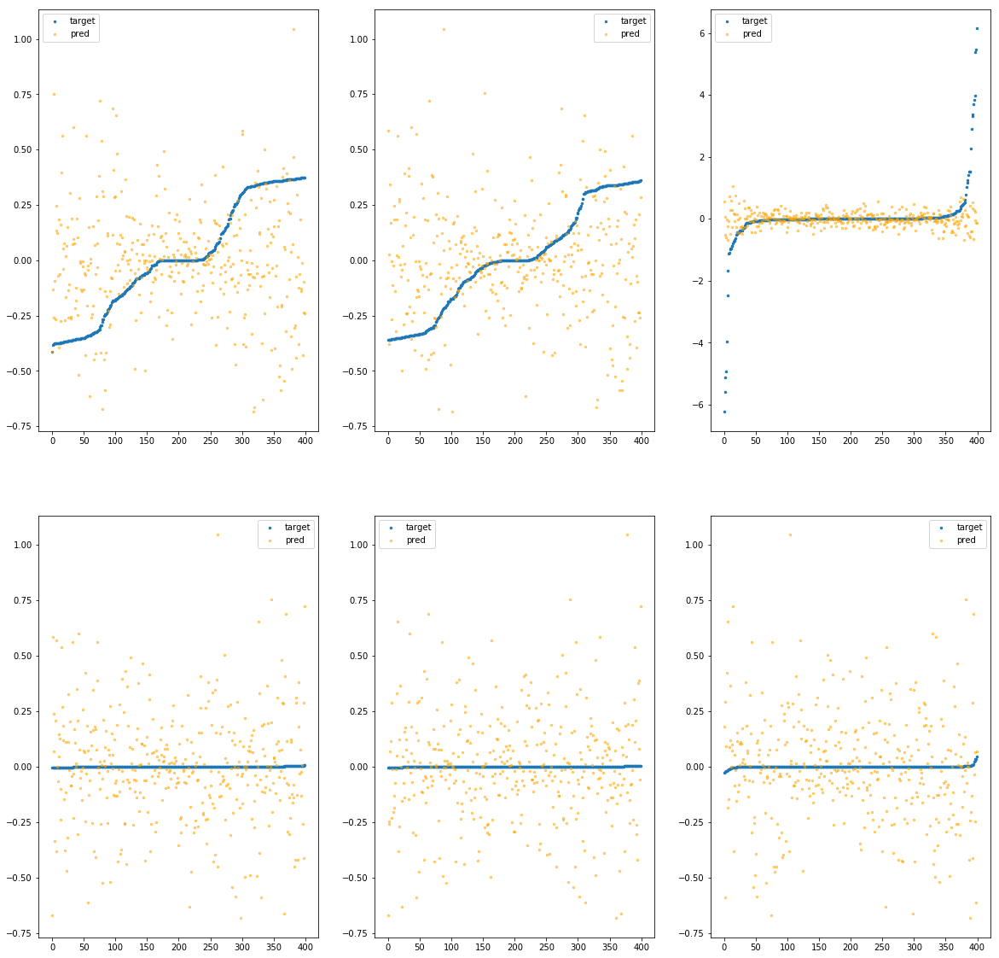

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa99bfd7190>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.39e-01	1.28e+00	2.64e-01	3.16e+04	1.18e-01	1.39e-02
y		-9.24e-01	1.26e+00	2.45e-01	5.27e+03	1.05e-01	1.11e-02
z		-6.95e-02	6.62e+00	3.92e-01	1.90e+03	9.36e-01	8.75e-01
phi		-2.98e+04	9.57e-01	1.74e-01	1.33e+07	5.54e-02	3.07e-03
theta		-4.37e+04	9.57e-01	1.74e-01	3.59e+06	5.55e-02	3.08e-03
psi		-2.25e+03	9.57e-01	1.74e-01	2.92e+06	5.52e-02	3.05e-03


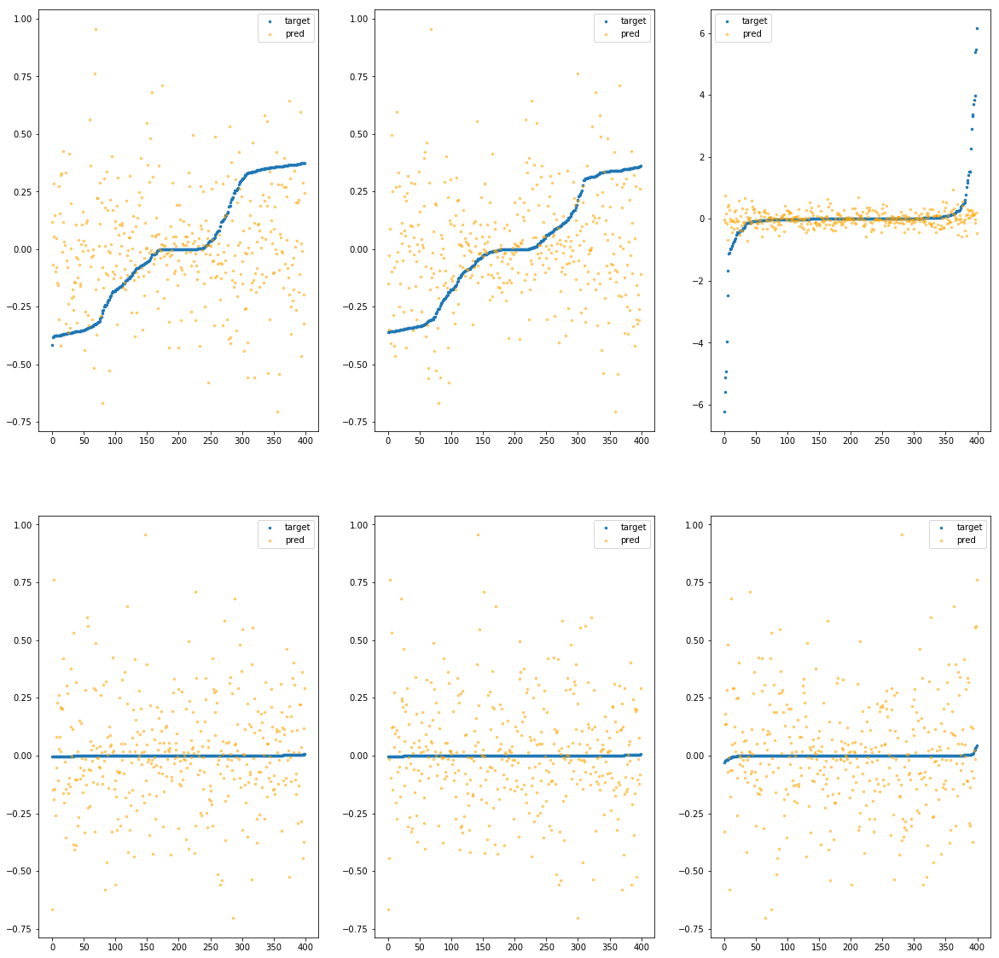

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa99bfd71f0>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.04e+00	1.32e+00	2.77e-01	2.54e+04	1.31e-01	1.71e-02
y		-1.48e+00	1.30e+00	2.75e-01	4.69e+03	1.36e-01	1.85e-02
z		-1.15e-01	6.02e+00	4.22e-01	4.05e+03	9.75e-01	9.51e-01
phi		-4.54e+04	9.56e-01	2.21e-01	1.31e+07	8.44e-02	7.13e-03
theta		-6.65e+04	9.56e-01	2.21e-01	5.08e+06	8.44e-02	7.12e-03
psi		-3.44e+03	9.56e-01	2.21e-01	5.48e+06	8.44e-02	7.12e-03


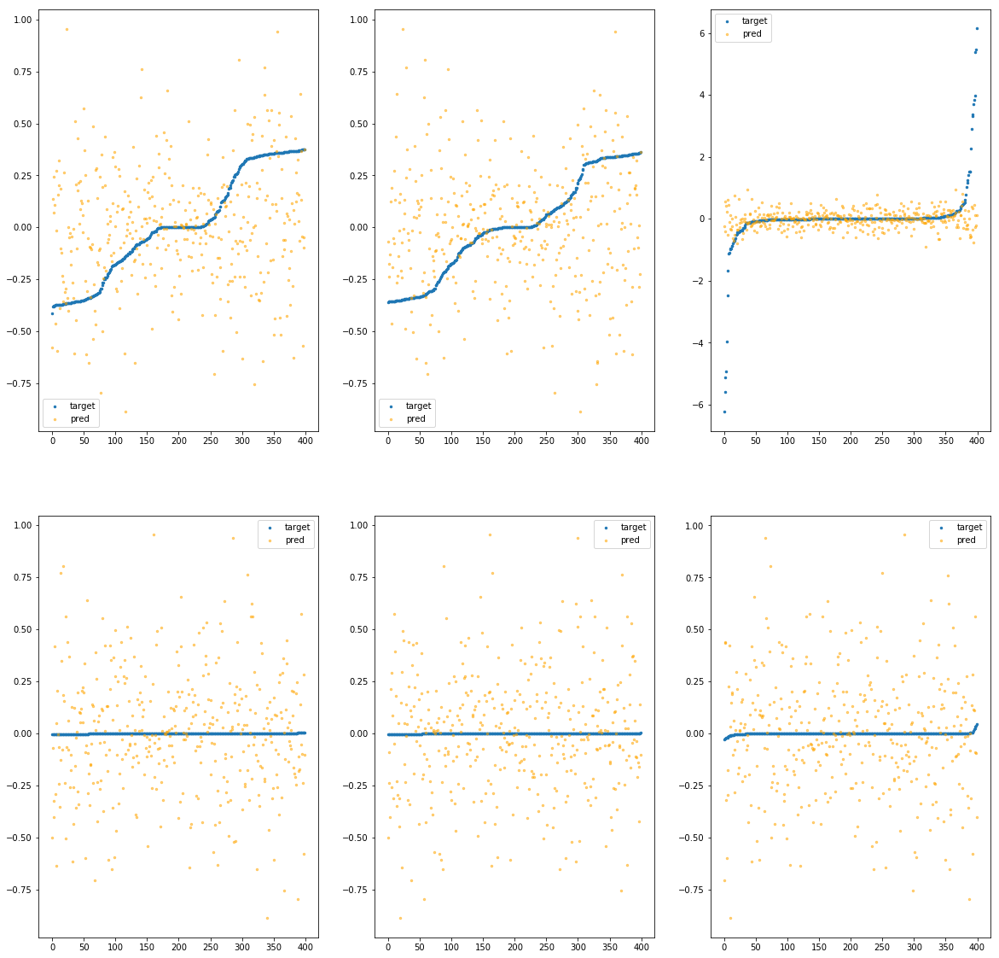

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa99bfd7250>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.74e+00	1.83e+00	3.70e-01	5.59e+04	2.40e-01	5.75e-02
y		-2.70e+00	1.81e+00	3.45e-01	5.03e+03	2.03e-01	4.11e-02
z		-1.30e-01	6.97e+00	4.87e-01	4.56e+03	9.88e-01	9.77e-01
phi		-8.58e+04	1.58e+00	3.03e-01	2.20e+07	1.60e-01	2.55e-02
theta		-1.26e+05	1.58e+00	3.03e-01	6.95e+06	1.60e-01	2.55e-02
psi		-6.51e+03	1.58e+00	3.03e-01	7.48e+06	1.60e-01	2.55e-02


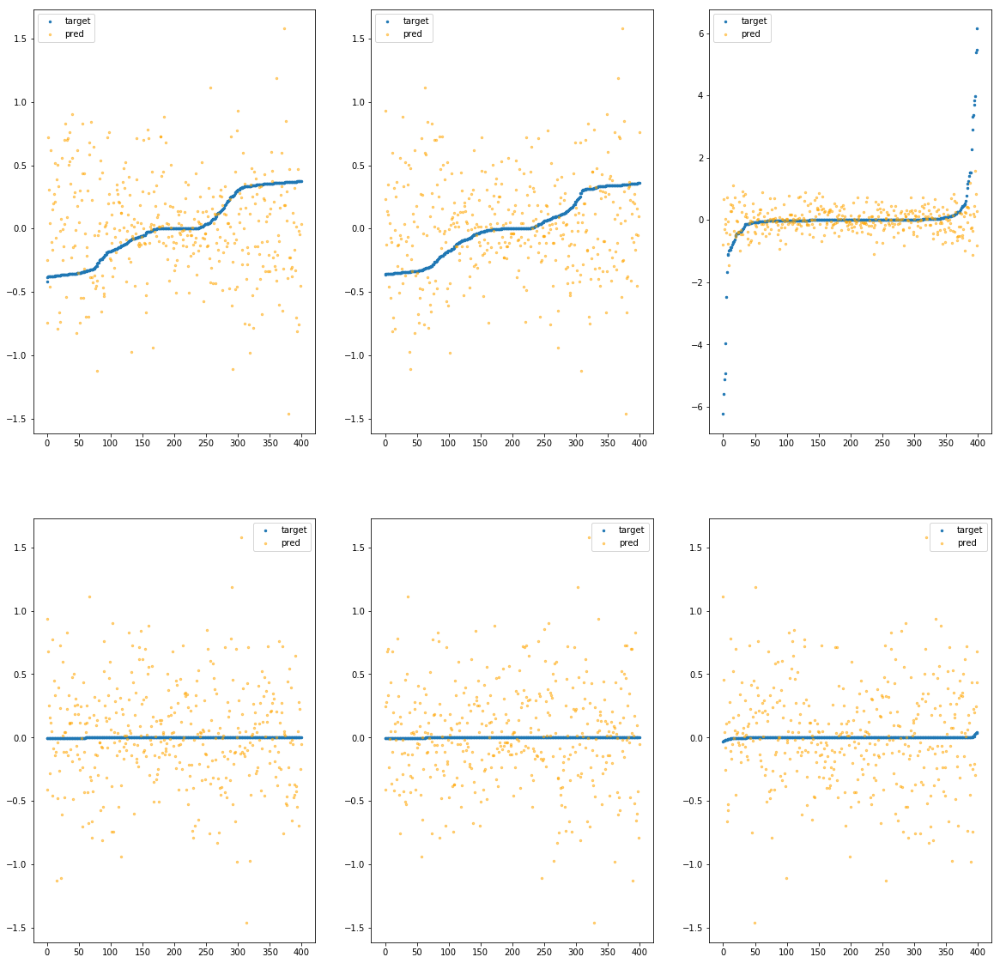

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa99bfd72b0>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.43e-01	1.26e+00	2.67e-01	2.75e+04	1.25e-01	1.55e-02
y		-1.27e+00	1.24e+00	2.61e-01	3.51e+03	1.24e-01	1.54e-02
z		-9.84e-02	6.38e+00	4.00e-01	2.94e+03	9.61e-01	9.23e-01
phi		-3.87e+04	1.07e+00	1.96e-01	1.07e+07	7.21e-02	5.20e-03
theta		-5.68e+04	1.07e+00	1.96e-01	4.44e+06	7.21e-02	5.20e-03
psi		-2.94e+03	1.07e+00	1.96e-01	2.70e+06	7.20e-02	5.19e-03


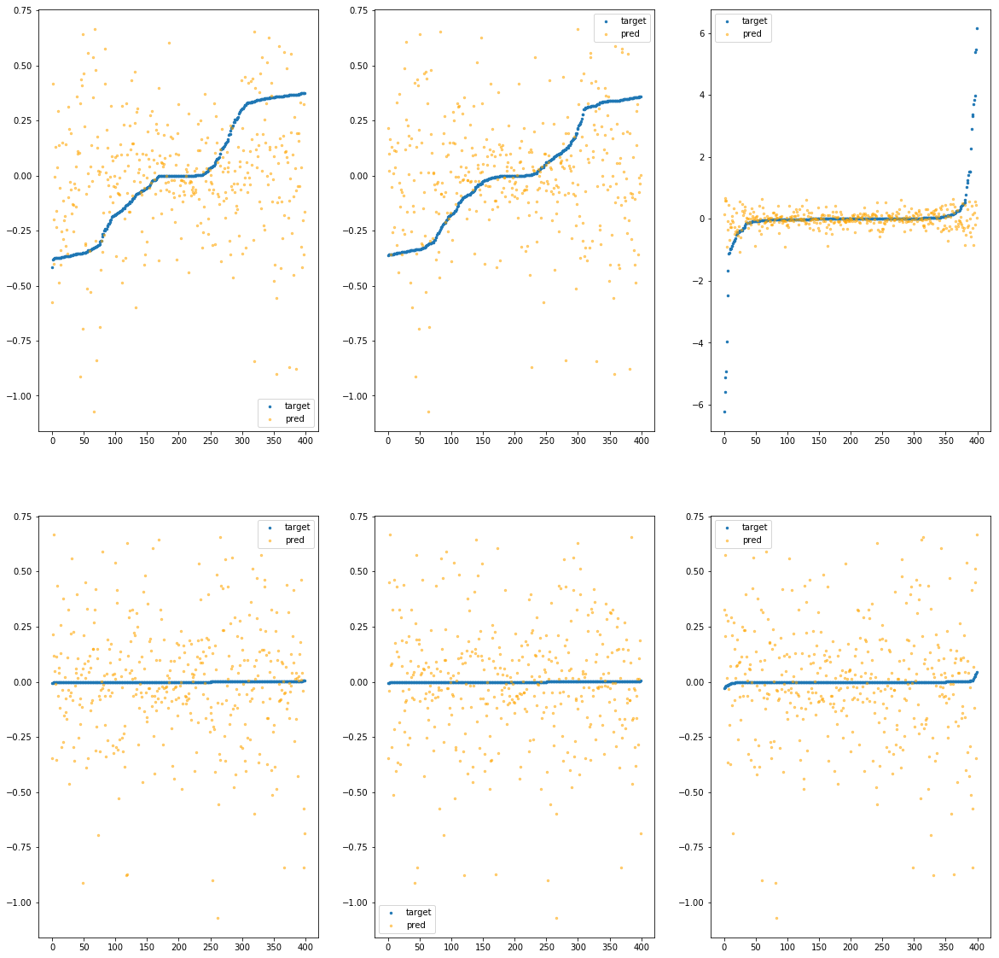

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa99bfd7310>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.09e-01	9.29e-01	2.46e-01	2.60e+04	9.67e-02	9.36e-03
y		-6.73e-01	9.74e-01	2.32e-01	4.08e+03	9.17e-02	8.41e-03
z		-9.25e-02	6.78e+00	3.66e-01	1.51e+03	9.56e-01	9.13e-01
phi		-1.59e+04	6.20e-01	1.27e-01	9.80e+06	2.95e-02	8.72e-04
theta		-2.32e+04	6.22e-01	1.27e-01	3.00e+06	2.95e-02	8.71e-04
psi		-1.20e+03	6.22e-01	1.27e-01	2.58e+06	2.94e-02	8.65e-04


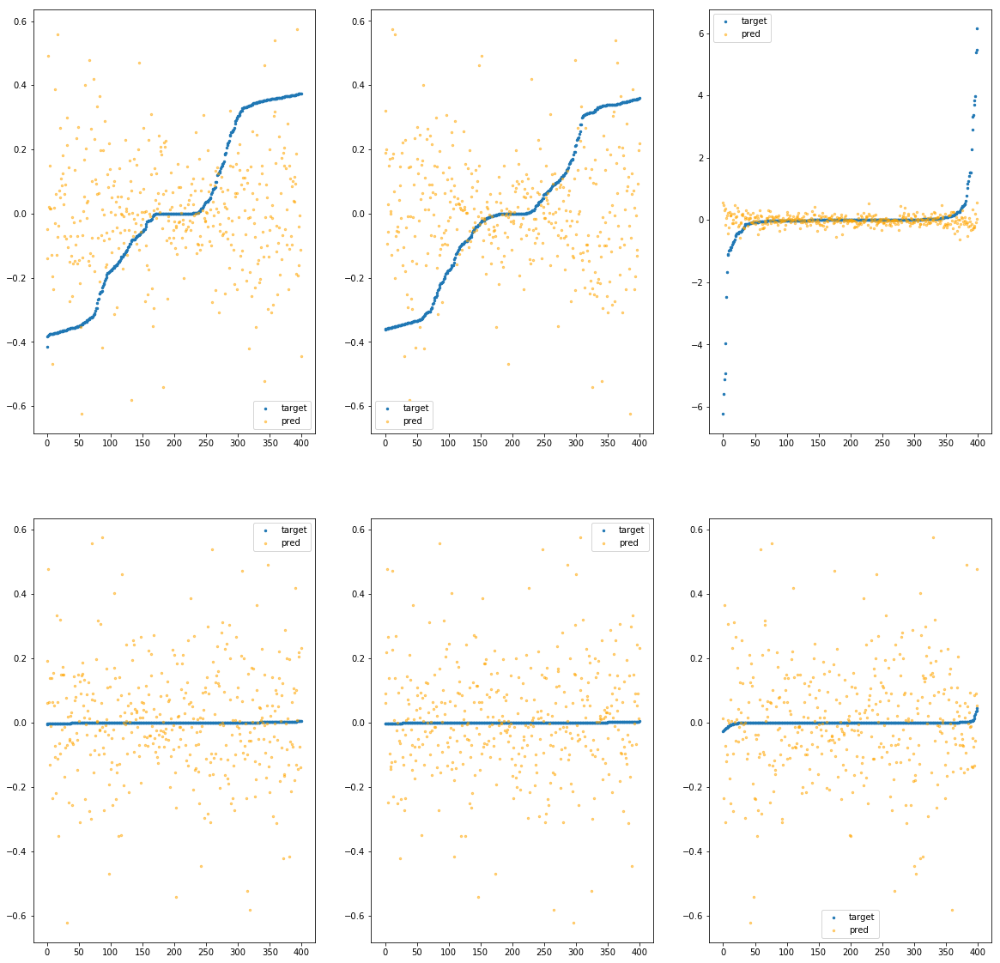

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa99bfd7370>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.46e-01	1.26e+00	2.69e-01	2.77e+04	1.25e-01	1.56e-02
y		-7.85e-01	1.26e+00	2.32e-01	2.69e+03	9.79e-02	9.58e-03
z		-8.50e-02	6.13e+00	3.74e-01	2.07e+03	9.49e-01	9.01e-01
phi		-2.76e+04	9.47e-01	1.62e-01	1.16e+07	5.14e-02	2.64e-03
theta		-4.05e+04	9.47e-01	1.62e-01	2.36e+06	5.15e-02	2.65e-03
psi		-2.09e+03	9.58e-01	1.62e-01	3.09e+06	5.14e-02	2.64e-03


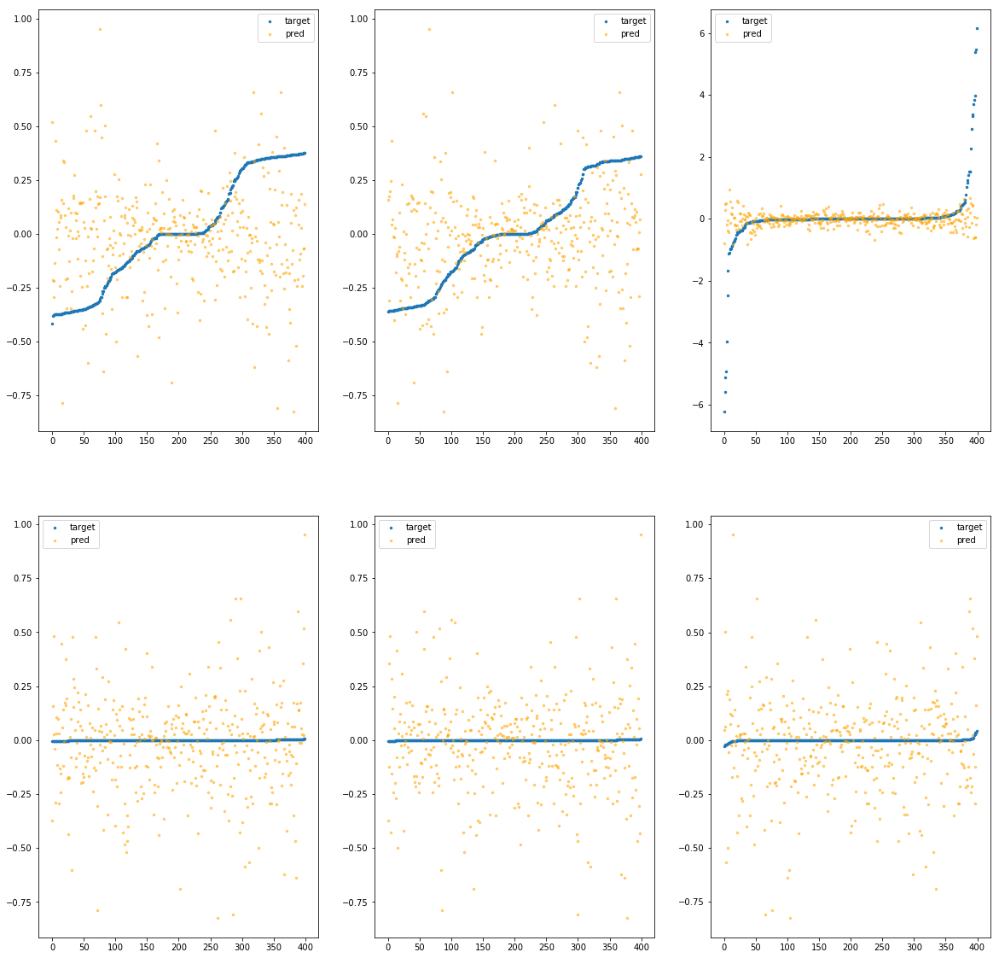

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa99bfd73d0>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.42e-01	1.00e+00	2.49e-01	3.08e+04	1.05e-01	1.11e-02
y		-6.57e-01	9.68e-01	2.34e-01	2.65e+03	9.09e-02	8.26e-03
z		1.25e-02	6.03e+00	3.57e-01	2.61e+03	8.64e-01	7.46e-01
phi		-1.89e+04	6.21e-01	1.39e-01	1.33e+07	3.51e-02	1.23e-03
theta		-2.77e+04	6.21e-01	1.39e-01	2.72e+06	3.52e-02	1.24e-03
psi		-1.43e+03	6.20e-01	1.39e-01	3.47e+06	3.52e-02	1.24e-03


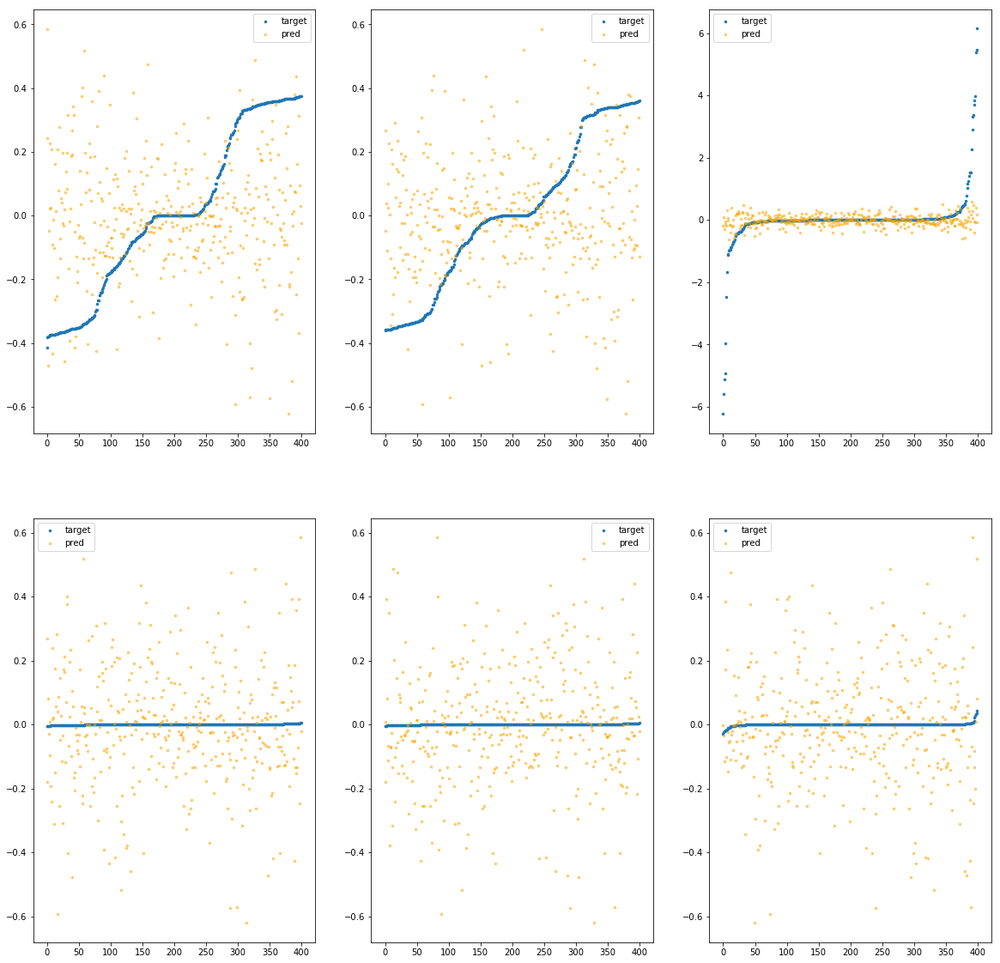

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa99bfd7430>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.55e-01	1.02e+00	2.44e-01	2.69e+04	9.33e-02	8.70e-03
y		-5.80e-01	9.48e-01	2.24e-01	4.10e+03	8.66e-02	7.50e-03
z		-4.59e-02	6.41e+00	3.69e-01	2.45e+03	9.15e-01	8.37e-01
phi		-2.03e+04	7.74e-01	1.47e-01	1.27e+07	3.78e-02	1.43e-03
theta		-2.97e+04	7.74e-01	1.47e-01	2.05e+06	3.77e-02	1.42e-03
psi		-1.54e+03	7.89e-01	1.48e-01	4.99e+06	3.78e-02	1.43e-03


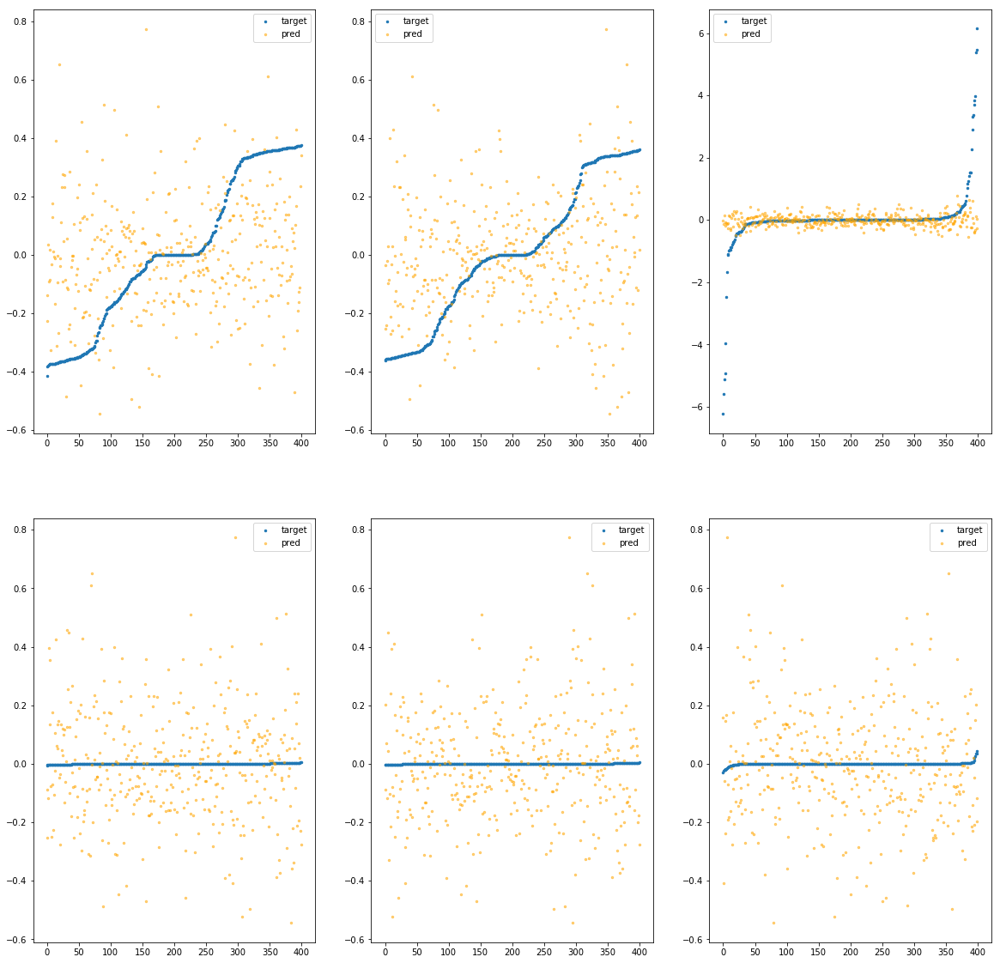

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa99bfd7490>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.53e-01	1.12e+00	2.73e-01	3.03e+04	1.25e-01	1.57e-02
y		-1.27e+00	1.21e+00	2.68e-01	6.29e+03	1.25e-01	1.55e-02
z		-5.09e-02	6.47e+00	4.04e-01	2.86e+03	9.19e-01	8.45e-01
phi		-3.51e+04	9.69e-01	1.90e-01	1.25e+07	6.53e-02	4.26e-03
theta		-5.14e+04	9.69e-01	1.90e-01	3.83e+06	6.53e-02	4.26e-03
psi		-2.65e+03	9.70e-01	1.90e-01	3.17e+06	6.51e-02	4.24e-03


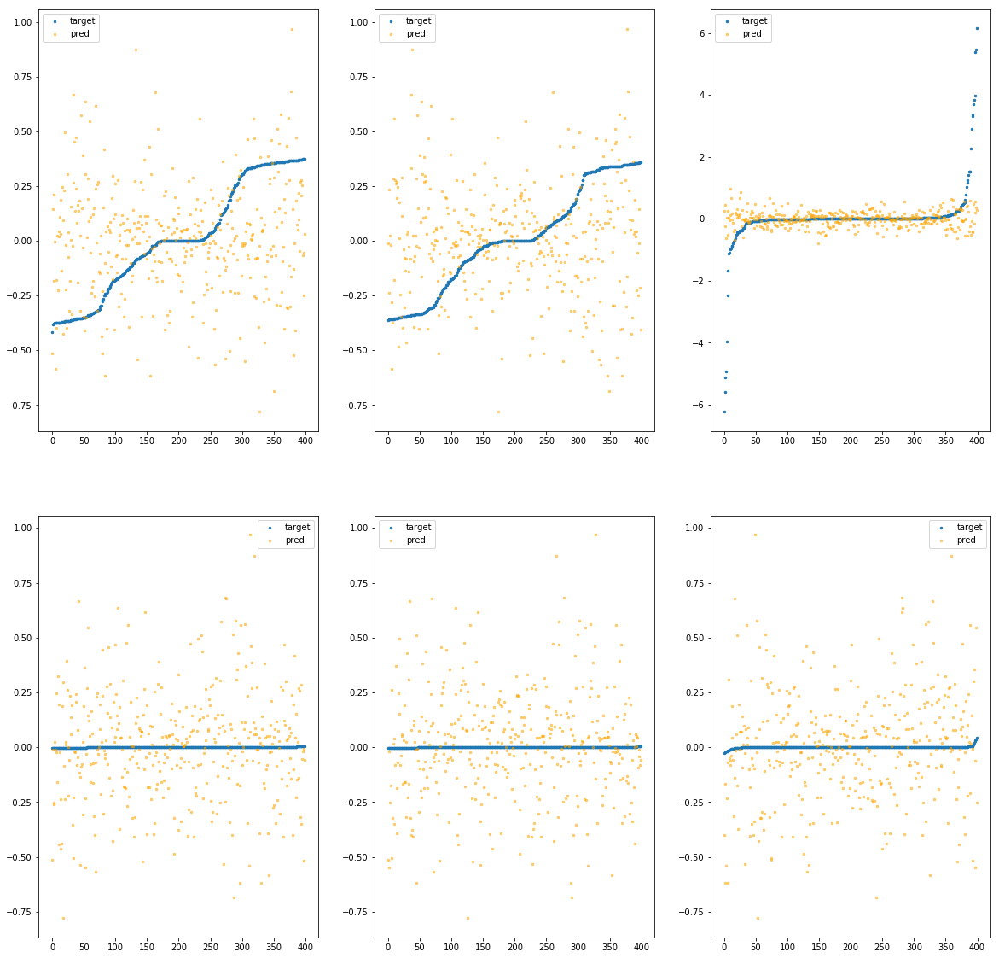

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa99bfd74f0>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.81e-01	1.01e+00	2.40e-01	1.37e+04	9.50e-02	9.02e-03
y		-5.47e-01	9.88e-01	2.22e-01	3.50e+03	8.48e-02	7.19e-03
z		-5.07e-02	6.59e+00	3.46e-01	1.65e+03	9.19e-01	8.45e-01
phi		-1.62e+04	8.87e-01	1.21e-01	6.33e+06	3.02e-02	9.09e-04
theta		-2.37e+04	8.87e-01	1.21e-01	2.41e+06	3.01e-02	9.08e-04
psi		-1.23e+03	8.87e-01	1.21e-01	2.47e+06	3.03e-02	9.17e-04


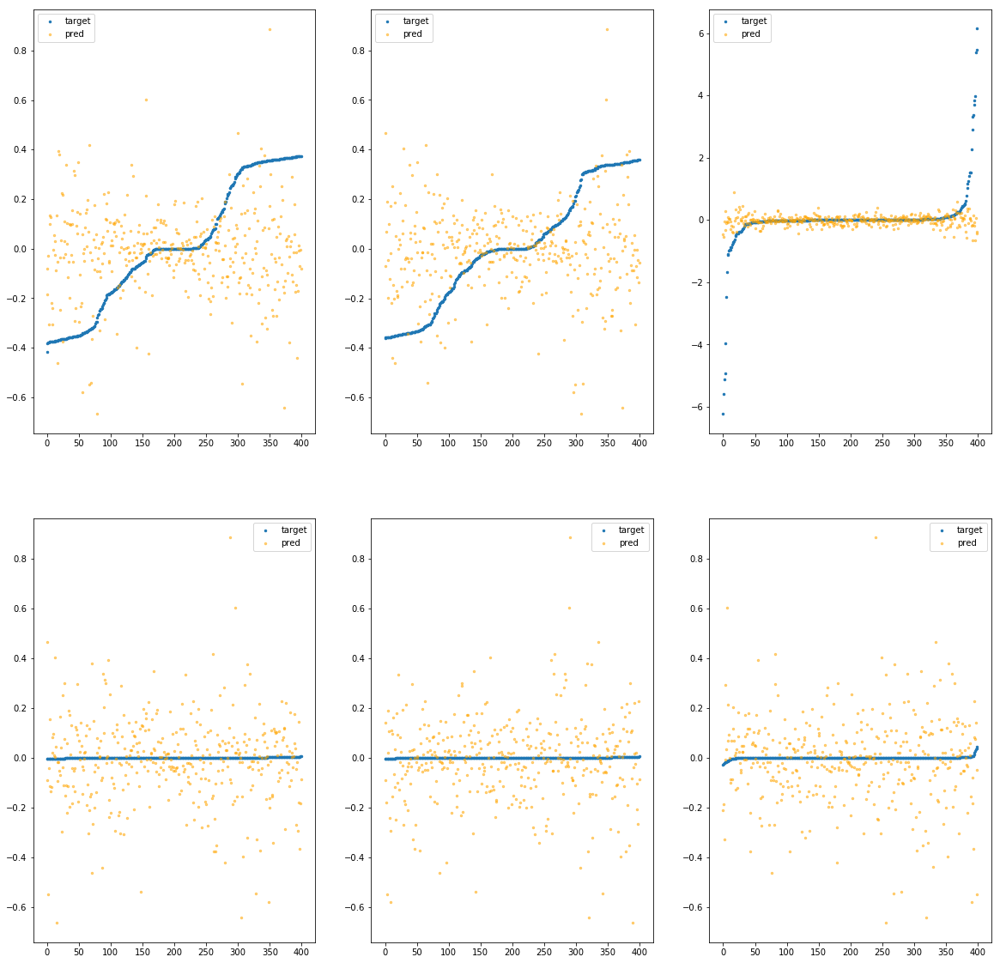

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa99bfd7550>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.81e-01	1.45e+00	2.51e-01	3.48e+04	1.14e-01	1.30e-02
y		-1.01e+00	1.44e+00	2.48e-01	5.41e+03	1.10e-01	1.22e-02
z		-7.68e-02	7.15e+00	3.59e-01	1.97e+03	9.42e-01	8.87e-01
phi		-2.67e+04	1.10e+00	1.48e-01	1.08e+07	4.97e-02	2.47e-03
theta		-3.92e+04	1.10e+00	1.48e-01	1.48e+06	4.98e-02	2.48e-03
psi		-2.03e+03	1.10e+00	1.49e-01	2.13e+06	4.99e-02	2.49e-03


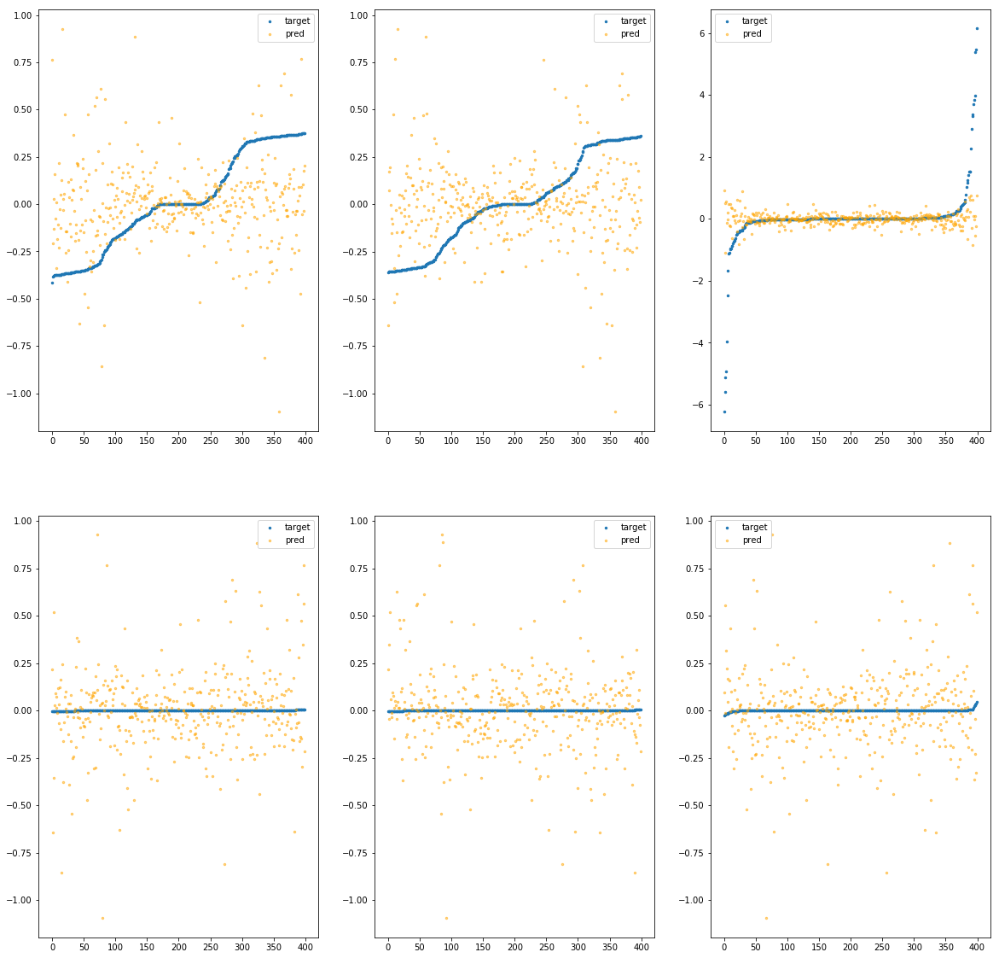

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa99bfd75b0>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.19e-01	7.79e-01	2.30e-01	1.94e+04	8.45e-02	7.15e-03
y		-3.95e-01	9.68e-01	2.15e-01	1.85e+03	7.65e-02	5.85e-03
z		-5.45e-02	6.32e+00	3.45e-01	1.49e+03	9.23e-01	8.51e-01
phi		-1.26e+04	6.70e-01	1.12e-01	8.79e+06	2.35e-02	5.54e-04
theta		-1.86e+04	6.78e-01	1.12e-01	1.43e+06	2.36e-02	5.55e-04
psi		-9.46e+02	6.75e-01	1.11e-01	1.99e+06	2.32e-02	5.40e-04


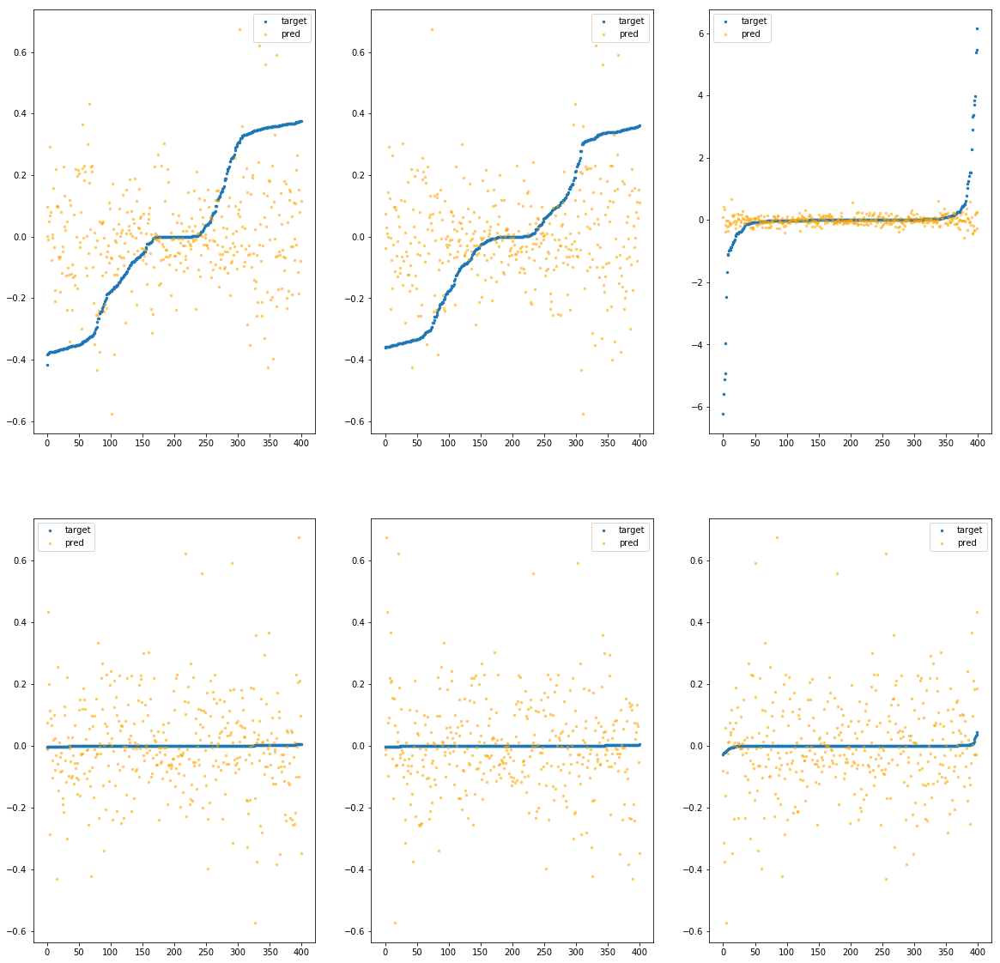

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa99bfd7610>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.17e+00	1.31e+00	2.80e-01	2.59e+04	1.39e-01	1.93e-02
y		-1.24e+00	1.29e+00	2.57e-01	6.57e+03	1.23e-01	1.50e-02
z		-6.03e-02	6.73e+00	4.03e-01	2.52e+03	9.28e-01	8.60e-01
phi		-4.26e+04	1.57e+00	1.98e-01	1.17e+07	7.92e-02	6.28e-03
theta		-6.24e+04	1.57e+00	1.98e-01	6.56e+06	7.92e-02	6.27e-03
psi		-3.25e+03	1.57e+00	1.99e-01	6.35e+06	7.97e-02	6.35e-03


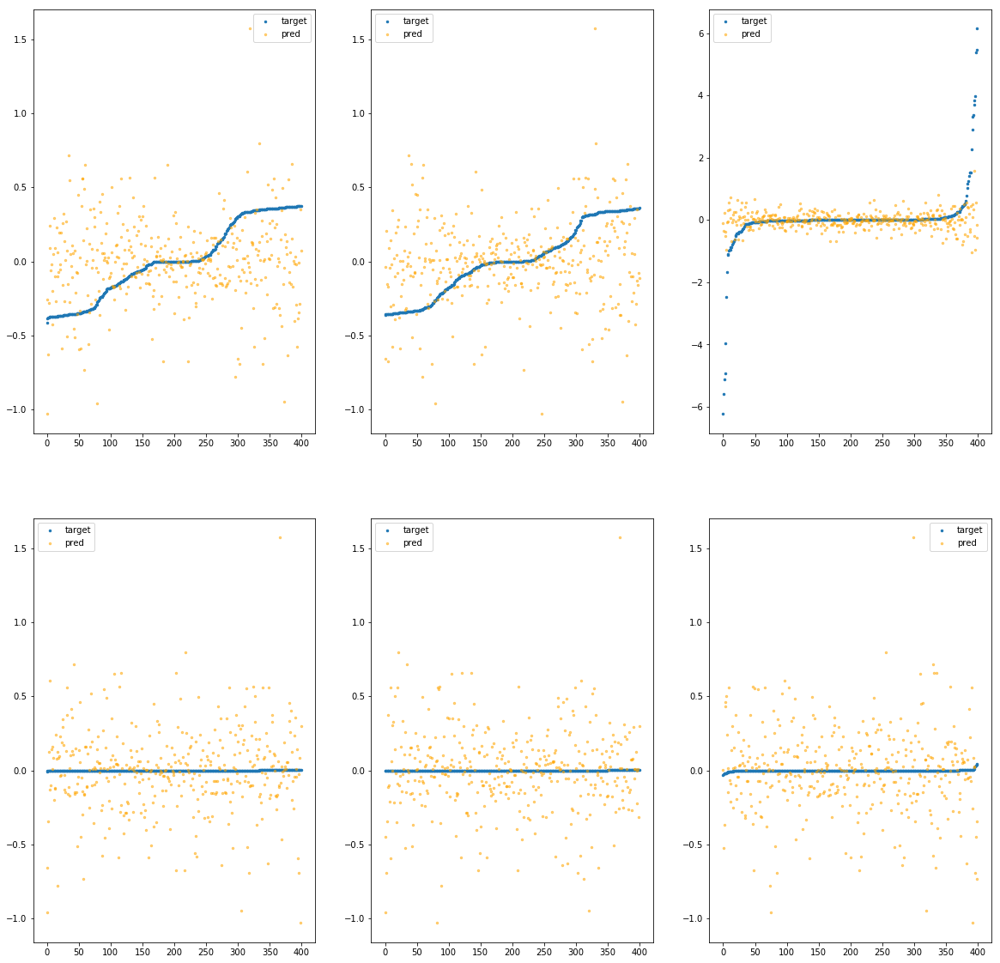

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fa99bfd7670>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.14e+00	1.19e+00	2.87e-01	2.42e+04	1.37e-01	1.89e-02
y		-1.32e+00	1.27e+00	2.68e-01	3.75e+03	1.27e-01	1.61e-02
z		-4.97e-02	6.91e+00	3.84e-01	3.01e+03	9.18e-01	8.43e-01
phi		-3.55e+04	1.01e+00	1.84e-01	9.81e+06	6.61e-02	4.37e-03
theta		-5.20e+04	1.01e+00	1.84e-01	3.02e+06	6.61e-02	4.37e-03
psi		-2.70e+03	1.01e+00	1.84e-01	3.84e+06	6.64e-02	4.40e-03


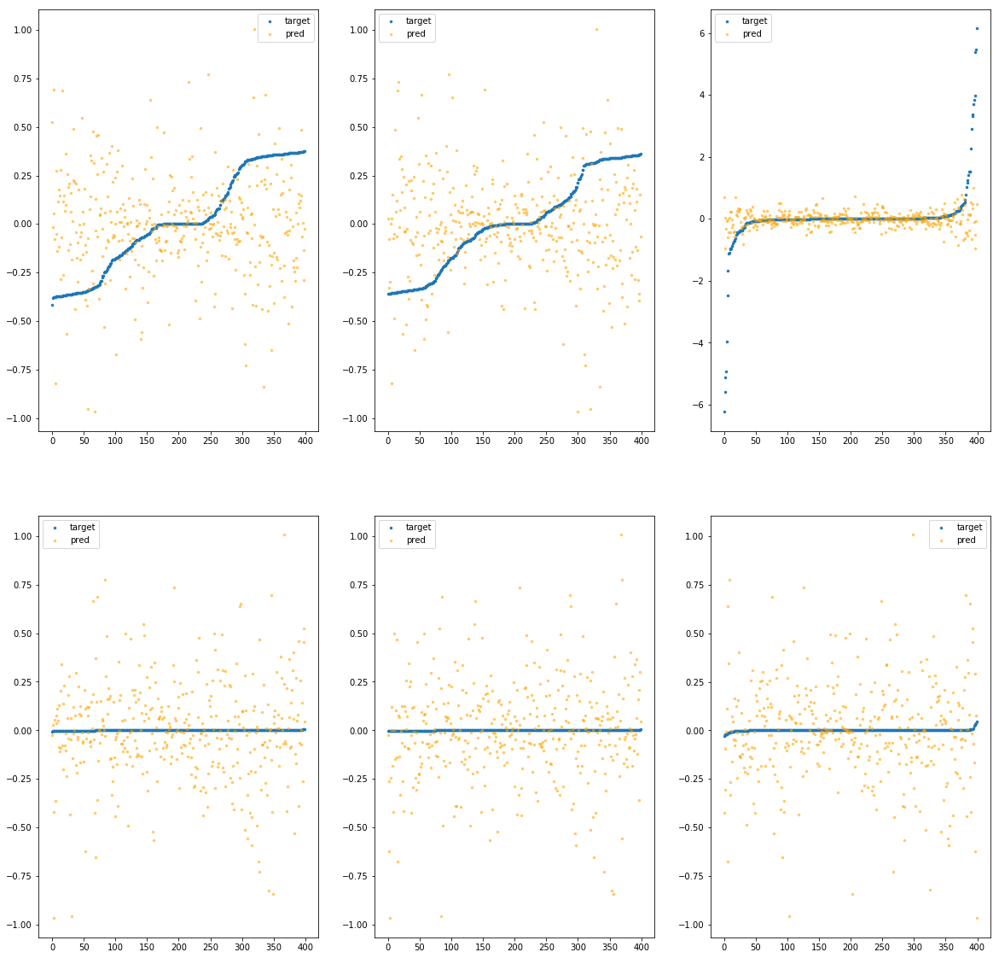

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa99bfd76d0>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.47e-01	8.82e-01	2.21e-01	6.79e+03	8.00e-02	6.40e-03
y		-1.81e-01	8.57e-01	1.97e-01	2.01e+03	6.47e-02	4.19e-03
z		-7.58e-02	6.50e+00	3.20e-01	9.02e+02	9.41e-01	8.86e-01
phi		-6.79e+03	5.47e-01	7.53e-02	2.38e+06	1.26e-02	1.60e-04
theta		-9.93e+03	5.47e-01	7.54e-02	1.14e+06	1.26e-02	1.59e-04
psi		-5.14e+02	5.47e-01	7.55e-02	1.44e+06	1.26e-02	1.60e-04


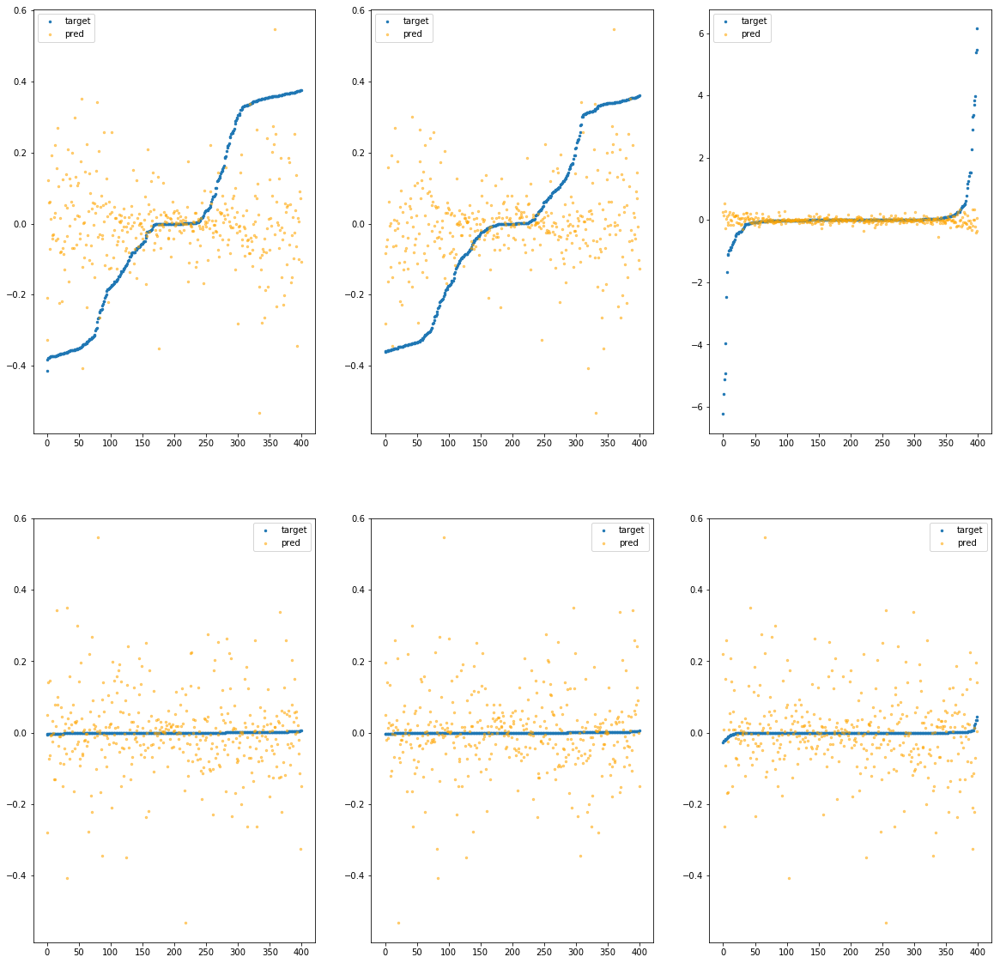

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa99bfd7730>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.12e-01	7.71e-01	2.21e-01	8.83e+03	7.77e-02	6.04e-03
y		-2.38e-01	7.25e-01	2.03e-01	9.83e+02	6.79e-02	4.61e-03
z		-1.82e-02	6.36e+00	3.20e-01	1.22e+03	8.91e-01	7.94e-01
phi		-6.56e+03	4.06e-01	7.86e-02	3.22e+06	1.22e-02	1.49e-04
theta		-9.61e+03	4.06e-01	7.84e-02	1.27e+06	1.22e-02	1.49e-04
psi		-5.07e+02	4.06e-01	7.91e-02	2.21e+06	1.25e-02	1.55e-04


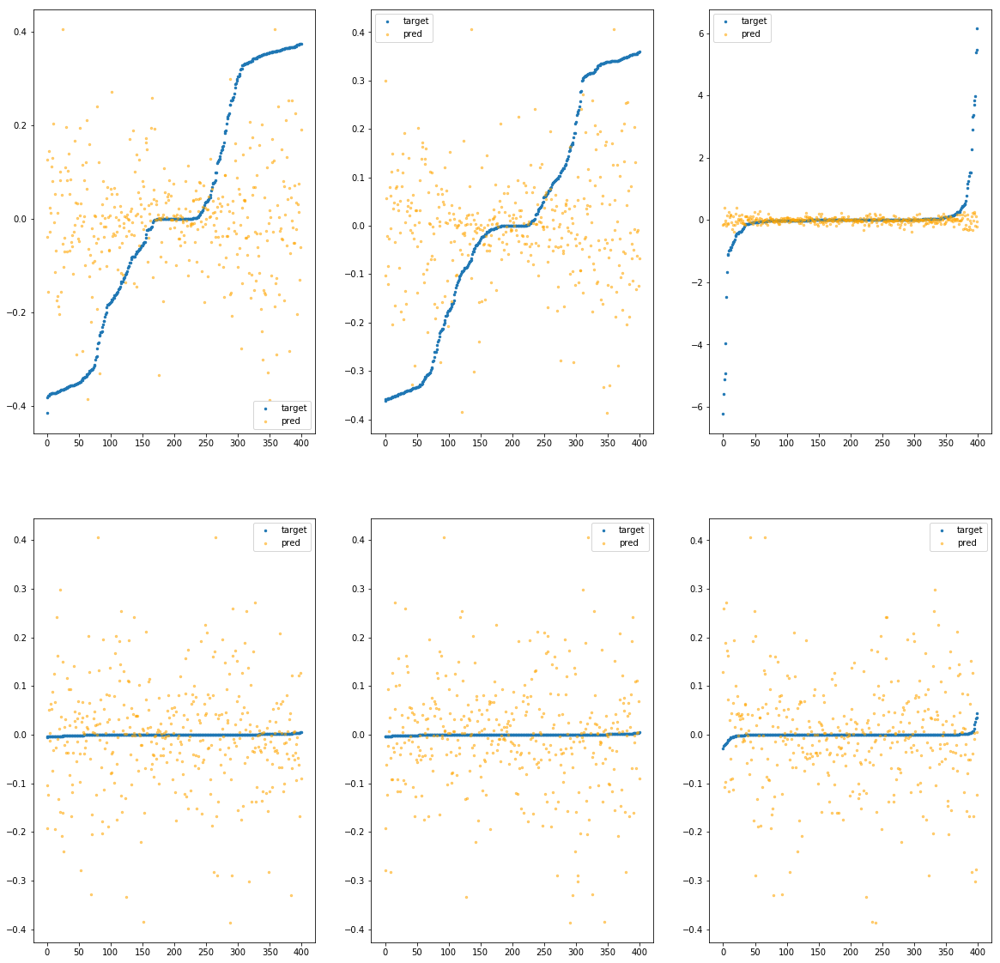

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa99bfd7790>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.34e-01	8.98e-01	2.22e-01	1.34e+04	7.91e-02	6.26e-03
y		-3.42e-01	8.62e-01	2.04e-01	1.42e+03	7.36e-02	5.41e-03
z		-6.19e-02	6.57e+00	3.20e-01	1.12e+03	9.29e-01	8.63e-01
phi		-8.37e+03	5.55e-01	8.40e-02	5.78e+06	1.56e-02	2.43e-04
theta		-1.23e+04	5.52e-01	8.41e-02	9.54e+05	1.56e-02	2.43e-04
psi		-6.33e+02	5.54e-01	8.40e-02	1.71e+06	1.56e-02	2.42e-04


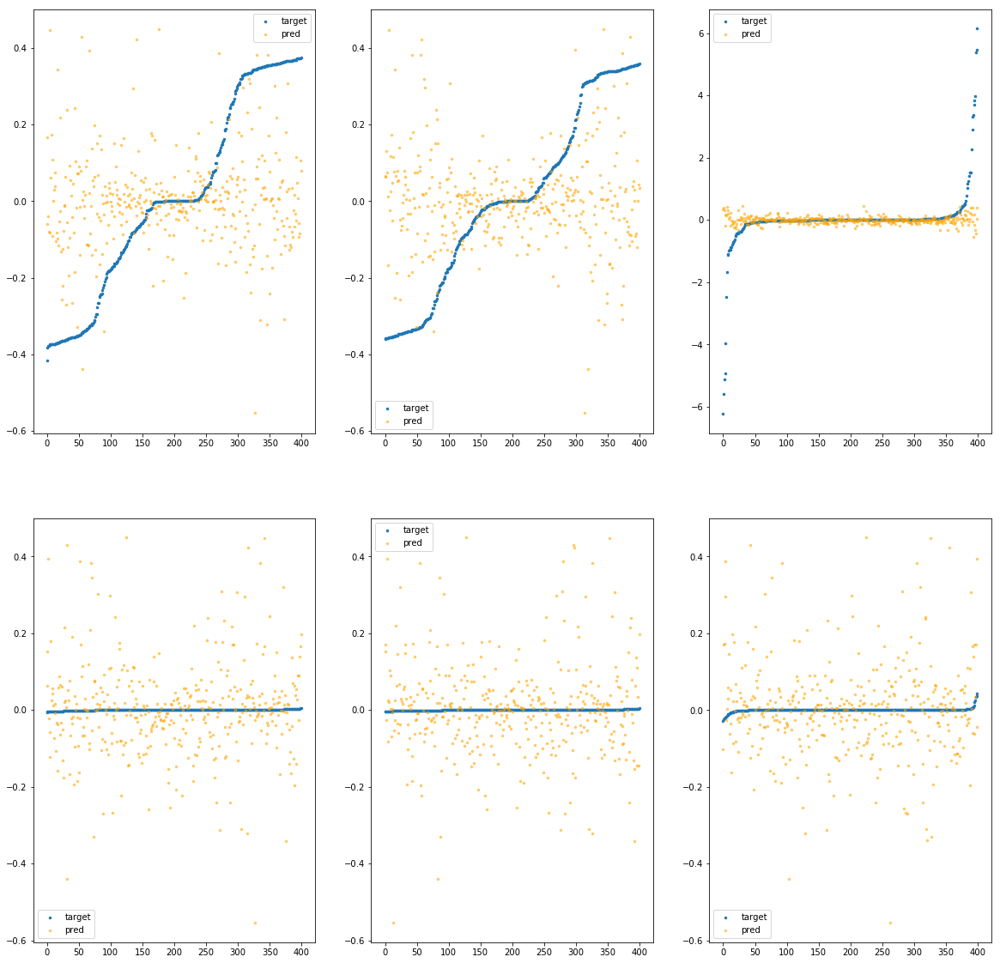

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa99bfd77f0>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.38e-01	7.61e-01	2.17e-01	6.22e+03	7.30e-02	5.33e-03
y		-1.58e-01	7.43e-01	1.97e-01	6.21e+02	6.35e-02	4.03e-03
z		-3.99e-02	6.51e+00	3.12e-01	7.84e+02	9.10e-01	8.28e-01
phi		-6.99e+03	6.20e-01	7.41e-02	3.24e+06	1.30e-02	1.69e-04
theta		-1.03e+04	6.20e-01	7.41e-02	6.31e+05	1.30e-02	1.70e-04
psi		-5.31e+02	6.17e-01	7.42e-02	9.63e+05	1.30e-02	1.70e-04


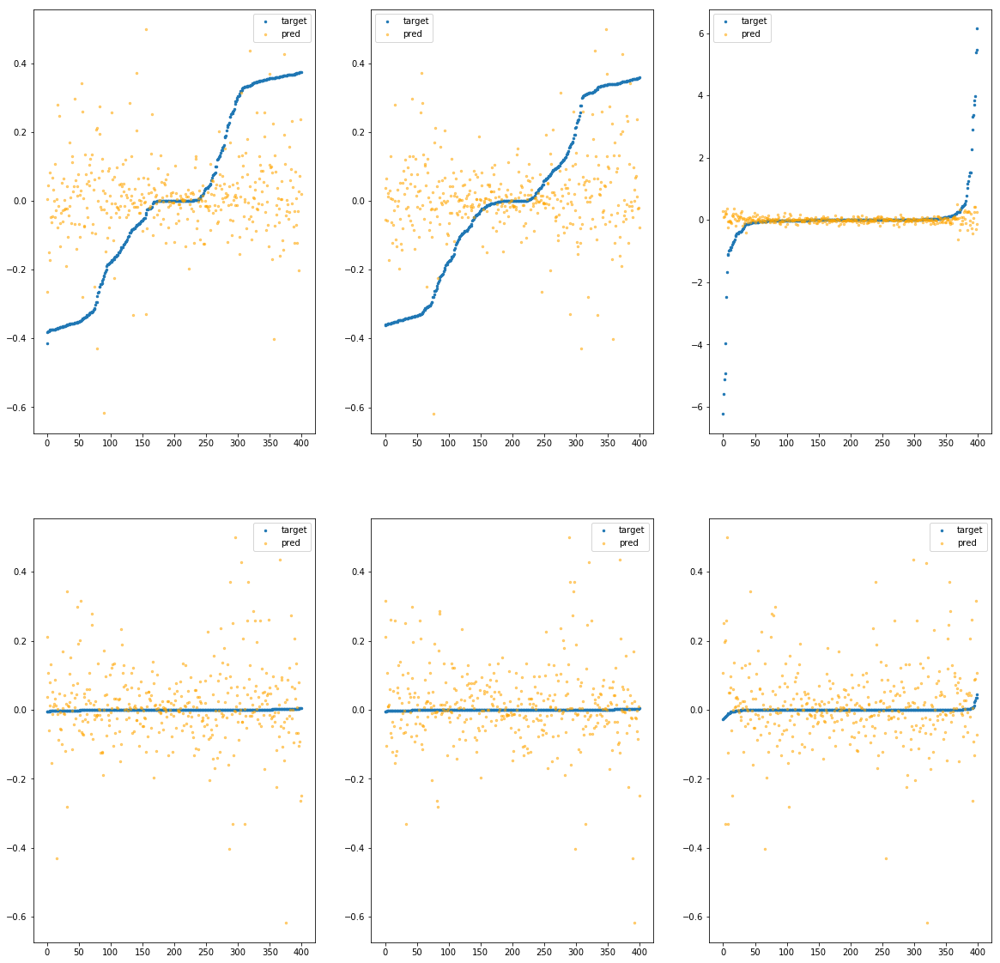

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa99bfd7850>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.86e-01	7.72e-01	2.34e-01	9.96e+03	8.89e-02	7.90e-03
y		-2.04e-01	8.79e-01	1.93e-01	1.93e+03	6.60e-02	4.36e-03
z		-4.80e-02	6.24e+00	3.39e-01	1.65e+03	9.17e-01	8.41e-01
phi		-1.17e+04	7.37e-01	1.03e-01	3.46e+06	2.18e-02	4.74e-04
theta		-1.72e+04	7.37e-01	1.04e-01	1.22e+06	2.18e-02	4.75e-04
psi		-8.86e+02	7.38e-01	1.03e-01	2.00e+06	2.18e-02	4.73e-04


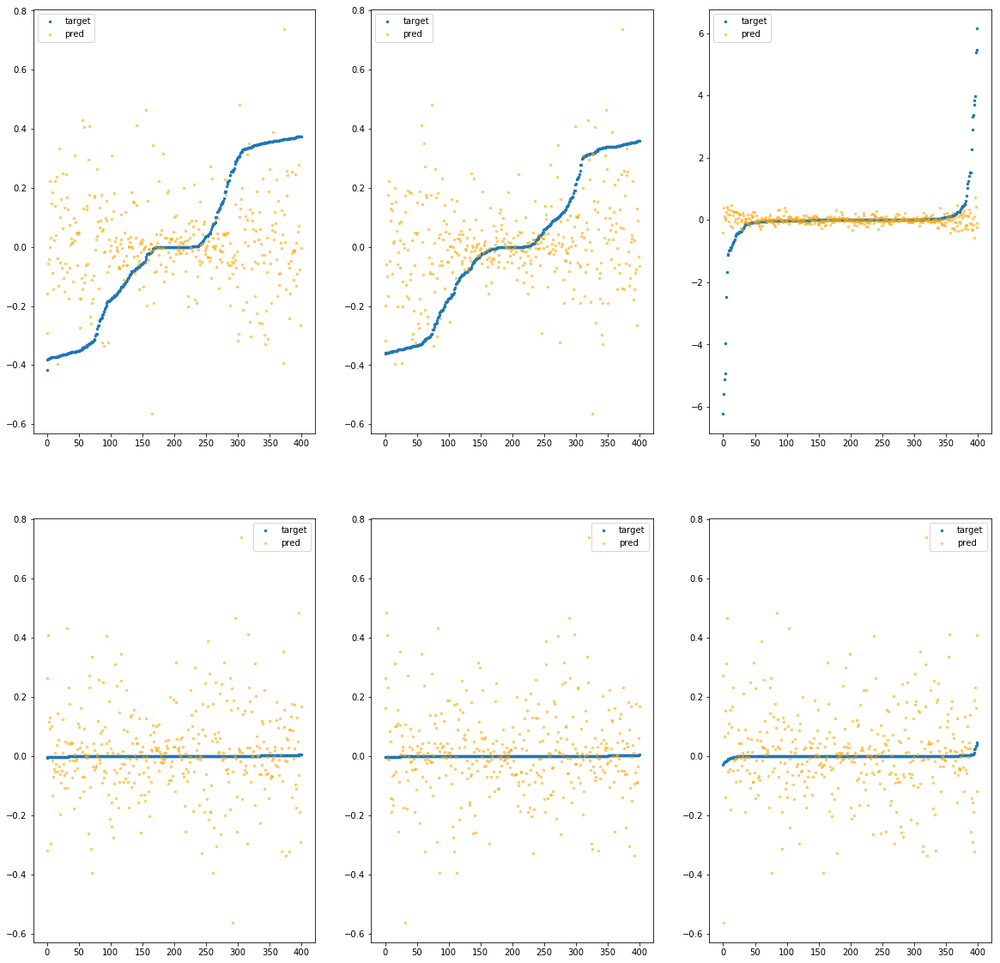

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa99bfd78b0>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.58e-02	7.15e-01	2.12e-01	7.40e+03	6.90e-02	4.76e-03
y		-2.37e-01	8.57e-01	2.03e-01	7.82e+02	6.78e-02	4.60e-03
z		-6.75e-03	6.38e+00	3.16e-01	1.08e+03	8.81e-01	7.76e-01
phi		-5.55e+03	5.38e-01	6.93e-02	3.03e+06	1.03e-02	1.07e-04
theta		-8.12e+03	5.41e-01	6.93e-02	7.12e+05	1.03e-02	1.06e-04
psi		-4.24e+02	5.39e-01	6.95e-02	1.27e+06	1.04e-02	1.09e-04


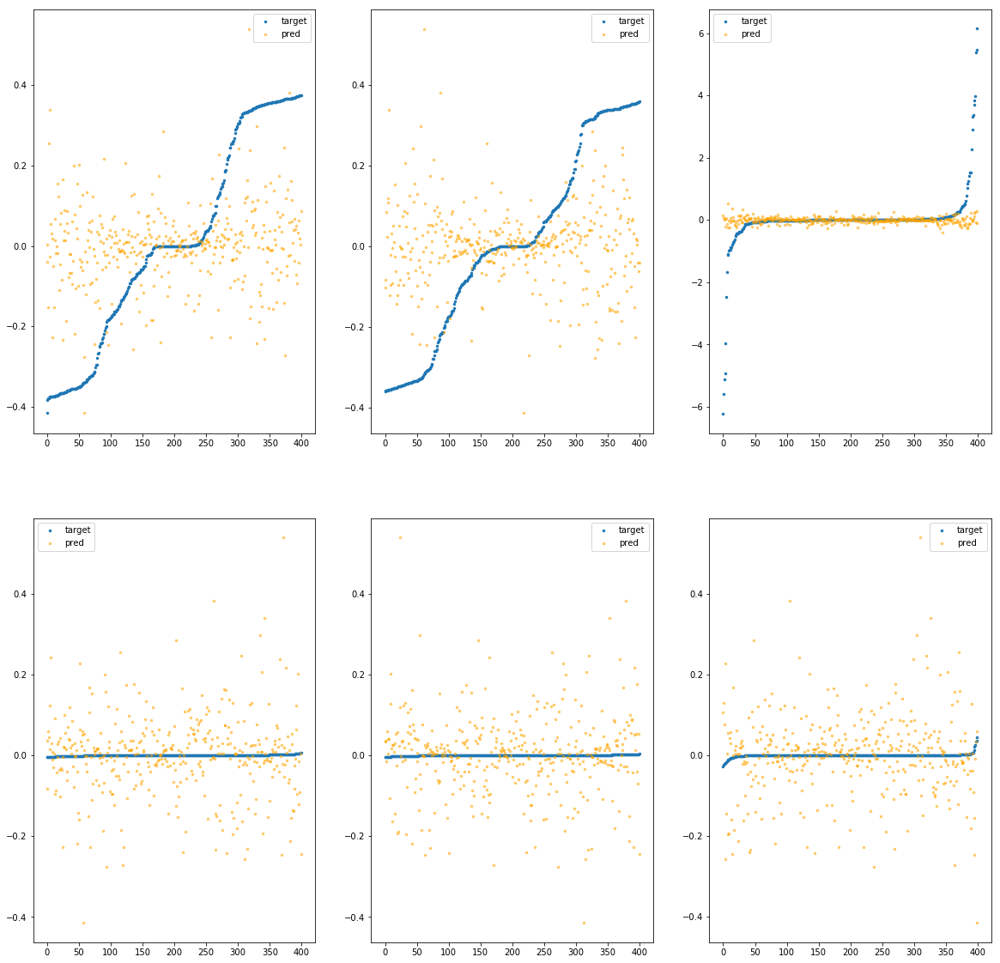

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa99bfd7910>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.27e-01	7.27e-01	2.24e-01	7.24e+03	7.87e-02	6.19e-03
y		-2.37e-01	7.09e-01	2.03e-01	1.46e+03	6.78e-02	4.60e-03
z		-2.16e-02	6.43e+00	3.17e-01	9.64e+02	8.94e-01	7.99e-01
phi		-6.22e+03	4.52e-01	7.35e-02	2.67e+06	1.16e-02	1.34e-04
theta		-9.11e+03	4.53e-01	7.35e-02	6.62e+05	1.16e-02	1.34e-04
psi		-4.74e+02	4.56e-01	7.36e-02	1.43e+06	1.17e-02	1.36e-04


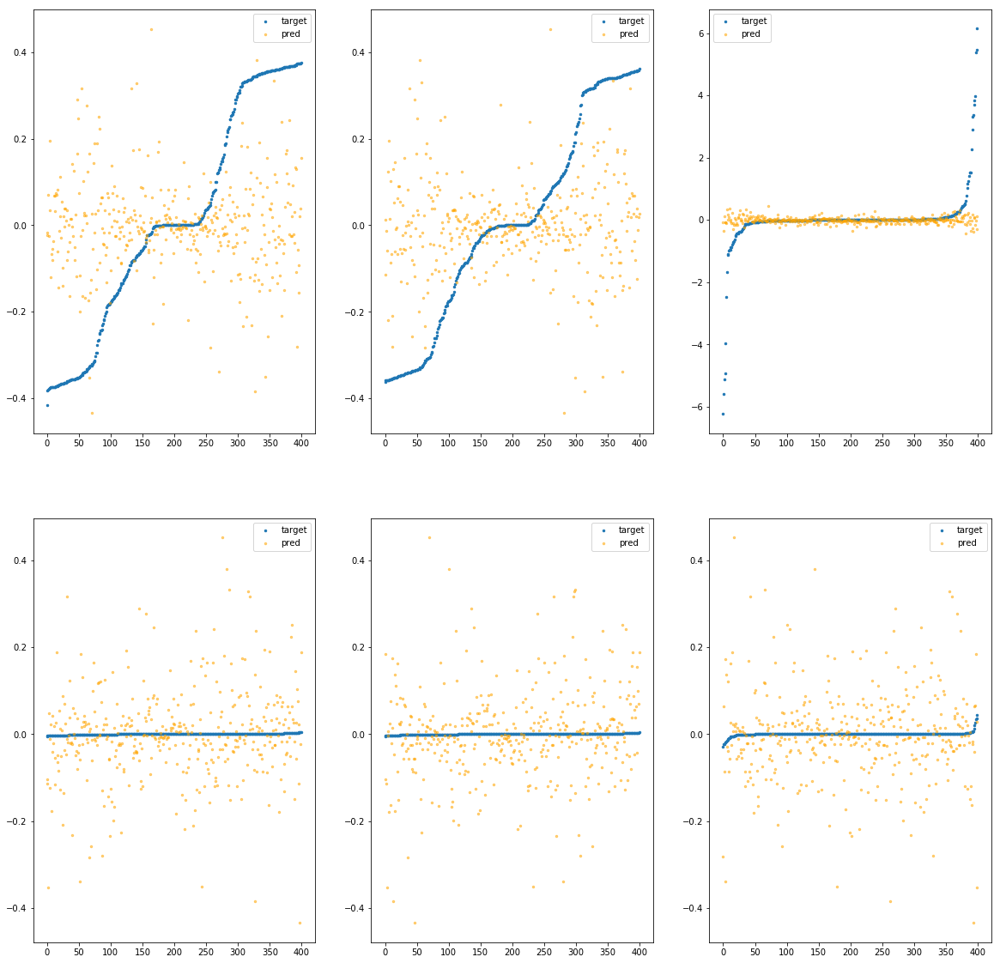

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa99bfd7970>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.98e-01	1.00e+00	2.14e-01	7.50e+03	7.68e-02	5.90e-03
y		-3.41e-01	9.81e-01	2.10e-01	1.75e+03	7.35e-02	5.41e-03
z		-3.60e-03	6.46e+00	3.14e-01	1.28e+03	8.78e-01	7.71e-01
phi		-8.28e+03	6.41e-01	8.22e-02	2.85e+06	1.54e-02	2.38e-04
theta		-1.21e+04	6.41e-01	8.22e-02	1.65e+06	1.54e-02	2.37e-04
psi		-6.25e+02	6.41e-01	8.21e-02	1.05e+06	1.54e-02	2.36e-04


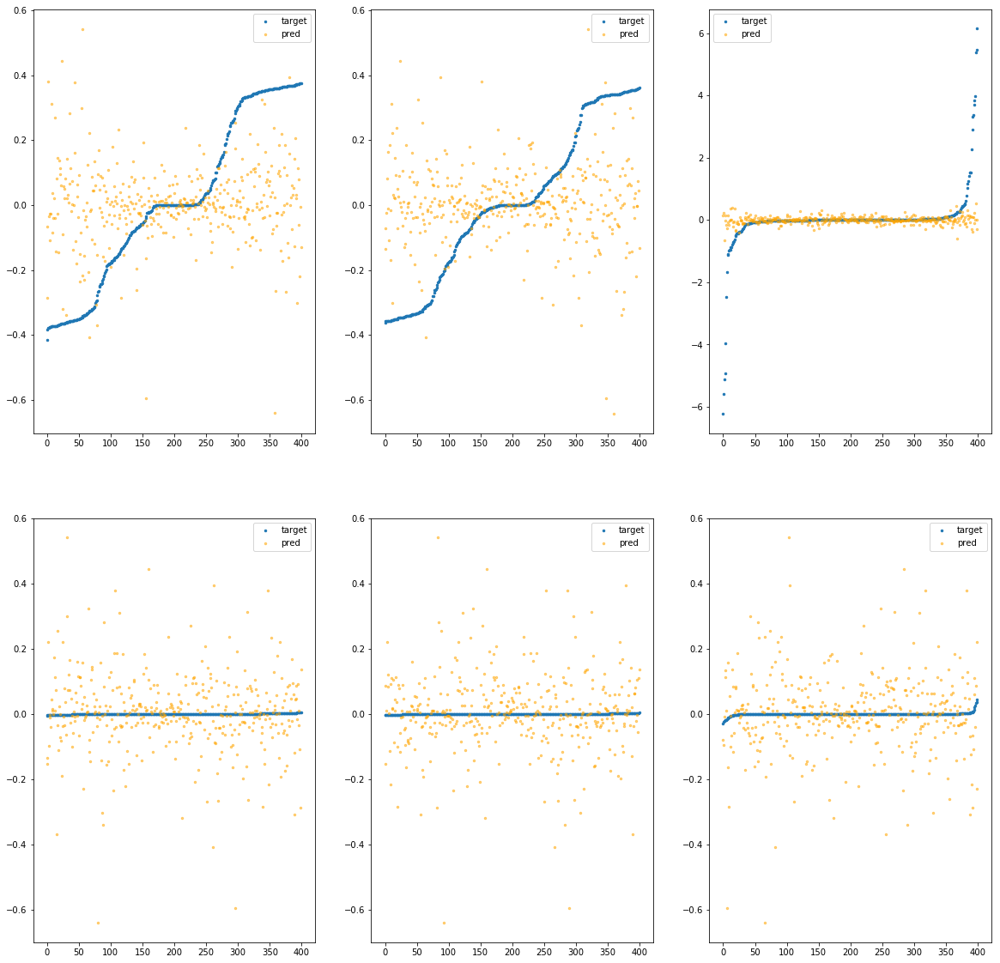

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa99bfd79d0>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.08e-01	1.23e+00	2.30e-01	1.06e+04	9.02e-02	8.14e-03
y		-4.54e-01	1.21e+00	2.15e-01	1.20e+03	7.97e-02	6.36e-03
z		-6.39e-02	6.15e+00	3.36e-01	9.97e+02	9.31e-01	8.66e-01
phi		-1.24e+04	8.73e-01	9.91e-02	5.37e+06	2.31e-02	5.34e-04
theta		-1.82e+04	8.73e-01	9.90e-02	9.24e+05	2.31e-02	5.32e-04
psi		-9.45e+02	8.72e-01	9.95e-02	1.66e+06	2.32e-02	5.38e-04


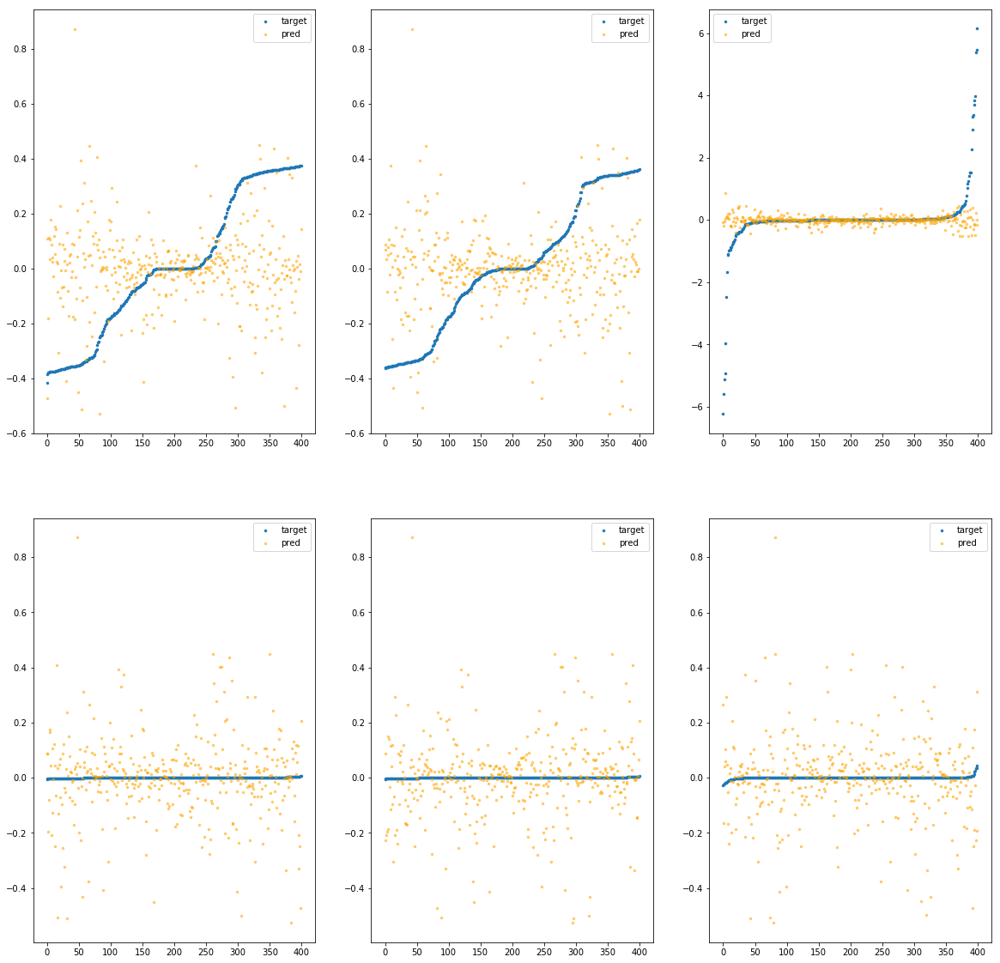

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa99bfd7a30>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.49e-01	1.10e+00	2.21e-01	9.66e+03	8.01e-02	6.42e-03
y		-3.88e-01	9.03e-01	2.11e-01	1.94e+03	7.61e-02	5.79e-03
z		-1.94e-02	6.64e+00	3.17e-01	1.07e+03	8.92e-01	7.95e-01
phi		-8.79e+03	6.75e-01	8.34e-02	5.06e+06	1.64e-02	2.68e-04
theta		-1.29e+04	6.81e-01	8.34e-02	1.35e+06	1.64e-02	2.69e-04
psi		-6.66e+02	6.74e-01	8.34e-02	9.20e+05	1.64e-02	2.67e-04


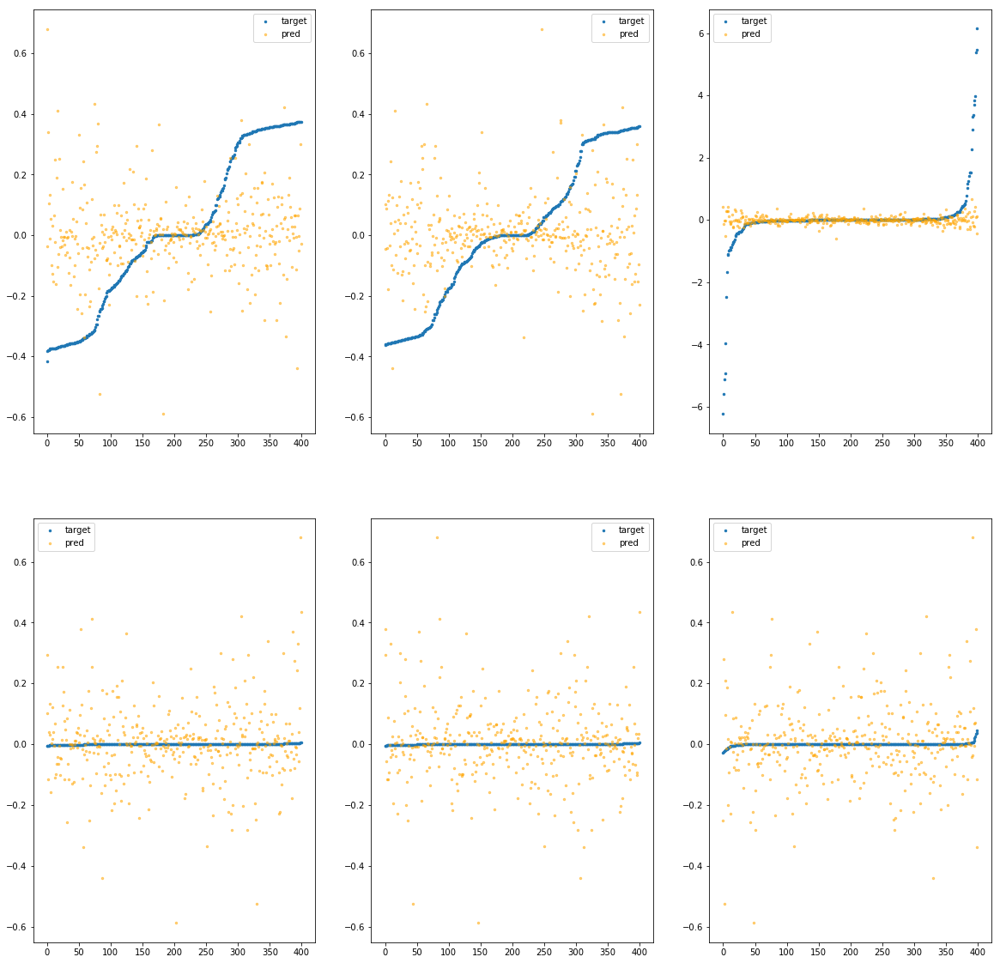

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa99bfd7a90>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.54e-02	7.50e-01	2.10e-01	3.18e+03	6.89e-02	4.75e-03
y		-1.64e-01	7.32e-01	2.00e-01	5.97e+02	6.38e-02	4.07e-03
z		1.93e-03	6.06e+00	3.02e-01	6.25e+02	8.73e-01	7.62e-01
phi		-4.25e+03	4.28e-01	5.89e-02	1.15e+06	7.91e-03	6.26e-05
theta		-6.22e+03	4.29e-01	5.88e-02	3.77e+05	7.90e-03	6.24e-05
psi		-3.27e+02	4.26e-01	5.91e-02	1.02e+06	8.05e-03	6.47e-05


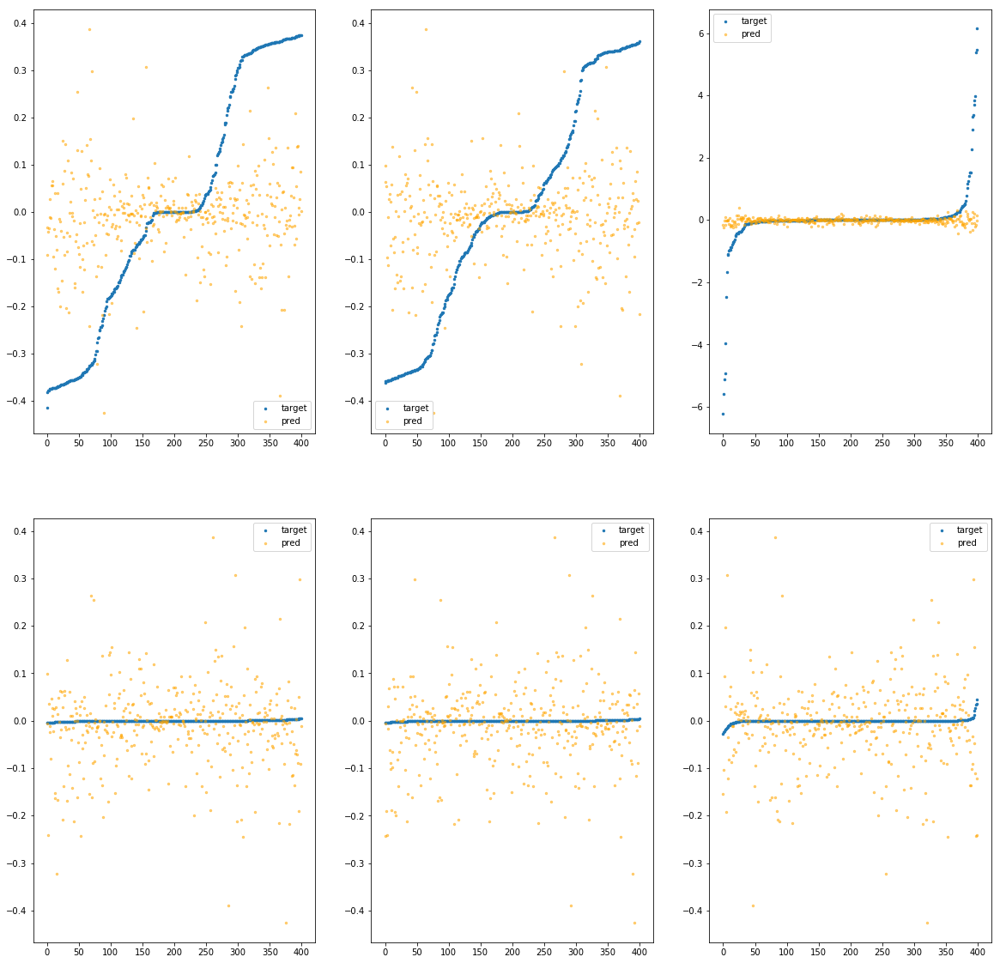

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa99bfd7af0>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.71e-01	1.01e+00	2.22e-01	8.01e+03	8.15e-02	6.64e-03
y		-3.16e-01	9.96e-01	2.06e-01	1.19e+03	7.22e-02	5.21e-03
z		-4.87e-02	6.27e+00	3.18e-01	9.42e+02	9.17e-01	8.42e-01
phi		-8.51e+03	6.62e-01	8.28e-02	4.73e+06	1.58e-02	2.51e-04
theta		-1.25e+04	6.62e-01	8.28e-02	1.50e+06	1.58e-02	2.51e-04
psi		-6.49e+02	6.62e-01	8.30e-02	1.56e+06	1.59e-02	2.54e-04


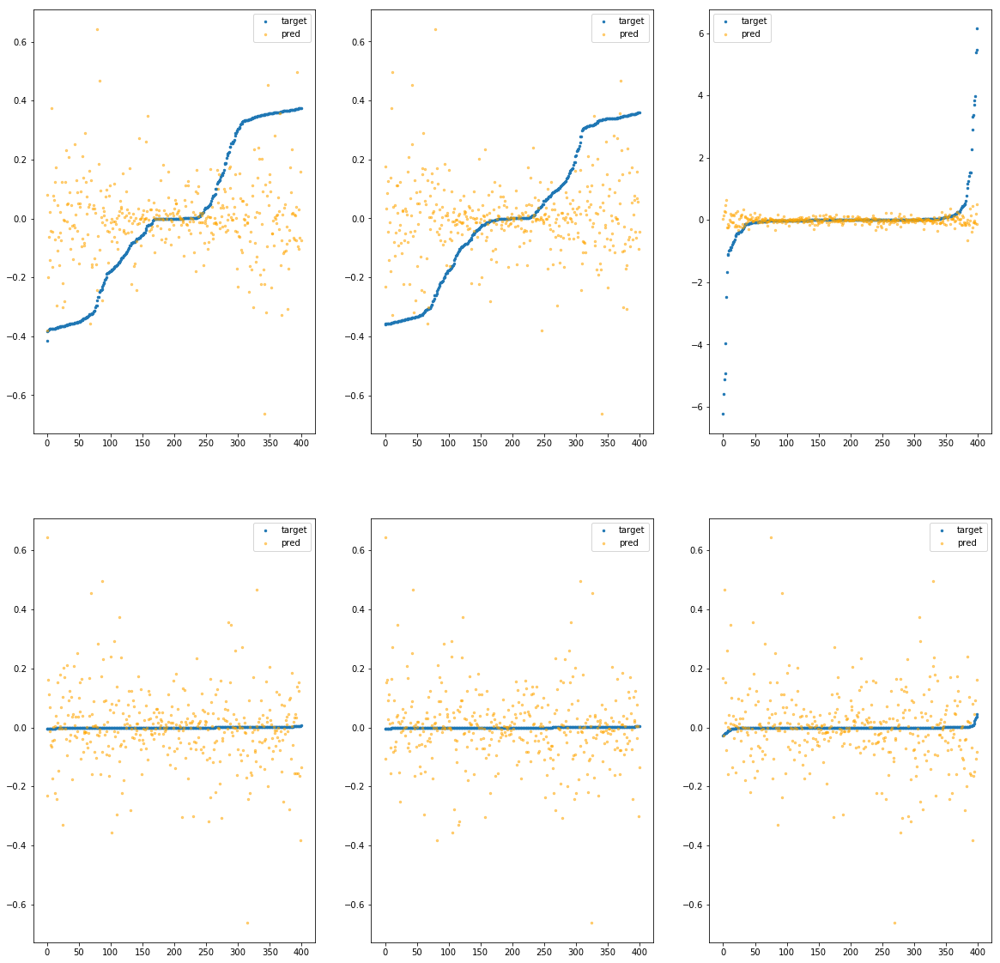

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa99bfd7b50>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.90e-01	7.41e-01	2.18e-01	6.19e+03	7.63e-02	5.82e-03
y		-3.72e-01	7.40e-01	2.13e-01	1.31e+03	7.52e-02	5.66e-03
z		1.21e-03	6.59e+00	3.08e-01	7.74e+02	8.74e-01	7.64e-01
phi		-7.48e+03	4.81e-01	7.90e-02	2.68e+06	1.39e-02	1.94e-04
theta		-1.10e+04	4.82e-01	7.90e-02	8.40e+05	1.39e-02	1.94e-04
psi		-5.71e+02	4.81e-01	7.92e-02	1.13e+06	1.40e-02	1.97e-04


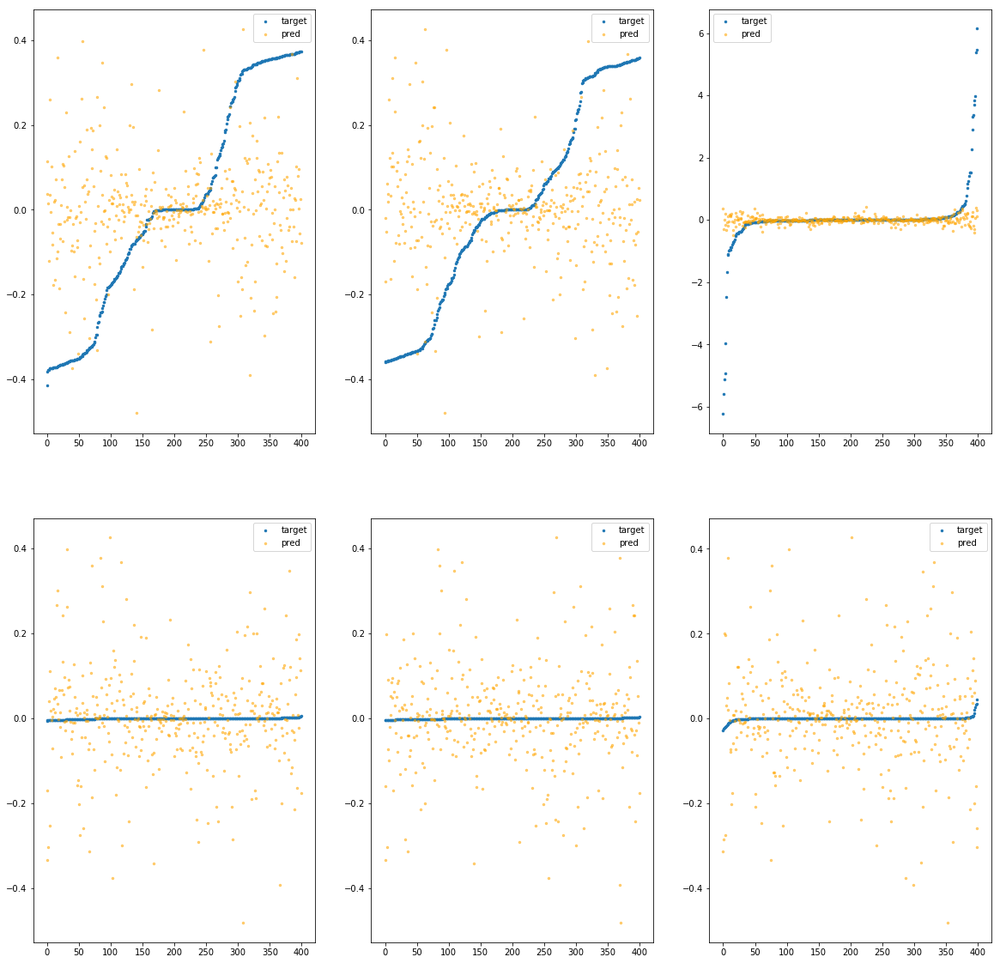

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa99bfd7bb0>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.52e-01	7.75e-01	2.36e-01	5.98e+03	8.67e-02	7.51e-03
y		-2.18e-01	6.54e-01	2.03e-01	2.93e+03	6.68e-02	4.46e-03
z		-8.13e-03	6.41e+00	3.14e-01	7.19e+02	8.82e-01	7.78e-01
phi		-6.01e+03	5.13e-01	7.34e-02	2.26e+06	1.12e-02	1.25e-04
theta		-8.83e+03	5.13e-01	7.35e-02	1.98e+06	1.12e-02	1.26e-04
psi		-4.55e+02	5.13e-01	7.35e-02	1.47e+06	1.12e-02	1.25e-04


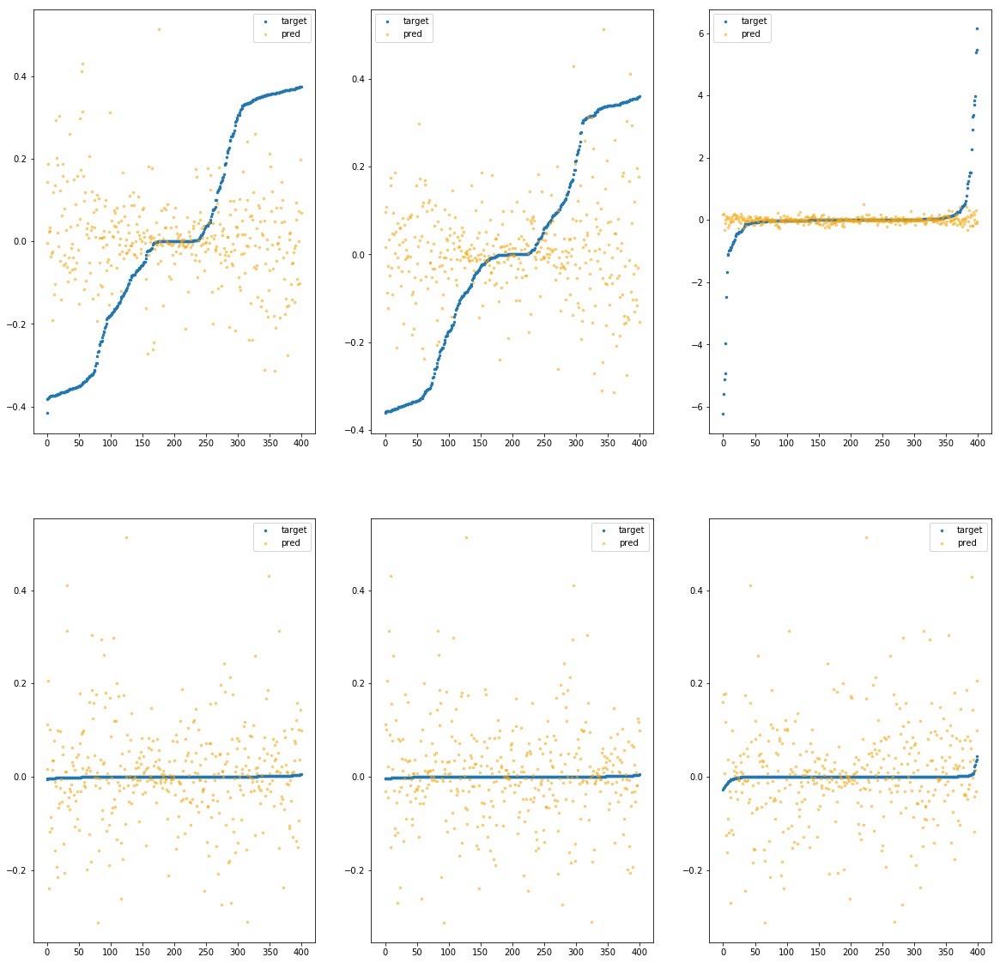

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa99bfd7c10>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.71e-01	7.06e-01	2.16e-01	8.79e+03	7.51e-02	5.64e-03
y		-2.80e-01	9.61e-01	2.06e-01	1.31e+03	7.02e-02	4.93e-03
z		-2.11e-02	6.49e+00	3.18e-01	8.53e+02	8.93e-01	7.98e-01
phi		-7.61e+03	6.24e-01	8.11e-02	3.28e+06	1.42e-02	2.01e-04
theta		-1.11e+04	6.23e-01	8.11e-02	8.93e+05	1.41e-02	2.00e-04
psi		-5.71e+02	6.24e-01	8.07e-02	8.79e+05	1.40e-02	1.97e-04


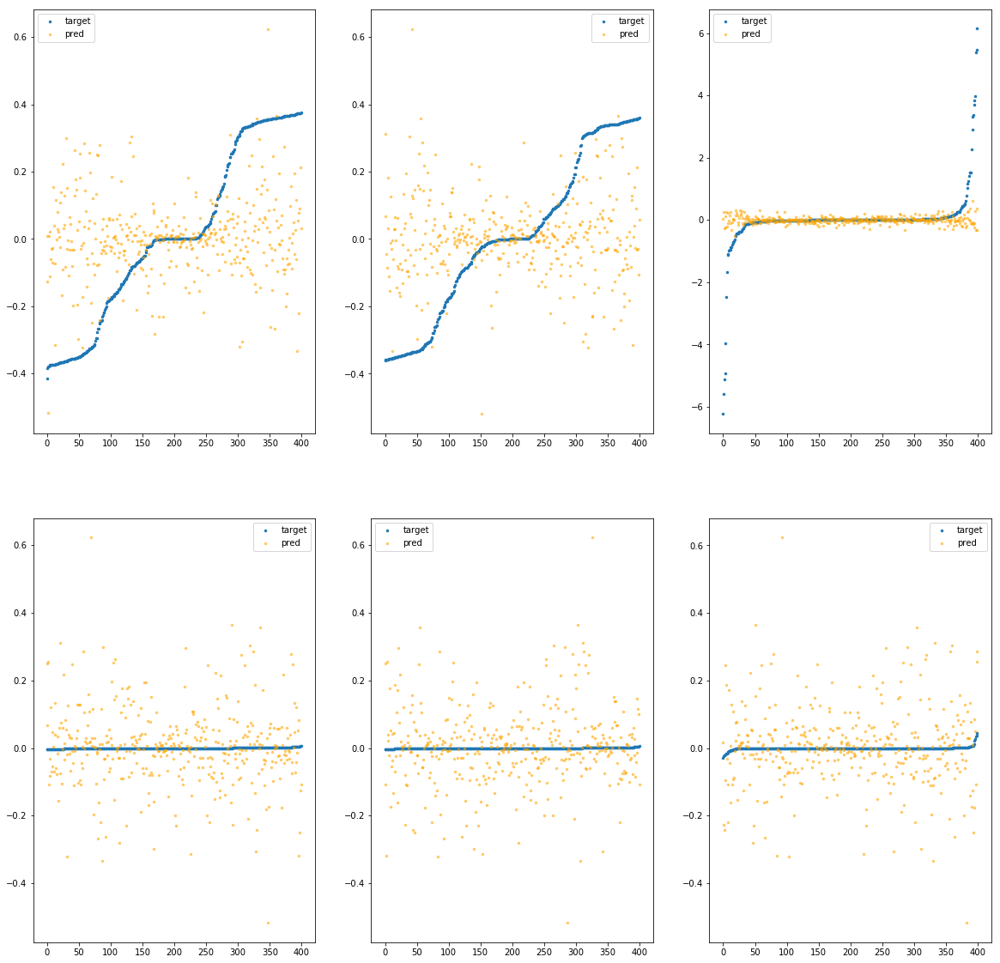

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa99bfd7c70>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.36e-01	9.60e-01	2.22e-01	5.08e+03	7.93e-02	6.28e-03
y		-1.42e-01	6.91e-01	1.97e-01	1.10e+03	6.26e-02	3.92e-03
z		-4.31e-02	6.56e+00	3.12e-01	5.72e+02	9.13e-01	8.33e-01
phi		-7.07e+03	6.17e-01	7.33e-02	2.45e+06	1.32e-02	1.73e-04
theta		-1.04e+04	6.15e-01	7.34e-02	6.17e+05	1.32e-02	1.74e-04
psi		-5.45e+02	6.16e-01	7.37e-02	1.60e+06	1.34e-02	1.79e-04


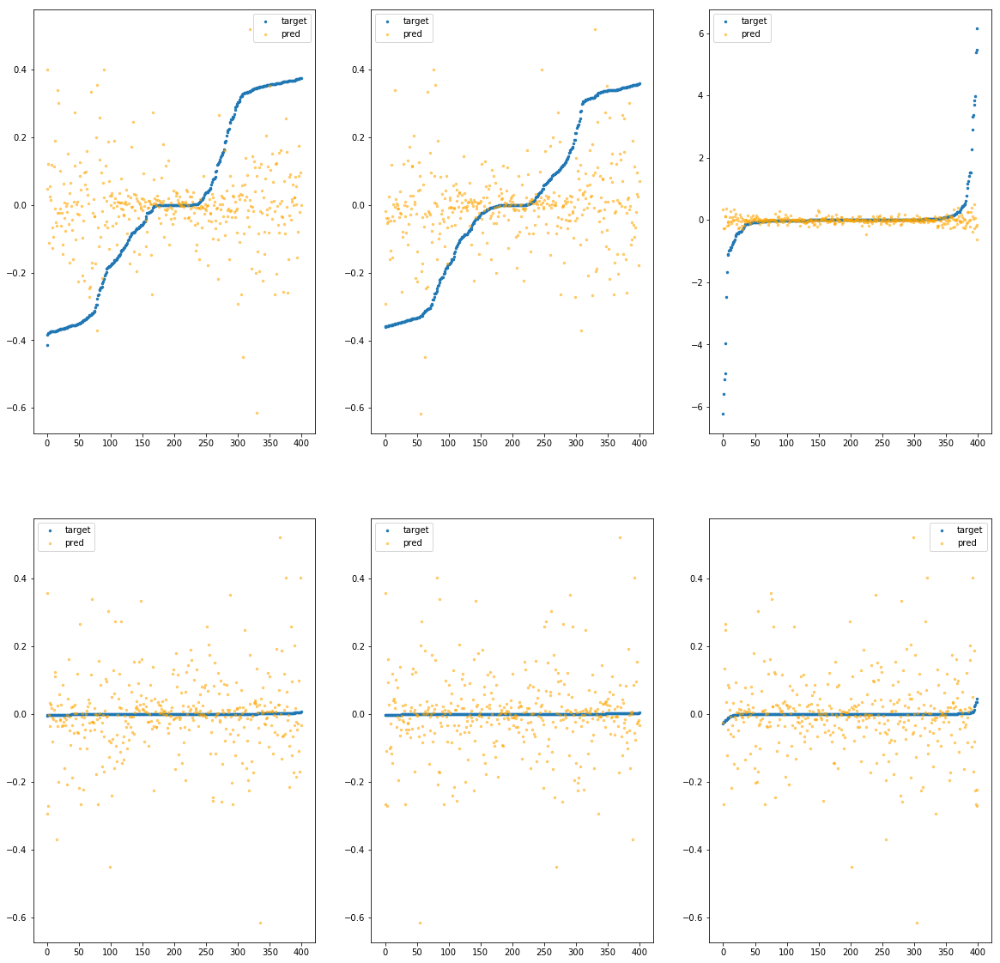

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa99bfd7cd0>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.98e-01	9.68e-01	2.33e-01	6.24e+03	8.96e-02	8.03e-03
y		-2.97e-01	9.52e-01	2.08e-01	1.73e+03	7.11e-02	5.06e-03
z		-5.41e-02	6.04e+00	3.22e-01	9.96e+02	9.22e-01	8.50e-01
phi		-8.97e+03	6.96e-01	8.39e-02	2.14e+06	1.67e-02	2.79e-04
theta		-1.31e+04	6.95e-01	8.39e-02	1.40e+06	1.67e-02	2.78e-04
psi		-6.78e+02	6.91e-01	8.37e-02	1.11e+06	1.66e-02	2.77e-04


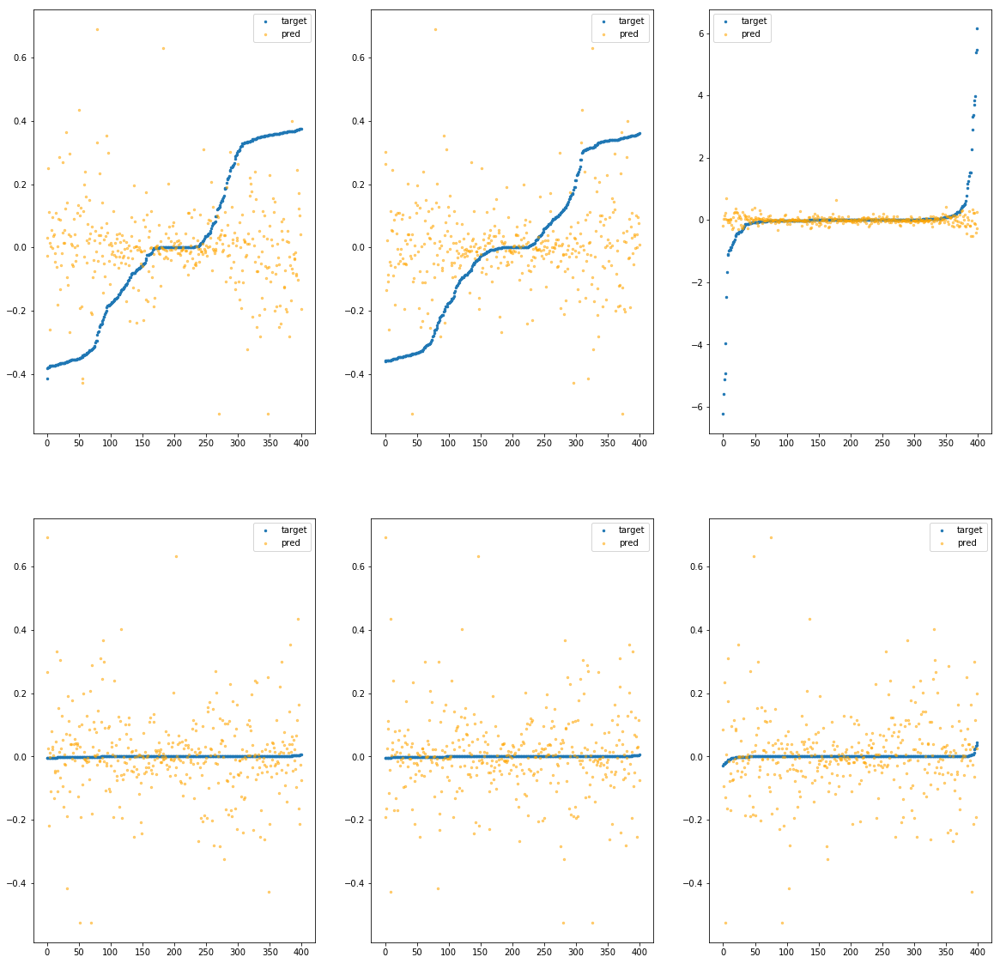

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa99bfd7d30>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.76e-01	7.81e-01	2.18e-01	6.27e+03	7.54e-02	5.68e-03
y		-1.52e-01	7.63e-01	1.97e-01	1.02e+03	6.31e-02	3.99e-03
z		-2.18e-02	6.58e+00	3.07e-01	7.17e+02	8.94e-01	7.99e-01
phi		-6.49e+03	5.39e-01	6.99e-02	2.81e+06	1.21e-02	1.46e-04
theta		-9.52e+03	5.39e-01	6.99e-02	1.12e+06	1.21e-02	1.46e-04
psi		-4.98e+02	5.39e-01	7.03e-02	1.43e+06	1.22e-02	1.50e-04


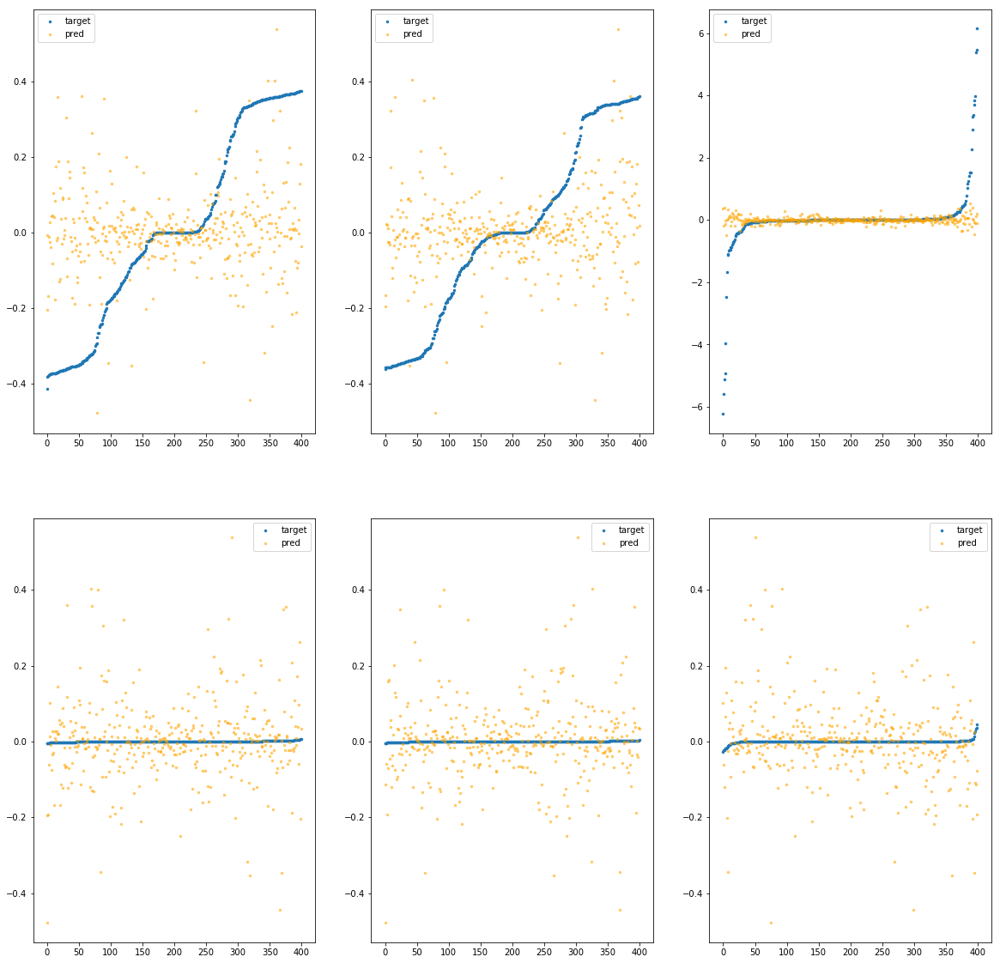

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa99bfd7d90>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.38e-01	7.54e-01	2.15e-01	6.43e+03	7.29e-02	5.32e-03
y		-2.55e-01	9.55e-01	2.05e-01	1.06e+03	6.88e-02	4.73e-03
z		2.51e-02	6.24e+00	3.02e-01	1.28e+03	8.53e-01	7.27e-01
phi		-6.80e+03	6.26e-01	7.50e-02	1.90e+06	1.27e-02	1.60e-04
theta		-9.97e+03	6.28e-01	7.49e-02	8.94e+05	1.27e-02	1.60e-04
psi		-5.20e+02	6.27e-01	7.51e-02	1.05e+06	1.28e-02	1.64e-04


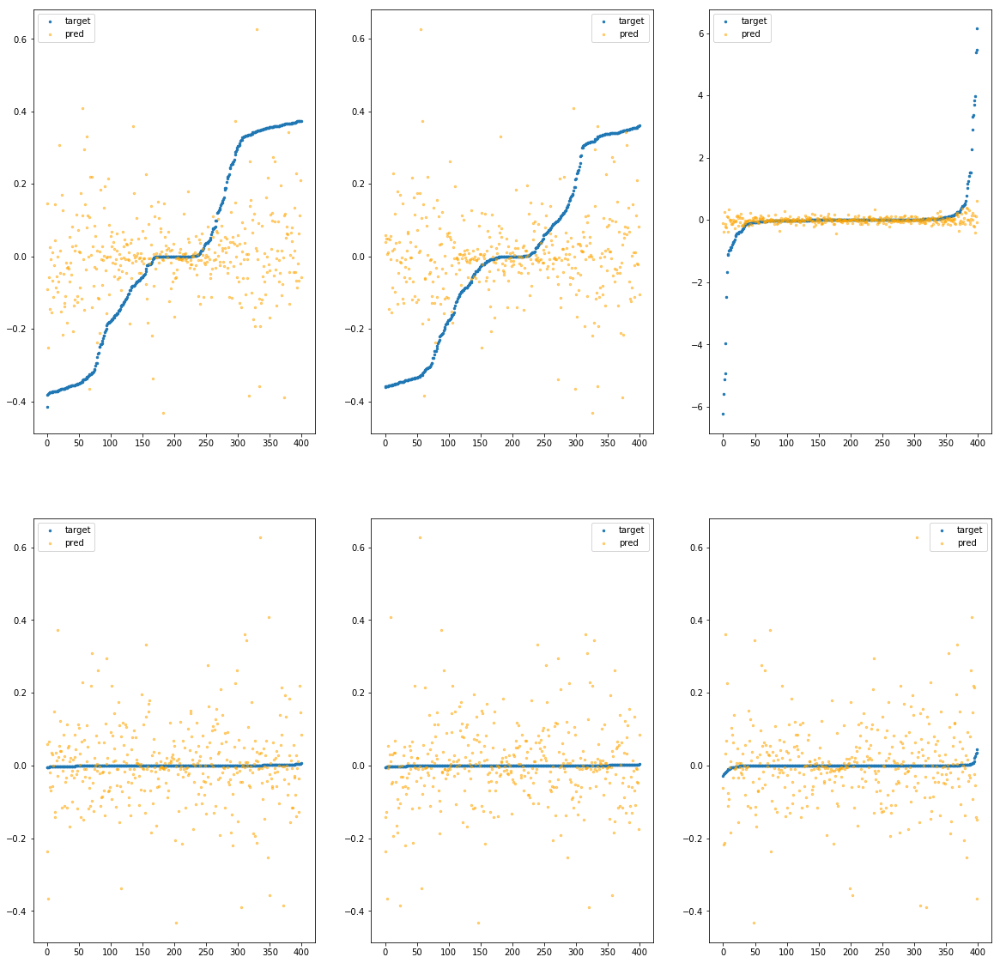

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fa99bfd7df0>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.58e-01	8.40e-01	2.21e-01	9.34e+03	7.43e-02	5.51e-03
y		-1.17e-01	5.94e-01	1.97e-01	1.09e+03	6.13e-02	3.75e-03
z		-1.31e-02	6.20e+00	3.00e-01	8.19e+02	8.86e-01	7.86e-01
phi		-3.78e+03	5.18e-01	5.84e-02	3.23e+06	7.04e-03	4.96e-05
theta		-5.56e+03	5.18e-01	5.84e-02	4.54e+05	7.06e-03	4.99e-05
psi		-2.82e+02	4.70e-01	5.82e-02	1.09e+06	6.94e-03	4.81e-05


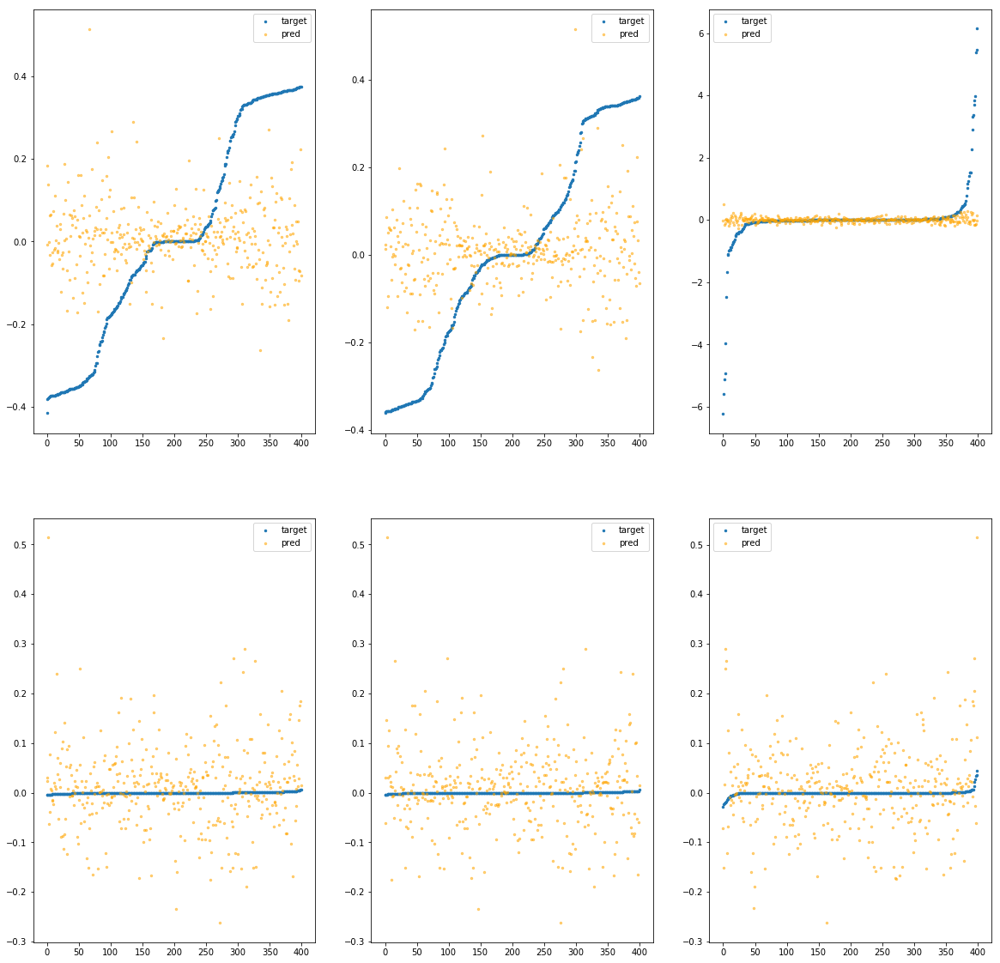

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa99bfd7e50>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.40e-04	4.72e-01	2.06e-01	2.01e+03	6.42e-02	4.12e-03
y		-4.21e-02	4.63e-01	1.92e-01	1.96e+02	5.71e-02	3.26e-03
z		9.74e-05	6.22e+00	2.84e-01	2.98e+02	8.75e-01	7.65e-01
phi		-5.61e+02	1.37e-01	2.15e-02	8.03e+05	1.05e-03	1.10e-06
theta		-8.17e+02	1.37e-01	2.14e-02	2.19e+05	1.04e-03	1.08e-06
psi		-4.16e+01	1.37e-01	2.15e-02	3.59e+05	1.04e-03	1.09e-06


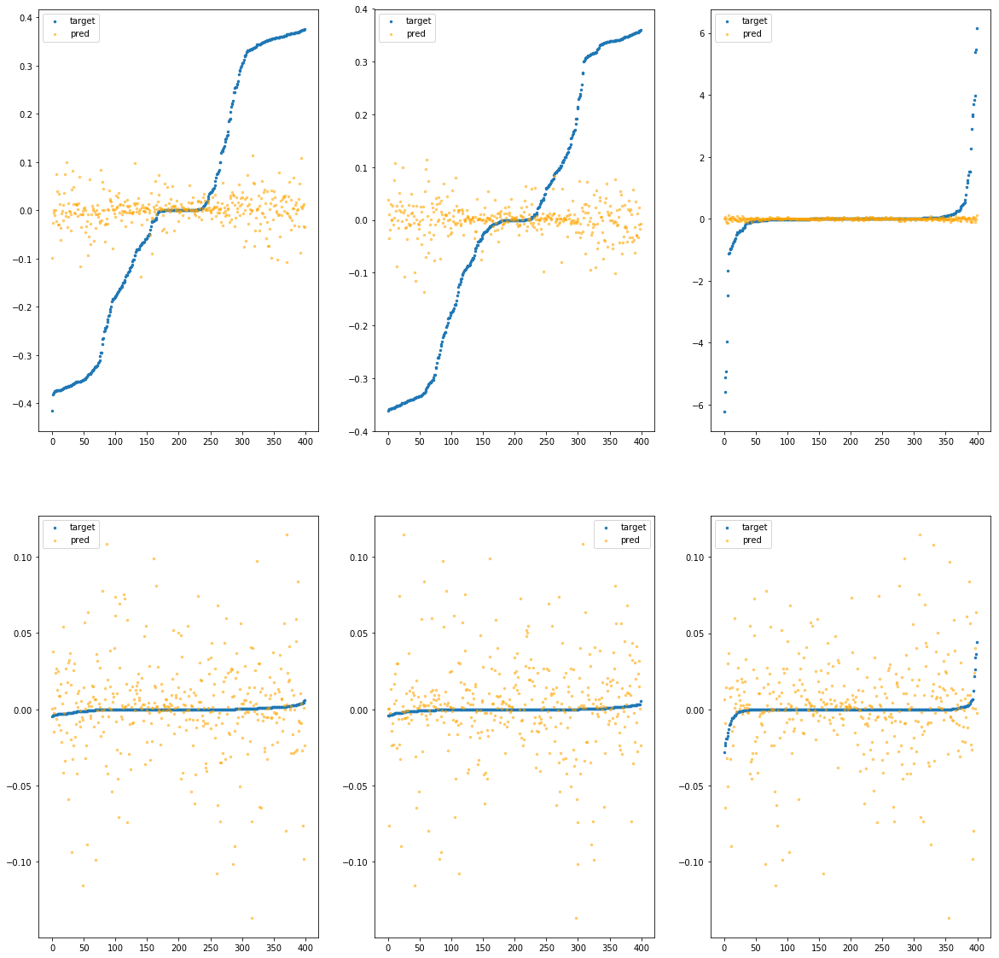

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa99bfd7eb0>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.63e-02	5.39e-01	2.11e-01	3.36e+03	6.71e-02	4.50e-03
y		-2.71e-02	5.31e-01	1.89e-01	8.56e+02	5.63e-02	3.17e-03
z		-3.09e-03	6.24e+00	2.87e-01	3.57e+02	8.78e-01	7.70e-01
phi		-1.96e+03	2.35e-01	4.12e-02	1.51e+06	3.65e-03	1.33e-05
theta		-2.88e+03	2.35e-01	4.13e-02	5.92e+05	3.66e-03	1.34e-05
psi		-1.49e+02	2.37e-01	4.13e-02	9.04e+05	3.68e-03	1.35e-05


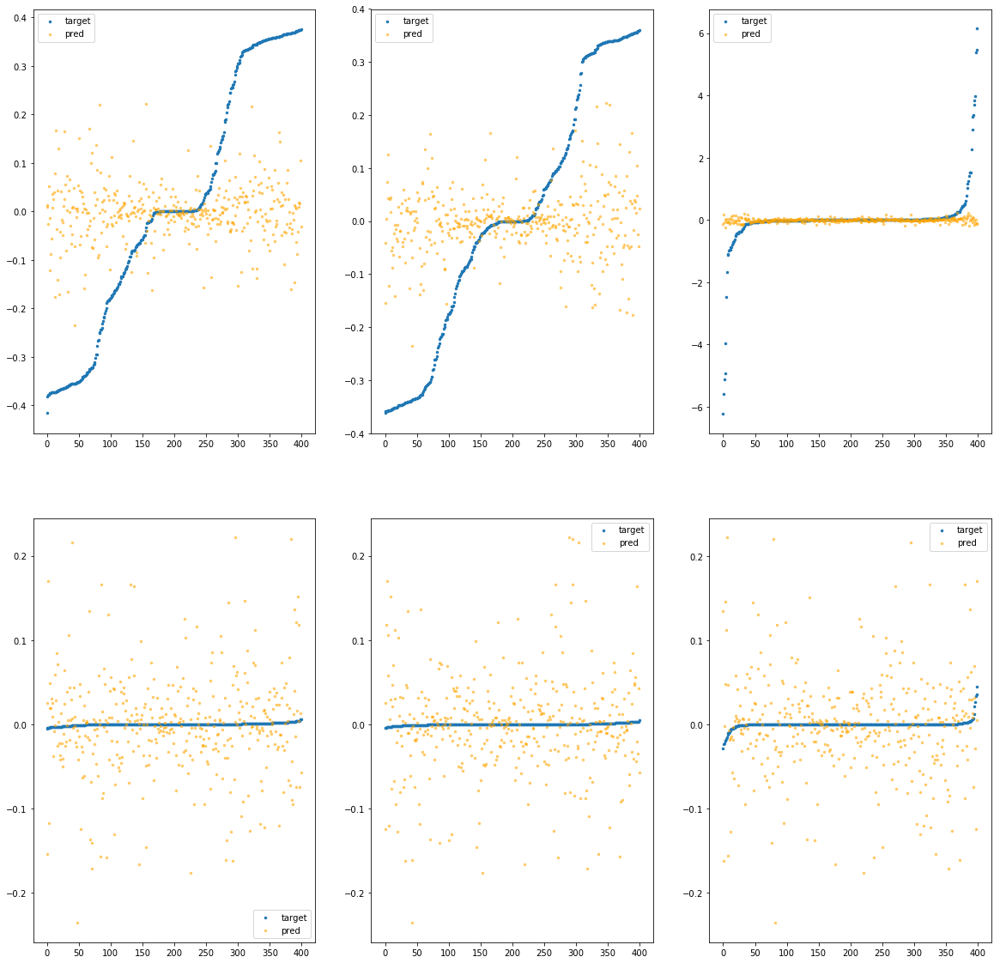

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa99bfd7f10>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.27e-01	8.09e-01	2.17e-01	3.54e+03	7.22e-02	5.22e-03
y		-1.07e-01	7.73e-01	1.95e-01	2.12e+03	6.07e-02	3.68e-03
z		-1.01e-02	6.22e+00	2.99e-01	5.33e+02	8.84e-01	7.81e-01
phi		-3.18e+03	4.66e-01	5.21e-02	1.44e+06	5.93e-03	3.51e-05
theta		-4.65e+03	4.63e-01	5.21e-02	8.55e+05	5.91e-03	3.49e-05
psi		-2.43e+02	4.65e-01	5.23e-02	1.17e+06	5.98e-03	3.57e-05


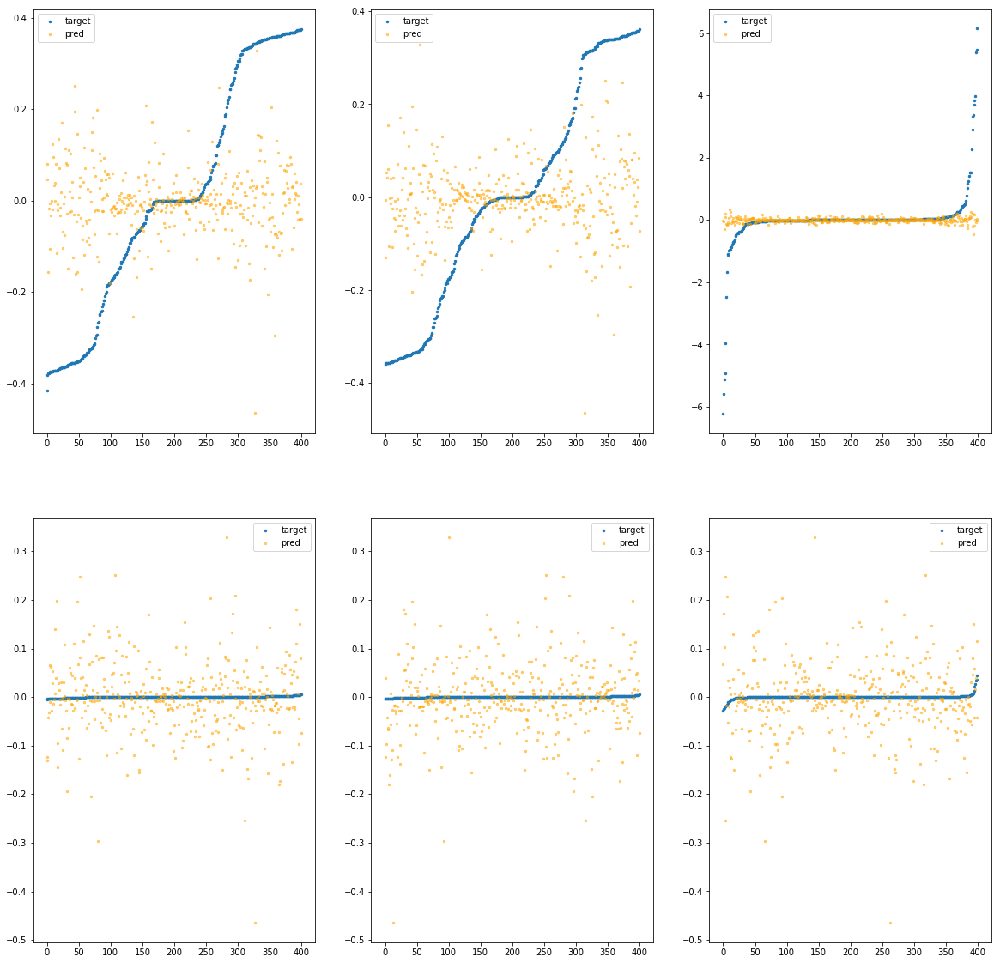

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa99bfd7f70>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.70e-01	8.22e-01	2.15e-01	9.48e+03	7.50e-02	5.63e-03
y		-1.62e-01	6.45e-01	1.99e-01	8.00e+02	6.37e-02	4.05e-03
z		-4.59e-03	6.50e+00	3.07e-01	8.82e+02	8.79e-01	7.72e-01
phi		-5.20e+03	4.01e-01	6.66e-02	3.40e+06	9.68e-03	9.38e-05
theta		-7.64e+03	4.07e-01	6.66e-02	7.42e+05	9.71e-03	9.42e-05
psi		-3.96e+02	4.00e-01	6.70e-02	1.30e+06	9.73e-03	9.46e-05


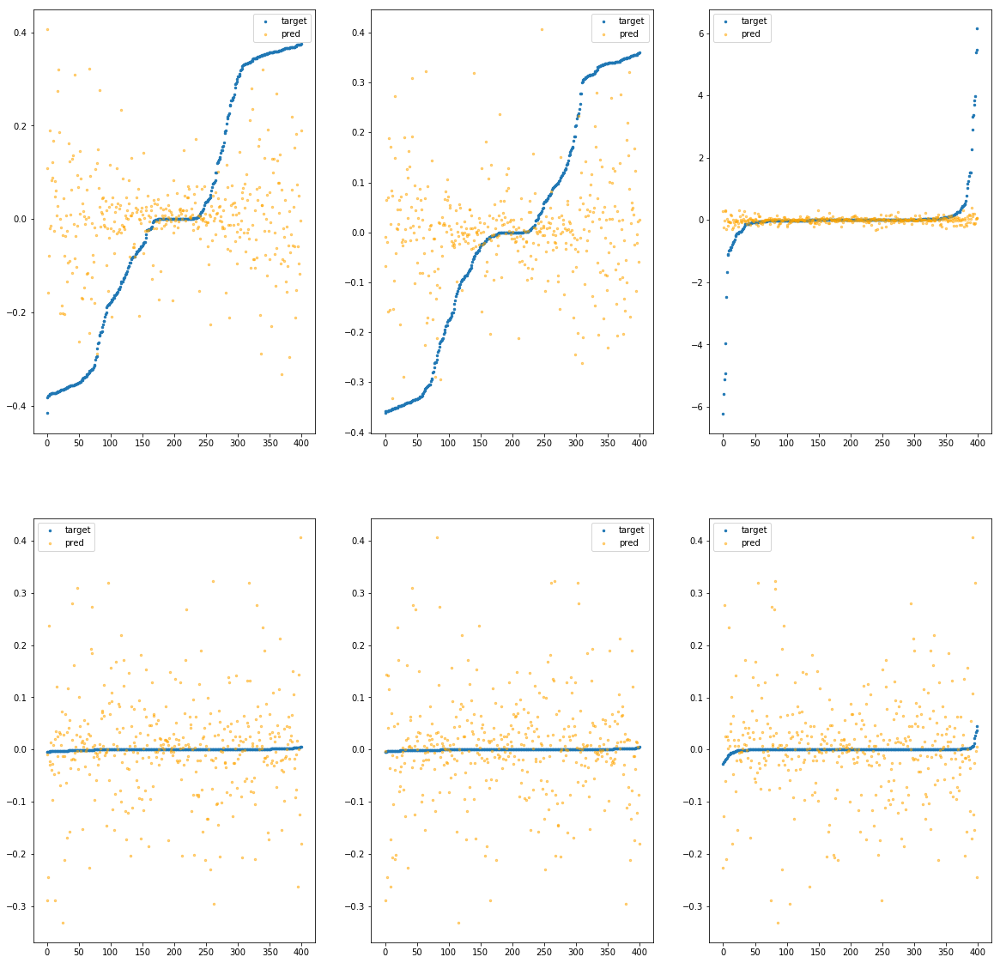

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa99bfd7fd0>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.33e-01	6.98e-01	2.15e-01	8.05e+03	7.27e-02	5.28e-03
y		-2.15e-01	8.02e-01	2.00e-01	7.90e+02	6.66e-02	4.44e-03
z		-1.70e-02	6.25e+00	3.09e-01	7.22e+02	8.90e-01	7.92e-01
phi		-6.61e+03	6.69e-01	7.18e-02	3.28e+06	1.23e-02	1.52e-04
theta		-9.73e+03	6.69e-01	7.19e-02	9.51e+05	1.24e-02	1.53e-04
psi		-5.05e+02	6.69e-01	7.19e-02	1.34e+06	1.24e-02	1.54e-04


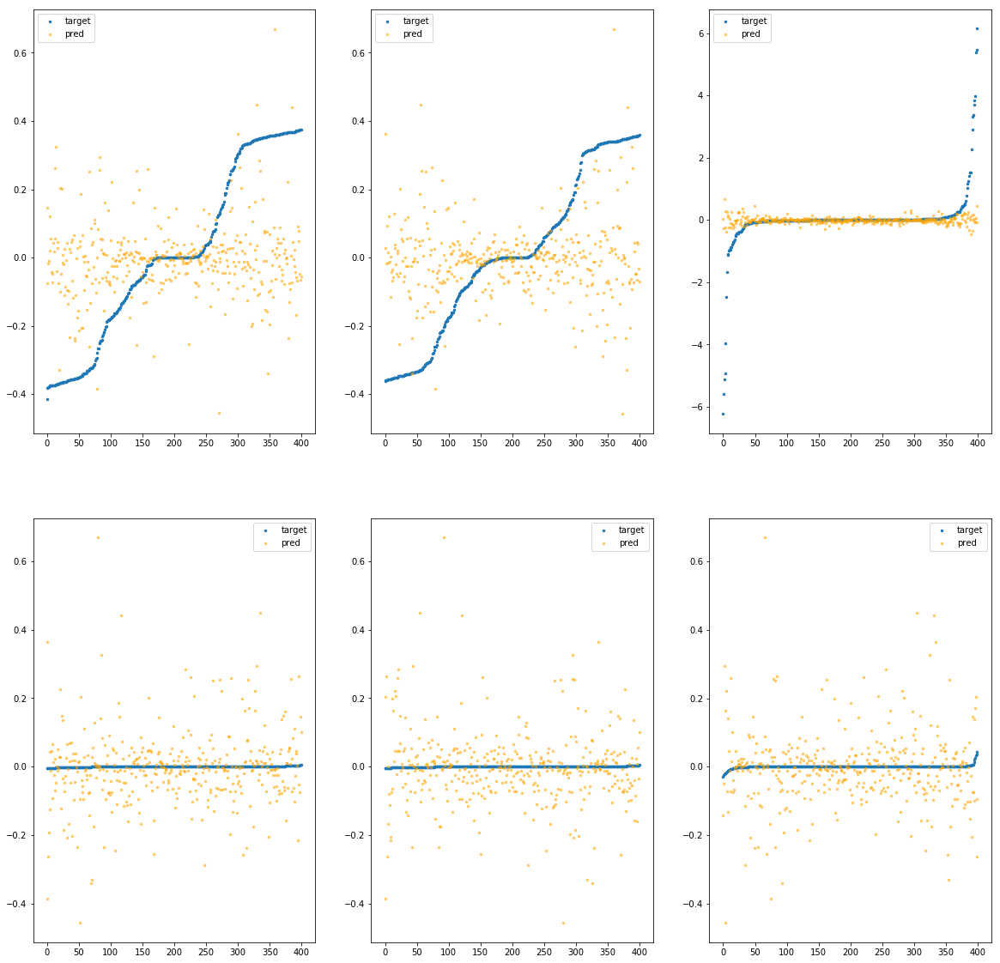

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa99bfe1070>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.49e-03	4.18e-01	2.07e-01	1.44e+03	6.47e-02	4.19e-03
y		-4.20e-03	3.92e-01	1.88e-01	2.12e+02	5.51e-02	3.03e-03
z		9.36e-04	6.23e+00	2.79e-01	1.01e+02	8.74e-01	7.64e-01
phi		-6.93e+01	7.79e-02	7.16e-03	5.58e+05	1.31e-04	1.71e-08
theta		-1.02e+02	7.60e-02	7.09e-03	1.17e+05	1.31e-04	1.71e-08
psi		-5.56e+00	7.57e-02	7.76e-03	1.64e+05	1.61e-04	2.59e-08


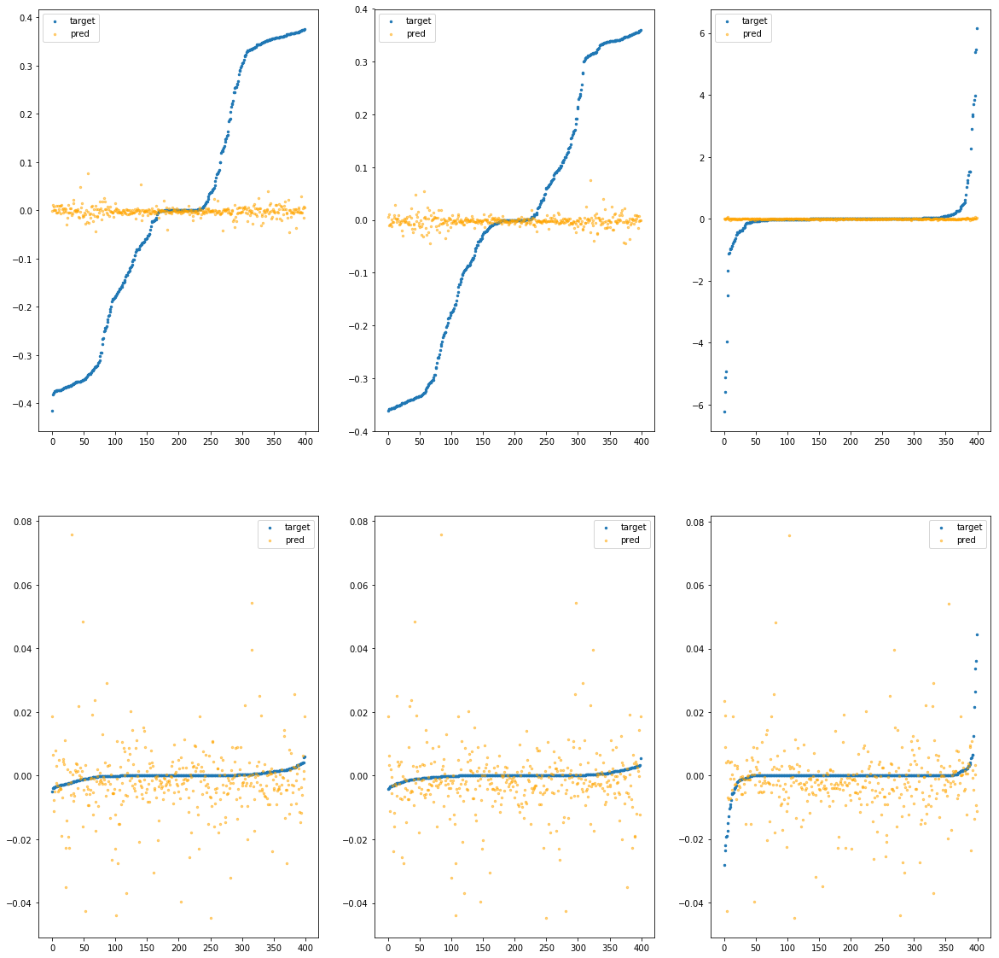

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa99bfe10d0>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.44e-03	4.36e-01	2.07e-01	1.56e+03	6.45e-02	4.16e-03
y		-6.46e-03	4.17e-01	1.89e-01	2.27e+02	5.52e-02	3.04e-03
z		1.18e-03	6.19e+00	2.82e-01	1.39e+02	8.74e-01	7.64e-01
phi		-1.84e+02	7.62e-02	1.28e-02	6.19e+05	3.45e-04	1.19e-07
theta		-2.71e+02	7.62e-02	1.28e-02	2.26e+05	3.45e-04	1.19e-07
psi		-1.33e+01	7.60e-02	1.29e-02	2.69e+05	3.52e-04	1.24e-07


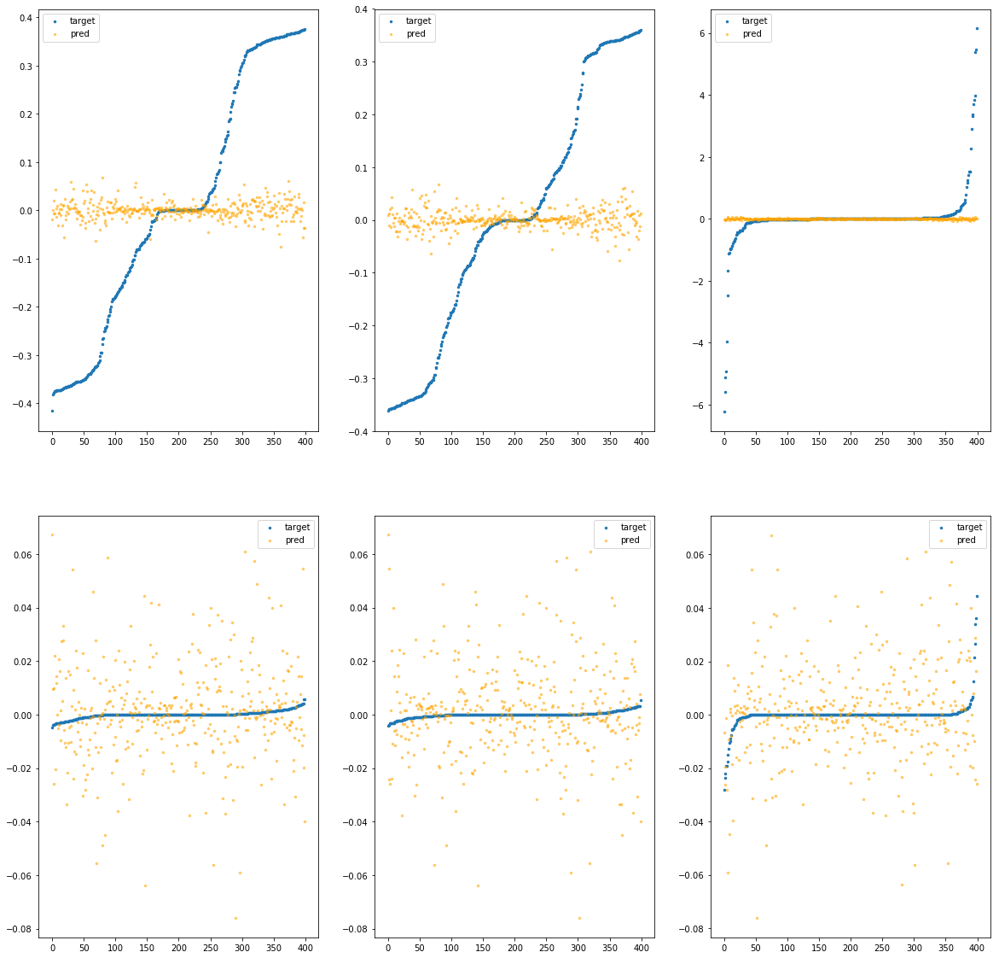

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa99bfe1130>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.00e-02	5.70e-01	2.10e-01	2.85e+03	6.73e-02	4.53e-03
y		-5.88e-02	5.51e-01	1.93e-01	9.27e+02	5.80e-02	3.37e-03
z		1.00e-02	6.17e+00	2.86e-01	3.41e+02	8.66e-01	7.50e-01
phi		-1.25e+03	2.27e-01	3.26e-02	1.10e+06	2.33e-03	5.41e-06
theta		-1.83e+03	2.27e-01	3.26e-02	8.18e+05	2.33e-03	5.42e-06
psi		-9.20e+01	2.24e-01	3.25e-02	6.05e+05	2.28e-03	5.21e-06


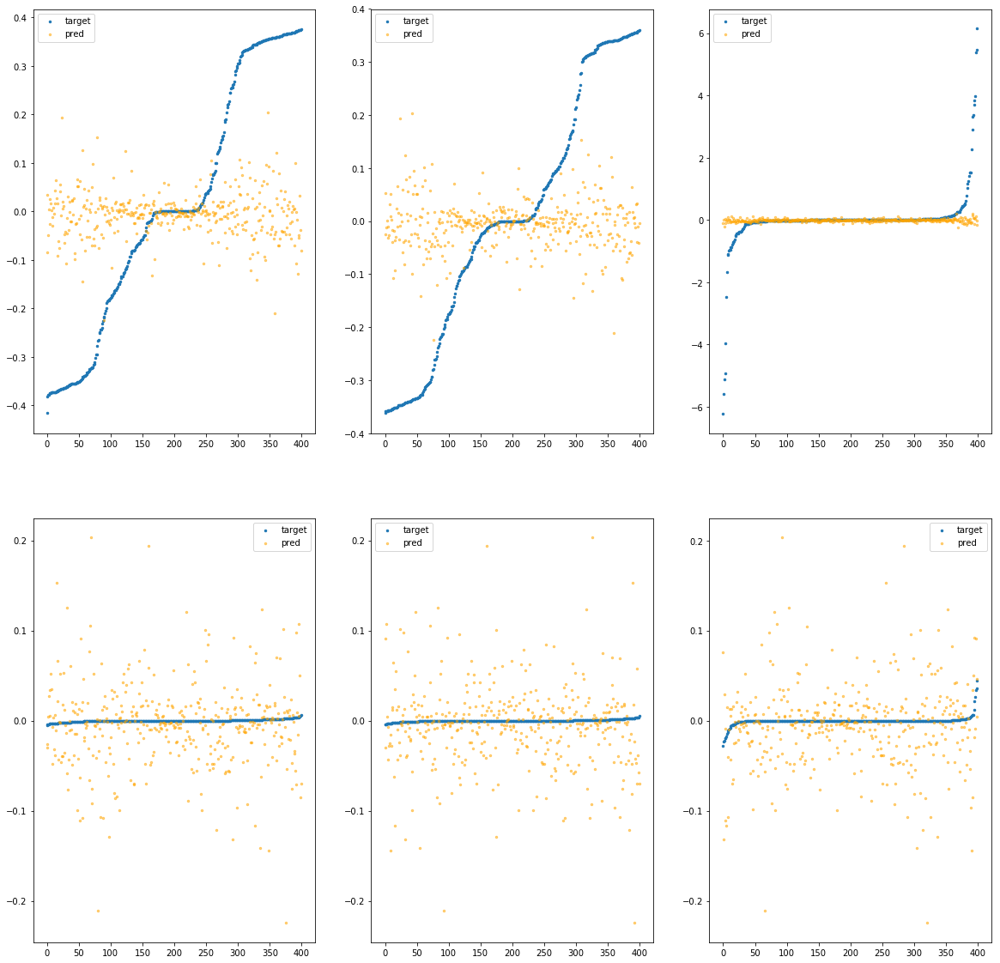

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa99bfe1190>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.81e-02	6.29e-01	2.13e-01	3.27e+03	7.04e-02	4.96e-03
y		-1.37e-01	6.03e-01	1.98e-01	2.75e+02	6.24e-02	3.89e-03
z		-2.99e-02	6.43e+00	2.99e-01	3.50e+02	9.01e-01	8.12e-01
phi		-2.11e+03	2.87e-01	4.13e-02	1.49e+06	3.93e-03	1.54e-05
theta		-3.08e+03	2.87e-01	4.12e-02	3.24e+05	3.92e-03	1.53e-05
psi		-1.57e+02	2.87e-01	4.10e-02	5.42e+05	3.87e-03	1.50e-05


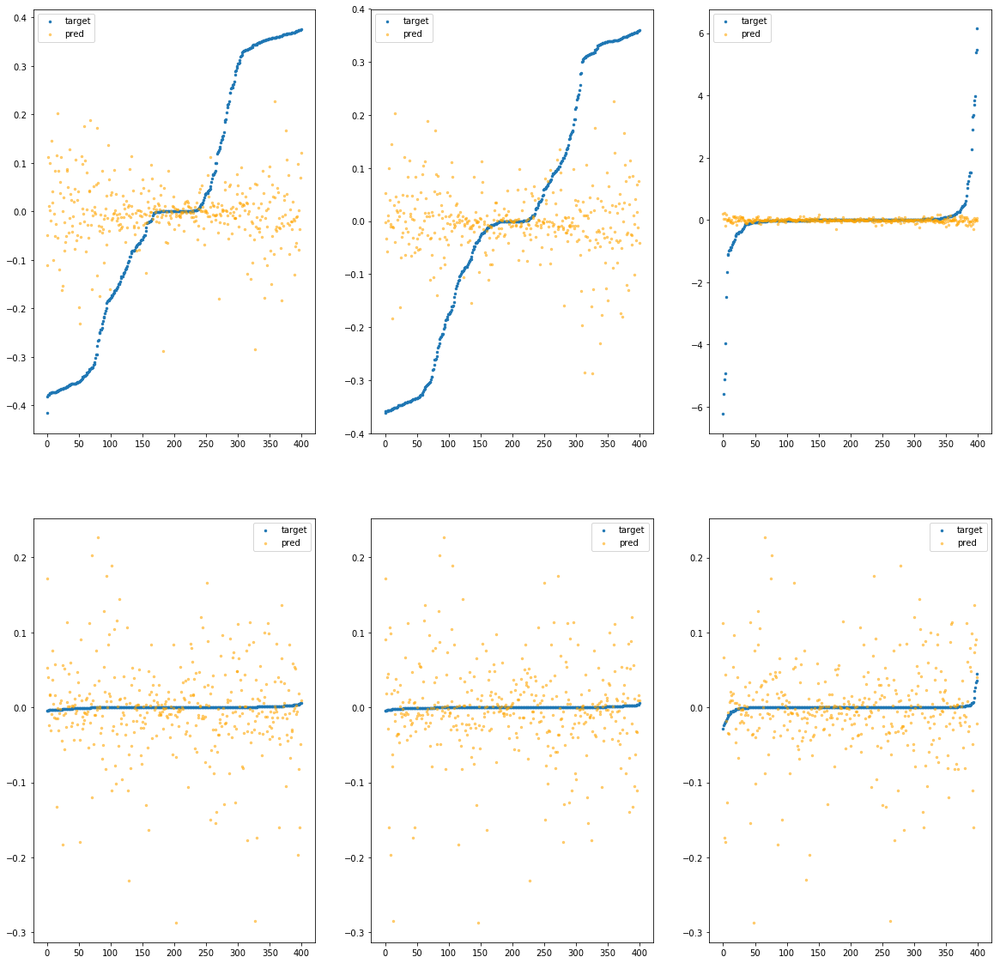

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa99bfe11f0>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.60e-01	7.06e-01	2.17e-01	2.73e+03	7.44e-02	5.54e-03
y		-1.99e-01	6.95e-01	1.99e-01	1.32e+03	6.58e-02	4.32e-03
z		-1.91e-02	6.56e+00	3.03e-01	7.65e+02	8.92e-01	7.95e-01
phi		-5.12e+03	4.19e-01	6.50e-02	1.23e+06	9.53e-03	9.08e-05
theta		-7.51e+03	4.20e-01	6.50e-02	9.65e+05	9.53e-03	9.09e-05
psi		-3.93e+02	4.67e-01	6.49e-02	9.80e+05	9.67e-03	9.35e-05


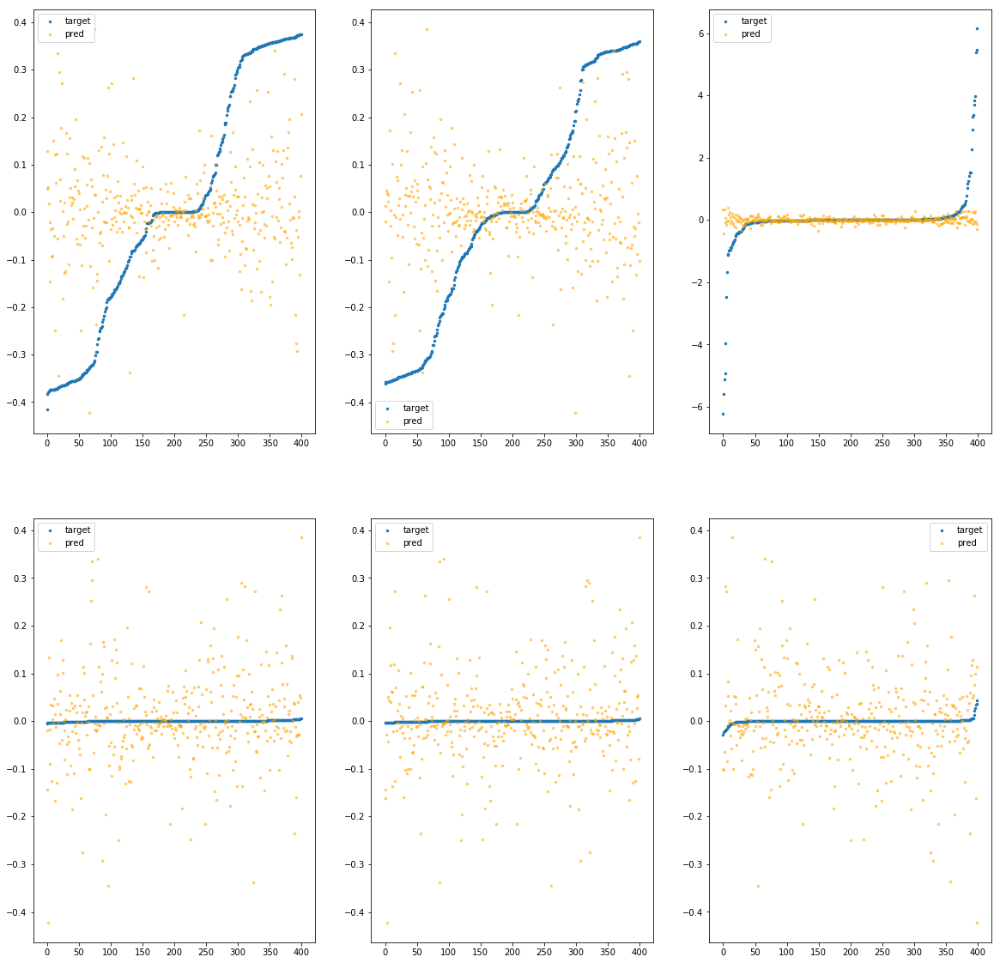

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa99bfe1250>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.73e-03	4.14e-01	2.06e-01	5.54e+02	6.43e-02	4.13e-03
y		-1.57e-03	3.67e-01	1.88e-01	9.24e+01	5.49e-02	3.01e-03
z		-1.45e-03	6.22e+00	2.78e-01	5.05e+01	8.76e-01	7.68e-01
phi		-2.65e+01	4.83e-02	4.51e-03	2.27e+05	5.11e-05	2.61e-09
theta		-3.78e+01	5.07e-02	4.41e-03	7.44e+04	4.92e-05	2.42e-09
psi		-2.01e+00	5.59e-02	5.05e-03	7.88e+04	7.38e-05	5.44e-09


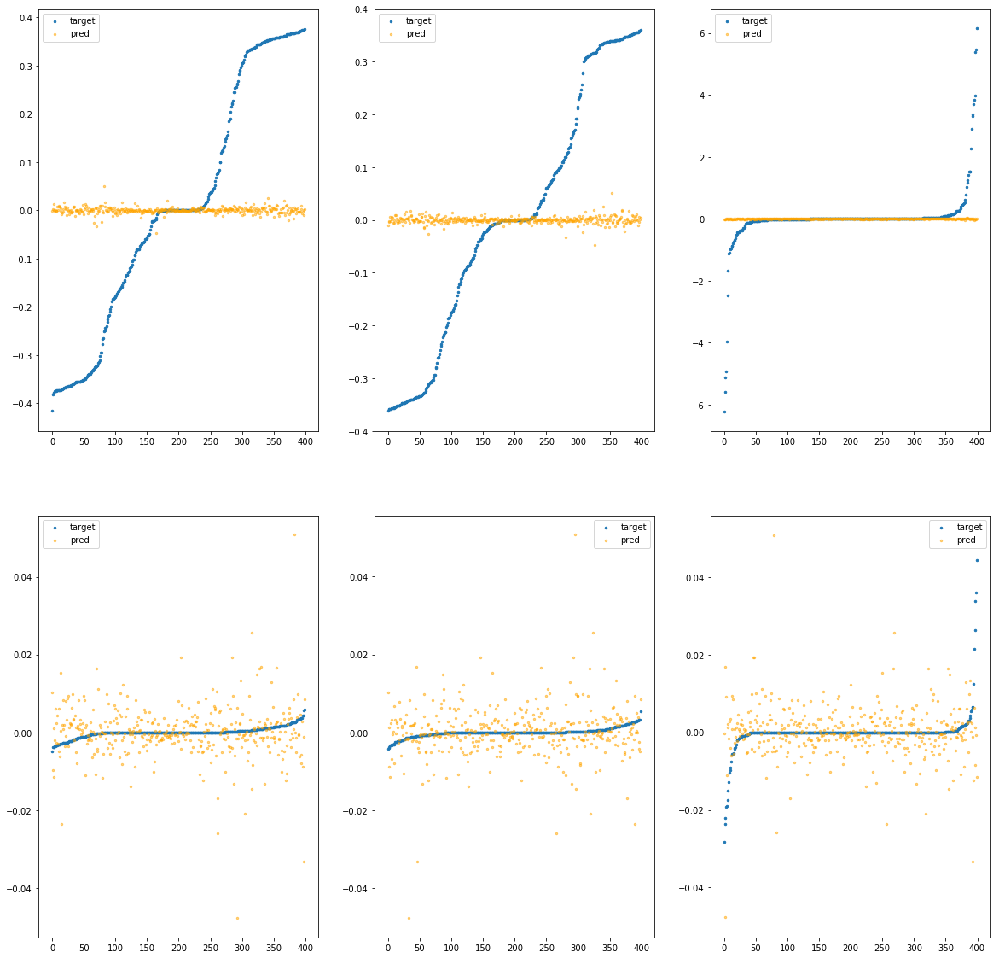

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa99bfe12b0>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.50e-03	4.16e-01	2.07e-01	6.90e+02	6.46e-02	4.17e-03
y		-4.99e-03	4.05e-01	1.88e-01	1.31e+02	5.51e-02	3.04e-03
z		-2.71e-03	6.25e+00	2.79e-01	1.14e+02	8.77e-01	7.70e-01
phi		-1.07e+02	1.05e-01	8.15e-03	3.19e+05	2.00e-04	4.02e-08
theta		-1.54e+02	1.02e-01	7.95e-03	8.00e+04	1.96e-04	3.86e-08
psi		-7.52e+00	9.11e-02	8.32e-03	7.89e+04	2.09e-04	4.36e-08


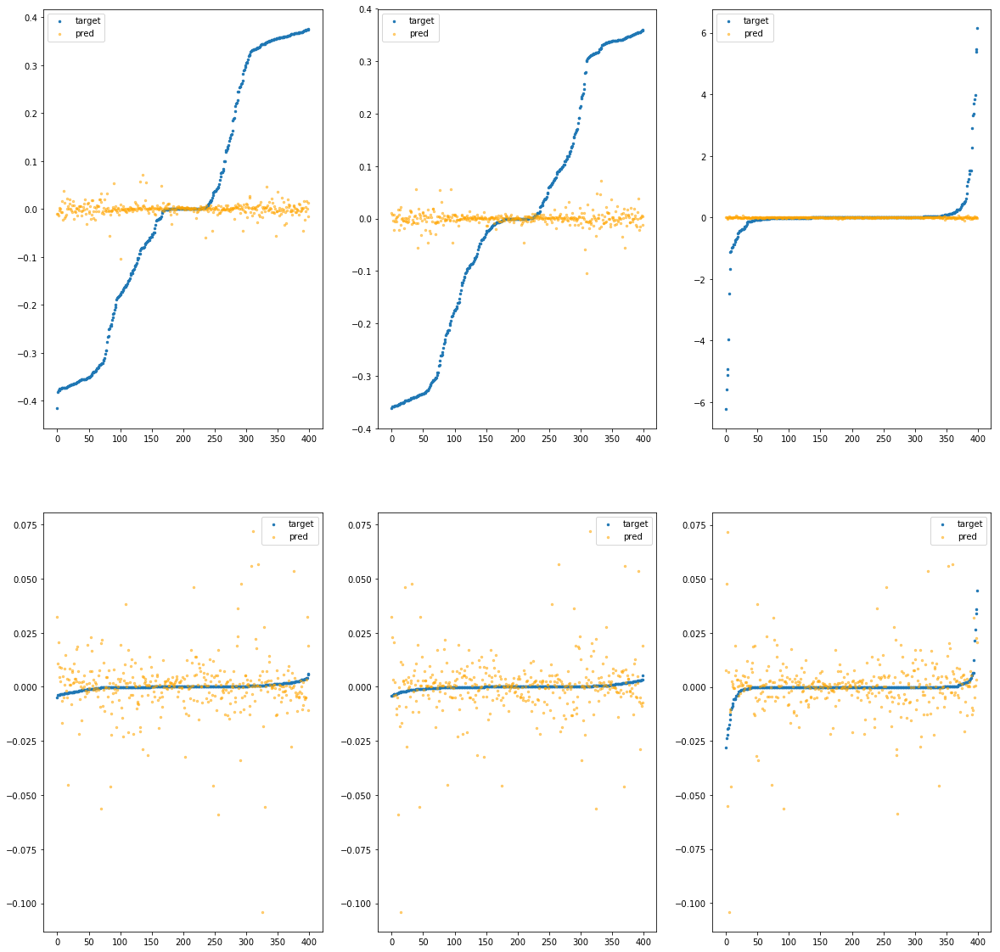

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa99bfe1310>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.91e-02	4.48e-01	2.08e-01	1.29e+03	6.53e-02	4.27e-03
y		-3.55e-03	4.15e-01	1.89e-01	2.13e+02	5.50e-02	3.03e-03
z		1.91e-03	6.17e+00	2.80e-01	1.28e+02	8.73e-01	7.62e-01
phi		-2.31e+02	1.06e-01	1.33e-02	6.26e+05	4.32e-04	1.87e-07
theta		-3.37e+02	1.05e-01	1.32e-02	9.90e+04	4.30e-04	1.85e-07
psi		-1.73e+01	1.08e-01	1.35e-02	1.78e+05	4.50e-04	2.02e-07


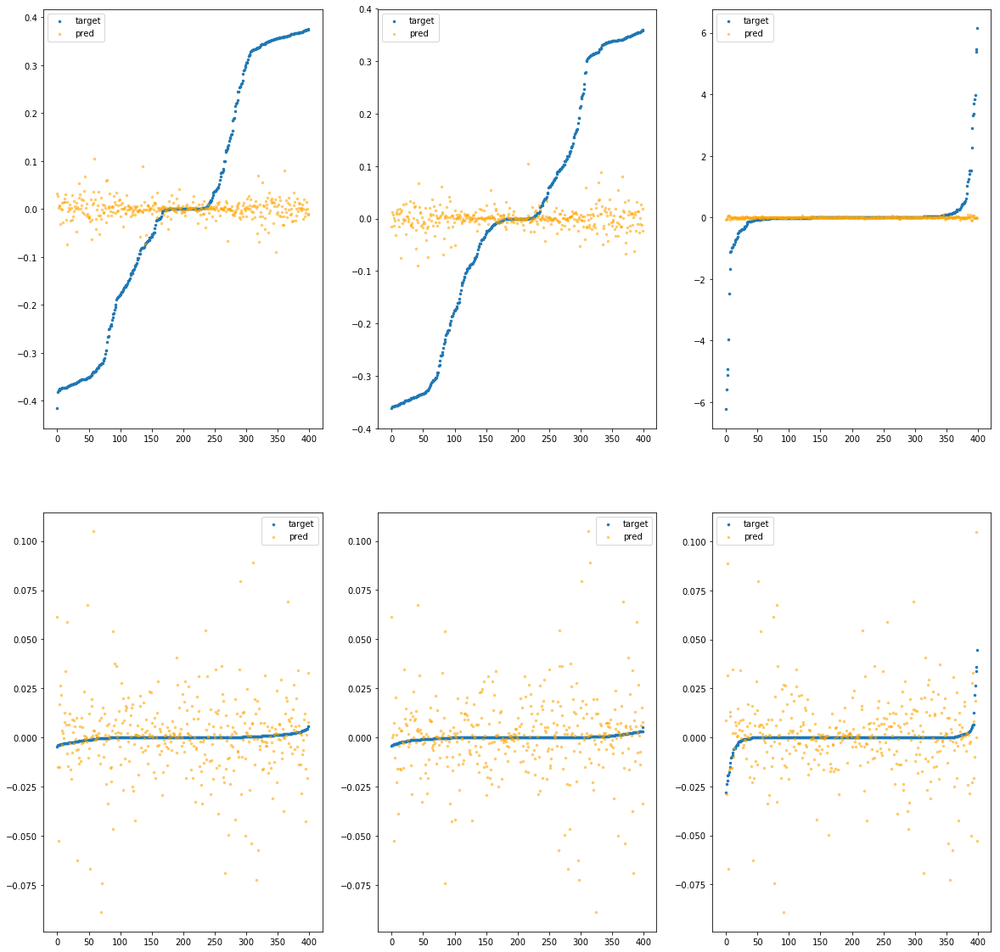

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa99bfe1370>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.89e-02	4.90e-01	2.09e-01	2.07e+03	6.53e-02	4.27e-03
y		-2.37e-02	4.71e-01	1.90e-01	3.69e+02	5.61e-02	3.15e-03
z		-2.12e-03	6.22e+00	2.87e-01	3.18e+02	8.77e-01	7.69e-01
phi		-7.89e+02	1.67e-01	2.59e-02	1.00e+06	1.47e-03	2.16e-06
theta		-1.16e+03	1.75e-01	2.58e-02	2.50e+05	1.47e-03	2.17e-06
psi		-6.05e+01	1.71e-01	2.61e-02	4.78e+05	1.51e-03	2.27e-06


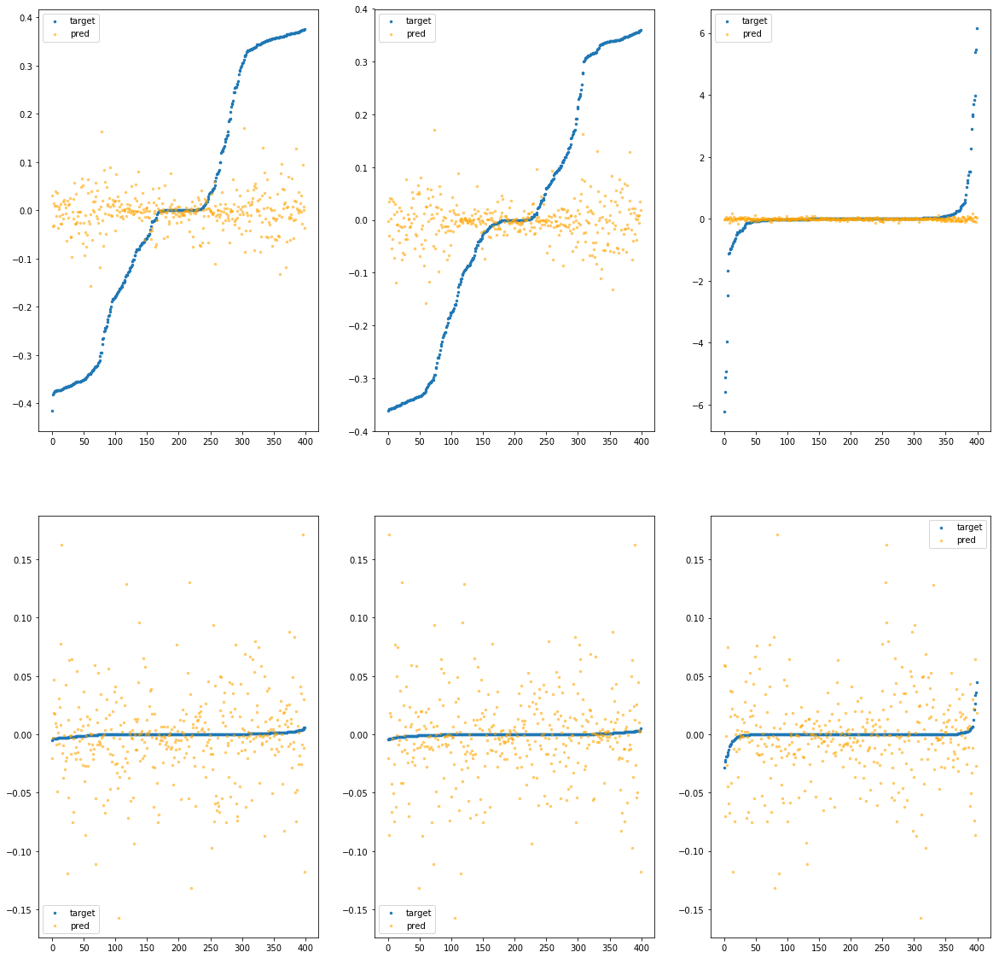

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa99bfe13d0>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.75e-02	7.38e-01	2.09e-01	3.58e+03	6.72e-02	4.51e-03
y		-3.91e-02	5.59e-01	1.91e-01	5.62e+02	5.70e-02	3.24e-03
z		-1.04e-03	6.31e+00	2.94e-01	4.40e+02	8.76e-01	7.67e-01
phi		-2.30e+03	3.83e-01	4.31e-02	1.55e+06	4.28e-03	1.83e-05
theta		-3.36e+03	3.84e-01	4.29e-02	4.94e+05	4.27e-03	1.82e-05
psi		-1.75e+02	3.84e-01	4.32e-02	4.99e+05	4.31e-03	1.85e-05


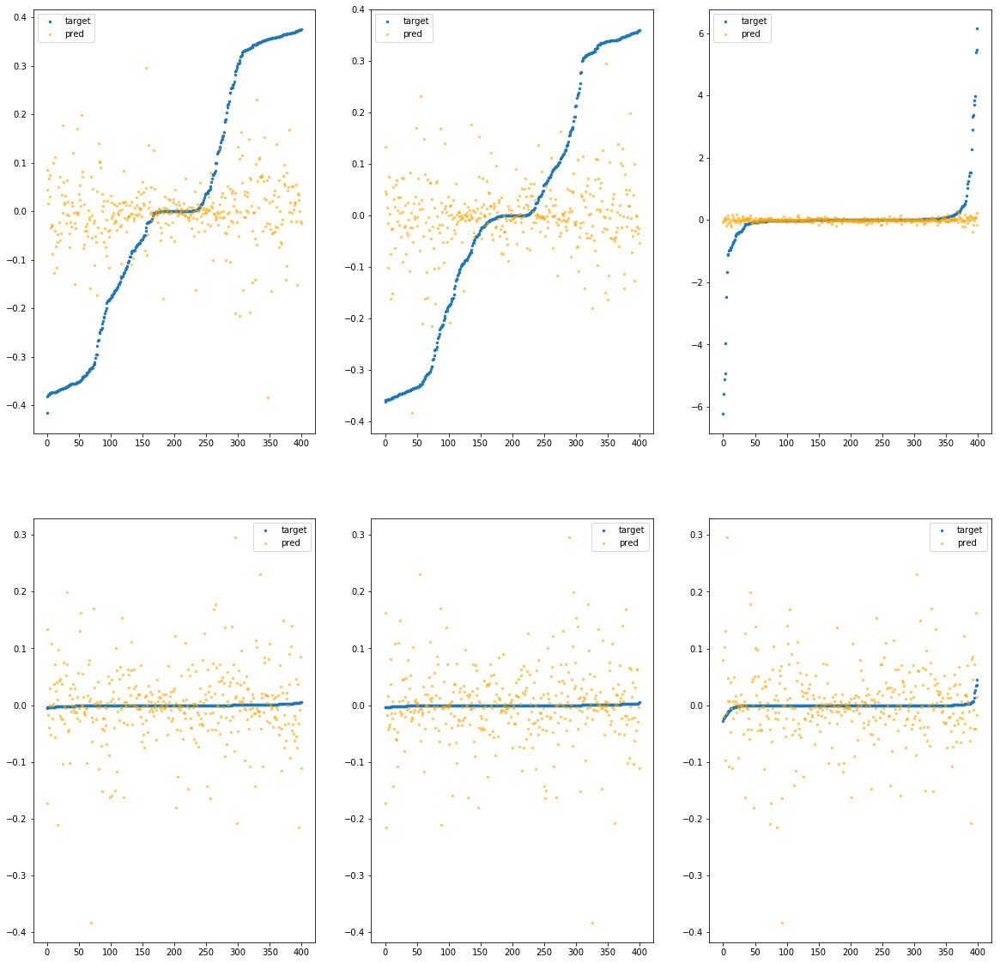

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa99bfe1430>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.39e-05	4.09e-01	2.06e-01	3.05e+02	6.41e-02	4.11e-03
y		-2.38e-03	3.76e-01	1.88e-01	3.13e+01	5.50e-02	3.02e-03
z		-1.88e-03	6.20e+00	2.78e-01	4.07e+01	8.77e-01	7.68e-01
phi		-1.39e+01	2.54e-02	3.34e-03	1.41e+05	2.77e-05	7.66e-10
theta		-1.91e+01	2.54e-02	3.19e-03	3.47e+04	2.55e-05	6.50e-10
psi		-1.13e+00	4.85e-02	3.94e-03	6.27e+04	5.22e-05	2.73e-09


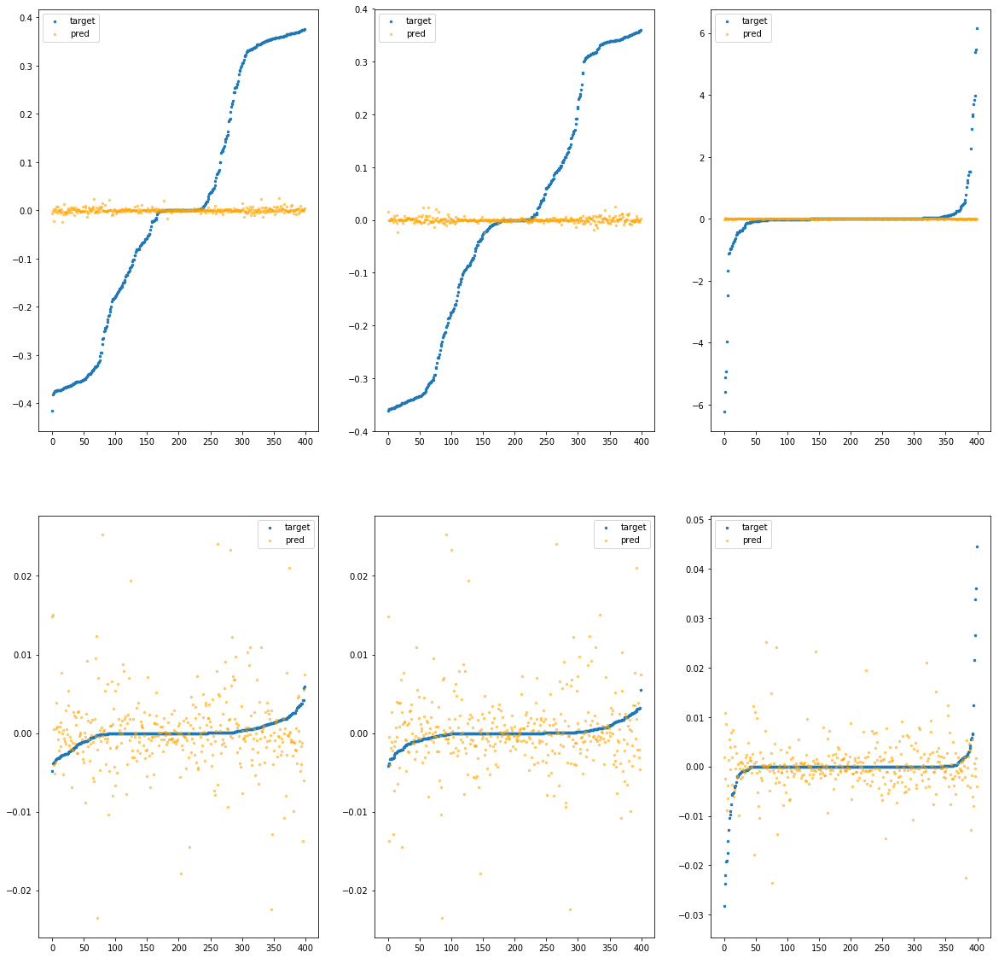

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa99bfe1490>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.53e-03	4.13e-01	2.06e-01	4.55e+02	6.44e-02	4.15e-03
y		-5.42e-03	3.76e-01	1.88e-01	6.94e+01	5.51e-02	3.04e-03
z		-2.34e-03	6.23e+00	2.78e-01	4.12e+01	8.77e-01	7.69e-01
phi		-2.11e+01	6.27e-02	3.69e-03	1.68e+05	4.11e-05	1.69e-09
theta		-3.09e+01	6.21e-02	3.64e-03	7.25e+04	4.05e-05	1.64e-09
psi		-1.76e+00	6.63e-02	4.21e-03	6.15e+04	6.78e-05	4.60e-09


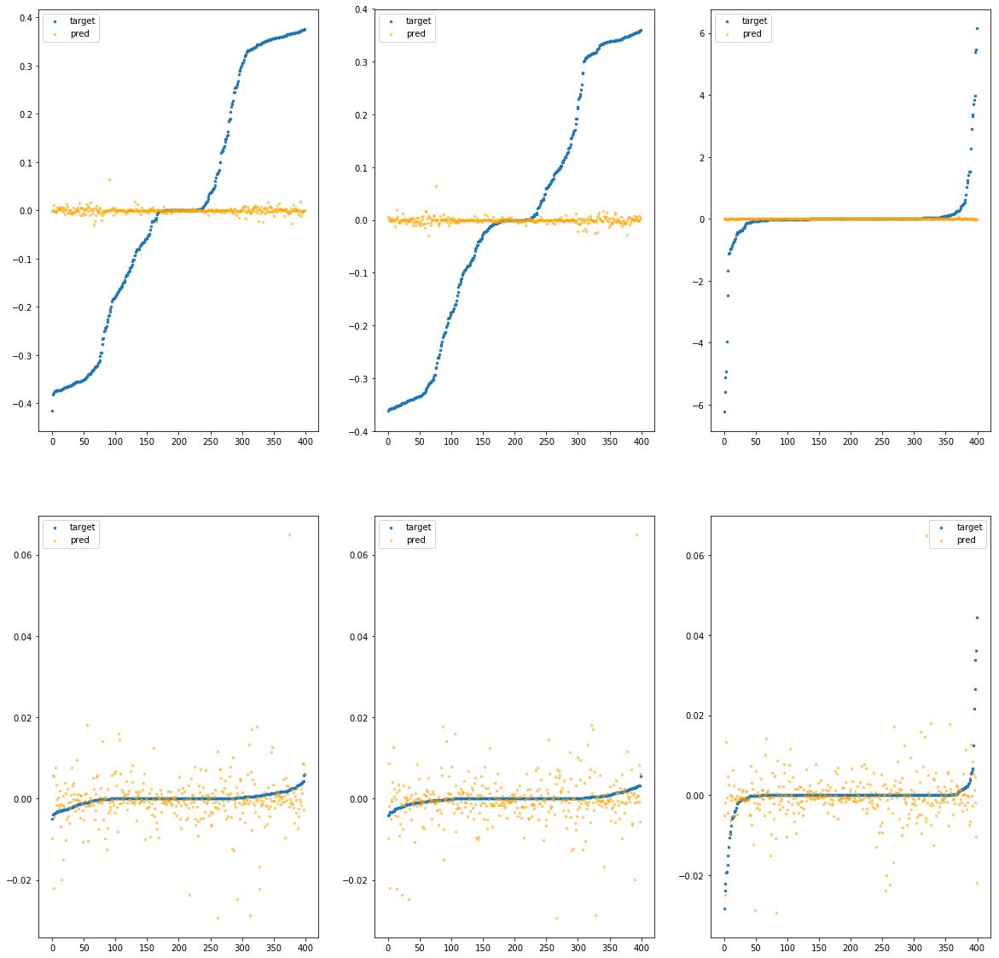

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa99bfe14f0>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		4.38e-03	4.21e-01	2.05e-01	5.42e+02	6.38e-02	4.07e-03
y		-5.65e-03	3.97e-01	1.88e-01	5.92e+01	5.51e-02	3.04e-03
z		-1.75e-04	6.24e+00	2.79e-01	5.30e+01	8.75e-01	7.66e-01
phi		-6.24e+01	6.92e-02	6.79e-03	2.25e+05	1.18e-04	1.39e-08
theta		-9.21e+01	6.92e-02	6.80e-03	8.82e+04	1.18e-04	1.40e-08
psi		-4.37e+00	6.97e-02	7.08e-03	1.71e+05	1.32e-04	1.73e-08


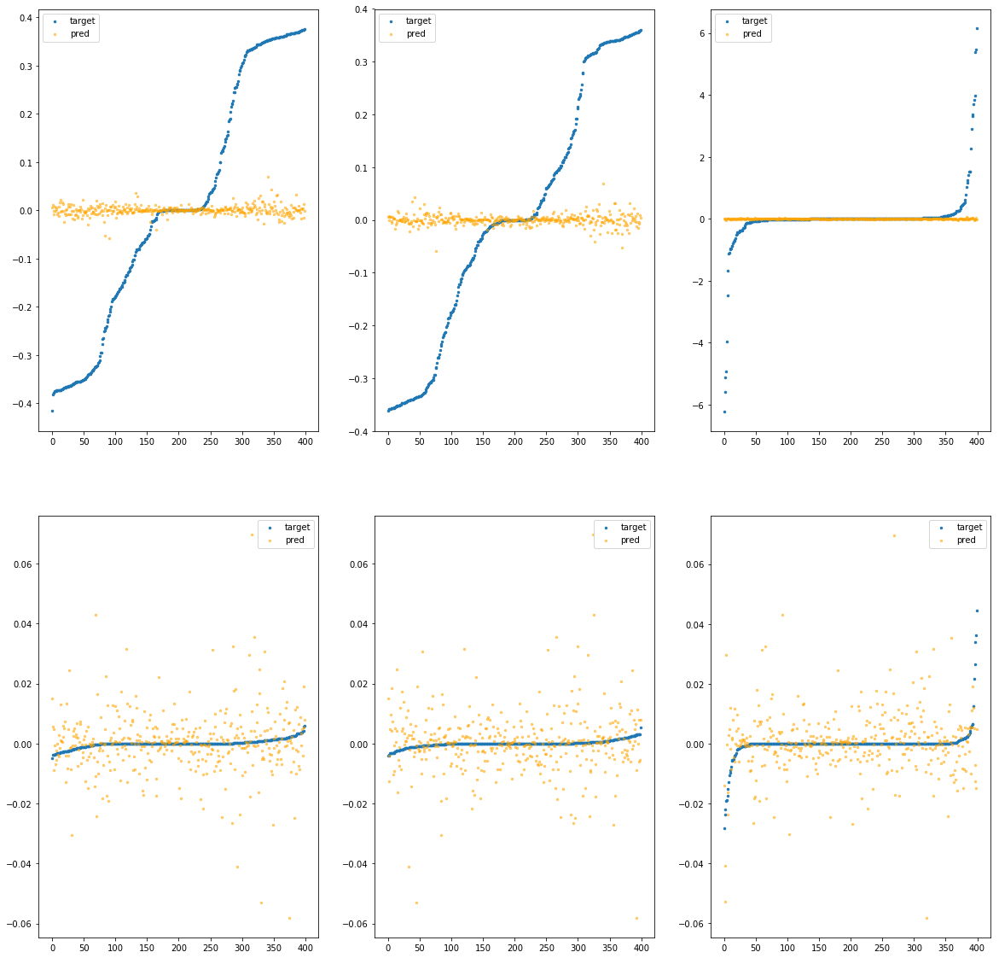

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa99bfe1550>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.58e-02	4.45e-01	2.07e-01	2.31e+03	6.51e-02	4.24e-03
y		-2.48e-03	4.23e-01	1.88e-01	4.95e+02	5.50e-02	3.02e-03
z		1.66e-03	6.25e+00	2.81e-01	2.35e+02	8.73e-01	7.63e-01
phi		-2.58e+02	7.60e-02	1.53e-02	8.10e+05	4.82e-04	2.33e-07
theta		-3.84e+02	7.72e-02	1.54e-02	4.17e+05	4.90e-04	2.40e-07
psi		-2.05e+01	1.13e-01	1.56e-02	3.58e+05	5.27e-04	2.78e-07


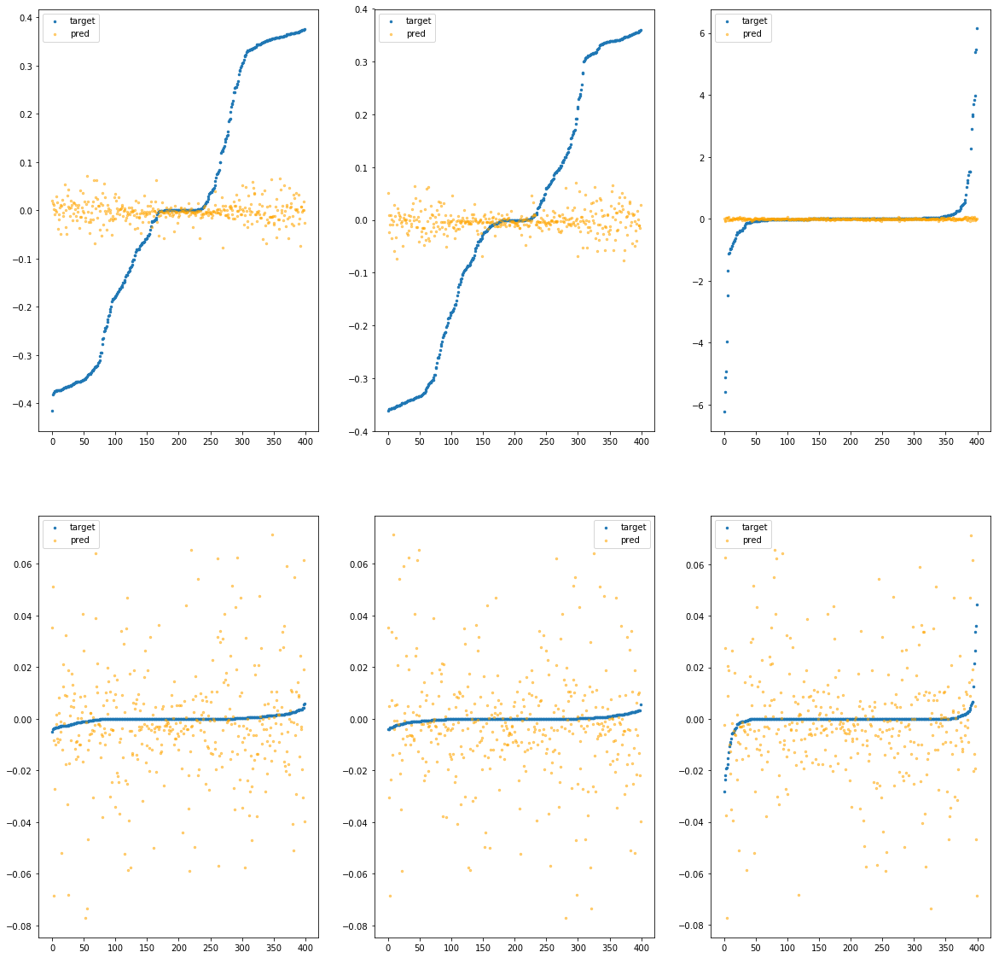

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa99bfe15b0>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.76e-02	5.32e-01	2.07e-01	8.94e+02	6.52e-02	4.26e-03
y		-4.36e-02	5.15e-01	1.92e-01	1.28e+02	5.72e-02	3.27e-03
z		-5.43e-03	6.29e+00	2.85e-01	2.10e+02	8.80e-01	7.74e-01
phi		-6.19e+02	1.98e-01	2.13e-02	4.17e+05	1.15e-03	1.33e-06
theta		-9.04e+02	1.98e-01	2.14e-02	1.12e+05	1.15e-03	1.32e-06
psi		-4.74e+01	1.96e-01	2.17e-02	3.18e+05	1.19e-03	1.41e-06


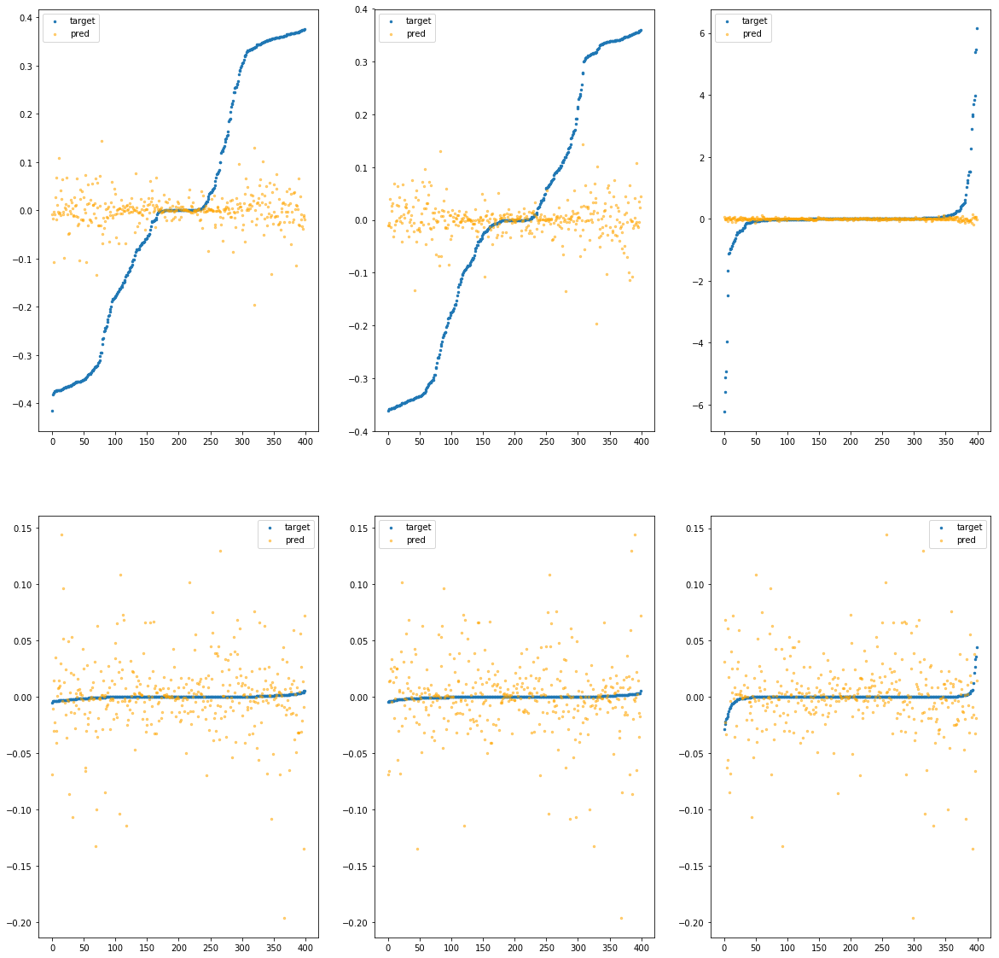

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa99bfe1610>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.40e-02	4.35e-01	2.09e-01	3.24e+03	6.57e-02	4.31e-03
y		-5.49e-03	4.33e-01	1.89e-01	7.82e+02	5.51e-02	3.04e-03
z		-2.74e-03	6.21e+00	2.82e-01	6.81e+02	8.77e-01	7.70e-01
phi		-3.00e+02	1.37e-01	1.47e-02	1.37e+06	5.60e-04	3.13e-07
theta		-4.46e+02	1.39e-01	1.48e-02	6.78e+05	5.67e-04	3.22e-07
psi		-2.28e+01	1.39e-01	1.50e-02	1.93e+05	5.83e-04	3.40e-07


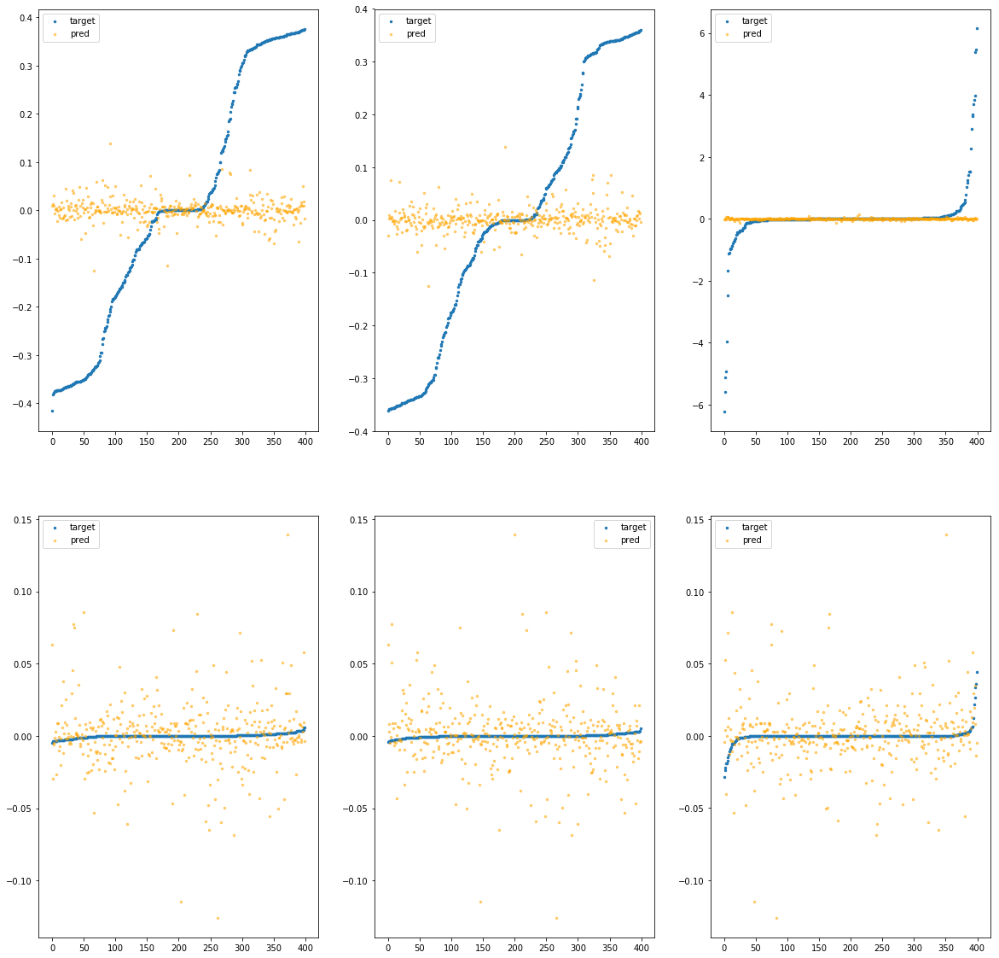

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa99bfe1670>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.65e-02	5.00e-01	2.08e-01	5.04e+03	6.52e-02	4.25e-03
y		-1.24e-02	4.51e-01	1.91e-01	7.36e+02	5.55e-02	3.08e-03
z		5.85e-03	6.23e+00	2.86e-01	3.96e+02	8.70e-01	7.56e-01
phi		-5.28e+02	1.29e-01	2.18e-02	2.51e+06	9.85e-04	9.71e-07
theta		-7.76e+02	1.28e-01	2.17e-02	3.57e+05	9.87e-04	9.74e-07
psi		-4.11e+01	1.28e-01	2.23e-02	4.25e+05	1.03e-03	1.06e-06


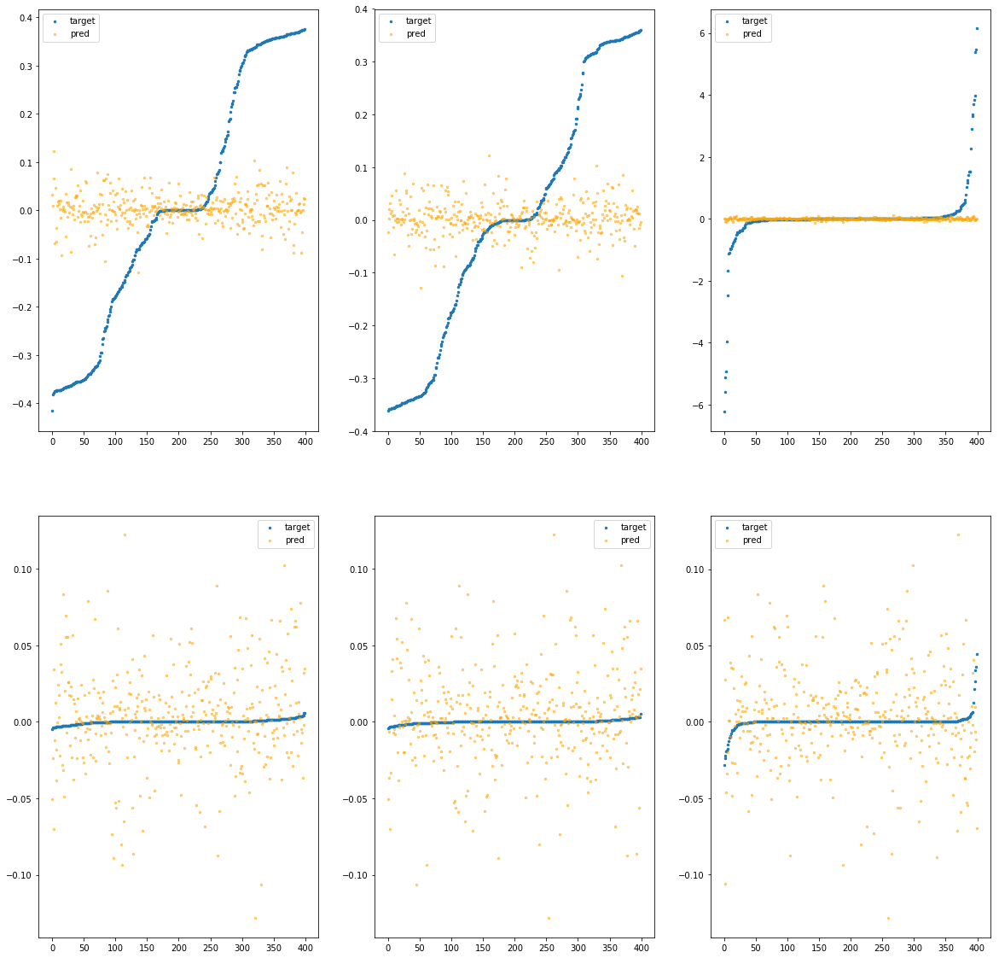

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa99bfe16d0>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.06e-02	5.03e-01	2.08e-01	4.88e+03	6.48e-02	4.20e-03
y		-5.09e-02	5.64e-01	1.93e-01	7.60e+02	5.76e-02	3.32e-03
z		6.18e-03	6.24e+00	2.91e-01	5.41e+02	8.69e-01	7.56e-01
phi		-1.21e+03	2.28e-01	3.44e-02	2.81e+06	2.25e-03	5.05e-06
theta		-1.78e+03	2.25e-01	3.44e-02	1.02e+06	2.26e-03	5.09e-06
psi		-9.15e+01	2.25e-01	3.45e-02	9.92e+05	2.27e-03	5.15e-06


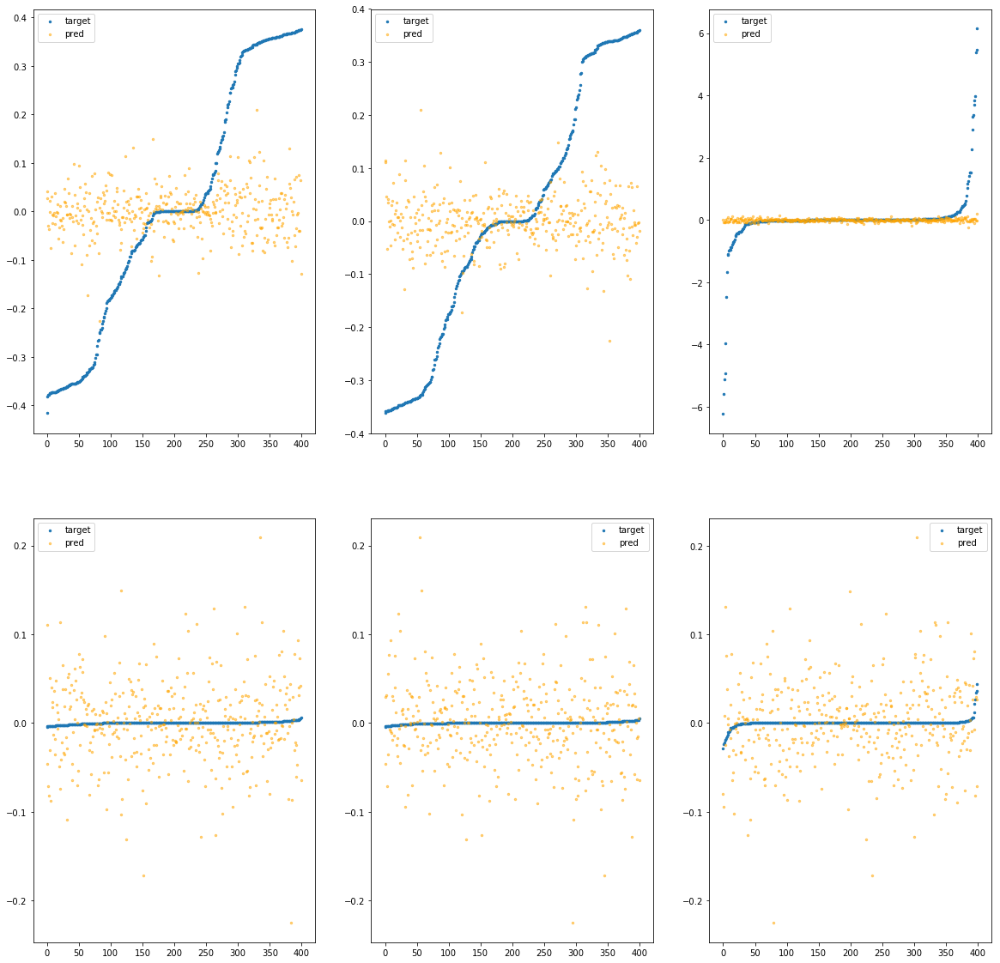

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa99bfe1730>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.07e-02	5.16e-01	2.08e-01	3.08e+03	6.48e-02	4.20e-03
y		-6.68e-02	4.97e-01	1.95e-01	4.27e+02	5.85e-02	3.42e-03
z		-2.90e-03	6.18e+00	2.94e-01	5.68e+02	8.77e-01	7.70e-01
phi		-1.20e+03	1.90e-01	3.46e-02	1.37e+06	2.23e-03	4.96e-06
theta		-1.76e+03	1.88e-01	3.47e-02	4.34e+05	2.23e-03	4.99e-06
psi		-9.09e+01	1.92e-01	3.47e-02	4.78e+05	2.26e-03	5.09e-06


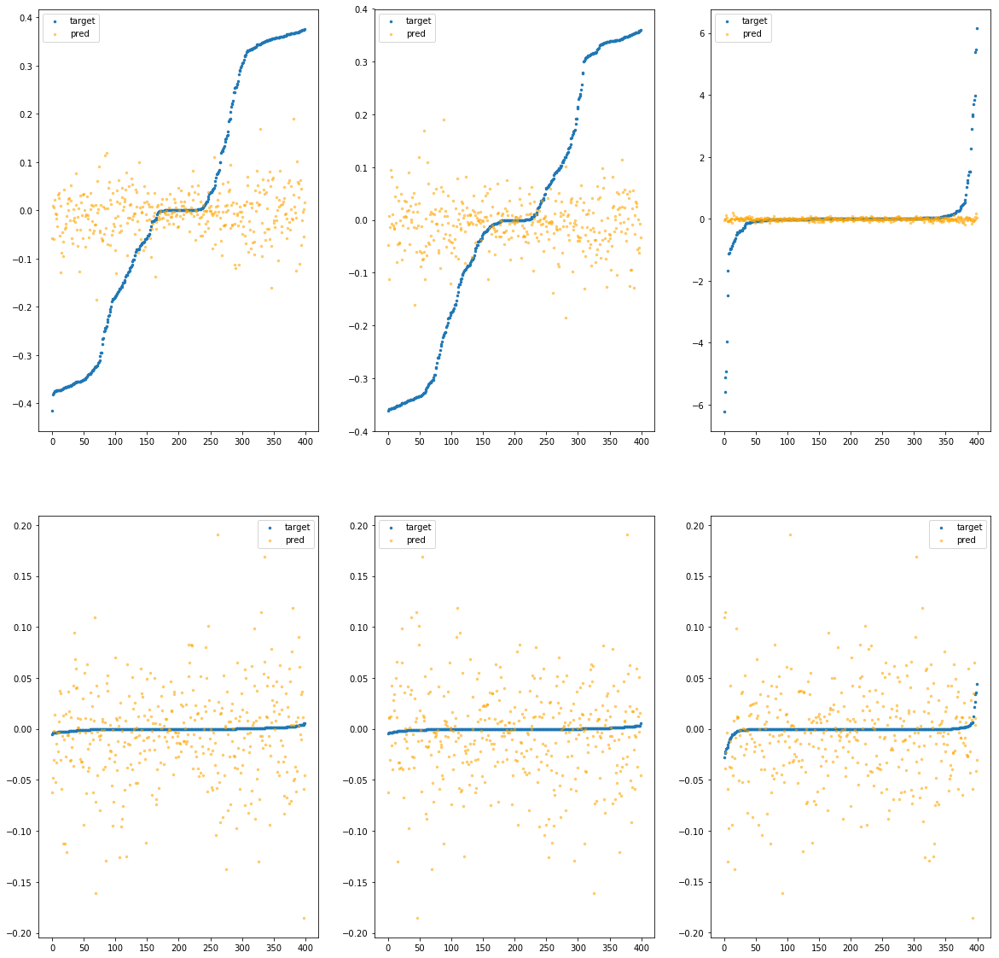

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa99bfe1790>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.67e-02	5.35e-01	2.14e-01	6.76e+03	6.84e-02	4.68e-03
y		-7.91e-02	5.02e-01	1.98e-01	1.41e+03	5.92e-02	3.50e-03
z		-8.13e-03	6.37e+00	2.97e-01	5.92e+02	8.82e-01	7.78e-01
phi		-1.70e+03	2.86e-01	4.15e-02	2.83e+06	3.17e-03	1.00e-05
theta		-2.50e+03	2.88e-01	4.14e-02	7.09e+05	3.17e-03	1.01e-05
psi		-1.28e+02	2.86e-01	4.18e-02	6.47e+05	3.18e-03	1.01e-05


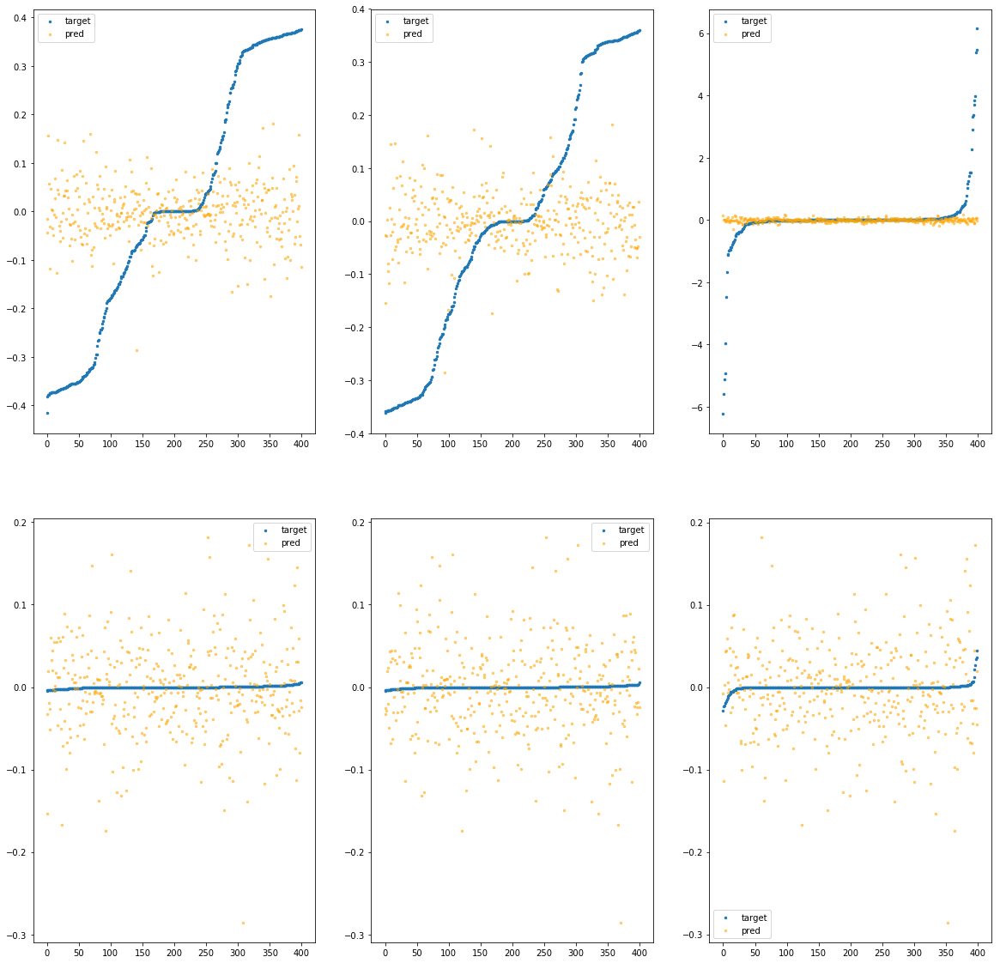

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa99bfe17f0>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.02e-02	4.44e-01	2.08e-01	4.05e+03	6.54e-02	4.28e-03
y		-1.36e-03	3.87e-01	1.89e-01	5.02e+02	5.49e-02	3.01e-03
z		-3.36e-03	6.24e+00	2.80e-01	3.20e+02	8.78e-01	7.71e-01
phi		-8.50e+01	6.94e-02	9.40e-03	1.63e+06	1.60e-04	2.56e-08
theta		-1.24e+02	7.19e-02	9.35e-03	6.48e+05	1.59e-04	2.52e-08
psi		-6.35e+00	6.94e-02	9.97e-03	2.79e+05	1.80e-04	3.25e-08


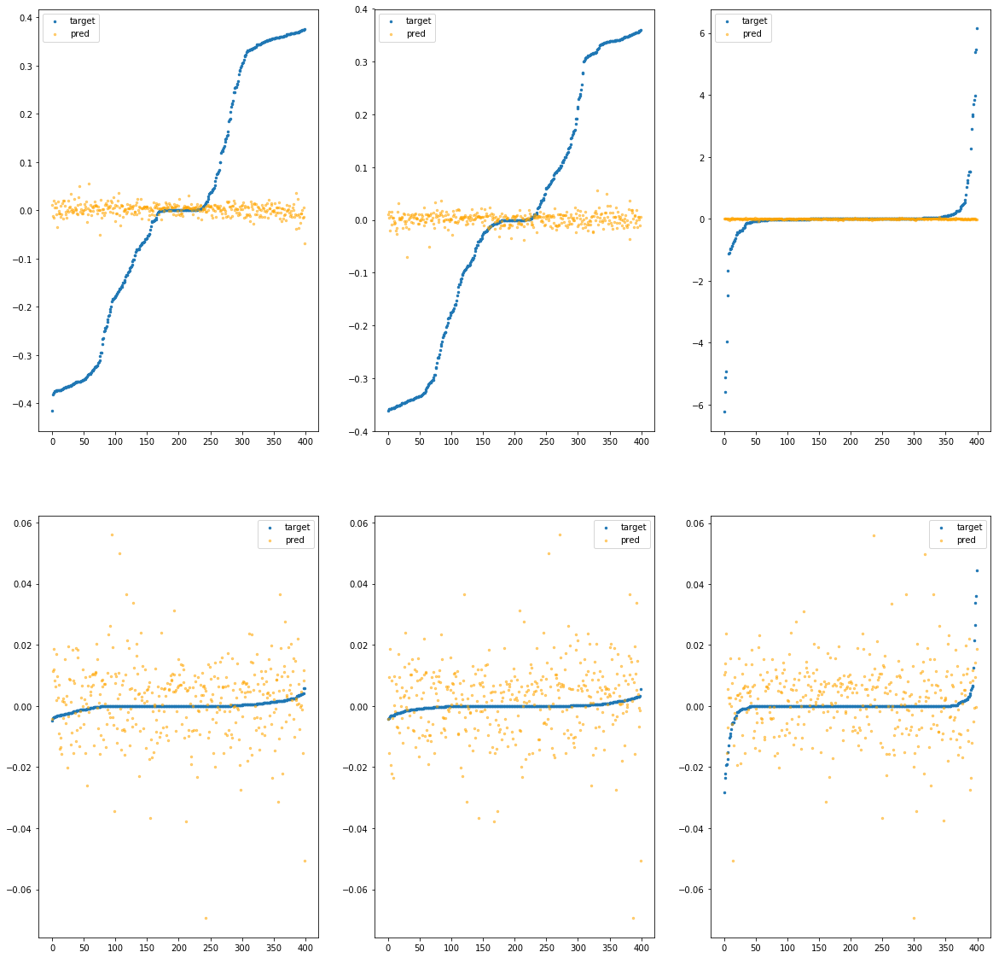

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa99bfe1850>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.99e-03	4.36e-01	2.07e-01	3.90e+03	6.44e-02	4.15e-03
y		-3.46e-02	4.51e-01	1.92e-01	4.89e+02	5.67e-02	3.22e-03
z		-1.69e-03	6.16e+00	2.85e-01	2.14e+02	8.76e-01	7.68e-01
phi		-3.69e+02	1.11e-01	1.97e-02	1.51e+06	6.89e-04	4.75e-07
theta		-5.38e+02	1.08e-01	1.95e-02	4.58e+05	6.84e-04	4.68e-07
psi		-2.81e+01	1.11e-01	2.00e-02	4.19e+05	7.15e-04	5.11e-07


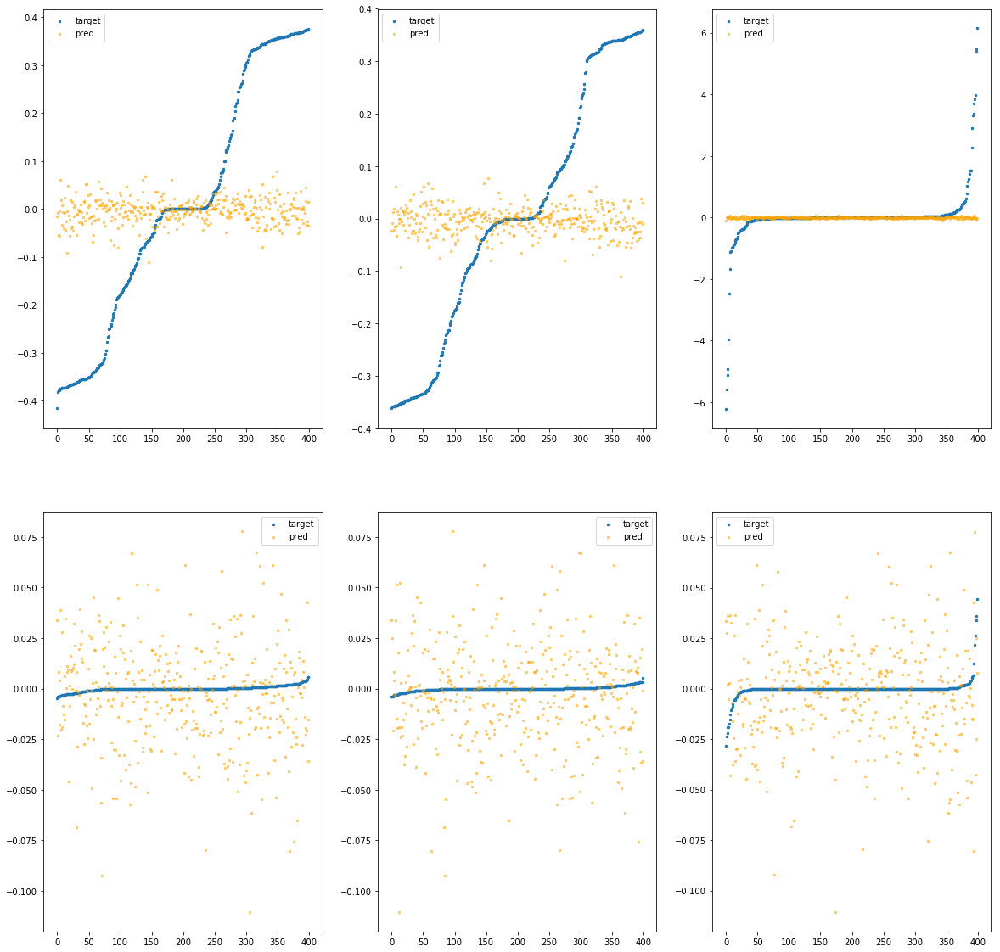

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa99bfe18b0>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.47e-02	4.57e-01	2.09e-01	5.21e+03	6.51e-02	4.23e-03
y		-2.46e-02	4.59e-01	1.90e-01	8.88e+02	5.62e-02	3.16e-03
z		1.23e-03	6.21e+00	2.84e-01	4.65e+02	8.74e-01	7.63e-01
phi		-4.83e+02	1.77e-01	1.92e-02	2.16e+06	9.02e-04	8.13e-07
theta		-7.07e+02	1.77e-01	1.91e-02	5.17e+05	8.99e-04	8.08e-07
psi		-3.42e+01	1.76e-01	1.92e-02	3.11e+05	8.63e-04	7.45e-07


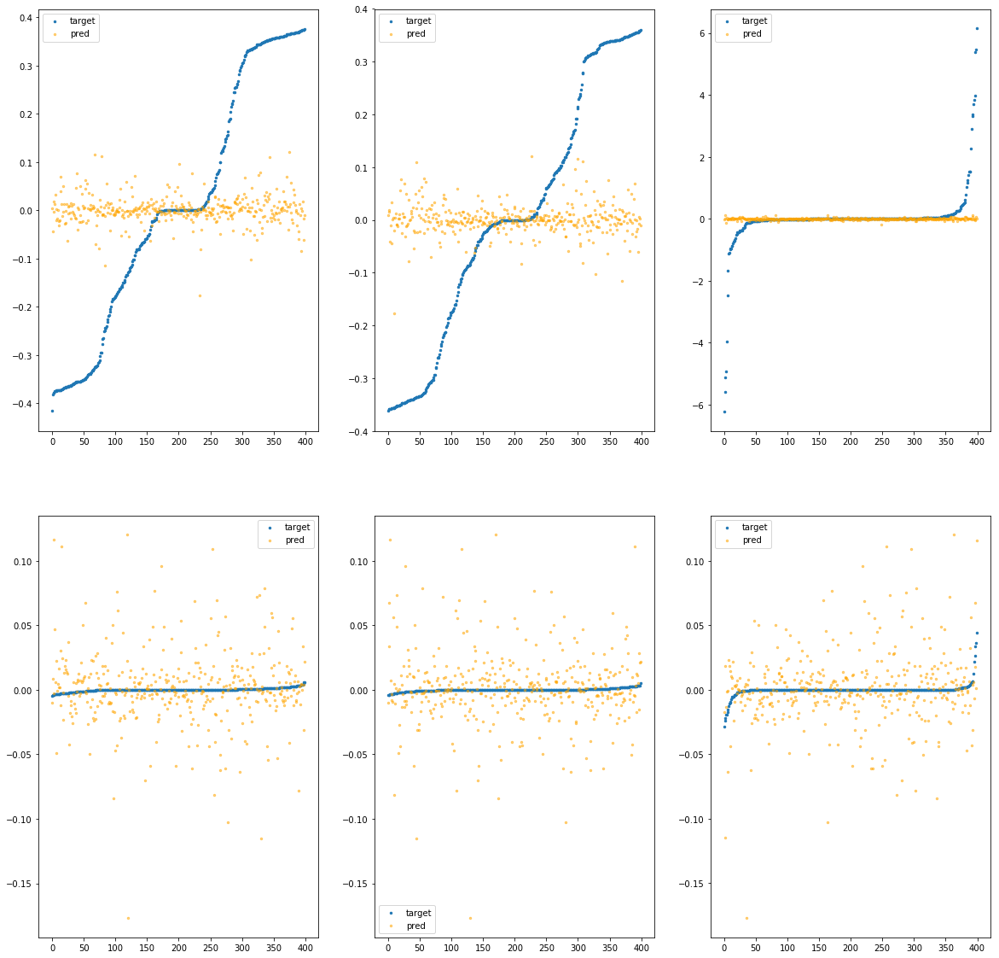

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa99bfe1910>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.68e-02	5.11e-01	2.09e-01	5.58e+03	6.58e-02	4.33e-03
y		-1.17e-02	4.75e-01	1.91e-01	5.86e+02	5.55e-02	3.08e-03
z		-6.54e-03	6.22e+00	2.91e-01	5.50e+02	8.81e-01	7.75e-01
phi		-7.18e+02	1.38e-01	2.70e-02	1.98e+06	1.34e-03	1.79e-06
theta		-1.05e+03	1.37e-01	2.70e-02	6.44e+05	1.34e-03	1.79e-06
psi		-5.49e+01	1.40e-01	2.73e-02	9.01e+05	1.37e-03	1.88e-06


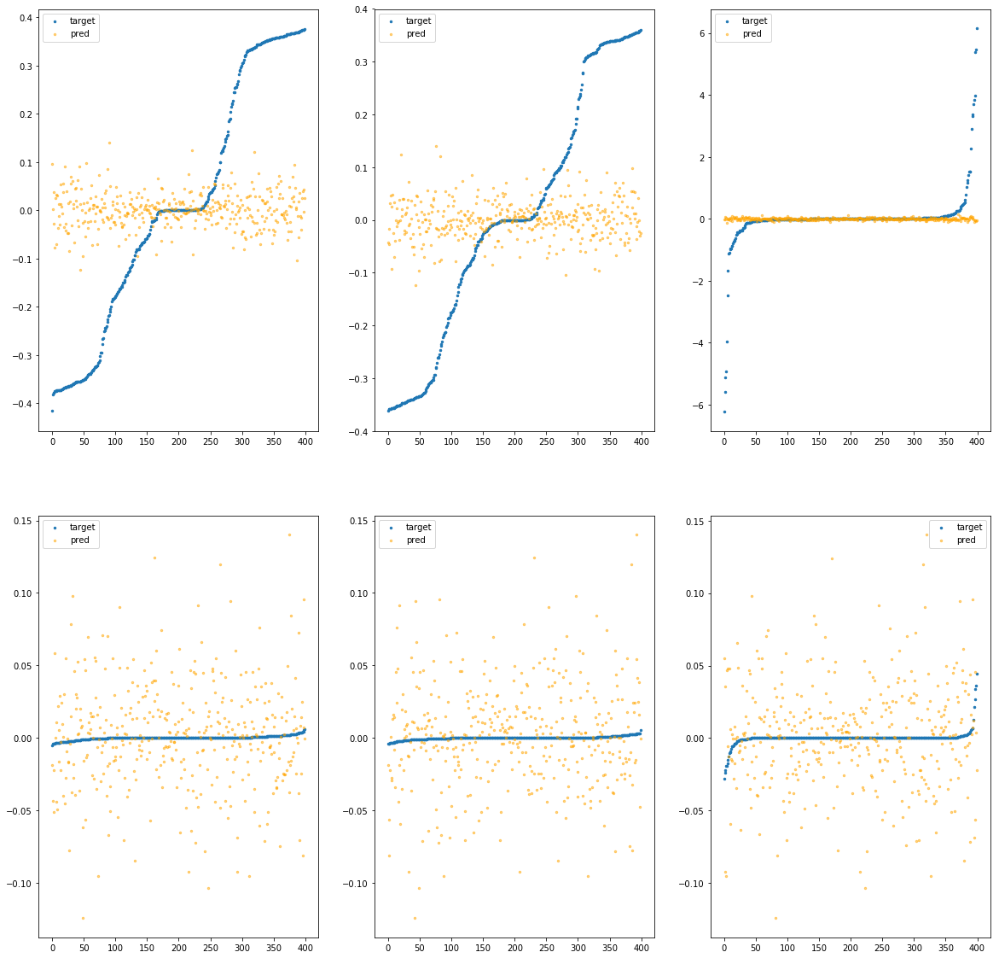

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa99bfe1970>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.45e-02	5.06e-01	2.14e-01	7.93e+03	6.82e-02	4.66e-03
y		-8.32e-02	4.97e-01	1.99e-01	2.01e+03	5.94e-02	3.53e-03
z		-1.87e-02	6.27e+00	2.98e-01	6.15e+02	8.91e-01	7.94e-01
phi		-1.63e+03	2.67e-01	3.98e-02	2.84e+06	3.03e-03	9.19e-06
theta		-2.38e+03	2.66e-01	3.97e-02	1.70e+06	3.03e-03	9.16e-06
psi		-1.24e+02	2.68e-01	4.01e-02	9.08e+05	3.06e-03	9.35e-06


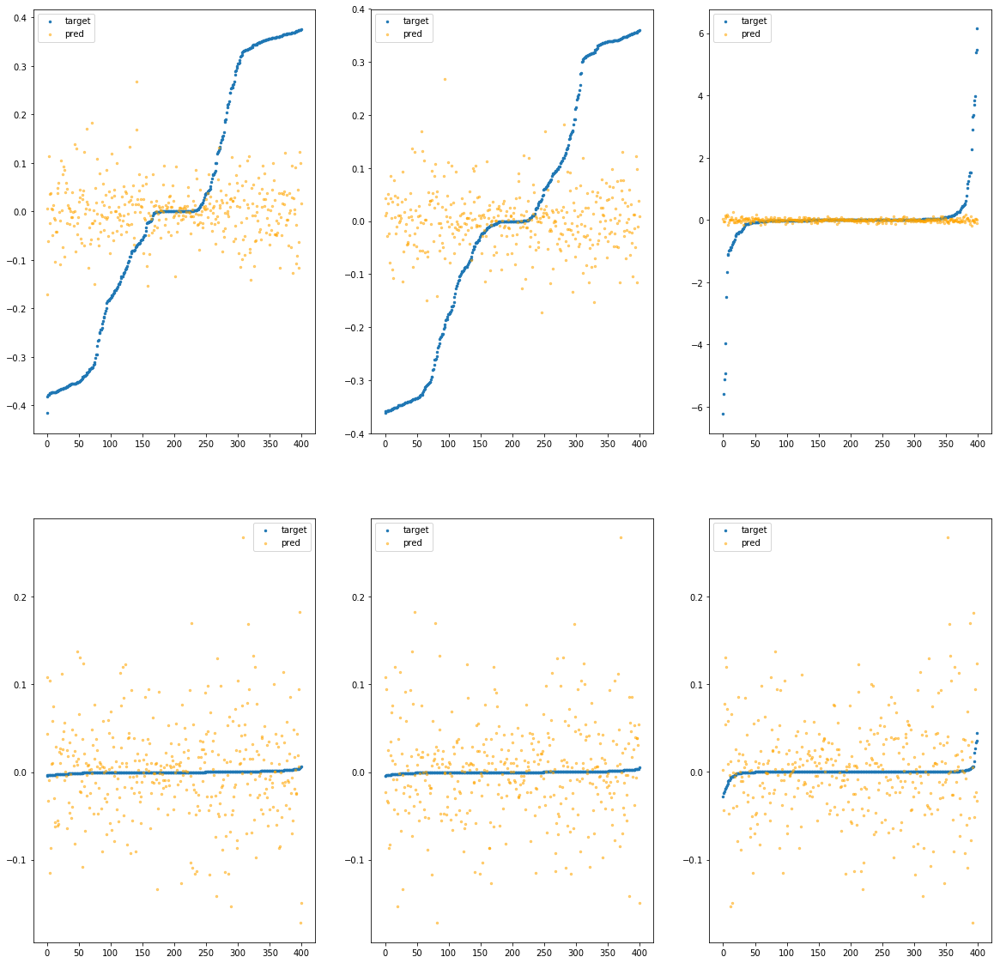

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa99bfe19d0>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.01e-03	4.20e-01	2.07e-01	4.21e+03	6.46e-02	4.18e-03
y		-8.09e-03	3.83e-01	1.90e-01	6.30e+02	5.53e-02	3.05e-03
z		-2.88e-03	6.23e+00	2.80e-01	3.02e+02	8.77e-01	7.70e-01
phi		-8.15e+01	1.35e-01	8.41e-03	1.68e+06	1.54e-04	2.36e-08
theta		-1.21e+02	1.36e-01	8.48e-03	6.34e+05	1.55e-04	2.41e-08
psi		-5.87e+00	1.36e-01	8.78e-03	2.34e+05	1.69e-04	2.84e-08


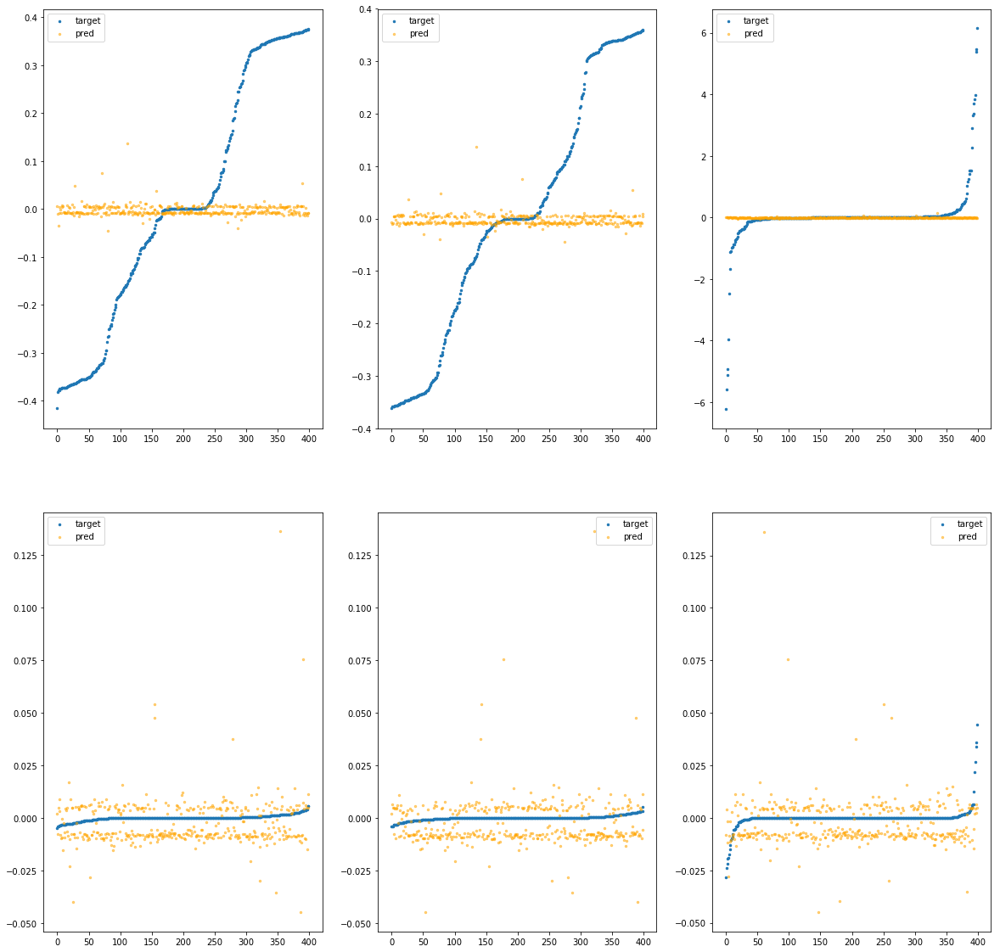

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa99bfe1a30>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.55e-02	4.37e-01	2.08e-01	3.72e+03	6.57e-02	4.32e-03
y		-7.96e-05	4.19e-01	1.89e-01	4.97e+02	5.48e-02	3.01e-03
z		6.73e-04	6.17e+00	2.81e-01	2.61e+02	8.74e-01	7.64e-01
phi		-1.41e+02	8.61e-02	1.15e-02	1.51e+06	2.65e-04	7.00e-08
theta		-2.04e+02	8.61e-02	1.14e-02	3.52e+05	2.61e-04	6.81e-08
psi		-1.11e+01	8.61e-02	1.21e-02	3.10e+05	2.97e-04	8.84e-08


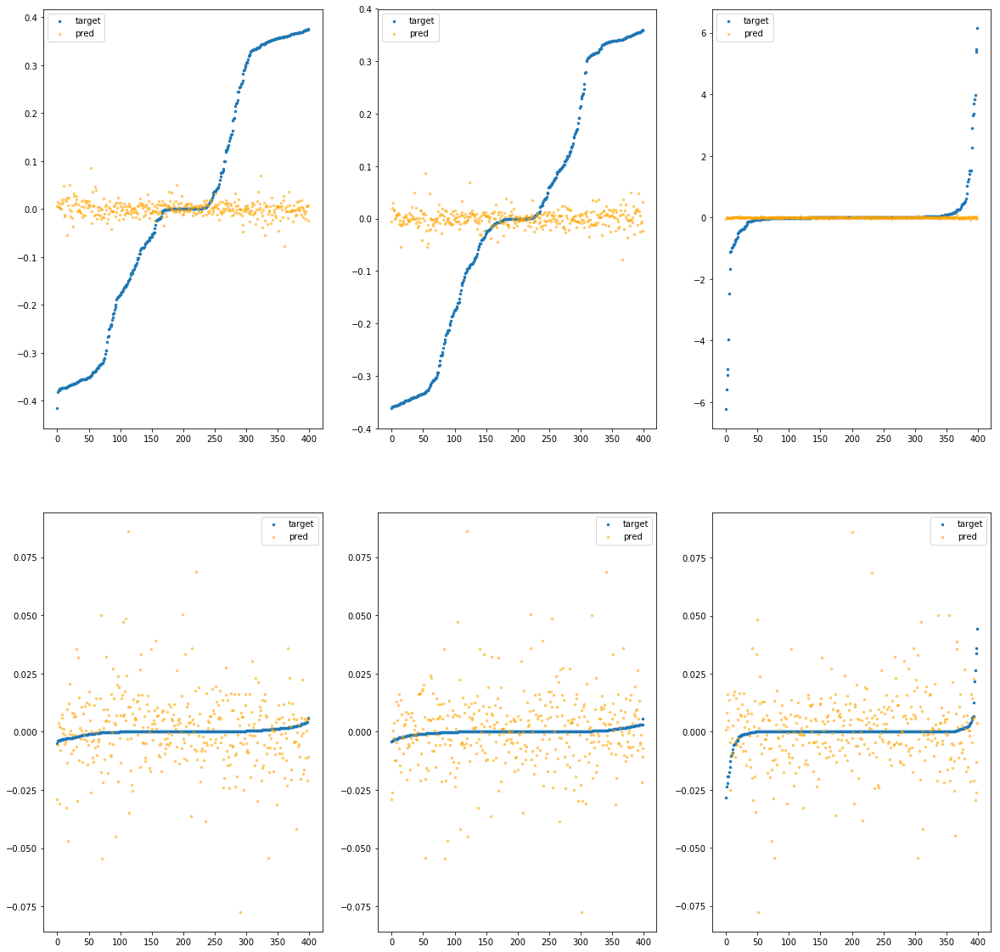

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa99bfe1a90>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.26e-02	4.51e-01	2.10e-01	4.27e+03	6.62e-02	4.38e-03
y		-1.89e-02	4.28e-01	1.90e-01	7.47e+02	5.59e-02	3.12e-03
z		1.38e-03	6.19e+00	2.84e-01	2.87e+02	8.74e-01	7.63e-01
phi		-3.32e+02	9.29e-02	1.83e-02	1.55e+06	6.20e-04	3.85e-07
theta		-4.87e+02	9.33e-02	1.83e-02	5.85e+05	6.19e-04	3.84e-07
psi		-2.58e+01	1.04e-01	1.87e-02	3.90e+05	6.58e-04	4.32e-07


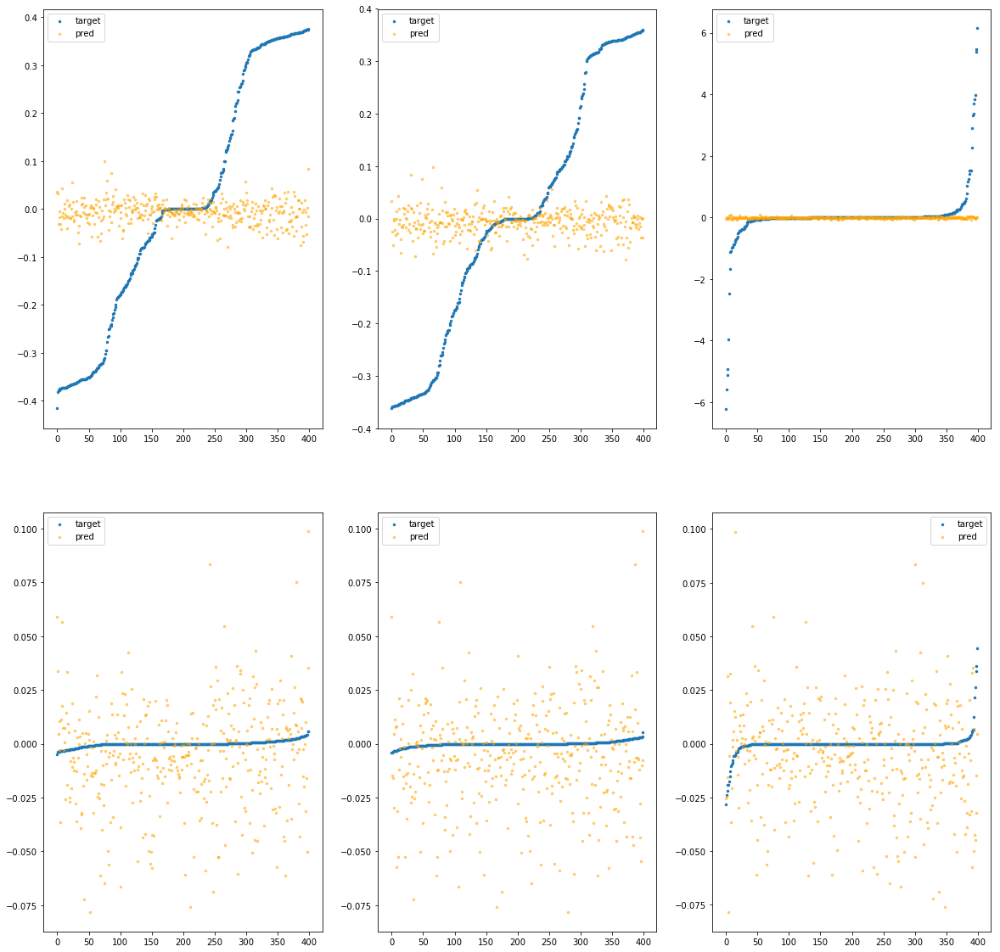

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa99bfe1af0>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.12e-02	5.01e-01	2.07e-01	2.20e+03	6.48e-02	4.20e-03
y		-2.78e-02	4.34e-01	1.92e-01	4.52e+02	5.63e-02	3.17e-03
z		-7.46e-03	6.25e+00	2.91e-01	5.54e+02	8.81e-01	7.77e-01
phi		-6.83e+02	1.10e-01	2.64e-02	9.09e+05	1.27e-03	1.62e-06
theta		-9.98e+02	1.10e-01	2.65e-02	2.77e+05	1.27e-03	1.61e-06
psi		-5.28e+01	1.10e-01	2.70e-02	7.82e+05	1.32e-03	1.74e-06


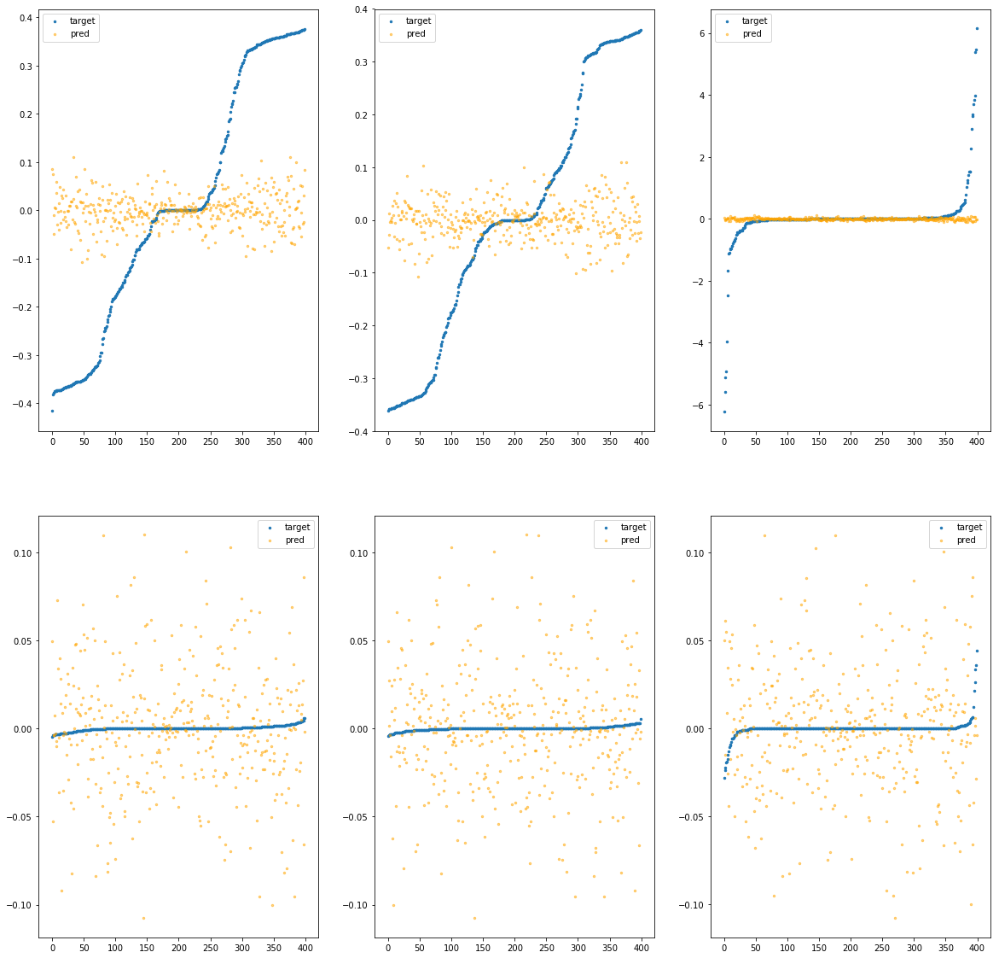

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa99bfe1b50>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.92e-02	4.75e-01	2.09e-01	4.58e+03	6.60e-02	4.35e-03
y		-3.03e-02	4.56e-01	1.92e-01	9.93e+02	5.65e-02	3.19e-03
z		3.67e-04	6.22e+00	2.85e-01	5.31e+02	8.75e-01	7.65e-01
phi		-5.06e+02	1.25e-01	2.09e-02	1.71e+06	9.44e-04	8.91e-07
theta		-7.34e+02	1.25e-01	2.08e-02	8.58e+05	9.34e-04	8.72e-07
psi		-3.81e+01	1.25e-01	2.11e-02	5.41e+05	9.60e-04	9.21e-07


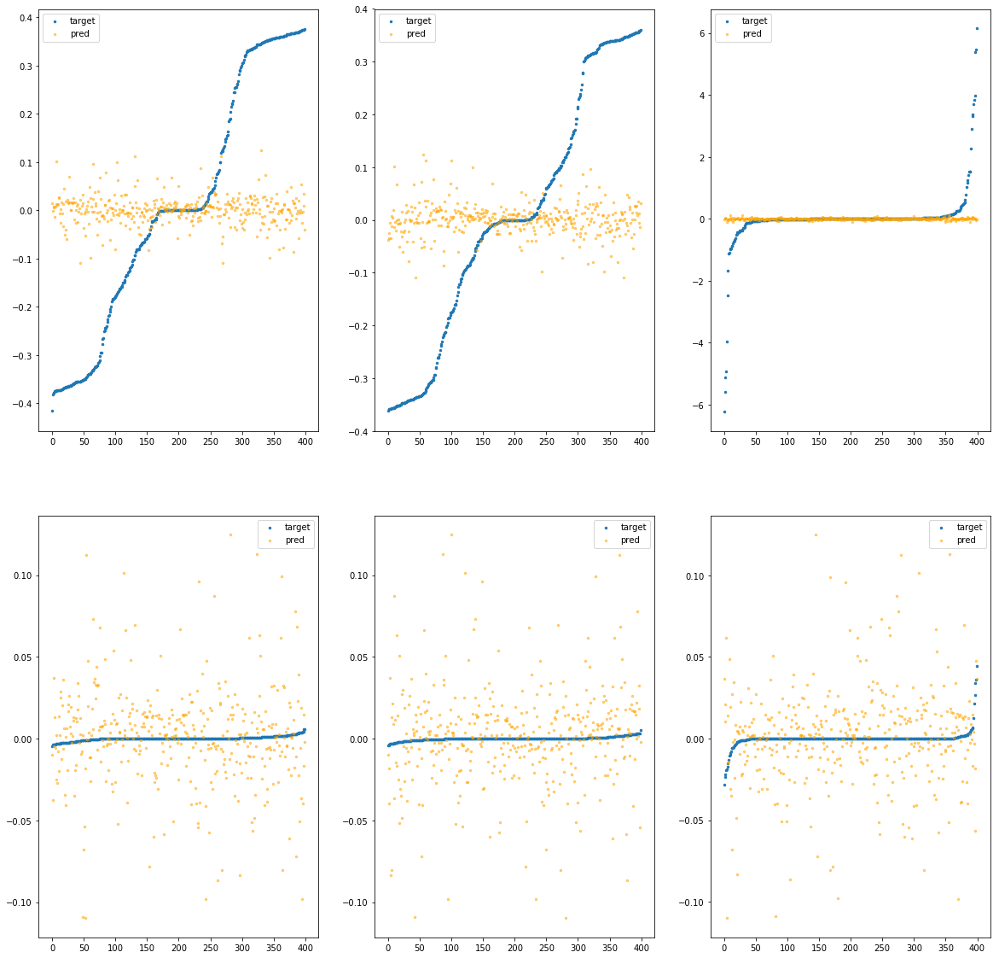

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa99bfe1bb0>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.33e-03	4.64e-01	2.07e-01	3.72e+03	6.46e-02	4.17e-03
y		-1.07e-03	4.45e-01	1.88e-01	4.55e+02	5.49e-02	3.01e-03
z		-9.72e-04	6.22e+00	2.78e-01	2.48e+02	8.76e-01	7.67e-01
phi		-3.37e+01	8.95e-02	6.02e-03	1.38e+06	6.47e-05	4.18e-09
theta		-4.96e+01	8.95e-02	6.00e-03	4.98e+05	6.42e-05	4.12e-09
psi		-2.40e+00	8.95e-02	6.44e-03	1.62e+05	8.34e-05	6.95e-09


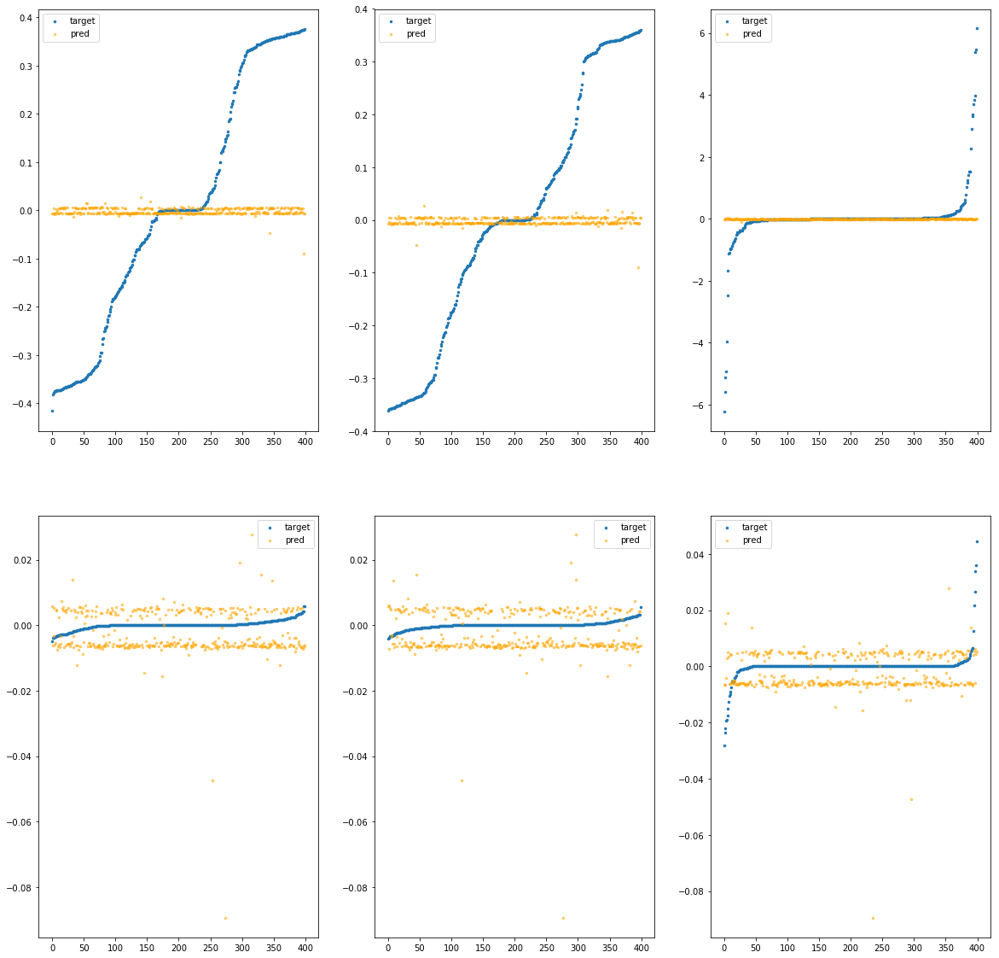

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa99bfe1c10>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.20e-03	4.22e-01	2.07e-01	2.51e+03	6.43e-02	4.14e-03
y		4.50e-03	4.04e-01	1.88e-01	3.96e+02	5.46e-02	2.98e-03
z		2.48e-03	6.21e+00	2.78e-01	1.69e+02	8.73e-01	7.62e-01
phi		-6.48e+01	8.12e-02	6.21e-03	1.01e+06	1.22e-04	1.50e-08
theta		-9.58e+01	8.12e-02	6.26e-03	3.93e+05	1.23e-04	1.51e-08
psi		-4.99e+00	8.12e-02	6.93e-03	1.51e+05	1.47e-04	2.16e-08


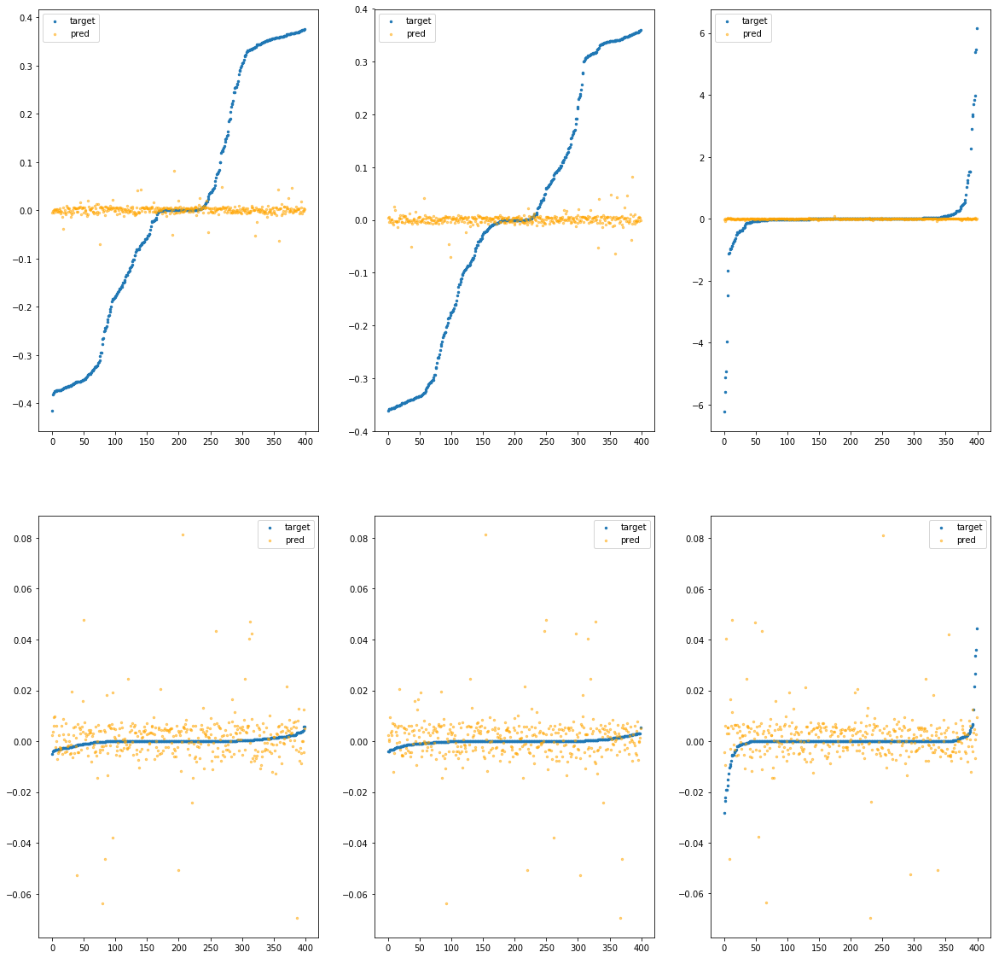

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa99bfe1c70>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.67e-03	4.19e-01	2.06e-01	2.17e+03	6.40e-02	4.10e-03
y		-2.64e-03	3.85e-01	1.89e-01	4.83e+02	5.50e-02	3.02e-03
z		6.05e-04	6.24e+00	2.81e-01	1.54e+02	8.74e-01	7.64e-01
phi		-9.90e+01	6.64e-02	9.64e-03	9.55e+05	1.86e-04	3.46e-08
theta		-1.45e+02	6.69e-02	9.59e-03	3.44e+05	1.85e-04	3.44e-08
psi		-8.31e+00	1.15e-01	1.02e-02	2.89e+05	2.28e-04	5.21e-08


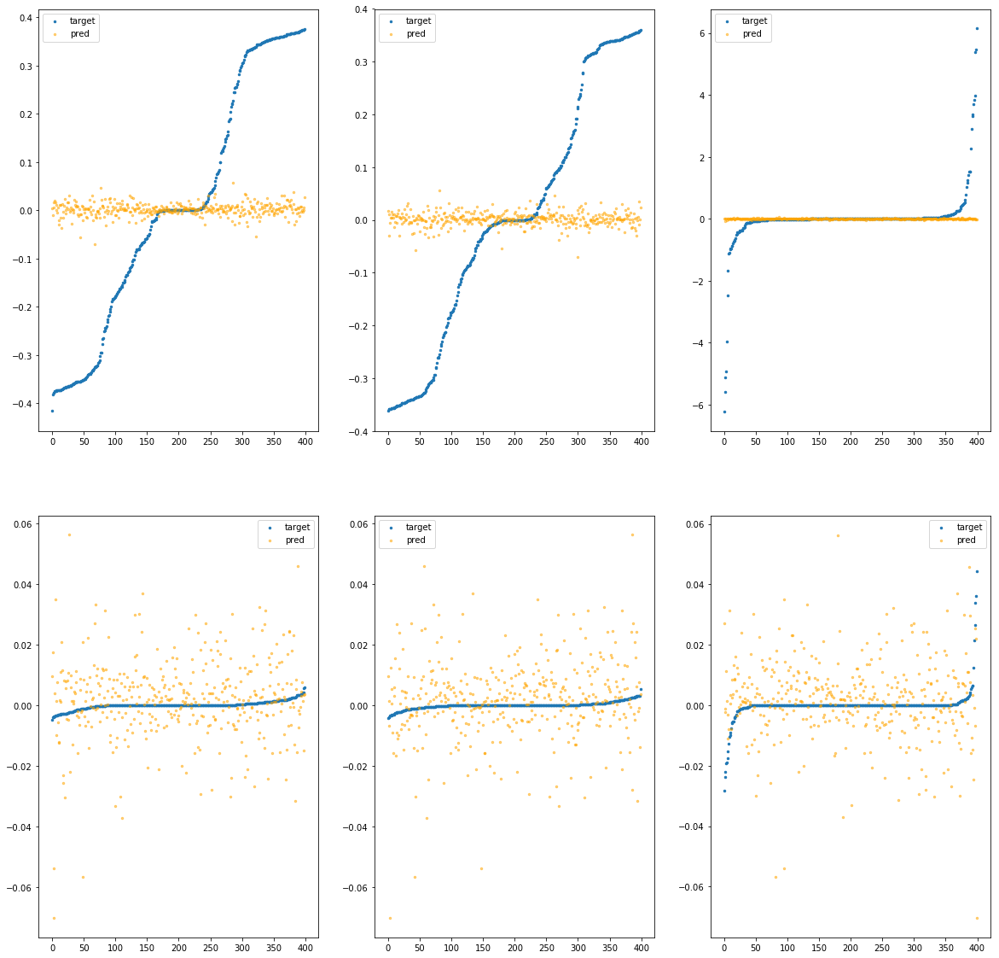

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa99bfe1cd0>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		5.87e-03	4.17e-01	2.06e-01	1.32e+03	6.37e-02	4.06e-03
y		-7.30e-03	4.33e-01	1.90e-01	4.31e+02	5.52e-02	3.05e-03
z		-3.81e-03	6.19e+00	2.83e-01	2.56e+02	8.78e-01	7.71e-01
phi		-2.47e+02	1.18e-01	1.52e-02	5.76e+05	4.61e-04	2.12e-07
theta		-3.57e+02	1.20e-01	1.50e-02	3.97e+05	4.54e-04	2.06e-07
psi		-1.96e+01	1.20e-01	1.57e-02	2.18e+05	5.06e-04	2.56e-07


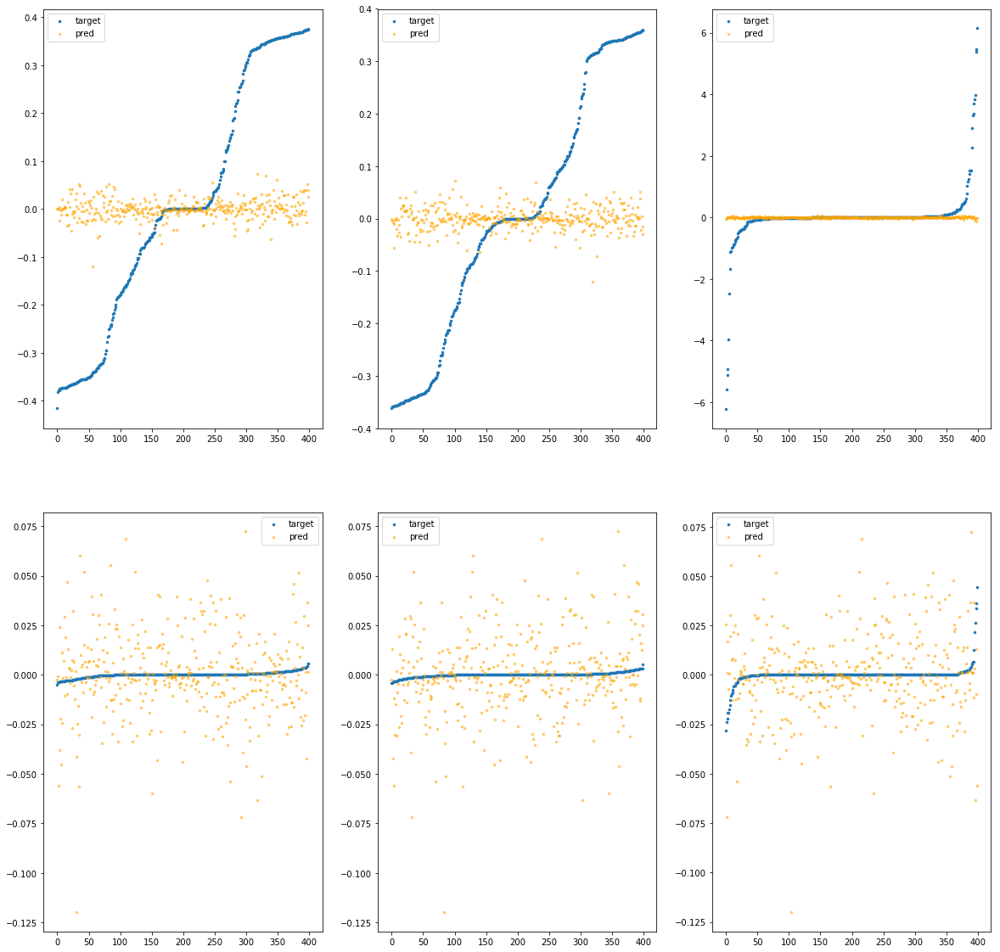

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fa99bfe1d30>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.91e-02	4.75e-01	2.09e-01	4.63e+03	6.53e-02	4.27e-03
y		-3.99e-02	4.23e-01	1.93e-01	1.06e+03	5.70e-02	3.25e-03
z		6.73e-03	6.22e+00	2.86e-01	5.30e+02	8.69e-01	7.55e-01
phi		-5.65e+02	1.29e-01	2.34e-02	1.75e+06	1.05e-03	1.11e-06
theta		-8.21e+02	1.33e-01	2.31e-02	6.74e+05	1.04e-03	1.09e-06
psi		-4.32e+01	1.25e-01	2.34e-02	3.43e+05	1.09e-03	1.18e-06


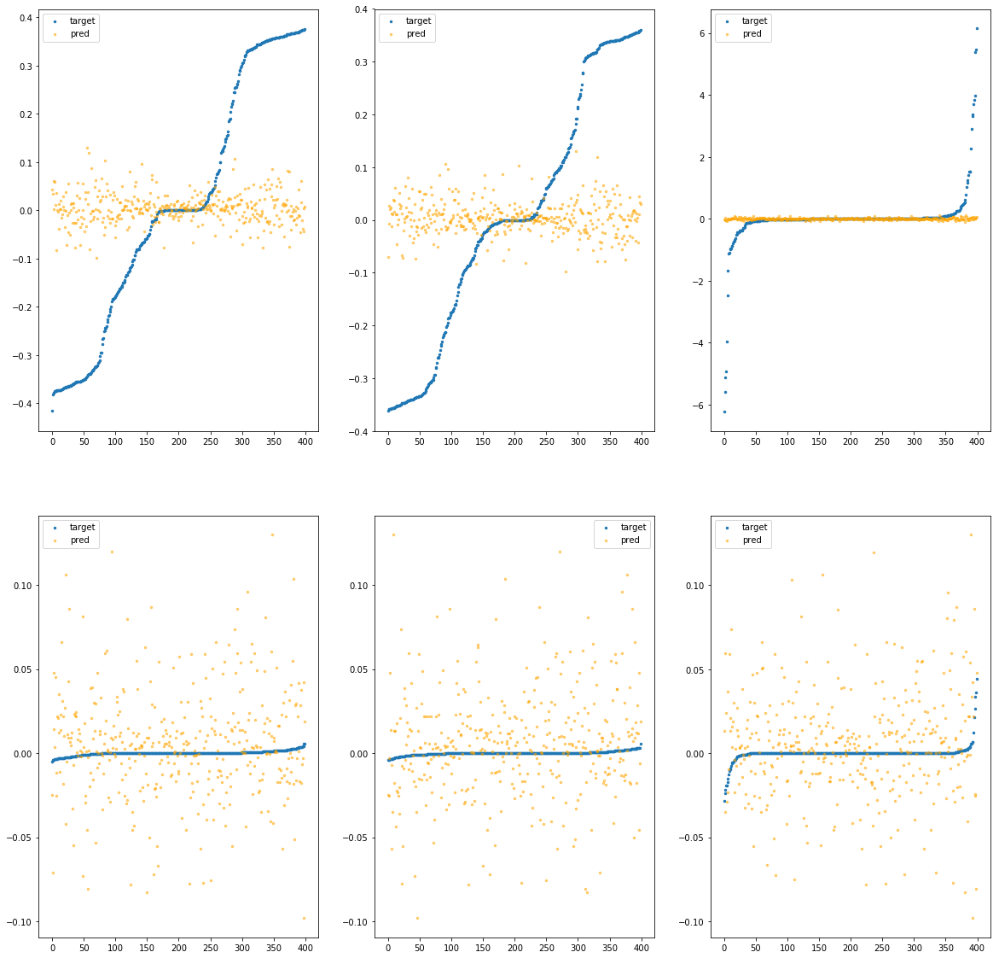

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfe1d90>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	8.87e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.26e+01	5.49e-02	3.01e-03
z		-9.70e-04	6.23e+00	2.77e-01	6.92e+00	8.76e-01	7.67e-01
phi		-2.16e-02	6.03e-03	8.45e-04	3.36e+04	1.90e-06	3.62e-12
theta		-1.89e-02	5.60e-03	6.95e-04	1.21e+04	1.29e-06	1.67e-12
psi		-5.32e-04	4.46e-02	1.36e-03	3.92e+03	2.45e-05	6.02e-10


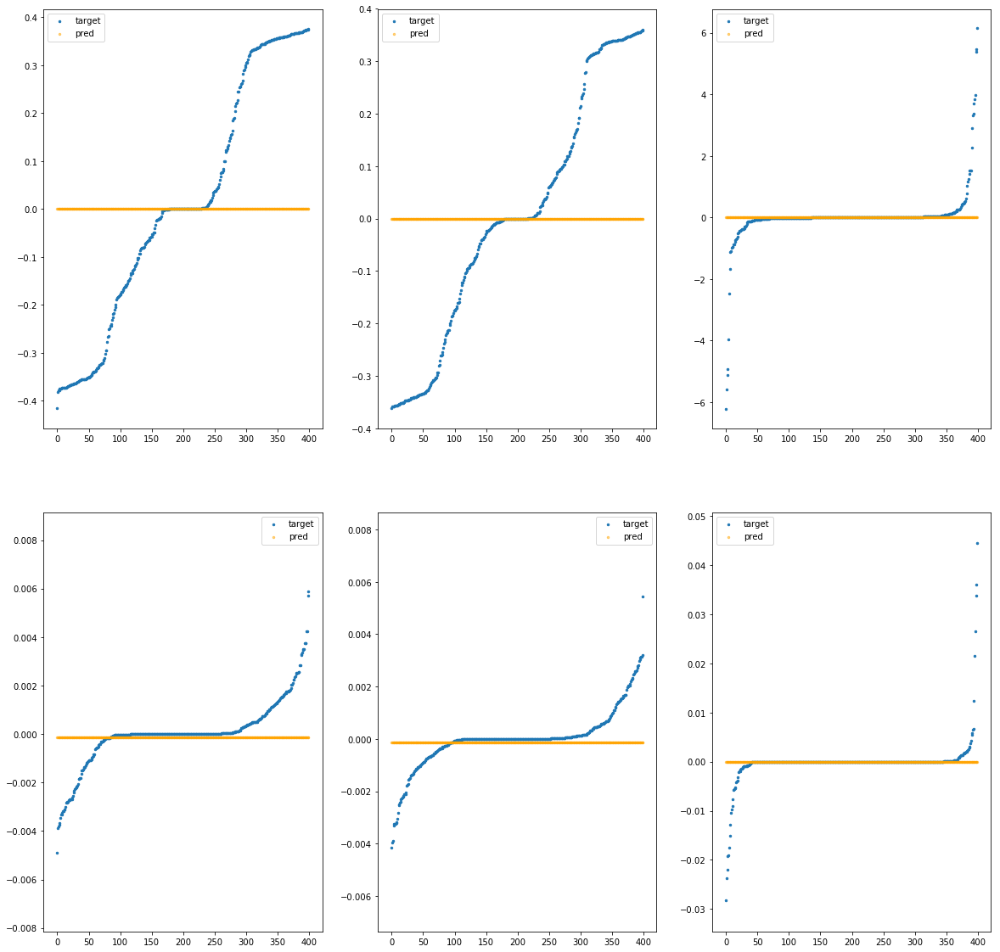

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfe1df0>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	7.86e+01	6.42e-02	4.13e-03
y		-1.12e-03	3.61e-01	1.88e-01	1.13e+01	5.49e-02	3.01e-03
z		-9.69e-04	6.23e+00	2.77e-01	6.22e+00	8.76e-01	7.67e-01
phi		-1.82e-02	6.01e-03	8.36e-04	2.97e+04	1.90e-06	3.59e-12
theta		-1.51e-02	5.58e-03	6.86e-04	1.07e+04	1.29e-06	1.66e-12
psi		-3.90e-04	4.45e-02	1.34e-03	3.46e+03	2.45e-05	6.02e-10


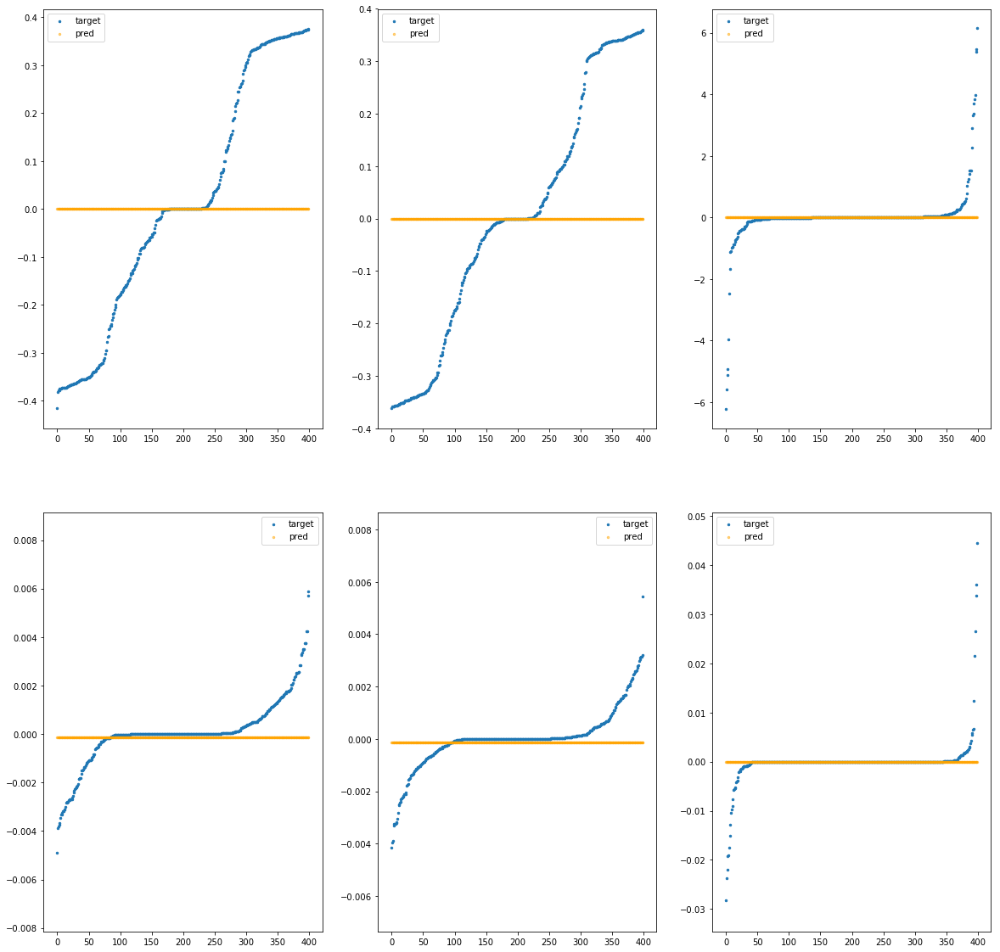

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfe1e50>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	8.63e+01	6.42e-02	4.13e-03
y		-1.12e-03	3.61e-01	1.88e-01	1.23e+01	5.49e-02	3.01e-03
z		-9.70e-04	6.23e+00	2.77e-01	6.75e+00	8.76e-01	7.67e-01
phi		-2.07e-02	6.03e-03	8.43e-04	3.26e+04	1.90e-06	3.61e-12
theta		-1.79e-02	5.59e-03	6.93e-04	1.17e+04	1.29e-06	1.67e-12
psi		-4.95e-04	4.46e-02	1.35e-03	3.81e+03	2.45e-05	6.02e-10


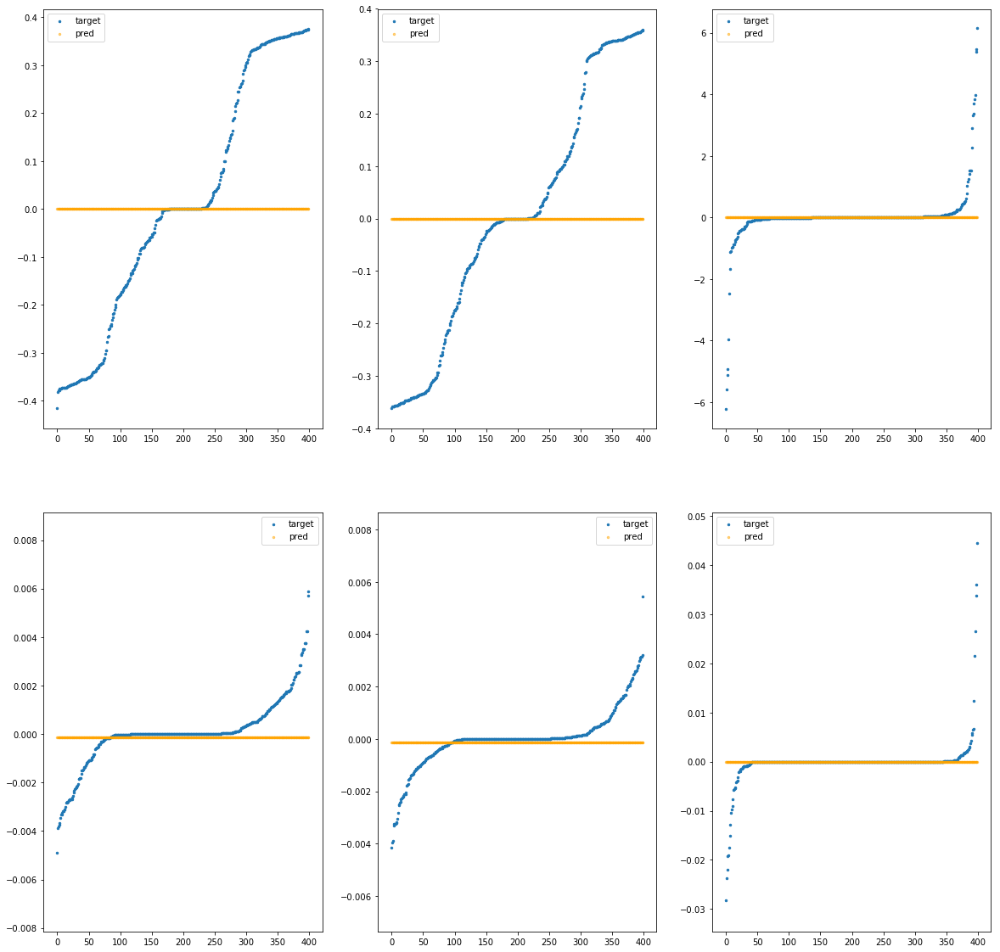

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfe1eb0>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	9.19e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.30e+01	5.49e-02	3.01e-03
z		-9.71e-04	6.23e+00	2.77e-01	7.13e+00	8.76e-01	7.67e-01
phi		-2.27e-02	6.03e-03	8.48e-04	3.48e+04	1.90e-06	3.62e-12
theta		-2.01e-02	5.60e-03	6.97e-04	1.25e+04	1.30e-06	1.68e-12
psi		-5.80e-04	4.46e-02	1.36e-03	4.06e+03	2.45e-05	6.02e-10


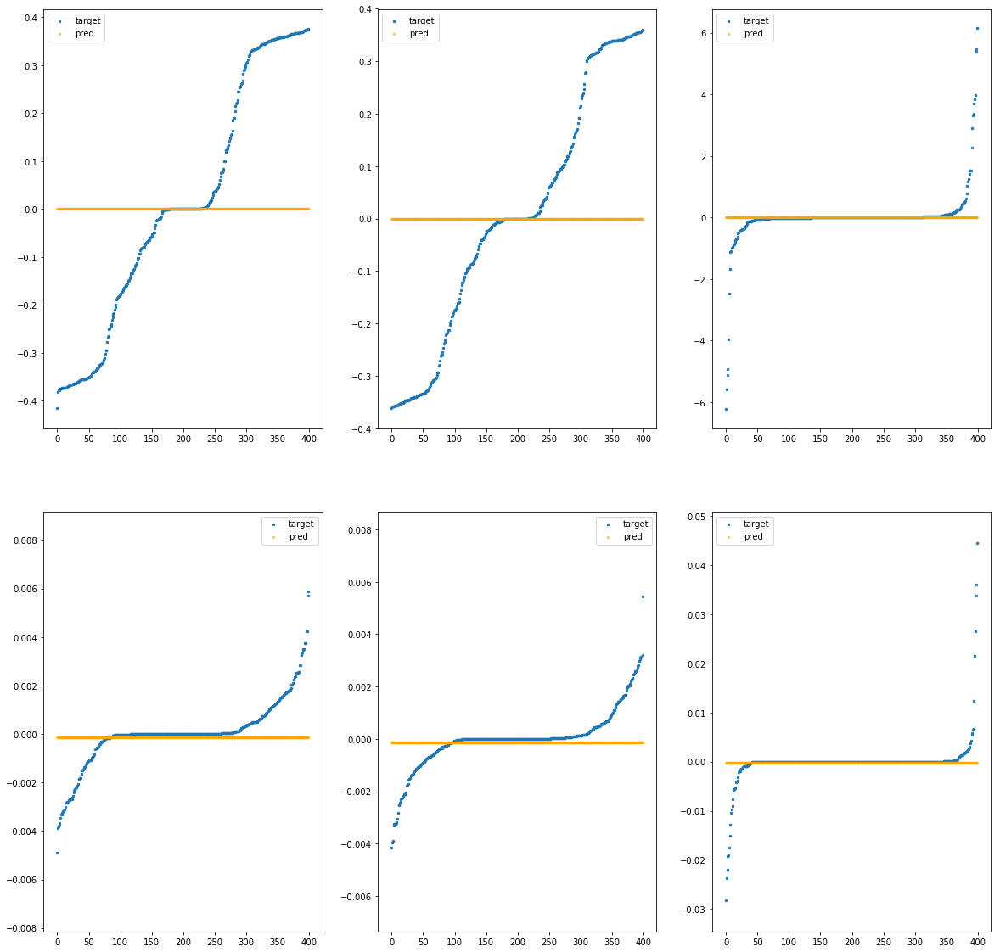

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfe1f10>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	9.11e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.29e+01	5.49e-02	3.01e-03
z		-9.71e-04	6.23e+00	2.77e-01	7.08e+00	8.76e-01	7.67e-01
phi		-2.24e-02	6.03e-03	8.47e-04	3.45e+04	1.90e-06	3.62e-12
theta		-1.98e-02	5.60e-03	6.97e-04	1.24e+04	1.30e-06	1.68e-12
psi		-5.68e-04	4.46e-02	1.36e-03	4.02e+03	2.45e-05	6.02e-10


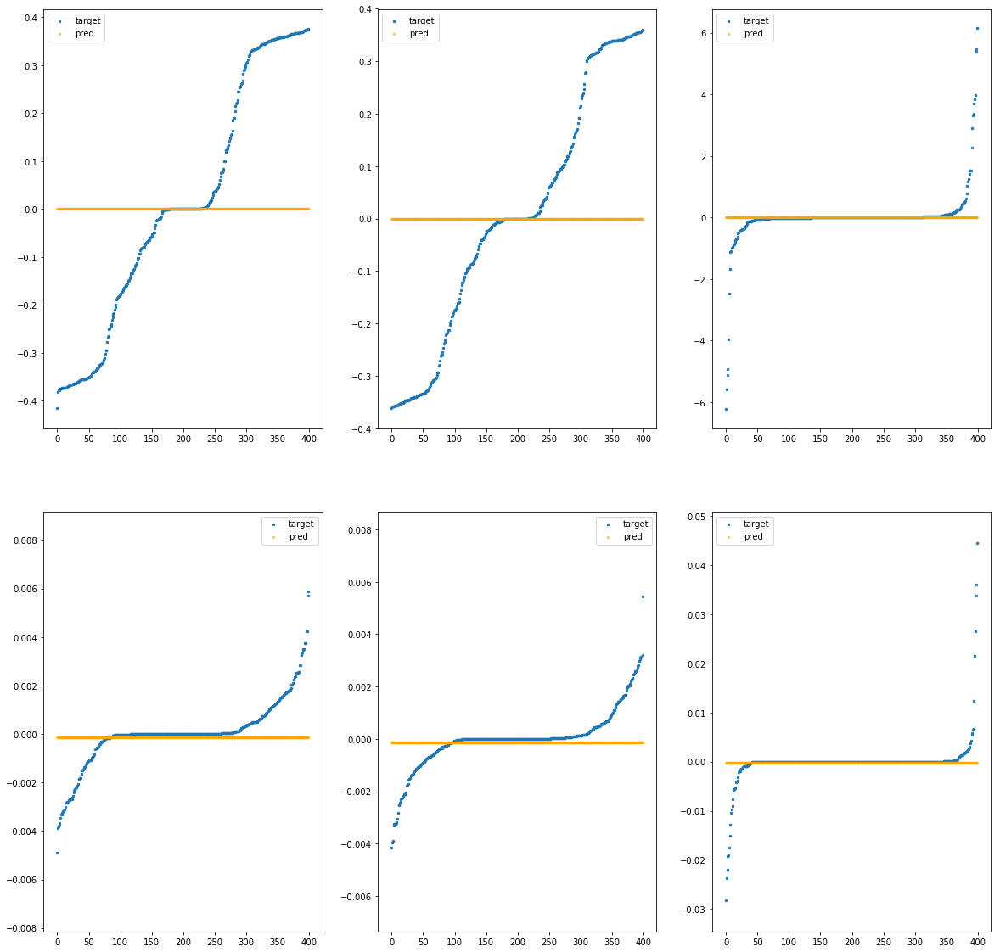

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfe1f70>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	9.26e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.32e+01	5.49e-02	3.01e-03
z		-9.71e-04	6.23e+00	2.77e-01	7.19e+00	8.76e-01	7.67e-01
phi		-2.30e-02	6.04e-03	8.49e-04	3.51e+04	1.90e-06	3.63e-12
theta		-2.05e-02	5.60e-03	6.98e-04	1.26e+04	1.30e-06	1.68e-12
psi		-5.86e-04	4.46e-02	1.36e-03	4.09e+03	2.45e-05	6.02e-10


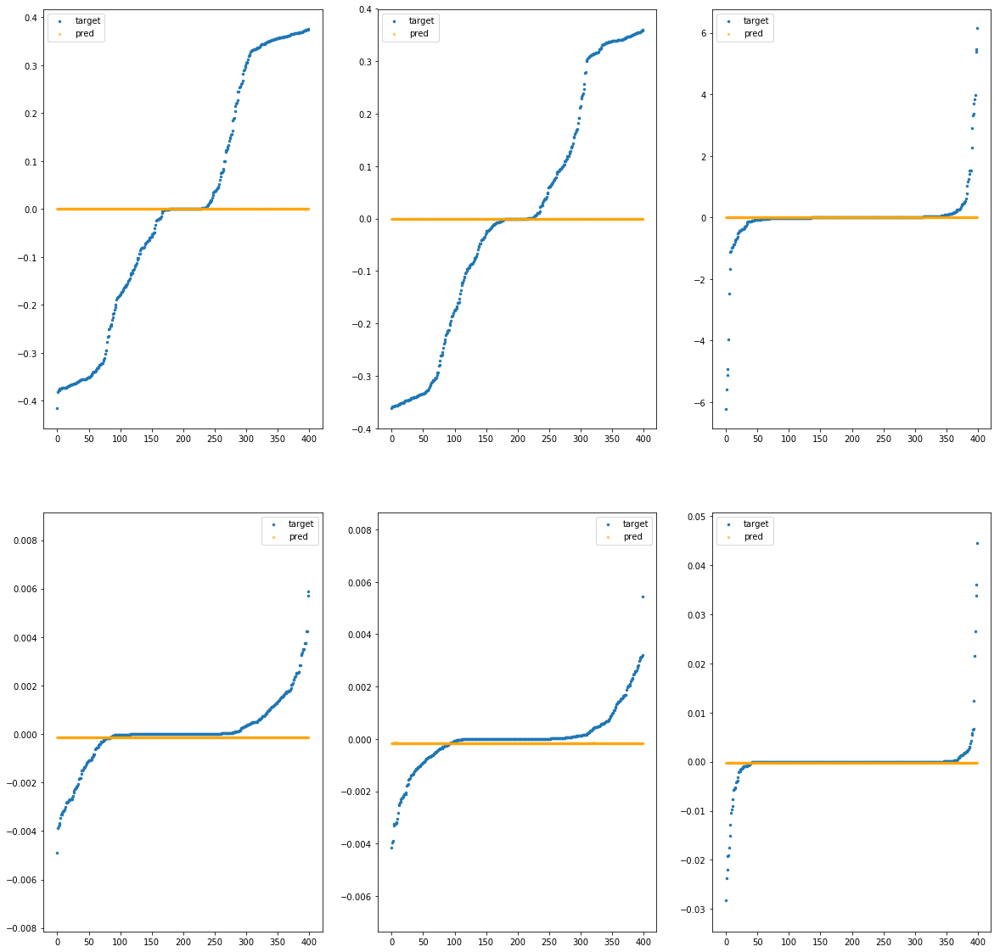

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfe1fd0>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.02e-03	4.15e-01	2.05e-01	9.43e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.34e+01	5.49e-02	3.01e-03
z		-9.71e-04	6.23e+00	2.77e-01	7.30e+00	8.76e-01	7.67e-01
phi		-2.36e-02	6.04e-03	8.50e-04	3.57e+04	1.91e-06	3.63e-12
theta		-2.11e-02	5.61e-03	7.00e-04	1.28e+04	1.30e-06	1.68e-12
psi		-6.19e-04	4.46e-02	1.36e-03	4.16e+03	2.45e-05	6.03e-10


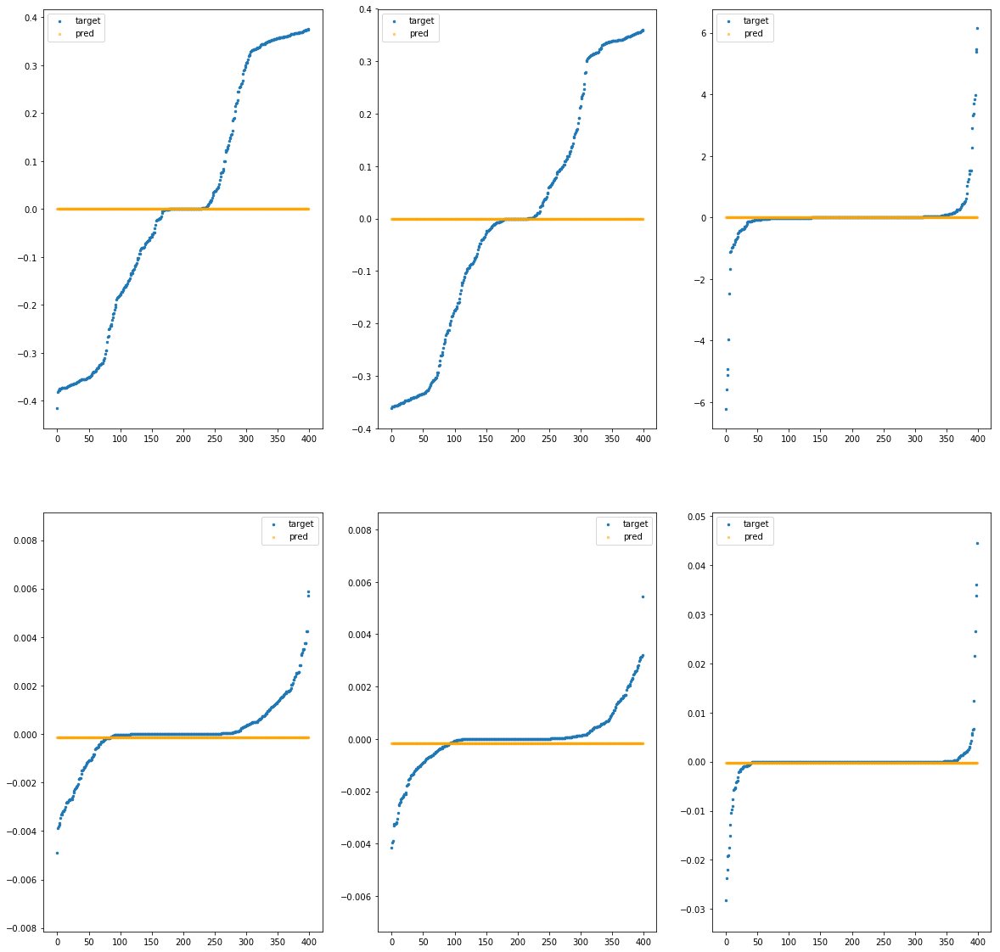

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfec070>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	8.89e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.27e+01	5.49e-02	3.01e-03
z		-9.70e-04	6.23e+00	2.77e-01	6.93e+00	8.76e-01	7.67e-01
phi		-2.16e-02	6.03e-03	8.45e-04	3.37e+04	1.90e-06	3.62e-12
theta		-1.89e-02	5.60e-03	6.95e-04	1.21e+04	1.29e-06	1.67e-12
psi		-5.34e-04	4.46e-02	1.36e-03	3.92e+03	2.45e-05	6.02e-10


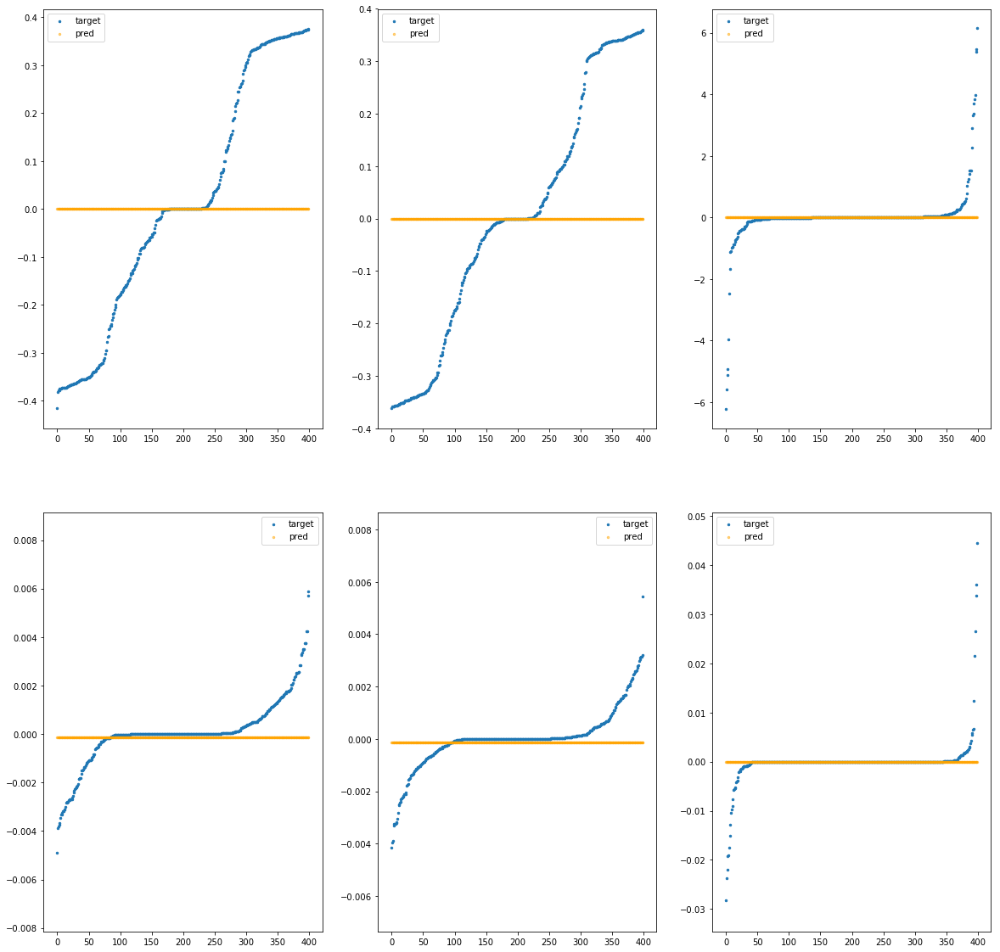

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfec0d0>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.02e-03	4.15e-01	2.05e-01	9.45e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.34e+01	5.49e-02	3.01e-03
z		-9.71e-04	6.23e+00	2.77e-01	7.31e+00	8.76e-01	7.67e-01
phi		-2.36e-02	6.04e-03	8.50e-04	3.58e+04	1.91e-06	3.63e-12
theta		-2.12e-02	5.61e-03	7.00e-04	1.29e+04	1.30e-06	1.68e-12
psi		-6.22e-04	4.46e-02	1.36e-03	4.17e+03	2.45e-05	6.03e-10


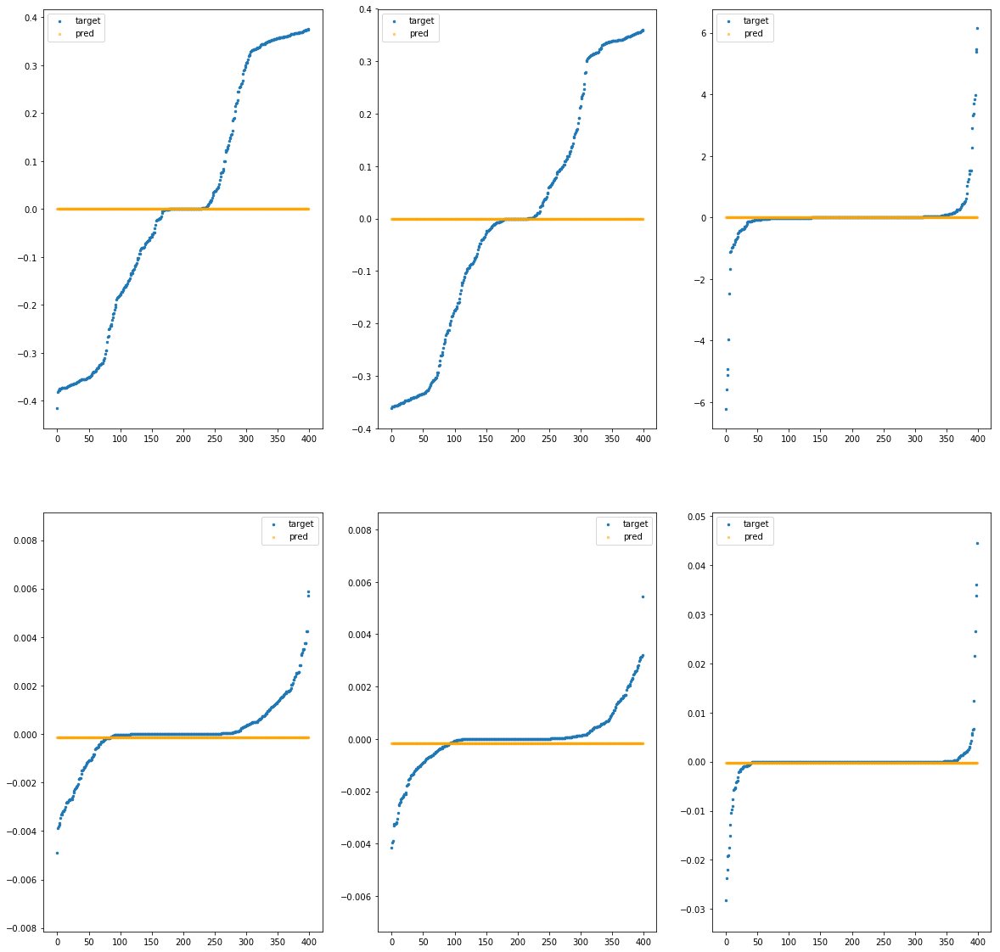

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfec130>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	9.02e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.28e+01	5.49e-02	3.01e-03
z		-9.71e-04	6.23e+00	2.77e-01	7.02e+00	8.76e-01	7.67e-01
phi		-2.21e-02	6.03e-03	8.46e-04	3.42e+04	1.90e-06	3.62e-12
theta		-1.95e-02	5.60e-03	6.96e-04	1.23e+04	1.29e-06	1.68e-12
psi		-5.55e-04	4.46e-02	1.36e-03	3.98e+03	2.45e-05	6.02e-10


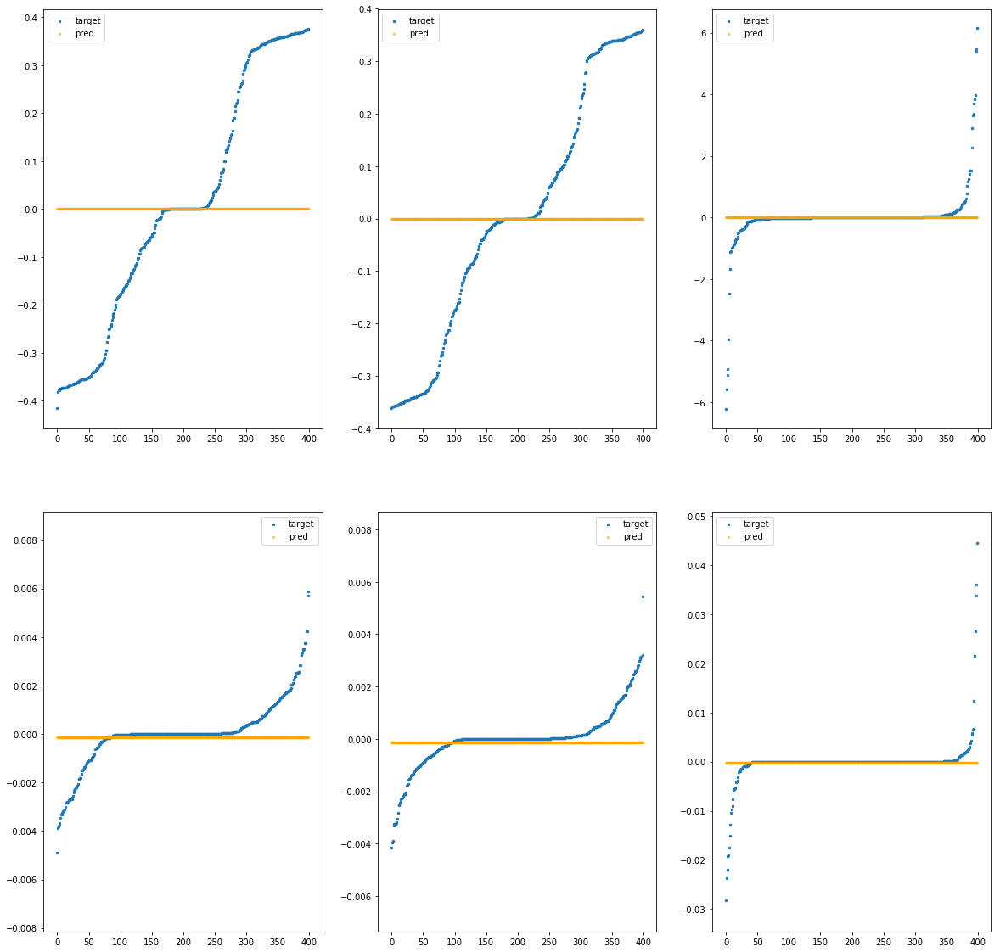

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfec190>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	9.08e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.29e+01	5.49e-02	3.01e-03
z		-9.71e-04	6.23e+00	2.77e-01	7.06e+00	8.76e-01	7.67e-01
phi		-2.23e-02	6.03e-03	8.47e-04	3.44e+04	1.90e-06	3.62e-12
theta		-1.97e-02	5.60e-03	6.97e-04	1.24e+04	1.29e-06	1.68e-12
psi		-5.63e-04	4.46e-02	1.36e-03	4.01e+03	2.45e-05	6.02e-10


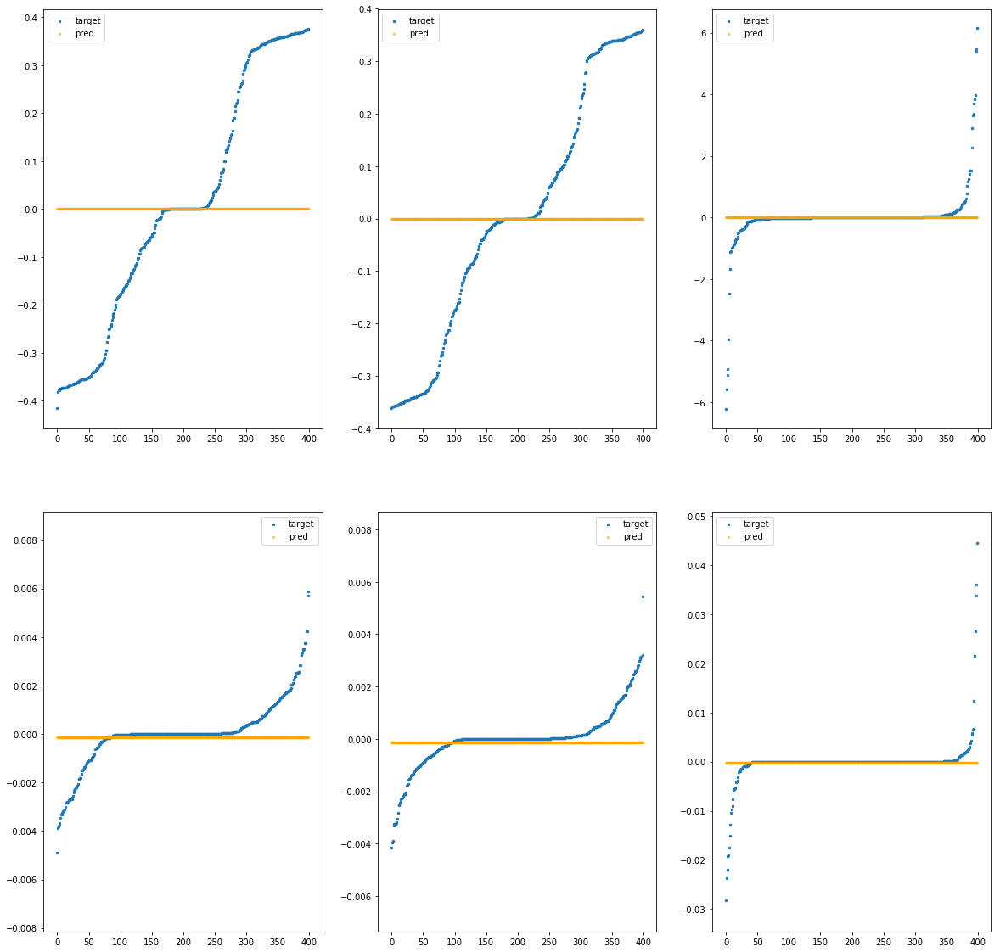

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfec1f0>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	9.35e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.33e+01	5.49e-02	3.01e-03
z		-9.71e-04	6.23e+00	2.77e-01	7.25e+00	8.76e-01	7.67e-01
phi		-2.33e-02	6.04e-03	8.49e-04	3.54e+04	1.90e-06	3.63e-12
theta		-2.08e-02	5.60e-03	6.99e-04	1.27e+04	1.30e-06	1.68e-12
psi		-6.06e-04	4.46e-02	1.36e-03	4.13e+03	2.45e-05	6.02e-10


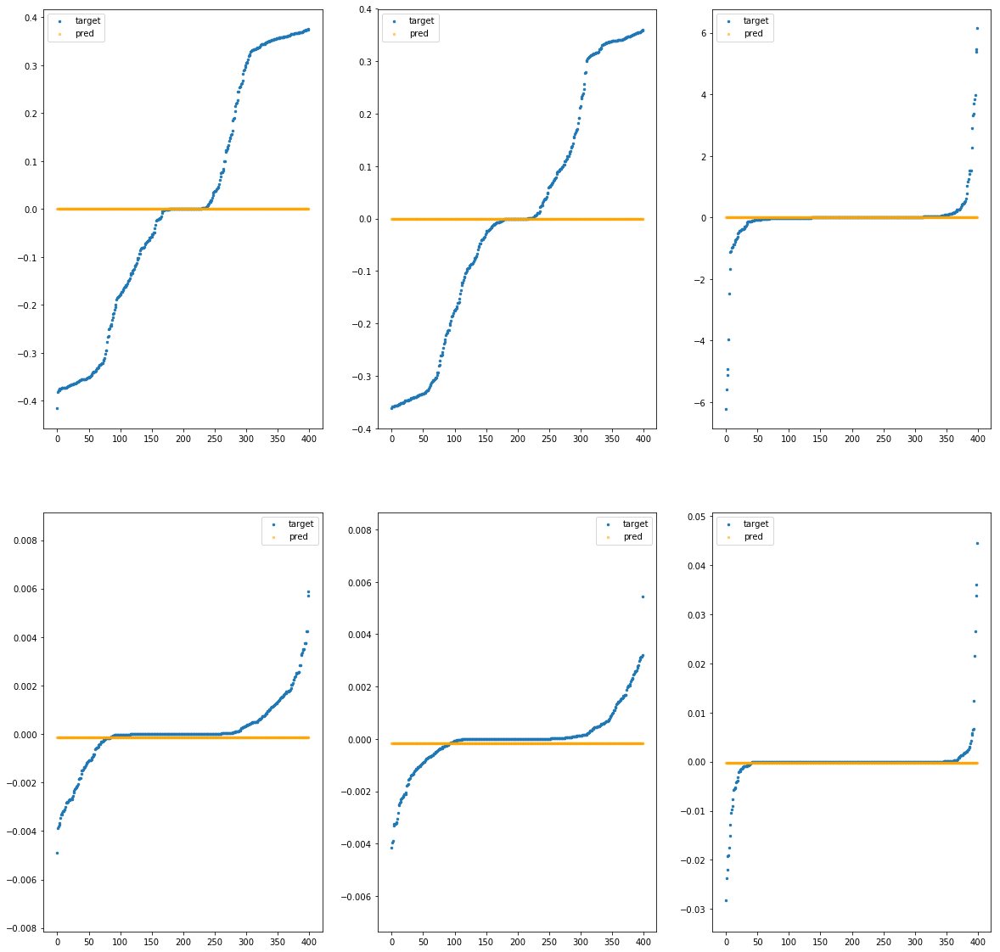

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfec250>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	9.04e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.29e+01	5.49e-02	3.01e-03
z		-9.71e-04	6.23e+00	2.77e-01	7.04e+00	8.76e-01	7.67e-01
phi		-2.22e-02	6.03e-03	8.47e-04	3.42e+04	1.90e-06	3.62e-12
theta		-1.95e-02	5.60e-03	6.96e-04	1.23e+04	1.29e-06	1.68e-12
psi		-5.58e-04	4.46e-02	1.36e-03	3.99e+03	2.45e-05	6.02e-10


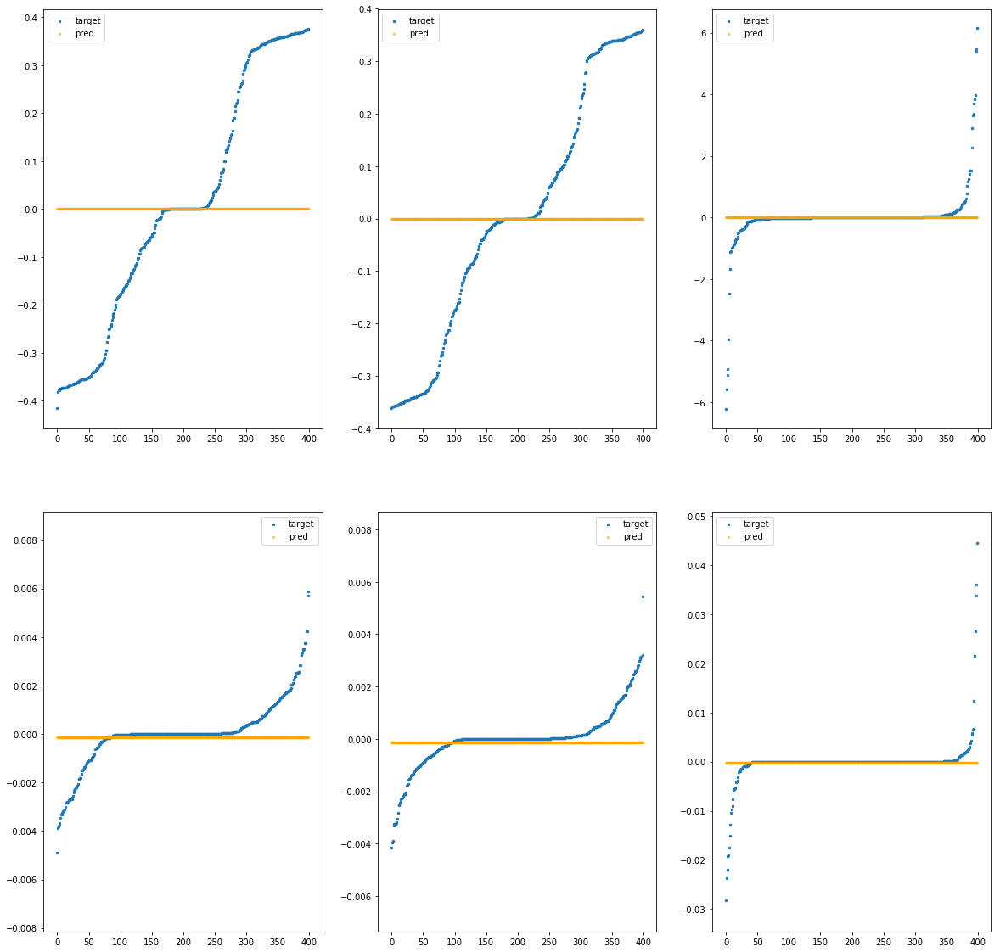

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfec2b0>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	9.29e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.32e+01	5.49e-02	3.01e-03
z		-9.71e-04	6.23e+00	2.77e-01	7.21e+00	8.76e-01	7.67e-01
phi		-2.31e-02	6.04e-03	8.49e-04	3.52e+04	1.90e-06	3.63e-12
theta		-2.06e-02	5.60e-03	6.98e-04	1.27e+04	1.30e-06	1.68e-12
psi		-5.97e-04	4.46e-02	1.36e-03	4.10e+03	2.45e-05	6.02e-10


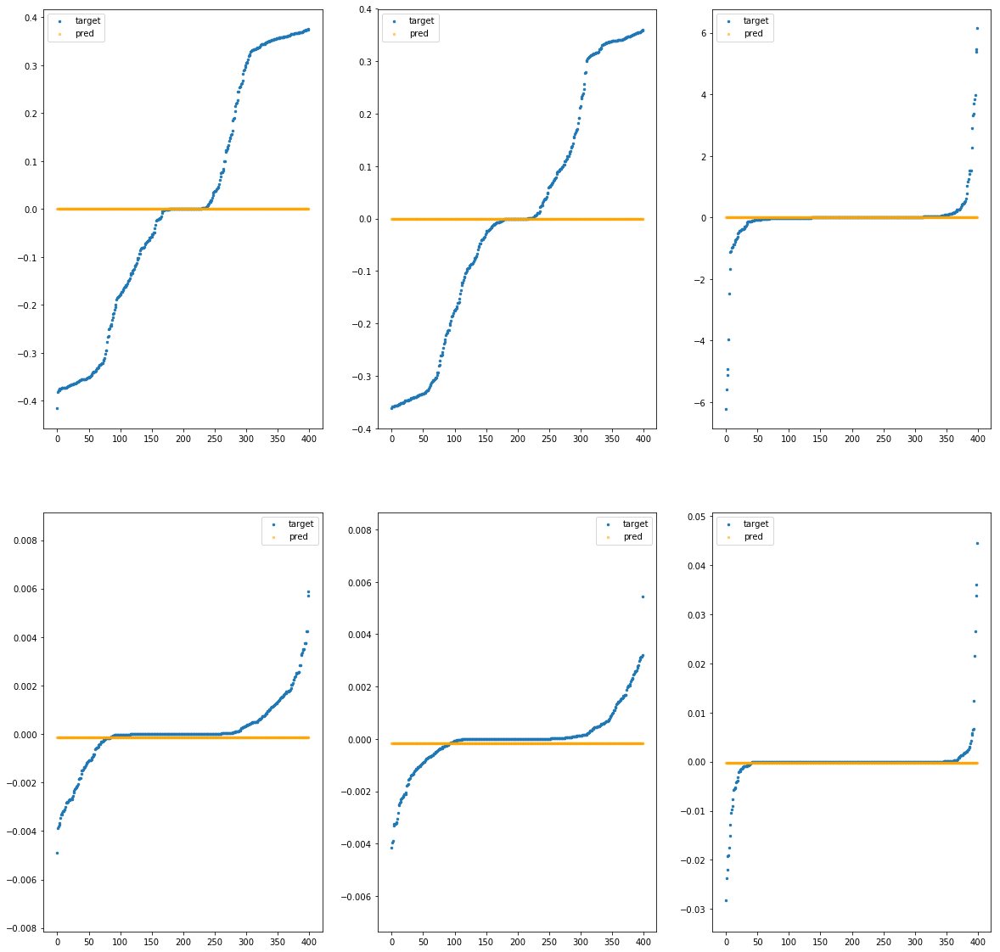

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfec310>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	9.13e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.30e+01	5.49e-02	3.01e-03
z		-9.71e-04	6.23e+00	2.77e-01	7.09e+00	8.76e-01	7.67e-01
phi		-2.25e-02	6.03e-03	8.47e-04	3.46e+04	1.90e-06	3.62e-12
theta		-1.99e-02	5.60e-03	6.97e-04	1.24e+04	1.30e-06	1.68e-12
psi		-5.71e-04	4.46e-02	1.36e-03	4.03e+03	2.45e-05	6.02e-10


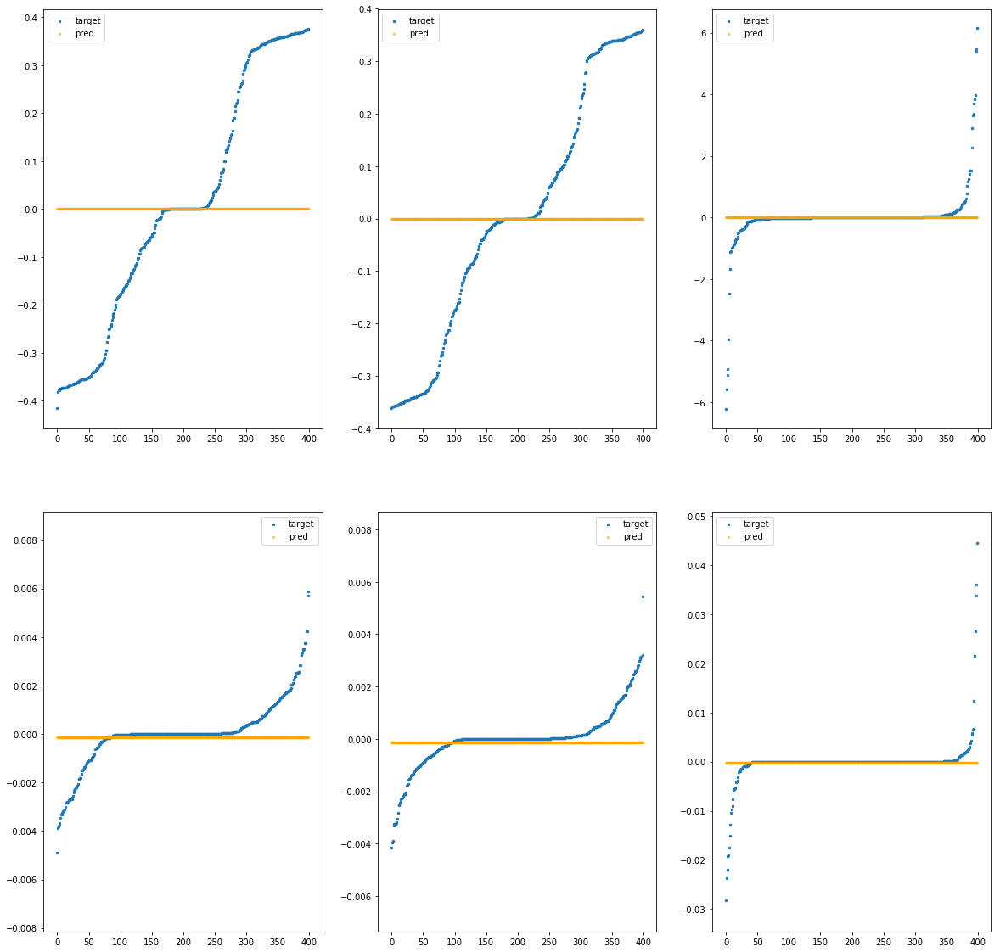

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfec370>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.02e-03	4.15e-01	2.05e-01	9.79e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.38e+01	5.49e-02	3.01e-03
z		-9.71e-04	6.23e+00	2.77e-01	7.55e+00	8.76e-01	7.67e-01
phi		-2.49e-02	6.04e-03	8.54e-04	3.71e+04	1.91e-06	3.64e-12
theta		-2.26e-02	5.61e-03	7.03e-04	1.33e+04	1.30e-06	1.69e-12
psi		-6.79e-04	4.46e-02	1.37e-03	4.32e+03	2.45e-05	6.03e-10


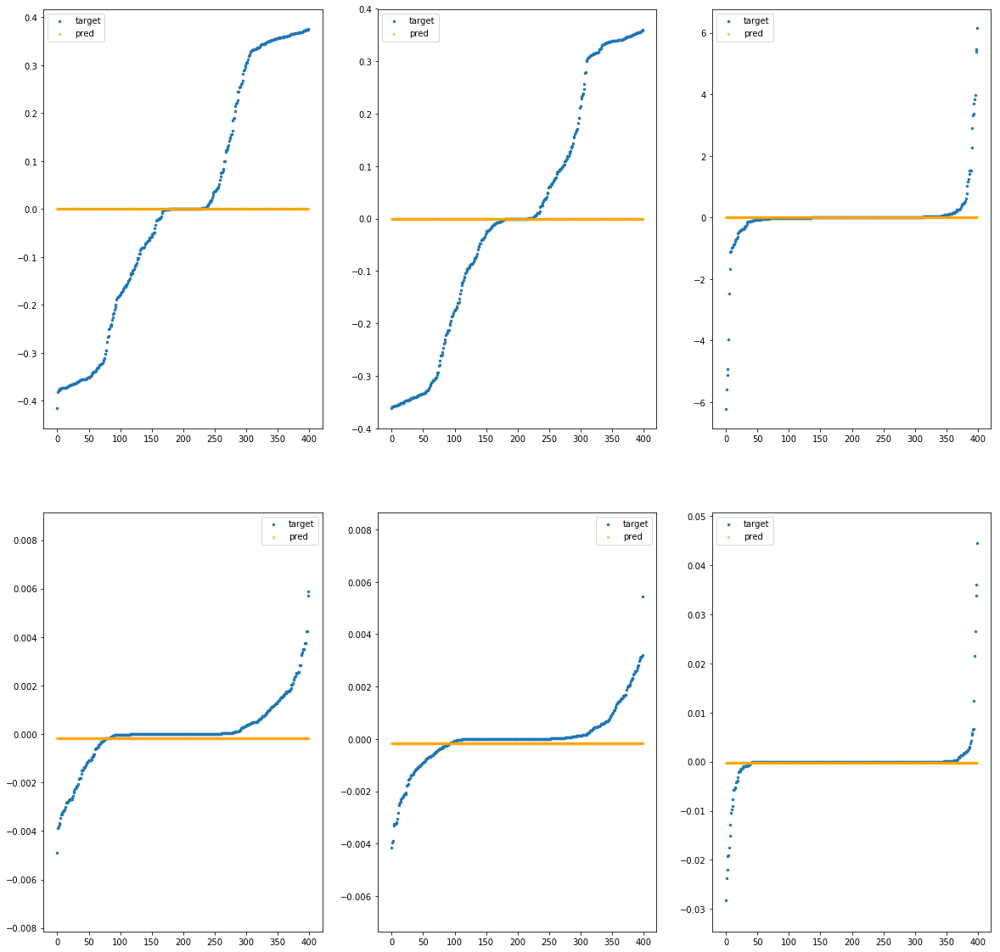

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfec3d0>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.02e-03	4.15e-01	2.05e-01	9.46e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.34e+01	5.49e-02	3.01e-03
z		-9.71e-04	6.23e+00	2.77e-01	7.32e+00	8.76e-01	7.67e-01
phi		-2.37e-02	6.04e-03	8.50e-04	3.58e+04	1.91e-06	3.63e-12
theta		-2.13e-02	5.61e-03	7.00e-04	1.29e+04	1.30e-06	1.68e-12
psi		-6.24e-04	4.46e-02	1.36e-03	4.18e+03	2.45e-05	6.03e-10


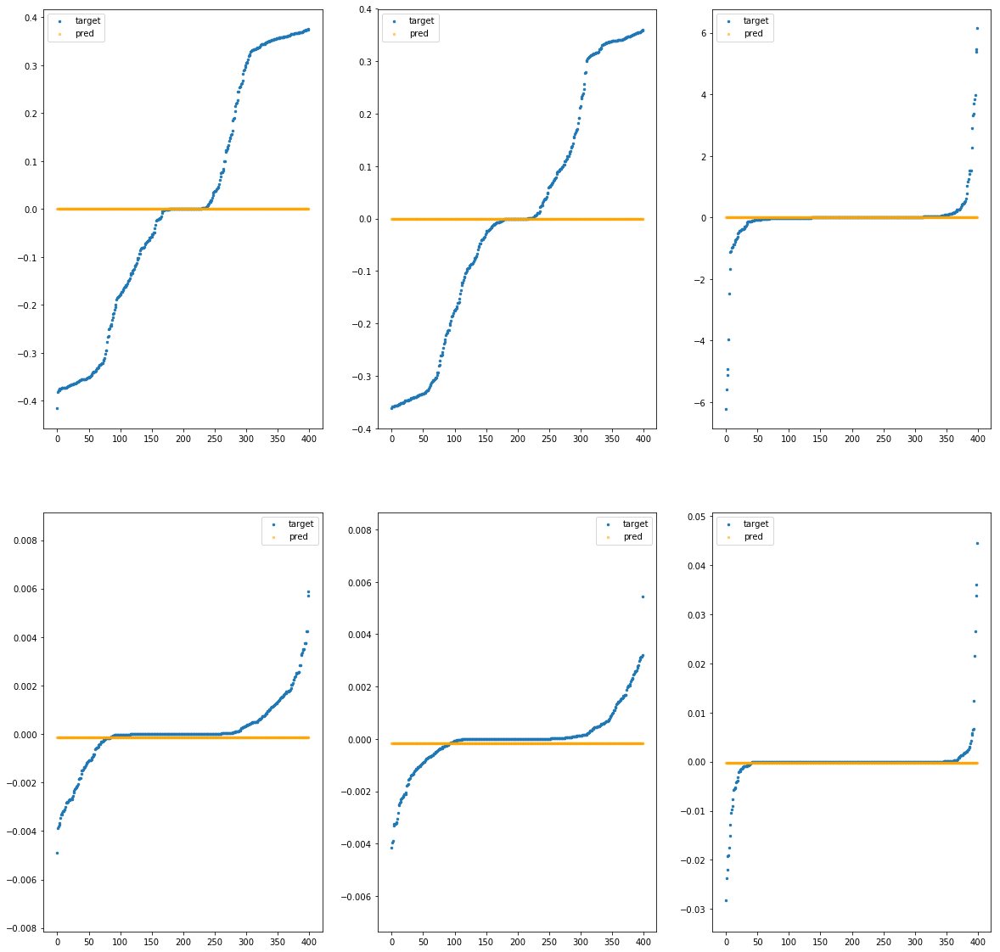

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfec430>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.02e-03	4.15e-01	2.05e-01	9.46e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.34e+01	5.49e-02	3.01e-03
z		-9.71e-04	6.23e+00	2.77e-01	7.33e+00	8.76e-01	7.67e-01
phi		-2.37e-02	6.04e-03	8.51e-04	3.58e+04	1.91e-06	3.63e-12
theta		-2.13e-02	5.61e-03	7.00e-04	1.29e+04	1.30e-06	1.68e-12
psi		-6.25e-04	4.46e-02	1.36e-03	4.18e+03	2.45e-05	6.03e-10


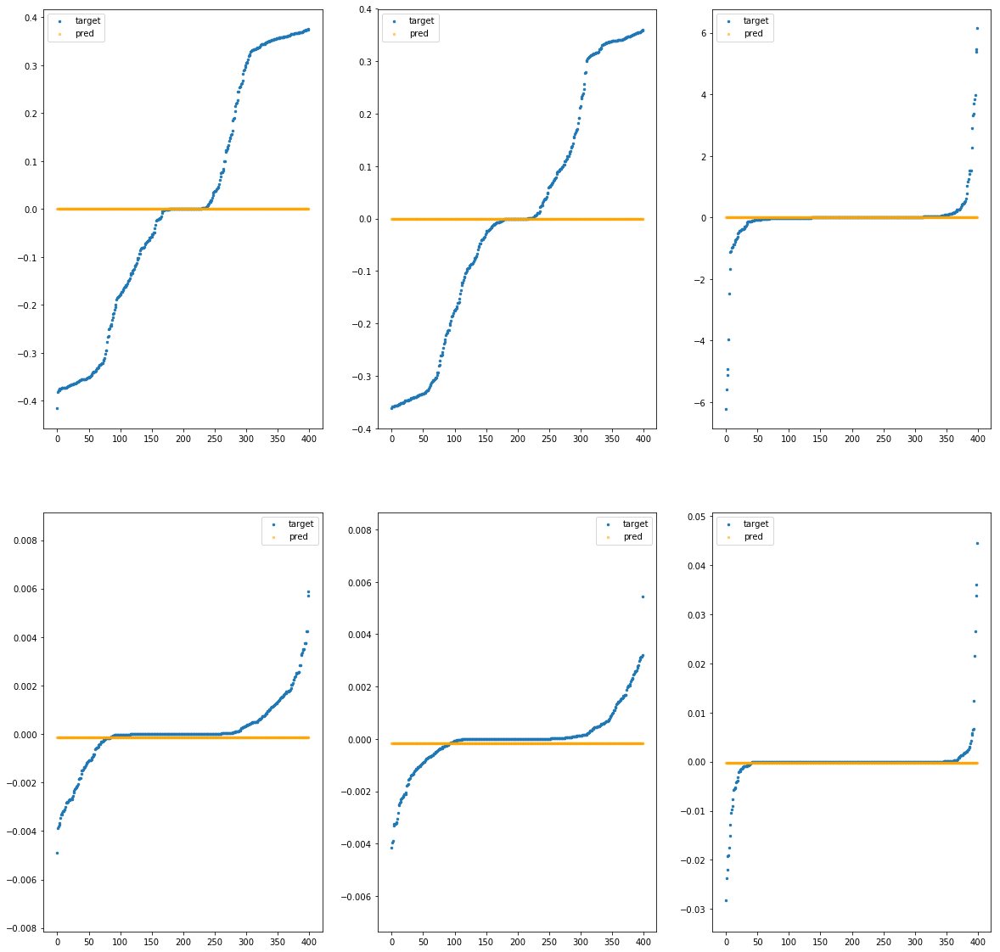

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfec490>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	9.15e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.30e+01	5.49e-02	3.01e-03
z		-9.71e-04	6.23e+00	2.77e-01	7.11e+00	8.76e-01	7.67e-01
phi		-2.26e-02	6.03e-03	8.48e-04	3.47e+04	1.90e-06	3.62e-12
theta		-2.00e-02	5.60e-03	6.97e-04	1.25e+04	1.30e-06	1.68e-12
psi		-5.75e-04	4.46e-02	1.36e-03	4.04e+03	2.45e-05	6.02e-10


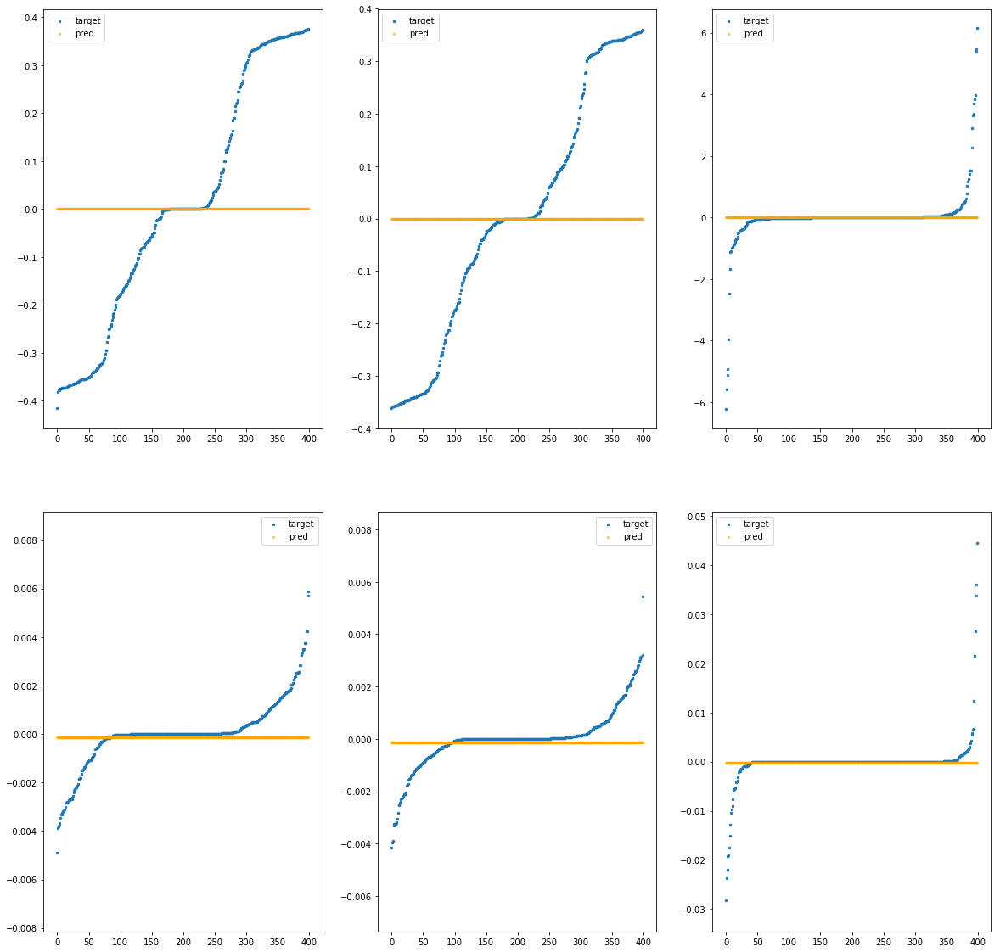

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fa99bfec4f0>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	8.96e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.28e+01	5.49e-02	3.01e-03
z		-9.71e-04	6.23e+00	2.77e-01	6.98e+00	8.76e-01	7.67e-01
phi		-2.19e-02	6.03e-03	8.46e-04	3.39e+04	1.90e-06	3.62e-12
theta		-1.92e-02	5.60e-03	6.96e-04	1.22e+04	1.29e-06	1.68e-12
psi		-5.46e-04	4.46e-02	1.36e-03	3.96e+03	2.45e-05	6.02e-10


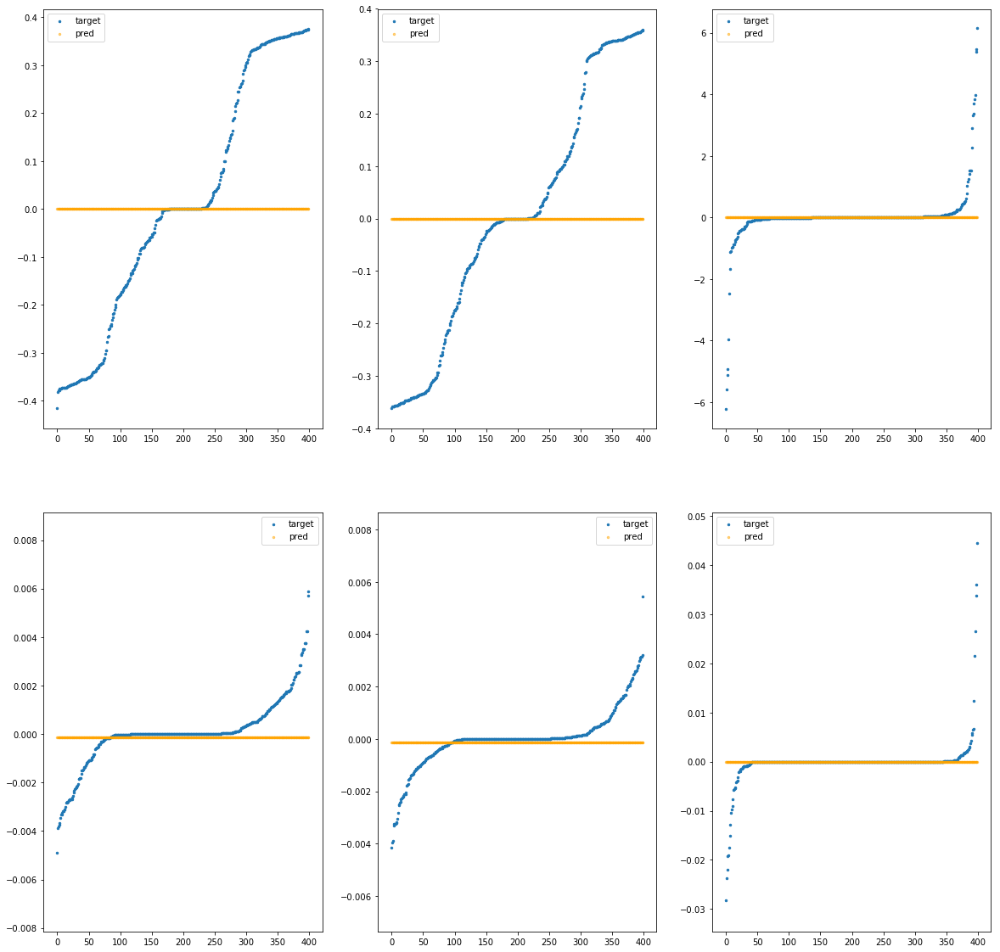

In [5]:
for key, result in search.results.items():
    print(key)
    result['estimator'].print_metrics();
    result['estimator'].plot()

In [6]:

search.print();

X:     1.59772620641249e-05, Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fa97e3af790>, epochs=100, batch_size=18
Y:     1.4124048881460813e-05, Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fa996f6d040>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fa97e387640>, epochs=50, batch_size=40
Z:     0.005935079741747506, Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="tanh"), Dense(128, activation="tanh"), Dense(64, activation="ta